In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time
%matplotlib inline


In [2]:
def get_data(filename):
    data=pd.read_csv('housing.csv')
    data=(data-data.mean())/data.std()
    return data
tt = get_data("housing.csv")

In [3]:
def get_X_Y(data):
    m=len(data)
    X0=np.ones(m)
    X1=data['sqft'].astype(float)
    X2=data['floors'].astype(float)
    X3=data['bedrooms'].astype(float)
    X4=data['bathrooms'].astype(float)
    Y=np.array(data['price'].astype(float))
    X=np.array([X0,X1,X2,X3,X4]).T
    return X,Y
    
def get_quadratic_X_Y(data):
    m=len(data)
    X0=np.ones(m)
    X1=data['sqft'].astype(float)
    X2=data['floors'].astype(float)
    X3=data['bedrooms'].astype(float)
    X4=data['bathrooms'].astype(float)
    Y=np.array(data['price'].astype(float))
    X=np.array([X0,X1,X2,X3,X4,X1**2,X2**2,X3**2,X4**2,X1*X2,X1*X3,X1*X4,X2*X3,X2*X4,X3*X4]).T
    return X,Y
def get_cubic_X_Y(data):
    m=len(data)
    X0=np.ones(m)
    X1=data['sqft'].astype(float)
    X2=data['floors'].astype(float)
    X3=data['bedrooms'].astype(float)
    X4=data['bathrooms'].astype(float)
    Y=np.array(data['price'].astype(float))
    X=np.array([X0,X1,X2,X3,X4,X1**2,X2**2,X3**2,X4**2,X1*X2,X1*X3,X1*X4,X2*X3,X2*X4,X3*X4,X1*X1*X1,X2*X2*X2,X3*X3*X3,X4*X4*X4]).T
    return X,Y
    

In [4]:
def cost_function(X, Y, Theta):
    m = len(X)
    J = np.sum((X.dot(Theta) - Y) ** 2)/(2 * m)
    return J
def rmse(Y, Y_pred):
    rmse = np.sqrt(sum((Y - Y_pred) ** 2) / len(Y))
    return rmse
def get_rmse(Theta):
    X,Y=get_X_Y(test_data)
    Y_Pred=X.dot(Theta)
    return rmse(Y,Y_Pred)
def get_quad_rmse(Theta):
    X,Y=get_quadratic_X_Y(test_data)
    Y_Pred=X.dot(Theta)
    return rmse(Y,Y_Pred)
def get_cubic_rmse(Theta):
    X,Y=get_cubic_X_Y(test_data)
    Y_Pred=X.dot(Theta)
    return rmse(Y,Y_Pred)


In [5]:
def plot_cost(iter_list,cost_list):
    plt.plot(iter_list,cost_list,'r.')
    plt.xlabel('Iterations ->')
    plt.ylabel('Cost')
    plt.show()

In [6]:
def plot_rmse(alpha_list,rmse_list):
    plt.plot(alpha_list,rmse_list,'r.')
    plt.xlabel('Learning Rate ->')
    plt.ylabel('RMSE')
    plt.show()

In [12]:
def gradientDescent(X, Y, Theta, alpha, m, numIterations,lamda=0):
    m = len(Y)
    cost_list=list()
    iter_list=list()
    tolerance = 1e-5
    theta_old=Theta
    for iteration in range(numIterations):
        # Hypothesis Values
        h = X.dot(Theta)
        loss = h - Y
        gradient = (X.T.dot(loss))/ m
        Theta = (1-(alpha/m)*lamda)*Theta - alpha * gradient
        if np.sum(abs(Theta - theta_old)) < tolerance:
            print("CONVERGED after "+str(iteration)+" iterations")
            break
        
        cost = cost_function(X, Y, Theta)
        print(cost)
        cost_list.append(cost)
        iter_list.append(iteration)
        theta_old=Theta
        
    return Theta,cost_list,iter_list

In [8]:
data=get_data('housing.csv')
train_length=(int)(0.8*len(data))
train_data=data[0:train_length+1]
test_data=data[train_length+1:]

CONVERGED after 4646 iterations


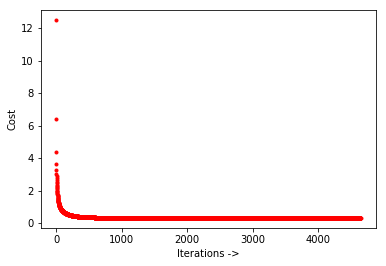

In [20]:
X,Y=get_quadratic_X_Y(train_data)

t = int( time.time() * 1000.0 )
np.random.seed( ((t & 0xff000000) >> 24)+((t & 0x00ff0000)>>8) +((t & 0x0000ff00)<<8)+((t & 0x000000ff)<<24))
Theta=np.random.rand(15)
Theta,cost_list,iter_list=gradientDescent(X,Y,Theta,0.005,len(train_data), 10000)
plot_cost(iter_list,cost_list)

CONVERGED after 8935 iterations
CONVERGED after 7538 iterations
CONVERGED after 6480 iterations
CONVERGED after 4542 iterations
CONVERGED after 4029 iterations
CONVERGED after 3732 iterations
CONVERGED after 3686 iterations
CONVERGED after 2964 iterations
CONVERGED after 2119 iterations
CONVERGED after 1919 iterations
CONVERGED after 1961 iterations
CONVERGED after 1663 iterations
CONVERGED after 922 iterations
CONVERGED after 802 iterations
CONVERGED after 894 iterations
CONVERGED after 641 iterations
CONVERGED after 651 iterations
CONVERGED after 566 iterations
CONVERGED after 463 iterations
CONVERGED after 418 iterations
CONVERGED after 280 iterations
CONVERGED after 254 iterations
CONVERGED after 232 iterations


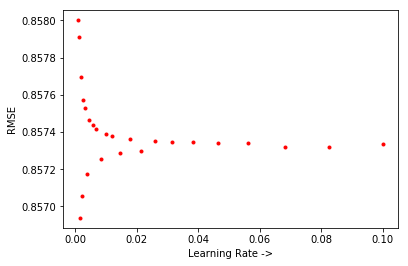

In [45]:
X,Y=get_X_Y(train_data)
rmse_list=list()
alpha_list=list()
lamda=0
for learning_rate in 10**np.linspace(-3.0,-1.0,25):
    t = int( time.time() * 1000.0 )
    np.random.seed( ((t & 0xff000000) >> 24)+((t & 0x00ff0000)>>8) +((t & 0x0000ff00)<<8)+((t & 0x000000ff)<<24))
    Theta=np.random.randn(5)
    Theta,cost_list,iter_list=gradientDescent(X,Y,Theta,learning_rate,len(train_data), 10000)
    rmse_list.append(get_rmse(Theta))
    alpha_list.append(learning_rate)
plot_rmse(alpha_list,rmse_list)

CONVERGED after 29616 iterations
CONVERGED after 28383 iterations
CONVERGED after 28358 iterations
CONVERGED after 24893 iterations
CONVERGED after 25657 iterations
CONVERGED after 24617 iterations
CONVERGED after 25233 iterations
CONVERGED after 27062 iterations
CONVERGED after 19287 iterations
CONVERGED after 26374 iterations
CONVERGED after 19577 iterations
CONVERGED after 20629 iterations
CONVERGED after 24216 iterations
CONVERGED after 21795 iterations
CONVERGED after 17436 iterations


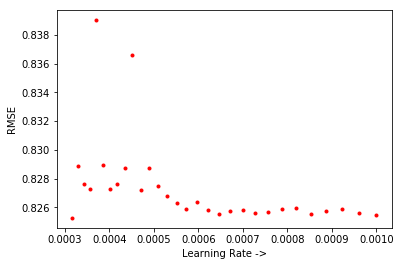

In [40]:
X,Y=get_quadratic_X_Y(train_data)
rmse_list=list()
alpha_list=list()
lamda=0
for learning_rate in 10**np.linspace(-3.5,-3.0,30):
    t = int( time.time() * 1000.0 )
    np.random.seed( ((t & 0xff000000) >> 24)+((t & 0x00ff0000)>>8) +((t & 0x0000ff00)<<8)+((t & 0x000000ff)<<24))
    Theta=np.random.randn(15)
    Theta,cost_list,iter_list=gradientDescent(X,Y,Theta,learning_rate,len(train_data), 30000)
    rmse_list.append(get_quad_rmse(Theta))
    alpha_list.append(learning_rate)
plot_rmse(alpha_list,rmse_list)

26654.0544857
26523.2218171
26393.0866755
26263.6441516
26134.8893951
26006.817614
25879.4240738
25752.7040957
25626.6530564
25501.2663864
25376.5395693
25252.468141
25129.0476884
25006.2738487
24884.1423083
24762.6488021
24641.7891127
24521.5590691
24401.9545465
24282.9714648
24164.6057885
24046.8535254
23929.7107259
23813.1734827
23697.2379293
23581.9002401
23467.156629
23353.0033493
23239.4366927
23126.4529884
23014.0486033
22902.2199403
22790.9634386
22680.2755725
22570.1528512
22460.5918178
22351.5890492
22243.1411552
22135.2447783
22027.8965927
21921.0933042
21814.8316496
21709.1083958
21603.9203401
21499.264309
21395.1371581
21291.5357715
21188.4570615
21085.897968
20983.8554581
20882.3265258
20781.3081916
20680.7975018
20580.7915285
20481.2873688
20382.282145
20283.7730034
20185.757115
20088.2316741
19991.1938985
19894.6410293
19798.57033
19702.9790869
19607.864608
19513.2242233
19419.0552843
19325.3551635
19232.1212544
19139.350971
19047.0417476
18955.1910387
18863.7963182
187

1123.18506182
1118.28172723
1113.40201812
1108.54582064
1103.71302151
1098.90350797
1094.11716782
1089.3538894
1084.61356157
1079.89607376
1075.20131591
1070.52917848
1065.87955249
1061.25232944
1056.64740141
1052.06466094
1047.50400114
1042.9653156
1038.44849844
1033.95344428
1029.48004825
1025.028206
1020.59781366
1016.18876788
1011.8009658
1007.43430504
1003.08868374
998.764000522
994.460154488
990.177045234
985.914572836
981.672637856
977.45114133
973.249984774
969.069070178
964.908300004
960.767577184
956.646805117
952.545887671
948.464729171
944.403234409
940.361308633
936.338857547
932.335787311
928.352004536
924.387416283
920.441930062
916.515453829
912.60789598
908.719165357
904.849171238
900.99782334
897.165031814
893.350707244
889.554760645
885.777103462
882.017647565
878.276305249
874.552989233
870.847612654
867.16008907
863.490332454
859.838257195
856.203778093
852.586810359
848.987269614
845.405071882
841.840133597
838.29237159
834.761703097
831.248045751
827.751317581
82

147.01218142
146.811493065
146.611770031
146.413007668
146.215201347
146.018346459
145.822438422
145.627472672
145.433444668
145.240349894
145.04818385
144.856942063
144.666620079
144.477213465
144.28871781
144.101128726
143.914441844
143.728652816
143.543757316
143.359751039
143.1766297
142.994389034
142.813024798
142.632532769
142.452908744
142.27414854
142.096247996
141.919202968
141.743009334
141.567662993
141.39315986
141.219495873
141.046666989
140.874669184
140.703498452
140.533150809
140.363622288
140.194908943
140.027006845
139.859912085
139.693620774
139.528129039
139.363433028
139.199528906
139.036412859
138.874081087
138.712529813
138.551755275
138.391753731
138.232521456
138.074054742
137.916349902
137.759403264
137.603211174
137.447769997
137.293076115
137.139125925
136.985915846
136.83344231
136.681701769
136.53069069
136.380405559
136.230842877
136.081999164
135.933870954
135.786454801
135.639747272
135.493744954
135.348444449
135.203842374
135.059935365
134.916720071
1

106.394720462
106.38850013
106.382308062
106.376144123
106.370008177
106.363900089
106.357819724
106.351766949
106.345741632
106.33974364
106.333772841
106.327829104
106.321912299
106.316022295
106.310158965
106.304322179
106.29851181
106.29272773
106.286969812
106.281237931
106.275531961
106.269851777
106.264197256
106.258568272
106.252964703
106.247386428
106.241833323
106.236305268
106.230802142
106.225323824
106.219870196
106.214441139
106.209036533
106.203656261
106.198300206
106.192968252
106.187660281
106.182376179
106.17711583
106.171879121
106.166665936
106.161476164
106.15630969
106.151166403
106.146046191
106.140948943
106.135874548
106.130822897
106.125793878
106.120787384
106.115803306
106.110841536
106.105901967
106.10098449
106.096089001
106.091215393
106.086363561
106.081533399
106.076724803
106.07193767
106.067171896
106.062427378
106.057704013
106.0530017
106.048320338
106.043659825
106.039020061
106.034400945
106.029802379
106.025224264
106.0206665
106.01612899
106.0

104.916241901
104.91576926
104.915297195
104.914825701
104.914354777
104.913884419
104.913414625
104.912945392
104.912476718
104.912008599
104.911541034
104.911074018
104.910607551
104.910141629
104.909676249
104.909211409
CONVERGED after 2890 iterations
104363.858568
101700.6063
99107.1465146
96581.6410364
94122.3001555
91727.381348
89395.1880322
87124.0683565
84912.4140202
82758.6591251
80661.279057
78618.789397
76629.7448619
74692.7382717
72806.3995451
70969.3947208
69180.4250054
67438.2258459
65741.5660264
64089.2467894
62480.1009797
60912.9922109
59386.8140543
57900.4892485
56452.9689306
55043.2318871
53670.2838248
52333.1566612
51030.9078328
49762.6196226
48527.3985044
47324.3745055
46152.7005853
45011.5520303
43900.1258659
42817.6402826
41763.3340783
40736.4661145
39736.3147878
38762.1775139
37813.3702271
36889.226891
35989.0990238
35112.3552352
34258.3807752
33426.5770962
32616.3614251
31827.1663475
31058.4394027
30309.6426897
29580.2524827
28869.7588577
28177.6653285
27503.488

402.619505793
402.138455491
401.660045806
401.184262174
400.71109011
400.240515206
399.772523139
399.307099663
398.844230609
398.383901889
397.926099493
397.470809487
397.018018014
396.567711296
396.119875629
395.674497386
395.231563015
394.791059037
394.352972052
393.91728873
393.483995817
393.053080132
392.624528565
392.19832808
391.774465715
391.352928576
390.933703842
390.516778763
390.10214066
389.689776922
389.279675011
388.871822454
388.466206851
388.062815868
387.66163724
387.262658771
386.865868328
386.471253851
386.078803343
385.688504873
385.300346577
384.914316658
384.530403381
384.148595077
383.768880144
383.391247039
383.015684288
382.642180477
382.270724256
381.901304337
381.533909496
381.16852857
380.805150456
380.443764116
380.084358569
379.726922897
379.371446242
379.017917806
378.666326848
378.316662691
377.968914713
377.623072352
377.279125105
376.937062526
376.596874226
376.258549875
375.922079199
375.587451982
375.254658062
374.923687334
374.59452975
374.267175316

317.86789763
317.847568613
317.82734094
317.807214053
317.787187395
317.767260415
317.747432564
317.727703295
317.708072065
317.688538335
317.669101566
317.649761225
317.630516781
317.611367705
317.592313471
317.573353557
317.554487444
317.535714614
317.517034554
317.498446753
317.479950702
317.461545896
317.443231831
317.425008009
317.406873931
317.388829104
317.370873036
317.353005237
317.335225222
317.317532506
317.299926609
317.282407053
317.264973361
317.247625061
317.230361682
317.213182756
317.196087818
317.179076405
317.162148058
317.145302317
317.12853873
317.111856841
317.095256203
317.078736366
317.062296886
317.04593732
317.029657227
317.013456171
316.997333715
316.981289426
316.965322874
316.949433631
316.933621269
316.917885367
316.902225503
316.886641257
316.871132213
316.855697958
316.840338078
316.825052164
316.809839808
316.794700606
316.779634154
316.764640051
316.749717899
316.734867302
316.720087865
316.705379196
316.690740905
316.676172604
316.661673909
316.647244

313.227219143
313.224920566
313.222624029
313.220329519
313.218037026
313.215746539
313.213458047
313.211171538
313.208887003
313.206604429
313.204323807
313.202045126
313.199768375
313.197493544
313.195220621
313.192949597
313.190680462
313.188413204
313.186147813
313.183884281
313.181622595
313.179362746
313.177104725
313.17484852
313.172594123
313.170341523
313.16809071
313.165841674
313.163594407
313.161348898
313.159105137
313.156863116
313.154622823
313.152384251
313.15014739
313.14791223
313.145678761
313.143446976
313.141216864
313.138988416
313.136761624
313.134536478
313.132312969
313.130091088
313.127870826
313.125652175
313.123435126
313.12121967
313.119005798
313.116793501
313.114582772
313.112373601
313.110165979
313.107959899
313.105755352
313.10355233
313.101350824
313.099150826
313.096952327
313.094755321
313.092559797
313.090365749
313.088173168
313.085982046
313.083792376
313.081604149
313.079417357
313.077231993
313.075048048
313.072865516
313.070684388
313.06850465

312.022168966
312.020231629
312.018294383
312.016357225
312.014420156
312.012483175
312.010546282
312.008609477
312.006672758
312.004736126
312.00279958
312.00086312
311.998926745
311.996990455
311.99505425
311.993118129
311.991182091
311.989246137
311.987310266
311.985374478
311.983438772
311.981503147
311.979567604
311.977632142
311.975696761
311.97376146
311.971826239
311.969891098
311.967956035
311.966021052
311.964086147
311.96215132
311.960216571
311.958281899
311.956347304
311.954412786
311.952478344
311.950543978
311.948609688
311.946675473
311.944741333
311.942807268
311.940873276
311.938939359
311.937005515
311.935071744
311.933138047
311.931204421
311.929270868
311.927337387
311.925403978
311.923470639
311.921537372
311.919604175
311.917671049
311.915737992
311.913805005
311.911872088
311.909939239
311.908006459
311.906073747
311.904141104
311.902208528
311.90027602
311.898343579
311.896411205
311.894478897
311.892546656
311.890614481
311.888682371
311.886750327
311.88481834

310.768324783
310.766409196
310.764493624
310.762578067
310.760662524
310.758746996
310.756831483
310.754915984
310.753000499
310.751085029
310.749169574
310.747254133
310.745338706
310.743423294
310.741507897
310.739592514
310.737677145
310.735761791
310.733846451
310.731931126
310.730015815
310.728100518
310.726185236
310.724269968
310.722354715
310.720439476
310.718524251
310.71660904
310.714693844
310.712778662
310.710863495
310.708948341
310.707033202
310.705118078
310.703202967
310.701287871
310.699372789
310.697457721
310.695542668
310.693627628
310.691712603
310.689797592
310.687882595
310.685967613
310.684052644
310.68213769
310.68022275
310.678307824
310.676392912
310.674478014
310.672563131
310.670648261
310.668733405
310.666818564
310.664903737
310.662988923
310.661074124
310.659159339
310.657244568
310.655329811
310.653415068
310.651500339
310.649585624
310.647670922
310.645756235
310.643841562
310.641926903
310.640012258
310.638097627
310.636183009
310.634268406
310.63235

309.596578795
309.594671225
309.592763667
309.590856122
309.588948589
309.587041068
309.58513356
309.583226065
309.581318582
309.579411112
309.577503654
309.575596209
309.573688776
309.571781356
309.569873948
309.567966553
309.56605917
309.5641518
309.562244442
309.560337097
309.558429764
309.556522444
309.554615137
309.552707842
309.550800559
309.548893289
309.546986031
309.545078786
309.543171554
309.541264334
309.539357126
309.537449931
309.535542749
309.533635579
309.531728421
309.529821276
309.527914144
309.526007024
309.524099916
309.522192821
309.520285739
309.518378669
309.516471612
309.514564567
309.512657534
309.510750514
309.508843507
309.506936512
309.505029529
309.50312256
309.501215602
309.499308657
309.497401725
309.495494805
309.493587898
309.491681003
309.48977412
309.48786725
309.485960393
309.484053548
309.482146716
309.480239896
309.478333088
309.476426293
309.474519511
309.472612741
309.470705984
309.468799239
309.466892506
309.464985786
309.463079079
309.461172384

308.420076607
308.418176728
308.416276862
308.414377008
308.412477166
308.410577337
308.40867752
308.406777716
308.404877924
308.402978144
308.401078377
308.399178623
308.39727888
308.39537915
308.393479433
308.391579728
308.389680035
308.387780355
308.385880687
308.383981031
308.382081388
308.380181757
308.378282139
308.376382533
308.374482939
308.372583358
308.37068379
308.368784233
308.366884689
308.364985158
308.363085639
308.361186132
308.359286638
308.357387156
308.355487686
308.353588229
308.351688784
308.349789352
308.347889932
308.345990525
308.344091129
308.342191747
308.340292376
308.338393018
308.336493673
308.33459434
308.332695019
308.330795711
308.328896415
308.326997131
308.32509786
308.323198601
308.321299355
308.319400121
308.3175009
308.31560169
308.313702494
308.311803309
308.309904137
308.308004978
308.306105831
308.304206696
308.302307573
308.300408464
308.298509366
308.296610281
308.294711208
308.292812148
308.2909131
308.289014064
308.287115041
308.28521603
308.

307.017551692
307.015660968
307.013770256
307.011879556
307.009988869
307.008098193
307.006207531
307.00431688
307.002426242
307.000535616
306.998645003
306.996754402
306.994863813
306.992973237
306.991082673
306.989192121
306.987301582
306.985411055
306.98352054
306.981630038
306.979739548
306.97784907
306.975958605
306.974068152
306.972177711
306.970287283
306.968396867
306.966506463
306.964616072
306.962725693
306.960835326
306.958944972
306.95705463
306.9551643
306.953273983
306.951383678
306.949493385
306.947603105
306.945712837
306.943822581
306.941932338
306.940042107
306.938151889
306.936261682
306.934371488
306.932481307
306.930591137
306.928700981
306.926810836
306.924920704
306.923030584
306.921140476
306.919250381
306.917360298
306.915470228
306.913580169
306.911690123
306.90980009
306.907910069
306.90602006
306.904130063
306.902240079
306.900350107
306.898460147
306.8965702
306.894680265
306.892790343
306.890900433
306.889010535
306.887120649
306.885230776
306.883340915
30

305.764822843
305.762940294
305.761057758
305.759175234
305.757292721
305.755410222
305.753527734
305.751645259
305.749762796
305.747880346
305.745997907
305.744115481
305.742233067
305.740350666
305.738468277
305.7365859
305.734703535
305.732821183
305.730938843
305.729056515
305.727174199
305.725291896
305.723409605
305.721527327
305.71964506
305.717762806
305.715880564
305.713998335
305.712116118
305.710233913
305.70835172
305.70646954
305.704587372
305.702705216
305.700823072
305.698940941
305.697058822
305.695176715
305.693294621
305.691412539
305.689530469
305.687648412
305.685766366
305.683884333
305.682002313
305.680120304
305.678238308
305.676356324
305.674474353
305.672592393
305.670710446
305.668828512
305.666946589
305.665064679
305.663182781
305.661300895
305.659419022
305.657537161
305.655655312
305.653773476
305.651891652
305.65000984
305.64812804
305.646246253
305.644364478
305.642482715
305.640600964
305.638719226
305.6368375
305.634955786
305.633074085
305.631192396
3

304.577498188
304.575623387
304.573748599
304.571873822
304.569999058
304.568124306
304.566249567
304.564374839
304.562500124
304.560625421
304.558750731
304.556876052
304.555001386
304.553126732
304.55125209
304.549377461
304.547502844
304.545628239
304.543753646
304.541879065
304.540004497
304.538129941
304.536255397
304.534380865
304.532506346
304.530631839
304.528757344
304.526882861
304.525008391
304.523133932
304.521259486
304.519385053
304.517510631
304.515636222
304.513761825
304.51188744
304.510013067
304.508138707
304.506264359
304.504390023
304.502515699
304.500641388
304.498767088
304.496892801
304.495018527
304.493144264
304.491270014
304.489395776
304.48752155
304.485647336
304.483773135
304.481898946
304.480024769
304.478150604
304.476276451
304.474402311
304.472528183
304.470654067
304.468779964
304.466905873
304.465031793
304.463157727
304.461283672
304.459409629
304.457535599
304.455661581
304.453787576
304.451913582
304.450039601
304.448165632
304.446291675
304.44441

303.29798784
303.296121388
303.294254948
303.292388521
303.290522106
303.288655703
303.286789312
303.284922934
303.283056567
303.281190213
303.279323871
303.277457541
303.275591223
303.273724918
303.271858624
303.269992343
303.268126074
303.266259817
303.264393573
303.26252734
303.26066112
303.258794912
303.256928716
303.255062532
303.25319636
303.251330201
303.249464054
303.247597919
303.245731796
303.243865685
303.241999587
303.2401335
303.238267426
303.236401364
303.234535314
303.232669277
303.230803251
303.228937238
303.227071237
303.225205248
303.223339271
303.221473306
303.219607354
303.217741414
303.215875486
303.21400957
303.212143666
303.210277774
303.208411895
303.206546028
303.204680173
303.20281433
303.200948499
303.199082681
303.197216874
303.19535108
303.193485298
303.191619529
303.189753771
303.187888025
303.186022292
303.184156571
303.182290862
303.180425165
303.178559481
303.176693808
303.174828148
303.1729625
303.171096864
303.16923124
303.167365629
303.165500029
303.

301.996304501
301.994446543
301.992588596
301.990730662
301.98887274
301.98701483
301.985156932
301.983299046
301.981441172
301.97958331
301.977725461
301.975867624
301.974009798
301.972151985
301.970294184
301.968436395
301.966578619
301.964720854
301.962863101
301.961005361
301.959147633
301.957289917
301.955432212
301.953574521
301.951716841
301.949859173
301.948001518
301.946143874
301.944286243
301.942428624
301.940571016
301.938713422
301.936855839
301.934998268
301.933140709
301.931283163
301.929425629
301.927568106
301.925710596
301.923853098
301.921995612
301.920138139
301.918280677
301.916423227
301.91456579
301.912708365
301.910850951
301.90899355
301.907136161
301.905278785
301.90342142
301.901564067
301.899706727
301.897849399
301.895992082
301.894134778
301.892277486
301.890420206
301.888562939
301.886705683
301.884848439
301.882991208
301.881133989
301.879276782
301.877419587
301.875562404
301.873705233
301.871848074
301.869990928
301.868133793
301.866276671
301.86441956

300.632120455
300.630271396
300.62842235
300.626573316
300.624724293
300.622875283
300.621026285
300.619177299
300.617328325
300.615479363
300.613630413
300.611781476
300.60993255
300.608083636
300.606234734
300.604385845
300.602536967
300.600688102
300.598839249
300.596990407
300.595141578
300.593292761
300.591443956
300.589595163
300.587746382
300.585897613
300.584048856
300.582200111
300.580351378
300.578502658
300.576653949
300.574805252
300.572956568
300.571107895
300.569259235
300.567410587
300.56556195
300.563713326
300.561864714
300.560016114
300.558167526
300.55631895
300.554470386
300.552621834
300.550773294
300.548924767
300.547076251
300.545227747
300.543379256
300.541530776
300.539682309
300.537833853
300.53598541
300.534136979
300.53228856
300.530440152
300.528591757
300.526743374
300.524895003
300.523046644
300.521198298
300.519349963
300.51750164
300.515653329
300.513805031
300.511956744
300.51010847
300.508260207
300.506411957
300.504563719
300.502715492
300.500867278


299.377541418
299.375700544
299.373859682
299.372018832
299.370177994
299.368337168
299.366496354
299.364655552
299.362814762
299.360973984
299.359133218
299.357292464
299.355451722
299.353610992
299.351770274
299.349929568
299.348088874
299.346248192
299.344407522
299.342566865
299.340726219
299.338885585
299.337044963
299.335204353
299.333363755
299.331523169
299.329682596
299.327842034
299.326001484
299.324160946
299.32232042
299.320479906
299.318639405
299.316798915
299.314958437
299.313117971
299.311277518
299.309437076
299.307596646
299.305756228
299.303915822
299.302075429
299.300235047
299.298394677
299.29655432
299.294713974
299.29287364
299.291033318
299.289193009
299.287352711
299.285512425
299.283672152
299.28183189
299.27999164
299.278151402
299.276311177
299.274470963
299.272630761
299.270790572
299.268950394
299.267110228
299.265270075
299.263429933
299.261589804
299.259749686
299.25790958
299.256069487
299.254229405
299.252389335
299.250549278
299.248709232
299.24686919

298.212833591
298.211000315
298.20916705
298.207333798
298.205500557
298.203667328
298.201834112
298.200000907
298.198167714
298.196334533
298.194501365
298.192668208
298.190835063
298.18900193
298.187168809
298.185335699
298.183502602
298.181669517
298.179836444
298.178003383
298.176170333
298.174337296
298.172504271
298.170671257
298.168838256
298.167005266
298.165172289
298.163339323
298.161506369
298.159673428
298.157840498
298.15600758
298.154174674
298.152341781
298.150508899
298.148676029
298.146843171
298.145010325
298.143177491
298.141344668
298.139511858
298.13767906
298.135846274
298.134013499
298.132180737
298.130347987
298.128515248
298.126682522
298.124849807
298.123017105
298.121184414
298.119351735
298.117519068
298.115686414
298.113853771
298.11202114
298.110188521
298.108355914
298.106523319
298.104690736
298.102858165
298.101025606
298.099193059
298.097360523
298.095528
298.093695489
298.091862989
298.090030502
298.088198027
298.086365563
298.084533112
298.082700672


296.92881128
296.926986378
296.925161489
296.923336611
296.921511746
296.919686892
296.91786205
296.91603722
296.914212402
296.912387596
296.910562802
296.90873802
296.906913249
296.905088491
296.903263744
296.90143901
296.899614287
296.897789576
296.895964877
296.89414019
296.892315515
296.890490852
296.8886662
296.886841561
296.885016933
296.883192318
296.881367714
296.879543122
296.877718542
296.875893974
296.874069418
296.872244874
296.870420341
296.868595821
296.866771312
296.864946815
296.863122331
296.861297858
296.859473397
296.857648948
296.855824511
296.854000085
296.852175672
296.850351271
296.848526881
296.846702503
296.844878138
296.843053784
296.841229442
296.839405112
296.837580794
296.835756487
296.833932193
296.83210791
296.83028364
296.828459381
296.826635134
296.8248109
296.822986677
296.821162466
296.819338266
296.817514079
296.815689904
296.81386574
296.812041589
296.810217449
296.808393321
296.806569205
296.804745101
296.802921009
296.801096929
296.799272861
296.7

295.754218487
295.752401246
295.750584017
295.748766801
295.746949596
295.745132403
295.743315221
295.741498052
295.739680895
295.737863749
295.736046615
295.734229493
295.732412383
295.730595285
295.728778198
295.726961124
295.725144061
295.72332701
295.721509971
295.719692944
295.717875929
295.716058925
295.714241934
295.712424954
295.710607986
295.70879103
295.706974086
295.705157153
295.703340233
295.701523324
295.699706427
295.697889542
295.696072669
295.694255808
295.692438959
295.690622121
295.688805295
295.686988481
295.685171679
295.683354889
295.681538111
295.679721344
295.67790459
295.676087847
295.674271116
295.672454397
295.67063769
295.668820994
295.667004311
295.665187639
295.663370979
295.661554331
295.659737695
295.657921071
295.656104458
295.654287858
295.652471269
295.650654692
295.648838127
295.647021574
295.645205033
295.643388503
295.641571985
295.63975548
295.637938986
295.636122504
295.634306033
295.632489575
295.630673128
295.628856693
295.627040271
295.6252238

294.620751103
294.618941255
294.617131418
294.615321593
294.61351178
294.611701979
294.609892189
294.608082412
294.606272646
294.604462892
294.60265315
294.600843419
294.599033701
294.597223994
294.595414299
294.593604616
294.591794944
294.589985285
294.588175637
294.586366001
294.584556377
294.582746764
294.580937164
294.579127575
294.577317998
294.575508433
294.573698879
294.571889338
294.570079808
294.56827029
294.566460784
294.56465129
294.562841807
294.561032336
294.559222877
294.55741343
294.555603995
294.553794571
294.551985159
294.550175759
294.548366371
294.546556995
294.54474763
294.542938277
294.541128936
294.539319607
294.53751029
294.535700984
294.53389169
294.532082408
294.530273138
294.52846388
294.526654633
294.524845398
294.523036175
294.521226964
294.519417765
294.517608577
294.515799401
294.513990237
294.512181085
294.510371945
294.508562816
294.506753699
294.504944594
294.503135501
294.50132642
294.49951735
294.497708292
294.495899246
294.494090212
294.49228119
294.

293.196443376
293.194642815
293.192842267
293.19104173
293.189241205
293.187440691
293.185640189
293.1838397
293.182039221
293.180238755
293.1784383
293.176637857
293.174837426
293.173037006
293.171236599
293.169436203
293.167635818
293.165835446
293.164035085
293.162234736
293.160434399
293.158634073
293.156833759
293.155033457
293.153233167
293.151432888
293.149632621
293.147832366
293.146032123
293.144231891
293.142431671
293.140631463
293.138831266
293.137031082
293.135230909
293.133430747
293.131630598
293.12983046
293.128030334
293.12623022
293.124430117
293.122630026
293.120829947
293.11902988
293.117229824
293.115429781
293.113629748
293.111829728
293.110029719
293.108229722
293.106429737
293.104629764
293.102829802
293.101029852
293.099229914
293.097429987
293.095630073
293.09383017
293.092030278
293.090230399
293.088430531
293.086630675
293.084830831
293.083030998
293.081231177
293.079431368
293.077631571
293.075831785
293.074032011
293.072232249
293.070432498
293.06863276
29

291.994488099
291.992695376
291.990902664
291.989109965
291.987317277
291.9855246
291.983731936
291.981939283
291.980146642
291.978354012
291.976561395
291.974768788
291.972976194
291.971183611
291.96939104
291.967598481
291.965805933
291.964013397
291.962220873
291.96042836
291.958635859
291.95684337
291.955050892
291.953258427
291.951465972
291.94967353
291.947881099
291.94608868
291.944296273
291.942503877
291.940711493
291.93891912
291.93712676
291.935334411
291.933542073
291.931749748
291.929957434
291.928165132
291.926372841
291.924580562
291.922788295
291.920996039
291.919203796
291.917411563
291.915619343
291.913827134
291.912034937
291.910242752
291.908450578
291.906658416
291.904866266
291.903074127
291.901282
291.899489885
291.897697781
291.895905689
291.894113609
291.892321541
291.890529484
291.888737439
291.886945405
291.885153383
291.883361373
291.881569375
291.879777388
291.877985413
291.876193449
291.874401498
291.872609558
291.870817629
291.869025713
291.867233808
291.

290.858458642
290.856673326
290.854888022
290.853102729
290.851317448
290.849532178
290.84774692
290.845961674
290.84417644
290.842391217
290.840606005
290.838820806
290.837035618
290.835250441
290.833465277
290.831680123
290.829894982
290.828109852
290.826324734
290.824539627
290.822754532
290.820969449
290.819184378
290.817399318
290.815614269
290.813829232
290.812044207
290.810259194
290.808474192
290.806689202
290.804904223
290.803119256
290.801334301
290.799549358
290.797764426
290.795979505
290.794194597
290.792409699
290.790624814
290.78883994
290.787055078
290.785270228
290.783485389
290.781700561
290.779915746
290.778130942
290.776346149
290.774561369
290.7727766
290.770991842
290.769207096
290.767422362
290.76563764
290.763852929
290.76206823
290.760283542
290.758498866
290.756714202
290.754929549
290.753144908
290.751360278
290.749575661
290.747791054
290.74600646
290.744221877
290.742437306
290.740652746
290.738868198
290.737083662
290.735299137
290.733514624
290.731730123


289.37176522
289.369989596
289.368213984
289.366438384
289.364662795
289.362887218
289.361111652
289.359336098
289.357560555
289.355785024
289.354009505
289.352233997
289.3504585
289.348683016
289.346907543
289.345132081
289.343356631
289.341581193
289.339805766
289.338030351
289.336254947
289.334479555
289.332704174
289.330928805
289.329153448
289.327378102
289.325602768
289.323827445
289.322052134
289.320276834
289.318501546
289.31672627
289.314951005
289.313175752
289.31140051
289.30962528
289.307850062
289.306074855
289.304299659
289.302524476
289.300749303
289.298974143
289.297198994
289.295423856
289.29364873
289.291873616
289.290098513
289.288323422
289.286548342
289.284773274
289.282998218
289.281223173
289.279448139
289.277673118
289.275898107
289.274123109
289.272348122
289.270573146
289.268798182
289.26702323
289.265248289
289.26347336
289.261698442
289.259923536
289.258148642
289.256373759
289.254598887
289.252824028
289.251049179
289.249274343
289.247499518
289.245724704
2

288.234193288
288.23242508
288.230656884
288.228888699
288.227120526
288.225352364
288.223584214
288.221816075
288.220047948
288.218279832
288.216511728
288.214743635
288.212975554
288.211207485
288.209439427
288.20767138
288.205903345
288.204135322
288.20236731
288.200599309
288.19883132
288.197063343
288.195295377
288.193527423
288.19175948
288.189991549
288.188223629
288.186455721
288.184687824
288.182919939
288.181152065
288.179384203
288.177616352
288.175848513
288.174080686
288.17231287
288.170545065
288.168777272
288.167009491
288.165241721
288.163473962
288.161706215
288.15993848
288.158170756
288.156403044
288.154635343
288.152867654
288.151099976
288.14933231
288.147564655
288.145797012
288.14402938
288.14226176
288.140494151
288.138726554
288.136958969
288.135191395
288.133423832
288.131656281
288.129888742
288.128121214
288.126353697
288.124586192
288.122818699
288.121051217
288.119283747
288.117516288
288.11574884
288.113981405
288.11221398
288.110446568
288.108679166
288.

286.847931654
286.846172482
286.844413322
286.842654173
286.840895035
286.839135909
286.837376795
286.835617692
286.833858601
286.832099521
286.830340452
286.828581395
286.826822349
286.825063315
286.823304292
286.821545281
286.819786281
286.818027293
286.816268316
286.814509351
286.812750397
286.810991455
286.809232524
286.807473604
286.805714696
286.803955799
286.802196914
286.800438041
286.798679178
286.796920328
286.795161488
286.793402661
286.791643844
286.789885039
286.788126246
286.786367464
286.784608694
286.782849935
286.781091187
286.779332451
286.777573726
286.775815013
286.774056311
286.772297621
286.770538942
286.768780275
286.767021619
286.765262975
286.763504342
286.76174572
286.75998711
286.758228512
286.756469925
286.754711349
286.752952785
286.751194232
286.749435691
286.747677161
286.745918643
286.744160136
286.742401641
286.740643157
286.738884685
286.737126224
286.735367774
286.733609336
286.731850909
286.730092494
286.728334091
286.726575698
286.724817318
286.7230

285.689368257
285.687616636
285.685865027
285.68411343
285.682361843
285.680610268
285.678858705
285.677107153
285.675355612
285.673604083
285.671852566
285.670101059
285.668349564
285.666598081
285.664846609
285.663095148
285.661343699
285.659592261
285.657840835
285.65608942
285.654338016
285.652586624
285.650835243
285.649083874
285.647332516
285.645581169
285.643829834
285.64207851
285.640327198
285.638575897
285.636824608
285.63507333
285.633322063
285.631570808
285.629819564
285.628068332
285.626317111
285.624565901
285.622814703
285.621063517
285.619312341
285.617561177
285.615810025
285.614058884
285.612307754
285.610556636
285.608805529
285.607054434
285.60530335
285.603552277
285.601801216
285.600050166
285.598299128
285.596548101
285.594797085
285.593046081
285.591295088
285.589544107
285.587793137
285.586042179
285.584291232
285.582540296
285.580789372
285.579038459
285.577287558
285.575536668
285.573785789
285.572034922
285.570284066
285.568533222
285.566782389
285.5650315

284.605551228
284.603806671
284.602062125
284.600317591
284.598573068
284.596828557
284.595084057
284.593339568
284.591595091
284.589850625
284.58810617
284.586361727
284.584617295
284.582872875
284.581128466
284.579384068
284.577639681
284.575895306
284.574150943
284.57240659
284.570662249
284.56891792
284.567173602
284.565429295
284.563684999
284.561940715
284.560196443
284.558452181
284.556707931
284.554963693
284.553219465
284.55147525
284.549731045
284.547986852
284.54624267
284.5444985
284.542754341
284.541010193
284.539266057
284.537521932
284.535777818
284.534033716
284.532289625
284.530545546
284.528801477
284.527057421
284.525313375
284.523569341
284.521825319
284.520081307
284.518337307
284.516593319
284.514849342
284.513105376
284.511361421
284.509617478
284.507873547
284.506129626
284.504385717
284.50264182
284.500897933
284.499154058
284.497410195
284.495666343
284.493922502
284.492178673
284.490434854
284.488691048
284.486947252
284.485203468
284.483459696
284.481715935


283.423610172
283.421873317
283.420136474
283.418399642
283.416662822
283.414926012
283.413189215
283.411452428
283.409715653
283.407978889
283.406242136
283.404505395
283.402768665
283.401031946
283.399295239
283.397558543
283.395821858
283.394085185
283.392348523
283.390611872
283.388875233
283.387138604
283.385401988
283.383665382
283.381928788
283.380192205
283.378455634
283.376719073
283.374982525
283.373245987
283.371509461
283.369772946
283.368036442
283.36629995
283.364563469
283.362826999
283.361090541
283.359354094
283.357617658
283.355881233
283.35414482
283.352408419
283.350672028
283.348935649
283.347199281
283.345462925
283.343726579
283.341990245
283.340253923
283.338517612
283.336781312
283.335045023
283.333308746
283.33157248
283.329836225
283.328099982
283.326363749
283.324627529
283.322891319
283.321155121
283.319418934
283.317682759
283.315946595
283.314210442
283.3124743
283.31073817
283.309002051
283.307265943
283.305529847
283.303793762
283.302057688
283.30032162

282.252074968
282.250345747
282.248616538
282.24688734
282.245158154
282.243428978
282.241699814
282.239970661
282.23824152
282.236512389
282.23478327
282.233054163
282.231325066
282.229595981
282.227866907
282.226137844
282.224408793
282.222679753
282.220950724
282.219221706
282.2174927
282.215763705
282.214034721
282.212305748
282.210576787
282.208847837
282.207118898
282.205389971
282.203661055
282.20193215
282.200203256
282.198474373
282.196745502
282.195016642
282.193287794
282.191558956
282.18983013
282.188101315
282.186372512
282.184643719
282.182914938
282.181186169
282.17945741
282.177728663
282.175999927
282.174271202
282.172542489
282.170813786
282.169085096
282.167356416
282.165627747
282.16389909
282.162170444
282.16044181
282.158713186
282.156984574
282.155255974
282.153527384
282.151798806
282.150070239
282.148341683
282.146613138
282.144884605
282.143156083
282.141427572
282.139699073
282.137970585
282.136242108
282.134513642
282.132785188
282.131056745
282.129328313
28

280.965202476
280.963481641
280.961760817
280.960040003
280.958319202
280.956598411
280.954877631
280.953156863
280.951436106
280.94971536
280.947994626
280.946273902
280.94455319
280.942832489
280.941111799
280.939391121
280.937670453
280.935949797
280.934229152
280.932508518
280.930787896
280.929067284
280.927346684
280.925626095
280.923905518
280.922184951
280.920464396
280.918743852
280.917023319
280.915302798
280.913582287
280.911861788
280.9101413
280.908420823
280.906700357
280.904979903
280.90325946
280.901539028
280.899818607
280.898098198
280.896377799
280.894657412
280.892937036
280.891216672
280.889496318
280.887775976
280.886055645
280.884335325
280.882615016
280.880894719
280.879174433
280.877454157
280.875733894
280.874013641
280.8722934
280.870573169
280.86885295
280.867132743
280.865412546
280.863692361
280.861972187
280.860252024
280.858531872
280.856811731
280.855091602
280.853371484
280.851651377
280.849931281
280.848211197
280.846491123
280.844771061
280.84305101
2

279.775347724
279.77363464
279.771921568
279.770208507
279.768495457
279.766782418
279.76506939
279.763356374
279.761643369
279.759930374
279.758217391
279.75650442
279.754791459
279.753078509
279.751365571
279.749652644
279.747939728
279.746226823
279.744513929
279.742801046
279.741088175
279.739375315
279.737662466
279.735949628
279.734236801
279.732523985
279.730811181
279.729098387
279.727385605
279.725672834
279.723960074
279.722247326
279.720534588
279.718821862
279.717109147
279.715396443
279.71368375
279.711971068
279.710258397
279.708545738
279.70683309
279.705120453
279.703407827
279.701695212
279.699982608
279.698270016
279.696557435
279.694844864
279.693132305
279.691419758
279.689707221
279.687994695
279.686282181
279.684569678
279.682857186
279.681144705
279.679432235
279.677719777
279.676007329
279.674294893
279.672582468
279.670870054
279.669157651
279.667445259
279.665732879
279.664020509
279.662308151
279.660595804
279.658883468
279.657171144
279.65545883
279.65374652

278.672723529
278.671017629
278.669311739
278.667605861
278.665899994
278.664194139
278.662488294
278.66078246
278.659076638
278.657370826
278.655665026
278.653959237
278.652253459
278.650547692
278.648841936
278.647136192
278.645430458
278.643724735
278.642019024
278.640313324
278.638607635
278.636901957
278.63519629
278.633490634
278.631784989
278.630079356
278.628373733
278.626668122
278.624962522
278.623256932
278.621551354
278.619845787
278.618140232
278.616434687
278.614729153
278.613023631
278.611318119
278.609612619
278.60790713
278.606201652
278.604496185
278.602790729
278.601085285
278.599379851
278.597674428
278.595969017
278.594263617
278.592558228
278.59085285
278.589147483
278.587442127
278.585736782
278.584031449
278.582326126
278.580620815
278.578915514
278.577210225
278.575504947
278.57379968
278.572094424
278.57038918
278.568683946
278.566978723
278.565273512
278.563568312
278.561863122
278.560157944
278.558452777
278.556747621
278.555042477
278.553337343
278.55163222

277.544146837
277.542448288
277.540749751
277.539051224
277.537352709
277.535654205
277.533955711
277.532257229
277.530558758
277.528860298
277.527161849
277.525463411
277.523764984
277.522066568
277.520368163
277.51866977
277.516971387
277.515273016
277.513574655
277.511876306
277.510177967
277.50847964
277.506781324
277.505083018
277.503384724
277.501686441
277.499988169
277.498289908
277.496591658
277.494893419
277.493195192
277.491496975
277.489798769
277.488100575
277.486402391
277.484704219
277.483006057
277.481307907
277.479609768
277.477911639
277.476213522
277.474515416
277.472817321
277.471119237
277.469421164
277.467723102
277.466025052
277.464327012
277.462628983
277.460930966
277.459232959
277.457534964
277.455836979
277.454139006
277.452441044
277.450743092
277.449045152
277.447347223
277.445649305
277.443951398
277.442253502
277.440555617
277.438857743
277.437159881
277.435462029
277.433764188
277.432066359
277.43036854
277.428670733
277.426972936
277.425275151
277.42357

276.462717929
276.461026424
276.459334931
276.457643448
276.455951977
276.454260516
276.452569067
276.450877628
276.449186201
276.447494784
276.445803379
276.444111984
276.442420601
276.440729229
276.439037867
276.437346517
276.435655177
276.433963849
276.432272532
276.430581225
276.42888993
276.427198646
276.425507373
276.42381611
276.422124859
276.420433619
276.41874239
276.417051172
276.415359964
276.413668768
276.411977583
276.410286409
276.408595246
276.406904094
276.405212953
276.403521823
276.401830704
276.400139596
276.398448499
276.396757413
276.395066338
276.393375274
276.391684221
276.389993179
276.388302148
276.386611128
276.384920119
276.383229121
276.381538134
276.379847159
276.378156194
276.37646524
276.374774297
276.373083365
276.371392445
276.369701535
276.368010636
276.366319748
276.364628872
276.362938006
276.361247151
276.359556307
276.357865475
276.356174653
276.354483842
276.352793043
276.351102254
276.349411477
276.34772071
276.346029954
276.34433921
276.34264847

275.141637007
275.139954107
275.138271218
275.136588339
275.134905472
275.133222615
275.13153977
275.129856935
275.128174111
275.126491299
275.124808497
275.123125706
275.121442927
275.119760158
275.1180774
275.116394653
275.114711917
275.113029192
275.111346478
275.109663775
275.107981083
275.106298402
275.104615732
275.102933072
275.101250424
275.099567787
275.09788516
275.096202545
275.09451994
275.092837347
275.091154764
275.089472193
275.087789632
275.086107083
275.084424544
275.082742016
275.081059499
275.079376994
275.077694499
275.076012015
275.074329542
275.07264708
275.070964629
275.069282189
275.06759976
275.065917342
275.064234934
275.062552538
275.060870153
275.059187778
275.057505415
275.055823063
275.054140721
275.052458391
275.050776071
275.049093763
275.047411465
275.045729178
275.044046903
275.042364638
275.040682384
275.039000141
275.037317909
275.035635688
275.033953478
275.032271279
275.030589091
275.028906914
275.027224748
275.025542593
275.023860448
275.022178315

273.76700638
273.765332431
273.763658494
273.761984568
273.760310652
273.758636748
273.756962854
273.755288971
273.753615099
273.751941238
273.750267388
273.748593549
273.746919721
273.745245904
273.743572097
273.741898301
273.740224517
273.738550743
273.73687698
273.735203228
273.733529487
273.731855757
273.730182038
273.728508329
273.726834632
273.725160945
273.72348727
273.721813605
273.720139951
273.718466308
273.716792676
273.715119055
273.713445444
273.711771845
273.710098256
273.708424679
273.706751112
273.705077556
273.703404011
273.701730477
273.700056954
273.698383442
273.696709941
273.69503645
273.693362971
273.691689502
273.690016045
273.688342598
273.686669162
273.684995737
273.683322323
273.68164892
273.679975527
273.678302146
273.676628775
273.674955416
273.673282067
273.671608729
273.669935402
273.668262086
273.666588781
273.664915487
273.663242203
273.661568931
273.659895669
273.658222419
273.656549179
273.65487595
273.653202732
273.651529525
273.649856329
273.64818314

272.622901776
272.621235278
272.619568791
272.617902315
272.616235849
272.614569395
272.612902951
272.611236518
272.609570096
272.607903685
272.606237285
272.604570895
272.602904516
272.601238149
272.599571792
272.597905446
272.59623911
272.594572786
272.592906473
272.59124017
272.589573878
272.587907597
272.586241327
272.584575068
272.582908819
272.581242582
272.579576355
272.577910139
272.576243934
272.57457774
272.572911557
272.571245384
272.569579223
272.567913072
272.566246932
272.564580803
272.562914685
272.561248577
272.559582481
272.557916395
272.55625032
272.554584256
272.552918203
272.551252161
272.549586129
272.547920109
272.546254099
272.5445881
272.542922112
272.541256135
272.539590169
272.537924213
272.536258268
272.534592335
272.532926412
272.5312605
272.529594598
272.527928708
272.526262828
272.52459696
272.522931102
272.521265255
272.519599419
272.517933593
272.516267779
272.514601975
272.512936182
272.5112704
272.509604629
272.507938869
272.50627312
272.504607381
272.

271.313060331
271.311402362
271.309744403
271.308086456
271.306428519
271.304770593
271.303112677
271.301454773
271.299796879
271.298138996
271.296481124
271.294823263
271.293165412
271.291507572
271.289849743
271.288191925
271.286534118
271.284876321
271.283218535
271.28156076
271.279902996
271.278245243
271.2765875
271.274929768
271.273272047
271.271614337
271.269956638
271.268298949
271.266641271
271.264983604
271.263325948
271.261668302
271.260010668
271.258353044
271.256695431
271.255037828
271.253380237
271.251722656
271.250065086
271.248407527
271.246749979
271.245092441
271.243434914
271.241777398
271.240119893
271.238462399
271.236804915
271.235147442
271.23348998
271.231832529
271.230175089
271.228517659
271.22686024
271.225202832
271.223545435
271.221888048
271.220230673
271.218573308
271.216915954
271.21525861
271.213601278
271.211943956
271.210286645
271.208629345
271.206972056
271.205314777
271.203657509
271.202000252
271.200343006
271.198685771
271.197028546
271.19537133

270.260768621
270.259117503
270.257466396
270.255815299
270.254164213
270.252513138
270.250862074
270.24921102
270.247559977
270.245908945
270.244257923
270.242606913
270.240955913
270.239304924
270.237653945
270.236002978
270.234352021
270.232701074
270.231050139
270.229399214
270.2277483
270.226097397
270.224446505
270.222795623
270.221144752
270.219493892
270.217843042
270.216192204
270.214541376
270.212890558
270.211239752
270.209588956
270.207938171
270.206287397
270.204636634
270.202985881
270.201335139
270.199684408
270.198033687
270.196382977
270.194732278
270.19308159
270.191430913
270.189780246
270.18812959
270.186478945
270.18482831
270.183177686
270.181527073
270.179876471
270.178225879
270.176575299
270.174924729
270.173274169
270.171623621
270.169973083
270.168322556
270.16667204
270.165021534
270.163371039
270.161720555
270.160070082
270.158419619
270.156769167
270.155118726
270.153468296
270.151817876
270.150167467
270.148517069
270.146866682
270.145216305
270.143565939

269.104324491
269.102680902
269.101037323
269.099393754
269.097750197
269.09610665
269.094463114
269.092819589
269.091176074
269.08953257
269.087889077
269.086245594
269.084602122
269.082958661
269.081315211
269.079671771
269.078028342
269.076384924
269.074741516
269.073098119
269.071454733
269.069811357
269.068167992
269.066524638
269.064881294
269.063237962
269.06159464
269.059951328
269.058308027
269.056664737
269.055021458
269.05337819
269.051734932
269.050091684
269.048448448
269.046805222
269.045162007
269.043518802
269.041875609
269.040232426
269.038589253
269.036946092
269.035302941
269.033659801
269.032016671
269.030373552
269.028730444
269.027087347
269.02544426
269.023801184
269.022158118
269.020515064
269.01887202
269.017228986
269.015585964
269.013942952
269.012299951
269.01065696
269.00901398
269.007371011
269.005728053
269.004085105
269.002442168
269.000799242
268.999156326
268.997513421
268.995870527
268.994227643
268.992584771
268.990941908
268.989299057
268.987656216


267.910618144
267.908982325
267.907346517
267.905710719
267.904074932
267.902439155
267.900803389
267.899167634
267.89753189
267.895896156
267.894260433
267.89262472
267.890989018
267.889353327
267.887717646
267.886081976
267.884446317
267.882810668
267.88117503
267.879539403
267.877903786
267.87626818
267.874632584
267.872997
267.871361425
267.869725862
267.868090309
267.866454767
267.864819235
267.863183714
267.861548204
267.859912704
267.858277215
267.856641737
267.855006269
267.853370812
267.851735366
267.85009993
267.848464505
267.84682909
267.845193687
267.843558293
267.841922911
267.840287539
267.838652178
267.837016827
267.835381487
267.833746158
267.832110839
267.830475531
267.828840234
267.827204947
267.825569671
267.823934405
267.822299151
267.820663906
267.819028673
267.81739345
267.815758238
267.814123036
267.812487845
267.810852665
267.809217495
267.807582336
267.805947188
267.80431205
267.802676923
267.801041807
267.799406701
267.797771606
267.796136521
267.794501447
267

266.893563125
266.891933925
266.890304737
266.888675559
266.887046392
266.885417235
266.883788089
266.882158954
266.880529829
266.878900715
266.877271612
266.875642519
266.874013436
266.872384364
266.870755303
266.869126253
266.867497213
266.865868183
266.864239165
266.862610156
266.860981159
266.859352172
266.857723196
266.85609423
266.854465275
266.85283633
266.851207396
266.849578473
266.84794956
266.846320658
266.844691766
266.843062886
266.841434015
266.839805156
266.838176306
266.836547468
266.83491864
266.833289823
266.831661016
266.83003222
266.828403434
266.826774659
266.825145895
266.823517141
266.821888398
266.820259666
266.818630944
266.817002233
266.815373532
266.813744842
266.812116162
266.810487493
266.808858835
266.807230187
266.80560155
266.803972924
266.802344308
266.800715703
266.799087108
266.797458524
266.79582995
266.794201387
266.792572835
266.790944293
266.789315762
266.787687242
266.786058732
266.784430233
266.782801744
266.781173266
266.779544798
266.777916341

265.906587031
265.904964255
265.903341491
265.901718737
265.900095993
265.89847326
265.896850538
265.895227826
265.893605124
265.891982434
265.890359753
265.888737084
265.887114425
265.885491776
265.883869138
265.882246511
265.880623894
265.879001288
265.877378692
265.875756107
265.874133532
265.872510968
265.870888415
265.869265872
265.867643339
265.866020818
265.864398306
265.862775806
265.861153316
265.859530836
265.857908367
265.856285909
265.854663461
265.853041023
265.851418597
265.84979618
265.848173775
265.84655138
265.844928995
265.843306621
265.841684258
265.840061905
265.838439563
265.836817231
265.83519491
265.833572599
265.831950299
265.83032801
265.828705731
265.827083462
265.825461205
265.823838957
265.822216721
265.820594494
265.818972279
265.817350074
265.815727879
265.814105695
265.812483522
265.810861359
265.809239207
265.807617065
265.805994934
265.804372814
265.802750704
265.801128604
265.799506515
265.797884437
265.796262369
265.794640312
265.793018265
265.7913962

264.753840145
264.752224871
264.750609609
264.748994357
264.747379115
264.745763884
264.744148663
264.742533453
264.740918254
264.739303065
264.737687886
264.736072718
264.73445756
264.732842413
264.731227277
264.729612151
264.727997035
264.72638193
264.724766836
264.723151752
264.721536678
264.719921615
264.718306563
264.716691521
264.71507649
264.713461469
264.711846458
264.710231459
264.708616469
264.70700149
264.705386522
264.703771564
264.702156617
264.70054168
264.698926754
264.697311838
264.695696932
264.694082038
264.692467153
264.69085228
264.689237416
264.687622564
264.686007721
264.68439289
264.682778068
264.681163258
264.679548458
264.677933668
264.676318889
264.67470412
264.673089362
264.671474614
264.669859877
264.66824515
264.666630434
264.665015729
264.663401033
264.661786349
264.660171675
264.658557011
264.656942358
264.655327715
264.653713083
264.652098462
264.650483851
264.64886925
264.64725466
264.645640081
264.644025511
264.642410953
264.640796405
264.639181867
264

263.670743006
263.669134781
263.667526566
263.665918362
263.664310168
263.662701985
263.661093813
263.659485651
263.657877499
263.656269358
263.654661227
263.653053106
263.651444997
263.649836897
263.648228808
263.64662073
263.645012662
263.643404604
263.641796557
263.640188521
263.638580494
263.636972479
263.635364474
263.633756479
263.632148495
263.630540521
263.628932557
263.627324604
263.625716662
263.62410873
263.622500809
263.620892897
263.619284997
263.617677107
263.616069227
263.614461358
263.612853499
263.611245651
263.609637813
263.608029986
263.606422169
263.604814362
263.603206566
263.601598781
263.599991006
263.598383241
263.596775487
263.595167744
263.59356001
263.591952288
263.590344575
263.588736874
263.587129182
263.585521501
263.583913831
263.582306171
263.580698522
263.579090882
263.577483254
263.575875636
263.574268028
263.572660431
263.571052844
263.569445268
263.567837702
263.566230147
263.564622602
263.563015067
263.561407544
263.55980003
263.558192527
263.556585

262.45950691
262.457906566
262.456306233
262.45470591
262.453105598
262.451505296
262.449905004
262.448304723
262.446704452
262.445104192
262.443503942
262.441903703
262.440303473
262.438703255
262.437103047
262.435502849
262.433902661
262.432302484
262.430702318
262.429102162
262.427502016
262.42590188
262.424301755
262.422701641
262.421101537
262.419501443
262.41790136
262.416301287
262.414701224
262.413101172
262.411501131
262.409901099
262.408301078
262.406701068
262.405101068
262.403501078
262.401901099
262.40030113
262.398701172
262.397101224
262.395501286
262.393901359
262.392301443
262.390701536
262.38910164
262.387501755
262.38590188
262.384302015
262.382702161
262.381102317
262.379502483
262.37790266
262.376302848
262.374703045
262.373103254
262.371503472
262.369903701
262.368303941
262.36670419
262.365104451
262.363504721
262.361905002
262.360305294
262.358705596
262.357105908
262.355506231
262.353906564
262.352306907
262.350707261
262.349107625
262.347508
262.345908385
262.

261.238281841
261.236689443
261.235097055
261.233504678
261.231912311
261.230319954
261.228727608
261.227135272
261.225542947
261.223950632
261.222358327
261.220766033
261.219173749
261.217581475
261.215989212
261.214396959
261.212804716
261.211212484
261.209620262
261.20802805
261.206435849
261.204843658
261.203251478
261.201659308
261.200067148
261.198474999
261.19688286
261.195290731
261.193698613
261.192106505
261.190514407
261.18892232
261.187330243
261.185738177
261.18414612
261.182554075
261.180962039
261.179370014
261.177777999
261.176185995
261.174594001
261.173002017
261.171410044
261.169818081
261.168226129
261.166634186
261.165042254
261.163450333
261.161858422
261.160266521
261.158674631
261.15708275
261.155490881
261.153899021
261.152307172
261.150715334
261.149123505
261.147531687
261.14593988
261.144348083
261.142756296
261.141164519
261.139572753
261.137980997
261.136389252
261.134797517
261.133205792
261.131614078
261.130022374
261.12843068
261.126838997
261.125247324

260.116623103
260.115038002
260.113452911
260.111867831
260.110282761
260.108697701
260.107112652
260.105527613
260.103942584
260.102357566
260.100772558
260.09918756
260.097602573
260.096017596
260.094432629
260.092847672
260.091262726
260.08967779
260.088092865
260.086507949
260.084923044
260.08333815
260.081753266
260.080168391
260.078583528
260.076998674
260.075413831
260.073828998
260.072244176
260.070659364
260.069074562
260.06748977
260.065904989
260.064320218
260.062735458
260.061150707
260.059565967
260.057981238
260.056396518
260.054811809
260.05322711
260.051642422
260.050057744
260.048473076
260.046888419
260.045303771
260.043719134
260.042134508
260.040549892
260.038965286
260.03738069
260.035796105
260.034211529
260.032626965
260.03104241
260.029457866
260.027873332
260.026288809
260.024704296
260.023119793
260.0215353
260.019950818
260.018366346
260.016781884
260.015197433
260.013612992
260.012028561
260.010444141
260.00885973
260.007275331
260.005690941
260.004106562
26

258.823450069
258.821873381
258.820296702
258.818720034
258.817143376
258.815566728
258.813990091
258.812413464
258.810836847
258.80926024
258.807683644
258.806107057
258.804530482
258.802953916
258.801377361
258.799800815
258.798224281
258.796647756
258.795071242
258.793494737
258.791918244
258.79034176
258.788765287
258.787188823
258.785612371
258.784035928
258.782459496
258.780883074
258.779306662
258.77773026
258.776153869
258.774577488
258.773001117
258.771424756
258.769848406
258.768272066
258.766695736
258.765119417
258.763543107
258.761966808
258.76039052
258.758814241
258.757237973
258.755661715
258.754085467
258.75250923
258.750933002
258.749356785
258.747780579
258.746204382
258.744628196
258.74305202
258.741475854
258.739899699
258.738323553
258.736747418
258.735171294
258.733595179
258.732019075
258.730442981
258.728866897
258.727290824
258.72571476
258.724138707
258.722562665
258.720986632
258.71941061
258.717834598
258.716258596
258.714682605
258.713106624
258.711530653


257.563802609
257.562234114
257.560665628
257.559097153
257.557528688
257.555960234
257.554391789
257.552823355
257.551254931
257.549686517
257.548118113
257.54654972
257.544981337
257.543412964
257.541844601
257.540276248
257.538707906
257.537139573
257.535571251
257.534002939
257.532434638
257.530866346
257.529298065
257.527729794
257.526161533
257.524593282
257.523025042
257.521456812
257.519888592
257.518320382
257.516752182
257.515183993
257.513615813
257.512047644
257.510479486
257.508911337
257.507343198
257.50577507
257.504206952
257.502638844
257.501070747
257.499502659
257.497934582
257.496366515
257.494798458
257.493230411
257.491662375
257.490094349
257.488526332
257.486958327
257.485390331
257.483822345
257.48225437
257.480686405
257.47911845
257.477550505
257.475982571
257.474414647
257.472846733
257.471278829
257.469710935
257.468143051
257.466575178
257.465007315
257.463439462
257.461871619
257.460303787
257.458735965
257.457168153
257.455600351
257.454032559
257.452464

256.285736247
256.284176064
256.28261589
256.281055727
256.279495575
256.277935432
256.276375299
256.274815177
256.273255065
256.271694963
256.270134871
256.268574789
256.267014717
256.265454656
256.263894604
256.262334563
256.260774532
256.259214511
256.2576545
256.2560945
256.254534509
256.252974529
256.251414558
256.249854598
256.248294648
256.246734709
256.245174779
256.24361486
256.24205495
256.240495051
256.238935162
256.237375283
256.235815414
256.234255556
256.232695707
256.231135869
256.229576041
256.228016223
256.226456415
256.224896617
256.223336829
256.221777052
256.220217285
256.218657527
256.21709778
256.215538043
256.213978317
256.2124186
256.210858894
256.209299197
256.207739511
256.206179835
256.204620169
256.203060513
256.201500868
256.199941232
256.198381607
256.196821992
256.195262387
256.193702792
256.192143207
256.190583633
256.189024068
256.187464514
256.18590497
256.184345436
256.182785912
256.181226398
256.179666894
256.178107401
256.176547917
256.174988444
256

255.158814922
255.157262067
255.155709222
255.154156388
255.152603563
255.151050749
255.149497944
255.14794515
255.146392366
255.144839592
255.143286828
255.141734074
255.140181331
255.138628597
255.137075873
255.13552316
255.133970457
255.132417763
255.13086508
255.129312407
255.127759744
255.126207091
255.124654449
255.123101816
255.121549194
255.119996581
255.118443979
255.116891386
255.115338804
255.113786232
255.11223367
255.110681118
255.109128576
255.107576045
255.106023523
255.104471012
255.10291851
255.101366019
255.099813538
255.098261067
255.096708606
255.095156155
255.093603714
255.092051283
255.090498862
255.088946452
255.087394051
255.085841661
255.084289281
255.082736911
255.081184551
255.079632201
255.078079861
255.076527531
255.074975211
255.073422902
255.071870602
255.070318313
255.068766033
255.067213764
255.065661505
255.064109256
255.062557017
255.061004788
255.059452569
255.057900361
255.056348162
255.054795974
255.053243795
255.051691627
255.050139469
255.0485873

254.004732044
254.003186694
254.001641354
254.000096023
253.998550703
253.997005393
253.995460093
253.993914803
253.992369523
253.990824253
253.989278993
253.987733743
253.986188503
253.984643273
253.983098054
253.981552844
253.980007644
253.978462455
253.976917275
253.975372105
253.973826946
253.972281797
253.970736657
253.969191528
253.967646409
253.966101299
253.9645562
253.963011111
253.961466032
253.959920963
253.958375904
253.956830855
253.955285816
253.953740787
253.952195768
253.95065076
253.949105761
253.947560772
253.946015794
253.944470825
253.942925866
253.941380918
253.939835979
253.938291051
253.936746133
253.935201224
253.933656326
253.932111438
253.93056656
253.929021692
253.927476833
253.925931985
253.924387147
253.922842319
253.921297502
253.919752694
253.918207896
253.916663108
253.91511833
253.913573563
253.912028805
253.910484057
253.90893932
253.907394592
253.905849875
253.904305167
253.90276047
253.901215783
253.899671105
253.898126438
253.896581781
253.895037134

252.89929098
252.897752817
252.896214664
252.894676521
252.893138388
252.891600266
252.890062153
252.88852405
252.886985957
252.885447874
252.883909801
252.882371738
252.880833685
252.879295642
252.877757609
252.876219586
252.874681574
252.873143571
252.871605578
252.870067595
252.868529622
252.866991659
252.865453706
252.863915763
252.86237783
252.860839907
252.859301994
252.857764092
252.856226199
252.854688316
252.853150443
252.85161258
252.850074727
252.848536884
252.846999051
252.845461228
252.843923415
252.842385612
252.840847819
252.839310036
252.837772264
252.836234501
252.834696748
252.833159005
252.831621272
252.830083549
252.828545836
252.827008133
252.82547044
252.823932757
252.822395084
252.820857421
252.819319768
252.817782125
252.816244492
252.814706869
252.813169256
252.811631653
252.81009406
252.808556477
252.807018904
252.805481341
252.803943788
252.802406245
252.800868712
252.799331189
252.797793676
252.796256173
252.79471868
252.793181197
252.791643724
252.790106261

251.93069518
251.929163314
251.927631459
251.926099613
251.924567777
251.923035951
251.921504135
251.919972329
251.918440533
251.916908747
251.915376971
251.913845205
251.912313449
251.910781702
251.909249966
251.90771824
251.906186523
251.904654817
251.903123121
251.901591434
251.900059757
251.898528091
251.896996434
251.895464788
251.893933151
251.892401524
251.890869907
251.889338301
251.887806704
251.886275117
251.88474354
251.883211973
251.881680416
251.880148869
251.878617332
251.877085804
251.875554287
251.87402278
251.872491283
251.870959795
251.869428318
251.867896851
251.866365393
251.864833946
251.863302508
251.86177108
251.860239663
251.858708255
251.857176857
251.855645469
251.854114092
251.852582724
251.851051366
251.849520018
251.84798868
251.846457352
251.844926034
251.843394726
251.841863427
251.840332139
251.838800861
251.837269593
251.835738334
251.834207086
251.832675847
251.831144619
251.8296134
251.828082192
251.826550993
251.825019804
251.823488626
251.821957457


251.001156032
250.999630209
250.998104396
250.996578593
250.995052799
250.993527016
250.992001243
250.990475479
250.988949726
250.987423982
250.985898248
250.984372525
250.982846811
250.981321107
250.979795413
250.978269729
250.976744055
250.97521839
250.973692736
250.972167092
250.970641457
250.969115833
250.967590218
250.966064613
250.964539018
250.963013433
250.961487858
250.959962293
250.958436738
250.956911193
250.955385657
250.953860132
250.952334617
250.950809111
250.949283615
250.94775813
250.946232654
250.944707188
250.943181732
250.941656286
250.94013085
250.938605423
250.937080007
250.9355546
250.934029204
250.932503817
250.930978441
250.929453074
250.927927717
250.92640237
250.924877033
250.923351706
250.921826389
250.920301082
250.918775784
250.917250497
250.915725219
250.914199952
250.912674694
250.911149446
250.909624208
250.90809898
250.906573762
250.905048554
250.903523356
250.901998168
250.900472989
250.898947821
250.897422662
250.895897514
250.894372375
250.892847246

249.952211352
249.950692348
249.949173353
249.947654369
249.946135394
249.944616429
249.943097474
249.941578528
249.940059593
249.938540667
249.937021752
249.935502846
249.93398395
249.932465064
249.930946188
249.929427322
249.927908465
249.926389619
249.924870782
249.923351955
249.921833138
249.920314331
249.918795534
249.917276747
249.915757969
249.914239202
249.912720444
249.911201696
249.909682958
249.90816423
249.906645512
249.905126804
249.903608105
249.902089417
249.900570738
249.899052069
249.89753341
249.896014761
249.894496122
249.892977493
249.891458873
249.889940264
249.888421664
249.886903074
249.885384494
249.883865924
249.882347364
249.880828813
249.879310273
249.877791742
249.876273221
249.87475471
249.873236209
249.871717718
249.870199237
249.868680765
249.867162304
249.865643852
249.86412541
249.862606978
249.861088556
249.859570144
249.858051742
249.856533349
249.855014967
249.853496594
249.851978231
249.850459878
249.848941535
249.847423202
249.845904878
249.8443865

248.767359741
248.765848437
248.764337144
248.76282586
248.761314586
248.759803322
248.758292068
248.756780824
248.755269589
248.753758364
248.752247149
248.750735944
248.749224749
248.747713563
248.746202388
248.744691222
248.743180066
248.74166892
248.740157783
248.738646657
248.73713554
248.735624433
248.734113336
248.732602249
248.731091172
248.729580104
248.728069046
248.726557998
248.72504696
248.723535932
248.722024913
248.720513905
248.719002906
248.717491917
248.715980937
248.714469968
248.712959008
248.711448059
248.709937119
248.708426189
248.706915268
248.705404358
248.703893457
248.702382566
248.700871685
248.699360814
248.697849953
248.696339101
248.694828259
248.693317427
248.691806605
248.690295793
248.688784991
248.687274198
248.685763415
248.684252642
248.682741879
248.681231126
248.679720382
248.678209648
248.676698924
248.67518821
248.673677506
248.672166812
248.670656127
248.669145452
248.667634787
248.666124132
248.664613487
248.663102851
248.661592225
248.6600816

3599.69057047
3577.31471186
3555.07986317
3532.9851354
3511.02964519
3489.21251475
3467.53287183
3445.9898497
3424.58258709
3403.31022819
3382.17192256
3361.16682516
3340.29409628
3319.5529015
3298.94241167
3278.46180288
3258.11025642
3237.88695876
3217.79110147
3197.82188125
3177.97849988
3158.26016414
3138.66608586
3119.19548181
3099.84757372
3080.62158822
3061.51675683
3042.53231592
3023.66750666
3004.92157504
2986.29377178
2967.78335233
2949.38957685
2931.11171016
2912.94902172
2894.90078559
2876.96628042
2859.14478942
2841.43560029
2823.83800525
2806.35130097
2788.97478856
2771.70777356
2754.54956585
2737.49947968
2720.55683364
2703.7209506
2686.99115771
2670.36678635
2653.84717213
2637.43165484
2621.11957845
2604.91029104
2588.80314483
2572.7974961
2556.8927052
2541.08813652
2525.38315844
2509.77714335
2494.26946757
2478.85951136
2463.5466589
2448.33029823
2433.20982128
2418.18462378
2403.25410528
2388.41766914
2373.67472246
2359.02467606
2344.46694451
2330.00094606
2315.62610261

91.7730503709
91.5016026526
91.2318649823
90.9638265845
90.6974767517
90.432804844
90.1698002882
89.9084525781
89.6487512734
89.3906859999
89.1342464484
88.8794223749
88.6262035999
88.3745800081
88.1245415479
87.8760782309
87.6291801319
87.3838373879
87.1400401985
86.8977788246
86.6570435888
86.4178248744
86.1801131256
85.9438988466
85.7091726015
85.4759250139
85.2441467664
85.0138286003
84.7849613153
84.5575357691
84.331542877
84.1069736115
83.8838190019
83.6620701343
83.4417181506
83.2227542489
83.0051696824
82.7889557598
82.5741038441
82.3606053532
82.1484517587
81.9376345862
81.7281454146
81.5199758758
81.3131176545
81.1075624877
80.9033021648
80.7003285265
80.4986334651
80.298208924
80.0990468974
79.90113943
79.7044786163
79.509056601
79.3148655782
79.1218977909
78.9301455315
78.7396011405
78.5502570068
78.3621055675
78.175139307
77.9893507572
77.8047324972
77.6212771526
77.4389773957
77.2578259448
77.0778155642
76.8989390638
76.7211892986
76.544559169
76.3690416198
76.1946296403


49.5091532524
49.5037671971
49.4984146744
49.4930954729
49.4878093827
49.4825561952
49.477335703
49.4721477001
49.4669919818
49.4618683447
49.4567765865
49.4517165065
49.446687905
49.4416905837
49.4367243455
49.4317889944
49.426884336
49.4220101767
49.4171663245
49.4123525882
49.4075687782
49.402814706
49.398090184
49.3933950262
49.3887290474
49.3840920638
49.3794838928
49.3749043527
49.3703532632
49.3658304449
49.3613357198
49.3568689108
49.3524298421
49.3480183387
49.3436342271
49.3392773346
49.3349474897
49.330644522
49.3263682621
49.3221185417
49.3178951937
49.3136980517
49.3095269508
49.3053817267
49.3012622166
49.2971682582
49.2930996906
49.2890563539
49.2850380891
49.281044738
49.2770761439
49.2731321506
49.2692126032
49.2653173476
49.2614462308
49.2575991006
49.253775806
49.2499761966
49.2462001234
49.2424474379
49.2387179928
49.2350116416
49.2313282389
49.22766764
49.2240297013
49.22041428
49.2168212341
49.2132504227
49.2097017056
49.2061749438
49.2026699987
49.199186733
49.19

2805.5195407
2785.71336257
2766.05060051
2746.53019685
2727.15110238
2707.91227625
2688.8126859
2669.85130695
2651.02712313
2632.33912622
2613.78631591
2595.36769976
2577.08229313
2558.92911906
2540.90720824
2523.0155989
2505.25333676
2487.61947493
2470.11307388
2452.73320131
2435.47893216
2418.34934845
2401.34353929
2384.46060077
2367.69963592
2351.05975462
2334.54007356
2318.13971616
2301.85781253
2285.69349939
2269.64592
2253.71422415
2237.89756805
2222.19511429
2206.60603179
2191.12949576
2175.76468759
2160.51079485
2145.36701123
2130.33253645
2115.40657626
2100.58834235
2085.87705229
2071.27192953
2056.77220332
2042.37710865
2028.08588622
2013.89778237
1999.81204908
1985.82794388
1971.9447298
1958.16167537
1944.47805452
1930.89314658
1917.40623621
1904.01661337
1890.72357325
1877.52641629
1864.42444806
1851.41697926
1838.5033257
1825.68280821
1812.95475263
1800.31848976
1787.77335533
1775.31868995
1762.95383908
1750.67815299
1738.49098671
1726.39170002
1714.37965737
1702.45422791


76.3343850354
76.2124624781
76.0914167175
75.971241436
75.8519303614
75.7334772667
75.6158759698
75.4991203332
75.3832042635
75.2681217112
75.1538666705
75.0404331789
74.9278153167
74.816007207
74.7050030152
74.5947969486
74.4853832566
74.3767562296
74.2689101994
74.1618395387
74.0555386604
73.9500020181
73.8452241051
73.7411994545
73.6379226385
73.5353882689
73.4335909959
73.3325255084
73.2321865337
73.1325688369
73.0336672208
72.9354765259
72.8379916296
72.7412074464
72.6451189273
72.5497210597
72.4550088673
72.3609774094
72.2676217811
72.1749371128
72.0829185698
71.9915613525
71.9008606957
71.8108118687
71.7214101747
71.6326509509
71.5445295679
71.45704143
71.3701819743
71.2839466708
71.1983310224
71.113330564
71.0289408631
70.9451575188
70.8619761621
70.7793924554
70.6974020925
70.6160007979
70.5351843273
70.4549484667
70.3752890326
70.2962018715
70.2176828601
70.1397279046
70.0623329406
69.9854939333
69.9092068768
69.8334677939
69.7582727363
69.6836177841
69.6094990457
69.53591265

59.4807317509
59.4791793503
59.4776364323
59.4761029286
59.4745787715
59.4730638934
59.4715582277
59.470061708
59.4685742682
59.4670958431
59.4656263677
59.4641657775
59.4627140085
59.4612709971
59.4598366802
59.4584109953
59.45699388
59.4555852728
59.4541851122
59.4527933374
59.4514098881
59.4500347041
59.4486677261
59.4473088948
59.4459581516
59.4446154382
59.4432806967
59.4419538698
59.4406349003
59.4393237317
59.4380203079
59.4367245729
59.4354364714
59.4341559484
59.4328829493
59.4316174199
59.4303593064
59.4291085554
59.4278651138
59.4266289289
59.4253999486
59.4241781208
59.422963394
59.4217557171
59.4205550394
59.4193613103
59.4181744798
59.4169944982
59.4158213162
59.4146548848
59.4134951554
59.4123420796
59.4111956096
59.4100556977
59.4089222968
59.4077953598
59.4066748403
59.4055606919
59.4044528689
59.4033513256
59.4022560167
59.4011668975
59.4000839232
59.3990070497
59.3979362329
59.3968714293
59.3958125955
59.3947596884
59.3937126655
59.3926714844
59.3916361028
59.3906064

726.912647986
721.498371867
716.128709096
710.803291767
705.521755018
700.283737007
695.088878883
689.936824765
684.827221715
679.759719713
674.733971633
669.74963322
664.806363063
659.903822575
655.041675966
650.219590222
645.43723508
640.694283005
635.990409171
631.325291431
626.698610304
622.110048944
617.559293123
613.04603121
608.569954144
604.130755418
599.728131055
595.36177959
591.031402043
586.736701905
582.477385113
578.253160031
574.063737433
569.908830477
565.788154688
561.701427941
557.648370438
553.628704688
549.642155492
545.688449922
541.767317298
537.878489177
534.02169933
530.196683722
526.403180498
522.640929963
518.909674562
515.209158867
511.539129555
507.899335394
504.289527221
500.709457931
497.158882456
493.637557747
490.145242762
486.681698444
483.24668771
479.839975431
476.461328415
473.110515394
469.787307008
466.491475786
463.222796134
459.981044316
456.765998444
453.577438455
450.415146104
447.278904942
444.168500307
441.083719305
438.024350797
434.99018538

73.8602073994
73.8243396333
73.7887634812
73.7534765404
73.7184764283
73.6837607816
73.6493272565
73.6151735288
73.5812972931
73.5476962632
73.5143681717
73.4813107698
73.4485218273
73.4159991324
73.3837404916
73.3517437291
73.3200066876
73.288527227
73.2573032252
73.2263325775
73.1956131965
73.165143012
73.1349199709
73.104942037
73.0752071909
73.0457134297
73.0164587672
72.9874412335
72.9586588747
72.9301097535
72.901791948
72.8737035526
72.845842677
72.8182074469
72.790796003
72.7636065017
72.7366371143
72.7098860274
72.6833514424
72.6570315754
72.6309246576
72.6050289344
72.5793426657
72.5538641259
72.5285916036
72.5035234013
72.4786578357
72.4539932372
72.4295279502
72.4052603324
72.3811887554
72.3573116039
72.333627276
72.3101341832
72.2868307499
72.2637154134
72.240786624
72.2180428448
72.1954825515
72.1731042324
72.1509063882
72.128887532
72.1070461891
72.085380897
72.0638902052
72.0425726753
72.0214268805
72.0004514059
71.9796448483
71.9590058161
71.9385329288
71.9182248178
71

69.2931428824
69.2924700484
69.291798875
69.2911293485
69.2904614554
69.2897951824
69.289130516
69.288467443
69.2878059505
69.2871460253
69.2864876547
69.2858308258
69.285175526
69.2845217427
69.2838694634
69.2832186758
69.2825693677
69.2819215269
69.2812751413
69.2806301989
69.279986688
69.2793445967
69.2787039134
69.2780646266
69.2774267247
69.2767901964
69.2761550304
69.2755212155
69.2748887406
69.2742575947
69.2736277669
69.2729992464
69.2723720224
69.2717460843
69.2711214216
69.2704980236
69.2698758802
69.2692549809
69.2686353155
69.268016874
69.2673996462
69.2667836222
69.2661687921
69.2655551462
69.2649426746
69.2643313678
69.2637212162
69.2631122103
69.2625043407
69.2618975981
69.2612919732
69.2606874568
69.2600840399
69.2594817134
69.2588804684
69.258280296
69.2576811874
69.2570831339
69.2564861267
69.2558901574
69.2552952174
69.2547012983
69.2541083916
69.2535164891
69.2529255826
69.2523356638
69.2517467247
69.2511587572
69.2505717534
69.2499857053
69.2494006052
69.2488164452

68.8954933344
68.895024587
68.8945558461
68.8940871117
68.8936183838
68.8931496623
68.8926809472
68.8922122386
68.8917435363
68.8912748404
68.8908061509
68.8903374677
68.8898687908
68.8894001202
68.8889314559
68.8884627978
68.887994146
68.8875255004
68.8870568611
68.8865882279
68.8861196009
68.8856509801
68.8851823654
68.8847137569
68.8842451544
68.8837765581
68.8833079679
68.8828393837
68.8823708055
68.8819022335
68.8814336674
68.8809651073
68.8804965532
68.8800280051
68.879559463
68.8790909268
68.8786223965
68.8781538721
68.8776853537
68.8772168411
68.8767483344
68.8762798336
68.8758113386
68.8753428494
68.8748743661
68.8744058885
68.8739374168
68.8734689508
68.8730004906
68.8725320361
68.8720635874
68.8715951444
68.8711267071
68.8706582756
68.8701898497
68.8697214295
68.8692530149
68.868784606
68.8683162027
68.8678478051
68.867379413
68.8669110266
68.8664426458
68.8659742705
68.8655059008
68.8650375367
68.8645691781
68.864100825
68.8636324775
68.8631641354
68.8626957989
68.862227467

68.6109358456
68.6104699151
68.6100039888
68.6095380666
68.6090721486
68.6086062348
68.6081403252
68.6076744197
68.6072085184
68.6067426213
68.6062767283
68.6058108395
68.6053449548
68.6048790744
68.6044131981
68.6039473259
68.6034814579
68.6030155941
68.6025497345
68.602083879
68.6016180277
68.6011521805
68.6006863376
68.6002204987
68.5997546641
68.5992888336
68.5988230073
68.5983571851
68.5978913671
68.5974255533
68.5969597436
68.5964939381
68.5960281368
68.5955623396
68.5950965466
68.5946307577
68.5941649731
68.5936991925
68.5932334162
68.592767644
68.5923018759
68.5918361121
68.5913703524
68.5909045968
68.5904388454
68.5899730982
68.5895073551
68.5890416162
68.5885758815
68.5881101509
68.5876444245
68.5871787022
68.5867129842
68.5862472702
68.5857815605
68.5853158548
68.5848501534
68.5843844561
68.583918763
68.583453074
68.5829873892
68.5825217085
68.5820560321
68.5815903597
68.5811246916
68.5806590275
68.5801933677
68.579727712
68.5792620605
68.5787964131
68.5783307699
68.57786513

68.3344406137
68.3339771492
68.3335136888
68.3330502325
68.3325867803
68.3321233323
68.3316598884
68.3311964486
68.330733013
68.3302695815
68.3298061541
68.3293427309
68.3288793117
68.3284158968
68.3279524859
68.3274890792
68.3270256766
68.3265622781
68.3260988837
68.3256354935
68.3251721074
68.3247087255
68.3242453476
68.3237819739
68.3233186044
68.3228552389
68.3223918776
68.3219285204
68.3214651674
68.3210018184
68.3205384736
68.320075133
68.3196117964
68.319148464
68.3186851357
68.3182218116
68.3177584915
68.3172951756
68.3168318639
68.3163685562
68.3159052527
68.3154419533
68.3149786581
68.3145153669
68.3140520799
68.3135887971
68.3131255183
68.3126622437
68.3121989732
68.3117357068
68.3112724446
68.3108091865
68.3103459325
68.3098826827
68.3094194369
68.3089561953
68.3084929579
68.3080297245
68.3075664953
68.3071032702
68.3066400493
68.3061768324
68.3057136197
68.3052504111
68.3047872067
68.3043240064
68.3038608102
68.3033976181
68.3029344302
68.3024712463
68.3020080667
68.301544

68.0340579163
68.0335971277
68.0331363432
68.0326755629
68.0322147866
68.0317540145
68.0312932464
68.0308324825
68.0303717227
68.0299109669
68.0294502153
68.0289894678
68.0285287244
68.028067985
68.0276072498
68.0271465187
68.0266857917
68.0262250688
68.02576435
68.0253036353
68.0248429247
68.0243822182
68.0239215159
68.0234608176
68.0230001234
68.0225394333
68.0220787473
68.0216180655
68.0211573877
68.0206967141
68.0202360445
68.019775379
68.0193147177
68.0188540604
68.0183934073
68.0179327582
68.0174721133
68.0170114725
68.0165508357
68.0160902031
68.0156295746
68.0151689501
68.0147083298
68.0142477136
68.0137871015
68.0133264934
68.0128658895
68.0124052897
68.011944694
68.0114841024
68.0110235149
68.0105629315
68.0101023522
68.009641777
68.0091812059
68.0087206389
68.008260076
68.0077995172
68.0073389625
68.0068784119
68.0064178654
68.005957323
68.0054967847
68.0050362506
68.0045757205
68.0041151945
68.0036546726
68.0031941548
68.0027336412
68.0022731316
68.0018126261
68.0013521248


67.7615293347
67.761070973
67.7606126154
67.7601542619
67.7596959125
67.7592375671
67.7587792258
67.7583208886
67.7578625555
67.7574042265
67.7569459016
67.7564875807
67.7560292639
67.7555709512
67.7551126426
67.754654338
67.7541960376
67.7537377412
67.7532794489
67.7528211606
67.7523628765
67.7519045964
67.7514463205
67.7509880485
67.7505297807
67.750071517
67.7496132573
67.7491550017
67.7486967502
67.7482385028
67.7477802595
67.7473220202
67.746863785
67.7464055539
67.7459473269
67.7454891039
67.7450308851
67.7445726703
67.7441144596
67.743656253
67.7431980504
67.742739852
67.7422816576
67.7418234673
67.741365281
67.7409070989
67.7404489208
67.7399907468
67.7395325769
67.7390744111
67.7386162493
67.7381580916
67.737699938
67.7372417885
67.7367836431
67.7363255017
67.7358673645
67.7354092313
67.7349511021
67.7344929771
67.7340348561
67.7335767392
67.7331186264
67.7326605177
67.7322024131
67.7317443125
67.731286216
67.7308281236
67.7303700352
67.729911951
67.7294538708
67.7289957947
67

67.4626304134
67.4621747124
67.4617190154
67.4612633225
67.4608076337
67.4603519489
67.4598962682
67.4594405915
67.4589849189
67.4585292504
67.4580735859
67.4576179254
67.457162269
67.4567066167
67.4562509684
67.4557953242
67.455339684
67.4548840479
67.4544284159
67.4539727878
67.4535171639
67.453061544
67.4526059282
67.4521503164
67.4516947087
67.451239105
67.4507835054
67.4503279098
67.4498723183
67.4494167308
67.4489611474
67.4485055681
67.4480499928
67.4475944216
67.4471388544
67.4466832912
67.4462277322
67.4457721771
67.4453166262
67.4448610793
67.4444055364
67.4439499976
67.4434944629
67.4430389322
67.4425834055
67.4421278829
67.4416723644
67.4412168499
67.4407613395
67.4403058331
67.4398503308
67.4393948325
67.4389393383
67.4384838482
67.4380283621
67.43757288
67.437117402
67.4366619281
67.4362064582
67.4357509924
67.4352955306
67.4348400728
67.4343846192
67.4339291695
67.433473724
67.4330182825
67.432562845
67.4321074116
67.4316519822
67.4311965569
67.4307411357
67.4302857185
6

67.1414597127
67.1410068694
67.1405540302
67.1401011949
67.1396483637
67.1391955366
67.1387427134
67.1382898943
67.1378370792
67.1373842681
67.1369314611
67.1364786581
67.1360258591
67.1355730642
67.1351202732
67.1346674863
67.1342147035
67.1337619246
67.1333091498
67.132856379
67.1324036123
67.1319508496
67.1314980909
67.1310453362
67.1305925855
67.1301398389
67.1296870963
67.1292343578
67.1287816232
67.1283288927
67.1278761662
67.1274234438
67.1269707254
67.126518011
67.1260653006
67.1256125942
67.1251598919
67.1247071936
67.1242544994
67.1238018091
67.1233491229
67.1228964407
67.1224437626
67.1219910885
67.1215384183
67.1210857523
67.1206330902
67.1201804322
67.1197277782
67.1192751282
67.1188224823
67.1183698404
67.1179172025
67.1174645686
67.1170119388
67.116559313
67.1161066912
67.1156540734
67.1152014597
67.11474885
67.1142962443
67.1138436427
67.113391045
67.1129384514
67.1124858619
67.1120332763
67.1115806948
67.1111281173
67.1106755438
67.1102229744
67.109770409
67.1093178476

66.8434573715
66.8430071787
66.8425569898
66.8421068049
66.8416566241
66.8412064472
66.8407562744
66.8403061055
66.8398559407
66.8394057798
66.838955623
66.8385054701
66.8380553213
66.8376051765
66.8371550356
66.8367048988
66.836254766
66.8358046372
66.8353545123
66.8349043915
66.8344542747
66.8340041619
66.8335540531
66.8331039483
66.8326538475
66.8322037507
66.8317536579
66.8313035691
66.8308534843
66.8304034035
66.8299533267
66.8295032539
66.8290531851
66.8286031203
66.8281530595
66.8277030027
66.82725295
66.8268029012
66.8263528564
66.8259028156
66.8254527788
66.8250027461
66.8245527173
66.8241026925
66.8236526718
66.823202655
66.8227526422
66.8223026335
66.8218526287
66.8214026279
66.8209526312
66.8205026384
66.8200526497
66.8196026649
66.8191526842
66.8187027074
66.8182527347
66.8178027659
66.8173528012
66.8169028404
66.8164528837
66.8160029309
66.8155529822
66.8151030374
66.8146530967
66.8142031599
66.8137532272
66.8133032984
66.8128533737
66.812403453
66.8119535362
66.811503623

66.5503318538
66.5498842669
66.549436684
66.5489891051
66.5485415301
66.5480939591
66.5476463921
66.547198829
66.54675127
66.5463037149
66.5458561638
66.5454086167
66.5449610735
66.5445135344
66.5440659992
66.543618468
66.5431709407
66.5427234175
66.5422758982
66.5418283829
66.5413808716
66.5409333642
66.5404858609
66.5400383615
66.539590866
66.5391433746
66.5386958872
66.5382484037
66.5378009242
66.5373534486
66.5369059771
66.5364585095
66.5360110459
66.5355635863
66.5351161307
66.534668679
66.5342212313
66.5337737876
66.5333263479
66.5328789121
66.5324314803
66.5319840525
66.5315366287
66.5310892089
66.530641793
66.5301943811
66.5297469732
66.5292995692
66.5288521693
66.5284047733
66.5279573813
66.5275099932
66.5270626092
66.5266152291
66.526167853
66.5257204809
66.5252731127
66.5248257485
66.5243783883
66.5239310321
66.5234836799
66.5230363316
66.5225889873
66.522141647
66.5216943106
66.5212469783
66.5207996499
66.5203523255
66.519905005
66.5194576885
66.5190103761
66.5185630675
66.

66.2660232498
66.2655781894
66.265133133
66.2646880805
66.264243032
66.2637979875
66.2633529469
66.2629079103
66.2624628776
66.2620178489
66.2615728241
66.2611278033
66.2606827864
66.2602377735
66.2597927645
66.2593477595
66.2589027585
66.2584577614
66.2580127683
66.2575677791
66.2571227938
66.2566778125
66.2562328352
66.2557878618
66.2553428924
66.254897927
66.2544529654
66.2540080079
66.2535630543
66.2531181046
66.2526731589
66.2522282172
66.2517832794
66.2513383455
66.2508934156
66.2504484897
66.2500035677
66.2495586497
66.2491137356
66.2486688255
66.2482239193
66.2477790171
66.2473341188
66.2468892245
66.2464443342
66.2459994478
66.2455545653
66.2451096868
66.2446648122
66.2442199416
66.243775075
66.2433302123
66.2428853536
66.2424404988
66.2419956479
66.2415508011
66.2411059581
66.2406611192
66.2402162841
66.2397714531
66.2393266259
66.2388818028
66.2384369835
66.2379921683
66.237547357
66.2371025496
66.2366577462
66.2362129467
66.2357681512
66.2353233597
66.2348785721
66.23443378

65.935988721
65.9355465922
65.9351044674
65.9346623465
65.9342202295
65.9337781165
65.9333360074
65.9328939022
65.9324518009
65.9320097035
65.9315676101
65.9311255206
65.9306834351
65.9302413534
65.9297992757
65.9293572019
65.9289151321
65.9284730661
65.9280310041
65.927588946
65.9271468919
65.9267048416
65.9262627953
65.925820753
65.9253787145
65.92493668
65.9244946494
65.9240526227
65.9236105999
65.9231685811
65.9227265662
65.9222845552
65.9218425482
65.921400545
65.9209585458
65.9205165506
65.9200745592
65.9196325718
65.9191905883
65.9187486087
65.918306633
65.9178646613
65.9174226935
65.9169807296
65.9165387697
65.9160968137
65.9156548616
65.9152129134
65.9147709691
65.9143290288
65.9138870924
65.9134451599
65.9130032313
65.9125613067
65.912119386
65.9116774692
65.9112355564
65.9107936474
65.9103517424
65.9099098413
65.9094679442
65.9090260509
65.9085841616
65.9081422762
65.9077003948
65.9072585172
65.9068166436
65.9063747739
65.9059329082
65.9054910463
65.9050491884
65.9046073344


65.6133985309
65.6129592663
65.6125200055
65.6120807487
65.6116414958
65.6112022468
65.6107630016
65.6103237604
65.6098845231
65.6094452896
65.6090060601
65.6085668345
65.6081276128
65.6076883949
65.607249181
65.6068099709
65.6063707648
65.6059315626
65.6054923642
65.6050531698
65.6046139792
65.6041747926
65.6037356098
65.603296431
65.602857256
65.602418085
65.6019789178
65.6015397546
65.6011005952
65.6006614398
65.6002222882
65.5997831405
65.5993439968
65.5989048569
65.5984657209
65.5980265889
65.5975874607
65.5971483364
65.596709216
65.5962700995
65.595830987
65.5953918783
65.5949527735
65.5945136726
65.5940745756
65.5936354825
65.5931963933
65.592757308
65.5923182266
65.5918791491
65.5914400755
65.5910010058
65.59056194
65.590122878
65.58968382
65.5892447659
65.5888057157
65.5883666693
65.5879276269
65.5874885884
65.5870495537
65.586610523
65.5861714962
65.5857324732
65.5852934542
65.584854439
65.5844154278
65.5839764204
65.5835374169
65.5830984174
65.5826594217
65.5822204299
65.581

65.2414267243
65.2409907606
65.2405548007
65.2401188447
65.2396828926
65.2392469443
65.2388109999
65.2383750594
65.2379391228
65.23750319
65.2370672611
65.236631336
65.2361954148
65.2357594975
65.2353235841
65.2348876745
65.2344517688
65.2340158669
65.233579969
65.2331440749
65.2327081846
65.2322722982
65.2318364157
65.2314005371
65.2309646623
65.2305287914
65.2300929243
65.2296570612
65.2292212019
65.2287853464
65.2283494948
65.2279136471
65.2274778033
65.2270419633
65.2266061272
65.226170295
65.2257344666
65.2252986421
65.2248628214
65.2244270046
65.2239911917
65.2235553827
65.2231195775
65.2226837762
65.2222479788
65.2218121852
65.2213763955
65.2209406096
65.2205048276
65.2200690495
65.2196332753
65.2191975049
65.2187617384
65.2183259757
65.2178902169
65.217454462
65.2170187109
65.2165829637
65.2161472204
65.215711481
65.2152757454
65.2148400136
65.2144042858
65.2139685618
65.2135328417
65.2130971254
65.212661413
65.2122257044
65.2117899998
65.211354299
65.210918602
65.210482909
65.

64.9354632219
64.935029972
64.9345967259
64.9341634836
64.9337302452
64.9332970106
64.9328637799
64.932430553
64.9319973299
64.9315641107
64.9311308953
64.9306976838
64.9302644761
64.9298312723
64.9293980723
64.9289648761
64.9285316838
64.9280984953
64.9276653107
64.9272321299
64.9267989529
64.9263657798
64.9259326105
64.9254994451
64.9250662835
64.9246331258
64.9241999719
64.9237668218
64.9233336756
64.9229005332
64.9224673946
64.9220342599
64.9216011291
64.9211680021
64.9207348789
64.9203017595
64.919868644
64.9194355324
64.9190024246
64.9185693206
64.9181362204
64.9177031241
64.9172700317
64.9168369431
64.9164038583
64.9159707773
64.9155377003
64.915104627
64.9146715576
64.914238492
64.9138054303
64.9133723724
64.9129393183
64.9125062681
64.9120732217
64.9116401792
64.9112071405
64.9107741056
64.9103410746
64.9099080475
64.9094750241
64.9090420046
64.908608989
64.9081759771
64.9077429692
64.907309965
64.9068769647
64.9064439683
64.9060109757
64.9055779869
64.9051450019
64.9047120208

64.604286379
64.6038560651
64.603425755
64.6029954487
64.6025651462
64.6021348475
64.6017045526
64.6012742616
64.6008439744
64.600413691
64.5999834114
64.5995531356
64.5991228636
64.5986925954
64.5982623311
64.5978320706
64.5974018138
64.5969715609
64.5965413119
64.5961110666
64.5956808251
64.5952505875
64.5948203536
64.5943901236
64.5939598974
64.593529675
64.5930994564
64.5926692416
64.5922390307
64.5918088235
64.5913786202
64.5909484207
64.5905182249
64.5900880331
64.589657845
64.5892276607
64.5887974802
64.5883673036
64.5879371308
64.5875069617
64.5870767965
64.5866466351
64.5862164776
64.5857863238
64.5853561738
64.5849260277
64.5844958854
64.5840657468
64.5836356121
64.5832054812
64.5827753542
64.5823452309
64.5819151114
64.5814849958
64.5810548839
64.5806247759
64.5801946717
64.5797645713
64.5793344747
64.5789043819
64.578474293
64.5780442078
64.5776141265
64.577184049
64.5767539753
64.5763239053
64.5758938393
64.575463777
64.5750337185
64.5746036638
64.574173613
64.573743566
64

64.265524056
64.2650967438
64.2646694354
64.2642421308
64.26381483
64.263387533
64.2629602398
64.2625329503
64.2621056646
64.2616783827
64.2612511046
64.2608238303
64.2603965598
64.2599692931
64.2595420301
64.2591147709
64.2586875155
64.2582602639
64.2578330161
64.2574057721
64.2569785318
64.2565512953
64.2561240627
64.2556968338
64.2552696087
64.2548423873
64.2544151698
64.253987956
64.253560746
64.2531335399
64.2527063375
64.2522791388
64.251851944
64.2514247529
64.2509975657
64.2505703822
64.2501432025
64.2497160266
64.2492888544
64.2488616861
64.2484345215
64.2480073608
64.2475802038
64.2471530505
64.2467259011
64.2462987555
64.2458716136
64.2454444755
64.2450173412
64.2445902107
64.244163084
64.2437359611
64.2433088419
64.2428817265
64.2424546149
64.2420275071
64.2416004031
64.2411733029
64.2407462064
64.2403191137
64.2398920249
64.2394649398
64.2390378584
64.2386107809
64.2381837071
64.2377566372
64.237329571
64.2369025086
64.2364754499
64.2360483951
64.235621344
64.2351942968
64

63.9261539964
63.9257296898
63.925305387
63.9248810879
63.9244567926
63.9240325011
63.9236082133
63.9231839292
63.9227596489
63.9223353724
63.9219110997
63.9214868307
63.9210625654
63.9206383039
63.9202140462
63.9197897922
63.919365542
63.9189412955
63.9185170528
63.9180928138
63.9176685786
63.9172443472
63.9168201195
63.9163958955
63.9159716754
63.9155474589
63.9151232463
63.9146990374
63.9142748322
63.9138506308
63.9134264332
63.9130022393
63.9125780492
63.9121538628
63.9117296802
63.9113055013
63.9108813262
63.9104571549
63.9100329873
63.9096088234
63.9091846633
63.908760507
63.9083363544
63.9079122056
63.9074880605
63.9070639192
63.9066397817
63.9062156479
63.9057915178
63.9053673916
63.904943269
63.9045191502
63.9040950352
63.903670924
63.9032468164
63.9028227127
63.9023986127
63.9019745164
63.9015504239
63.9011263352
63.9007022502
63.900278169
63.8998540915
63.8994300178
63.8990059478
63.8985818816
63.8981578192
63.8977337605
63.8973097055
63.8968856543
63.8964616069
63.896037563

63.5975976103
63.597176212
63.5967548175
63.5963334267
63.5959120397
63.5954906564
63.5950692768
63.5946479009
63.5942265287
63.5938051603
63.5933837956
63.5929624347
63.5925410775
63.592119724
63.5916983742
63.5912770282
63.5908556859
63.5904343473
63.5900130124
63.5895916813
63.5891703539
63.5887490302
63.5883277103
63.5879063941
63.5874850816
63.5870637728
63.5866424678
63.5862211665
63.585799869
63.5853785751
63.584957285
63.5845359986
63.584114716
63.583693437
63.5832721618
63.5828508904
63.5824296226
63.5820083586
63.5815870983
63.5811658418
63.5807445889
63.5803233398
63.5799020944
63.5794808528
63.5790596149
63.5786383807
63.5782171502
63.5777959235
63.5773747005
63.5769534812
63.5765322656
63.5761110538
63.5756898457
63.5752686413
63.5748474407
63.5744262438
63.5740050506
63.5735838611
63.5731626754
63.5727414934
63.5723203151
63.5718991405
63.5714779697
63.5710568026
63.5706356392
63.5702144796
63.5697933237
63.5693721715
63.568951023
63.5685298783
63.5681087372
63.5676876
63

63.2838497456
63.2834311232
63.2830125045
63.2825938896
63.2821752783
63.2817566707
63.2813380669
63.2809194667
63.2805008702
63.2800822775
63.2796636884
63.2792451031
63.2788265214
63.2784079435
63.2779893692
63.2775707987
63.2771522318
63.2767336687
63.2763151093
63.2758965535
63.2754780015
63.2750594532
63.2746409085
63.2742223676
63.2738038304
63.2733852969
63.272966767
63.2725482409
63.2721297185
63.2717111998
63.2712926848
63.2708741735
63.2704556659
63.270037162
63.2696186617
63.2692001652
63.2687816724
63.2683631833
63.2679446979
63.2675262162
63.2671077383
63.266689264
63.2662707934
63.2658523265
63.2654338633
63.2650154038
63.264596948
63.2641784959
63.2637600475
63.2633416028
63.2629231619
63.2625047246
63.262086291
63.2616678611
63.2612494349
63.2608310125
63.2604125937
63.2599941786
63.2595757672
63.2591573596
63.2587389556
63.2583205553
63.2579021587
63.2574837659
63.2570653767
63.2566469912
63.2562286095
63.2558102314
63.255391857
63.2549734864
63.2545551194
63.254136756

62.9360015159
62.9355859695
62.9351704267
62.9347548877
62.9343393523
62.9339238206
62.9335082925
62.9330927682
62.9326772475
62.9322617304
62.9318462171
62.9314307074
62.9310152014
62.9305996991
62.9301842004
62.9297687054
62.9293532141
62.9289377265
62.9285222425
62.9281067622
62.9276912856
62.9272758127
62.9268603434
62.9264448778
62.9260294159
62.9256139576
62.925198503
62.9247830521
62.9243676049
62.9239521613
62.9235367215
62.9231212852
62.9227058527
62.9222904238
62.9218749986
62.9214595771
62.9210441592
62.9206287451
62.9202133345
62.9197979277
62.9193825245
62.918967125
62.9185517292
62.9181363371
62.9177209486
62.9173055638
62.9168901827
62.9164748052
62.9160594314
62.9156440613
62.9152286949
62.9148133321
62.914397973
62.9139826176
62.9135672658
62.9131519177
62.9127365733
62.9123212326
62.9119058955
62.9114905621
62.9110752324
62.9106599063
62.9102445839
62.9098292652
62.9094139502
62.9089986388
62.9085833311
62.9081680271
62.9077527267
62.90733743
62.906922137
62.906506847

62.6034976659
62.6030850582
62.6026724541
62.6022598537
62.6018472569
62.6014346638
62.6010220743
62.6006094885
62.6001969063
62.5997843277
62.5993717528
62.5989591816
62.598546614
62.59813405
62.5977214897
62.597308933
62.59689638
62.5964838306
62.5960712848
62.5956587428
62.5952462043
62.5948336695
62.5944211383
62.5940086108
62.593596087
62.5931835667
62.5927710501
62.5923585372
62.5919460279
62.5915335223
62.5911210203
62.5907085219
62.5902960272
62.5898835361
62.5894710487
62.5890585649
62.5886460848
62.5882336083
62.5878211355
62.5874086663
62.5869962007
62.5865837388
62.5861712805
62.5857588259
62.5853463749
62.5849339276
62.5845214839
62.5841090438
62.5836966074
62.5832841747
62.5828717456
62.5824593201
62.5820468983
62.5816344801
62.5812220656
62.5808096547
62.5803972474
62.5799848438
62.5795724438
62.5791600475
62.5787476548
62.5783352658
62.5779228804
62.5775104987
62.5770981206
62.5766857461
62.5762733753
62.5758610081
62.5754486446
62.5750362847
62.5746239285
62.5742115759

62.2667899987
62.2663803652
62.2659707354
62.2655611091
62.2651514865
62.2647418676
62.2643322522
62.2639226404
62.2635130323
62.2631034278
62.2626938269
62.2622842296
62.2618746359
62.2614650459
62.2610554594
62.2606458766
62.2602362974
62.2598267219
62.2594171499
62.2590075815
62.2585980168
62.2581884557
62.2577788982
62.2573693443
62.2569597941
62.2565502474
62.2561407044
62.255731165
62.2553216292
62.254912097
62.2545025684
62.2540930435
62.2536835221
62.2532740044
62.2528644903
62.2524549798
62.252045473
62.2516359697
62.2512264701
62.2508169741
62.2504074817
62.2499979929
62.2495885077
62.2491790262
62.2487695482
62.2483600739
62.2479506032
62.2475411361
62.2471316726
62.2467222128
62.2463127565
62.2459033039
62.2454938549
62.2450844095
62.2446749677
62.2442655296
62.243856095
62.2434466641
62.2430372368
62.2426278131
62.242218393
62.2418089765
62.2413995637
62.2409901544
62.2405807488
62.2401713468
62.2397619484
62.2393525536
62.2389431625
62.2385337749
62.238124391
62.237715010

61.9300687729
61.9296621122
61.9292554551
61.9288488015
61.9284421516
61.9280355053
61.9276288625
61.9272222233
61.9268155878
61.9264089558
61.9260023274
61.9255957026
61.9251890813
61.9247824637
61.9243758497
61.9239692392
61.9235626323
61.9231560291
61.9227494294
61.9223428333
61.9219362408
61.9215296518
61.9211230665
61.9207164848
61.9203099066
61.919903332
61.919496761
61.9190901937
61.9186836299
61.9182770696
61.917870513
61.91746396
61.9170574105
61.9166508647
61.9162443224
61.9158377837
61.9154312486
61.9150247171
61.9146181892
61.9142116648
61.9138051441
61.9133986269
61.9129921134
61.9125856034
61.912179097
61.9117725942
61.9113660949
61.9109595993
61.9105531073
61.9101466188
61.9097401339
61.9093336527
61.908927175
61.9085207009
61.9081142303
61.9077077634
61.9073013001
61.9068948403
61.9064883841
61.9060819316
61.9056754826
61.9052690372
61.9048625953
61.9044561571
61.9040497225
61.9036432914
61.9032368639
61.90283044
61.9024240197
61.902017603
61.9016111899
61.9012047804
61

61.5945793808
61.5941756803
61.5937719834
61.5933682901
61.5929646003
61.5925609141
61.5921572315
61.5917535524
61.5913498769
61.5909462049
61.5905425365
61.5901388717
61.5897352104
61.5893315527
61.5889278985
61.5885242479
61.5881206009
61.5877169574
61.5873133175
61.5869096811
61.5865060483
61.5861024191
61.5856987934
61.5852951713
61.5848915527
61.5844879377
61.5840843263
61.5836807184
61.5832771141
61.5828735134
61.5824699162
61.5820663226
61.5816627325
61.581259146
61.580855563
61.5804519836
61.5800484078
61.5796448355
61.5792412668
61.5788377017
61.5784341401
61.578030582
61.5776270276
61.5772234767
61.5768199293
61.5764163855
61.5760128453
61.5756093086
61.5752057755
61.5748022459
61.5743987199
61.5739951975
61.5735916786
61.5731881633
61.5727846516
61.5723811434
61.5719776387
61.5715741376
61.5711706401
61.5707671462
61.5703636558
61.5699601689
61.5695566856
61.5691532059
61.5687497297
61.5683462571
61.5679427881
61.5675393226
61.5671358607
61.5667324023
61.5663289475
61.565925

61.2972135775
61.2968124995
61.2964114251
61.2960103542
61.2956092868
61.295208223
61.2948071627
61.294406106
61.2940050528
61.2936040031
61.2932029569
61.2928019143
61.2924008753
61.2919998397
61.2915988077
61.2911977793
61.2907967544
61.290395733
61.2899947151
61.2895937008
61.28919269
61.2887916828
61.2883906791
61.2879896789
61.2875886823
61.2871876891
61.2867866996
61.2863857135
61.285984731
61.2855837521
61.2851827767
61.2847818048
61.2843808364
61.2839798716
61.2835789103
61.2831779526
61.2827769983
61.2823760477
61.2819751005
61.2815741569
61.2811732168
61.2807722803
61.2803713473
61.2799704178
61.2795694919
61.2791685695
61.2787676506
61.2783667353
61.2779658235
61.2775649152
61.2771640105
61.2767631093
61.2763622116
61.2759613175
61.2755604269
61.2751595399
61.2747586564
61.2743577764
61.2739568999
61.273556027
61.2731551576
61.2727542918
61.2723534295
61.2719525707
61.2715517154
61.2711508637
61.2707500155
61.2703491709
61.2699483298
61.2695474922
61.2691466582
61.2687458277

60.9802664617
60.9798681775
60.9794698967
60.9790716195
60.9786733458
60.9782750757
60.977876809
60.9774785458
60.9770802862
60.97668203
60.9762837774
60.9758855282
60.9754872826
60.9750890405
60.9746908019
60.9742925668
60.9738943352
60.9734961072
60.9730978826
60.9726996616
60.972301444
60.97190323
60.9715050195
60.9711068124
60.9707086089
60.9703104089
60.9699122124
60.9695140195
60.96911583
60.968717644
60.9683194616
60.9679212826
60.9675231072
60.9671249353
60.9667267668
60.9663286019
60.9659304405
60.9655322826
60.9651341282
60.9647359774
60.96433783
60.9639396861
60.9635415458
60.9631434089
60.9627452756
60.9623471458
60.9619490195
60.9615508967
60.9611527773
60.9607546616
60.9603565493
60.9599584405
60.9595603352
60.9591622335
60.9587641352
60.9583660405
60.9579679492
60.9575698615
60.9571717773
60.9567736966
60.9563756194
60.9559775457
60.9555794755
60.9551814088
60.9547833456
60.9543852859
60.9539872298
60.9535891771
60.953191128
60.9527930824
60.9523950402
60.9519970016
60.9

60.7165766749
60.7161807139
60.7157847563
60.7153888022
60.7149928516
60.7145969045
60.7142009609
60.7138050208
60.7134090841
60.7130131509
60.7126172213
60.7122212951
60.7118253724
60.7114294532
60.7110335375
60.7106376252
60.7102417165
60.7098458112
60.7094499094
60.7090540112
60.7086581164
60.708262225
60.7078663372
60.7074704529
60.707074572
60.7066786947
60.7062828208
60.7058869504
60.7054910835
60.7050952201
60.7046993601
60.7043035037
60.7039076507
60.7035118013
60.7031159553
60.7027201128
60.7023242738
60.7019284382
60.7015326062
60.7011367777
60.7007409526
60.700345131
60.6999493129
60.6995534983
60.6991576872
60.6987618796
60.6983660754
60.6979702748
60.6975744776
60.6971786839
60.6967828937
60.696387107
60.6959913237
60.695595544
60.6951997677
60.694803995
60.6944082257
60.6940124599
60.6936166976
60.6932209387
60.6928251834
60.6924294316
60.6920336832
60.6916379383
60.6912421969
60.690846459
60.6904507246
60.6900549936
60.6896592662
60.6892635422
60.6888678217
60.6884721047

60.4280575742
60.4276641539
60.427270737
60.4268773236
60.4264839137
60.4260905072
60.4256971041
60.4253037046
60.4249103085
60.4245169158
60.4241235267
60.423730141
60.4233367587
60.4229433799
60.4225500046
60.4221566328
60.4217632644
60.4213698995
60.420976538
60.42058318
60.4201898254
60.4197964744
60.4194031268
60.4190097826
60.4186164419
60.4182231047
60.4178297709
60.4174364406
60.4170431138
60.4166497904
60.4162564705
60.4158631541
60.4154698411
60.4150765316
60.4146832255
60.4142899229
60.4138966238
60.4135033281
60.4131100359
60.4127167471
60.4123234618
60.41193018
60.4115369017
60.4111436268
60.4107503553
60.4103570873
60.4099638228
60.4095705618
60.4091773042
60.4087840501
60.4083907994
60.4079975522
60.4076043085
60.4072110682
60.4068178314
60.406424598
60.4060313681
60.4056381417
60.4052449187
60.4048516992
60.4044584832
60.4040652706
60.4036720615
60.4032788558
60.4028856536
60.4024924549
60.4020992596
60.4017060678
60.4013128794
60.4009196945
60.4005265131
60.4001333351


60.1546818768
60.1542908627
60.153899852
60.1535088447
60.1531178409
60.1527268405
60.1523358436
60.1519448501
60.15155386
60.1511628734
60.1507718902
60.1503809105
60.1499899342
60.1495989613
60.1492079919
60.1488170259
60.1484260634
60.1480351043
60.1476441487
60.1472531965
60.1468622477
60.1464713024
60.1460803605
60.145689422
60.145298487
60.1449075554
60.1445166273
60.1441257026
60.1437347814
60.1433438635
60.1429529492
60.1425620382
60.1421711308
60.1417802267
60.1413893261
60.1409984289
60.1406075352
60.1402166449
60.139825758
60.1394348746
60.1390439946
60.1386531181
60.138262245
60.1378713754
60.1374805091
60.1370896464
60.136698787
60.1363079311
60.1359170787
60.1355262297
60.1351353841
60.1347445419
60.1343537032
60.133962868
60.1335720362
60.1331812078
60.1327903828
60.1323995613
60.1320087432
60.1316179286
60.1312271174
60.1308363097
60.1304455054
60.1300547045
60.1296639071
60.1292731131
60.1288823225
60.1284915354
60.1281007517
60.1277099715
60.1273191947
60.1269284213
6

59.8278274078
59.8274392691
59.8270511338
59.8266630019
59.8262748734
59.8258867483
59.8254986267
59.8251105084
59.8247223936
59.8243342822
59.8239461741
59.8235580695
59.8231699684
59.8227818706
59.8223937762
59.8220056853
59.8216175978
59.8212295136
59.8208414329
59.8204533556
59.8200652818
59.8196772113
59.8192891443
59.8189010806
59.8185130204
59.8181249636
59.8177369102
59.8173488602
59.8169608136
59.8165727704
59.8161847307
59.8157966944
59.8154086614
59.8150206319
59.8146326058
59.8142445831
59.8138565639
59.813468548
59.8130805355
59.8126925265
59.8123045209
59.8119165187
59.8115285199
59.8111405245
59.8107525325
59.8103645439
59.8099765588
59.809588577
59.8092005987
59.8088126238
59.8084246523
59.8080366842
59.8076487195
59.8072607583
59.8068728004
59.806484846
59.8060968949
59.8057089473
59.8053210031
59.8049330623
59.8045451249
59.8041571909
59.8037692604
59.8033813332
59.8029934095
59.8026054892
59.8022175722
59.8018296587
59.8014417486
59.801053842
59.8006659387
59.8002780

59.5218735703
59.5214881216
59.5211026763
59.5207172344
59.5203317959
59.5199463607
59.519560929
59.5191755006
59.5187900757
59.5184046541
59.5180192359
59.5176338211
59.5172484097
59.5168630017
59.516477597
59.5160921958
59.5157067979
59.5153214034
59.5149360123
59.5145506246
59.5141652403
59.5137798594
59.5133944819
59.5130091077
59.5126237369
59.5122383696
59.5118530056
59.511467645
59.5110822878
59.5106969339
59.5103115835
59.5099262364
59.5095408928
59.5091555525
59.5087702156
59.5083848821
59.507999552
59.5076142252
59.5072289019
59.5068435819
59.5064582654
59.5060729522
59.5056876424
59.505302336
59.504917033
59.5045317333
59.5041464371
59.5037611442
59.5033758547
59.5029905686
59.5026052859
59.5022200066
59.5018347307
59.5014494581
59.501064189
59.5006789232
59.5002936608
59.4999084018
59.4995231462
59.499137894
59.4987526452
59.4983673997
59.4979821576
59.497596919
59.4972116837
59.4968264517
59.4964412232
59.4960559981
59.4956707763
59.495285558
59.494900343
59.4945151314
59.

59.2241645348
59.2237817022
59.2233988731
59.2230160473
59.2226332248
59.2222504058
59.2218675901
59.2214847777
59.2211019687
59.2207191631
59.2203363609
59.219953562
59.2195707664
59.2191879743
59.2188051855
59.2184224
59.2180396179
59.2176568392
59.2172740639
59.2168912919
59.2165085232
59.216125758
59.2157429961
59.2153602375
59.2149774824
59.2145947305
59.2142119821
59.213829237
59.2134464953
59.2130637569
59.2126810219
59.2122982903
59.211915562
59.2115328371
59.2111501155
59.2107673973
59.2103846825
59.210001971
59.2096192629
59.2092365582
59.2088538568
59.2084711588
59.2080884641
59.2077057728
59.2073230849
59.2069404003
59.2065577191
59.2061750413
59.2057923668
59.2054096957
59.2050270279
59.2046443635
59.2042617025
59.2038790448
59.2034963905
59.2031137395
59.2027310919
59.2023484477
59.2019658068
59.2015831693
59.2012005352
59.2008179044
59.200435277
59.2000526529
59.1996700322
59.1992874149
59.1989048009
59.1985221903
59.198139583
59.1977569791
59.1973743786
59.1969917814
59

58.9904986415
58.9901178613
58.9897370845
58.9893563111
58.988975541
58.9885947742
58.9882140108
58.9878332507
58.987452494
58.9870717406
58.9866909906
58.9863102439
58.9859295005
58.9855487605
58.9851680239
58.9847872905
58.9844065606
58.9840258339
58.9836451106
58.9832643907
58.9828836741
58.9825029608
58.9821222509
58.9817415443
58.9813608411
58.9809801412
58.9805994446
58.9802187514
58.9798380616
58.9794573751
58.9790766919
58.9786960121
58.9783153356
58.9779346624
58.9775539926
58.9771733262
58.976792663
58.9764120033
58.9760313468
58.9756506937
58.975270044
58.9748893976
58.9745087545
58.9741281148
58.9737474784
58.9733668454
58.9729862157
58.9726055894
58.9722249664
58.9718443467
58.9714637304
58.9710831174
58.9707025077
58.9703219015
58.9699412985
58.9695606989
58.9691801026
58.9687995097
58.9684189201
58.9680383339
58.967657751
58.9672771714
58.9668965952
58.9665160223
58.9661354528
58.9657548866
58.9653743237
58.9649937642
58.9646132081
58.9642326552
58.9638521058
58.96347155

58.7039591607
58.7035808962
58.703202635
58.7028243771
58.7024461225
58.7020678713
58.7016896234
58.7013113788
58.7009331375
58.7005548996
58.7001766649
58.6997984336
58.6994202056
58.6990419809
58.6986637596
58.6982855416
58.6979073268
58.6975291154
58.6971509074
58.6967727026
58.6963945012
58.696016303
58.6956381083
58.6952599168
58.6948817286
58.6945035438
58.6941253622
58.693747184
58.6933690092
58.6929908376
58.6926126693
58.6922345044
58.6918563428
58.6914781845
58.6911000296
58.6907218779
58.6903437296
58.6899655846
58.6895874429
58.6892093045
58.6888311694
58.6884530377
58.6880749093
58.6876967842
58.6873186624
58.6869405439
58.6865624288
58.686184317
58.6858062085
58.6854281033
58.6850500014
58.6846719029
58.6842938076
58.6839157157
58.6835376271
58.6831595418
58.6827814599
58.6824033813
58.6820253059
58.6816472339
58.6812691652
58.6808910999
58.6805130378
58.6801349791
58.6797569237
58.6793788716
58.6790008228
58.6786227774
58.6782447352
58.6778666964
58.6774886609
58.6771106

58.4144274984
58.4140517745
58.4136760538
58.4133003365
58.4129246224
58.4125489116
58.4121732041
58.4117974999
58.4114217991
58.4110461015
58.4106704072
58.4102947162
58.4099190285
58.409543344
58.4091676629
58.4087919851
58.4084163106
58.4080406394
58.4076649714
58.4072893068
58.4069136454
58.4065379874
58.4061623326
58.4057866812
58.405411033
58.4050353882
58.4046597466
58.4042841083
58.4039084733
58.4035328417
58.4031572133
58.4027815882
58.4024059664
58.4020303479
58.4016547327
58.4012791207
58.4009035121
58.4005279068
58.4001523048
58.399776706
58.3994011106
58.3990255184
58.3986499296
58.398274344
58.3978987618
58.3975231828
58.3971476071
58.3967720348
58.3963964657
58.3960208999
58.3956453374
58.3952697782
58.3948942223
58.3945186697
58.3941431204
58.3937675743
58.3933920316
58.3930164922
58.392640956
58.3922654232
58.3918898937
58.3915143674
58.3911388444
58.3907633248
58.3903878084
58.3900122953
58.3896367855
58.389261279
58.3888857758
58.3885102759
58.3881347793
58.387759286

58.1037075897
58.1033345907
58.1029615949
58.1025886025
58.1022156133
58.1018426274
58.1014696447
58.1010966654
58.1007236893
58.1003507164
58.0999777469
58.0996047806
58.0992318175
58.0988588578
58.0984859013
58.0981129481
58.0977399981
58.0973670515
58.0969941081
58.0966211679
58.0962482311
58.0958752975
58.0955023671
58.0951294401
58.0947565163
58.0943835958
58.0940106785
58.0936377645
58.0932648538
58.0928919464
58.0925190422
58.0921461413
58.0917732437
58.0914003493
58.0910274582
58.0906545704
58.0902816858
58.0899088045
58.0895359265
58.0891630518
58.0887901803
58.0884173121
58.0880444471
58.0876715855
58.087298727
58.0869258719
58.08655302
58.0861801714
58.0858073261
58.0854344841
58.0850616453
58.0846888097
58.0843159775
58.0839431485
58.0835703228
58.0831975003
58.0828246811
58.0824518652
58.0820790526
58.0817062432
58.0813334371
58.0809606343
58.0805878347
58.0802150384
58.0798422454
58.0794694556
58.0790966691
58.0787238859
58.0783511059
58.0779783292
58.0776055558
58.077232

57.8322864786
57.8319158587
57.831545242
57.8311746285
57.8308040183
57.8304334113
57.8300628076
57.8296922071
57.8293216099
57.8289510159
57.8285804251
57.8282098376
57.8278392534
57.8274686724
57.8270980946
57.8267275201
57.8263569489
57.8259863809
57.8256158161
57.8252452546
57.8248746963
57.8245041413
57.8241335896
57.823763041
57.8233924958
57.8230219537
57.8226514149
57.8222808794
57.8219103471
57.8215398181
57.8211692923
57.8207987697
57.8204282504
57.8200577344
57.8196872216
57.819316712
57.8189462057
57.8185757026
57.8182052028
57.8178347062
57.8174642129
57.8170937228
57.816723236
57.8163527524
57.815982272
57.8156117949
57.8152413211
57.8148708505
57.8145003831
57.814129919
57.8137594582
57.8133890005
57.8130185462
57.812648095
57.8122776472
57.8119072025
57.8115367611
57.811166323
57.8107958881
57.8104254564
57.810055028
57.8096846029
57.809314181
57.8089437623
57.8085733469
57.8082029347
57.8078325258
57.8074621201
57.8070917176
57.8067213184
57.8063509225
57.8059805298
57

57.541610564
57.5412424905
57.5408744202
57.5405063531
57.5401382893
57.5397702287
57.5394021713
57.5390341171
57.5386660661
57.5382980184
57.5379299739
57.5375619326
57.5371938946
57.5368258597
57.5364578281
57.5360897997
57.5357217746
57.5353537526
57.5349857339
57.5346177184
57.5342497061
57.5338816971
57.5335136913
57.5331456887
57.5327776893
57.5324096931
57.5320417002
57.5316737105
57.531305724
57.5309377407
57.5305697607
57.5302017839
57.5298338103
57.5294658399
57.5290978728
57.5287299088
57.5283619481
57.5279939906
57.5276260364
57.5272580853
57.5268901375
57.5265221929
57.5261542515
57.5257863134
57.5254183785
57.5250504468
57.5246825183
57.524314593
57.523946671
57.5235787522
57.5232108366
57.5228429242
57.5224750151
57.5221071091
57.5217392064
57.5213713069
57.5210034107
57.5206355176
57.5202676278
57.5198997412
57.5195318578
57.5191639777
57.5187961008
57.5184282271
57.5180603566
57.5176924893
57.5173246253
57.5169567644
57.5165889068
57.5162210525
57.5158532013
57.5154853

57.2942585844
57.2938926767
57.2935267722
57.2931608709
57.2927949728
57.2924290779
57.2920631862
57.2916972977
57.2913314124
57.2909655304
57.2905996515
57.2902337758
57.2898679033
57.2895020341
57.289136168
57.2887703051
57.2884044455
57.288038589
57.2876727357
57.2873068857
57.2869410388
57.2865751952
57.2862093547
57.2858435175
57.2854776834
57.2851118526
57.2847460249
57.2843802005
57.2840143793
57.2836485612
57.2832827464
57.2829169348
57.2825511264
57.2821853211
57.2818195191
57.2814537203
57.2810879247
57.2807221323
57.2803563431
57.279990557
57.2796247742
57.2792589946
57.2788932182
57.278527445
57.278161675
57.2777959082
57.2774301446
57.2770643842
57.276698627
57.276332873
57.2759671222
57.2756013747
57.2752356303
57.2748698891
57.2745041511
57.2741384163
57.2737726847
57.2734069564
57.2730412312
57.2726755092
57.2723097904
57.2719440748
57.2715783625
57.2712126533
57.2708469473
57.2704812446
57.270115545
57.2697498486
57.2693841555
57.2690184655
57.2686527787
57.2682870952


57.0436331478
57.0432694335
57.0429057224
57.0425420145
57.0421783098
57.0418146082
57.0414509098
57.0410872147
57.0407235226
57.0403598338
57.0399961482
57.0396324657
57.0392687864
57.0389051103
57.0385414374
57.0381777677
57.0378141011
57.0374504377
57.0370867775
57.0367231205
57.0363594667
57.0359958161
57.0356321686
57.0352685243
57.0349048832
57.0345412453
57.0341776106
57.033813979
57.0334503506
57.0330867254
57.0327231034
57.0323594846
57.0319958689
57.0316322565
57.0312686472
57.0309050411
57.0305414382
57.0301778384
57.0298142419
57.0294506485
57.0290870583
57.0287234713
57.0283598874
57.0279963068
57.0276327293
57.027269155
57.0269055839
57.026542016
57.0261784512
57.0258148897
57.0254513313
57.0250877761
57.024724224
57.0243606752
57.0239971295
57.0236335871
57.0232700478
57.0229065116
57.0225429787
57.0221794489
57.0218159224
57.021452399
57.0210888787
57.0207253617
57.0203618478
57.0199983372
57.0196348297
57.0192713254
57.0189078242
57.0185443263
57.0181808315
57.01781733

56.7569269971
56.7565657907
56.7562045874
56.7558433873
56.7554821904
56.7551209967
56.754759806
56.7543986186
56.7540374343
56.7536762532
56.7533150752
56.7529539004
56.7525927287
56.7522315602
56.7518703949
56.7515092327
56.7511480737
56.7507869178
56.7504257651
56.7500646155
56.7497034691
56.7493423259
56.7489811858
56.7486200489
56.7482589152
56.7478977846
56.7475366571
56.7471755328
56.7468144117
56.7464532937
56.7460921789
56.7457310673
56.7453699588
56.7450088534
56.7446477512
56.7442866522
56.7439255563
56.7435644636
56.7432033741
56.7428422877
56.7424812045
56.7421201244
56.7417590475
56.7413979737
56.7410369031
56.7406758356
56.7403147713
56.7399537102
56.7395926522
56.7392315974
56.7388705458
56.7385094972
56.7381484519
56.7377874097
56.7374263707
56.7370653348
56.7367043021
56.7363432725
56.7359822461
56.7356212229
56.7352602028
56.7348991858
56.7345381721
56.7341771614
56.733816154
56.7334551497
56.7330941485
56.7327331505
56.7323721557
56.732011164
56.7316501755
56.731289

56.4589267472
56.458568146
56.4582095479
56.457850953
56.4574923612
56.4571337725
56.4567751869
56.4564166045
56.4560580252
56.4556994491
56.4553408761
56.4549823062
56.4546237395
56.4542651759
56.4539066154
56.4535480581
56.4531895038
56.4528309528
56.4524724048
56.45211386
56.4517553183
56.4513967798
56.4510382444
56.4506797121
56.450321183
56.449962657
56.4496041341
56.4492456144
56.4488870978
56.4485285843
56.4481700739
56.4478115667
56.4474530627
56.4470945617
56.4467360639
56.4463775692
56.4460190777
56.4456605893
56.445302104
56.4449436219
56.4445851429
56.444226667
56.4438681942
56.4435097246
56.4431512582
56.4427927948
56.4424343346
56.4420758775
56.4417174236
56.4413589728
56.4410005251
56.4406420805
56.4402836391
56.4399252008
56.4395667657
56.4392083337
56.4388499048
56.438491479
56.4381330564
56.4377746369
56.4374162205
56.4370578073
56.4366993972
56.4363409903
56.4359825864
56.4356241857
56.4352657882
56.4349073937
56.4345490024
56.4341906143
56.4338322292
56.4334738473
5

56.1698400864
56.169484011
56.1691279387
56.1687718695
56.1684158034
56.1680597404
56.1677036805
56.1673476238
56.1669915701
56.1666355196
56.1662794721
56.1659234278
56.1655673866
56.1652113485
56.1648553135
56.1644992816
56.1641432529
56.1637872272
56.1634312046
56.1630751852
56.1627191689
56.1623631556
56.1620071455
56.1616511385
56.1612951346
56.1609391339
56.1605831362
56.1602271416
56.1598711502
56.1595151618
56.1591591766
56.1588031944
56.1584472154
56.1580912395
56.1577352667
56.157379297
56.1570233304
56.156667367
56.1563114066
56.1559554494
56.1555994952
56.1552435442
56.1548875962
56.1545316514
56.1541757097
56.1538197711
56.1534638356
56.1531079032
56.152751974
56.1523960478
56.1520401248
56.1516842048
56.151328288
56.1509723742
56.1506164636
56.1502605561
56.1499046517
56.1495487504
56.1491928522
56.1488369571
56.1484810652
56.1481251763
56.1477692906
56.1474134079
56.1470575284
56.1467016519
56.1463457786
56.1459899084
56.1456340413
56.1452781773
56.1449223164
56.14456645

55.8849104927
55.8845569054
55.8842033211
55.8838497399
55.8834961618
55.8831425867
55.8827890148
55.8824354459
55.8820818802
55.8817283175
55.8813747579
55.8810212014
55.880667648
55.8803140976
55.8799605504
55.8796070062
55.8792534651
55.8788999271
55.8785463922
55.8781928604
55.8778393317
55.877485806
55.8771322835
55.876778764
55.8764252476
55.8760717343
55.8757182241
55.875364717
55.8750112129
55.874657712
55.8743042141
55.8739507193
55.8735972276
55.873243739
55.8728902535
55.872536771
55.8721832917
55.8718298154
55.8714763422
55.8711228721
55.8707694051
55.8704159412
55.8700624803
55.8697090226
55.8693555679
55.8690021163
55.8686486678
55.8682952224
55.86794178
55.8675883408
55.8672349046
55.8668814716
55.8665280416
55.8661746147
55.8658211908
55.8654677701
55.8651143525
55.8647609379
55.8644075264
55.864054118
55.8637007127
55.8633473105
55.8629939113
55.8626405153
55.8622871223
55.8619337324
55.8615803456
55.8612269619
55.8608735813
55.8605202037
55.8601668293
55.8598134579
55

55.6103990067
55.610047815
55.6096966264
55.6093454409
55.6089942584
55.6086430791
55.6082919027
55.6079407294
55.6075895592
55.6072383921
55.606887228
55.606536067
55.606184909
55.6058337542
55.6054826023
55.6051314536
55.6047803079
55.6044291652
55.6040780257
55.6037268892
55.6033757557
55.6030246253
55.602673498
55.6023223738
55.6019712526
55.6016201345
55.6012690194
55.6009179074
55.6005667985
55.6002156926
55.5998645898
55.59951349
55.5991623933
55.5988112997
55.5984602092
55.5981091217
55.5977580372
55.5974069559
55.5970558776
55.5967048023
55.5963537302
55.596002661
55.595651595
55.595300532
55.5949494721
55.5945984152
55.5942473614
55.5938963107
55.593545263
55.5931942184
55.5928431768
55.5924921383
55.5921411029
55.5917900706
55.5914390413
55.591088015
55.5907369918
55.5903859717
55.5900349547
55.5896839407
55.5893329298
55.5889819219
55.5886309171
55.5882799154
55.5879289167
55.5875779211
55.5872269285
55.586875939
55.5865249526
55.5861739693
55.585822989
55.5854720117
55.585

55.3918498306
55.3915005453
55.3911512631
55.3908019839
55.3904527077
55.3901034346
55.3897541646
55.3894048976
55.3890556336
55.3887063727
55.3883571148
55.38800786
55.3876586082
55.3873093595
55.3869601138
55.3866108711
55.3862616315
55.385912395
55.3855631614
55.385213931
55.3848647036
55.3845154792
55.3841662579
55.3838170396
55.3834678243
55.3831186121
55.382769403
55.3824201969
55.3820709938
55.3817217938
55.3813725969
55.3810234029
55.3806742121
55.3803250242
55.3799758395
55.3796266577
55.379277479
55.3789283034
55.3785791308
55.3782299612
55.3778807947
55.3775316312
55.3771824708
55.3768333134
55.3764841591
55.3761350078
55.3757858596
55.3754367144
55.3750875722
55.3747384331
55.374389297
55.374040164
55.373691034
55.3733419071
55.3729927832
55.3726436624
55.3722945446
55.3719454298
55.3715963181
55.3712472094
55.3708981038
55.3705490012
55.3701999017
55.3698508052
55.3695017118
55.3691526214
55.368803534
55.3684544497
55.3681053684
55.3677562902
55.367407215
55.3670581429
55.

55.1730971933
55.1727498153
55.1724024403
55.1720550683
55.1717076994
55.1713603335
55.1710129706
55.1706656108
55.170318254
55.1699709002
55.1696235494
55.1692762017
55.168928857
55.1685815153
55.1682341767
55.1678868411
55.1675395085
55.1671921789
55.1668448524
55.1664975289
55.1661502084
55.165802891
55.1654555765
55.1651082651
55.1647609568
55.1644136514
55.1640663491
55.1637190498
55.1633717536
55.1630244603
55.1626771701
55.1623298829
55.1619825988
55.1616353177
55.1612880396
55.1609407645
55.1605934925
55.1602462234
55.1598989575
55.1595516945
55.1592044346
55.1588571777
55.1585099238
55.1581626729
55.1578154251
55.1574681803
55.1571209385
55.1567736998
55.1564264641
55.1560792314
55.1557320017
55.1553847751
55.1550375514
55.1546903309
55.1543431133
55.1539958988
55.1536486873
55.1533014788
55.1529542733
55.1526070709
55.1522598715
55.1519126751
55.1515654818
55.1512182915
55.1508711042
55.1505239199
55.1501767386
55.1498295604
55.1494823852
55.1491352131
55.1487880439
55.148440

54.956575256
54.956229765
54.9558842769
54.9555387919
54.9551933099
54.954847831
54.954502355
54.954156882
54.9538114121
54.9534659451
54.9531204812
54.9527750203
54.9524295623
54.9520841074
54.9517386555
54.9513932066
54.9510477608
54.9507023179
54.950356878
54.9500114412
54.9496660074
54.9493205765
54.9489751487
54.9486297239
54.9482843021
54.9479388833
54.9475934675
54.9472480548
54.946902645
54.9465572383
54.9462118345
54.9458664338
54.9455210361
54.9451756414
54.9448302496
54.944484861
54.9441394753
54.9437940926
54.9434487129
54.9431033363
54.9427579626
54.942412592
54.9420672244
54.9417218597
54.9413764981
54.9410311395
54.9406857839
54.9403404313
54.9399950818
54.9396497352
54.9393043916
54.9389590511
54.9386137135
54.938268379
54.9379230475
54.937577719
54.9372323935
54.936887071
54.9365417515
54.936196435
54.9358511215
54.9355058111
54.9351605036
54.9348151992
54.9344698977
54.9341245993
54.9337793039
54.9334340115
54.9330887221
54.9327434357
54.9323981523
54.9320528719
54.93

54.6807990114
54.6804559225
54.6801128366
54.6797697537
54.6794266737
54.6790835968
54.6787405229
54.6783974519
54.6780543839
54.6777113189
54.6773682569
54.6770251979
54.6766821419
54.6763390889
54.6759960388
54.6756529918
54.6753099477
54.6749669066
54.6746238685
54.6742808334
54.6739378012
54.6735947721
54.673251746
54.6729087228
54.6725657026
54.6722226854
54.6718796712
54.67153666
54.6711936518
54.6708506465
54.6705076443
54.670164645
54.6698216487
54.6694786554
54.6691356651
54.6687926778
54.6684496934
54.6681067121
54.6677637337
54.6674207584
54.667077786
54.6667348166
54.6663918501
54.6660488867
54.6657059263
54.6653629688
54.6650200143
54.6646770628
54.6643341144
54.6639911688
54.6636482263
54.6633052868
54.6629623502
54.6626194166
54.6622764861
54.6619335585
54.6615906339
54.6612477122
54.6609047936
54.6605618779
54.6602189653
54.6598760556
54.6595331489
54.6591902452
54.6588473445
54.6585044467
54.658161552
54.6578186602
54.6574757714
54.6571328856
54.6567900028
54.656447123

54.4475046929
54.447163635
54.4468225801
54.4464815281
54.4461404792
54.4457994332
54.4454583901
54.4451173501
54.444776313
54.4444352788
54.4440942477
54.4437532195
54.4434121943
54.443071172
54.4427301527
54.4423891364
54.4420481231
54.4417071127
54.4413661053
54.4410251008
54.4406840993
54.4403431008
54.4400021053
54.4396611127
54.4393201231
54.4389791365
54.4386381528
54.4382971721
54.4379561943
54.4376152196
54.4372742478
54.4369332789
54.4365923131
54.4362513502
54.4359103902
54.4355694333
54.4352284793
54.4348875282
54.4345465802
54.4342056351
54.433864693
54.4335237538
54.4331828176
54.4328418844
54.4325009541
54.4321600268
54.4318191025
54.4314781812
54.4311372628
54.4307963474
54.4304554349
54.4301145254
54.4297736189
54.4294327153
54.4290918148
54.4287509171
54.4284100225
54.4280691308
54.4277282421
54.4273873563
54.4270464735
54.4267055937
54.4263647169
54.426023843
54.4256829721
54.4253421041
54.4250012391
54.4246603771
54.4243195181
54.423978662
54.4236378089
54.423296958

54.1671383135
54.1667996951
54.1664610797
54.1661224672
54.1657838576
54.165445251
54.1651066473
54.1647680466
54.1644294488
54.164090854
54.1637522621
54.1634136731
54.1630750871
54.1627365041
54.1623979239
54.1620593468
54.1617207726
54.1613822013
54.1610436329
54.1607050676
54.1603665051
54.1600279456
54.1596893891
54.1593508354
54.1590122848
54.1586737371
54.1583351923
54.1579966505
54.1576581116
54.1573195756
54.1569810426
54.1566425126
54.1563039855
54.1559654613
54.1556269401
54.1552884218
54.1549499065
54.1546113941
54.1542728847
54.1539343782
54.1535958746
54.153257374
54.1529188764
54.1525803816
54.1522418899
54.151903401
54.1515649152
54.1512264322
54.1508879522
54.1505494752
54.1502110011
54.1498725299
54.1495340617
54.1491955964
54.1488571341
54.1485186747
54.1481802182
54.1478417647
54.1475033142
54.1471648666
54.1468264219
54.1464879802
54.1461495414
54.1458111055
54.1454726727
54.1451342427
54.1447958157
54.1444573916
54.1441189705
54.1437805523
54.1434421371
54.1431037

69812.338545
66773.7301467
63870.7344051
61097.2681083
58447.5212128
55915.9445746
53497.23823
51186.3402043
48978.4158223
46868.847499
44853.224989
42927.3360741
41087.1576689
39328.847326
37648.7351226
36043.3159119
34509.2419224
33043.315689
31642.4833031
30303.8279639
29024.5638214
27802.0300942
26633.6854528
25517.1026543
24449.9634188
23430.0535351
22455.2581874
21523.5574907
20633.0222275
19781.8097756
18968.1602194
18190.3926348
17446.9015425
16736.1535186
16056.6839596
15407.0939911
14786.0475161
14192.2683957
13624.5377561
13081.6914177
12562.6174379
12066.2537659
11591.5860019
11137.6452573
10703.506111
10288.284657
9891.13664089
9511.25567847
9147.87155571
8800.24860431
8467.68415052
8149.50703352
7845.07619044
7553.77930482
7275.03151589
7008.27418574
6752.9737219
6508.6204528
6274.72755372
6050.83002098
5836.48369226
5631.26431084
5434.7666319
5246.60356899
5066.40537881
4893.81888256
4728.50672237
4570.14665101
4418.43085357
4273.0652996
4133.76912431
4000.2740376
3872.3

96.9369516681
96.9129021254
96.889073844
96.8654647396
96.8420727472
96.8188958217
96.7959319369
96.7731790859
96.7506352806
96.7282985518
96.7061669486
96.6842385387
96.6625114078
96.6409836598
96.6196534164
96.598518817
96.5775780185
96.5568291952
96.5362705387
96.5159002574
96.4957165767
96.4757177388
96.4559020023
96.4362676424
96.4168129503
96.3975362336
96.3784358155
96.3595100353
96.3407572478
96.3221758233
96.3037641475
96.2855206212
96.2674436604
96.249531696
96.2317831736
96.2141965535
96.1967703106
96.1795029339
96.1623929269
96.1454388071
96.1286391059
96.1119923687
96.0954971545
96.0791520357
96.0629555986
96.0469064423
96.0310031795
96.0152444358
95.9996288497
95.9841550727
95.9688217687
95.9536276146
95.9385712993
95.9236515245
95.9088670039
95.8942164633
95.8796986405
95.8653122853
95.8510561592
95.8369290354
95.8229296986
95.809056945
95.7953095822
95.7816864289
95.7681863151
95.7548080815
95.7415505801
95.7284126735
95.7153932351
95.7024911489
95.6897053093
95.6770346

94.0286671674
94.0280860929
94.0275052177
94.0269245399
94.0263440577
94.0257637694
94.025183673
94.0246037669
94.0240240493
94.0234445184
94.0228651726
94.0222860101
94.0217070293
94.0211282284
94.0205496058
94.0199711598
94.0193928889
94.0188147915
94.0182368659
94.0176591105
94.0170815238
94.0165041042
94.0159268502
94.0153497603
94.014772833
94.0141960667
94.0136194601
94.0130430115
94.0124667197
94.011890583
94.0113146002
94.0107387698
94.0101630904
94.0095875606
94.0090121791
94.0084369444
94.0078618553
94.0072869104
94.0067121083
94.0061374479
94.0055629277
94.0049885466
94.0044143031
94.0038401962
94.0032662244
94.0026923867
94.0021186817
94.0015451082
94.0009716651
94.0003983512
93.9998251652
93.999252106
93.9986791725
93.9981063635
93.9975336779
93.9969611145
93.9963886722
93.99581635
93.9952441467
93.9946720613
93.9941000926
93.9935282397
93.9929565014
93.9923848767
93.9918133647
93.9912419642
93.9906706742
93.9900994939
93.989528422
93.9889574578
93.9883866001
93.9878158481

93.5922865406
93.591729291
93.5911720456
93.5906148043
93.5900575671
93.589500334
93.588943105
93.5883858801
93.5878286593
93.5872714427
93.5867142302
93.5861570217
93.5855998174
93.5850426172
93.584485421
93.583928229
93.5833710411
93.5828138573
93.5822566776
93.581699502
93.5811423304
93.580585163
93.5800279997
93.5794708405
93.5789136853
93.5783565343
93.5777993873
93.5772422444
93.5766851057
93.576127971
93.5755708404
93.5750137139
93.5744565914
93.5738994731
93.5733423588
93.5727852487
93.5722281426
93.5716710406
93.5711139426
93.5705568488
93.569999759
93.5694426733
93.5688855917
93.5683285142
93.5677714407
93.5672143713
93.566657306
93.5661002447
93.5655431876
93.5649861345
93.5644290854
93.5638720405
93.5633149996
93.5627579627
93.56220093
93.5616439013
93.5610868767
93.5605298561
93.5599728396
93.5594158272
93.5588588188
93.5583018145
93.5577448143
93.5571878181
93.5566308259
93.5560738379
93.5555168539
93.5549598739
93.554402898
93.5538459262
93.5532889584
93.5527319947
93.55

93.1865629336
93.1860086033
93.185454277
93.1848999546
93.1843456362
93.1837913218
93.1832370113
93.1826827048
93.1821284023
93.1815741037
93.1810198092
93.1804655185
93.1799112319
93.1793569492
93.1788026705
93.1782483957
93.177694125
93.1771398582
93.1765855953
93.1760313364
93.1754770815
93.1749228306
93.1743685836
93.1738143407
93.1732601016
93.1727058666
93.1721516355
93.1715974083
93.1710431852
93.170488966
93.1699347508
93.1693805395
93.1688263322
93.1682721289
93.1677179296
93.1671637342
93.1666095428
93.1660553554
93.1655011719
93.1649469924
93.1643928168
93.1638386453
93.1632844776
93.162730314
93.1621761543
93.1616219986
93.1610678469
93.1605136991
93.1599595553
93.1594054155
93.1588512796
93.1582971477
93.1577430198
93.1571888959
93.1566347759
93.1560806598
93.1555265478
93.1549724397
93.1544183355
93.1538642354
93.1533101392
93.152756047
93.1522019587
93.1516478744
93.1510937941
93.1505397177
93.1499856453
93.1494315769
93.1488775125
93.148323452
93.1477693955
93.147215342

92.7680682435
92.7675169084
92.7669655772
92.7664142499
92.7658629266
92.7653116073
92.7647602919
92.7642089804
92.7636576729
92.7631063693
92.7625550697
92.762003774
92.7614524822
92.7609011944
92.7603499106
92.7597986306
92.7592473547
92.7586960826
92.7581448146
92.7575935504
92.7570422902
92.756491034
92.7559397817
92.7553885333
92.7548372889
92.7542860484
92.7537348119
92.7531835793
92.7526323506
92.7520811259
92.7515299052
92.7509786883
92.7504274755
92.7498762665
92.7493250616
92.7487738605
92.7482226634
92.7476714703
92.747120281
92.7465690958
92.7460179144
92.7454667371
92.7449155636
92.7443643941
92.7438132286
92.7432620669
92.7427109093
92.7421597555
92.7416086058
92.7410574599
92.740506318
92.7399551801
92.7394040461
92.738852916
92.7383017899
92.7377506677
92.7371995494
92.7366484351
92.7360973248
92.7355462184
92.7349951159
92.7344440174
92.7338929228
92.7333418321
92.7327907454
92.7322396627
92.7316885838
92.731137509
92.730586438
92.730035371
92.729484308
92.7289332489
9

92.3814510598
92.3809024895
92.3803539232
92.3798053608
92.3792568024
92.3787082478
92.3781596972
92.3776111505
92.3770626077
92.3765140689
92.375965534
92.3754170029
92.3748684758
92.3743199527
92.3737714334
92.3732229181
92.3726744067
92.3721258992
92.3715773956
92.371028896
92.3704804003
92.3699319085
92.3693834206
92.3688349366
92.3682864566
92.3677379805
92.3671895083
92.36664104
92.3660925757
92.3655441152
92.3649956587
92.3644472061
92.3638987574
92.3633503127
92.3628018719
92.362253435
92.361705002
92.3611565729
92.3606081478
92.3600597265
92.3595113092
92.3589628958
92.3584144864
92.3578660808
92.3573176792
92.3567692815
92.3562208877
92.3556724978
92.3551241119
92.3545757299
92.3540273518
92.3534789776
92.3529306073
92.352382241
92.3518338786
92.35128552
92.3507371655
92.3501888148
92.3496404681
92.3490921252
92.3485437863
92.3479954513
92.3474471203
92.3468987931
92.3463504699
92.3458021506
92.3452538352
92.3447055237
92.3441572162
92.3436089126
92.3430606129
92.3425123171
9

91.9585739551
91.9580284067
91.9574828623
91.9569373217
91.9563917851
91.9558462523
91.9553007235
91.9547551985
91.9542096775
91.9536641603
91.953118647
91.9525731377
91.9520276322
91.9514821306
91.9509366329
91.9503911391
91.9498456493
91.9493001633
91.9487546812
91.948209203
91.9476637287
91.9471182583
91.9465727918
91.9460273291
91.9454818704
91.9449364156
91.9443909647
91.9438455176
91.9433000745
91.9427546353
91.9422091999
91.9416637685
91.9411183409
91.9405729173
91.9400274975
91.9394820817
91.9389366697
91.9383912616
91.9378458575
91.9373004572
91.9367550608
91.9362096683
91.9356642797
91.935118895
91.9345735142
91.9340281373
91.9334827643
91.9329373952
91.93239203
91.9318466687
91.9313013112
91.9307559577
91.9302106081
91.9296652623
91.9291199205
91.9285745825
91.9280292485
91.9274839183
91.9269385921
91.9263932697
91.9258479512
91.9253026366
91.924757326
91.9242120192
91.9236667163
91.9231214173
91.9225761222
91.922030831
91.9214855436
91.9209402602
91.9203949807
91.9198497051

91.5488771281
91.5483345051
91.547791886
91.5472492708
91.5467066595
91.546164052
91.5456214484
91.5450788487
91.5445362528
91.5439936608
91.5434510727
91.5429084885
91.5423659081
91.5418233316
91.541280759
91.5407381903
91.5401956254
91.5396530644
91.5391105073
91.538567954
91.5380254046
91.5374828591
91.5369403175
91.5363977797
91.5358552458
91.5353127158
91.5347701897
91.5342276674
91.533685149
91.5331426344
91.5326001238
91.532057617
91.5315151141
91.530972615
91.5304301199
91.5298876286
91.5293451411
91.5288026576
91.5282601779
91.5277177021
91.5271752301
91.5266327621
91.5260902979
91.5255478375
91.5250053811
91.5244629285
91.5239204798
91.523378035
91.522835594
91.5222931569
91.5217507237
91.5212082943
91.5206658688
91.5201234472
91.5195810295
91.5190386156
91.5184962056
91.5179537995
91.5174113972
91.5168689989
91.5163266043
91.5157842137
91.5152418269
91.514699444
91.514157065
91.5136146899
91.5130723186
91.5125299512
91.5119875876
91.5114452279
91.5109028721
91.5103605202
91.

91.1645877567
91.1640478756
91.1635079983
91.1629681249
91.1624282554
91.1618883897
91.1613485279
91.1608086699
91.1602688157
91.1597289654
91.159189119
91.1586492764
91.1581094376
91.1575696027
91.1570297717
91.1564899445
91.1559501212
91.1554103017
91.154870486
91.1543306742
91.1537908663
91.1532510622
91.152711262
91.1521714656
91.151631673
91.1510918843
91.1505520995
91.1500123185
91.1494725413
91.148932768
91.1483929986
91.147853233
91.1473134713
91.1467737134
91.1462339593
91.1456942091
91.1451544628
91.1446147203
91.1440749816
91.1435352468
91.1429955159
91.1424557888
91.1419160655
91.1413763461
91.1408366306
91.1402969189
91.139757211
91.139217507
91.1386778069
91.1381381105
91.1375984181
91.1370587295
91.1365190447
91.1359793638
91.1354396867
91.1349000135
91.1343603442
91.1338206787
91.133281017
91.1327413592
91.1322017052
91.1316620551
91.1311224088
91.1305827664
91.1300431278
91.1295034931
91.1289638622
91.1284242352
91.127884612
91.1273449927
91.1268053772
91.1262657656
91

90.7215651713
90.7210284486
90.7204917297
90.7199550146
90.7194183034
90.718881596
90.7183448924
90.7178081927
90.7172714968
90.7167348047
90.7161981164
90.7156614319
90.7151247513
90.7145880745
90.7140514015
90.7135147324
90.712978067
90.7124414055
90.7119047478
90.711368094
90.7108314439
90.7102947977
90.7097581554
90.7092215168
90.7086848821
90.7081482511
90.7076116241
90.7070750008
90.7065383813
90.7060017657
90.7054651539
90.704928546
90.7043919418
90.7038553415
90.703318745
90.7027821523
90.7022455635
90.7017089784
90.7011723972
90.7006358199
90.7000992463
90.6995626766
90.6990261107
90.6984895486
90.6979529903
90.6974164359
90.6968798853
90.6963433385
90.6958067955
90.6952702564
90.694733721
90.6941971895
90.6936606619
90.693124138
90.692587618
90.6920511018
90.6915145894
90.6909780808
90.6904415761
90.6899050752
90.6893685781
90.6888320848
90.6882955954
90.6877591097
90.6872226279
90.68668615
90.6861496758
90.6856132055
90.685076739
90.6845402763
90.6840038174
90.6834673624
90.

90.3265018954
90.3259679869
90.3254340822
90.3249001813
90.3243662842
90.3238323909
90.3232985014
90.3227646157
90.3222307339
90.3216968558
90.3211629815
90.320629111
90.3200952443
90.3195613814
90.3190275224
90.3184936671
90.3179598156
90.3174259679
90.3168921241
90.316358284
90.3158244477
90.3152906153
90.3147567866
90.3142229617
90.3136891407
90.3131553234
90.31262151
90.3120877003
90.3115538944
90.3110200924
90.3104862941
90.3099524997
90.309418709
90.3088849221
90.3083511391
90.3078173598
90.3072835844
90.3067498127
90.3062160449
90.3056822808
90.3051485206
90.3046147641
90.3040810115
90.3035472626
90.3030135176
90.3024797763
90.3019460389
90.3014123052
90.3008785754
90.3003448493
90.2998111271
90.2992774087
90.298743694
90.2982099832
90.2976762761
90.2971425729
90.2966088734
90.2960751778
90.2955414859
90.2950077979
90.2944741137
90.2939404332
90.2934067566
90.2928730837
90.2923394147
90.2918057494
90.291272088
90.2907384303
90.2902047765
90.2896711264
90.2891374802
90.2886038378

89.9462570693
89.9457258674
89.9451946692
89.9446634749
89.9441322843
89.9436010976
89.9430699146
89.9425387354
89.9420075599
89.9414763883
89.9409452204
89.9404140563
89.9398828959
89.9393517394
89.9388205866
89.9382894377
89.9377582925
89.937227151
89.9366960134
89.9361648795
89.9356337494
89.9351026231
89.9345715006
89.9340403818
89.9335092669
89.9329781557
89.9324470483
89.9319159446
89.9313848448
89.9308537487
89.9303226564
89.9297915679
89.9292604831
89.9287294022
89.928198325
89.9276672516
89.927136182
89.9266051161
89.9260740541
89.9255429958
89.9250119413
89.9244808905
89.9239498436
89.9234188004
89.922887761
89.9223567254
89.9218256935
89.9212946655
89.9207636412
89.9202326207
89.919701604
89.919170591
89.9186395818
89.9181085764
89.9175775748
89.917046577
89.9165155829
89.9159845927
89.9154536062
89.9149226234
89.9143916445
89.9138606693
89.9133296979
89.9127987303
89.9122677665
89.9117368064
89.9112058501
89.9106748976
89.9101439489
89.909613004
89.9090820628
89.9085511254


89.569524704
89.5689961817
89.5684676632
89.5679391485
89.5674106374
89.5668821302
89.5663536267
89.565825127
89.565296631
89.5647681388
89.5642396503
89.5637111656
89.5631826847
89.5626542075
89.562125734
89.5615972644
89.5610687984
89.5605403363
89.5600118779
89.5594834232
89.5589549724
89.5584265252
89.5578980818
89.5573696422
89.5568412064
89.5563127743
89.5557843459
89.5552559213
89.5547275005
89.5541990834
89.5536706701
89.5531422606
89.5526138548
89.5520854527
89.5515570544
89.5510286599
89.5505002691
89.5499718821
89.5494434988
89.5489151193
89.5483867436
89.5478583716
89.5473300034
89.5468016389
89.5462732782
89.5457449212
89.545216568
89.5446882185
89.5441598729
89.5436315309
89.5431031927
89.5425748583
89.5420465276
89.5415182007
89.5409898776
89.5404615582
89.5399332425
89.5394049306
89.5388766225
89.5383483181
89.5378200175
89.5372917206
89.5367634275
89.5362351382
89.5357068526
89.5351785708
89.5346502927
89.5341220183
89.5335937478
89.533065481
89.5325372179
89.532008958

89.0922203388
89.0916952087
89.0911700822
89.0906449595
89.0901198406
89.0895947253
89.0890696138
89.088544506
89.088019402
89.0874943016
89.086969205
89.0864441122
89.085919023
89.0853939376
89.084868856
89.084343778
89.0838187038
89.0832936333
89.0827685666
89.0822435035
89.0817184442
89.0811933887
89.0806683368
89.0801432887
89.0796182443
89.0790932037
89.0785681668
89.0780431336
89.0775181041
89.0769930784
89.0764680564
89.0759430381
89.0754180236
89.0748930128
89.0743680057
89.0738430023
89.0733180027
89.0727930068
89.0722680146
89.0717430262
89.0712180415
89.0706930605
89.0701680833
89.0696431097
89.0691181399
89.0685931739
89.0680682116
89.0675432529
89.0670182981
89.0664933469
89.0659683995
89.0654434558
89.0649185158
89.0643935796
89.0638686471
89.0633437183
89.0628187933
89.062293872
89.0617689544
89.0612440405
89.0607191304
89.060194224
89.0596693213
89.0591444224
89.0586195271
89.0580946356
89.0575697479
89.0570448638
89.0565199835
89.055995107
89.0554702341
89.054945365
89

88.7699684067
88.7694455649
88.7689227268
88.7683998925
88.7678770618
88.7673542349
88.7668314117
88.7663085921
88.7657857763
88.7652629642
88.7647401559
88.7642173512
88.7636945502
88.763171753
88.7626489595
88.7621261696
88.7616033835
88.7610806011
88.7605578224
88.7600350474
88.7595122762
88.7589895086
88.7584667448
88.7579439846
88.7574212282
88.7568984755
88.7563757265
88.7558529812
88.7553302396
88.7548075017
88.7542847676
88.7537620371
88.7532393104
88.7527165874
88.752193868
88.7516711524
88.7511484405
88.7506257324
88.7501030279
88.7495803271
88.7490576301
88.7485349367
88.7480122471
88.7474895612
88.746966879
88.7464442005
88.7459215257
88.7453988546
88.7448761872
88.7443535235
88.7438308636
88.7433082074
88.7427855548
88.742262906
88.7417402609
88.7412176195
88.7406949818
88.7401723478
88.7396497176
88.739127091
88.7386044681
88.738081849
88.7375592336
88.7370366219
88.7365140138
88.7359914095
88.7354688089
88.7349462121
88.7344236189
88.7339010294
88.7333784437
88.732855861

88.3731569317
88.3726369057
88.3721168835
88.3715968649
88.37107685
88.3705568388
88.3700368313
88.3695168275
88.3689968274
88.3684768309
88.3679568382
88.3674368491
88.3669168637
88.3663968821
88.3658769041
88.3653569298
88.3648369591
88.3643169922
88.363797029
88.3632770694
88.3627571135
88.3622371614
88.3617172129
88.3611972681
88.360677327
88.3601573895
88.3596374558
88.3591175257
88.3585975994
88.3580776767
88.3575577577
88.3570378424
88.3565179308
88.3559980229
88.3554781187
88.3549582181
88.3544383212
88.3539184281
88.3533985386
88.3528786528
88.3523587707
88.3518388923
88.3513190175
88.3507991465
88.3502792791
88.3497594155
88.3492395555
88.3487196992
88.3481998466
88.3476799976
88.3471601524
88.3466403109
88.346120473
88.3456006388
88.3450808083
88.3445609815
88.3440411584
88.343521339
88.3430015233
88.3424817112
88.3419619029
88.3414420982
88.3409222972
88.3404024999
88.3398827063
88.3393629163
88.3388431301
88.3383233475
88.3378035687
88.3372837935
88.336764022
88.3362442542

87.9769300318
87.9764128153
87.9758956025
87.9753783934
87.9748611879
87.9743439861
87.9738267879
87.9733095934
87.9727924026
87.9722752155
87.971758032
87.9712408522
87.970723676
87.9702065035
87.9696893347
87.9691721696
87.9686550081
87.9681378502
87.9676206961
87.9671035456
87.9665863988
87.9660692556
87.9655521161
87.9650349803
87.9645178481
87.9640007196
87.9634835948
87.9629664736
87.9624493561
87.9619322422
87.9614151321
87.9608980256
87.9603809227
87.9598638235
87.959346728
87.9588296362
87.958312548
87.9577954635
87.9572783826
87.9567613054
87.9562442319
87.955727162
87.9552100958
87.9546930333
87.9541759744
87.9536589192
87.9531418677
87.9526248198
87.9521077756
87.951590735
87.9510736982
87.9505566649
87.9500396354
87.9495226095
87.9490055873
87.9484885687
87.9479715538
87.9474545426
87.946937535
87.9464205311
87.9459035309
87.9453865343
87.9448695414
87.9443525522
87.9438355666
87.9433185847
87.9428016064
87.9422846318
87.9417676609
87.9412506936
87.94073373
87.9402167701
8

87.5740982117
87.5735838493
87.5730694905
87.5725551353
87.5720407838
87.5715264359
87.5710120917
87.5704977511
87.5699834141
87.5694690808
87.5689547511
87.5684404251
87.5679261027
87.567411784
87.5668974689
87.5663831574
87.5658688496
87.5653545454
87.5648402449
87.564325948
87.5638116548
87.5632973652
87.5627830792
87.5622687969
87.5617545182
87.5612402432
87.5607259718
87.5602117041
87.5596974399
87.5591831795
87.5586689227
87.5581546695
87.5576404199
87.557126174
87.5566119318
87.5560976932
87.5555834582
87.5550692269
87.5545549992
87.5540407751
87.5535265547
87.553012338
87.5524981248
87.5519839153
87.5514697095
87.5509555073
87.5504413088
87.5499271138
87.5494129226
87.5488987349
87.5483845509
87.5478703706
87.5473561939
87.5468420208
87.5463278514
87.5458136856
87.5452995235
87.544785365
87.5442712101
87.5437570589
87.5432429113
87.5427287673
87.542214627
87.5417004904
87.5411863574
87.540672228
87.5401581023
87.5396439802
87.5391298617
87.5386157469
87.5381016357
87.5375875282

87.2113513489
87.2108395545
87.2103277638
87.2098159766
87.2093041931
87.2087924132
87.2082806369
87.2077688642
87.2072570952
87.2067453297
87.2062335679
87.2057218098
87.2052100552
87.2046983043
87.2041865569
87.2036748132
87.2031630732
87.2026513367
87.2021396039
87.2016278747
87.2011161491
87.2006044271
87.2000927088
87.1995809941
87.199069283
87.1985575755
87.1980458716
87.1975341714
87.1970224748
87.1965107818
87.1959990924
87.1954874066
87.1949757245
87.194464046
87.1939523711
87.1934406998
87.1929290322
87.1924173681
87.1919057077
87.1913940509
87.1908823978
87.1903707482
87.1898591023
87.18934746
87.1888358213
87.1883241863
87.1878125548
87.187300927
87.1867893028
87.1862776822
87.1857660652
87.1852544519
87.1847428422
87.1842312361
87.1837196336
87.1832080348
87.1826964395
87.1821848479
87.1816732599
87.1811616755
87.1806500948
87.1801385176
87.1796269441
87.1791153742
87.1786038079
87.1780922453
87.1775806862
87.1770691308
87.176557579
87.1760460309
87.1755344863
87.175022945

86.7872964775
86.7867876828
86.7862788917
86.7857701042
86.7852613203
86.78475254
86.7842437633
86.7837349902
86.7832262207
86.7827174548
86.7822086924
86.7816999337
86.7811911786
86.780682427
86.7801736791
86.7796649348
86.779156194
86.7786474569
86.7781387234
86.7776299934
86.7771212671
86.7766125443
86.7761038251
86.7755951096
86.7750863976
86.7745776893
86.7740689845
86.7735602833
86.7730515857
86.7725428918
86.7720342014
86.7715255146
86.7710168314
86.7705081518
86.7699994758
86.7694908034
86.7689821346
86.7684734694
86.7679648078
86.7674561498
86.7669474954
86.7664388446
86.7659301973
86.7654215537
86.7649129137
86.7644042772
86.7638956444
86.7633870152
86.7628783895
86.7623697675
86.761861149
86.7613525342
86.7608439229
86.7603353152
86.7598267112
86.7593181107
86.7588095138
86.7583009205
86.7577923309
86.7572837448
86.7567751623
86.7562665834
86.7557580081
86.7552494364
86.7547408683
86.7542323038
86.7537237428
86.7532151855
86.7527066318
86.7521980817
86.7516895351
86.75118099

86.4067088879
86.4062027832
86.4056966821
86.4051905846
86.4046844906
86.4041784002
86.4036723134
86.4031662302
86.4026601506
86.4021540745
86.401648002
86.4011419331
86.4006358677
86.400129806
86.3996237478
86.3991176932
86.3986116421
86.3981055947
86.3975995508
86.3970935105
86.3965874737
86.3960814406
86.395575411
86.3950693849
86.3945633625
86.3940573436
86.3935513284
86.3930453166
86.3925393085
86.3920333039
86.3915273029
86.3910213055
86.3905153117
86.3900093214
86.3895033347
86.3889973516
86.3884913721
86.3879853961
86.3874794237
86.3869734549
86.3864674897
86.385961528
86.3854555699
86.3849496154
86.3844436645
86.3839377171
86.3834317733
86.3829258331
86.3824198964
86.3819139634
86.3814080339
86.380902108
86.3803961856
86.3798902668
86.3793843516
86.37887844
86.378372532
86.3778666275
86.3773607266
86.3768548293
86.3763489355
86.3758430453
86.3753371587
86.3748312757
86.3743253962
86.3738195204
86.3733136481
86.3728077793
86.3723019142
86.3717960526
86.3712901946
86.3707843401


86.0296430259
86.0291395843
86.0286361463
86.0281327118
86.0276292808
86.0271258535
86.0266224296
86.0261190094
86.0256155927
86.0251121795
86.0246087699
86.0241053638
86.0236019613
86.0230985624
86.022595167
86.0220917751
86.0215883869
86.0210850021
86.020581621
86.0200782433
86.0195748693
86.0190714987
86.0185681318
86.0180647684
86.0175614085
86.0170580522
86.0165546995
86.0160513503
86.0155480046
86.0150446625
86.014541324
86.014037989
86.0135346576
86.0130313297
86.0125280054
86.0120246846
86.0115213674
86.0110180538
86.0105147436
86.0100114371
86.0095081341
86.0090048346
86.0085015387
86.0079982464
86.0074949576
86.0069916724
86.0064883907
86.0059851126
86.005481838
86.004978567
86.0044752995
86.0039720356
86.0034687752
86.0029655184
86.0024622651
86.0019590154
86.0014557693
86.0009525267
86.0004492876
85.9999460521
85.9994428202
85.9989395918
85.998436367
85.9979331457
85.9974299279
85.9969267137
85.9964235031
85.995920296
85.9954170925
85.9949138925
85.9944106961
85.9939075033


85.6455467317
85.6450460008
85.6445452733
85.6440445494
85.643543829
85.6430431122
85.6425423989
85.6420416891
85.6415409829
85.6410402801
85.640539581
85.6400388853
85.6395381932
85.6390375046
85.6385368195
85.638036138
85.63753546
85.6370347856
85.6365341146
85.6360334473
85.6355327834
85.6350321231
85.6345314663
85.634030813
85.6335301633
85.633029517
85.6325288744
85.6320282352
85.6315275996
85.6310269675
85.630526339
85.630025714
85.6295250925
85.6290244745
85.6285238601
85.6280232492
85.6275226419
85.6270220381
85.6265214378
85.626020841
85.6255202478
85.6250196581
85.6245190719
85.6240184892
85.6235179101
85.6230173346
85.6225167625
85.622016194
85.621515629
85.6210150676
85.6205145096
85.6200139553
85.6195134044
85.6190128571
85.6185123133
85.618011773
85.6175112363
85.6170107031
85.6165101734
85.6160096472
85.6155091246
85.6150086055
85.61450809
85.614007578
85.6135070695
85.6130065645
85.6125060631
85.6120055652
85.6115050708
85.61100458
85.6105040927
85.6100036089
85.6095031

85.2699924757
85.269494393
85.2689963138
85.2684982382
85.268000166
85.2675020973
85.2670040322
85.2665059706
85.2660079125
85.2655098578
85.2650118067
85.2645137592
85.2640157151
85.2635176745
85.2630196374
85.2625216039
85.2620235739
85.2615255473
85.2610275243
85.2605295048
85.2600314888
85.2595334763
85.2590354674
85.2585374619
85.2580394599
85.2575414615
85.2570434666
85.2565454751
85.2560474872
85.2555495028
85.2550515219
85.2545535446
85.2540555707
85.2535576003
85.2530596335
85.2525616701
85.2520637103
85.251565754
85.2510678012
85.2505698519
85.2500719061
85.2495739638
85.249076025
85.2485780898
85.248080158
85.2475822298
85.247084305
85.2465863838
85.2460884661
85.2455905519
85.2450926412
85.244594734
85.2440968303
85.2435989302
85.2431010335
85.2426031404
85.2421052507
85.2416073646
85.241109482
85.2406116029
85.2401137273
85.2396158552
85.2391179866
85.2386201215
85.23812226
85.2376244019
85.2371265474
85.2366286963
85.2361308488
85.2356330048
85.2351351643
85.2346373273
85

84.8870107329
84.8865153488
84.8860199681
84.8855245909
84.8850292172
84.884533847
84.8840384803
84.8835431171
84.8830477574
84.8825524011
84.8820570484
84.8815616991
84.8810663533
84.880571011
84.8800756722
84.8795803369
84.8790850051
84.8785896768
84.8780943519
84.8775990306
84.8771037127
84.8766083983
84.8761130874
84.87561778
84.8751224761
84.8746271757
84.8741318788
84.8736365853
84.8731412953
84.8726460089
84.8721507259
84.8716554464
84.8711601704
84.8706648979
84.8701696288
84.8696743633
84.8691791012
84.8686838427
84.8681885876
84.867693336
84.8671980879
84.8667028433
84.8662076022
84.8657123645
84.8652171304
84.8647218997
84.8642266726
84.8637314489
84.8632362287
84.862741012
84.8622457987
84.861750589
84.8612553828
84.86076018
84.8602649807
84.8597697849
84.8592745927
84.8587794038
84.8582842185
84.8577890367
84.8572938583
84.8567986835
84.8563035121
84.8558083442
84.8553131798
84.8548180189
84.8543228615
84.8538277076
84.8533325571
84.8528374102
84.8523422667
84.8518471267
8

84.5080739576
84.5075812414
84.5070885286
84.5065958193
84.5061031135
84.5056104111
84.5051177123
84.5046250168
84.5041323249
84.5036396364
84.5031469514
84.5026542698
84.5021615918
84.5016689171
84.501176246
84.5006835783
84.5001909141
84.4996982534
84.4992055961
84.4987129423
84.4982202919
84.4977276451
84.4972350016
84.4967423617
84.4962497252
84.4957570922
84.4952644627
84.4947718366
84.494279214
84.4937865949
84.4932939792
84.492801367
84.4923087582
84.491816153
84.4913235511
84.4908309528
84.4903383579
84.4898457665
84.4893531786
84.4888605941
84.4883680131
84.4878754356
84.4873828615
84.4868902909
84.4863977237
84.4859051601
84.4854125999
84.4849200431
84.4844274898
84.48393494
84.4834423937
84.4829498508
84.4824573114
84.4819647755
84.481472243
84.480979714
84.4804871884
84.4799946663
84.4795021477
84.4790096326
84.4785171209
84.4780246127
84.4775321079
84.4770396067
84.4765471088
84.4760546145
84.4755621236
84.4750696362
84.4745771522
84.4740846717
84.4735921947
84.4730997212


84.1355879178
84.1350978221
84.1346077298
84.1341176409
84.1336275555
84.1331374735
84.132647395
84.1321573199
84.1316672483
84.1311771801
84.1306871154
84.1301970541
84.1297069962
84.1292169418
84.1287268909
84.1282368434
84.1277467993
84.1272567587
84.1267667215
84.1262766878
84.1257866575
84.1252966307
84.1248066073
84.1243165874
84.1238265709
84.1233365578
84.1228465482
84.1223565421
84.1218665393
84.1213765401
84.1208865443
84.1203965519
84.119906563
84.1194165775
84.1189265954
84.1184366169
84.1179466417
84.11745667
84.1169667018
84.116476737
84.1159867756
84.1154968177
84.1150068632
84.1145169122
84.1140269646
84.1135370205
84.1130470798
84.1125571425
84.1120672087
84.1115772784
84.1110873515
84.110597428
84.110107508
84.1096175914
84.1091276783
84.1086377686
84.1081478623
84.1076579595
84.1071680602
84.1066781643
84.1061882718
84.1056983828
84.1052084972
84.1047186151
84.1042287364
84.1037388612
84.1032489894
84.1027591211
84.1022692562
84.1017793947
84.1012895367
84.1007996821

83.7441231167
83.7436357727
83.7431484321
83.742661095
83.7421737613
83.7416864311
83.7411991042
83.7407117808
83.7402244608
83.7397371442
83.7392498311
83.7387625213
83.738275215
83.7377879122
83.7373006127
83.7368133167
83.7363260241
83.7358387349
83.7353514491
83.7348641668
83.7343768879
83.7338896124
83.7334023403
83.7329150717
83.7324278065
83.7319405447
83.7314532863
83.7309660314
83.7304787798
83.7299915317
83.7295042871
83.7290170458
83.728529808
83.7280425736
83.7275553426
83.7270681151
83.7265808909
83.7260936702
83.7256064529
83.7251192391
83.7246320286
83.7241448216
83.723657618
83.7231704178
83.7226832211
83.7221960278
83.7217088379
83.7212216514
83.7207344683
83.7202472887
83.7197601125
83.7192729397
83.7187857704
83.7182986044
83.7178114419
83.7173242828
83.7168371271
83.7163499749
83.7158628261
83.7153756807
83.7148885387
83.7144014001
83.713914265
83.7134271333
83.712940005
83.7124528801
83.7119657587
83.7114786407
83.7109915261
83.7105044149
83.7100173071
83.709530202

83.3345047293
83.3340202623
83.3335357988
83.3330513386
83.3325668818
83.3320824284
83.3315979784
83.3311135318
83.3306290886
83.3301446489
83.3296602125
83.3291757795
83.3286913499
83.3282069237
83.327722501
83.3272380816
83.3267536656
83.326269253
83.3257848439
83.3253004381
83.3248160357
83.3243316367
83.3238472412
83.323362849
83.3228784602
83.3223940749
83.3219096929
83.3214253143
83.3209409392
83.3204565674
83.319972199
83.3194878341
83.3190034725
83.3185191143
83.3180347596
83.3175504082
83.3170660602
83.3165817157
83.3160973745
83.3156130367
83.3151287024
83.3146443714
83.3141600438
83.3136757197
83.3131913989
83.3127070815
83.3122227676
83.311738457
83.3112541499
83.3107698461
83.3102855457
83.3098012488
83.3093169552
83.308832665
83.3083483783
83.3078640949
83.3073798149
83.3068955384
83.3064112652
83.3059269954
83.3054427291
83.3049584661
83.3044742065
83.3039899504
83.3035056976
83.3030214482
83.3025372023
83.3020529597
83.3015687205
83.3010844848
83.3006002524
83.300116023

83.0097083599
83.0092261724
83.0087439882
83.0082618075
83.0077796301
83.0072974561
83.0068152855
83.0063331182
83.0058509544
83.0053687939
83.0048866368
83.0044044831
83.0039223328
83.0034401859
83.0029580423
83.0024759021
83.0019937653
83.0015116319
83.0010295019
83.0005473753
83.000065252
82.9995831321
82.9991010156
82.9986189025
82.9981367928
82.9976546864
82.9971725835
82.9966904839
82.9962083877
82.9957262949
82.9952442054
82.9947621194
82.9942800367
82.9937979574
82.9933158815
82.992833809
82.9923517398
82.991869674
82.9913876117
82.9909055527
82.990423497
82.9899414448
82.989459396
82.9889773505
82.9884953084
82.9880132697
82.9875312344
82.9870492024
82.9865671738
82.9860851487
82.9856031269
82.9851211084
82.9846390934
82.9841570817
82.9836750735
82.9831930686
82.9827110671
82.9822290689
82.9817470742
82.9812650828
82.9807830948
82.9803011102
82.979819129
82.9793371512
82.9788551767
82.9783732056
82.9778912379
82.9774092736
82.9769273127
82.9764453551
82.9759634009
82.975481450

82.6029841425
82.6025048072
82.6020254753
82.6015461467
82.6010668215
82.6005874996
82.6001081811
82.599628866
82.5991495542
82.5986702458
82.5981909407
82.597711639
82.5972323407
82.5967530457
82.596273754
82.5957944658
82.5953151809
82.5948358993
82.5943566211
82.5938773463
82.5933980749
82.5929188067
82.592439542
82.5919602806
82.5914810226
82.5910017679
82.5905225166
82.5900432687
82.5895640241
82.5890847828
82.588605545
82.5881263104
82.5876470793
82.5871678515
82.5866886271
82.586209406
82.5857301883
82.5852509739
82.5847717629
82.5842925553
82.583813351
82.5833341501
82.5828549525
82.5823757583
82.5818965674
82.58141738
82.5809381958
82.5804590151
82.5799798377
82.5795006636
82.5790214929
82.5785423256
82.5780631616
82.577584001
82.5771048437
82.5766256898
82.5761465393
82.5756673921
82.5751882483
82.5747091078
82.5742299707
82.5737508369
82.5732717065
82.5727925795
82.5723134558
82.5718343355
82.5713552186
82.570876105
82.5703969947
82.5699178878
82.5694387843
82.5689596841
82.

82.2329816864
82.2325049437
82.2320282043
82.2315514682
82.2310747355
82.2305980061
82.2301212801
82.2296445574
82.229167838
82.228691122
82.2282144093
82.2277377
82.227260994
82.2267842913
82.226307592
82.225830896
82.2253542034
82.2248775141
82.2244008281
82.2239241455
82.2234474662
82.2229707902
82.2224941176
82.2220174483
82.2215407824
82.2210641198
82.2205874605
82.2201108046
82.219634152
82.2191575028
82.2186808569
82.2182042143
82.2177275751
82.2172509392
82.2167743066
82.2162976774
82.2158210515
82.215344429
82.2148678098
82.2143911939
82.2139145814
82.2134379722
82.2129613664
82.2124847639
82.2120081647
82.2115315689
82.2110549764
82.2105783872
82.2101018014
82.2096252189
82.2091486398
82.208672064
82.2081954915
82.2077189224
82.2072423566
82.2067657941
82.206289235
82.2058126792
82.2053361268
82.2048595777
82.2043830319
82.2039064895
82.2034299504
82.2029534146
82.2024768822
82.2020003531
82.2015238274
82.201047305
82.2005707859
82.2000942702
82.1996177578
82.1991412488
82.19

81.8616605749
81.8611864319
81.8607122922
81.8602381559
81.8597640229
81.8592898931
81.8588157668
81.8583416437
81.8578675239
81.8573934075
81.8569192944
81.8564451846
81.8559710781
81.8554969749
81.8550228751
81.8545487786
81.8540746853
81.8536005955
81.8531265089
81.8526524256
81.8521783457
81.8517042691
81.8512301958
81.8507561258
81.8502820591
81.8498079958
81.8493339357
81.848859879
81.8483858256
81.8479117755
81.8474377288
81.8469636853
81.8464896452
81.8460156084
81.8455415749
81.8450675447
81.8445935179
81.8441194943
81.8436454741
81.8431714572
81.8426974436
81.8422234333
81.8417494264
81.8412754227
81.8408014224
81.8403274254
81.8398534317
81.8393794414
81.8389054543
81.8384314706
81.8379574902
81.8374835131
81.8370095393
81.8365355688
81.8360616017
81.8355876378
81.8351136773
81.8346397201
81.8341657663
81.8336918157
81.8332178684
81.8327439245
81.8322699839
81.8317960466
81.8313221126
81.830848182
81.8303742546
81.8299003306
81.8294264099
81.8289524925
81.8284785784
81.82800

81.477275265
81.4768038111
81.4763323604
81.4758609131
81.475389469
81.4749180283
81.4744465908
81.4739751566
81.4735037258
81.4730322982
81.4725608739
81.4720894529
81.4716180352
81.4711466209
81.4706752098
81.470203802
81.4697323975
81.4692609963
81.4687895984
81.4683182038
81.4678468124
81.4673754244
81.4669040397
81.4664326583
81.4659612801
81.4654899053
81.4650185338
81.4645471655
81.4640758006
81.4636044389
81.4631330806
81.4626617255
81.4621903738
81.4617190253
81.4612476801
81.4607763383
81.4603049997
81.4598336644
81.4593623324
81.4588910037
81.4584196784
81.4579483563
81.4574770375
81.4570057219
81.4565344097
81.4560631008
81.4555917952
81.4551204929
81.4546491939
81.4541778981
81.4537066057
81.4532353165
81.4527640307
81.4522927481
81.4518214689
81.4513501929
81.4508789203
81.4504076509
81.4499363848
81.449465122
81.4489938626
81.4485226064
81.4480513535
81.4475801039
81.4471088576
81.4466376146
81.4461663749
81.4456951384
81.4452239053
81.4447526755
81.444281449
81.44381022

81.1021011745
81.101632343
81.1011635148
81.1006946898
81.1002258681
81.0997570497
81.0992882346
81.0988194228
81.0983506142
81.0978818089
81.0974130069
81.0969442082
81.0964754127
81.0960066205
81.0955378316
81.0950690459
81.0946002636
81.0941314845
81.0936627087
81.0931939361
81.0927251669
81.0922564009
81.0917876382
81.0913188787
81.0908501226
81.0903813697
81.0899126201
81.0894438737
81.0889751307
81.0885063909
81.0880376544
81.0875689211
81.0871001912
81.0866314645
81.0861627411
81.0856940209
81.0852253041
81.0847565905
81.0842878802
81.0838191731
81.0833504694
81.0828817689
81.0824130716
81.0819443777
81.081475687
81.0810069997
81.0805383155
81.0800696347
81.0796009571
81.0791322828
81.0786636118
81.0781949441
81.0777262796
81.0772576184
81.0767889605
81.0763203059
81.0758516545
81.0753830064
81.0749143616
81.07444572
81.0739770817
81.0735084467
81.073039815
81.0725711866
81.0721025614
81.0716339395
81.0711653209
81.0706967055
81.0702280934
81.0697594846
81.0692908791
81.06882227

80.7187569226
80.7182907685
80.7178246176
80.7173584699
80.7168923256
80.7164261844
80.7159600466
80.715493912
80.7150277806
80.7145616525
80.7140955276
80.713629406
80.7131632877
80.7126971726
80.7122310608
80.7117649522
80.7112988468
80.7108327448
80.7103666459
80.7099005504
80.7094344581
80.708968369
80.7085022832
80.7080362006
80.7075701213
80.7071040453
80.7066379725
80.706171903
80.7057058367
80.7052397737
80.7047737139
80.7043076574
80.7038416041
80.7033755541
80.7029095073
80.7024434638
80.7019774235
80.7015113865
80.7010453528
80.7005793223
80.7001132951
80.6996472711
80.6991812503
80.6987152329
80.6982492186
80.6977832076
80.6973171999
80.6968511955
80.6963851942
80.6959191963
80.6954532016
80.6949872101
80.6945212219
80.694055237
80.6935892553
80.6931232768
80.6926573016
80.6921913297
80.691725361
80.6912593956
80.6907934334
80.6903274745
80.6898615188
80.6893955664
80.6889296172
80.6884636713
80.6879977286
80.6875317892
80.6870658531
80.6865999202
80.6861339905
80.685668064

80.4108736549
80.4104096494
80.4099456472
80.4094816483
80.4090176525
80.40855366
80.4080896708
80.4076256848
80.407161702
80.4066977225
80.4062337462
80.4057697731
80.4053058033
80.4048418367
80.4043778733
80.4039139132
80.4034499563
80.4029860027
80.4025220523
80.4020581051
80.4015941612
80.4011302205
80.400666283
80.4002023488
80.3997384178
80.39927449
80.3988105655
80.3983466442
80.3978827262
80.3974188114
80.3969548998
80.3964909915
80.3960270864
80.3955631845
80.3950992859
80.3946353905
80.3941714984
80.3937076095
80.3932437238
80.3927798413
80.3923159621
80.3918520862
80.3913882134
80.3909243439
80.3904604777
80.3899966147
80.3895327549
80.3890688983
80.388605045
80.3881411949
80.3876773481
80.3872135045
80.3867496641
80.386285827
80.3858219931
80.3853581624
80.384894335
80.3844305108
80.3839666898
80.3835028721
80.3830390576
80.3825752464
80.3821114383
80.3816476336
80.381183832
80.3807200337
80.3802562386
80.3797924468
80.3793286582
80.3788648728
80.3784010907
80.3779373118
80

80.0125607416
80.0120995138
80.0116382893
80.011177068
80.0107158498
80.0102546349
80.0097934232
80.0093322147
80.0088710095
80.0084098074
80.0079486086
80.007487413
80.0070262206
80.0065650314
80.0061038454
80.0056426626
80.0051814831
80.0047203068
80.0042591337
80.0037979638
80.0033367971
80.0028756336
80.0024144733
80.0019533163
80.0014921625
80.0010310118
80.0005698644
80.0001087203
79.9996475793
79.9991864415
79.998725307
79.9982641756
79.9978030475
79.9973419226
79.9968808009
79.9964196825
79.9959585672
79.9954974552
79.9950363463
79.9945752407
79.9941141383
79.9936530391
79.9931919432
79.9927308504
79.9922697608
79.9918086745
79.9913475914
79.9908865115
79.9904254348
79.9899643613
79.9895032911
79.989042224
79.9885811602
79.9881200996
79.9876590421
79.9871979879
79.986736937
79.9862758892
79.9858148446
79.9853538033
79.9848927652
79.9844317303
79.9839706986
79.9835096701
79.9830486448
79.9825876227
79.9821266039
79.9816655883
79.9812045758
79.9807435666
79.9802825606
79.97982155

79.7134396494
79.712980506
79.7125213657
79.7120622287
79.7116030949
79.7111439643
79.7106848368
79.7102257126
79.7097665916
79.7093074738
79.7088483591
79.7083892477
79.7079301394
79.7074710344
79.7070119326
79.7065528339
79.7060937385
79.7056346462
79.7051755572
79.7047164713
79.7042573887
79.7037983092
79.703339233
79.7028801599
79.70242109
79.7019620234
79.7015029599
79.7010438996
79.7005848426
79.7001257887
79.699666738
79.6992076905
79.6987486463
79.6982896052
79.6978305673
79.6973715326
79.6969125011
79.6964534728
79.6959944477
79.6955354258
79.6950764071
79.6946173916
79.6941583793
79.6936993702
79.6932403643
79.6927813616
79.6923223621
79.6918633658
79.6914043726
79.6909453827
79.690486396
79.6900274124
79.6895684321
79.689109455
79.688650481
79.6881915103
79.6877325428
79.6872735784
79.6868146173
79.6863556593
79.6858967045
79.685437753
79.6849788046
79.6845198594
79.6840609175
79.6836019787
79.6831430431
79.6826841107
79.6822251816
79.6817662556
79.6813073328
79.6808484132
7

79.39419104
79.3937341196
79.3932772025
79.3928202885
79.3923633777
79.3919064701
79.3914495657
79.3909926645
79.3905357664
79.3900788715
79.3896219798
79.3891650913
79.3887082059
79.3882513238
79.3877944448
79.387337569
79.3868806964
79.3864238269
79.3859669607
79.3855100976
79.3850532377
79.384596381
79.3841395274
79.3836826771
79.3832258299
79.3827689859
79.3823121451
79.3818553074
79.381398473
79.3809416417
79.3804848136
79.3800279887
79.3795711669
79.3791143484
79.378657533
79.3782007208
79.3777439118
79.3772871059
79.3768303033
79.3763735038
79.3759167075
79.3754599144
79.3750031244
79.3745463377
79.3740895541
79.3736327737
79.3731759964
79.3727192224
79.3722624515
79.3718056838
79.3713489193
79.370892158
79.3704353999
79.3699786449
79.3695218931
79.3690651445
79.3686083991
79.3681516568
79.3676949177
79.3672381819
79.3667814491
79.3663247196
79.3658679933
79.3654112701
79.3649545501
79.3644978333
79.3640411196
79.3635844092
79.3631277019
79.3626709978
79.3622142969
79.3617575991

79.0105877573
79.0101335061
79.0096792581
79.0092250132
79.0087707715
79.008316533
79.0078622976
79.0074080654
79.0069538363
79.0064996104
79.0060453877
79.0055911681
79.0051369517
79.0046827384
79.0042285283
79.0037743213
79.0033201175
79.0028659169
79.0024117194
79.0019575251
79.001503334
79.001049146
79.0005949611
79.0001407795
78.9996866009
78.9992324256
78.9987782534
78.9983240843
78.9978699184
78.9974157557
78.9969615961
78.9965074397
78.9960532865
78.9955991364
78.9951449895
78.9946908457
78.9942367051
78.9937825676
78.9933284333
78.9928743022
78.9924201742
78.9919660494
78.9915119277
78.9910578092
78.9906036939
78.9901495817
78.9896954726
78.9892413668
78.988787264
78.9883331645
78.9878790681
78.9874249748
78.9869708848
78.9865167978
78.9860627141
78.9856086335
78.985154556
78.9847004817
78.9842464106
78.9837923426
78.9833382778
78.9828842161
78.9824301576
78.9819761023
78.9815220501
78.9810680011
78.9806139552
78.9801599125
78.9797058729
78.9792518365
78.9787978033
78.97834377

78.7092070249
78.7087548691
78.7083027165
78.7078505671
78.7073984208
78.7069462776
78.7064941376
78.7060420007
78.705589867
78.7051377364
78.7046856089
78.7042334846
78.7037813634
78.7033292454
78.7028771305
78.7024250188
78.7019729102
78.7015208047
78.7010687024
78.7006166032
78.7001645072
78.6997124143
78.6992603246
78.698808238
78.6983561545
78.6979040742
78.697451997
78.696999923
78.6965478521
78.6960957843
78.6956437197
78.6951916583
78.6947395999
78.6942875448
78.6938354927
78.6933834438
78.6929313981
78.6924793554
78.692027316
78.6915752796
78.6911232465
78.6906712164
78.6902191895
78.6897671657
78.6893151451
78.6888631276
78.6884111133
78.6879591021
78.687507094
78.6870550891
78.6866030873
78.6861510887
78.6856990932
78.6852471009
78.6847951117
78.6843431256
78.6838911427
78.6834391629
78.6829871862
78.6825352127
78.6820832424
78.6816312752
78.6811793111
78.6807273501
78.6802753924
78.6798234377
78.6793714862
78.6789195378
78.6784675926
78.6780156505
78.6775637115
78.677111775

78.3988652355
78.3984152361
78.3979652397
78.3975152465
78.3970652564
78.3966152695
78.3961652856
78.3957153049
78.3952653274
78.3948153529
78.3943653816
78.3939154134
78.3934654483
78.3930154863
78.3925655275
78.3921155718
78.3916656192
78.3912156698
78.3907657234
78.3903157802
78.3898658401
78.3894159032
78.3889659694
78.3885160386
78.3880661111
78.3876161866
78.3871662653
78.3867163471
78.386266432
78.38581652
78.3853666112
78.3849167055
78.3844668029
78.3840169035
78.3835670071
78.3831171139
78.3826672239
78.3822173369
78.3817674531
78.3813175724
78.3808676948
78.3804178203
78.379967949
78.3795180808
78.3790682157
78.3786183537
78.3781684949
78.3777186392
78.3772687866
78.3768189371
78.3763690908
78.3759192476
78.3754694075
78.3750195705
78.3745697367
78.374119906
78.3736700784
78.3732202539
78.3727704326
78.3723206143
78.3718707992
78.3714209873
78.3709711784
78.3705213727
78.3700715701
78.3696217706
78.3691719743
78.368722181
78.3682723909
78.367822604
78.3673728201
78.3669230394

78.0814942059
78.08104641
78.0805986172
78.0801508275
78.0797030409
78.0792552575
78.0788074771
78.0783596999
78.0779119257
78.0774641547
78.0770163868
78.076568622
78.0761208603
78.0756731017
78.0752253462
78.0747775938
78.0743298445
78.0738820984
78.0734343553
78.0729866153
78.0725388785
78.0720911448
78.0716434141
78.0711956866
78.0707479622
78.0703002409
78.0698525227
78.0694048076
78.0689570956
78.0685093867
78.068061681
78.0676139783
78.0671662787
78.0667185823
78.066270889
78.0658231987
78.0653755116
78.0649278276
78.0644801467
78.0640324689
78.0635847942
78.0631371226
78.0626894541
78.0622417887
78.0617941264
78.0613464673
78.0608988112
78.0604511583
78.0600035084
78.0595558617
78.0591082181
78.0586605775
78.0582129401
78.0577653058
78.0573176746
78.0568700465
78.0564224215
78.0559747996
78.0555271809
78.0550795652
78.0546319526
78.0541843432
78.0537367368
78.0532891336
78.0528415335
78.0523939364
78.0519463425
78.0514987517
78.051051164
78.0506035794
78.0501559979
78.049708419

77.7705785911
77.7701329524
77.7696873168
77.7692416844
77.768796055
77.7683504286
77.7679048054
77.7674591853
77.7670135683
77.7665679543
77.7661223435
77.7656767357
77.765231131
77.7647855295
77.764339931
77.7638943356
77.7634487433
77.763003154
77.7625575679
77.7621119849
77.7616664049
77.7612208281
77.7607752543
77.7603296836
77.759884116
77.7594385516
77.7589929901
77.7585474318
77.7581018766
77.7576563245
77.7572107754
77.7567652295
77.7563196866
77.7558741468
77.7554286102
77.7549830766
77.7545375461
77.7540920186
77.7536464943
77.7532009731
77.7527554549
77.7523099399
77.7518644279
77.7514189191
77.7509734133
77.7505279106
77.750082411
77.7496369145
77.749191421
77.7487459307
77.7483004435
77.7478549593
77.7474094782
77.7469640003
77.7465185254
77.7460730536
77.7456275849
77.7451821192
77.7447366567
77.7442911973
77.7438457409
77.7434002877
77.7429548375
77.7425093904
77.7420639464
77.7416185055
77.7411730677
77.740727633
77.7402822013
77.7398367728
77.7393913473
77.738945925
7

77.4576124071
77.4571689383
77.4567254727
77.4562820101
77.4558385505
77.4553950941
77.4549516407
77.4545081904
77.4540647432
77.453621299
77.4531778579
77.4527344199
77.452290985
77.4518475531
77.4514041243
77.4509606986
77.450517276
77.4500738564
77.4496304399
77.4491870265
77.4487436161
77.4483002088
77.4478568046
77.4474134035
77.4469700055
77.4465266105
77.4460832186
77.4456398297
77.445196444
77.4447530613
77.4443096816
77.4438663051
77.4434229316
77.4429795612
77.4425361939
77.4420928296
77.4416494684
77.4412061103
77.4407627553
77.4403194033
77.4398760544
77.4394327086
77.4389893659
77.4385460262
77.4381026896
77.4376593561
77.4372160256
77.4367726982
77.4363293739
77.4358860527
77.4354427345
77.4349994194
77.4345561074
77.4341127985
77.4336694926
77.4332261898
77.4327828901
77.4323395934
77.4318962998
77.4314530093
77.4310097219
77.4305664375
77.4301231562
77.429679878
77.4292366028
77.4287933307
77.4283500617
77.4279067958
77.4274635329
77.4270202731
77.4265770164
77.42613376

77.1867832789
77.1863416866
77.1859000975
77.1854585114
77.1850169284
77.1845753484
77.1841337714
77.1836921976
77.1832506268
77.182809059
77.1823674943
77.1819259327
77.1814843741
77.1810428186
77.1806012662
77.1801597168
77.1797181704
77.1792766272
77.1788350869
77.1783935498
77.1779520157
77.1775104846
77.1770689566
77.1766274317
77.1761859098
77.175744391
77.1753028753
77.1748613626
77.1744198529
77.1739783464
77.1735368428
77.1730953424
77.172653845
77.1722123506
77.1717708593
77.1713293711
77.1708878859
77.1704464038
77.1700049248
77.1695634488
77.1691219758
77.1686805059
77.1682390391
77.1677975753
77.1673561146
77.166914657
77.1664732024
77.1660317508
77.1655903024
77.1651488569
77.1647074146
77.1642659753
77.163824539
77.1633831058
77.1629416757
77.1625002486
77.1620588246
77.1616174036
77.1611759857
77.1607345709
77.1602931591
77.1598517504
77.1594103447
77.1589689421
77.1585275425
77.158086146
77.1576447525
77.1572033622
77.1567619748
77.1563205906
77.1558792093
77.155437831

76.8669907854
76.8665514075
76.8661120326
76.8656726608
76.865233292
76.8647939262
76.8643545635
76.8639152039
76.8634758472
76.8630364936
76.8625971431
76.8621577956
76.8617184511
76.8612791097
76.8608397713
76.860400436
76.8599611037
76.8595217744
76.8590824482
76.858643125
76.8582038049
76.8577644878
76.8573251738
76.8568858628
76.8564465548
76.8560072499
76.855567948
76.8551286491
76.8546893533
76.8542500605
76.8538107708
76.8533714841
76.8529322005
76.8524929199
76.8520536423
76.8516143678
76.8511750963
76.8507358278
76.8502965624
76.8498573001
76.8494180408
76.8489787845
76.8485395312
76.848100281
76.8476610339
76.8472217897
76.8467825487
76.8463433106
76.8459040756
76.8454648436
76.8450256147
76.8445863888
76.844147166
76.8437079462
76.8432687294
76.8428295157
76.842390305
76.8419510974
76.8415118928
76.8410726912
76.8406334927
76.8401942972
76.8397551048
76.8393159154
76.838876729
76.8384375457
76.8379983654
76.8375591882
76.8371200139
76.8366808428
76.8362416747
76.8358025096


76.6034721257
76.6030345712
76.6025970197
76.6021594713
76.6017219259
76.6012843836
76.6008468442
76.6004093079
76.5999717746
76.5995342444
76.5990967171
76.5986591929
76.5982216717
76.5977841536
76.5973466384
76.5969091263
76.5964716173
76.5960341112
76.5955966082
76.5951591082
76.5947216112
76.5942841173
76.5938466264
76.5934091385
76.5929716536
76.5925341718
76.592096693
76.5916592172
76.5912217444
76.5907842747
76.590346808
76.5899093443
76.5894718836
76.589034426
76.5885969714
76.5881595198
76.5877220713
76.5872846258
76.5868471833
76.5864097438
76.5859723073
76.5855348739
76.5850974435
76.5846600161
76.5842225918
76.5837851705
76.5833477522
76.5829103369
76.5824729247
76.5820355155
76.5815981093
76.5811607061
76.580723306
76.5802859088
76.5798485148
76.5794111237
76.5789737357
76.5785363506
76.5780989687
76.5776615897
76.5772242138
76.5767868409
76.576349471
76.5759121041
76.5754747403
76.5750373795
76.5746000217
76.5741626669
76.5737253152
76.5732879665
76.5728506208
76.57241327

76.3310255024
76.330589832
76.3301541646
76.3297185002
76.3292828389
76.3288471805
76.3284115251
76.3279758728
76.3275402235
76.3271045771
76.3266689338
76.3262332935
76.3257976563
76.325362022
76.3249263907
76.3244907625
76.3240551372
76.323619515
76.3231838958
76.3227482796
76.3223126664
76.3218770562
76.3214414491
76.3210058449
76.3205702437
76.3201346456
76.3196990505
76.3192634584
76.3188278693
76.3183922832
76.3179567001
76.31752112
76.317085543
76.3166499689
76.3162143979
76.3157788299
76.3153432649
76.3149077029
76.3144721439
76.3140365879
76.3136010349
76.313165485
76.312729938
76.3122943941
76.3118588532
76.3114233152
76.3109877803
76.3105522484
76.3101167196
76.3096811937
76.3092456708
76.308810151
76.3083746341
76.3079391203
76.3075036095
76.3070681017
76.3066325969
76.3061970951
76.3057615963
76.3053261006
76.3048906078
76.3044551181
76.3040196313
76.3035841476
76.3031486669
76.3027131892
76.3022777145
76.3018422428
76.3014067742
76.3009713085
76.3005358459
76.3001003862
7

75.971752542
75.9713193543
75.9708861696
75.9704529878
75.9700198091
75.9695866333
75.9691534606
75.9687202908
75.968287124
75.9678539603
75.9674207995
75.9669876417
75.9665544869
75.966121335
75.9656881862
75.9652550404
75.9648218975
75.9643887577
75.9639556208
75.963522487
75.9630893561
75.9626562282
75.9622231033
75.9617899814
75.9613568625
75.9609237466
75.9604906337
75.9600575238
75.9596244168
75.9591913129
75.9587582119
75.958325114
75.957892019
75.957458927
75.957025838
75.956592752
75.956159669
75.955726589
75.955293512
75.9548604379
75.9544273669
75.9539942989
75.9535612338
75.9531281717
75.9526951127
75.9522620566
75.9518290035
75.9513959534
75.9509629063
75.9505298621
75.950096821
75.9496637829
75.9492307477
75.9487977156
75.9483646864
75.9479316602
75.9474986371
75.9470656169
75.9466325997
75.9461995855
75.9457665742
75.945333566
75.9449005608
75.9444675585
75.9440345593
75.943601563
75.9431685697
75.9427355794
75.9423025921
75.9418696078
75.9414366265
75.9410036482
75.9405

75.6972796569
75.6968483645
75.696417075
75.6959857886
75.6955545051
75.6951232246
75.6946919471
75.6942606725
75.693829401
75.6933981324
75.6929668668
75.6925356041
75.6921043445
75.6916730878
75.6912418341
75.6908105833
75.6903793356
75.6899480908
75.689516849
75.6890856102
75.6886543743
75.6882231415
75.6877919116
75.6873606847
75.6869294607
75.6864982398
75.6860670218
75.6856358068
75.6852045948
75.6847733857
75.6843421796
75.6839109765
75.6834797764
75.6830485792
75.6826173851
75.6821861939
75.6817550057
75.6813238204
75.6808926382
75.6804614589
75.6800302826
75.6795991092
75.6791679389
75.6787367715
75.6783056071
75.6778744456
75.6774432872
75.6770121317
75.6765809792
75.6761498297
75.6757186831
75.6752875395
75.6748563989
75.6744252613
75.6739941267
75.673562995
75.6731318663
75.6727007406
75.6722696178
75.6718384981
75.6714073813
75.6709762675
75.6705451566
75.6701140488
75.6696829439
75.669251842
75.668820743
75.6683896471
75.6679585541
75.6675274641
75.667096377
75.666665293


75.3742158745
75.3737868114
75.3733577512
75.372928694
75.3724996398
75.3720705885
75.3716415402
75.3712124949
75.3707834525
75.3703544131
75.3699253766
75.3694963431
75.3690673125
75.368638285
75.3682092603
75.3677802387
75.3673512199
75.3669222042
75.3664931914
75.3660641816
75.3656351747
75.3652061708
75.3647771698
75.3643481718
75.3639191768
75.3634901847
75.3630611956
75.3626322094
75.3622032262
75.361774246
75.3613452687
75.3609162943
75.360487323
75.3600583546
75.3596293891
75.3592004266
75.3587714671
75.3583425105
75.3579135569
75.3574846063
75.3570556586
75.3566267138
75.356197772
75.3557688332
75.3553398974
75.3549109645
75.3544820345
75.3540531075
75.3536241835
75.3531952624
75.3527663443
75.3523374292
75.351908517
75.3514796077
75.3510507015
75.3506217982
75.3501928978
75.3497640004
75.349335106
75.3489062145
75.3484773259
75.3480484404
75.3476195578
75.3471906781
75.3467618014
75.3463329277
75.3459040569
75.3454751891
75.3450463242
75.3446174623
75.3441886034
75.3437597474

404.239785117
400.712695044
397.223614719
393.77213344
390.357844994
386.980347606
383.639243888
380.33414079
377.064649547
373.830385633
370.630968713
367.466022593
364.335175175
361.238058411
358.174308255
355.14356462
352.145471331
349.179676085
346.245830405
343.343589597
340.472612707
337.632562483
334.823105329
332.043911268
329.2946539
326.575010362
323.88466129
321.223290779
318.590586347
315.986238893
313.409942665
310.861395217
308.34029738
305.846353217
303.379269997
300.938758151
298.524531244
296.136305937
293.773801953
291.436742046
289.124851966
286.837860425
284.575499068
282.337502437
280.123607944
277.933555833
275.767089158
273.623953744
271.503898161
269.406673695
267.332034315
265.279736647
263.249539942
261.241206052
259.254499395
257.289186935
255.345038148
253.421824997
251.519321907
249.637305734
247.775555744
245.93385358
244.111983244
242.309731065
240.526885678
238.763237995
237.018581185
235.292710646
233.585423983
231.896520982
230.225803589
228.573075885


76.9533409896
76.9478877815
76.9424864854
76.9371365424
76.9318373993
76.926588509
76.9213893303
76.9162393278
76.9111379719
76.9060847386
76.9010791097
76.8961205726
76.8912086199
76.8863427501
76.8815224668
76.8767472791
76.8720167013
76.8673302529
76.8626874588
76.8580878486
76.8535309575
76.8490163253
76.8445434968
76.840112022
76.8357214554
76.8313713564
76.8270612892
76.8227908228
76.8185595306
76.8143669908
76.8102127859
76.8060965032
76.8020177343
76.7979760751
76.793971126
76.7900024916
76.786069781
76.7821726071
76.7783105873
76.774483343
76.7706904997
76.7669316869
76.7632065382
76.7595146909
76.7558557866
76.7522294703
76.7486353912
76.7450732021
76.7415425595
76.7380431238
76.7345745589
76.7311365323
76.7277287152
76.7243507822
76.7210024115
76.7176832847
76.714393087
76.7111315068
76.707898236
76.7046929695
76.701515406
76.6983652471
76.6952421976
76.6921459656
76.6890762624
76.6860328022
76.6830153025
76.6800234836
76.6770570691
76.6741157854
76.6711993619
76.6683075308


76.0865522924
76.0859187276
76.0852852085
76.0846517347
76.0840183059
76.0833849216
76.0827515814
76.0821182849
76.0814850317
76.0808518214
76.0802186536
76.079585528
76.0789524441
76.0783194015
76.0776864
76.0770534391
76.0764205185
76.0757876377
76.0751547965
76.0745219945
76.0738892313
76.0732565066
76.0726238201
76.0719911714
76.0713585601
76.070725986
76.0700934487
76.0694609479
76.0688284832
76.0681960544
76.0675636611
76.0669313031
76.0662989799
76.0656666914
76.0650344372
76.0644022169
76.0637700304
76.0631378774
76.0625057574
76.0618736703
76.0612416158
76.0606095936
76.0599776034
76.0593456449
76.0587137179
76.0580818221
76.0574499572
76.056818123
76.0561863192
76.0555545456
76.0549228019
76.0542910879
76.0536594032
76.0530277478
76.0523961212
76.0517645233
76.0511329539
76.0505014127
76.0498698995
76.049238414
76.048606956
76.0479755253
76.0473441217
76.046712745
76.0460813949
76.0454500712
76.0448187737
76.0441875022
76.0435562565
76.0429250364
76.0422938417
76.0416626721
7

75.6775337343
75.676908116
75.6762825043
75.6756568993
75.6750313009
75.6744057091
75.673780124
75.6731545455
75.6725289737
75.6719034085
75.67127785
75.6706522981
75.6700267528
75.6694012142
75.6687756822
75.6681501568
75.6675246381
75.666899126
75.6662736206
75.6656481218
75.6650226296
75.6643971441
75.6637716652
75.6631461929
75.6625207273
75.6618952683
75.6612698159
75.6606443702
75.6600189311
75.6593934987
75.6587680728
75.6581426536
75.6575172411
75.6568918351
75.6562664358
75.6556410432
75.6550156571
75.6543902777
75.653764905
75.6531395388
75.6525141793
75.6518888264
75.6512634801
75.6506381405
75.6500128075
75.6493874811
75.6487621614
75.6481368483
75.6475115418
75.6468862419
75.6462609486
75.645635662
75.645010382
75.6443851087
75.6437598419
75.6431345818
75.6425093283
75.6418840815
75.6412588412
75.6406336076
75.6400083806
75.6393831602
75.6387579465
75.6381327393
75.6375075388
75.6368823449
75.6362571577
75.635631977
75.635006803
75.6343816356
75.6337564748
75.6331313207
75

75.1772861785
75.1766658461
75.1760455203
75.175425201
75.1748048883
75.1741845821
75.1735642824
75.1729439893
75.1723237028
75.1717034228
75.1710831494
75.1704628825
75.1698426221
75.1692223683
75.168602121
75.1679818803
75.1673616462
75.1667414185
75.1661211975
75.1655009829
75.164880775
75.1642605735
75.1636403787
75.1630201903
75.1624000085
75.1617798333
75.1611596646
75.1605395024
75.1599193468
75.1592991977
75.1586790552
75.1580589193
75.1574387898
75.156818667
75.1561985506
75.1555784408
75.1549583376
75.1543382409
75.1537181507
75.1530980671
75.1524779901
75.1518579195
75.1512378556
75.1506177981
75.1499977473
75.1493777029
75.1487576651
75.1481376339
75.1475176092
75.146897591
75.1462775794
75.1456575743
75.1450375758
75.1444175838
75.1437975984
75.1431776195
75.1425576471
75.1419376813
75.141317722
75.1406977693
75.1400778231
75.1394578835
75.1388379504
75.1382180239
75.1375981039
75.1369781904
75.1363582835
75.1357383831
75.1351184893
75.134498602
75.1338787212
75.133258847


74.6972560214
74.6966407538
74.6960254927
74.695410238
74.6947949898
74.6941797482
74.693564513
74.6929492843
74.692334062
74.6917188463
74.6911036371
74.6904884343
74.6898732381
74.6892580483
74.688642865
74.6880276882
74.6874125179
74.6867973541
74.6861821967
74.6855670459
74.6849519015
74.6843367637
74.6837216323
74.6831065074
74.682491389
74.681876277
74.6812611716
74.6806460727
74.6800309802
74.6794158942
74.6788008147
74.6781857417
74.6775706752
74.6769556152
74.6763405616
74.6757255146
74.675110474
74.6744954399
74.6738804123
74.6732653912
74.6726503766
74.6720353684
74.6714203668
74.6708053716
74.6701903829
74.6695754007
74.668960425
74.6683454558
74.667730493
74.6671155367
74.666500587
74.6658856437
74.6652707069
74.6646557766
74.6640408527
74.6634259354
74.6628110245
74.6621961201
74.6615812222
74.6609663308
74.6603514459
74.6597365674
74.6591216955
74.65850683
74.657891971
74.6572771185
74.6566622725
74.6560474329
74.6554325999
74.6548177733
74.6542029532
74.6535881396
74.65

74.3219225244
74.3213112137
74.3206999095
74.3200886117
74.3194773204
74.3188660355
74.318254757
74.317643485
74.3170322194
74.3164209603
74.3158097076
74.3151984613
74.3145872215
74.3139759881
74.3133647612
74.3127535407
74.3121423267
74.3115311191
74.3109199179
74.3103087232
74.3096975349
74.3090863531
74.3084751777
74.3078640087
74.3072528462
74.3066416902
74.3060305405
74.3054193973
74.3048082606
74.3041971303
74.3035860064
74.302974889
74.302363778
74.3017526734
74.3011415753
74.3005304836
74.2999193984
74.2993083196
74.2986972473
74.2980861814
74.2974751219
74.2968640689
74.2962530223
74.2956419821
74.2950309484
74.2944199211
74.2938089003
74.2931978859
74.2925868779
74.2919758764
74.2913648813
74.2907538927
74.2901429105
74.2895319347
74.2889209654
74.2883100025
74.2876990461
74.2870880961
74.2864771525
74.2858662154
74.2852552847
74.2846443604
74.2840334426
74.2834225312
74.2828116263
74.2822007278
74.2815898357
74.2809789501
74.2803680709
74.2797571981
74.2791463318
74.2785354

73.8282589877
73.8276528772
73.8270467732
73.8264406755
73.8258345842
73.8252284993
73.8246224207
73.8240163485
73.8234102828
73.8228042234
73.8221981704
73.8215921237
73.8209860835
73.8203800496
73.8197740221
73.819168001
73.8185619862
73.8179559779
73.8173499759
73.8167439803
73.8161379911
73.8155320083
73.8149260318
73.8143200618
73.8137140981
73.8131081408
73.8125021898
73.8118962453
73.8112903071
73.8106843753
73.8100784499
73.8094725309
73.8088666182
73.808260712
73.8076548121
73.8070489186
73.8064430314
73.8058371507
73.8052312763
73.8046254083
73.8040195467
73.8034136915
73.8028078426
73.8022020001
73.801596164
73.8009903343
73.8003845109
73.799778694
73.7991728834
73.7985670792
73.7979612813
73.7973554899
73.7967497048
73.7961439261
73.7955381538
73.7949323879
73.7943266283
73.7937208751
73.7931151283
73.7925093879
73.7919036538
73.7912979261
73.7906922048
73.7900864899
73.7894807814
73.7888750792
73.7882693834
73.787663694
73.7870580109
73.7864523343
73.785846664
73.785241000

73.3616340842
73.3610328847
73.3604316915
73.3598305047
73.3592293241
73.3586281499
73.358026982
73.3574258204
73.3568246652
73.3562235163
73.3556223737
73.3550212374
73.3544201074
73.3538189838
73.3532178665
73.3526167555
73.3520156509
73.3514145525
73.3508134605
73.3502123748
73.3496112955
73.3490102224
73.3484091557
73.3478080953
73.3472070412
73.3466059935
73.3460049521
73.3454039169
73.3448028882
73.3442018657
73.3436008496
73.3429998397
73.3423988363
73.3417978391
73.3411968482
73.3405958637
73.3399948855
73.3393939136
73.3387929481
73.3381919888
73.3375910359
73.3369900893
73.336389149
73.3357882151
73.3351872874
73.3345863661
73.3339854511
73.3333845425
73.3327836401
73.3321827441
73.3315818544
73.330980971
73.3303800939
73.3297792232
73.3291783588
73.3285775007
73.3279766489
73.3273758034
73.3267749643
73.3261741314
73.3255733049
73.3249724848
73.3243716709
73.3237708634
73.3231700621
73.3225692672
73.3219684786
73.3213676964
73.3207669204
73.3201661508
73.3195653875
73.318964

72.8928252368
72.8922289668
72.8916327031
72.8910364456
72.8904401944
72.8898439494
72.8892477108
72.8886514783
72.8880552522
72.8874590323
72.8868628187
72.8862666114
72.8856704103
72.8850742155
72.8844780269
72.8838818446
72.8832856686
72.8826894989
72.8820933354
72.8814971782
72.8809010272
72.8803048825
72.8797087441
72.8791126119
72.878516486
72.8779203664
72.8773242531
72.876728146
72.8761320451
72.8755359506
72.8749398623
72.8743437802
72.8737477044
72.8731516349
72.8725555717
72.8719595147
72.871363464
72.8707674196
72.8701713814
72.8695753494
72.8689793238
72.8683833044
72.8677872913
72.8671912844
72.8665952838
72.8659992895
72.8654033014
72.8648073196
72.864211344
72.8636153747
72.8630194117
72.862423455
72.8618275045
72.8612315602
72.8606356223
72.8600396906
72.8594437651
72.858847846
72.858251933
72.8576560264
72.857060126
72.8564642319
72.855868344
72.8552724624
72.8546765871
72.854080718
72.8534848552
72.8528889986
72.8522931483
72.8516973043
72.8511014665
72.850505635
72.

72.4550690791
72.454477408
72.4538857432
72.4532940846
72.4527024321
72.4521107859
72.4515191459
72.4509275122
72.4503358846
72.4497442632
72.4491526481
72.4485610392
72.4479694364
72.4473778399
72.4467862496
72.4461946656
72.4456030877
72.445011516
72.4444199506
72.4438283914
72.4432368383
72.4426452915
72.4420537509
72.4414622165
72.4408706884
72.4402791664
72.4396876507
72.4390961411
72.4385046378
72.4379131407
72.4373216498
72.4367301651
72.4361386866
72.4355472143
72.4349557483
72.4343642884
72.4337728348
72.4331813873
72.4325899461
72.4319985111
72.4314070823
72.4308156597
72.4302242434
72.4296328332
72.4290414292
72.4284500315
72.42785864
72.4272672546
72.4266758755
72.4260845026
72.4254931359
72.4249017754
72.4243104212
72.4237190731
72.4231277313
72.4225363956
72.4219450662
72.4213537429
72.4207624259
72.4201711151
72.4195798105
72.4189885121
72.4183972199
72.417805934
72.4172146542
72.4166233806
72.4160321133
72.4154408522
72.4148495972
72.4142583485
72.413667106
72.413075869

71.9666993725
71.9661128274
71.9655262886
71.9649397559
71.9643532293
71.9637667089
71.9631801947
71.9625936866
71.9620071846
71.9614206888
71.9608341992
71.9602477157
71.9596612384
71.9590747672
71.9584883021
71.9579018433
71.9573153905
71.956728944
71.9561425036
71.9555560693
71.9549696412
71.9543832192
71.9537968034
71.9532103937
71.9526239902
71.9520375929
71.9514512017
71.9508648166
71.9502784377
71.949692065
71.9491056984
71.948519338
71.9479329837
71.9473466355
71.9467602935
71.9461739577
71.945587628
71.9450013045
71.9444149871
71.9438286758
71.9432423708
71.9426560718
71.9420697791
71.9414834924
71.9408972119
71.9403109376
71.9397246694
71.9391384074
71.9385521515
71.9379659018
71.9373796582
71.9367934208
71.9362071895
71.9356209644
71.9350347454
71.9344485326
71.9338623259
71.9332761253
71.932689931
71.9321037427
71.9315175607
71.9309313847
71.9303452149
71.9297590513
71.9291728938
71.9285867425
71.9280005973
71.9274144583
71.9268283254
71.9262421986
71.925656078
71.925069963

71.5785844991
71.5780020243
71.5774195556
71.576837093
71.5762546365
71.5756721862
71.5750897419
71.5745073037
71.5739248717
71.5733424457
71.5727600259
71.5721776121
71.5715952045
71.571012803
71.5704304075
71.5698480182
71.569265635
71.5686832579
71.5681008869
71.567518522
71.5669361632
71.5663538105
71.5657714639
71.5651891234
71.564606789
71.5640244608
71.5634421386
71.5628598225
71.5622775126
71.5616952087
71.561112911
71.5605306193
71.5599483338
71.5593660543
71.558783781
71.5582015138
71.5576192526
71.5570369976
71.5564547487
71.5558725059
71.5552902692
71.5547080386
71.554125814
71.5535435956
71.5529613833
71.5523791771
71.551796977
71.5512147831
71.5506325952
71.5500504134
71.5494682377
71.5488860681
71.5483039046
71.5477217473
71.547139596
71.5465574508
71.5459753117
71.5453931788
71.5448110519
71.5442289312
71.5436468165
71.5430647079
71.5424826055
71.5419005091
71.5413184189
71.5407363347
71.5401542567
71.5395721847
71.5389901189
71.5384080591
71.5378260055
71.5372439579
71

71.1862210118
71.1856426486
71.1850642914
71.1844859403
71.1839075952
71.1833292562
71.1827509233
71.1821725964
71.1815942756
71.1810159608
71.1804376521
71.1798593495
71.1792810529
71.1787027623
71.1781244779
71.1775461994
71.1769679271
71.1763896608
71.1758114005
71.1752331463
71.1746548982
71.1740766561
71.1734984201
71.1729201901
71.1723419662
71.1717637484
71.1711855366
71.1706073308
71.1700291312
71.1694509375
71.16887275
71.1682945685
71.167716393
71.1671382236
71.1665600603
71.165981903
71.1654037517
71.1648256066
71.1642474674
71.1636693344
71.1630912074
71.1625130864
71.1619349715
71.1613568627
71.1607787599
71.1602006631
71.1596225725
71.1590444878
71.1584664093
71.1578883368
71.1573102703
71.1567322099
71.1561541556
71.1555761073
71.154998065
71.1544200288
71.1538419987
71.1532639746
71.1526859566
71.1521079446
71.1515299387
71.1509519389
71.1503739451
71.1497959573
71.1492179756
71.14864
71.1480620304
71.1474840669
71.1469061094
71.1463281579
71.1457502126
71.1451722732
71

70.8040922927
70.8035179307
70.8029435747
70.8023692247
70.8017948807
70.8012205427
70.8006462107
70.8000718847
70.7994975648
70.7989232509
70.7983489429
70.797774641
70.7972003451
70.7966260552
70.7960517713
70.7954774935
70.7949032216
70.7943289557
70.7937546959
70.7931804421
70.7926061942
70.7920319524
70.7914577166
70.7908834868
70.7903092631
70.7897350453
70.7891608335
70.7885866278
70.788012428
70.7874382343
70.7868640466
70.7862898649
70.7857156892
70.7851415195
70.7845673558
70.7839931981
70.7834190465
70.7828449008
70.7822707612
70.7816966275
70.7811224999
70.7805483783
70.7799742627
70.7794001531
70.7788260495
70.7782519519
70.7776778603
70.7771037748
70.7765296952
70.7759556217
70.7753815541
70.7748074926
70.7742334371
70.7736593876
70.7730853441
70.7725113066
70.7719372751
70.7713632496
70.7707892301
70.7702152166
70.7696412092
70.7690672077
70.7684932123
70.7679192228
70.7673452394
70.766771262
70.7661972906
70.7656233252
70.7650493658
70.7644754124
70.763901465
70.7633275

70.4451442484
70.444573642
70.4440030416
70.4434324472
70.4428618587
70.4422912762
70.4417206997
70.4411501291
70.4405795645
70.4400090058
70.4394384532
70.4388679065
70.4382973657
70.4377268309
70.4371563021
70.4365857793
70.4360152624
70.4354447515
70.4348742466
70.4343037476
70.4337332546
70.4331627676
70.4325922865
70.4320218114
70.4314513423
70.4308808791
70.4303104219
70.4297399707
70.4291695254
70.4285990861
70.4280286528
70.4274582254
70.426887804
70.4263173886
70.4257469791
70.4251765756
70.424606178
70.4240357864
70.4234654008
70.4228950212
70.4223246475
70.4217542798
70.421183918
70.4206135623
70.4200432124
70.4194728686
70.4189025307
70.4183321988
70.4177618728
70.4171915528
70.4166212388
70.4160509307
70.4154806286
70.4149103325
70.4143400423
70.4137697581
70.4131994799
70.4126292076
70.4120589413
70.4114886809
70.4109184265
70.4103481781
70.4097779356
70.4092076991
70.4086374686
70.408067244
70.4074970254
70.4069268128
70.4063566061
70.4057864054
70.4052162106
70.40464602

70.0143318479
70.0137657455
70.0131996489
70.0126335583
70.0120674735
70.0115013947
70.0109353218
70.0103692549
70.0098031938
70.0092371386
70.0086710894
70.0081050461
70.0075390087
70.0069729772
70.0064069516
70.005840932
70.0052749182
70.0047089104
70.0041429085
70.0035769125
70.0030109224
70.0024449382
70.00187896
70.0013129876
70.0007470212
70.0001810607
69.9996151061
69.9990491574
69.9984832146
69.9979172778
69.9973513468
69.9967854218
69.9962195027
69.9956535895
69.9950876822
69.9945217808
69.9939558853
69.9933899958
69.9928241121
69.9922582344
69.9916923626
69.9911264967
69.9905606367
69.9899947826
69.9894289345
69.9888630922
69.9882972559
69.9877314255
69.987165601
69.9865997824
69.9860339697
69.9854681629
69.984902362
69.9843365671
69.9837707781
69.9832049949
69.9826392177
69.9820734464
69.981507681
69.9809419216
69.980376168
69.9798104203
69.9792446786
69.9786789428
69.9781132128
69.9775474888
69.9769817707
69.9764160586
69.9758503523
69.9752846519
69.9747189575
69.9741532689

69.6127601264
69.6121982185
69.6116363165
69.6110744203
69.6105125301
69.6099506457
69.6093887671
69.6088268944
69.6082650276
69.6077031667
69.6071413116
69.6065794624
69.6060176191
69.6054557816
69.60489395
69.6043321242
69.6037703044
69.6032084903
69.6026466822
69.6020848799
69.6015230835
69.600961293
69.6003995083
69.5998377295
69.5992759565
69.5987141894
69.5981524282
69.5975906728
69.5970289233
69.5964671797
69.595905442
69.5953437101
69.594781984
69.5942202639
69.5936585496
69.5930968411
69.5925351385
69.5919734418
69.591411751
69.590850066
69.5902883869
69.5897267136
69.5891650463
69.5886033847
69.5880417291
69.5874800793
69.5869184354
69.5863567973
69.5857951651
69.5852335387
69.5846719183
69.5841103037
69.5835486949
69.582987092
69.582425495
69.5818639038
69.5813023185
69.5807407391
69.5801791655
69.5796175978
69.579056036
69.57849448
69.5779329299
69.5773713856
69.5768098473
69.5762483147
69.5756867881
69.5751252673
69.5745637523
69.5740022432
69.57344074
69.5728792427
69.572

69.2761088502
69.2755504561
69.2749920678
69.2744336853
69.2738753087
69.2733169379
69.2727585729
69.2722002137
69.2716418604
69.2710835129
69.2705251712
69.2699668354
69.2694085053
69.2688501811
69.2682918628
69.2677335502
69.2671752435
69.2666169426
69.2660586475
69.2655003582
69.2649420748
69.2643837972
69.2638255254
69.2632672595
69.2627089993
69.262150745
69.2615924965
69.2610342539
69.2604760171
69.259917786
69.2593595609
69.2588013415
69.258243128
69.2576849202
69.2571267184
69.2565685223
69.2560103321
69.2554521476
69.254893969
69.2543357963
69.2537776293
69.2532194682
69.2526613129
69.2521031634
69.2515450198
69.250986882
69.2504287499
69.2498706238
69.2493125034
69.2487543889
69.2481962801
69.2476381773
69.2470800802
69.2465219889
69.2459639035
69.2454058239
69.2448477501
69.2442896822
69.24373162
69.2431735637
69.2426155132
69.2420574686
69.2414994297
69.2409413967
69.2403833695
69.2398253481
69.2392673326
69.2387093228
69.2381513189
69.2375933208
69.2370353286
69.2364773421

68.8888718725
68.8883175171
68.8877631674
68.8872088235
68.8866544854
68.886100153
68.8855458265
68.8849915057
68.8844371907
68.8838828815
68.883328578
68.8827742803
68.8822199885
68.8816657023
68.881111422
68.8805571475
68.8800028787
68.8794486157
68.8788943585
68.878340107
68.8777858614
68.8772316215
68.8766773874
68.876123159
68.8755689365
68.8750147197
68.8744605087
68.8739063035
68.8733521041
68.8727979104
68.8722437225
68.8716895404
68.8711353641
68.8705811935
68.8700270287
68.8694728697
68.8689187165
68.868364569
68.8678104274
68.8672562915
68.8667021614
68.866148037
68.8655939185
68.8650398057
68.8644856987
68.8639315974
68.863377502
68.8628234123
68.8622693284
68.8617152502
68.8611611779
68.8606071113
68.8600530505
68.8594989955
68.8589449462
68.8583909028
68.8578368651
68.8572828331
68.856728807
68.8561747866
68.855620772
68.8550667632
68.8545127601
68.8539587629
68.8534047714
68.8528507857
68.8522968057
68.8517428315
68.8511888631
68.8506349005
68.8500809437
68.8495269926
68

68.5115895553
68.5110391315
68.5104887134
68.5099383011
68.5093878944
68.5088374936
68.5082870984
68.507736709
68.5071863253
68.5066359473
68.5060855751
68.5055352086
68.5049848479
68.5044344928
68.5038841435
68.5033338
68.5027834622
68.5022331301
68.5016828037
68.5011324831
68.5005821682
68.500031859
68.4994815556
68.4989312579
68.4983809659
68.4978306797
68.4972803992
68.4967301244
68.4961798553
68.495629592
68.4950793345
68.4945290826
68.4939788365
68.4934285961
68.4928783615
68.4923281326
68.4917779094
68.4912276919
68.4906774802
68.4901272742
68.4895770739
68.4890268794
68.4884766906
68.4879265075
68.4873763302
68.4868261586
68.4862759927
68.4857258325
68.4851756781
68.4846255294
68.4840753865
68.4835252493
68.4829751178
68.482424992
68.481874872
68.4813247577
68.4807746491
68.4802245462
68.4796744491
68.4791243577
68.4785742721
68.4780241922
68.477474118
68.4769240495
68.4763739868
68.4758239298
68.4752738785
68.4747238329
68.4741737931
68.473623759
68.4730737307
68.472523708
68.

68.1648621769
68.1643153635
68.1637685558
68.1632217538
68.1626749574
68.1621281668
68.1615813818
68.1610346026
68.160487829
68.1599410611
68.1593942989
68.1588475424
68.1583007916
68.1577540465
68.1572073071
68.1566605734
68.1561138453
68.155567123
68.1550204063
68.1544736953
68.15392699
68.1533802905
68.1528335966
68.1522869083
68.1517402258
68.151193549
68.1506468779
68.1501002124
68.1495535527
68.1490068986
68.1484602502
68.1479136075
68.1473669705
68.1468203392
68.1462737136
68.1457270937
68.1451804794
68.1446338709
68.144087268
68.1435406708
68.1429940793
68.1424474935
68.1419009134
68.141354339
68.1408077703
68.1402612073
68.1397146499
68.1391680982
68.1386215523
68.138075012
68.1375284774
68.1369819485
68.1364354253
68.1358889077
68.1353423959
68.1347958897
68.1342493893
68.1337028945
68.1331564054
68.132609922
68.1320634443
68.1315169723
68.1309705059
68.1304240453
68.1298775903
68.1293311411
68.1287846975
68.1282382596
68.1276918274
68.1271454008
68.12659898
68.1260525648
68.

67.821494727
67.8209514863
67.8204082513
67.8198650219
67.8193217982
67.8187785802
67.8182353677
67.817692161
67.8171489599
67.8166057644
67.8160625746
67.8155193904
67.8149762119
67.8144330391
67.8138898719
67.8133467103
67.8128035544
67.8122604041
67.8117172595
67.8111741205
67.8106309872
67.8100878595
67.8095447375
67.8090016212
67.8084585104
67.8079154054
67.8073723059
67.8068292122
67.806286124
67.8057430416
67.8051999647
67.8046568935
67.804113828
67.8035707681
67.8030277139
67.8024846653
67.8019416224
67.8013985851
67.8008555534
67.8003125274
67.7997695071
67.7992264924
67.7986834833
67.7981404799
67.7975974822
67.7970544901
67.7965115036
67.7959685228
67.7954255476
67.7948825781
67.7943396142
67.793796656
67.7932537034
67.7927107565
67.7921678152
67.7916248796
67.7910819496
67.7905390252
67.7899961065
67.7894531935
67.7889102861
67.7883673843
67.7878244882
67.7872815977
67.7867387129
67.7861958337
67.7856529602
67.7851100923
67.7845672301
67.7840243735
67.7834815226
67.78293867

67.4949437811
67.4944039357
67.493864096
67.4933242618
67.4927844333
67.4922446104
67.491704793
67.4911649813
67.4906251752
67.4900853747
67.4895455799
67.4890057906
67.4884660069
67.4879262289
67.4873864564
67.4868466896
67.4863069284
67.4857671728
67.4852274228
67.4846876784
67.4841479396
67.4836082065
67.4830684789
67.4825287569
67.4819890406
67.4814493299
67.4809096248
67.4803699252
67.4798302313
67.4792905431
67.4787508604
67.4782111833
67.4776715118
67.477131846
67.4765921857
67.4760525311
67.4755128821
67.4749732386
67.4744336008
67.4738939686
67.473354342
67.472814721
67.4722751057
67.4717354959
67.4711958917
67.4706562932
67.4701167002
67.4695771129
67.4690375312
67.468497955
67.4679583845
67.4674188196
67.4668792603
67.4663397066
67.4658001585
67.4652606161
67.4647210792
67.4641815479
67.4636420223
67.4631025022
67.4625629878
67.462023479
67.4614839757
67.4609444781
67.4604049861
67.4598654997
67.4593260189
67.4587865437
67.4582470741
67.4577076102
67.4571681518
67.456628699


67.1629229448
67.1623865491
67.161850159
67.1613137744
67.1607773954
67.1602410219
67.1597046541
67.1591682918
67.1586319351
67.1580955839
67.1575592383
67.1570228983
67.1564865638
67.155950235
67.1554139117
67.1548775939
67.1543412818
67.1538049752
67.1532686741
67.1527323787
67.1521960888
67.1516598045
67.1511235258
67.1505872526
67.150050985
67.1495147229
67.1489784665
67.1484422156
67.1479059702
67.1473697305
67.1468334963
67.1462972677
67.1457610446
67.1452248271
67.1446886152
67.1441524089
67.1436162081
67.1430800129
67.1425438233
67.1420076392
67.1414714607
67.1409352878
67.1403991204
67.1398629586
67.1393268024
67.1387906517
67.1382545066
67.1377183671
67.1371822331
67.1366461048
67.1361099819
67.1355738647
67.135037753
67.1345016469
67.1339655463
67.1334294514
67.132893362
67.1323572781
67.1318211998
67.1312851271
67.13074906
67.1302129984
67.1296769424
67.1291408919
67.1286048471
67.1280688078
67.127532774
67.1269967459
67.1264607232
67.1259247062
67.1253886947
67.1248526888


66.7877402081
66.7872077074
66.7866752123
66.7861427226
66.7856102385
66.7850777599
66.7845452869
66.7840128193
66.7834803573
66.7829479008
66.7824154499
66.7818830044
66.7813505645
66.7808181302
66.7802857013
66.779753278
66.7792208602
66.7786884479
66.7781560411
66.7776236399
66.7770912442
66.776558854
66.7760264693
66.7754940902
66.7749617166
66.7744293485
66.7738969859
66.7733646289
66.7728322774
66.7722999314
66.7717675909
66.771235256
66.7707029266
66.7701706027
66.7696382843
66.7691059715
66.7685736642
66.7680413624
66.7675090661
66.7669767753
66.7664444901
66.7659122104
66.7653799362
66.7648476676
66.7643154045
66.7637831468
66.7632508948
66.7627186482
66.7621864072
66.7616541716
66.7611219416
66.7605897172
66.7600574982
66.7595252848
66.7589930769
66.7584608745
66.7579286777
66.7573964863
66.7568643005
66.7563321202
66.7557999454
66.7552677762
66.7547356125
66.7542034543
66.7536713016
66.7531391544
66.7526070128
66.7520748767
66.7515427461
66.751010621
66.7504785015
66.7499463

66.453886045
66.4533570075
66.4528279755
66.452298949
66.451769928
66.4512409125
66.4507119024
66.4501828979
66.4496538988
66.4491249052
66.4485959171
66.4480669345
66.4475379574
66.4470089857
66.4464800195
66.4459510589
66.4454221037
66.444893154
66.4443642097
66.443835271
66.4433063377
66.44277741
66.4422484877
66.4417195709
66.4411906596
66.4406617537
66.4401328534
66.4396039585
66.4390750692
66.4385461853
66.4380173069
66.4374884339
66.4369595665
66.4364307045
66.435901848
66.4353729971
66.4348441516
66.4343153115
66.433786477
66.4332576479
66.4327288244
66.4322000063
66.4316711937
66.4311423865
66.4306135849
66.4300847887
66.4295559981
66.4290272129
66.4284984332
66.4279696589
66.4274408902
66.4269121269
66.4263833692
66.4258546169
66.4253258701
66.4247971287
66.4242683929
66.4237396625
66.4232109376
66.4226822182
66.4221535043
66.4216247959
66.4210960929
66.4205673955
66.4200387035
66.419510017
66.418981336
66.4184526604
66.4179239903
66.4173953258
66.4168666667
66.4163380131
66.

66.0780709827
66.0775458406
66.0770207039
66.0764955727
66.0759704469
66.0754453265
66.0749202116
66.0743951022
66.0738699981
66.0733448996
66.0728198064
66.0722947187
66.0717696364
66.0712445596
66.0707194882
66.0701944223
66.0696693618
66.0691443067
66.0686192571
66.0680942129
66.0675691741
66.0670441408
66.0665191129
66.0659940905
66.0654690735
66.064944062
66.0644190559
66.0638940552
66.06336906
66.0628440702
66.0623190858
66.0617941069
66.0612691334
66.0607441654
66.0602192028
66.0596942456
66.0591692939
66.0586443476
66.0581194068
66.0575944714
66.0570695414
66.0565446169
66.0560196978
66.0554947841
66.0549698759
66.0544449731
66.0539200758
66.0533951839
66.0528702974
66.0523454164
66.0518205408
66.0512956707
66.0507708059
66.0502459467
66.0497210928
66.0491962444
66.0486714015
66.048146564
66.0476217319
66.0470969052
66.046572084
66.0460472682
66.0455224579
66.044997653
66.0444728535
66.0439480595
66.0434232709
66.0428984877
66.04237371
66.0418489378
66.0413241709
66.0407994095


65.7456982834
65.7451765835
65.7446548891
65.7441332001
65.7436115165
65.7430898383
65.7425681654
65.742046498
65.741524836
65.7410031794
65.7404815282
65.7399598823
65.7394382419
65.7389166069
65.7383949773
65.7378733531
65.7373517343
65.7368301209
65.7363085128
65.7357869102
65.735265313
65.7347437212
65.7342221348
65.7337005538
65.7331789781
65.7326574079
65.7321358431
65.7316142837
65.7310927297
65.7305711811
65.7300496378
65.7295281
65.7290065676
65.7284850406
65.7279635189
65.7274420027
65.7269204919
65.7263989865
65.7258774864
65.7253559918
65.7248345026
65.7243130188
65.7237915403
65.7232700673
65.7227485996
65.7222271374
65.7217056806
65.7211842291
65.7206627831
65.7201413424
65.7196199072
65.7190984773
65.7185770529
65.7180556338
65.7175342202
65.7170128119
65.7164914091
65.7159700116
65.7154486195
65.7149272329
65.7144058516
65.7138844757
65.7133631052
65.7128417402
65.7123203805
65.7117990262
65.7112776773
65.7107563338
65.7102349957
65.709713663
65.7091923357
65.7086710138

65.4300175417
65.4294991089
65.4289806814
65.4284622592
65.4279438425
65.4274254311
65.426907025
65.4263886244
65.4258702291
65.4253518391
65.4248334545
65.4243150753
65.4237967014
65.423278333
65.4227599698
65.422241612
65.4217232596
65.4212049126
65.4206865709
65.4201682346
65.4196499036
65.419131578
65.4186132578
65.4180949429
65.4175766334
65.4170583293
65.4165400305
65.416021737
65.415503449
65.4149851663
65.4144668889
65.413948617
65.4134303503
65.4129120891
65.4123938332
65.4118755826
65.4113573375
65.4108390977
65.4103208632
65.4098026341
65.4092844104
65.408766192
65.408247979
65.4077297714
65.4072115691
65.4066933722
65.4061751806
65.4056569944
65.4051388135
65.4046206381
65.4041024679
65.4035843032
65.4030661438
65.4025479897
65.402029841
65.4015116977
65.4009935598
65.4004754272
65.3999572999
65.399439178
65.3989210615
65.3984029503
65.3978848445
65.3973667441
65.396848649
65.3963305593
65.3958124749
65.3952943959
65.3947763223
65.394258254
65.393740191
65.3932221335
65.392

65.1060101653
65.1054950831
65.1049800062
65.1044649347
65.1039498684
65.1034348075
65.102919752
65.1024047017
65.1018896568
65.1013746172
65.1008595829
65.1003445539
65.0998295303
65.099314512
65.098799499
65.0982844913
65.097769489
65.097254492
65.0967395003
65.0962245139
65.0957095329
65.0951945572
65.0946795868
65.0941646217
65.093649662
65.0931347075
65.0926197584
65.0921048146
65.0915898762
65.091074943
65.0905600152
65.0900450927
65.0895301756
65.0890152637
65.0885003572
65.087985456
65.0874705601
65.0869556696
65.0864407844
65.0859259044
65.0854110299
65.0848961606
65.0843812967
65.083866438
65.0833515847
65.0828367368
65.0823218941
65.0818070568
65.0812922248
65.0807773981
65.0802625767
65.0797477607
65.0792329499
65.0787181445
65.0782033444
65.0776885497
65.0771737602
65.0766589761
65.0761441973
65.0756294239
65.0751146557
65.0745998929
65.0740851354
65.0735703832
65.0730556363
65.0725408947
65.0720261585
65.0715114276
65.070996702
65.0704819817
65.0699672668
65.0694525572
65

64.7759086158
64.7753969446
64.7748852788
64.7743736182
64.7738619629
64.7733503129
64.7728386682
64.7723270287
64.7718153946
64.7713037657
64.7707921421
64.7702805238
64.7697689108
64.7692573031
64.7687457007
64.7682341035
64.7677225116
64.767210925
64.7666993437
64.7661877677
64.765676197
64.7651646315
64.7646530714
64.7641415165
64.7636299669
64.7631184226
64.7626068835
64.7620953498
64.7615838213
64.7610722981
64.7605607802
64.7600492676
64.7595377603
64.7590262582
64.7585147615
64.75800327
64.7574917838
64.7569803029
64.7564688272
64.7559573569
64.7554458918
64.754934432
64.7544229775
64.7539115283
64.7534000844
64.7528886457
64.7523772123
64.7518657843
64.7513543615
64.7508429439
64.7503315317
64.7498201247
64.7493087231
64.7487973267
64.7482859355
64.7477745497
64.7472631692
64.7467517939
64.7462404239
64.7457290592
64.7452176998
64.7447063456
64.7441949968
64.7436836532
64.7431723149
64.7426609819
64.7421496542
64.7416383317
64.7411270145
64.7406157027
64.740104396
64.739593094

64.4169964637
64.4164884983
64.4159805381
64.4154725832
64.4149646335
64.4144566891
64.4139487499
64.413440816
64.4129328873
64.4124249638
64.4119170456
64.4114091326
64.4109012249
64.4103933224
64.4098854251
64.4093775331
64.4088696463
64.4083617648
64.4078538885
64.4073460175
64.4068381516
64.4063302911
64.4058224358
64.4053145857
64.4048067408
64.4042989012
64.4037910669
64.4032832378
64.4027754139
64.4022675952
64.4017597818
64.4012519737
64.4007441708
64.4002363731
64.3997285807
64.3992207935
64.3987130115
64.3982052348
64.3976974633
64.3971896971
64.3966819361
64.3961741804
64.3956664299
64.3951586846
64.3946509445
64.3941432098
64.3936354802
64.3931277559
64.3926200368
64.392112323
64.3916046144
64.391096911
64.3905892129
64.3900815201
64.3895738324
64.38906615
64.3885584729
64.3880508009
64.3875431343
64.3870354728
64.3865278166
64.3860201657
64.3855125199
64.3850048795
64.3844972442
64.3839896142
64.3834819894
64.3829743699
64.3824667556
64.3819591466
64.3814515427
64.38094394

64.1045757156
64.1040709734
64.1035662363
64.1030615044
64.1025567778
64.1020520564
64.1015473401
64.1010426291
64.1005379233
64.1000332226
64.0995285272
64.099023837
64.098519152
64.0980144722
64.0975097976
64.0970051282
64.096500464
64.095995805
64.0954911512
64.0949865026
64.0944818593
64.0939772211
64.0934725881
64.0929679604
64.0924633378
64.0919587205
64.0914541083
64.0909495014
64.0904448996
64.0899403031
64.0894357117
64.0889311256
64.0884265447
64.0879219689
64.0874173984
64.0869128331
64.086408273
64.0859037181
64.0853991684
64.0848946239
64.0843900846
64.0838855505
64.0833810216
64.0828764979
64.0823719794
64.0818674661
64.081362958
64.0808584551
64.0803539574
64.079849465
64.0793449777
64.0788404956
64.0783360187
64.0778315471
64.0773270806
64.0768226193
64.0763181633
64.0758137124
64.0753092668
64.0748048263
64.074300391
64.073795961
64.0732915361
64.0727871165
64.072282702
64.0717782928
64.0712738887
64.0707694899
64.0702650963
64.0697607078
64.0692563246
64.0687519465
64

63.7856110876
63.7851096335
63.7846081845
63.7841067408
63.7836053021
63.7831038687
63.7826024404
63.7821010173
63.7815995993
63.7810981866
63.7805967789
63.7800953765
63.7795939792
63.7790925871
63.7785912002
63.7780898184
63.7775884418
63.7770870703
63.776585704
63.7760843429
63.775582987
63.7750816362
63.7745802906
63.7740789501
63.7735776149
63.7730762847
63.7725749598
63.77207364
63.7715723254
63.7710710159
63.7705697116
63.7700684125
63.7695671186
63.7690658298
63.7685645461
63.7680632677
63.7675619944
63.7670607263
63.7665594633
63.7660582055
63.7655569529
63.7650557054
63.7645544631
63.764053226
63.763551994
63.7630507672
63.7625495455
63.7620483291
63.7615471177
63.7610459116
63.7605447106
63.7600435148
63.7595423241
63.7590411386
63.7585399583
63.7580387831
63.7575376131
63.7570364483
63.7565352886
63.7560341341
63.7555329848
63.7550318406
63.7545307016
63.7540295677
63.7535284391
63.7530273155
63.7525261972
63.752025084
63.7515239759
63.7510228731
63.7505217754
63.7500206828

63.4911474159
63.4906489951
63.4901505794
63.4896521689
63.4891537635
63.4886553632
63.4881569681
63.4876585781
63.4871601932
63.4866618134
63.4861634388
63.4856650693
63.485166705
63.4846683457
63.4841699917
63.4836716427
63.4831732989
63.4826749602
63.4821766266
63.4816782982
63.4811799749
63.4806816567
63.4801833437
63.4796850358
63.479186733
63.4786884354
63.4781901428
63.4776918555
63.4771935732
63.4766952961
63.4761970241
63.4756987572
63.4752004955
63.4747022389
63.4742039874
63.4737057411
63.4732074999
63.4727092638
63.4722110329
63.4717128071
63.4712145864
63.4707163708
63.4702181604
63.4697199551
63.4692217549
63.4687235599
63.46822537
63.4677271852
63.4672290056
63.4667308311
63.4662326617
63.4657344974
63.4652363383
63.4647381843
63.4642400354
63.4637418917
63.4632437531
63.4627456196
63.4622474912
63.461749368
63.4612512499
63.460753137
63.4602550291
63.4597569264
63.4592588288
63.4587607364
63.4582626491
63.4577645669
63.4572664898
63.4567684179
63.4562703511
63.455772289

63.1940058392
63.193510477
63.19301512
63.1925197681
63.1920244213
63.1915290795
63.1910337429
63.1905384113
63.1900430849
63.1895477635
63.1890524473
63.1885571361
63.1880618301
63.1875665291
63.1870712332
63.1865759425
63.1860806568
63.1855853762
63.1850901007
63.1845948303
63.1840995651
63.1836043049
63.1831090498
63.1826137998
63.1821185549
63.181623315
63.1811280803
63.1806328507
63.1801376262
63.1796424068
63.1791471924
63.1786519832
63.1781567791
63.17766158
63.1771663861
63.1766711972
63.1761760135
63.1756808348
63.1751856612
63.1746904928
63.1741953294
63.1737001711
63.1732050179
63.1727098698
63.1722147268
63.1717195889
63.1712244561
63.1707293284
63.1702342058
63.1697390882
63.1692439758
63.1687488685
63.1682537662
63.1677586691
63.167263577
63.1667684901
63.1662734082
63.1657783314
63.1652832598
63.1647881932
63.1642931317
63.1637980753
63.163303024
63.1628079778
63.1623129367
63.1618179006
63.1613228697
63.1608278439
63.1603328231
63.1598378075
63.1593427969
63.1588477915


62.7580883822
62.7575975032
62.7571066293
62.7566157604
62.7561248965
62.7556340377
62.7551431839
62.7546523352
62.7541614915
62.7536706529
62.7531798193
62.7526889908
62.7521981673
62.7517073488
62.7512165354
62.7507257271
62.7502349238
62.7497441255
62.7492533323
62.7487625441
62.7482717609
62.7477809829
62.7472902098
62.7467994418
62.7463086788
62.7458179209
62.7453271681
62.7448364202
62.7443456774
62.7438549397
62.743364207
62.7428734794
62.7423827568
62.7418920392
62.7414013267
62.7409106192
62.7404199168
62.7399292194
62.739438527
62.7389478397
62.7384571575
62.7379664803
62.7374758081
62.736985141
62.7364944789
62.7360038218
62.7355131698
62.7350225229
62.734531881
62.7340412441
62.7335506123
62.7330599855
62.7325693638
62.7320787471
62.7315881354
62.7310975288
62.7306069272
62.7301163307
62.7296257392
62.7291351528
62.7286445714
62.728153995
62.7276634237
62.7271728574
62.7266822962
62.72619174
62.7257011888
62.7252106427
62.7247201017
62.7242295656
62.7237390347
62.7232485087

62.3086052117
62.3081189503
62.3076326938
62.3071464423
62.3066601958
62.3061739544
62.3056877179
62.3052014864
62.3047152598
62.3042290383
62.3037428218
62.3032566103
62.3027704037
62.3022842022
62.3017980056
62.3013118141
62.3008256275
62.3003394459
62.2998532693
62.2993670977
62.2988809311
62.2983947695
62.2979086129
62.2974224612
62.2969363146
62.2964501729
62.2959640363
62.2954779046
62.2949917779
62.2945056562
62.2940195395
62.2935334278
62.2930473211
62.2925612194
62.2920751227
62.2915890309
62.2911029442
62.2906168624
62.2901307856
62.2896447138
62.2891586471
62.2886725853
62.2881865284
62.2877004766
62.2872144298
62.286728388
62.2862423511
62.2857563192
62.2852702924
62.2847842705
62.2842982536
62.2838122417
62.2833262348
62.2828402329
62.2823542359
62.281868244
62.281382257
62.2808962751
62.2804102981
62.2799243261
62.2794383591
62.2789523971
62.2784664401
62.2779804881
62.277494541
62.277008599
62.2765226619
62.2760367299
62.2755508028
62.2750648807
62.2745789636
62.27409305

61.9950348195
61.9945517762
61.9940687379
61.9935857046
61.9931026762
61.9926196528
61.9921366343
61.9916536208
61.9911706122
61.9906876086
61.9902046099
61.9897216162
61.9892386275
61.9887556437
61.9882726649
61.987789691
61.9873067221
61.9868237581
61.9863407991
61.985857845
61.9853748959
61.9848919518
61.9844090126
61.9839260783
61.983443149
61.9829602247
61.9824773053
61.9819943909
61.9815114814
61.9810285769
61.9805456773
61.9800627827
61.9795798931
61.9790970083
61.9786141286
61.9781312538
61.977648384
61.9771655191
61.9766826591
61.9761998042
61.9757169541
61.975234109
61.9747512689
61.9742684338
61.9737856035
61.9733027783
61.972819958
61.9723371426
61.9718543322
61.9713715268
61.9708887263
61.9704059307
61.9699231401
61.9694403545
61.9689575738
61.9684747981
61.9679920273
61.9675092614
61.9670265006
61.9665437446
61.9660609937
61.9655782477
61.9650955066
61.9646127705
61.9641300393
61.9636473131
61.9631645918
61.9626818755
61.9621991642
61.9617164578
61.9612337563
61.960751059

61.6787406279
61.6782608282
61.6777810334
61.6773012435
61.6768214586
61.6763416786
61.6758619035
61.6753821333
61.674902368
61.6744226076
61.6739428522
61.6734631017
61.6729833561
61.6725036154
61.6720238796
61.6715441488
61.6710644228
61.6705847018
61.6701049857
61.6696252746
61.6691455683
61.6686658669
61.6681861705
61.667706479
61.6672267924
61.6667471107
61.666267434
61.6657877621
61.6653080952
61.6648284332
61.6643487761
61.6638691239
61.6633894767
61.6629098343
61.6624301969
61.6619505644
61.6614709368
61.6609913141
61.6605116963
61.6600320835
61.6595524756
61.6590728726
61.6585932745
61.6581136813
61.657634093
61.6571545097
61.6566749312
61.6561953577
61.6557157891
61.6552362254
61.6547566667
61.6542771128
61.6537975639
61.6533180198
61.6528384807
61.6523589465
61.6518794172
61.6513998929
61.6509203734
61.6504408589
61.6499613493
61.6494818446
61.6490023448
61.6485228499
61.64804336
61.6475638749
61.6470843948
61.6466049196
61.6461254493
61.6456459839
61.6451665234
61.644687067

61.3517034804
61.3512270317
61.3507505878
61.3502741488
61.3497977147
61.3493212854
61.3488448611
61.3483684416
61.347892027
61.3474156173
61.3469392124
61.3464628125
61.3459864174
61.3455100272
61.3450336419
61.3445572614
61.3440808859
61.3436045152
61.3431281494
61.3426517884
61.3421754324
61.3416990812
61.3412227349
61.3407463935
61.340270057
61.3397937253
61.3393173986
61.3388410767
61.3383647596
61.3378884475
61.3374121402
61.3369358378
61.3364595403
61.3359832477
61.33550696
61.3350306771
61.3345543991
61.334078126
61.3336018577
61.3331255944
61.3326493359
61.3321730823
61.3316968335
61.3312205897
61.3307443507
61.3302681166
61.3297918874
61.329315663
61.3288394436
61.328363229
61.3278870193
61.3274108144
61.3269346145
61.3264584194
61.3259822292
61.3255060439
61.3250298634
61.3245536879
61.3240775172
61.3236013513
61.3231251904
61.3226490343
61.3221728831
61.3216967368
61.3212205954
61.3207444588
61.3202683271
61.3197922003
61.3193160784
61.3188399613
61.3183638492
61.3178877419

61.0482450095
61.0477716675
61.0472983304
61.0468249981
61.0463516707
61.0458783481
61.0454050304
61.0449317175
61.0444584095
61.0439851063
61.0435118079
61.0430385144
61.0425652258
61.0420919419
61.0416186629
61.0411453888
61.0406721195
61.0401988551
61.0397255955
61.0392523407
61.0387790908
61.0383058457
61.0378326055
61.0373593701
61.0368861395
61.0364129138
61.0359396929
61.0354664769
61.0349932657
61.0345200594
61.0340468579
61.0335736613
61.0331004695
61.0326272825
61.0321541004
61.0316809231
61.0312077506
61.0307345831
61.0302614203
61.0297882624
61.0293151093
61.0288419611
61.0283688177
61.0278956792
61.0274225455
61.0269494166
61.0264762926
61.0260031734
61.0255300591
61.0250569496
61.0245838449
61.0241107451
61.0236376501
61.02316456
61.0226914747
61.0222183943
61.0217453187
61.0212722479
61.020799182
61.0203261209
61.0198530647
61.0193800133
61.0189069667
61.018433925
61.0179608881
61.0174878561
61.0170148289
61.0165418065
61.016068789
61.0155957763
61.0151227685
61.01464976

60.6579711777
60.6575018278
60.6570324826
60.6565631423
60.6560938067
60.6556244759
60.65515515
60.6546858288
60.6542165124
60.6537472008
60.6532778941
60.6528085921
60.6523392949
60.6518700025
60.6514007149
60.6509314321
60.6504621541
60.6499928809
60.6495236125
60.6490543489
60.6485850901
60.6481158361
60.6476465869
60.6471773425
60.6467081029
60.6462388681
60.6457696381
60.6453004129
60.6448311924
60.6443619768
60.643892766
60.6434235599
60.6429543587
60.6424851623
60.6420159706
60.6415467838
60.6410776017
60.6406084245
60.640139252
60.6396700843
60.6392009215
60.6387317634
60.6382626101
60.6377934616
60.637324318
60.6368551791
60.636386045
60.6359169157
60.6354477912
60.6349786715
60.6345095566
60.6340404465
60.6335713412
60.6331022406
60.6326331449
60.632164054
60.6316949679
60.6312258865
60.63075681
60.6302877382
60.6298186713
60.6293496091
60.6288805518
60.6284114992
60.6279424514
60.6274734084
60.6270043703
60.6265353369
60.6260663083
60.6255972845
60.6251282655
60.6246592513
6

60.347842513
60.3473763323
60.3469101564
60.3464439852
60.3459778188
60.3455116572
60.3450455003
60.3445793482
60.3441132008
60.3436470582
60.3431809204
60.3427147873
60.342248659
60.3417825354
60.3413164167
60.3408503026
60.3403841934
60.3399180889
60.3394519891
60.3389858941
60.3385198039
60.3380537185
60.3375876378
60.3371215618
60.3366554906
60.3361894242
60.3357233626
60.3352573057
60.3347912535
60.3343252062
60.3338591635
60.3333931257
60.3329270926
60.3324610643
60.3319950407
60.3315290219
60.3310630078
60.3305969985
60.330130994
60.3296649942
60.3291989992
60.328733009
60.3282670235
60.3278010428
60.3273350668
60.3268690956
60.3264031291
60.3259371674
60.3254712105
60.3250052583
60.3245393109
60.3240733683
60.3236074304
60.3231414972
60.3226755688
60.3222096452
60.3217437264
60.3212778123
60.3208119029
60.3203459983
60.3198800985
60.3194142035
60.3189483131
60.3184824276
60.3180165468
60.3175506708
60.3170847995
60.316618933
60.3161530712
60.3156872142
60.315221362
60.314755514

60.0499950988
60.0495319594
60.0490688247
60.0486056948
60.0481425695
60.0476794491
60.0472163333
60.0467532223
60.046290116
60.0458270144
60.0453639175
60.0449008254
60.044437738
60.0439746553
60.0435115774
60.0430485042
60.0425854357
60.0421223719
60.0416593129
60.0411962586
60.040733209
60.0402701641
60.039807124
60.0393440886
60.0388810579
60.038418032
60.0379550107
60.0374919942
60.0370289824
60.0365659754
60.0361029731
60.0356399755
60.0351769826
60.0347139944
60.034251011
60.0337880323
60.0333250583
60.0328620891
60.0323991246
60.0319361648
60.0314732097
60.0310102593
60.0305473137
60.0300843728
60.0296214367
60.0291585052
60.0286955785
60.0282326565
60.0277697392
60.0273068267
60.0268439188
60.0263810157
60.0259181174
60.0254552237
60.0249923348
60.0245294506
60.0240665711
60.0236036963
60.0231408263
60.022677961
60.0222151004
60.0217522446
60.0212893934
60.020826547
60.0203637053
60.0199008684
60.0194380361
60.0189752086
60.0185123858
60.0180495678
60.0175867544
60.0171239458


59.7522495736
59.751789472
59.7513293751
59.7508692829
59.7504091954
59.7499491126
59.7494890345
59.7490289611
59.7485688923
59.7481088283
59.747648769
59.7471887143
59.7467286643
59.7462686191
59.7458085785
59.7453485426
59.7448885114
59.7444284849
59.7439684631
59.743508446
59.7430484336
59.7425884258
59.7421284228
59.7416684244
59.7412084307
59.7407484418
59.7402884575
59.7398284779
59.739368503
59.7389085328
59.7384485673
59.7379886065
59.7375286503
59.7370686989
59.7366087521
59.7361488101
59.7356888727
59.73522894
59.734769012
59.7343090887
59.7338491701
59.7333892562
59.7329293469
59.7324694424
59.7320095425
59.7315496474
59.7310897569
59.7306298711
59.73016999
59.7297101136
59.7292502419
59.7287903749
59.7283305126
59.7278706549
59.727410802
59.7269509537
59.7264911102
59.7260312713
59.7255714371
59.7251116076
59.7246517828
59.7241919626
59.7237321472
59.7232723364
59.7228125304
59.722352729
59.7218929323
59.7214331403
59.720973353
59.7205135704
59.7200537925
59.7195940193
59.7

59.3751682343
59.3747119764
59.3742557232
59.3737994747
59.3733432308
59.3728869916
59.372430757
59.371974527
59.3715183017
59.371062081
59.370605865
59.3701496537
59.369693447
59.3692372449
59.3687810475
59.3683248547
59.3678686666
59.3674124831
59.3669563043
59.3665001301
59.3660439606
59.3655877957
59.3651316354
59.3646754799
59.3642193289
59.3637631826
59.363307041
59.362850904
59.3623947716
59.3619386439
59.3614825208
59.3610264024
59.3605702887
59.3601141795
59.3596580751
59.3592019752
59.3587458801
59.3582897895
59.3578337036
59.3573776224
59.3569215458
59.3564654739
59.3560094066
59.3555533439
59.3550972859
59.3546412325
59.3541851838
59.3537291397
59.3532731003
59.3528170655
59.3523610354
59.3519050099
59.3514489891
59.3509929729
59.3505369613
59.3500809544
59.3496249522
59.3491689545
59.3487129616
59.3482569733
59.3478009896
59.3473450105
59.3468890362
59.3464330664
59.3459771013
59.3455211409
59.3450651851
59.3446092339
59.3441532874
59.3436973455
59.3432414083
59.3427854757

59.0723272759
59.0718741021
59.071420933
59.0709677685
59.0705146086
59.0700614533
59.0696083026
59.0691551565
59.068702015
59.0682488782
59.067795746
59.0673426183
59.0668894953
59.0664363769
59.0659832632
59.065530154
59.0650770494
59.0646239495
59.0641708542
59.0637177634
59.0632646773
59.0628115958
59.0623585189
59.0619054467
59.061452379
59.060999316
59.0605462575
59.0600932037
59.0596401545
59.0591871099
59.0587340699
59.0582810345
59.0578280037
59.0573749776
59.056921956
59.0564689391
59.0560159268
59.0555629191
59.055109916
59.0546569175
59.0542039236
59.0537509343
59.0532979497
59.0528449696
59.0523919942
59.0519390234
59.0514860572
59.0510330956
59.0505801386
59.0501271862
59.0496742384
59.0492212953
59.0487683567
59.0483154228
59.0478624935
59.0474095688
59.0469566487
59.0465037332
59.0460508223
59.045597916
59.0451450143
59.0446921173
59.0442392248
59.043786337
59.0433334538
59.0428805752
59.0424277011
59.0419748318
59.041521967
59.0410691068
59.0406162512
59.0401634003
59.

58.7823366196
58.7818863967
58.7814361783
58.7809859645
58.7805357553
58.7800855507
58.7796353506
58.7791851551
58.7787349643
58.7782847779
58.7778345962
58.777384419
58.7769342465
58.7764840785
58.7760339151
58.7755837562
58.775133602
58.7746834523
58.7742333072
58.7737831666
58.7733330307
58.7728828993
58.7724327725
58.7719826503
58.7715325327
58.7710824196
58.7706323112
58.7701822073
58.7697321079
58.7692820132
58.768831923
58.7683818374
58.7679317564
58.76748168
58.7670316081
58.7665815409
58.7661314782
58.76568142
58.7652313665
58.7647813175
58.7643312731
58.7638812333
58.7634311981
58.7629811674
58.7625311414
58.7620811199
58.7616311029
58.7611810906
58.7607310828
58.7602810796
58.759831081
58.759381087
58.7589310975
58.7584811126
58.7580311323
58.7575811566
58.7571311854
58.7566812188
58.7562312568
58.7557812994
58.7553313465
58.7548813983
58.7544314546
58.7539815154
58.7535315809
58.7530816509
58.7526317255
58.7521818047
58.7517318885
58.7512819768
58.7508320697
58.7503821672
5

58.480369464
58.4799223112
58.4794751629
58.4790280192
58.47858088
58.4781337454
58.4776866153
58.4772394897
58.4767923687
58.4763452522
58.4758981403
58.4754510329
58.4750039301
58.4745568318
58.4741097381
58.4736626489
58.4732155642
58.4727684841
58.4723214085
58.4718743375
58.471427271
58.4709802091
58.4705331517
58.4700860988
58.4696390505
58.4691920067
58.4687449675
58.4682979328
58.4678509027
58.4674038771
58.466956856
58.4665098395
58.4660628276
58.4656158201
58.4651688173
58.4647218189
58.4642748251
58.4638278359
58.4633808512
58.462933871
58.4624868954
58.4620399243
58.4615929577
58.4611459957
58.4606990383
58.4602520854
58.459805137
58.4593581931
58.4589112539
58.4584643191
58.4580173889
58.4575704632
58.4571235421
58.4566766255
58.4562297135
58.455782806
58.455335903
58.4548890046
58.4544421107
58.4539952214
58.4535483366
58.4531014564
58.4526545807
58.4522077095
58.4517608429
58.4513139808
58.4508671232
58.4504202702
58.4499734218
58.4495265778
58.4490797385
58.4486329036
5

58.2102259852
58.2097815768
58.2093371728
58.2088927734
58.2084483785
58.2080039881
58.2075596022
58.2071152208
58.2066708439
58.2062264716
58.2057821037
58.2053377404
58.2048933816
58.2044490273
58.2040046775
58.2035603322
58.2031159914
58.2026716552
58.2022273234
58.2017829962
58.2013386735
58.2008943553
58.2004500416
58.2000057324
58.1995614277
58.1991171276
58.1986728319
58.1982285408
58.1977842542
58.1973399721
58.1968956945
58.1964514214
58.1960071528
58.1955628887
58.1951186292
58.1946743741
58.1942301236
58.1937858776
58.1933416361
58.1928973991
58.1924531666
58.1920089386
58.1915647151
58.1911204962
58.1906762817
58.1902320718
58.1897878664
58.1893436655
58.1888994691
58.1884552772
58.1880110898
58.1875669069
58.1871227286
58.1866785547
58.1862343854
58.1857902205
58.1853460602
58.1849019044
58.1844577531
58.1840136063
58.1835694641
58.1831253263
58.182681193
58.1822370643
58.18179294
58.1813488203
58.1809047051
58.1804605944
58.1800164882
58.1795723865
58.1791282893
58.178684

57.830136791
57.8296962403
57.829255694
57.8288151522
57.8283746149
57.827934082
57.8274935536
57.8270530297
57.8266125103
57.8261719953
57.8257314848
57.8252909787
57.8248504771
57.82440998
57.8239694874
57.8235289992
57.8230885155
57.8226480363
57.8222075615
57.8217670912
57.8213266253
57.820886164
57.8204457071
57.8200052546
57.8195648067
57.8191243632
57.8186839242
57.8182434896
57.8178030595
57.8173626339
57.8169222127
57.816481796
57.8160413838
57.8156009761
57.8151605728
57.8147201739
57.8142797796
57.8138393897
57.8133990043
57.8129586233
57.8125182469
57.8120778748
57.8116375073
57.8111971442
57.8107567856
57.8103164314
57.8098760817
57.8094357365
57.8089953958
57.8085550595
57.8081147277
57.8076744003
57.8072340774
57.806793759
57.8063534451
57.8059131356
57.8054728306
57.80503253
57.8045922339
57.8041519423
57.8037116551
57.8032713725
57.8028310942
57.8023908205
57.8019505512
57.8015102864
57.801070026
57.8006297701
57.8001895187
57.7997492717
57.7993090292
57.7988687912
57.

57.5639803902
57.5635425384
57.5631046909
57.5626668479
57.5622290093
57.5617911752
57.5613533455
57.5609155203
57.5604776994
57.5600398831
57.5596020711
57.5591642636
57.5587264606
57.5582886619
57.5578508677
57.557413078
57.5569752927
57.5565375118
57.5560997354
57.5556619633
57.5552241958
57.5547864327
57.554348674
57.5539109197
57.5534731699
57.5530354245
57.5525976836
57.5521599471
57.551722215
57.5512844873
57.5508467642
57.5504090454
57.5499713311
57.5495336212
57.5490959157
57.5486582147
57.5482205181
57.547782826
57.5473451383
57.546907455
57.5464697762
57.5460321018
57.5455944318
57.5451567663
57.5447191052
57.5442814486
57.5438437964
57.5434061486
57.5429685052
57.5425308663
57.5420932318
57.5416556018
57.5412179762
57.540780355
57.5403427383
57.539905126
57.5394675182
57.5390299147
57.5385923157
57.5381547212
57.5377171311
57.5372795454
57.5368419641
57.5364043873
57.5359668149
57.535529247
57.5350916835
57.5346541244
57.5342165698
57.5337790196
57.5333414738
57.5329039325


57.294232096
57.2937969773
57.293361863
57.2929267531
57.2924916476
57.2920565465
57.2916214498
57.2911863575
57.2907512696
57.2903161861
57.2898811071
57.2894460324
57.2890109621
57.2885758963
57.2881408348
57.2877057778
57.2872707252
57.286835677
57.2864006331
57.2859655937
57.2855305587
57.2850955281
57.2846605019
57.2842254801
57.2837904628
57.2833554498
57.2829204412
57.282485437
57.2820504373
57.2816154419
57.281180451
57.2807454644
57.2803104823
57.2798755046
57.2794405312
57.2790055623
57.2785705978
57.2781356377
57.277700682
57.2772657307
57.2768307838
57.2763958413
57.2759609032
57.2755259695
57.2750910403
57.2746561154
57.2742211949
57.2737862789
57.2733513672
57.27291646
57.2724815571
57.2720466587
57.2716117646
57.271176875
57.2707419898
57.270307109
57.2698722325
57.2694373605
57.2690024929
57.2685676297
57.2681327709
57.2676979165
57.2672630665
57.2668282209
57.2663933797
57.2659585429
57.2655237106
57.2650888826
57.264654059
57.2642192398
57.2637844251
57.2633496147
57.

57.0313561624
57.0309237051
57.0304912522
57.0300588037
57.0296263595
57.0291939197
57.0287614843
57.0283290533
57.0278966267
57.0274642044
57.0270317865
57.026599373
57.0261669639
57.0257345591
57.0253021587
57.0248697627
57.0244373711
57.0240049838
57.0235726009
57.0231402224
57.0227078483
57.0222754785
57.0218431131
57.0214107521
57.0209783955
57.0205460433
57.0201136954
57.0196813519
57.0192490127
57.018816678
57.0183843476
57.0179520216
57.0175197
57.0170873827
57.0166550699
57.0162227614
57.0157904572
57.0153581575
57.0149258621
57.0144935711
57.0140612845
57.0136290022
57.0131967243
57.0127644508
57.0123321817
57.011899917
57.0114676566
57.0110354006
57.0106031489
57.0101709017
57.0097386588
57.0093064203
57.0088741862
57.0084419564
57.008009731
57.00757751
57.0071452934
57.0067130811
57.0062808732
57.0058486697
57.0054164705
57.0049842758
57.0045520854
57.0041198994
57.0036877177
57.0032555404
57.0028233675
57.002391199
57.0019590349
57.0015268751
57.0010947197
57.0006625686
57

56.677777392
56.6773485112
56.6769196348
56.6764907627
56.6760618949
56.6756330315
56.6752041724
56.6747753176
56.6743464672
56.6739176211
56.6734887794
56.673059942
56.6726311089
56.6722022801
56.6717734557
56.6713446356
56.6709158199
56.6704870085
56.6700582014
56.6696293987
56.6692006003
56.6687718062
56.6683430165
56.6679142311
56.6674854501
56.6670566733
56.666627901
56.6661991329
56.6657703692
56.6653416098
56.6649128548
56.664484104
56.6640553577
56.6636266156
56.6631978779
56.6627691445
56.6623404155
56.6619116908
56.6614829704
56.6610542544
56.6606255426
56.6601968353
56.6597681322
56.6593394335
56.6589107392
56.6584820491
56.6580533634
56.657624682
56.657196005
56.6567673323
56.6563386639
56.6559099999
56.6554813402
56.6550526848
56.6546240338
56.6541953871
56.6537667447
56.6533381067
56.652909473
56.6524808436
56.6520522186
56.6516235979
56.6511949815
56.6507663695
56.6503377618
56.6499091584
56.6494805594
56.6490519646
56.6486233743
56.6481947882
56.6477662065
56.6473376291

56.4144062373
56.4139800181
56.4135538033
56.4131275927
56.4127013865
56.4122751845
56.4118489869
56.4114227935
56.4109966045
56.4105704198
56.4101442394
56.4097180632
56.4092918914
56.4088657239
56.4084395607
56.4080134018
56.4075872472
56.407161097
56.406734951
56.4063088093
56.4058826719
56.4054565389
56.4050304101
56.4046042856
56.4041781655
56.4037520496
56.4033259381
56.4028998309
56.4024737279
56.4020476293
56.401621535
56.4011954449
56.4007693592
56.4003432778
56.3999172007
56.3994911279
56.3990650594
56.3986389952
56.3982129353
56.3977868797
56.3973608284
56.3969347814
56.3965087388
56.3960827004
56.3956566663
56.3952306365
56.3948046111
56.3943785899
56.3939525731
56.3935265605
56.3931005523
56.3926745483
56.3922485487
56.3918225533
56.3913965623
56.3909705755
56.3905445931
56.390118615
56.3896926412
56.3892666716
56.3888407064
56.3884147455
56.3879887889
56.3875628366
56.3871368885
56.3867109448
56.3862850054
56.3858590703
56.3854331395
56.385007213
56.3845812908
56.38415537

56.1327654463
56.1323420711
56.1319187001
56.1314953334
56.1310719709
56.1306486127
56.1302252588
56.1298019092
562660.506382
530920.776262
501024.708671
472864.53412
446338.791083
421351.956675
397814.098955
375640.549588
354751.595671
335072.189608
316531.675967
299063.534333
282605.137217
267097.522135
252485.177045
238715.83833
225740.300622
213512.237756
201988.034208
191126.626402
180889.35331
171239.815799
162143.744214
153568.873708
145484.826885
137863.003299
130676.475433
123899.890766
117509.37957
111482.468114
105797.996939
100436.043928
95377.8518754
90605.7602946
86103.1412249
81854.3387914
77844.6123061
74060.0826993
70487.6820884
67115.106298
63930.7701613
60923.7654373
58083.8211928
55401.266503
52866.9953368
50472.4334973
48209.5074981
46070.6152617
44048.5985335
42136.7169105
40328.6233909
38618.341355
37000.2428937
35469.0284056
34019.7073891
32647.580358
31348.2218172
30117.4642334
28951.3829457
27846.2819585
26798.6805669
25805.3007641
24863.0553867
23969.036954
2

96.1661473707
95.9939809027
95.8239199168
95.6559384839
95.4900109948
95.3261121552
95.1642169825
95.0043008019
94.8463392422
94.6903082324
94.5361839982
94.3839430576
94.2335622183
94.0850185732
93.9382894975
93.7933526451
93.6501859448
93.5087675975
93.3690760725
93.231090104
93.0947886885
92.9601510808
92.8271567914
92.695785583
92.5660174676
92.4378327033
92.3112117914
92.1861354731
92.0625847272
91.9405407663
91.8199850346
91.7008992048
91.5832651753
91.4670650673
91.3522812223
91.2388961993
91.126892772
91.0162539262
90.9069628573
90.7990029678
90.6923578642
90.5870113553
90.4829474491
90.3801503504
90.2786044589
90.1782943661
90.0792048534
89.9813208895
89.8846276283
89.7891104065
89.6947547414
89.6015463287
89.5094710402
89.4185149216
89.3286641907
89.2399052346
89.1522246086
89.0656090331
88.9800453923
88.8955207317
88.8120222567
88.7295373299
88.6480534697
88.5675583482
88.4880397892
88.4094857667
88.3318844025
88.255223965
88.1794928668
88.1046796633
88.0307730508
87.9577618

81.255476685
81.2542892077
81.2531017961
81.2519144495
81.2507271673
81.2495399491
81.2483527942
81.247165702
81.245978672
81.2447917037
81.2436047966
81.24241795
81.2412311635
81.2400444365
81.2388577686
81.2376711592
81.2364846078
81.235298114
81.2341116772
81.2329252969
81.2317389727
81.2305527042
81.2293664908
81.228180332
81.2269942275
81.2258081768
81.2246221795
81.223436235
81.222250343
81.2210645031
81.2198787147
81.2186929776
81.2175072913
81.2163216554
81.2151360695
81.2139505331
81.212765046
81.2115796077
81.2103942178
81.209208876
81.2080235819
81.2068383351
81.2056531352
81.204467982
81.203282875
81.2020978139
81.2009127983
81.1997278279
81.1985429025
81.1973580215
81.1961731848
81.1949883919
81.1938036427
81.1926189366
81.1914342735
81.190249653
81.1890650749
81.1878805387
81.1866960443
81.1855115913
81.1843271795
81.1831428085
81.181958478
81.1807741879
81.1795899377
81.1784057273
81.1772215564
81.1760374246
81.1748533318
81.1736692777
81.172485262
81.1713012844
81.17011

80.5013015811
80.5001293648
80.4989571661
80.4977849851
80.4966128219
80.4954406764
80.4942685486
80.4930964385
80.4919243462
80.4907522715
80.4895802146
80.4884081754
80.4872361539
80.4860641501
80.484892164
80.4837201956
80.482548245
80.481376312
80.4802043968
80.4790324993
80.4778606195
80.4766887574
80.475516913
80.4743450863
80.4731732773
80.4720014861
80.4708297125
80.4696579566
80.4684862185
80.4673144981
80.4661427953
80.4649711103
80.463799443
80.4626277934
80.4614561615
80.4602845473
80.4591129508
80.457941372
80.4567698109
80.4555982675
80.4544267418
80.4532552338
80.4520837435
80.4509122709
80.449740816
80.4485693788
80.4473979594
80.4462265576
80.4450551735
80.4438838071
80.4427124584
80.4415411274
80.4403698141
80.4391985185
80.4380272406
80.4368559804
80.4356847379
80.4345135131
80.4333423059
80.4321711165
80.4309999448
80.4298287907
80.4286576544
80.4274865357
80.4263154348
80.4251443515
80.4239732859
80.4228022381
80.4216312079
80.4204601954
80.4192892005
80.4181182234

79.7279946558
79.7268341183
79.7256735984
79.724513096
79.7233526111
79.7221921437
79.7210316938
79.7198712615
79.7187108467
79.7175504494
79.7163900697
79.7152297074
79.7140693627
79.7129090355
79.7117487258
79.7105884337
79.7094281591
79.708267902
79.7071076624
79.7059474403
79.7047872358
79.7036270487
79.7024668792
79.7013067272
79.7001465928
79.6989864758
79.6978263764
79.6966662945
79.6955062301
79.6943461832
79.6931861538
79.692026142
79.6908661477
79.6897061708
79.6885462116
79.6873862698
79.6862263455
79.6850664388
79.6839065495
79.6827466778
79.6815868236
79.6804269869
79.6792671678
79.6781073661
79.676947582
79.6757878153
79.6746280662
79.6734683346
79.6723086205
79.6711489239
79.6699892449
79.6688295833
79.6676699393
79.6665103127
79.6653507037
79.6641911122
79.6630315382
79.6618719817
79.6607124427
79.6595529213
79.6583934173
79.6572339309
79.6560744619
79.6549150105
79.6537555766
79.6525961601
79.6514367612
79.6502773798
79.6491180159
79.6479586695
79.6467993407
79.6456400

78.9945697996
78.9934203372
78.9922708922
78.9911214646
78.9899720543
78.9888226613
78.9876732858
78.9865239276
78.9853745867
78.9842252632
78.983075957
78.9819266682
78.9807773968
78.9796281427
78.978478906
78.9773296866
78.9761804846
78.9750312999
78.9738821326
78.9727329826
78.97158385
78.9704347348
78.9692856369
78.9681365563
78.9669874931
78.9658384473
78.9646894188
78.9635404076
78.9623914138
78.9612424374
78.9600934783
78.9589445365
78.9577956121
78.9566467051
78.9554978154
78.954348943
78.953200088
78.9520512504
78.9509024301
78.9497536271
78.9486048415
78.9474560732
78.9463073223
78.9451585887
78.9440098725
78.9428611736
78.9417124921
78.9405638279
78.9394151811
78.9382665516
78.9371179394
78.9359693446
78.9348207671
78.933672207
78.9325236642
78.9313751388
78.9302266307
78.92907814
78.9279296666
78.9267812105
78.9256327718
78.9244843504
78.9233359464
78.9221875597
78.9210391903
78.9198908383
78.9187425037
78.9175941863
78.9164458863
78.9152976037
78.9141493384
78.9130010904
7

78.2704210769
78.2692825495
78.2681440392
78.2670055461
78.2658670702
78.2647286115
78.26359017
78.2624517457
78.2613133386
78.2601749487
78.2590365759
78.2578982204
78.256759882
78.2556215609
78.2544832569
78.2533449701
78.2522067005
78.2510684481
78.2499302128
78.2487919948
78.2476537939
78.2465156103
78.2453774438
78.2442392945
78.2431011624
78.2419630475
78.2408249497
78.2396868692
78.2385488058
78.2374107596
78.2362727306
78.2351347188
78.2339967242
78.2328587468
78.2317207865
78.2305828434
78.2294449175
78.2283070088
78.2271691173
78.226031243
78.2248933858
78.2237555458
78.222617723
78.2214799174
78.220342129
78.2192043577
78.2180666036
78.2169288667
78.215791147
78.2146534445
78.2135157591
78.212378091
78.21124044
78.2101028062
78.2089651895
78.2078275901
78.2066900078
78.2055524427
78.2044148947
78.203277364
78.2021398504
78.201002354
78.1998648748
78.1987274128
78.1975899679
78.1964525402
78.1953151297
78.1941777363
78.1930403602
78.1919030012
78.1907656594
78.1896283347
78.1

77.3571980137
77.356073276
77.3549485553
77.3538238516
77.3526991649
77.3515744951
77.3504498424
77.3493252066
77.3482005878
77.3470759859
77.3459514011
77.3448268332
77.3437022824
77.3425777485
77.3414532315
77.3403287316
77.3392042486
77.3380797827
77.3369553337
77.3358309017
77.3347064866
77.3335820886
77.3324577075
77.3313333434
77.3302089962
77.3290846661
77.3279603529
77.3268360567
77.3257117775
77.3245875153
77.32346327
77.3223390417
77.3212148304
77.320090636
77.3189664587
77.3178422983
77.3167181549
77.3155940284
77.314469919
77.3133458265
77.312221751
77.3110976924
77.3099736509
77.3088496263
77.3077256186
77.306601628
77.3054776543
77.3043536976
77.3032297579
77.3021058351
77.3009819293
77.2998580405
77.2987341686
77.2976103138
77.2964864758
77.2953626549
77.2942388509
77.2931150639
77.2919912939
77.2908675408
77.2897438047
77.2886200856
77.2874963835
77.2863726983
77.28524903
77.2841253788
77.2830017445
77.2818781272
77.2807545268
77.2796309434
77.278507377
77.2773838276
77

76.6230068352
76.6218931837
76.620779549
76.6196659312
76.6185523301
76.6174387459
76.6163251785
76.6152116279
76.6140980941
76.6129845772
76.611871077
76.6107575937
76.6096441271
76.6085306774
76.6074172445
76.6063038285
76.6051904292
76.6040770467
76.6029636811
76.6018503322
76.6007370002
76.599623685
76.5985103866
76.597397105
76.5962838402
76.5951705922
76.5940573611
76.5929441467
76.5918309492
76.5907177684
76.5896046045
76.5884914574
76.5873783271
76.5862652136
76.5851521169
76.584039037
76.5829259739
76.5818129276
76.5806998982
76.5795868855
76.5784738897
76.5773609106
76.5762479484
76.5751350029
76.5740220743
76.5729091625
76.5717962675
76.5706833892
76.5695705278
76.5684576832
76.5673448554
76.5662320444
76.5651192502
76.5640064728
76.5628937122
76.5617809684
76.5606682414
76.5595555313
76.5584428379
76.5573301613
76.5562175015
76.5551048585
76.5539922323
76.552879623
76.5517670304
76.5506544546
76.5495418956
76.5484293534
76.5473168281
76.5462043195
76.5450918277
76.543979352

75.926933959
75.925830818
75.9247276936
75.9236245859
75.9225214949
75.9214184205
75.9203153627
75.9192123217
75.9181092972
75.9170062895
75.9159032984
75.9148003239
75.9136973661
75.912594425
75.9114915005
75.9103885926
75.9092857015
75.9081828269
75.907079969
75.9059771278
75.9048743032
75.9037714953
75.902668704
75.9015659294
75.9004631715
75.8993604301
75.8982577055
75.8971549975
75.8960523061
75.8949496314
75.8938469733
75.8927443319
75.8916417071
75.890539099
75.8894365076
75.8883339327
75.8872313746
75.8861288331
75.8850263082
75.8839238
75.8828213084
75.8817188334
75.8806163752
75.8795139335
75.8784115085
75.8773091002
75.8762067085
75.8751043334
75.874001975
75.8728996333
75.8717973081
75.8706949997
75.8695927078
75.8684904326
75.8673881741
75.8662859322
75.865183707
75.8640814983
75.8629793064
75.861877131
75.8607749724
75.8596728303
75.8585707049
75.8574685962
75.856366504
75.8552644286
75.8541623697
75.8530603275
75.851958302
75.8508562931
75.8497543008
75.8486523252
75.847

75.2330596464
75.2319669826
75.2308743352
75.2297817043
75.2286890899
75.227596492
75.2265039106
75.2254113457
75.2243187973
75.2232262654
75.22213375
75.2210412511
75.2199487687
75.2188563028
75.2177638533
75.2166714204
75.215579004
75.2144866041
75.2133942206
75.2123018537
75.2112095032
75.2101171692
75.2090248518
75.2079325508
75.2068402663
75.2057479983
75.2046557468
75.2035635118
75.2024712933
75.2013790913
75.2002869058
75.1991947367
75.1981025842
75.1970104481
75.1959183286
75.1948262255
75.1937341389
75.1926420688
75.1915500152
75.1904579781
75.1893659575
75.1882739534
75.1871819657
75.1860899945
75.1849980399
75.1839061017
75.18281418
75.1817222748
75.1806303861
75.1795385138
75.1784466581
75.1773548188
75.176262996
75.1751711897
75.1740793999
75.1729876266
75.1718958698
75.1708041294
75.1697124056
75.1686206982
75.1675290073
75.1664373329
75.1653456749
75.1642540335
75.1631624085
75.1620708001
75.1609792081
75.1598876325
75.1587960735
75.157704531
75.1566130049
75.1555214953


74.3609417382
74.3598622426
74.3587827633
74.3577033003
74.3566238537
74.3555444233
74.3544650092
74.3533856114
74.3523062299
74.3512268647
74.3501475158
74.3490681832
74.3479888669
74.3469095669
74.3458302832
74.3447510158
74.3436717647
74.3425925299
74.3415133114
74.3404341091
74.3393549232
74.3382757536
74.3371966002
74.3361174632
74.3350383424
74.333959238
74.3328801498
74.3318010779
74.3307220223
74.3296429831
74.3285639601
74.3274849534
74.326405963
74.3253269888
74.324248031
74.3231690895
74.3220901642
74.3210112553
74.3199323626
74.3188534862
74.3177746261
74.3166957823
74.3156169548
74.3145381436
74.3134593487
74.3123805701
74.3113018077
74.3102230617
74.3091443319
74.3080656184
74.3069869212
74.3059082403
74.3048295757
74.3037509273
74.3026722953
74.3015936795
74.30051508
74.2994364969
74.2983579299
74.2972793793
74.296200845
74.2951223269
74.2940438252
74.2929653397
74.2918868705
74.2908084176
74.289729981
74.2886515606
74.2875731565
74.2864947688
74.2854163973
74.2843380421

73.6477324918
73.646663765
73.6455950543
73.6445263597
73.6434576813
73.6423890189
73.6413203728
73.6402517428
73.6391831289
73.6381145311
73.6370459495
73.635977384
73.6349088346
73.6338403014
73.6327717843
73.6317032834
73.6306347985
73.6295663298
73.6284978773
73.6274294409
73.6263610206
73.6252926164
73.6242242284
73.6231558565
73.6220875007
73.6210191611
73.6199508376
73.6188825302
73.6178142389
73.6167459638
73.6156777048
73.614609462
73.6135412353
73.6124730247
73.6114048302
73.6103366519
73.6092684897
73.6082003436
73.6071322136
73.6060640998
73.6049960021
73.6039279205
73.6028598551
73.6017918057
73.6007237725
73.5996557555
73.5985877545
73.5975197697
73.596451801
73.5953838485
73.594315912
73.5932479917
73.5921800875
73.5911121994
73.5900443275
73.5889764717
73.587908632
73.5868408084
73.585773001
73.5847052096
73.5836374344
73.5825696753
73.5815019324
73.5804342055
73.5793664948
73.5782988002
73.5772311217
73.5761634594
73.5750958132
73.574028183
73.572960569
73.5718929712
7

72.9659778807
72.9649194475
72.9638610303
72.962802629
72.9617442438
72.9606858745
72.9596275212
72.9585691839
72.9575108626
72.9564525572
72.9553942678
72.9543359944
72.953277737
72.9522194956
72.9511612701
72.9501030606
72.9490448671
72.9479866896
72.946928528
72.9458703825
72.9448122529
72.9437541392
72.9426960416
72.9416379599
72.9405798942
72.9395218445
72.9384638107
72.937405793
72.9363477912
72.9352898053
72.9342318355
72.9331738816
72.9321159437
72.9310580218
72.9300001158
72.9289422259
72.9278843518
72.9268264938
72.9257686517
72.9247108257
72.9236530155
72.9225952214
72.9215374432
72.920479681
72.9194219348
72.9183642045
72.9173064902
72.9162487919
72.9151911095
72.9141334431
72.9130757927
72.9120181583
72.9109605398
72.9099029373
72.9088453507
72.9077877802
72.9067302256
72.9056726869
72.9046151643
72.9035576575
72.9025001668
72.901442692
72.9003852332
72.8993277904
72.8982703635
72.8972129526
72.8961555577
72.8950981787
72.8940408157
72.8929834687
72.8919261376
72.890868822

72.2907896736
72.2897414348
72.2886932118
72.2876450046
72.2865968132
72.2855486377
72.284500478
72.2834523341
72.282404206
72.2813560938
72.2803079974
72.2792599168
72.2782118521
72.2771638031
72.27611577
72.2750677527
72.2740197513
72.2729717656
72.2719237958
72.2708758418
72.2698279036
72.2687799813
72.2677320747
72.266684184
72.2656363092
72.2645884501
72.2635406068
72.2624927794
72.2614449678
72.260397172
72.2593493921
72.2583016279
72.2572538796
72.2562061471
72.2551584304
72.2541107296
72.2530630445
72.2520153753
72.2509677219
72.2499200843
72.2488724625
72.2478248566
72.2467772664
72.2457296921
72.2446821336
72.2436345909
72.242587064
72.241539553
72.2404920577
72.2394445783
72.2383971147
72.2373496669
72.2363022349
72.2352548188
72.2342074184
72.2331600339
72.2321126651
72.2310653122
72.2300179751
72.2289706538
72.2279233484
72.2268760587
72.2258287849
72.2247815268
72.2237342846
72.2226870582
72.2216398476
72.2205926528
72.2195454738
72.2184983107
72.2174511633
72.2164040318


71.6013446529
71.6003068235
71.5992690098
71.5982312118
71.5971934294
71.5961556627
71.5951179116
71.5940801763
71.5930424566
71.5920047525
71.5909670642
71.5899293915
71.5888917344
71.5878540931
71.5868164674
71.5857788574
71.584741263
71.5837036843
71.5826661213
71.5816285739
71.5805910422
71.5795535261
71.5785160258
71.5774785411
71.576441072
71.5754036186
71.5743661809
71.5733287589
71.5722913525
71.5712539617
71.5702165867
71.5691792273
71.5681418835
71.5671045555
71.566067243
71.5650299463
71.5639926652
71.5629553998
71.56191815
71.5608809159
71.5598436974
71.5588064946
71.5577693075
71.556732136
71.5556949802
71.5546578401
71.5536207156
71.5525836067
71.5515465136
71.550509436
71.5494723742
71.548435328
71.5473982974
71.5463612825
71.5453242833
71.5442872997
71.5432503318
71.5422133795
71.5411764429
71.540139522
71.5391026167
71.5380657271
71.5370288531
71.5359919948
71.5349551521
71.5339183251
71.5328815137
71.531844718
71.5308079379
71.5297711735
71.5287344248
71.5276976917
71

70.723794891
70.7227703109
70.7217457463
70.7207211971
70.7196966634
70.7186721452
70.7176476425
70.7166231552
70.7155986834
70.7145742271
70.7135497862
70.7125253608
70.7115009508
70.7104765564
70.7094521774
70.7084278138
70.7074034657
70.7063791331
70.705354816
70.7043305143
70.7033062281
70.7022819573
70.7012577021
70.7002334622
70.6992092379
70.698185029
70.6971608356
70.6961366576
70.6951124951
70.694088348
70.6930642165
70.6920401003
70.6910159997
70.6899919145
70.6889678448
70.6879437905
70.6869197517
70.6858957283
70.6848717204
70.683847728
70.682823751
70.6817997895
70.6807758435
70.6797519129
70.6787279978
70.6777040981
70.6766802139
70.6756563451
70.6746324918
70.673608654
70.6725848316
70.6715610247
70.6705372332
70.6695134572
70.6684896967
70.6674659516
70.666442222
70.6654185078
70.664394809
70.6633711258
70.662347458
70.6613238056
70.6603001687
70.6592765472
70.6582529413
70.6572293507
70.6562057756
70.655182216
70.6541586718
70.6531351431
70.6521116298
70.651088132
70.6

70.0712165926
70.070201865
70.0691871527
70.0681724557
70.0671577741
70.0661431078
70.0651284568
70.0641138211
70.0630992008
70.0620845957
70.061070006
70.0600554316
70.0590408725
70.0580263287
70.0570118003
70.0559972872
70.0549827893
70.0539683068
70.0529538397
70.0519393878
70.0509249512
70.04991053
70.0488961241
70.0478817335
70.0468673582
70.0458529982
70.0448386535
70.0438243242
70.0428100102
70.0417957114
70.040781428
70.0397671599
70.0387529072
70.0377386697
70.0367244475
70.0357102407
70.0346960492
70.033681873
70.032667712
70.0316535665
70.0306394362
70.0296253212
70.0286112215
70.0275971372
70.0265830681
70.0255690144
70.024554976
70.0235409529
70.0225269451
70.0215129526
70.0204989754
70.0194850135
70.018471067
70.0174571357
70.0164432197
70.0154293191
70.0144154338
70.0134015637
70.012387709
70.0113738696
70.0103600455
70.0093462367
70.0083324432
70.007318665
70.0063049021
70.0052911546
70.0042774223
70.0032637053
70.0022500036
70.0012363173
70.0002226462
69.9992089905
69.

69.4229035989
69.4218986593
69.4208937348
69.4198888255
69.4188839314
69.4178790524
69.4168741886
69.41586934
69.4148645066
69.4138596883
69.4128548852
69.4118500973
69.4108453245
69.4098405669
69.4088358245
69.4078310972
69.4068263851
69.4058216882
69.4048170065
69.4038123399
69.4028076885
69.4018030522
69.4007984311
69.3997938252
69.3987892345
69.3977846589
69.3967800985
69.3957755532
69.3947710232
69.3937665082
69.3927620085
69.3917575239
69.3907530545
69.3897486002
69.3887441612
69.3877397372
69.3867353285
69.3857309349
69.3847265564
69.3837221932
69.3827178451
69.3817135121
69.3807091943
69.3797048917
69.3787006043
69.377696332
69.3766920749
69.3756878329
69.3746836061
69.3736793944
69.372675198
69.3716710166
69.3706668505
69.3696626995
69.3686585636
69.3676544429
69.3666503374
69.3656462471
69.3646421718
69.3636381118
69.3626340669
69.3616300372
69.3606260226
69.3596220232
69.3586180389
69.3576140699
69.3566101159
69.3556061771
69.3546022535
69.353598345
69.3525944517
69.35159057

68.7509932607
68.7499984651
68.7490036845
68.748008919
68.7470141685
68.7460194329
68.7450247124
68.744030007
68.7430353165
68.7420406411
68.7410459806
68.7400513352
68.7390567048
68.7380620894
68.7370674891
68.7360729037
68.7350783334
68.7340837781
68.7330892378
68.7320947125
68.7311002022
68.7301057069
68.7291112267
68.7281167615
68.7271223112
68.726127876
68.7251334558
68.7241390507
68.7231446605
68.7221502853
68.7211559252
68.7201615801
68.71916725
68.7181729349
68.7171786348
68.7161843497
68.7151900796
68.7141958245
68.7132015845
68.7122073594
68.7112131494
68.7102189544
68.7092247744
68.7082306094
68.7072364594
68.7062423244
68.7052482044
68.7042540995
68.7032600095
68.7022659346
68.7012718746
68.7002778297
68.6992837997
68.6982897848
68.6972957849
68.6963018
68.6953078301
68.6943138752
68.6933199353
68.6923260104
68.6913321006
68.6903382057
68.6893443258
68.6883504609
68.6873566111
68.6863627762
68.6853689564
68.6843751515
68.6833813617
68.6823875869
68.681393827
68.6804000822
6

67.9648519856
67.9638690585
67.9628861462
67.9619032487
67.960920366
67.9599374982
67.9589546453
67.9579718071
67.9569889838
67.9560061754
67.9550233818
67.954040603
67.9530578391
67.95207509
67.9510923557
67.9501096363
67.9491269317
67.9481442419
67.947161567
67.9461789069
67.9451962616
67.9442136312
67.9432310156
67.9422484149
67.941265829
67.9402832579
67.9393007016
67.9383181602
67.9373356336
67.9363531219
67.935370625
67.9343881429
67.9334056756
67.9324232232
67.9314407856
67.9304583629
67.929475955
67.9284935619
67.9275111836
67.9265288202
67.9255464716
67.9245641378
67.9235818189
67.9225995148
67.9216172255
67.920634951
67.9196526914
67.9186704466
67.9176882167
67.9167060015
67.9157238012
67.9147416158
67.9137594451
67.9127772893
67.9117951483
67.9108130221
67.9098309108
67.9088488143
67.9078667326
67.9068846657
67.9059026137
67.9049205765
67.9039385541
67.9029565466
67.9019745538
67.9009925759
67.9000106129
67.8990286646
67.8980467312
67.8970648126
67.8960829088
67.8951010198
6

67.3797024425
67.3787283492
67.3777542707
67.3767802068
67.3758061577
67.3748321232
67.3738581035
67.3728840985
67.3719101081
67.3709361325
67.3699621716
67.3689882254
67.3680142938
67.367040377
67.3660664749
67.3650925875
67.3641187148
67.3631448568
67.3621710135
67.3611971849
67.360223371
67.3592495718
67.3582757873
67.3573020175
67.3563282624
67.3553545221
67.3543807964
67.3534070854
67.3524333891
67.3514597075
67.3504860406
67.3495123884
67.3485387509
67.3475651281
67.34659152
67.3456179266
67.3446443479
67.3436707839
67.3426972346
67.3417237
67.3407501801
67.3397766749
67.3388031844
67.3378297085
67.3368562474
67.335882801
67.3349093693
67.3339359522
67.3329625499
67.3319891622
67.3310157893
67.330042431
67.3290690875
67.3280957586
67.3271224444
67.3261491449
67.3251758602
67.3242025901
67.3232293347
67.322256094
67.3212828679
67.3203096566
67.31933646
67.318363278
67.3173901108
67.3164169582
67.3154438204
67.3144706972
67.3134975887
67.3125244949
67.3115514158
67.3105783514
67.30

66.778577707
66.7776126887
66.7766476849
66.7756826957
66.7747177211
66.7737527611
66.7727878156
66.7718228846
66.7708579683
66.7698930665
66.7689281793
66.7679633066
66.7669984485
66.766033605
66.7650687761
66.7641039617
66.7631391619
66.7621743766
66.7612096059
66.7602448498
66.7592801082
66.7583153812
66.7573506688
66.7563859709
66.7554212876
66.7544566188
66.7534919646
66.752527325
66.7515627
66.7505980895
66.7496334935
66.7486689122
66.7477043453
66.7467397931
66.7457752554
66.7448107323
66.7438462237
66.7428817297
66.7419172503
66.7409527854
66.7399883351
66.7390238993
66.7380594781
66.7370950714
66.7361306793
66.7351663018
66.7342019389
66.7332375904
66.7322732566
66.7313089373
66.7303446326
66.7293803424
66.7284160668
66.7274518057
66.7264875592
66.7255233272
66.7245591098
66.723594907
66.7226307187
66.721666545
66.7207023858
66.7197382412
66.7187741111
66.7178099956
66.7168458947
66.7158818083
66.7149177365
66.7139536792
66.7129896364
66.7120256083
66.7110615946
66.7100975956


66.1448233146
66.1438678637
66.1429124272
66.1419570051
66.1410015974
66.1400462042
66.1390908253
66.1381354609
66.1371801109
66.1362247754
66.1352694542
66.1343141475
66.1333588552
66.1324035773
66.1314483139
66.1304930649
66.1295378302
66.1285826101
66.1276274043
66.1266722129
66.125717036
66.1247618735
66.1238067254
66.1228515917
66.1218964725
66.1209413676
66.1199862772
66.1190312012
66.1180761396
66.1171210925
66.1161660597
66.1152110414
66.1142560375
66.113301048
66.1123460729
66.1113911123
66.110436166
66.1094812342
66.1085263168
66.1075714138
66.1066165252
66.105661651
66.1047067913
66.1037519459
66.102797115
66.1018422985
66.1008874964
66.0999327087
66.0989779355
66.0980231766
66.0970684322
66.0961137021
66.0951589865
66.0942042853
66.0932495985
66.0922949262
66.0913402682
66.0903856246
66.0894309955
66.0884763808
66.0875217805
66.0865671945
66.085612623
66.084658066
66.0837035233
66.082748995
66.0817944812
66.0808399817
66.0798854967
66.078931026
66.0779765698
66.077022128
66

65.5211360956
65.5201900599
65.5192440385
65.5182980313
65.5173520385
65.5164060599
65.5154600956
65.5145141456
65.5135682099
65.5126222884
65.5116763813
65.5107304884
65.5097846098
65.5088387455
65.5078928954
65.5069470596
65.5060012381
65.5050554309
65.504109638
65.5031638593
65.5022180949
65.5012723448
65.500326609
65.4993808874
65.4984351802
65.4974894872
65.4965438084
65.495598144
65.4946524938
65.4937068579
65.4927612363
65.491815629
65.4908700359
65.4899244571
65.4889788926
65.4880333423
65.4870878064
65.4861422847
65.4851967772
65.4842512841
65.4833058052
65.4823603406
65.4814148903
65.4804694542
65.4795240324
65.4785786249
65.4776332316
65.4766878527
65.475742488
65.4747971375
65.4738518014
65.4729064795
65.4719611719
65.4710158785
65.4700705994
65.4691253346
65.4681800841
65.4672348478
65.4662896258
65.4653444181
65.4643992246
65.4634540454
65.4625088805
65.4615637299
65.4606185935
65.4596734714
65.4587283635
65.4577832699
65.4568381906
65.4558931255
65.4549480748
65.45400303

64.8829903689
64.8820539665
64.8811175783
64.8801812043
64.8792448444
64.8783084986
64.8773721669
64.8764358494
64.875499546
64.8745632568
64.8736269816
64.8726907206
64.8717544738
64.8708182411
64.8698820225
64.868945818
64.8680096277
64.8670734515
64.8661372895
64.8652011416
64.8642650078
64.8633288881
64.8623927826
64.8614566912
64.8605206139
64.8595845508
64.8586485018
64.8577124669
64.8567764462
64.8558404396
64.8549044471
64.8539684687
64.8530325045
64.8520965544
64.8511606184
64.8502246966
64.8492887889
64.8483528953
64.8474170159
64.8464811505
64.8455452993
64.8446094623
64.8436736393
64.8427378305
64.8418020358
64.8408662552
64.8399304888
64.8389947365
64.8380589983
64.8371232742
64.8361875643
64.8352518685
64.8343161868
64.8333805193
64.8324448658
64.8315092265
64.8305736013
64.8296379903
64.8287023933
64.8277668105
64.8268312418
64.8258956872
64.8249601468
64.8240246205
64.8230891083
64.8221536102
64.8212181262
64.8202826564
64.8193472007
64.8184117591
64.8174763316
64.81654

64.1957554679
64.1948294398
64.1939034256
64.1929774255
64.1920514393
64.1911254671
64.1901995089
64.1892735646
64.1883476344
64.1874217181
64.1864958158
64.1855699274
64.1846440531
64.1837181927
64.1827923463
64.1818665139
64.1809406954
64.1800148909
64.1790891004
64.1781633239
64.1772375614
64.1763118128
64.1753860782
64.1744603576
64.1735346509
64.1726089582
64.1716832795
64.1707576148
64.169831964
64.1689063272
64.1679807044
64.1670550956
64.1661295007
64.1652039198
64.1642783529
64.1633528
64.162427261
64.161501736
64.1605762249
64.1596507279
64.1587252448
64.1577997757
64.1568743205
64.1559488793
64.1550234521
64.1540980389
64.1531726396
64.1522472543
64.1513218829
64.1503965256
64.1494711822
64.1485458527
64.1476205373
64.1466952358
64.1457699483
64.1448446747
64.1439194151
64.1429941695
64.1420689378
64.1411437201
64.1402185164
64.1392933267
64.1383681509
64.1374429891
64.1365178412
64.1355927073
64.1346675874
64.1337424814
64.1328173894
64.1318923114
64.1309672473
64.130042197

63.6463138928
63.6453961587
63.6444784384
63.643560732
63.6426430395
63.6417253608
63.640807696
63.639890045
63.6389724078
63.6380547846
63.6371371751
63.6362195796
63.6353019978
63.6343844299
63.6334668759
63.6325493357
63.6316318094
63.6307142969
63.6297967983
63.6288793135
63.6279618426
63.6270443855
63.6261269423
63.6252095129
63.6242920974
63.6233746957
63.6224573079
63.6215399339
63.6206225738
63.6197052275
63.618787895
63.6178705765
63.6169532717
63.6160359808
63.6151187038
63.6142014405
63.6132841912
63.6123669557
63.611449734
63.6105325262
63.6096153322
63.6086981521
63.6077809858
63.6068638333
63.6059466948
63.60502957
63.6041124591
63.603195362
63.6022782788
63.6013612094
63.6004441539
63.5995271122
63.5986100844
63.5976930703
63.5967760702
63.5958590839
63.5949421114
63.5940251528
63.593108208
63.592191277
63.5912743599
63.5903574566
63.5894405672
63.5885236916
63.5876068299
63.5866899819
63.5857731479
63.5848563276
63.5839395213
63.5830227287
63.58210595
63.5811891851
63.5

63.000013044
62.9991050659
62.9981971014
62.9972891507
62.9963812137
62.9954732904
62.9945653808
62.9936574849
62.9927496027
62.9918417342
62.9909338794
62.9900260383
62.9891182109
62.9882103973
62.9873025973
62.986394811
62.9854870384
62.9845792796
62.9836715344
62.9827638029
62.9818560852
62.9809483811
62.9800406908
62.9791330141
62.9782253512
62.9773177019
62.9764100664
62.9755024445
62.9745948364
62.9736872419
62.9727796612
62.9718720941
62.9709645408
62.9700570011
62.9691494752
62.9682419629
62.9673344644
62.9664269795
62.9655195084
62.9646120509
62.9637046071
62.9627971771
62.9618897607
62.960982358
62.9600749691
62.9591675938
62.9582602322
62.9573528843
62.9564455502
62.9555382297
62.9546309229
62.9537236298
62.9528163504
62.9519090847
62.9510018327
62.9500945944
62.9491873697
62.9482801588
62.9473729616
62.9464657781
62.9455586082
62.9446514521
62.9437443096
62.9428371808
62.9419300658
62.9410229644
62.9401158767
62.9392088027
62.9383017424
62.9373946958
62.9364876629
62.935580

62.3875387199
62.3866399869
62.3857412676
62.3848425617
62.3839438695
62.3830451908
62.3821465257
62.3812478741
62.3803492361
62.3794506117
62.3785520009
62.3776534036
62.3767548198
62.3758562497
62.3749576931
62.37405915
62.3731606206
62.3722621046
62.3713636023
62.3704651135
62.3695666383
62.3686681766
62.3677697285
62.366871294
62.365972873
62.3650744656
62.3641760717
62.3632776914
62.3623793247
62.3614809715
62.3605826319
62.3596843059
62.3587859934
62.3578876944
62.3569894091
62.3560911373
62.355192879
62.3542946343
62.3533964032
62.3524981856
62.3515999816
62.3507017911
62.3498036142
62.3489054509
62.3480073011
62.3471091648
62.3462110422
62.345312933
62.3444148375
62.3435167555
62.342618687
62.3417206321
62.3408225908
62.339924563
62.3390265488
62.3381285481
62.337230561
62.3363325874
62.3354346274
62.334536681
62.3336387481
62.3327408287
62.331842923
62.3309450307
62.330047152
62.3291492869
62.3282514353
62.3273535973
62.3264557728
62.3255579619
62.3246601645
62.3237623807
62.3

61.7866384346
61.7857487719
61.7848591227
61.783969487
61.7830798646
61.7821902557
61.7813006602
61.7804110782
61.7795215096
61.7786319544
61.7777424126
61.7768528843
61.7759633693
61.7750738678
61.7741843798
61.7732949051
61.7724054439
61.7715159962
61.7706265618
61.7697371409
61.7688477334
61.7679583393
61.7670689586
61.7661795914
61.7652902376
61.7644008972
61.7635115702
61.7626222567
61.7617329566
61.7608436699
61.7599543966
61.7590651368
61.7581758904
61.7572866574
61.7563974378
61.7555082316
61.7546190389
61.7537298596
61.7528406937
61.7519515412
61.7510624022
61.7501732766
61.7492841644
61.7483950656
61.7475059802
61.7466169083
61.7457278497
61.7448388046
61.743949773
61.7430607547
61.7421717499
61.7412827584
61.7403937804
61.7395048158
61.7386158647
61.7377269269
61.7368380026
61.7359490917
61.7350601942
61.7341713101
61.7332824394
61.7323935822
61.7315047383
61.7306159079
61.7297270909
61.7288382874
61.7279494972
61.7270607204
61.7261719571
61.7252832072
61.7243944707
61.72350

61.2596551923
61.2587734841
61.2578917892
61.2570101077
61.2561284394
61.2552467845
61.2543651428
61.2534835145
61.2526018995
61.2517202978
61.2508387094
61.2499571343
61.2490755725
61.248194024
61.2473124888
61.2464309669
61.2455494583
61.2446679631
61.2437864811
61.2429050125
61.2420235571
61.2411421151
61.2402606863
61.2393792709
61.2384978688
61.23761648
61.2367351044
61.2358537422
61.2349723933
61.2340910577
61.2332097354
61.2323284264
61.2314471307
61.2305658483
61.2296845792
61.2288033234
61.2279220809
61.2270408517
61.2261596358
61.2252784332
61.2243972439
61.2235160679
61.2226349052
61.2217537559
61.2208726198
61.219991497
61.2191103875
61.2182292913
61.2173482084
61.2164671388
61.2155860825
61.2147050396
61.2138240099
61.2129429935
61.2120619904
61.2111810006
61.2103000241
61.2094190609
61.208538111
61.2076571744
61.206776251
61.205895341
61.2050144443
61.2041335609
61.2032526908
61.2023718339
61.2014909904
61.2006101602
61.1997293432
61.1988485396
61.1979677492
61.1970869722

60.7207832346
60.7199096601
60.7190360989
60.7181625509
60.717289016
60.7164154944
60.7155419859
60.7146684906
60.7137950085
60.7129215395
60.7120480838
60.7111746412
60.7103012118
60.7094277956
60.7085543926
60.7076810028
60.7068076262
60.7059342627
60.7050609124
60.7041875753
60.7033142514
60.7024409407
60.7015676431
60.7006943587
60.6998210876
60.6989478295
60.6980745847
60.6972013531
60.6963281346
60.6954549293
60.6945817372
60.6937085583
60.6928353925
60.69196224
60.6910891006
60.6902159744
60.6893428613
60.6884697615
60.6875966748
60.6867236013
60.685850541
60.6849774939
60.6841044599
60.6832314391
60.6823584315
60.6814854371
60.6806124558
60.6797394878
60.6788665329
60.6779935911
60.6771206626
60.6762477472
60.675374845
60.674501956
60.6736290802
60.6727562175
60.671883368
60.6710105317
60.6701377085
60.6692648986
60.6683921018
60.6675193181
60.6666465477
60.6657737904
60.6649010463
60.6640283154
60.6631555976
60.662282893
60.6614102016
60.6605375234
60.6596648583
60.6587922064


60.1384335639
60.1375687793
60.1367040079
60.1358392494
60.134974504
60.1341097717
60.1332450524
60.1323803462
60.131515653
60.1306509729
60.1297863059
60.1289216518
60.1280570109
60.1271923829
60.1263277681
60.1254631663
60.1245985775
60.1237340018
60.1228694391
60.1220048895
60.1211403529
60.1202758294
60.1194113189
60.1185468215
60.1176823371
60.1168178658
60.1159534075
60.1150889623
60.1142245301
60.113360111
60.1124957049
60.1116313119
60.1107669319
60.1099025649
60.109038211
60.1081738702
60.1073095424
60.1064452276
60.1055809259
60.1047166372
60.1038523616
60.102988099
60.1021238495
60.101259613
60.1003953895
60.0995311791
60.0986669818
60.0978027975
60.0969386262
60.096074468
60.0952103228
60.0943461906
60.0934820715
60.0926179655
60.0917538725
60.0908897925
60.0900257256
60.0891616717
60.0882976308
60.087433603
60.0865695883
60.0857055866
60.0848415979
60.0839776222
60.0831136596
60.0822497101
60.0813857736
60.0805218501
60.0796579396
60.0787940422
60.0779301579
60.0770662866


59.615045827
59.6141889423
59.6133320704
59.6124752116
59.6116183656
59.6107615326
59.6099047125
59.6090479053
59.6081911111
59.6073343298
59.6064775614
59.605620806
59.6047640635
59.6039073339
59.6030506173
59.6021939135
59.6013372228
59.6004805449
59.59962388
59.598767228
59.5979105889
59.5970539628
59.5961973496
59.5953407493
59.594484162
59.5936275876
59.5927710261
59.5919144775
59.5910579419
59.5902014192
59.5893449094
59.5884884126
59.5876319287
59.5867754577
59.5859189996
59.5850625545
59.5842061223
59.583349703
59.5824932966
59.5816369032
59.5807805227
59.5799241551
59.5790678004
59.5782114587
59.5773551299
59.576498814
59.5756425111
59.574786221
59.5739299439
59.5730736798
59.5722174285
59.5713611902
59.5705049648
59.5696487523
59.5687925527
59.5679363661
59.5670801924
59.5662240316
59.5653678837
59.5645117487
59.5636556267
59.5627995176
59.5619434214
59.5610873381
59.5602312678
59.5593752104
59.5585191659
59.5576631343
59.5568071156
59.5559511099
59.5550951171
59.5542391372
5

59.0039673255
59.003119664
59.0022720152
59.0014243792
59.000576756
58.9997291456
58.9988815479
58.9980339631
58.9971863911
58.9963388318
58.9954912854
58.9946437517
58.9937962309
58.9929487228
58.9921012275
58.991253745
58.9904062754
58.9895588184
58.9887113743
58.987863943
58.9870165245
58.9861691187
58.9853217258
58.9844743456
58.9836269782
58.9827796237
58.9819322819
58.9810849529
58.9802376366
58.9793903332
58.9785430426
58.9776957647
58.9768484997
58.9760012474
58.9751540079
58.9743067812
58.9734595673
58.9726123661
58.9717651778
58.9709180023
58.9700708395
58.9692236895
58.9683765523
58.9675294279
58.9666823163
58.9658352174
58.9649881314
58.9641410581
58.9632939976
58.96244695
58.961599915
58.9607528929
58.9599058836
58.959058887
58.9582119032
58.9573649322
58.956517974
58.9556710286
58.954824096
58.9539771761
58.953130269
58.9522833747
58.9514364932
58.9505896245
58.9497427685
58.9488959254
58.948049095
58.9472022774
58.9463554726
58.9455086805
58.9446619013
58.9438151348
58.9

58.478345268
58.4775055396
58.4766658239
58.4758261209
58.4749864306
58.4741467529
58.4733070879
58.4724674356
58.4716277959
58.4707881689
58.4699485546
58.469108953
58.468269364
58.4674297877
58.4665902241
58.4657506731
58.4649111348
58.4640716092
58.4632320963
58.462392596
58.4615531084
58.4607136335
58.4598741712
58.4590347216
58.4581952847
58.4573558605
58.4565164489
58.45567705
58.4548376637
58.4539982902
58.4531589293
58.452319581
58.4514802455
58.4506409226
58.4498016123
58.4489623148
58.4481230299
58.4472837576
58.4464444981
58.4456052512
58.444766017
58.4439267954
58.4430875865
58.4422483903
58.4414092067
58.4405700358
58.4397308776
58.438891732
58.4380525991
58.4372134789
58.4363743713
58.4355352764
58.4346961941
58.4338571245
58.4330180676
58.4321790234
58.4313399918
58.4305009729
58.4296619666
58.428822973
58.4279839921
58.4271450238
58.4263060682
58.4254671252
58.4246281949
58.4237892773
58.4229503723
58.42211148
58.4212726004
58.4204337334
58.4195948791
58.4187560374
58.4

57.8919634076
57.8911325293
57.8903016636
57.8894708104
57.8886399697
57.8878091416
57.886978326
57.886147523
57.8853167325
57.8844859545
57.8836551891
57.8828244363
57.8819936959
57.8811629681
57.8803322528
57.8795015501
57.8786708599
57.8778401823
57.8770095172
57.8761788646
57.8753482245
57.874517597
57.8736869821
57.8728563796
57.8720257897
57.8711952124
57.8703646476
57.8695340953
57.8687035555
57.8678730283
57.8670425136
57.8662120115
57.8653815218
57.8645510448
57.8637205802
57.8628901282
57.8620596887
57.8612292618
57.8603988474
57.8595684455
57.8587380561
57.8579076793
57.857077315
57.8562469633
57.8554166241
57.8545862974
57.8537559832
57.8529256816
57.8520953925
57.851265116
57.8504348519
57.8496046004
57.8487743615
57.847944135
57.8471139211
57.8462837197
57.8454535309
57.8446233546
57.8437931908
57.8429630395
57.8421329008
57.8413027746
57.8404726609
57.8396425598
57.8388124712
57.8379823951
57.8371523315
57.8363222805
57.835492242
57.834662216
57.8338322026
57.8330022017


57.3586429553
57.3578201261
57.3569973094
57.3561745051
57.3553517132
57.3545289337
57.3537061666
57.3528834119
57.3520606697
57.3512379399
57.3504152225
57.3495925175
57.3487698249
57.3479471448
57.347124477
57.3463018217
57.3454791788
57.3446565483
57.3438339302
57.3430113246
57.3421887313
57.3413661505
57.3405435821
57.3397210261
57.3388984825
57.3380759513
57.3372534326
57.3364309262
57.3356084323
57.3347859508
57.3339634817
57.333141025
57.3323185807
57.3314961488
57.3306737294
57.3298513223
57.3290289277
57.3282065455
57.3273841757
57.3265618183
57.3257394733
57.3249171407
57.3240948206
57.3232725128
57.3224502175
57.3216279345
57.320805664
57.3199834059
57.3191611602
57.3183389269
57.317516706
57.3166944975
57.3158723015
57.3150501178
57.3142279466
57.3134057877
57.3125836413
57.3117615073
57.3109393857
57.3101172765
57.3092951797
57.3084730953
57.3076510233
57.3068289637
57.3060069166
57.3051848818
57.3043628594
57.3035408495
57.3027188519
57.3018968668
57.3010748941
57.3002529

56.8728785585
56.8720630606
56.871247575
56.8704321017
56.8696166407
56.868801192
56.8679857556
56.8671703316
56.8663549198
56.8655395203
56.8647241332
56.8639087583
56.8630933958
56.8622780455
56.8614627076
56.860647382
56.8598320686
56.8590167676
56.8582014789
56.8573862025
56.8565709384
56.8557556866
56.8549404471
56.8541252199
56.853310005
56.8524948024
56.8516796121
56.8508644341
56.8500492685
56.8492341151
56.848418974
56.8476038452
56.8467887288
56.8459736246
56.8451585327
56.8443434532
56.8435283859
56.8427133309
56.8418982883
56.8410832579
56.8402682398
56.8394532341
56.8386382406
56.8378232595
56.8370082906
56.836193334
56.8353783898
56.8345634578
56.8337485381
56.8329336308
56.8321187357
56.8313038529
56.8304889825
56.8296741243
56.8288592784
56.8280444448
56.8272296236
56.8264148146
56.8256000179
56.8247852335
56.8239704614
56.8231557016
56.8223409541
56.8215262189
56.820711496
56.8198967854
56.8190820871
56.8182674011
56.8174527273
56.8166380659
56.8158234168
56.8150087799

56.3663926653
56.3655848112
56.3647769694
56.3639691397
56.3631613222
56.3623535169
56.3615457238
56.3607379428
56.3599301741
56.3591224176
56.3583146732
56.357506941
56.3566992211
56.3558915133
56.3550838177
56.3542761343
56.3534684631
56.352660804
56.3518531572
56.3510455226
56.3502379001
56.3494302898
56.3486226918
56.3478151059
56.3470075322
56.3461999706
56.3453924213
56.3445848842
56.3437773592
56.3429698464
56.3421623459
56.3413548575
56.3405473813
56.3397399172
56.3389324654
56.3381250258
56.3373175983
56.336510183
56.3357027799
56.334895389
56.3340880103
56.3332806437
56.3324732894
56.3316659472
56.3308586172
56.3300512994
56.3292439938
56.3284367004
56.3276294191
56.3268221501
56.3260148932
56.3252076485
56.324400416
56.3235931956
56.3227859875
56.3219787915
56.3211716077
56.3203644361
56.3195572767
56.3187501294
56.3179429944
56.3171358715
56.3163287608
56.3155216623
56.3147145759
56.3139075018
56.3131004398
56.31229339
56.3114863524
56.3106793269
56.3098723137
56.3090653126

55.8126609188
55.8118614214
55.8110619361
55.8102624629
55.8094630018
55.8086635527
55.8078641156
55.8070646907
55.8062652778
55.8054658769
55.8046664882
55.8038671115
55.8030677468
55.8022683942
55.8014690537
55.8006697253
55.7998704089
55.7990711046
55.7982718123
55.7974725321
55.796673264
55.7958740079
55.7950747639
55.7942755319
55.793476312
55.7926771042
55.7918779084
55.7910787247
55.7902795531
55.7894803935
55.788681246
55.7878821105
55.7870829871
55.7862838757
55.7854847765
55.7846856892
55.7838866141
55.783087551
55.7822884999
55.7814894609
55.780690434
55.7798914191
55.7790924163
55.7782934255
55.7774944468
55.7766954802
55.7758965256
55.7750975831
55.7742986526
55.7734997342
55.7727008279
55.7719019336
55.7711030513
55.7703041811
55.769505323
55.7687064769
55.7679076429
55.767108821
55.7663100111
55.7655112132
55.7647124274
55.7639136537
55.763114892
55.7623161424
55.7615174048
55.7607186793
55.7599199658
55.7591212644
55.758322575
55.7575238977
55.7567252324
55.7559265792
5

55.2314358417
55.2306451158
55.2298544018
55.2290636998
55.2282730097
55.2274823316
55.2266916653
55.225901011
55.2251103687
55.2243197382
55.2235291197
55.2227385131
55.2219479185
55.2211573358
55.220366765
55.2195762062
55.2187856592
55.2179951243
55.2172046012
55.2164140901
55.2156235909
55.2148331036
55.2140426283
55.2132521649
55.2124617134
55.2116712738
55.2108808462
55.2100904305
55.2093000267
55.2085096349
55.207719255
55.206928887
55.2061385309
55.2053481868
55.2045578546
55.2037675343
55.202977226
55.2021869296
55.2013966451
55.2006063725
55.1998161119
55.1990258632
55.1982356264
55.1974454015
55.1966551886
55.1958649875
55.1950747985
55.1942846213
55.1934944561
55.1927043027
55.1919141614
55.1911240319
55.1903339143
55.1895438087
55.188753715
55.1879636333
55.1871735634
55.1863835055
55.1855934595
55.1848034254
55.1840134032
55.183223393
55.1824333947
55.1816434083
55.1808534338
55.1800634713
55.1792735207
55.178483582
55.1776936552
55.1769037403
55.1761138374
55.1753239464


54.7309361183
54.7301529454
54.7293697844
54.7285866352
54.7278034978
54.7270203723
54.7262372585
54.7254541566
54.7246710665
54.7238879882
54.7231049217
54.7223218671
54.7215388242
54.7207557932
54.719972774
54.7191897666
54.718406771
54.7176237873
54.7168408153
54.7160578552
54.7152749069
54.7144919704
54.7137090457
54.7129261329
54.7121432318
54.7113603426
54.7105774652
54.7097945996
54.7090117458
54.7082289038
54.7074460736
54.7066632553
54.7058804487
54.705097654
54.7043148711
54.7035321
54.7027493407
54.7019665932
54.7011838576
54.7004011337
54.6996184217
54.6988357215
54.698053033
54.6972703564
54.6964876917
54.6957050387
54.6949223975
54.6941397681
54.6933571506
54.6925745449
54.6917919509
54.6910093688
54.6902267985
54.68944424
54.6886616933
54.6878791584
54.6870966354
54.6863141241
54.6855316247
54.684749137
54.6839666612
54.6831841972
54.6824017449
54.6816193045
54.6808368759
54.6800544591
54.6792720541
54.678489661
54.6777072796
54.67692491
54.6761425523
54.6753602063
54.67

54.1561568266
54.1553823276
54.1546078402
54.1538333646
54.1530589007
54.1522844484
54.1515100079
54.150735579
54.1499611618
54.1491867563
54.1484123625
54.1476379804
54.1468636099
54.1460892512
54.1453149041
54.1445405687
54.143766245
54.142991933
54.1422176326
54.141443344
54.140669067
54.1398948017
54.1391205482
54.1383463062
54.137572076
54.1367978575
54.1360236506
54.1352494554
54.1344752719
54.1337011001
54.13292694
54.1321527915
54.1313786548
54.1306045297
54.1298304163
54.1290563146
54.1282822245
54.1275081462
54.1267340795
54.1259600245
54.1251859812
54.1244119496
54.1236379296
54.1228639214
54.1220899248
54.1213159399
54.1205419666
54.1197680051
54.1189940552
54.118220117
54.1174461905
54.1166722757
54.1158983725
54.115124481
54.1143506012
54.1135767331
54.1128028767
54.1120290319
54.1112551988
54.1104813774
54.1097075677
54.1089337696
54.1081599833
54.1073862086
54.1066124455
54.1058386942
54.1050649545
54.1042912265
54.1035175102
54.1027438056
54.1019701126
54.1011964313
54

53.6137914992
53.6130251847
53.6122588818
53.6114925904
53.6107263106
53.6099600424
53.6091937857
53.6084275406
53.6076613071
53.6068950851
53.6061288747
53.6053626758
53.6045964885
53.6038303128
53.6030641486
53.602297996
53.601531855
53.6007657255
53.5999996076
53.5992335012
53.5984674064
53.5977013232
53.5969352515
53.5961691914
53.5954031428
53.5946371058
53.5938710804
53.5931050665
53.5923390642
53.5915730734
53.5908070942
53.5900411266
53.5892751705
53.5885092259
53.587743293
53.5869773716
53.5862114617
53.5854455634
53.5846796767
53.5839138015
53.5831479379
53.5823820858
53.5816162453
53.5808504163
53.5800845989
53.5793187931
53.5785529988
53.5777872161
53.5770214449
53.5762556853
53.5754899372
53.5747242007
53.5739584758
53.5731927624
53.5724270606
53.5716613703
53.5708956915
53.5701300244
53.5693643687
53.5685987247
53.5678330922
53.5670674712
53.5663018618
53.5655362639
53.5647706776
53.5640051029
53.5632395397
53.562473988
53.5617084479
53.5609429194
53.5601774024
53.5594118

53.0976337293
53.0968752036
53.0961166895
53.0953581868
53.0945996955
53.0938412156
53.0930827473
53.0923242903
53.0915658448
53.0908074108
53.0900489882
53.089290577
53.0885321773
53.087773789
53.0870154122
53.0862570468
53.0854986929
53.0847403504
53.0839820193
53.0832236997
53.0824653915
53.0817070948
53.0809488095
53.0801905357
53.0794322733
53.0786740223
53.0779157828
53.0771575548
53.0763993381
53.0756411329
53.0748829392
53.0741247569
53.073366586
53.0726084266
53.0718502786
53.0710921421
53.070334017
53.0695759033
53.0688178011
53.0680597103
53.0673016309
53.066543563
53.0657855066
53.0650274615
53.064269428
53.0635114058
53.0627533951
53.0619953958
53.061237408
53.0604794316
53.0597214666
53.0589635131
53.058205571
53.0574476404
53.0566897212
53.0559318134
53.0551739171
53.0544160322
53.0536581587
53.0529002967
53.0521424461
53.0513846069
53.0506267792
53.0498689629
53.0491111581
53.0483533647
53.0475955827
53.0468378122
53.0460800531
53.0453223054
53.0445645691
53.0438068443


52.573209212
52.5724585999
52.571707999
52.5709574095
52.5702068313
52.5694562645
52.568705709
52.5679551648
52.5672046319
52.5664541103
52.5657036001
52.5649531012
52.5642026136
52.5634521374
52.5627016724
52.5619512188
52.5612007765
52.5604503456
52.559699926
52.5589495176
52.5581991207
52.557448735
52.5566983606
52.5559479976
52.5551976459
52.5544473056
52.5536969765
52.5529466588
52.5521963524
52.5514460573
52.5506957735
52.5499455011
52.54919524
52.5484449902
52.5476947517
52.5469445245
52.5461943087
52.5454441042
52.544693911
52.5439437291
52.5431935586
52.5424433993
52.5416932514
52.5409431148
52.5401929895
52.5394428756
52.5386927729
52.5379426816
52.5371926016
52.5364425329
52.5356924756
52.5349424295
52.5341923948
52.5334423714
52.5326923593
52.5319423585
52.531192369
52.5304423909
52.5296924241
52.5289424686
52.5281925244
52.5274425915
52.5266926699
52.5259427597
52.5251928608
52.5244429731
52.5236930969
52.5229432319
52.5221933782
52.5214435359
52.5206937048
52.5199438851
5

52.0758013276
52.0750582211
52.0743151258
52.0735720416
52.0728289688
52.0720859071
52.0713428566
52.0705998173
52.0698567893
52.0691137724
52.0683707668
52.0676277724
52.0668847892
52.0661418172
52.0653988564
52.0646559068
52.0639129685
52.0631700413
52.0624271254
52.0616842207
52.0609413272
52.0601984448
52.0594555737
52.0587127138
52.0579698652
52.0572270277
52.0564842014
52.0557413864
52.0549985825
52.0542557899
52.0535130085
52.0527702382
52.0520274792
52.0512847314
52.0505419948
52.0497992694
52.0490565552
52.0483138523
52.0475711605
52.0468284799
52.0460858106
52.0453431524
52.0446005055
52.0438578697
52.0431152452
52.0423726319
52.0416300298
52.0408874389
52.0401448591
52.0394022906
52.0386597333
52.0379171872
52.0371746523
52.0364321287
52.0356896162
52.0349471149
52.0342046248
52.0334621459
52.0327196783
52.0319772218
52.0312347766
52.0304923425
52.0297499196
52.029007508
52.0282651075
52.0275227183
52.0267803402
52.0260379734
52.0252956178
52.0245532733
52.0238109401
52.0230

51.5230785506
51.5223437842
51.5216090288
51.5208742846
51.5201395514
51.5194048293
51.5186701184
51.5179354184
51.5172007296
51.5164660519
51.5157313853
51.5149967297
51.5142620852
51.5135274518
51.5127928295
51.5120582183
51.5113236182
51.5105890291
51.5098544511
51.5091198843
51.5083853285
51.5076507837
51.5069162501
51.5061817276
51.5054472161
51.5047127157
51.5039782264
51.5032437482
51.5025092811
51.501774825
51.50104038
51.5003059462
51.4995715233
51.4988371116
51.498102711
51.4973683214
51.4966339429
51.4958995755
51.4951652192
51.494430874
51.4936965398
51.4929622167
51.4922279047
51.4914936038
51.490759314
51.4900250352
51.4892907676
51.488556511
51.4878222654
51.487088031
51.4863538076
51.4856195954
51.4848853941
51.484151204
51.483417025
51.482682857
51.4819487001
51.4812145543
51.4804804196
51.4797462959
51.4790121833
51.4782780818
51.4775439914
51.476809912
51.4760758438
51.4753417866
51.4746077404
51.4738737054
51.4731396814
51.4724056685
51.4716716667
51.4709376759
51.4

51.0732840059
51.0725560263
51.0718280577
51.0711001002
51.0703721536
51.069644218
51.0689162933
51.0681883797
51.067460477
51.0667325853
51.0660047046
51.0652768349
51.0645489762
51.0638211285
51.0630932917
51.0623654659
51.0616376511
51.0609098473
51.0601820544
51.0594542726
51.0587265017
51.0579987418
51.0572709929
51.056543255
51.055815528
51.0550878121
51.0543601071
51.053632413
51.05290473
51.052177058
51.0514493969
51.0507217468
51.0499941077
51.0492664796
51.0485388624
51.0478112562
51.047083661
51.0463560768
51.0456285036
51.0449009413
51.04417339
51.0434458497
51.0427183204
51.041990802
51.0412632946
51.0405357983
51.0398083128
51.0390808384
51.0383533749
51.0376259224
51.0368984809
51.0361710504
51.0354436308
51.0347162222
51.0339888246
51.033261438
51.0325340623
51.0318066976
51.0310793439
51.0303520012
51.0296246694
51.0288973486
51.0281700388
51.02744274
51.0267154521
51.0259881752
51.0252609093
51.0245336544
51.0238064104
51.0230791774
51.0223519554
51.0216247443
51.0208

50.603127491
50.6024066054
50.6016857307
50.6009648669
50.6002440139
50.5995231719
50.5988023407
50.5980815203
50.5973607109
50.5966399123
50.5959191247
50.5951983478
50.5944775819
50.5937568268
50.5930360827
50.5923153493
50.5915946269
50.5908739153
50.5901532146
50.5894325248
50.5887118459
50.5879911778
50.5872705206
50.5865498743
50.5858292389
50.5851086143
50.5843880006
50.5836673978
50.5829468058
50.5822262247
50.5815056545
50.5807850952
50.5800645467
50.5793440091
50.5786234824
50.5779029665
50.5771824616
50.5764619675
50.5757414842
50.5750210119
50.5743005504
50.5735800997
50.57285966
50.5721392311
50.5714188131
50.5706984059
50.5699780097
50.5692576243
50.5685372497
50.5678168861
50.5670965333
50.5663761913
50.5656558603
50.5649355401
50.5642152308
50.5634949323
50.5627746447
50.562054368
50.5613341022
50.5606138472
50.5598936031
50.5591733698
50.5584531474
50.5577329359
50.5570127353
50.5562925455
50.5555723666
50.5548521985
50.5541320414
50.553411895
50.5526917596
50.55197163

50.1082930177
50.1075795983
50.1068661896
50.1061527918
50.1054394046
50.1047260283
50.1040126627
50.1032993079
50.1025859638
50.1018726305
50.101159308
50.1004459962
50.0997326952
50.0990194049
50.0983061255
50.0975928567
50.0968795988
50.0961663516
50.0954531151
50.0947398895
50.0940266745
50.0933134704
50.092600277
50.0918870944
50.0911739225
50.0904607614
50.089747611
50.0890344714
50.0883213426
50.0876082245
50.0868951172
50.0861820207
50.0854689349
50.0847558598
50.0840427955
50.083329742
50.0826166993
50.0819036673
50.081190646
50.0804776355
50.0797646358
50.0790516468
50.0783386686
50.0776257012
50.0769127445
50.0761997985
50.0754868634
50.0747739389
50.0740610253
50.0733481223
50.0726352302
50.0719223488
50.0712094781
50.0704966183
50.0697837691
50.0690709307
50.0683581031
50.0676452863
50.0669324801
50.0662196848
50.0655069002
50.0647941263
50.0640813632
50.0633686109
50.0626558693
50.0619431385
50.0612304184
50.0605177091
50.0598050105
50.0590923227
50.0583796456
50.05766697

49.6320000682
49.6312938351
49.6305876126
49.6298814007
49.6291751996
49.628469009
49.6277628291
49.6270566599
49.6263505014
49.6256443534
49.6249382162
49.6242320896
49.6235259736
49.6228198683
49.6221137737
49.6214076897
49.6207016164
49.6199955537
49.6192895017
49.6185834603
49.6178774296
49.6171714095
49.6164654001
49.6157594013
49.6150534132
49.6143474357
49.6136414689
49.6129355127
49.6122295672
49.6115236324
49.6108177082
49.6101117946
49.6094058917
49.6086999994
49.6079941178
49.6072882469
49.6065823866
49.6058765369
49.6051706979
49.6044648696
49.6037590519
49.6030532448
49.6023474484
49.6016416626
49.6009358875
49.600230123
49.5995243692
49.5988186261
49.5981128935
49.5974071717
49.5967014605
49.5959957599
49.5952900699
49.5945843907
49.593878722
49.593173064
49.5924674167
49.59176178
49.591056154
49.5903505386
49.5896449338
49.5889393397
49.5882337562
49.5875281834
49.5868226213
49.5861170697
49.5854115288
49.5847059986
49.584000479
49.5832949701
49.5825894718
49.5818839841


49.1262603038
49.1255617011
49.1248631088
49.1241645271
49.123465956
49.1227673954
49.1220688453
49.1213703058
49.1206717768
49.1199732583
49.1192747504
49.118576253
49.1178777662
49.1171792899
49.1164808241
49.1157823689
49.1150839242
49.11438549
49.1136870664
49.1129886533
49.1122902508
49.1115918588
49.1108934773
49.1101951064
49.109496746
49.1087983961
49.1081000568
49.107401728
49.1067034098
49.1060051021
49.1053068049
49.1046085183
49.1039102422
49.1032119766
49.1025137216
49.1018154771
49.1011172431
49.1004190197
49.0997208068
49.0990226044
49.0983244126
49.0976262313
49.0969280605
49.0962299003
49.0955317506
49.0948336114
49.0941354828
49.0934373647
49.0927392571
49.0920411601
49.0913430736
49.0906449976
49.0899469322
49.0892488773
49.0885508329
49.0878527991
49.0871547758
49.086456763
49.0857587608
49.0850607691
49.0843627879
49.0836648172
49.0829668571
49.0822689075
49.0815709685
49.0808730399
49.0801751219
49.0794772145
49.0787793175
49.0780814311
49.0773835552
49.0766856899

48.6702338703
48.6695421477
48.6688504355
48.6681587338
48.6674670425
48.6667753616
48.6660836912
48.6653920312
48.6647003817
48.6640087426
48.6633171139
48.6626254956
48.6619338878
48.6612422904
48.6605507035
48.659859127
48.6591675609
48.6584760052
48.65778446
48.6570929253
48.6564014009
48.655709887
48.6550183835
48.6543268905
48.6536354079
48.6529439357
48.6522524739
48.6515610226
48.6508695817
48.6501781513
48.6494867312
48.6487953217
48.6481039225
48.6474125338
48.6467211555
48.6460297876
48.6453384302
48.6446470832
48.6439557466
48.6432644205
48.6425731047
48.6418817995
48.6411905046
48.6404992202
48.6398079462
48.6391166826
48.6384254295
48.6377341868
48.6370429545
48.6363517326
48.6356605212
48.6349693202
48.6342781297
48.6335869495
48.6328957798
48.6322046205
48.6315134717
48.6308223332
48.6301312052
48.6294400877
48.6287489805
48.6280578838
48.6273667975
48.6266757216
48.6259846562
48.6252936012
48.6246025566
48.6239115224
48.6232204987
48.6225294854
48.6218384825
48.6211474

48.2104803115
48.2097955252
48.2091107491
48.2084259835
48.2077412281
48.2070564831
48.2063717484
48.205687024
48.20500231
48.2043176063
48.2036329129
48.2029482298
48.2022635571
48.2015788947
48.2008942427
48.200209601
48.1995249696
48.1988403485
48.1981557378
48.1974711373
48.1967865473
48.1961019675
48.1954173981
48.194732839
48.1940482902
48.1933637518
48.1926792236
48.1919947058
48.1913101984
48.1906257013
48.1899412144
48.189256738
48.1885722718
48.187887816
48.1872033705
48.1865189353
48.1858345104
48.1851500959
48.1844656917
48.1837812978
48.1830969143
48.1824125411
48.1817281782
48.1810438256
48.1803594833
48.1796751514
48.1789908298
48.1783065185
48.1776222176
48.176937927
48.1762536467
48.1755693767
48.174885117
48.1742008677
48.1735166287
48.1728324
48.1721481816
48.1714639736
48.1707797758
48.1700955884
48.1694114114
48.1687272446
48.1680430882
48.1673589421
48.1666748063
48.1659906808
48.1653065657
48.1646224608
48.1639383663
48.1632542821
48.1625702083
48.1618861447
48.1

47.6963961065
47.6957190759
47.6950420555
47.6943650453
47.6936880454
47.6930110556
47.6923340761
47.6916571068
47.6909801477
47.6903031988
47.6896262601
47.6889493316
47.6882724134
47.6875955054
47.6869186075
47.6862417199
47.6855648425
47.6848879753
47.6842111183
47.6835342716
47.682857435
47.6821806087
47.6815037925
47.6808269866
47.6801501909
47.6794734054
47.6787966301
47.678119865
47.6774431101
47.6767663654
47.676089631
47.6754129067
47.6747361927
47.6740594889
47.6733827953
47.6727061119
47.6720294387
47.6713527757
47.6706761229
47.6699994803
47.6693228479
47.6686462258
47.6679696138
47.6672930121
47.6666164205
47.6659398392
47.6652632681
47.6645867072
47.6639101565
47.663233616
47.6625570857
47.6618805656
47.6612040557
47.660527556
47.6598510665
47.6591745873
47.6584981182
47.6578216594
47.6571452107
47.6564687723
47.655792344
47.655115926
47.6544395182
47.6537631205
47.6530867331
47.6524103559
47.6517339889
47.6510576321
47.6503812855
47.6497049491
47.6490286229
47.6483523069

47.280603239
47.2799324811
47.2792617334
47.2785909957
47.2779202682
47.2772495508
47.2765788436
47.2759081464
47.2752374594
47.2745667825
47.2738961157
47.273225459
47.2725548124
47.271884176
47.2712135497
47.2705429335
47.2698723274
47.2692017314
47.2685311455
47.2678605698
47.2671900042
47.2665194487
47.2658489033
47.265178368
47.2645078428
47.2638373278
47.2631668228
47.262496328
47.2618258433
47.2611553687
47.2604849043
47.2598144499
47.2591440057
47.2584735715
47.2578031475
47.2571327336
47.2564623298
47.2557919362
47.2551215526
47.2544511792
47.2537808158
47.2531104626
47.2524401195
47.2517697865
47.2510994636
47.2504291509
47.2497588482
47.2490885557
47.2484182732
47.2477480009
47.2470777387
47.2464074866
47.2457372446
47.2450670127
47.244396791
47.2437265793
47.2430563778
47.2423861864
47.241716005
47.2410458338
47.2403756727
47.2397055217
47.2390353809
47.2383652501
47.2376951294
47.2370250189
47.2363549185
47.2356848281
47.2350147479
47.2343446778
47.2336746178
47.2330045679

46.8095575619
46.8088939101
46.8082302684
46.8075666367
46.806903015
46.8062394033
46.8055758016
46.80491221
46.8042486283
46.8035850567
46.802921495
46.8022579434
46.8015944018
46.8009308702
46.8002673486
46.799603837
46.7989403355
46.7982768439
46.7976133624
46.7969498908
46.7962864293
46.7956229777
46.7949595362
46.7942961047
46.7936326832
46.7929692717
46.7923058702
46.7916424788
46.7909790973
46.7903157258
46.7896523644
46.7889890129
46.7883256715
46.78766234
46.7869990186
46.7863357072
46.7856724058
46.7850091144
46.784345833
46.7836825616
46.7830193002
46.7823560488
46.7816928074
46.7810295761
46.7803663547
46.7797031433
46.779039942
46.7783767506
46.7777135693
46.7770503979
46.7763872366
46.7757240853
46.7750609439
46.7743978126
46.7737346913
46.77307158
46.7724084786
46.7717453873
46.771082306
46.7704192347
46.7697561734
46.7690931221
46.7684300808
46.7677670495
46.7671040282
46.7664410169
46.7657780156
46.7651150243
46.7644520431
46.7637890718
46.7631261105
46.7624631592
46.7

163.642204899
163.036766041
162.439827299
161.851268999
161.270973153
160.698823434
160.134705151
159.578505231
159.030112189
158.489416113
157.956308636
157.430682919
156.912433626
156.401456903
155.89765036
155.400913048
154.911145438
154.428249405
153.952128202
153.482686447
153.0198301
152.563466445
152.11350407
151.669852853
151.232423937
150.80112972
150.37588383
149.956601113
149.543197613
149.135590557
148.733698336
148.337440492
147.946737697
147.561511743
147.181685519
146.807183005
146.437929246
146.073850346
145.714873448
145.36092672
145.011939344
144.667841495
144.328564335
143.994039992
143.664201553
143.338983044
143.01831942
142.702146555
142.390401221
142.083021085
141.779944689
141.48111144
141.186461598
140.895936267
140.609477376
140.327027675
140.048530718
139.773930854
139.503173216
139.236203711
138.972969003
138.713416513
138.457494397
138.205151543
137.95633756
137.711002764
137.469098172
137.23057549
136.995387104
136.763486072
136.534826109
136.309361586
136

119.766365045
119.764546301
119.762729479
119.760914554
119.759101498
119.757290287
119.755480893
119.753673293
119.751867461
119.750063373
119.748261004
119.746460331
119.74466133
119.742863979
119.741068253
119.739274132
119.737481592
119.735690611
119.733901169
119.732113243
119.730326813
119.728541859
119.726758359
119.724976294
119.723195643
119.721416388
119.719638509
119.717861987
119.716086804
119.71431294
119.712540378
119.710769099
119.708999087
119.707230323
119.705462791
119.703696473
119.701931352
119.700167413
119.698404639
119.696643014
119.694882522
119.693123148
119.691364876
119.689607691
119.687851578
119.686096522
119.68434251
119.682589526
119.680837557
119.679086589
119.677336607
119.675587599
119.673839551
119.672092449
119.670346282
119.668601037
119.666856699
119.665113258
119.663370701
119.661629016
119.659888192
119.658148215
119.656409075
119.654670761
119.65293326
119.651196563
119.649460658
119.647725534
119.645991181
119.644257588
119.642524745
119.640792

118.664508917
118.662842402
118.661175914
118.659509453
118.657843019
118.656176612
118.654510232
118.652843879
118.651177554
118.649511255
118.647844983
118.646178738
118.64451252
118.642846329
118.641180165
118.639514028
118.637847918
118.636181835
118.634515779
118.63284975
118.631183748
118.629517773
118.627851824
118.626185903
118.624520009
118.622854142
118.621188301
118.619522488
118.617856702
118.616190942
118.61452521
118.612859504
118.611193826
118.609528174
118.607862549
118.606196951
118.604531381
118.602865837
118.60120032
118.59953483
118.597869366
118.59620393
118.594538521
118.592873139
118.591207783
118.589542455
118.587877153
118.586211878
118.584546631
118.58288141
118.581216216
118.579551049
118.577885909
118.576220795
118.574555709
118.572890649
118.571225617
118.569560611
118.567895633
118.566230681
118.564565756
118.562900858
118.561235986
118.559571142
118.557906325
118.556241534
118.554576771
118.552912034
118.551247324
118.549582641
118.547917985
118.546253356

117.679316984
117.677666345
117.676015733
117.674365147
117.672714588
117.671064055
117.669413549
117.667763069
117.666112616
117.66446219
117.66281179
117.661161417
117.65951107
117.65786075
117.656210457
117.65456019
117.652909949
117.651259735
117.649609548
117.647959387
117.646309253
117.644659146
117.643009065
117.64135901
117.639708982
117.638058981
117.636409006
117.634759058
117.633109136
117.631459241
117.629809373
117.628159531
117.626509715
117.624859927
117.623210164
117.621560429
117.619910719
117.618261037
117.616611381
117.614961751
117.613312148
117.611662572
117.610013022
117.608363499
117.606714002
117.605064532
117.603415088
117.601765671
117.600116281
117.598466917
117.596817579
117.595168269
117.593518984
117.591869727
117.590220495
117.588571291
117.586922113
117.585272961
117.583623836
117.581974738
117.580325666
117.57867662
117.577027602
117.575378609
117.573729644
117.572080704
117.570431792
117.568782906
117.567134046
117.565485213
117.563836407
117.562187627

116.682250079
116.680615489
116.678980925
116.677346387
116.675711876
116.67407739
116.672442932
116.670808499
116.669174093
116.667539713
116.665905359
116.664271032
116.662636731
116.661002456
116.659368208
116.657733985
116.65609979
116.65446562
116.652831477
116.65119736
116.649563269
116.647929205
116.646295167
116.644661155
116.64302717
116.64139321
116.639759278
116.638125371
116.636491491
116.634857637
116.633223809
116.631590008
116.629956232
116.628322484
116.626688761
116.625055065
116.623421395
116.621787751
116.620154134
116.618520543
116.616886978
116.615253439
116.613619927
116.611986441
116.610352982
116.608719548
116.607086141
116.60545276
116.603819406
116.602186078
116.600552776
116.5989195
116.597286251
116.595653028
116.594019831
116.59238666
116.590753516
116.589120398
116.587487306
116.585854241
116.584221202
116.582588189
116.580955203
116.579322242
116.577689308
116.576056401
116.574423519
116.572790664
116.571157835
116.569525032
116.567892256
116.566259506
11

115.656033879
115.6544158
115.652797748
115.651179721
115.64956172
115.647943746
115.646325797
115.644707875
115.643089978
115.641472108
115.639854264
115.638236445
115.636618653
115.635000886
115.633383146
115.631765432
115.630147744
115.628530081
115.626912445
115.625294835
115.623677251
115.622059693
115.62044216
115.618824654
115.617207174
115.61558972
115.613972292
115.61235489
115.610737514
115.609120164
115.60750284
115.605885542
115.60426827
115.602651024
115.601033804
115.59941661
115.597799442
115.596182301
115.594565185
115.592948095
115.591331031
115.589713993
115.588096981
115.586479996
115.584863036
115.583246102
115.581629194
115.580012313
115.578395457
115.576778627
115.575161823
115.573545046
115.571928294
115.570311568
115.568694869
115.567078195
115.565461547
115.563844926
115.56222833
115.56061176
115.558995217
115.557378699
115.555762207
115.554145742
115.552529302
115.550912888
115.549296501
115.547680139
115.546063804
115.544447494
115.54283121
115.541214953
115.

114.608152103
114.606550878
114.604949679
114.603348506
114.601747358
114.600146236
114.59854514
114.59694407
114.595343026
114.593742007
114.592141014
114.590540046
114.588939105
114.587338189
114.585737299
114.584136434
114.582535596
114.580934783
114.579333996
114.577733234
114.576132499
114.574531789
114.572931105
114.571330446
114.569729814
114.568129207
114.566528626
114.56492807
114.56332754
114.561727036
114.560126558
114.558526106
114.556925679
114.555325278
114.553724902
114.552124553
114.550524229
114.548923931
114.547323659
114.545723412
114.544123191
114.542522996
114.540922826
114.539322683
114.537722565
114.536122472
114.534522406
114.532922365
114.53132235
114.529722361
114.528122397
114.526522459
114.524922547
114.523322661
114.5217228
114.520122965
114.518523156
114.516923372
114.515323614
114.513723882
114.512124176
114.510524495
114.50892484
114.507325211
114.505725608
114.50412603
114.502526478
114.500926952
114.499327451
114.497727976
114.496128527
114.494529104
1

113.650443071
113.648857244
113.647271442
113.645685666
113.644099916
113.642514191
113.640928491
113.639342817
113.637757169
113.636171545
113.634585948
113.633000376
113.631414829
113.629829308
113.628243812
113.626658342
113.625072898
113.623487478
113.621902085
113.620316717
113.618731374
113.617146057
113.615560765
113.613975499
113.612390258
113.610805042
113.609219853
113.607634688
113.606049549
113.604464436
113.602879348
113.601294286
113.599709249
113.598124237
113.596539251
113.594954291
113.593369356
113.591784446
113.590199562
113.588614704
113.58702987
113.585445063
113.583860281
113.582275524
113.580690793
113.579106087
113.577521407
113.575936752
113.574352122
113.572767519
113.57118294
113.569598387
113.56801386
113.566429358
113.564844881
113.56326043
113.561676005
113.560091605
113.55850723
113.556922881
113.555338557
113.553754259
113.552169986
113.550585739
113.549001517
113.547417321
113.54583315
113.544249004
113.542664884
113.54108079
113.539496721
113.537912677

112.683096645
112.681526366
112.679956111
112.678385881
112.676815677
112.675245498
112.673675344
112.672105216
112.670535113
112.668965035
112.667394982
112.665824954
112.664254952
112.662684975
112.661115023
112.659545096
112.657975194
112.656405318
112.654835467
112.653265641
112.651695841
112.650126065
112.648556315
112.64698659
112.645416891
112.643847216
112.642277567
112.640707943
112.639138344
112.637568771
112.635999222
112.634429699
112.632860201
112.631290729
112.629721281
112.628151859
112.626582462
112.62501309
112.623443744
112.621874422
112.620305126
112.618735855
112.617166609
112.615597389
112.614028194
112.612459023
112.610889879
112.609320759
112.607751665
112.606182595
112.604613551
112.603044533
112.601475539
112.599906571
112.598337627
112.596768709
112.595199817
112.593630949
112.592062107
112.59049329
112.588924498
112.587355731
112.58578699
112.584218273
112.582649582
112.581080916
112.579512276
112.57794366
112.57637507
112.574806505
112.573237965
112.57166945

111.650625522
111.64907183
111.647518162
111.64596452
111.644410902
111.642857309
111.641303741
111.639750199
111.638196681
111.636643188
111.63508972
111.633536277
111.631982859
111.630429466
111.628876098
111.627322754
111.625769436
111.624216143
111.622662875
111.621109631
111.619556413
111.618003219
111.616450051
111.614896907
111.613343788
111.611790695
111.610237626
111.608684582
111.607131563
111.605578569
111.6040256
111.602472656
111.600919737
111.599366843
111.597813974
111.59626113
111.59470831
111.593155516
111.591602746
111.590050002
111.588497282
111.586944588
111.585391918
111.583839273
111.582286654
111.580734059
111.579181489
111.577628944
111.576076424
111.574523929
111.572971458
111.571419013
111.569866593
111.568314198
111.566761827
111.565209482
111.563657161
111.562104865
111.560552595
111.559000349
111.557448128
111.555895932
111.554343761
111.552791615
111.551239494
111.549687398
111.548135327
111.54658328
111.545031259
111.543479262
111.541927291
111.540375344


110.638282804
110.636745369
110.635207958
110.633670573
110.632133212
110.630595875
110.629058564
110.627521277
110.625984015
110.624446777
110.622909564
110.621372376
110.619835212
110.618298074
110.616760959
110.61522387
110.613686805
110.612149765
110.61061275
110.609075759
110.607538793
110.606001851
110.604464935
110.602928043
110.601391175
110.599854333
110.598317515
110.596780721
110.595243953
110.593707209
110.592170489
110.590633795
110.589097125
110.587560479
110.586023859
110.584487263
110.582950691
110.581414145
110.579877623
110.578341126
110.576804653
110.575268205
110.573731782
110.572195383
110.570659009
110.56912266
110.567586335
110.566050035
110.56451376
110.56297751
110.561441284
110.559905082
110.558368906
110.556832754
110.555296627
110.553760524
110.552224446
110.550688393
110.549152364
110.54761636
110.546080381
110.544544426
110.543008496
110.541472591
110.53993671
110.538400854
110.536865023
110.535329216
110.533793434
110.532257677
110.530721944
110.529186236

109.663919482
109.662397689
109.66087592
109.659354175
109.657832454
109.656310759
109.654789087
109.65326744
109.651745817
109.650224219
109.648702645
109.647181096
109.645659571
109.644138071
109.642616594
109.641095143
109.639573716
109.638052313
109.636530934
109.63500958
109.633488251
109.631966945
109.630445665
109.628924408
109.627403176
109.625881969
109.624360786
109.622839627
109.621318493
109.619797383
109.618276298
109.616755237
109.6152342
109.613713188
109.6121922
109.610671237
109.609150298
109.607629383
109.606108493
109.604587627
109.603066786
109.601545969
109.600025176
109.598504408
109.596983665
109.595462945
109.59394225
109.59242158
109.590900934
109.589380312
109.587859715
109.586339142
109.584818594
109.583298069
109.58177757
109.580257095
109.578736644
109.577216217
109.575695815
109.574175438
109.572655084
109.571134756
109.569614451
109.568094171
109.566573915
109.565053684
109.563533477
109.562013295
109.560493137
109.558973003
109.557452894
109.555932809
10

108.661816463
108.66031075
108.658805061
108.657299396
108.655793755
108.654288139
108.652782546
108.651276978
108.649771434
108.648265914
108.646760418
108.645254946
108.643749499
108.642244075
108.640738676
108.639233301
108.63772795
108.636222623
108.63471732
108.633212042
108.631706788
108.630201557
108.628696351
108.62719117
108.625686012
108.624180878
108.622675769
108.621170683
108.619665622
108.618160585
108.616655572
108.615150584
108.613645619
108.612140679
108.610635762
108.60913087
108.607626002
108.606121158
108.604616339
108.603111543
108.601606772
108.600102024
108.598597301
108.597092602
108.595587927
108.594083277
108.59257865
108.591074048
108.589569469
108.588064915
108.586560385
108.585055879
108.583551397
108.58204694
108.580542506
108.579038097
108.577533712
108.57602935
108.574525014
108.573020701
108.571516412
108.570012147
108.568507907
108.567003691
108.565499499
108.563995331
108.562491187
108.560987067
108.559482971
108.5579789
108.556474852
108.554970829
10

107.713515099
107.712024597
107.710534118
107.709043664
107.707553233
107.706062827
107.704572444
107.703082085
107.70159175
107.700101439
107.698611152
107.697120888
107.695630649
107.694140434
107.692650242
107.691160074
107.689669931
107.688179811
107.686689715
107.685199643
107.683709594
107.68221957
107.68072957
107.679239593
107.67774964
107.676259712
107.674769807
107.673279926
107.671790069
107.670300236
107.668810427
107.667320641
107.66583088
107.664341142
107.662851428
107.661361739
107.659872073
107.658382431
107.656892812
107.655403218
107.653913648
107.652424101
107.650934579
107.64944508
107.647955605
107.646466154
107.644976727
107.643487324
107.641997945
107.64050859
107.639019258
107.63752995
107.636040667
107.634551407
107.633062171
107.631572959
107.630083771
107.628594606
107.627105466
107.625616349
107.624127257
107.622638188
107.621149143
107.619660122
107.618171125
107.616682151
107.615193202
107.613704276
107.612215375
107.610726497
107.609237643
107.607748813


106.65388331
106.652409798
106.650936309
106.649462843
106.647989401
106.646515983
106.645042589
106.643569218
106.64209587
106.640622547
106.639149247
106.63767597
106.636202717
106.634729488
106.633256282
106.6317831
106.630309942
106.628836807
106.627363696
106.625890609
106.624417545
106.622944504
106.621471488
106.619998494
106.618525525
106.617052579
106.615579657
106.614106758
106.612633883
106.611161032
106.609688204
106.6082154
106.606742619
106.605269862
106.603797129
106.602324419
106.600851733
106.59937907
106.597906431
106.596433816
106.594961224
106.593488656
106.592016111
106.59054359
106.589071093
106.587598619
106.586126169
106.584653742
106.58318134
106.58170896
106.580236604
106.578764272
106.577291964
106.575819679
106.574347418
106.57287518
106.571402966
106.569930775
106.568458608
106.566986465
106.565514345
106.564042249
106.562570177
106.561098128
106.559626102
106.5581541
106.556682122
106.555210168
106.553738237
106.552266329
106.550794446
106.549322585
106.54

105.615068014
105.61361115
105.612154309
105.610697492
105.609240698
105.607783927
105.606327179
105.604870455
105.603413755
105.601957077
105.600500423
105.599043792
105.597587185
105.596130601
105.59467404
105.593217503
105.591760989
105.590304498
105.588848031
105.587391587
105.585935166
105.584478768
105.583022394
105.581566044
105.580109716
105.578653412
105.577197132
105.575740874
105.57428464
105.57282843
105.571372242
105.569916078
105.568459937
105.56700382
105.565547726
105.564091655
105.562635608
105.561179584
105.559723583
105.558267606
105.556811652
105.555355721
105.553899814
105.552443929
105.550988069
105.549532231
105.548076417
105.546620626
105.545164859
105.543709115
105.542253394
105.540797697
105.539342022
105.537886372
105.536430744
105.53497514
105.533519559
105.532064001
105.530608467
105.529152956
105.527697469
105.526242005
105.524786564
105.523331146
105.521875752
105.520420381
105.518965033
105.517509709
105.516054408
105.51459913
105.513143876
105.511688644

104.683105365
104.681663431
104.680221519
104.678779631
104.677337766
104.675895924
104.674454105
104.673012309
104.671570536
104.670128787
104.66868706
104.667245356
104.665803676
104.664362019
104.662920385
104.661478773
104.660037185
104.65859562
104.657154078
104.65571256
104.654271064
104.652829591
104.651388142
104.649946715
104.648505312
104.647063932
104.645622575
104.644181241
104.64273993
104.641298642
104.639857377
104.638416135
104.636974916
104.635533721
104.634092548
104.632651399
104.631210272
104.629769169
104.628328089
104.626887032
104.625445998
104.624004987
104.622563999
104.621123034
104.619682093
104.618241174
104.616800278
104.615359406
104.613918557
104.61247773
104.611036927
104.609596147
104.60815539
104.606714656
104.605273945
104.603833257
104.602392592
104.60095195
104.599511332
104.598070736
104.596630164
104.595189614
104.593749088
104.592308584
104.590868104
104.589427647
104.587987213
104.586546802
104.585106414
104.583666049
104.582225707
104.580785389

103.626637861
103.625212844
103.623787849
103.622362877
103.620937928
103.619513002
103.618088098
103.616663218
103.61523836
103.613813525
103.612388713
103.610963923
103.609539157
103.608114413
103.606689692
103.605264994
103.603840319
103.602415666
103.600991036
103.599566429
103.598141845
103.596717284
103.595292745
103.59386823
103.592443737
103.591019267
103.589594819
103.588170395
103.586745993
103.585321614
103.583897258
103.582472925
103.581048615
103.579624327
103.578200062
103.57677582
103.575351601
103.573927404
103.57250323
103.57107908
103.569654952
103.568230846
103.566806764
103.565382704
103.563958667
103.562534653
103.561110662
103.559686693
103.558262748
103.556838825
103.555414925
103.553991047
103.552567193
103.551143361
103.549719552
103.548295766
103.546872003
103.545448262
103.544024544
103.542600849
103.541177177
103.539753528
103.538329901
103.536906297
103.535482716
103.534059158
103.532635623
103.53121211
103.52978862
103.528365153
103.526941709
103.525518287

102.709402029
102.707991693
102.706581379
102.705171087
102.703760819
102.702350572
102.700940349
102.699530148
102.698119969
102.696709813
102.69529968
102.693889569
102.692479481
102.691069415
102.689659372
102.688249352
102.686839354
102.685429378
102.684019425
102.682609495
102.681199587
102.679789702
102.678379839
102.676969999
102.675560182
102.674150387
102.672740615
102.671330865
102.669921138
102.668511433
102.667101751
102.665692091
102.664282454
102.66287284
102.661463248
102.660053678
102.658644132
102.657234607
102.655825106
102.654415627
102.65300617
102.651596736
102.650187325
102.648777936
102.647368569
102.645959226
102.644549904
102.643140606
102.641731329
102.640322076
102.638912845
102.637503636
102.63609445
102.634685287
102.633276146
102.631867028
102.630457932
102.629048859
102.627639808
102.62623078
102.624821775
102.623412792
102.622003831
102.620594893
102.619185978
102.617777085
102.616368215
102.614959367
102.613550542
102.612141739
102.610732959
102.6093242

101.685837459
101.684443498
101.68304956
101.681655644
101.68026175
101.678867879
101.677474029
101.676080202
101.674686398
101.673292615
101.671898855
101.670505117
101.669111402
101.667717709
101.666324038
101.664930389
101.663536763
101.662143159
101.660749577
101.659356018
101.657962481
101.656568966
101.655175473
101.653782003
101.652388555
101.650995129
101.649601726
101.648208345
101.646814986
101.645421649
101.644028335
101.642635043
101.641241773
101.639848526
101.638455301
101.637062098
101.635668917
101.634275759
101.632882623
101.631489509
101.630096418
101.628703348
101.627310302
101.625917277
101.624524275
101.623131295
101.621738337
101.620345401
101.618952488
101.617559597
101.616166729
101.614773882
101.613381058
101.611988256
101.610595477
101.60920272
101.607809985
101.606417272
101.605024582
101.603631913
101.602239267
101.600846644
101.599454043
101.598061464
101.596668907
101.595276372
101.59388386
101.59249137
101.591098902
101.589706457
101.588314034
101.5869216

100.794106448
100.792726748
100.791347069
100.789967413
100.788587779
100.787208167
100.785828577
100.784449009
100.783069463
100.781689939
100.780310437
100.778930957
100.777551499
100.776172064
100.77479265
100.773413258
100.772033889
100.770654541
100.769275216
100.767895912
100.766516631
100.765137372
100.763758135
100.762378919
100.760999726
100.759620555
100.758241406
100.756862279
100.755483174
100.754104091
100.75272503
100.751345992
100.749966975
100.74858798
100.747209008
100.745830057
100.744451129
100.743072222
100.741693338
100.740314475
100.738935635
100.737556817
100.73617802
100.734799246
100.733420494
100.732041764
100.730663056
100.72928437
100.727905706
100.726527064
100.725148444
100.723769846
100.72239127
100.721012716
100.719634184
100.718255675
100.716877187
100.715498721
100.714120278
100.712741856
100.711363457
100.709985079
100.708606724
100.70722839
100.705850079
100.70447179
100.703093522
100.701715277
100.700337054
100.698958852
100.697580673
100.696202516


99.9114960546
99.9101304629
99.9087648929
99.9073993449
99.9060338186
99.9046683141
99.9033028315
99.9019373707
99.9005719318
99.8992065146
99.8978411193
99.8964757458
99.8951103941
99.8937450642
99.8923797562
99.8910144699
99.8896492055
99.888283963
99.8869187422
99.8855535432
99.8841883661
99.8828232108
99.8814580773
99.8800929656
99.8787278757
99.8773628077
99.8759977615
99.8746327371
99.8732677345
99.8719027537
99.8705377947
99.8691728575
99.8678079422
99.8664430487
99.865078177
99.8637133271
99.862348499
99.8609836927
99.8596189082
99.8582541456
99.8568894047
99.8555246857
99.8541599885
99.852795313
99.8514306594
99.8500660276
99.8487014177
99.8473368295
99.8459722631
99.8446077185
99.8432431958
99.8418786948
99.8405142157
99.8391497584
99.8377853228
99.8364209091
99.8350565172
99.8336921471
99.8323277987
99.8309634722
99.8295991675
99.8282348846
99.8268706235
99.8255063842
99.8241421668
99.8227779711
99.8214137972
99.8200496451
99.8186855148
99.8173214063
99.8159573196
99.8145932

99.082525292
99.0811729461
99.0798206218
99.0784683192
99.0771160381
99.0757637787
99.0744115409
99.0730593246
99.07170713
99.0703549569
99.0690028055
99.0676506757
99.0662985674
99.0649464808
99.0635944158
99.0622423724
99.0608903505
99.0595383503
99.0581863717
99.0568344146
99.0554824792
99.0541305653
99.0527786731
99.0514268025
99.0500749534
99.048723126
99.0473713201
99.0460195358
99.0446677732
99.0433160321
99.0419643126
99.0406126147
99.0392609384
99.0379092837
99.0365576506
99.0352060391
99.0338544492
99.0325028809
99.0311513342
99.029799809
99.0284483055
99.0270968235
99.0257453631
99.0243939243
99.0230425071
99.0216911115
99.0203397375
99.0189883851
99.0176370543
99.016285745
99.0149344573
99.0135831913
99.0122319468
99.0108807239
99.0095295225
99.0081783428
99.0068271847
99.0054760481
99.0041249331
99.0027738397
99.0014227679
99.0000717177
98.998720689
98.997369682
98.9960186965
98.9946677326
98.9933167903
98.9919658695
98.9906149704
98.9892640928
98.9879132368
98.9865624024


98.2522195672
98.2508804833
98.2495414208
98.2482023796
98.2468633598
98.2455243615
98.2441853845
98.2428464288
98.2415074946
98.2401685817
98.2388296903
98.2374908202
98.2361519715
98.2348131441
98.2334743382
98.2321355536
98.2307967904
98.2294580486
98.2281193282
98.2267806291
98.2254419514
98.2241032951
98.2227646602
98.2214260466
98.2200874545
98.2187488837
98.2174103343
98.2160718062
98.2147332995
98.2133948142
98.2120563503
98.2107179078
98.2093794866
98.2080410868
98.2067027083
98.2053643513
98.2040260156
98.2026877013
98.2013494083
98.2000111368
98.1986728866
98.1973346577
98.1959964503
98.1946582642
98.1933200995
98.1919819561
98.1906438341
98.1893057335
98.1879676542
98.1866295964
98.1852915598
98.1839535447
98.1826155509
98.1812775785
98.1799396274
98.1786016977
98.1772637894
98.1759259025
98.1745880369
98.1732501926
98.1719123698
98.1705745683
98.1692367881
98.1678990293
98.1665612919
98.1652235759
98.1638858812
98.1625482079
98.1612105559
98.1598729253
98.158535316
98.1571

97.4579047112
97.4565783094
97.4552519287
97.4539255692
97.4525992309
97.4512729138
97.4499466178
97.448620343
97.4472940894
97.4459678569
97.4446416457
97.4433154555
97.4419892866
97.4406631388
97.4393370122
97.4380109068
97.4366848225
97.4353587594
97.4340327175
97.4327066967
97.4313806971
97.4300547187
97.4287287614
97.4274028253
97.4260769104
97.4247510166
97.423425144
97.4220992925
97.4207734623
97.4194476532
97.4181218652
97.4167960984
97.4154703528
97.4141446283
97.412818925
97.4114932429
97.4101675819
97.4088419421
97.4075163235
97.406190726
97.4048651496
97.4035395945
97.4022140604
97.4008885476
97.3995630559
97.3982375853
97.396912136
97.3955867077
97.3942613007
97.3929359148
97.39161055
97.3902852064
97.388959884
97.3876345827
97.3863093025
97.3849840436
97.3836588057
97.3823335891
97.3810083936
97.3796832192
97.378358066
97.3770329339
97.375707823
97.3743827333
97.3730576647
97.3717326172
97.3704075909
97.3690825858
97.3677576018
97.3664326389
97.3651076972
97.3637827767
97

96.6185736964
96.61726069
96.6159477046
96.6146347401
96.6133217965
96.6120088739
96.6106959723
96.6093830915
96.6080702318
96.606757393
96.6054445751
96.6041317782
96.6028190022
96.6015062472
96.6001935132
96.5988808
96.5975681079
96.5962554366
96.5949427863
96.593630157
96.5923175486
96.5910049611
96.5896923946
96.5883798491
96.5870673244
96.5857548208
96.584442338
96.5831298762
96.5818174354
96.5805050154
96.5791926165
96.5778802384
96.5765678814
96.5752555452
96.57394323
96.5726309357
96.5713186624
96.57000641
96.5686941785
96.567381968
96.5660697784
96.5647576098
96.5634454621
96.5621333353
96.5608212295
96.5595091446
96.5581970806
96.5568850376
96.5555730155
96.5542610143
96.5529490341
96.5516370748
96.5503251364
96.549013219
96.5477013225
96.546389447
96.5450775923
96.5437657586
96.5424539459
96.541142154
96.5398303831
96.5385186332
96.5372069041
96.535895196
96.5345835088
96.5332718425
96.5319601972
96.5306485728
96.5293369693
96.5280253868
96.5267138252
96.5254022845
96.524090

95.7851179123
95.783818202
95.7825185124
95.7812188436
95.7799191955
95.7786195681
95.7773199615
95.7760203755
95.7747208103
95.7734212659
95.7721217421
95.7708222391
95.7695227568
95.7682232953
95.7669238544
95.7656244343
95.7643250349
95.7630256563
95.7617262983
95.7604269611
95.7591276446
95.7578283489
95.7565290738
95.7552298195
95.7539305859
95.7526313731
95.7513321809
95.7500330095
95.7487338588
95.7474347288
95.7461356195
95.7448365309
95.7435374631
95.742238416
95.7409393896
95.7396403839
95.738341399
95.7370424347
95.7357434912
95.7344445684
95.7331456663
95.731846785
95.7305479243
95.7292490844
95.7279502651
95.7266514666
95.7253526888
95.7240539318
95.7227551954
95.7214564798
95.7201577848
95.7188591106
95.7175604571
95.7162618243
95.7149632122
95.7136646208
95.7123660502
95.7110675002
95.709768971
95.7084704624
95.7071719746
95.7058735075
95.7045750611
95.7032766354
95.7019782304
95.7006798461
95.6993814826
95.6980831397
95.6967848175
95.6954865161
95.6941882353
95.69288997

94.8957977295
94.8945122003
94.8932266916
94.8919412034
94.8906557357
94.8893702885
94.8880848618
94.8867994556
94.8855140699
94.8842287046
94.8829433599
94.8816580356
94.8803727319
94.8790874486
94.8778021858
94.8765169435
94.8752317217
94.8739465204
94.8726613396
94.8713761792
94.8700910394
94.86880592
94.8675208211
94.8662357428
94.8649506849
94.8636656474
94.8623806305
94.8610956341
94.8598106581
94.8585257026
94.8572407677
94.8559558532
94.8546709591
94.8533860856
94.8521012326
94.8508164
94.8495315879
94.8482467963
94.8469620252
94.8456772746
94.8443925444
94.8431078347
94.8418231455
94.8405384768
94.8392538286
94.8379692008
94.8366845936
94.8354000068
94.8341154405
94.8328308946
94.8315463693
94.8302618644
94.82897738
94.827692916
94.8264084726
94.8251240496
94.8238396471
94.8225552651
94.8212709036
94.8199865625
94.8187022419
94.8174179418
94.8161336621
94.8148494029
94.8135651642
94.812280946
94.8109967482
94.809712571
94.8084284142
94.8071442778
94.8058601619
94.8045760665
94

94.0657833768
94.0645110771
94.0632387978
94.0619665387
94.0606942999
94.0594220814
94.0581498831
94.0568777052
94.0556055475
94.05433341
94.0530612929
94.051789196
94.0505171194
94.049245063
94.0479730269
94.0467010111
94.0454290156
94.0441570403
94.0428850853
94.0416131506
94.0403412361
94.039069342
94.037797468
94.0365256144
94.035253781
94.0339819679
94.032710175
94.0314384024
94.0301666501
94.028894918
94.0276232062
94.0263515147
94.0250798435
94.0238081925
94.0225365617
94.0212649513
94.0199933611
94.0187217911
94.0174502414
94.016178712
94.0149072029
94.013635714
94.0123642453
94.011092797
94.0098213688
94.008549961
94.0072785734
94.0060072061
94.004735859
94.0034645322
94.0021932256
94.0009219393
93.9996506733
93.9983794275
93.997108202
93.9958369967
93.9945658117
93.9932946469
93.9920235024
93.9907523782
93.9894812742
93.9882101905
93.986939127
93.9856680838
93.9843970608
93.9831260581
93.9818550756
93.9805841134
93.9793131715
93.9780422498
93.9767713483
93.9755004671
93.97422

93.1222587823
93.1210015145
93.1197442667
93.1184870389
93.1172298312
93.1159726435
93.1147154758
93.1134583282
93.1122012005
93.1109440929
93.1096870053
93.1084299378
93.1071728902
93.1059158627
93.1046588552
93.1034018677
93.1021449002
93.1008879528
93.0996310254
93.098374118
93.0971172306
93.0958603632
93.0946035159
93.0933466886
93.0920898813
93.090833094
93.0895763267
93.0883195794
93.0870628522
93.085806145
93.0845494578
93.0832927906
93.0820361434
93.0807795162
93.0795229091
93.078266322
93.0770097548
93.0757532077
93.0744966806
93.0732401736
93.0719836865
93.0707272194
93.0694707724
93.0682143454
93.0669579383
93.0657015513
93.0644451843
93.0631888374
93.0619325104
93.0606762034
93.0594199164
93.0581636495
93.0569074026
93.0556511756
93.0543949687
93.0531387818
93.0518826149
93.050626468
93.0493703411
93.0481142342
93.0468581473
93.0456020804
93.0443460335
93.0430900067
93.0418339998
93.040578013
93.0393220461
93.0380660992
93.0368101724
93.0355542656
93.0342983787
93.033042511

92.2905806915
92.2893366674
92.288092663
92.2868486785
92.2856047138
92.2843607689
92.2831168438
92.2818729385
92.280629053
92.2793851873
92.2781413414
92.2768975153
92.275653709
92.2744099225
92.2731661558
92.271922409
92.2706786819
92.2694349746
92.2681912871
92.2669476194
92.2657039715
92.2644603435
92.2632167352
92.2619731467
92.260729578
92.2594860291
92.2582425
92.2569989907
92.2557555012
92.2545120315
92.2532685816
92.2520251515
92.2507817412
92.2495383507
92.24829498
92.247051629
92.2458082979
92.2445649866
92.243321695
92.2420784233
92.2408351713
92.2395919391
92.2383487267
92.2371055342
92.2358623614
92.2346192084
92.2333760752
92.2321329617
92.2308898681
92.2296467943
92.2284037402
92.227160706
92.2259176915
92.2246746968
92.2234317219
92.2221887668
92.2209458315
92.219702916
92.2184600202
92.2172171443
92.2159742881
92.2147314517
92.2134886351
92.2122458383
92.2110030613
92.209760304
92.2085175666
92.2072748489
92.206032151
92.2047894729
92.2035468146
92.202304176
92.201061

91.4455076353
91.4442770621
91.4430465084
91.4418159743
91.4405854598
91.4393549649
91.4381244895
91.4368940338
91.4356635976
91.434433181
91.433202784
91.4319724065
91.4307420486
91.4295117104
91.4282813917
91.4270510925
91.425820813
91.424590553
91.4233603126
91.4221300918
91.4208998905
91.4196697089
91.4184395468
91.4172094043
91.4159792813
91.4147491779
91.4135190942
91.4122890299
91.4110589853
91.4098289602
91.4085989547
91.4073689688
91.4061390024
91.4049090557
91.4036791285
91.4024492208
91.4012193328
91.3999894643
91.3987596153
91.397529786
91.3962999762
91.395070186
91.3938404153
91.3926106643
91.3913809328
91.3901512208
91.3889215285
91.3876918557
91.3864622024
91.3852325687
91.3840029546
91.3827733601
91.3815437851
91.3803142297
91.3790846939
91.3778551776
91.3766256809
91.3753962038
91.3741667462
91.3729373082
91.3717078897
91.3704784908
91.3692491115
91.3680197517
91.3667904115
91.3655610909
91.3643317898
91.3631025083
91.3618732463
91.3606440039
91.3594147811
91.358185577

90.6875155703
90.6862970566
90.6850785622
90.6838600873
90.6826416317
90.6814231955
90.6802047786
90.6789863812
90.6777680031
90.6765496444
90.6753313051
90.6741129852
90.6728946847
90.6716764035
90.6704581417
90.6692398993
90.6680216763
90.6668034726
90.6655852883
90.6643671234
90.6631489779
90.6619308517
90.660712745
90.6594946576
90.6582765895
90.6570585409
90.6558405116
90.6546225017
90.6534045112
90.65218654
90.6509685883
90.6497506559
90.6485327428
90.6473148492
90.6460969749
90.64487912
90.6436612844
90.6424434682
90.6412256714
90.640007894
90.6387901359
90.6375723972
90.6363546779
90.6351369779
90.6339192974
90.6327016361
90.6314839943
90.6302663718
90.6290487687
90.6278311849
90.6266136206
90.6253960755
90.6241785499
90.6229610436
90.6217435567
90.6205260891
90.619308641
90.6180912121
90.6168738027
90.6156564126
90.6144390418
90.6132216905
90.6120043585
90.6107870458
90.6095697525
90.6083524786
90.6071352241
90.6059179889
90.604700773
90.6034835766
90.6022663995
90.6010492417


89.8874962736
89.8862904825
89.8850847105
89.8838789578
89.8826732242
89.8814675098
89.8802618145
89.8790561385
89.8778504816
89.8766448438
89.8754392253
89.8742336259
89.8730280456
89.8718224846
89.8706169427
89.86941142
89.8682059164
89.867000432
89.8657949668
89.8645895207
89.8633840938
89.8621786861
89.8609732975
89.8597679281
89.8585625779
89.8573572468
89.8561519349
89.8549466421
89.8537413686
89.8525361141
89.8513308789
89.8501256628
89.8489204658
89.8477152881
89.8465101295
89.84530499
89.8440998697
89.8428947686
89.8416896866
89.8404846238
89.8392795801
89.8380745557
89.8368695503
89.8356645641
89.8344595971
89.8332546493
89.8320497206
89.830844811
89.8296399206
89.8284350494
89.8272301973
89.8260253644
89.8248205506
89.823615756
89.8224109805
89.8212062242
89.8200014871
89.8187967691
89.8175920703
89.8163873906
89.81518273
89.8139780887
89.8127734664
89.8115688633
89.8103642794
89.8091597146
89.807955169
89.8067506425
89.8055461352
89.804341647
89.803137178
89.8019327281
89.8

89.1185027396
89.1173091723
89.116115624
89.1149220946
89.1137285842
89.1125350928
89.1113416204
89.1101481669
89.1089547324
89.1077613168
89.1065679203
89.1053745427
89.104181184
89.1029878443
89.1017945236
89.1006012218
89.0994079391
89.0982146752
89.0970214304
89.0958282045
89.0946349975
89.0934418096
89.0922486406
89.0910554905
89.0898623594
89.0886692473
89.0874761541
89.0862830799
89.0850900247
89.0838969884
89.0827039711
89.0815109727
89.0803179933
89.0791250329
89.0779320914
89.0767391688
89.0755462653
89.0743533807
89.073160515
89.0719676683
89.0707748406
89.0695820318
89.0683892419
89.0671964711
89.0660037191
89.0648109862
89.0636182722
89.0624255771
89.061232901
89.0600402439
89.0588476057
89.0576549864
89.0564623861
89.0552698048
89.0540772424
89.052884699
89.0516921745
89.050499669
89.0493071824
89.0481147148
89.0469222661
89.0457298364
89.0445374256
89.0433450338
89.0421526609
89.040960307
89.039767972
89.038575656
89.0373833589
89.0361910807
89.0349988215
89.0338065813
8

88.3254100711
88.324229105
88.3230481577
88.3218672292
88.3206863194
88.3195054284
88.3183245561
88.3171437026
88.3159628679
88.3147820519
88.3136012547
88.3124204762
88.3112397165
88.3100589755
88.3088782533
88.3076975499
88.3065168652
88.3053361993
88.3041555521
88.3029749237
88.301794314
88.3006137231
88.2994331509
88.2982525975
88.2970720628
88.2958915469
88.2947110498
88.2935305714
88.2923501117
88.2911696708
88.2899892487
88.2888088453
88.2876284606
88.2864480947
88.2852677476
88.2840874192
88.2829071095
88.2817268186
88.2805465465
88.2793662931
88.2781860584
88.2770058425
88.2758256454
88.274645467
88.2734653073
88.2722851664
88.2711050442
88.2699249408
88.2687448561
88.2675647902
88.266384743
88.2652047145
88.2640247048
88.2628447139
88.2616647416
88.2604847882
88.2593048534
88.2581249374
88.2569450402
88.2557651617
88.2545853019
88.2534054609
88.2522256386
88.2510458351
88.2498660503
88.2486862842
88.2475065369
88.2463268084
88.2451470985
88.2439674074
88.242787735
88.24160808

87.3411439763
87.3399786408
87.3388133239
87.3376480255
87.3364827455
87.3353174841
87.3341522412
87.3329870167
87.3318218108
87.3306566234
87.3294914544
87.328326304
87.327161172
87.3259960586
87.3248309637
87.3236658872
87.3225008292
87.3213357898
87.3201707688
87.3190057664
87.3178407824
87.3166758169
87.3155108699
87.3143459414
87.3131810314
87.3120161399
87.3108512669
87.3096864124
87.3085215764
87.3073567589
87.3061919598
87.3050271793
87.3038624172
87.3026976737
87.3015329486
87.300368242
87.2992035539
87.2980388843
87.2968742332
87.2957096006
87.2945449864
87.2933803908
87.2922158136
87.291051255
87.2898867148
87.2887221931
87.2875576899
87.2863932052
87.2852287389
87.2840642912
87.2828998619
87.2817354512
87.2805710589
87.2794066851
87.2782423297
87.2770779929
87.2759136746
87.2747493747
87.2735850933
87.2724208304
87.271256586
87.2700923601
87.2689281526
87.2677639636
87.2665997931
87.2654356411
87.2642715076
87.2631073926
87.261943296
87.2607792179
87.2596151583
87.258451117

86.6060207563
86.6048670891
86.6037134401
86.6025598094
86.6014061971
86.600252603
86.5990990273
86.5979454698
86.5967919307
86.5956384098
86.5944849073
86.5933314231
86.5921779572
86.5910245096
86.5898710803
86.5887176693
86.5875642765
86.5864109021
86.585257546
86.5841042083
86.5829508888
86.5817975876
86.5806443047
86.5794910401
86.5783377938
86.5771845658
86.5760313561
86.5748781647
86.5737249916
86.5725718369
86.5714187004
86.5702655822
86.5691124823
86.5679594007
86.5668063374
86.5656532924
86.5645002657
86.5633472573
86.5621942672
86.5610412953
86.5598883418
86.5587354066
86.5575824897
86.556429591
86.5552767107
86.5541238487
86.5529710049
86.5518181795
86.5506653723
86.5495125834
86.5483598129
86.5472070606
86.5460543266
86.5449016109
86.5437489135
86.5425962343
86.5414435735
86.540290931
86.5391383067
86.5379857008
86.5368331131
86.5356805437
86.5345279927
86.5333754599
86.5322229454
86.5310704491
86.5299179712
86.5287655116
86.5276130702
86.5264606471
86.5253082424
86.5241558

85.8565592912
85.8554175143
85.8542757555
85.8531340149
85.8519922923
85.8508505879
85.8497089016
85.8485672333
85.8474255832
85.8462839512
85.8451423373
85.8440007415
85.8428591639
85.8417176043
85.8405760628
85.8394345395
85.8382930342
85.8371515471
85.836010078
85.8348686271
85.8337271943
85.8325857795
85.8314443829
85.8303030044
85.829161644
85.8280203017
85.8268789775
85.8257376714
85.8245963834
85.8234551135
85.8223138617
85.821172628
85.8200314124
85.8188902149
85.8177490355
85.8166078742
85.815466731
85.8143256059
85.8131844989
85.81204341
85.8109023392
85.8097612865
85.808620252
85.8074792355
85.8063382371
85.8051972568
85.8040562945
85.8029153504
85.8017744244
85.8006335165
85.7994926267
85.798351755
85.7972109013
85.7960700658
85.7949292484
85.793788449
85.7926476678
85.7915069046
85.7903661596
85.7892254326
85.7880847237
85.7869440329
85.7858033603
85.7846627057
85.7835220692
85.7823814507
85.7812408504
85.7801002682
85.778959704
85.777819158
85.77667863
85.7755381202
85.77

85.1611665066
85.1600357574
85.1589050262
85.1577743129
85.1566436175
85.15551294
85.1543822805
85.1532516389
85.1521210152
85.1509904095
85.1498598216
85.1487292517
85.1475986998
85.1464681657
85.1453376496
85.1442071514
85.1430766711
85.1419462087
85.1408157643
85.1396853378
85.1385549292
85.1374245385
85.1362941658
85.1351638109
85.134033474
85.132903155
85.131772854
85.1306425708
85.1295123056
85.1283820583
85.1272518289
85.1261216175
85.1249914239
85.1238612483
85.1227310906
85.1216009508
85.1204708289
85.119340725
85.1182106389
85.1170805708
85.1159505206
85.1148204883
85.113690474
85.1125604775
85.111430499
85.1103005383
85.1091705956
85.1080406708
85.1069107639
85.105780875
85.1046510039
85.1035211508
85.1023913156
85.1012614982
85.1001316988
85.0990019173
85.0978721538
85.0967424081
85.0956126803
85.0944829705
85.0933532786
85.0922236045
85.0910939484
85.0899643102
85.0888346899
85.0877050875
85.0865755031
85.0854459365
85.0843163878
85.0831868571
85.0820573442
85.0809278493
8

84.4153998108
84.4142808829
84.4131619727
84.4120430803
84.4109242055
84.4098053485
84.4086865093
84.4075676878
84.406448884
84.4053300979
84.4042113295
84.4030925789
84.4019738461
84.4008551309
84.3997364335
84.3986177538
84.3974990918
84.3963804476
84.3952618211
84.3941432123
84.3930246212
84.3919060479
84.3907874923
84.3896689544
84.3885504343
84.3874319318
84.3863134471
84.3851949802
84.3840765309
84.3829580994
84.3818396856
84.3807212895
84.3796029111
84.3784845505
84.3773662076
84.3762478824
84.3751295749
84.3740112852
84.3728930132
84.3717747589
84.3706565223
84.3695383034
84.3684201023
84.3673019189
84.3661837532
84.3650656052
84.3639474749
84.3628293624
84.3617112675
84.3605931904
84.3594751311
84.3583570894
84.3572390654
84.3561210592
84.3550030707
84.3538850999
84.3527671468
84.3516492114
84.3505312938
84.3494133938
84.3482955116
84.3471776471
84.3460598003
84.3449419712
84.3438241598
84.3427063662
84.3415885903
84.340470832
84.3393530915
84.3382353687
84.3371176636
84.33599

83.7317038559
83.7305957604
83.7294876825
83.7283796222
83.7272715794
83.7261635542
83.7250555465
83.7239475564
83.7228395838
83.7217316287
83.7206236913
83.7195157713
83.718407869
83.7172999841
83.7161921169
83.7150842671
83.7139764349
83.7128686203
83.7117608232
83.7106530437
83.7095452817
83.7084375373
83.7073298104
83.706222101
83.7051144092
83.704006735
83.7028990782
83.7017914391
83.7006838175
83.6995762134
83.6984686269
83.6973610579
83.6962535064
83.6951459725
83.6940384562
83.6929309574
83.6918234761
83.6907160124
83.6896085662
83.6885011376
83.6873937265
83.6862863329
83.6851789569
83.6840715984
83.6829642575
83.6818569341
83.6807496282
83.6796423399
83.6785350691
83.6774278159
83.6763205802
83.6752133621
83.6741061614
83.6729989784
83.6718918128
83.6707846648
83.6696775343
83.6685704214
83.667463326
83.6663562482
83.6652491878
83.664142145
83.6630351198
83.6619281121
83.6608211219
83.6597141492
83.6586071941
83.6575002565
83.6563933365
83.655286434
83.654179549
83.6530726816

83.0151309487
83.0140342015
83.0129374717
83.0118407593
83.0107440643
83.0096473866
83.0085507262
83.0074540833
83.0063574577
83.0052608494
83.0041642585
83.003067685
83.0019711288
83.0008745901
82.9997780686
82.9986815645
82.9975850778
82.9964886085
82.9953921565
82.9942957219
82.9931993046
82.9921029047
82.9910065221
82.9899101569
82.9888138091
82.9877174786
82.9866211655
82.9855248698
82.9844285914
82.9833323303
82.9822360866
82.9811398603
82.9800436513
82.9789474597
82.9778512854
82.9767551285
82.975658989
82.9745628668
82.9734667619
82.9723706745
82.9712746043
82.9701785515
82.9690825161
82.9679864981
82.9668904973
82.965794514
82.9646985479
82.9636025993
82.962506668
82.961410754
82.9603148574
82.9592189782
82.9581231162
82.9570272717
82.9559314445
82.9548356346
82.9537398421
82.952644067
82.9515483092
82.9504525687
82.9493568456
82.9482611398
82.9471654514
82.9460697803
82.9449741266
82.9438784903
82.9427828712
82.9416872695
82.9405916852
82.9394961182
82.9384005686
82.937305036

82.2798472167
82.2787621087
82.2776770178
82.2765919441
82.2755068876
82.2744218482
82.2733368261
82.272251821
82.2711668332
82.2700818625
82.268996909
82.2679119727
82.2668270535
82.2657421515
82.2646572667
82.2635723991
82.2624875486
82.2614027153
82.2603178991
82.2592331001
82.2581483183
82.2570635537
82.2559788062
82.2548940759
82.2538093627
82.2527246668
82.2516399879
82.2505553263
82.2494706818
82.2483860545
82.2473014443
82.2462168513
82.2451322755
82.2440477168
82.2429631753
82.241878651
82.2407941438
82.2397096538
82.238625181
82.2375407253
82.2364562868
82.2353718654
82.2342874612
82.2332030741
82.2321187043
82.2310343515
82.229950016
82.2288656976
82.2277813963
82.2266971123
82.2256128453
82.2245285956
82.223444363
82.2223601475
82.2212759492
82.2201917681
82.2191076041
82.2180234573
82.2169393276
82.2158552151
82.2147711198
82.2136870416
82.2126029805
82.2115189366
82.2104349099
82.2093509003
82.2082669079
82.2071829326
82.2060989745
82.2050150336
82.2039311098
82.202847203

81.6006942304
81.5996198679
81.5985455225
81.597471194
81.5963968825
81.595322588
81.5942483106
81.5931740501
81.5920998066
81.59102558
81.5899513705
81.588877178
81.5878030025
81.5867288439
81.5856547024
81.5845805778
81.5835064702
81.5824323797
81.5813583061
81.5802842495
81.5792102099
81.5781361872
81.5770621816
81.575988193
81.5749142213
81.5738402666
81.572766329
81.5716924083
81.5706185046
81.5695446179
81.5684707481
81.5673968954
81.5663230596
81.5652492409
81.5641754391
81.5631016543
81.5620278865
81.5609541356
81.5598804018
81.5588066849
81.5577329851
81.5566593022
81.5555856363
81.5545119874
81.5534383554
81.5523647405
81.5512911425
81.5502175615
81.5491439975
81.5480704504
81.5469969204
81.5459234073
81.5448499112
81.5437764321
81.54270297
81.5416295249
81.5405560967
81.5394826855
81.5384092913
81.5373359141
81.5362625538
81.5351892105
81.5341158842
81.5330425749
81.5319692826
81.5308960072
81.5298227488
81.5287495074
81.527676283
81.5266030755
81.525529885
81.5244567115
81.

80.8697851593
80.8687223558
80.8676595692
80.8665967993
80.8655340463
80.86447131
80.8634085906
80.8623458879
80.8612832021
80.8602205331
80.8591578808
80.8580952454
80.8570326268
80.8559700249
80.8549074399
80.8538448717
80.8527823202
80.8517197856
80.8506572678
80.8495947667
80.8485322825
80.8474698151
80.8464073644
80.8453449306
80.8442825135
80.8432201133
80.8421577298
80.8410953632
80.8400330133
80.8389706803
80.837908364
80.8368460645
80.8357837819
80.834721516
80.8336592669
80.8325970346
80.8315348191
80.8304726204
80.8294104385
80.8283482734
80.8272861251
80.8262239936
80.8251618788
80.8240997809
80.8230376997
80.8219756354
80.8209135878
80.819851557
80.818789543
80.8177275458
80.8166655654
80.8156036018
80.814541655
80.8134797249
80.8124178117
80.8113559152
80.8102940356
80.8092321727
80.8081703266
80.8071084973
80.8060466848
80.804984889
80.8039231101
80.8028613479
80.8017996026
80.800737874
80.7996761622
80.7986144672
80.7975527889
80.7964911275
80.7954294828
80.794367855
80

80.0731818699
80.0721316579
80.0710814624
80.0700312835
80.0689811212
80.0679309755
80.0668808464
80.0658307339
80.064780638
80.0637305587
80.0626804959
80.0616304498
80.0605804203
80.0595304073
80.058480411
80.0574304312
80.056380468
80.0553305215
80.0542805915
80.0532306781
80.0521807813
80.051130901
80.0500810374
80.0490311904
80.0479813599
80.0469315461
80.0458817488
80.0448319681
80.043782204
80.0427324565
80.0416827256
80.0406330113
80.0395833135
80.0385336324
80.0374839678
80.0364343198
80.0353846884
80.0343350736
80.0332854754
80.0322358937
80.0311863287
80.0301367802
80.0290872483
80.028037733
80.0269882343
80.0259387522
80.0248892866
80.0238398376
80.0227904053
80.0217409895
80.0206915902
80.0196422076
80.0185928415
80.0175434921
80.0164941592
80.0154448429
80.0143955431
80.01334626
80.0122969934
80.0112477434
80.01019851
80.0091492932
80.0081000929
80.0070509092
80.0060017421
80.0049525916
80.0039034577
80.0028543403
80.0018052395
80.0007561553
79.9997070877
79.9986580366
79

79.3805199588
79.3794806895
79.3784414366
79.3774022002
79.3763629802
79.3753237766
79.3742845894
79.3732454186
79.3722062642
79.3711671263
79.3701280047
79.3690888996
79.3680498109
79.3670107386
79.3659716827
79.3649326432
79.3638936201
79.3628546134
79.3618156232
79.3607766493
79.3597376919
79.3586987509
79.3576598263
79.3566209181
79.3555820263
79.3545431509
79.3535042919
79.3524654493
79.3514266231
79.3503878134
79.34934902
79.3483102431
79.3472714825
79.3462327384
79.3451940107
79.3441552994
79.3431166044
79.3420779259
79.3410392638
79.3400006181
79.3389619888
79.3379233759
79.3368847794
79.3358461994
79.3348076357
79.3337690884
79.3327305575
79.331692043
79.330653545
79.3296150633
79.328576598
79.3275381492
79.3264997167
79.3254613006
79.324422901
79.3233845177
79.3223461508
79.3213078004
79.3202694663
79.3192311486
79.3181928474
79.3171545625
79.316116294
79.3150780419
79.3140398063
79.313001587
79.3119633841
79.3109251976
79.3098870275
79.3088488738
79.3078107365
79.3067726156


78.6210669811
78.6200397037
78.6190124425
78.6179851976
78.6169579688
78.6159307563
78.6149035599
78.6138763798
78.6128492159
78.6118220683
78.6107949368
78.6097678215
78.6087407225
78.6077136397
78.6066865731
78.6056595227
78.6046324885
78.6036054705
78.6025784687
78.6015514832
78.6005245138
78.5994975607
78.5984706238
78.5974437031
78.5964167986
78.5953899103
78.5943630382
78.5933361824
78.5923093427
78.5912825193
78.590255712
78.589228921
78.5882021462
78.5871753876
78.5861486452
78.585121919
78.584095209
78.5830685152
78.5820418376
78.5810151763
78.5799885311
78.5789619022
78.5779352894
78.5769086929
78.5758821125
78.5748555484
78.5738290005
78.5728024687
78.5717759532
78.5707494539
78.5697229708
78.5686965039
78.5676700532
78.5666436187
78.5656172004
78.5645907983
78.5635644124
78.5625380427
78.5615116892
78.5604853519
78.5594590308
78.5584327259
78.5574064372
78.5563801647
78.5553539084
78.5543276683
78.5533014444
78.5522752367
78.5512490452
78.5502228699
78.5491967108
78.5481705

77.9343792112
77.933362771
77.932346347
77.9313299389
77.9303135469
77.9292971709
77.928280811
77.9272644671
77.9262481392
77.9252318274
77.9242155316
77.9231992519
77.9221829881
77.9211667405
77.9201505088
77.9191342932
77.9181180936
77.91710191
77.9160857425
77.915069591
77.9140534556
77.9130373362
77.9120212328
77.9110051454
77.9099890741
77.9089730188
77.9079569795
77.9069409563
77.9059249491
77.9049089579
77.9038929828
77.9028770237
77.9018610806
77.9008451536
77.8998292425
77.8988133475
77.8977974686
77.8967816056
77.8957657587
77.8947499278
77.893734113
77.8927183142
77.8917025314
77.8906867646
77.8896710138
77.8886552791
77.8876395604
77.8866238578
77.8856081711
77.8845925005
77.8835768459
77.8825612073
77.8815455848
77.8805299783
77.8795143878
77.8784988133
77.8774832548
77.8764677124
77.875452186
77.8744366756
77.8734211812
77.8724057029
77.8713902406
77.8703747943
77.869359364
77.8683439498
77.8673285515
77.8663131693
77.8652978031
77.8642824529
77.8632671188
77.8622518006
7

77.2770637969
77.2760577255
77.2750516699
77.2740456302
77.2730396063
77.2720335983
77.2710276062
77.27002163
77.2690156696
77.2680097251
77.2670037964
77.2659978836
77.2649919867
77.2639861056
77.2629802404
77.2619743911
77.2609685576
77.25996274
77.2589569382
77.2579511523
77.2569453823
77.2559396281
77.2549338898
77.2539281673
77.2529224607
77.25191677
77.2509110951
77.2499054361
77.248899793
77.2478941657
77.2468885543
77.2458829587
77.244877379
77.2438718151
77.2428662671
77.241860735
77.2408552187
77.2398497183
77.2388442337
77.237838765
77.2368333121
77.2358278751
77.234822454
77.2338170487
77.2328116592
77.2318062857
77.2308009279
77.2297955861
77.22879026
77.2277849499
77.2267796556
77.2257743771
77.2247691145
77.2237638678
77.2227586369
77.2217534218
77.2207482226
77.2197430393
77.2187378718
77.2177327201
77.2167275844
77.2157224644
77.2147173603
77.2137122721
77.2127071997
77.2117021432
77.2106971025
77.2096920777
77.2086870687
77.2076820755
77.2066770982
77.2056721368
77.20

76.6085297933
76.6075342624
76.6065387471
76.6055432475
76.6045477637
76.6035522955
76.602556843
76.6015614061
76.600565985
76.5995705796
76.5985751898
76.5975798158
76.5965844574
76.5955891148
76.5945937878
76.5935984765
76.5926031809
76.591607901
76.5906126367
76.5896173882
76.5886221553
76.5876269382
76.5866317367
76.5856365509
76.5846413808
76.5836462264
76.5826510876
76.5816559646
76.5806608572
76.5796657655
76.5786706895
76.5776756292
76.5766805846
76.5756855557
76.5746905424
76.5736955448
76.5727005629
76.5717055967
76.5707106462
76.5697157114
76.5687207922
76.5677258887
76.5667310009
76.5657361288
76.5647412724
76.5637464316
76.5627516066
76.5617567972
76.5607620035
76.5597672254
76.5587724631
76.5577777164
76.5567829854
76.5557882701
76.5547935705
76.5537988865
76.5528042183
76.5518095657
76.5508149287
76.5498203075
76.5488257019
76.547831112
76.5468365378
76.5458419793
76.5448474364
76.5438529092
76.5428583977
76.5418639019
76.5408694217
76.5398749573
76.5388805085
76.5378860

75.9184364337
75.9174517776
75.9164671371
75.915482512
75.9144979024
75.9135133084
75.9125287299
75.9115441668
75.9105596193
75.9095750873
75.9085905708
75.9076060699
75.9066215844
75.9056371144
75.90465266
75.903668221
75.9026837976
75.9016993897
75.9007149973
75.8997306204
75.898746259
75.8977619131
75.8967775827
75.8957932678
75.8948089685
75.8938246846
75.8928404163
75.8918561634
75.8908719261
75.8898877042
75.8889034979
75.8879193071
75.8869351318
75.8859509719
75.8849668276
75.8839826988
75.8829985855
75.8820144877
75.8810304054
75.8800463386
75.8790622874
75.8780782516
75.8770942313
75.8761102265
75.8751262372
75.8741422635
75.8731583052
75.8721743624
75.8711904351
75.8702065234
75.8692226271
75.8682387463
75.867254881
75.8662710313
75.865287197
75.8643033782
75.8633195749
75.8623357872
75.8613520149
75.8603682581
75.8593845168
75.858400791
75.8574170807
75.856433386
75.8554497067
75.8544660429
75.8534823946
75.8524987618
75.8515151445
75.8505315426
75.8495479563
75.8485643855
7

75.3050659997
75.3040910047
75.303116025
75.3021410606
75.3011661116
75.300191178
75.2992162597
75.2982413568
75.2972664692
75.2962915969
75.2953167401
75.2943418985
75.2933670723
75.2923922615
75.291417466
75.2904426859
75.2894679211
75.2884931717
75.2875184376
75.2865437189
75.2855690155
75.2845943274
75.2836196547
75.2826449974
75.2816703554
75.2806957288
75.2797211175
75.2787465215
75.2777719409
75.2767973756
75.2758228257
75.2748482912
75.2738737719
75.2728992681
75.2719247795
75.2709503063
75.2699758485
75.269001406
75.2680269789
75.267052567
75.2660781706
75.2651037895
75.2641294237
75.2631550732
75.2621807381
75.2612064184
75.260232114
75.2592578249
75.2582835512
75.2573092928
75.2563350498
75.2553608221
75.2543866097
75.2534124127
75.252438231
75.2514640647
75.2504899137
75.249515778
75.2485416577
75.2475675527
75.246593463
75.2456193887
75.2446453298
75.2436712861
75.2426972578
75.2417232449
75.2407492473
75.239775265
75.238801298
75.2378273464
75.2368534102
75.2358794892
75.

74.7083330675
74.7073674671
74.7064018818
74.7054363118
74.7044707569
74.7035052172
74.7025396928
74.7015741835
74.7006086894
74.6996432105
74.6986777469
74.6977122984
74.6967468651
74.695781447
74.6948160441
74.6938506564
74.6928852839
74.6919199266
74.6909545844
74.6899892575
74.6890239458
74.6880586493
74.6870933679
74.6861281018
74.6851628508
74.684197615
74.6832323945
74.6822671891
74.6813019989
74.6803368239
74.6793716641
74.6784065195
74.67744139
74.6764762758
74.6755111767
74.6745460929
74.6735810242
74.6726159707
74.6716509325
74.6706859094
74.6697209015
74.6687559087
74.6677909312
74.6668259689
74.6658610217
74.6648960897
74.6639311729
74.6629662714
74.6620013849
74.6610365137
74.6600716577
74.6591068168
74.6581419912
74.6571771807
74.6562123854
74.6552476053
74.6542828404
74.6533180906
74.6523533561
74.6513886367
74.6504239325
74.6494592435
74.6484945697
74.6475299111
74.6465652676
74.6456006393
74.6446360262
74.6436714283
74.6427068456
74.6417422781
74.6407777257
74.6398131

74.024657498
74.0237026556
74.0227478281
74.0217930157
74.0208382182
74.0198834358
74.0189286685
74.0179739161
74.0170191788
74.0160644564
74.0151097491
74.0141550568
74.0132003796
74.0122457173
74.0112910701
74.0103364379
74.0093818207
74.0084272185
74.0074726314
74.0065180592
74.0055635021
74.00460896
74.0036544329
74.0026999208
74.0017454237
74.0007909417
73.9998364746
73.9988820226
73.9979275856
73.9969731636
73.9960187566
73.9950643647
73.9941099877
73.9931556258
73.9922012789
73.991246947
73.9902926301
73.9893383282
73.9883840413
73.9874297694
73.9864755126
73.9855212707
73.9845670439
73.9836128321
73.9826586353
73.9817044535
73.9807502867
73.9797961349
73.9788419981
73.9778878764
73.9769337696
73.9759796779
73.9750256011
73.9740715394
73.9731174927
73.972163461
73.9712094443
73.9702554426
73.9693014559
73.9683474842
73.9673935275
73.9664395859
73.9654856592
73.9645317476
73.9635778509
73.9626239693
73.9616701026
73.960716251
73.9597624143
73.9588085927
73.9578547861
73.956900994

73.3268837977
73.325939929
73.3249960752
73.3240522362
73.323108412
73.3221646026
73.3212208081
73.3202770285
73.3193332636
73.3183895137
73.3174457785
73.3165020582
73.3155583527
73.3146146621
73.3136709863
73.3127273253
73.3117836792
73.3108400479
73.3098964315
73.3089528298
73.308009243
73.3070656711
73.306122114
73.3051785717
73.3042350443
73.3032915317
73.3023480339
73.3014045509
73.3004610828
73.2995176296
73.2985741911
73.2976307675
73.2966873587
73.2957439648
73.2948005857
73.2938572214
73.292913872
73.2919705373
73.2910272176
73.2900839126
73.2891406225
73.2881973472
73.2872540867
73.2863108411
73.2853676103
73.2844243943
73.2834811932
73.2825380068
73.2815948354
73.2806516787
73.2797085369
73.2787654099
73.2778222977
73.2768792003
73.2759361178
73.2749930501
73.2740499973
73.2731069592
73.272163936
73.2712209276
73.270277934
73.2693349553
73.2683919914
73.2674490423
73.266506108
73.2655631886
73.264620284
73.2636773942
73.2627345192
73.2617916591
73.2608488138
73.2599059833
7

72.6455251242
72.6445919652
72.6436588208
72.6427256911
72.641792576
72.6408594756
72.6399263899
72.6389933188
72.6380602624
72.6371272207
72.6361941936
72.6352611811
72.6343281834
72.6333952003
72.6324622318
72.631529278
72.6305963389
72.6296634145
72.6287305047
72.6277976095
72.626864729
72.6259318632
72.624999012
72.6240661755
72.6231333537
72.6222005465
72.6212677539
72.620334976
72.6194022128
72.6184694643
72.6175367304
72.6166040111
72.6156713065
72.6147386166
72.6138059413
72.6128732806
72.6119406347
72.6110080034
72.6100753867
72.6091427847
72.6082101973
72.6072776246
72.6063450666
72.6054125232
72.6044799944
72.6035474803
72.6026149809
72.6016824961
72.600750026
72.5998175705
72.5988851297
72.5979527035
72.597020292
72.5960878951
72.5951555129
72.5942231453
72.5932907924
72.5923584541
72.5914261305
72.5904938215
72.5895615272
72.5886292475
72.5876969825
72.5867647321
72.5858324964
72.5849002753
72.5839680689
72.5830358771
72.5821037
72.5811715375
72.5802393896
72.5793072564
72

72.0475960109
72.0466722452
72.045748494
72.0448247573
72.0439010352
72.0429773275
72.0420536344
72.0411299557
72.0402062916
72.0392826419
72.0383590068
72.0374353862
72.0365117801
72.0355881885
72.0346646114
72.0337410488
72.0328175007
72.0318939671
72.030970448
72.0300469435
72.0291234534
72.0281999778
72.0272765168
72.0263530702
72.0254296382
72.0245062206
72.0235828176
72.022659429
72.021736055
72.0208126954
72.0198893504
72.0189660198
72.0180427038
72.0171194023
72.0161961152
72.0152728427
72.0143495847
72.0134263411
72.0125031121
72.0115798976
72.0106566975
72.009733512
72.008810341
72.0078871844
72.0069640424
72.0060409148
72.0051178018
72.0041947033
72.0032716192
72.0023485497
72.0014254946
72.000502454
71.999579428
71.9986564164
71.9977334194
71.9968104368
71.9958874687
71.9949645151
71.994041576
71.9931186515
71.9921957414
71.9912728458
71.9903499647
71.989427098
71.9885042459
71.9875814083
71.9866585852
71.9857357765
71.9848129824
71.9838902027
71.9829674376
71.9820446869
71

71.4703177814
71.4694030802
71.4684883934
71.4675737209
71.4666590628
71.465744419
71.4648297896
71.4639151745
71.4630005739
71.4620859875
71.4611714155
71.4602568579
71.4593423147
71.4584277857
71.4575132712
71.456598771
71.4556842852
71.4547698137
71.4538553565
71.4529409138
71.4520264854
71.4511120713
71.4501976716
71.4492832862
71.4483689152
71.4474545586
71.4465402163
71.4456258883
71.4447115748
71.4437972755
71.4428829906
71.4419687201
71.4410544639
71.4401402221
71.4392259946
71.4383117815
71.4373975827
71.4364833983
71.4355692283
71.4346550725
71.4337409312
71.4328268041
71.4319126915
71.4309985932
71.4300845092
71.4291704396
71.4282563843
71.4273423434
71.4264283168
71.4255143046
71.4246003067
71.4236863232
71.422772354
71.4218583991
71.4209444587
71.4200305325
71.4191166207
71.4182027233
71.4172888402
71.4163749714
71.415461117
71.4145472769
71.4136334512
71.4127196398
71.4118058428
71.4108920601
71.4099782918
71.4090645378
71.4081507981
71.4072370728
71.4063233618
71.4054096

28813.653598
27721.0716365
26694.0511817
25727.8792297
24818.1975076
23960.9755023
23152.4855443
22389.2797901
21668.1689584
20986.2026863
20340.6513817
19728.9894591
19148.8798511
18598.1597013
18074.8271453
17577.0291002
17103.0499822
16651.3012852
16220.3119516
15808.7194769
15415.2616915
15038.7691682
14678.158207
14332.4243551
14000.6364188
13681.9309317
13375.5070437
13080.6217988
12796.5857723
12522.759039
12258.5474494
12003.3991875
11756.8015914
11518.2782148
11287.3861123
11063.7133305
10846.8765901
10636.5191435
10432.3087953
10233.9360731
10041.1125371
9853.56921754
9671.05517092
9493.33614563
9320.19334861
9151.42230536
8986.83180636
8826.24293308
8669.48815776
8516.41051115
8366.86281316
8220.70696156
8077.81327441
7938.05988199
7801.33216459
7667.52223264
7536.52844587
7408.25496872
7282.61135906
7159.51218775
7038.87668678
6920.62842369
6804.69500035
6691.00777424
6579.50160052
6470.11459328
6362.78790455
6257.46551977
6154.09406835
6052.62264826
5953.00266361
5855.1876

27.9752336027
27.9620097502
27.9489921808
27.9361775745
27.9235626647
27.9111442376
27.8989191308
27.8868842331
27.8750364831
27.863372869
27.8518904271
27.8405862417
27.8294574439
27.8185012109
27.8077147656
27.7970953752
27.7866403513
27.7763470484
27.7662128639
27.7562352369
27.7464116477
27.7367396172
27.7272167063
27.7178405151
27.7086086821
27.6995188842
27.6905688353
27.6817562865
27.6730790248
27.6645348728
27.6561216883
27.6478373637
27.6396798249
27.6316470315
27.6237369759
27.6159476828
27.6082772086
27.6007236411
27.5932850988
27.5859597306
27.578745715
27.5716412599
27.5646446022
27.557754007
27.5509677672
27.5442842036
27.5377016636
27.5312185214
27.5248331773
27.5185440575
27.5123496133
27.506248321
27.5002386816
27.4943192199
27.4884884848
27.4827450484
27.4770875056
27.4715144741
27.466024594
27.460616527
27.4552889564
27.4500405868
27.4448701437
27.4397763728
27.4347580404
27.4298139323
27.4249428541
27.4201436305
27.415415105
27.4107561401
27.4061656162
27.4016424318

26.9244984196
26.9240951281
26.9236918519
26.923288591
26.9228853451
26.9224821142
26.9220788982
26.9216756968
26.9212725101
26.9208693379
26.9204661801
26.9200630365
26.9196599072
26.9192567919
26.9188536905
26.918450603
26.9180475293
26.9176444692
26.9172414227
26.9168383896
26.9164353699
26.9160323635
26.9156293702
26.9152263901
26.914823423
26.9144204687
26.9140175273
26.9136145987
26.9132116827
26.9128087793
26.9124058884
26.9120030099
26.9116001438
26.9111972899
26.9107944482
26.9103916186
26.9099888011
26.9095859955
26.9091832019
26.90878042
26.90837765
26.9079748916
26.9075721448
26.9071694097
26.906766686
26.9063639737
26.9059612728
26.9055585833
26.905155905
26.9047532378
26.9043505819
26.9039479369
26.903545303
26.9031426801
26.9027400681
26.9023374669
26.9019348766
26.901532297
26.9011297281
26.9007271698
26.9003246222
26.8999220851
26.8995195585
26.8991170423
26.8987145366
26.8983120412
26.8979095561
26.8975070814
26.8971046168
26.8967021625
26.8962997182
26.8958972841
26.

26.6292478365
26.6288505849
26.6284533408
26.6280561042
26.627658875
26.6272616534
26.6268644392
26.6264672325
26.6260700332
26.6256728415
26.6252756572
26.6248784804
26.6244813111
26.6240841492
26.6236869948
26.6232898479
26.6228927085
26.6224955766
26.6220984521
26.6217013351
26.6213042256
26.6209071235
26.620510029
26.6201129419
26.6197158623
26.6193187901
26.6189217255
26.6185246683
26.6181276185
26.6177305763
26.6173335415
26.6169365142
26.6165394944
26.6161424821
26.6157454772
26.6153484798
26.6149514899
26.6145545074
26.6141575324
26.6137605649
26.6133636049
26.6129666523
26.6125697072
26.6121727696
26.6117758394
26.6113789168
26.6109820016
26.6105850938
26.6101881936
26.6097913008
26.6093944154
26.6089975376
26.6086006672
26.6082038043
26.6078069489
26.6074101009
26.6070132604
26.6066164274
26.6062196018
26.6058227838
26.6054259731
26.60502917
26.6046323743
26.6042355861
26.6038388054
26.6034420321
26.6030452663
26.602648508
26.6022517571
26.6018550137
26.6014582778
26.60106154

26.3396673873
26.3392755858
26.3388837917
26.338492005
26.3381002256
26.3377084536
26.337316689
26.3369249317
26.3365331819
26.3361414393
26.3357497042
26.3353579764
26.3349662561
26.334574543
26.3341828374
26.3337911391
26.3333994482
26.3330077646
26.3326160885
26.3322244197
26.3318327582
26.3314411042
26.3310494575
26.3306578182
26.3302661862
26.3298745616
26.3294829444
26.3290913346
26.3286997321
26.328308137
26.3279165492
26.3275249688
26.3271333958
26.3267418302
26.3263502719
26.325958721
26.3255671775
26.3251756413
26.3247841125
26.3243925911
26.324001077
26.3236095703
26.323218071
26.322826579
26.3224350944
26.3220436172
26.3216521473
26.3212606848
26.3208692297
26.3204777819
26.3200863415
26.3196949085
26.3193034828
26.3189120645
26.3185206536
26.31812925
26.3177378538
26.3173464649
26.3169550834
26.3165637093
26.3161723425
26.3157809832
26.3153896311
26.3149982865
26.3146069492
26.3142156192
26.3138242966
26.3134329814
26.3130416736
26.3126503731
26.31225908
26.3118677942
26.3

26.1024198322
26.1020324941
26.1016451633
26.1012578397
26.1008705235
26.1004832146
26.1000959129
26.0997086185
26.0993213314
26.0989340516
26.0985467791
26.0981595138
26.0977722559
26.0973850052
26.0969977618
26.0966105257
26.0962232969
26.0958360754
26.0954488611
26.0950616542
26.0946744545
26.0942872621
26.0939000769
26.0935128991
26.0931257286
26.0927385653
26.0923514093
26.0919642606
26.0915771192
26.091189985
26.0908028582
26.0904157386
26.0900286263
26.0896415213
26.0892544235
26.0888673331
26.0884802499
26.088093174
26.0877061054
26.0873190441
26.08693199
26.0865449432
26.0861579037
26.0857708715
26.0853838466
26.084996829
26.0846098186
26.0842228155
26.0838358197
26.0834488311
26.0830618499
26.0826748759
26.0822879092
26.0819009498
26.0815139977
26.0811270528
26.0807401152
26.0803531849
26.0799662619
26.0795793461
26.0791924377
26.0788055365
26.0784186425
26.0780317559
26.0776448765
26.0772580044
26.0768711396
26.0764842821
26.0760974318
26.0757105889
26.0753237532
26.07493692

25.8231208618
25.8227387762
25.8223566977
25.8219746264
25.8215925623
25.8212105054
25.8208284556
25.8204464131
25.8200643777
25.8196823495
25.8193003285
25.8189183147
25.8185363081
25.8181543086
25.8177723163
25.8173903312
25.8170083533
25.8166263826
25.816244419
25.8158624627
25.8154805135
25.8150985715
25.8147166366
25.814334709
25.8139527885
25.8135708753
25.8131889692
25.8128070702
25.8124251785
25.8120432939
25.8116614166
25.8112795464
25.8108976833
25.8105158275
25.8101339788
25.8097521374
25.8093703031
25.8089884759
25.808606656
25.8082248432
25.8078430376
25.8074612392
25.807079448
25.8066976639
25.8063158871
25.8059341174
25.8055523548
25.8051705995
25.8047888513
25.8044071103
25.8040253765
25.8036436499
25.8032619304
25.8028802182
25.8024985131
25.8021168151
25.8017351244
25.8013534408
25.8009717644
25.8005900952
25.8002084332
25.7998267783
25.7994451306
25.7990634901
25.7986818567
25.7983002306
25.7979186116
25.7975369997
25.7971553951
25.7967737976
25.7963922073
25.7960106

25.5751417972
25.574764373
25.574386956
25.574009546
25.5736321432
25.5732547474
25.5728773587
25.5724999772
25.5721226027
25.5717452353
25.571367875
25.5709905218
25.5706131757
25.5702358366
25.5698585047
25.5694811799
25.5691038621
25.5687265514
25.5683492479
25.5679719514
25.567594662
25.5672173797
25.5668401045
25.5664628364
25.5660855754
25.5657083215
25.5653310746
25.5649538349
25.5645766022
25.5641993766
25.5638221581
25.5634449468
25.5630677424
25.5626905452
25.5623133551
25.5619361721
25.5615589961
25.5611818273
25.5608046655
25.5604275108
25.5600503632
25.5596732227
25.5592960893
25.558918963
25.5585418437
25.5581647316
25.5577876265
25.5574105285
25.5570334376
25.5566563538
25.5562792771
25.5559022075
25.5555251449
25.5551480894
25.5547710411
25.5543939998
25.5540169656
25.5536399385
25.5532629184
25.5528859055
25.5525088996
25.5521319009
25.5517549092
25.5513779246
25.551000947
25.5506239766
25.5502470133
25.549870057
25.5494931078
25.5491161657
25.5487392307
25.5483623028


25.3160252502
25.3156526949
25.3152801467
25.3149076055
25.3145350713
25.314162544
25.3137900238
25.3134175106
25.3130450043
25.3126725051
25.3123000128
25.3119275276
25.3115550494
25.3111825781
25.3108101139
25.3104376566
25.3100652063
25.3096927631
25.3093203268
25.3089478976
25.3085754753
25.30820306
25.3078306517
25.3074582505
25.3070858562
25.3067134689
25.3063410886
25.3059687153
25.305596349
25.3052239897
25.3048516374
25.3044792921
25.3041069537
25.3037346224
25.3033622981
25.3029899807
25.3026176704
25.3022453671
25.3018730707
25.3015007813
25.301128499
25.3007562236
25.3003839552
25.3000116938
25.2996394394
25.299267192
25.2988949516
25.2985227182
25.2981504918
25.2977782724
25.2974060599
25.2970338545
25.296661656
25.2962894646
25.2959172801
25.2955451026
25.2951729322
25.2948007687
25.2944286122
25.2940564627
25.2936843201
25.2933121846
25.2929400561
25.2925679345
25.29219582
25.2918237124
25.2914516118
25.2910795183
25.2907074317
25.2903353521
25.2899632794
25.2895912138
2

25.088588294
25.0882200107
25.0878517343
25.0874834649
25.0871152023
25.0867469467
25.086378698
25.0860104562
25.0856422214
25.0852739934
25.0849057723
25.0845375582
25.084169351
25.0838011507
25.0834329573
25.0830647709
25.0826965913
25.0823284187
25.0819602529
25.0815920941
25.0812239422
25.0808557972
25.0804876592
25.080119528
25.0797514037
25.0793832864
25.079015176
25.0786470725
25.0782789759
25.0779108862
25.0775428034
25.0771747276
25.0768066586
25.0764385966
25.0760705415
25.0757024933
25.075334452
25.0749664176
25.0745983901
25.0742303695
25.0738623559
25.0734943491
25.0731263493
25.0727583564
25.0723903704
25.0720223913
25.0716544191
25.0712864538
25.0709184954
25.070550544
25.0701825994
25.0698146618
25.0694467311
25.0690788072
25.0687108903
25.0683429803
25.0679750772
25.067607181
25.0672392918
25.0668714094
25.0665035339
25.0661356654
25.0657678037
25.065399949
25.0650321012
25.0646642603
25.0642964262
25.0639285991
25.0635607789
25.0631929656
25.0628251593
25.0624573598
2

24.8459277835
24.8455640563
24.845200336
24.8448366225
24.8444729158
24.8441092159
24.8437455228
24.8433818366
24.8430181572
24.8426544847
24.842290819
24.84192716
24.841563508
24.8411998627
24.8408362243
24.8404725927
24.8401089679
24.83974535
24.8393817388
24.8390181345
24.8386545371
24.8382909464
24.8379273626
24.8375637856
24.8372002154
24.8368366521
24.8364730955
24.8361095458
24.835746003
24.8353824669
24.8350189377
24.8346554153
24.8342918997
24.833928391
24.833564889
24.8332013939
24.8328379056
24.8324744242
24.8321109495
24.8317474817
24.8313840207
24.8310205666
24.8306571192
24.8302936787
24.829930245
24.8295668181
24.829203398
24.8288399848
24.8284765784
24.8281131788
24.827749786
24.8273864001
24.827023021
24.8266596486
24.8262962832
24.8259329245
24.8255695726
24.8252062276
24.8248428894
24.824479558
24.8241162335
24.8237529157
24.8233896048
24.8230263007
24.8226630034
24.8222997129
24.8219364293
24.8215731525
24.8212098825
24.8208466193
24.8204833629
24.8201201133
24.8197

24.6224409626
24.6220814298
24.6217219039
24.6213623846
24.6210028721
24.6206433664
24.6202838674
24.6199243751
24.6195648896
24.6192054109
24.6188459389
24.6184864736
24.6181270151
24.6177675633
24.6174081182
24.6170486799
24.6166892484
24.6163298236
24.6159704055
24.6156109942
24.6152515897
24.6148921918
24.6145328008
24.6141734164
24.6138140388
24.613454668
24.6130953039
24.6127359465
24.6123765959
24.612017252
24.6116579149
24.6112985845
24.6109392608
24.6105799439
24.6102206338
24.6098613303
24.6095020336
24.6091427437
24.6087834605
24.6084241841
24.6080649143
24.6077056514
24.6073463951
24.6069871456
24.6066279029
24.6062686669
24.6059094376
24.6055502151
24.6051909993
24.6048317903
24.604472588
24.6041133924
24.6037542036
24.6033950215
24.6030358461
24.6026766775
24.6023175157
24.6019583605
24.6015992121
24.6012400705
24.6008809356
24.6005218074
24.600162686
24.5998035713
24.5994444633
24.5990853621
24.5987262676
24.5983671799
24.5980080989
24.5976490246
24.5972899571
24.5969308

24.3770247131
24.3766697846
24.3763148626
24.3759599474
24.3756050388
24.3752501368
24.3748952415
24.3745403529
24.3741854709
24.3738305956
24.373475727
24.373120865
24.3727660096
24.3724111609
24.3720563189
24.3717014835
24.3713466548
24.3709918327
24.3706370173
24.3702822085
24.3699274064
24.3695726109
24.3692178221
24.36886304
24.3685082645
24.3681534957
24.3677987335
24.367443978
24.3670892291
24.3667344869
24.3663797513
24.3660250224
24.3656703001
24.3653155845
24.3649608756
24.3646061733
24.3642514776
24.3638967886
24.3635421063
24.3631874306
24.3628327616
24.3624780992
24.3621234435
24.3617687944
24.3614141519
24.3610595162
24.360704887
24.3603502646
24.3599956487
24.3596410396
24.3592864371
24.3589318412
24.358577252
24.3582226694
24.3578680935
24.3575135242
24.3571589616
24.3568044056
24.3564498563
24.3560953137
24.3557407776
24.3553862483
24.3550317255
24.3546772095
24.3543227001
24.3539681973
24.3536137012
24.3532592117
24.3529047289
24.3525502527
24.3521957832
24.3518413203

24.1480700932
24.1477194582
24.1473688297
24.1470182078
24.1466675925
24.1463169837
24.1459663816
24.145615786
24.1452651969
24.1449146145
24.1445640386
24.1442134693
24.1438629065
24.1435123504
24.1431618008
24.1428112578
24.1424607213
24.1421101914
24.1417596681
24.1414091514
24.1410586412
24.1407081377
24.1403576406
24.1400071502
24.1396566663
24.139306189
24.1389557183
24.1386052541
24.1382547965
24.1379043455
24.1375539011
24.1372034632
24.1368530319
24.1365026071
24.136152189
24.1358017774
24.1354513723
24.1351009739
24.134750582
24.1344001967
24.1340498179
24.1336994457
24.1333490801
24.1329987211
24.1326483686
24.1322980227
24.1319476833
24.1315973506
24.1312470244
24.1308967047
24.1305463917
24.1301960852
24.1298457852
24.1294954919
24.1291452051
24.1287949248
24.1284446512
24.1280943841
24.1277441235
24.1273938696
24.1270436222
24.1266933814
24.1263431471
24.1259929194
24.1256426983
24.1252924837
24.1249422757
24.1245920743
24.1242418794
24.1238916911
24.1235415094
24.1231913

23.9236166215
23.9232701939
23.9229237727
23.9225773581
23.9222309499
23.9218845482
23.921538153
23.9211917643
23.9208453821
23.9204990064
23.9201526372
23.9198062745
23.9194599183
23.9191135685
23.9187672253
23.9184208885
23.9180745582
23.9177282345
23.9173819172
23.9170356064
23.9166893021
23.9163430042
23.9159967129
23.9156504281
23.9153041497
23.9149578779
23.9146116125
23.9142653536
23.9139191012
23.9135728553
23.9132266159
23.912880383
23.9125341565
23.9121879366
23.9118417231
23.9114955162
23.9111493157
23.9108031217
23.9104569342
23.9101107532
23.9097645786
23.9094184106
23.909072249
23.908726094
23.9083799454
23.9080338033
23.9076876677
23.9073415386
23.9069954159
23.9066492998
23.9063031901
23.9059570869
23.9056109903
23.9052649
23.9049188163
23.9045727391
23.9042266684
23.9038806041
23.9035345463
23.903188495
23.9028424502
23.9024964119
23.9021503801
23.9018043547
23.9014583359
23.9011123235
23.9007663176
23.9004203182
23.9000743253
23.8997283388
23.8993823589
23.8990363854


23.6891960939
23.6888540587
23.6885120298
23.6881700074
23.6878279913
23.6874859817
23.6871439785
23.6868019816
23.6864599912
23.6861180072
23.6857760296
23.6854340584
23.6850920936
23.6847501352
23.6844081833
23.6840662377
23.6837242985
23.6833823658
23.6830404394
23.6826985194
23.6823566059
23.6820146988
23.681672798
23.6813309037
23.6809890158
23.6806471342
23.6803052591
23.6799633904
23.6796215281
23.6792796722
23.6789378227
23.6785959796
23.6782541429
23.6779123126
23.6775704887
23.6772286712
23.6768868602
23.6765450555
23.6762032572
23.6758614653
23.6755196799
23.6751779008
23.6748361281
23.6744943619
23.674152602
23.6738108486
23.6734691015
23.6731273609
23.6727856266
23.6724438988
23.6721021773
23.6717604623
23.6714187536
23.6710770514
23.6707353555
23.6703936661
23.670051983
23.6697103064
23.6693686361
23.6690269723
23.6686853149
23.6683436638
23.6680020192
23.6676603809
23.6673187491
23.6669771237
23.6666355046
23.666293892
23.6659522857
23.6656106859
23.6652690924
23.6649275

23.4688948214
23.4685569122
23.4682190093
23.4678811128
23.4675432225
23.4672053386
23.4668674611
23.4665295898
23.4661917249
23.4658538663
23.4655160141
23.4651781682
23.4648403285
23.4645024953
23.4641646683
23.4638268477
23.4634890334
23.4631512254
23.4628134238
23.4624756284
23.4621378394
23.4618000568
23.4614622804
23.4611245104
23.4607867467
23.4604489893
23.4601112383
23.4597734935
23.4594357551
23.459098023
23.4587602973
23.4584225779
23.4580848648
23.457747158
23.4574094575
23.4570717634
23.4567340756
23.4563963941
23.4560587189
23.4557210501
23.4553833875
23.4550457313
23.4547080815
23.4543704379
23.4540328007
23.4536951698
23.4533575452
23.4530199269
23.452682315
23.4523447094
23.4520071101
23.4516695171
23.4513319304
23.4509943501
23.4506567761
23.4503192084
23.449981647
23.4496440919
23.4493065432
23.4489690008
23.4486314647
23.4482939349
23.4479564115
23.4476188944
23.4472813835
23.4469438791
23.4466063809
23.446268889
23.4459314035
23.4455939243
23.4452564514
23.44491898

23.2529198184
23.2525859526
23.252252093
23.2519182396
23.2515843925
23.2512505516
23.250916717
23.2505828887
23.2502490666
23.2499152507
23.2495814411
23.2492476377
23.2489138406
23.2485800497
23.2482462651
23.2479124867
23.2475787146
23.2472449487
23.2469111891
23.2465774357
23.2462436885
23.2459099477
23.245576213
23.2452424846
23.2449087624
23.2445750465
23.2442413369
23.2439076335
23.2435739363
23.2432402454
23.2429065607
23.2425728823
23.2422392101
23.2419055441
23.2415718844
23.241238231
23.2409045838
23.2405709428
23.2402373081
23.2399036796
23.2395700574
23.2392364414
23.2389028317
23.2385692282
23.2382356309
23.2379020399
23.2375684552
23.2372348766
23.2369013044
23.2365677383
23.2362341785
23.235900625
23.2355670777
23.2352335366
23.2349000018
23.2345664732
23.2342329509
23.2338994348
23.233565925
23.2332324214
23.232898924
23.2325654329
23.232231948
23.2318984694
23.231564997
23.2312315308
23.2308980709
23.2305646172
23.2302311698
23.2298977286
23.2295642937
23.229230865
23

23.0009753506
23.0006461994
23.0003170543
22.9999879153
22.9996587825
22.9993296559
22.9990005354
22.9986714211
22.9983423129
22.9980132109
22.9976841151
22.9973550254
22.9970259418
22.9966968644
22.9963677932
22.9960387281
22.9957096692
22.9953806165
22.9950515699
22.9947225294
22.9943934951
22.994064467
22.993735445
22.9934064292
22.9930774195
22.992748416
22.9924194187
22.9920904275
22.9917614424
22.9914324635
22.9911034908
22.9907745242
22.9904455638
22.9901166095
22.9897876614
22.9894587194
22.9891297836
22.9888008539
22.9884719304
22.9881430131
22.9878141019
22.9874851968
22.9871562979
22.9868274052
22.9864985186
22.9861696382
22.9858407639
22.9855118957
22.9851830338
22.9848541779
22.9845253283
22.9841964847
22.9838676474
22.9835388162
22.9832099911
22.9828811722
22.9825523594
22.9822235528
22.9818947523
22.981565958
22.9812371699
22.9809083878
22.980579612
22.9802508423
22.9799220787
22.9795933213
22.9792645701
22.9789358249
22.978607086
22.9782783532
22.9779496265
22.977620906

22.7769429816
22.7766180206
22.7762930657
22.7759681168
22.7756431741
22.7753182374
22.7749933068
22.7746683823
22.7743434638
22.7740185514
22.7736936451
22.7733687449
22.7730438507
22.7727189627
22.7723940807
22.7720692048
22.7717443349
22.7714194711
22.7710946134
22.7707697618
22.7704449163
22.7701200768
22.7697952434
22.769470416
22.7691455948
22.7688207796
22.7684959705
22.7681711675
22.7678463705
22.7675215796
22.7671967948
22.7668720161
22.7665472434
22.7662224768
22.7658977163
22.7655729619
22.7652482135
22.7649234712
22.764598735
22.7642740048
22.7639492807
22.7636245627
22.7632998508
22.7629751449
22.7626504451
22.7623257514
22.7620010637
22.7616763821
22.7613517066
22.7610270372
22.7607023738
22.7603777165
22.7600530653
22.7597284201
22.759403781
22.759079148
22.7587545211
22.7584299002
22.7581052854
22.7577806767
22.757456074
22.7571314774
22.7568068869
22.7564823024
22.756157724
22.7558331517
22.7555085855
22.7551840253
22.7548594712
22.7545349231
22.7542103812
22.753885845

22.5535163735
22.5531955895
22.5528748116
22.5525540396
22.5522332737
22.5519125137
22.5515917597
22.5512710118
22.5509502698
22.5506295338
22.5503088038
22.5499880798
22.5496673618
22.5493466498
22.5490259438
22.5487052438
22.5483845498
22.5480638617
22.5477431797
22.5474225037
22.5471018336
22.5467811696
22.5464605115
22.5461398594
22.5458192134
22.5454985733
22.5451779392
22.5448573111
22.544536689
22.5442160729
22.5438954628
22.5435748586
22.5432542605
22.5429336684
22.5426130822
22.5422925021
22.5419719279
22.5416513597
22.5413307976
22.5410102414
22.5406896912
22.540369147
22.5400486088
22.5397280765
22.5394075503
22.5390870301
22.5387665158
22.5384460075
22.5381255053
22.537805009
22.5374845187
22.5371640344
22.5368435561
22.5365230838
22.5362026174
22.5358821571
22.5355617027
22.5352412544
22.534920812
22.5346003756
22.5342799452
22.5339595208
22.5336391024
22.53331869
22.5329982836
22.5326778831
22.5323574886
22.5320371002
22.5317167177
22.5313963412
22.5310759707
22.530755606

22.3449985876
22.3446817002
22.3443648188
22.3440479432
22.3437310736
22.3434142099
22.3430973521
22.3427805002
22.3424636543
22.3421468143
22.3418299802
22.341513152
22.3411963297
22.3408795133
22.3405627029
22.3402458984
22.3399290998
22.3396123071
22.3392955204
22.3389787395
22.3386619646
22.3383451956
22.3380284325
22.3377116754
22.3373949241
22.3370781788
22.3367614394
22.3364447059
22.3361279783
22.3358112566
22.3354945409
22.3351778311
22.3348611272
22.3345444292
22.3342277371
22.3339110509
22.3335943707
22.3332776964
22.3329610279
22.3326443654
22.3323277089
22.3320110582
22.3316944135
22.3313777746
22.3310611417
22.3307445147
22.3304278936
22.3301112785
22.3297946692
22.3294780659
22.3291614684
22.3288448769
22.3285282913
22.3282117116
22.3278951379
22.32757857
22.3272620081
22.3269454521
22.326628902
22.3263123578
22.3259958195
22.3256792871
22.3253627606
22.3250462401
22.3247297255
22.3244132168
22.324096714
22.3237802171
22.3234637261
22.323147241
22.3228307619
22.322514288

22.1315017692
22.1311888696
22.1308759759
22.130563088
22.130250206
22.1299373298
22.1296244594
22.1293115949
22.1289987362
22.1286858834
22.1283730364
22.1280601952
22.1277473599
22.1274345304
22.1271217068
22.126808889
22.1264960771
22.126183271
22.1258704707
22.1255576763
22.1252448877
22.124932105
22.1246193281
22.124306557
22.1239937918
22.1236810325
22.1233682789
22.1230555312
22.1227427894
22.1224300534
22.1221173232
22.1218045989
22.1214918804
22.1211791677
22.1208664609
22.1205537599
22.1202410648
22.1199283755
22.119615692
22.1193030144
22.1189903426
22.1186776767
22.1183650166
22.1180523623
22.1177397139
22.1174270713
22.1171144346
22.1168018037
22.1164891786
22.1161765594
22.115863946
22.1155513384
22.1152387367
22.1149261408
22.1146135508
22.1143009665
22.1139883882
22.1136758156
22.1133632489
22.1130506881
22.1127381331
22.1124255839
22.1121130405
22.111800503
22.1114879713
22.1111754455
22.1108629255
22.1105504113
22.110237903
22.1099254005
22.1096129038
22.109300413
22.

21.9135863411
21.9132775099
21.9129686846
21.9126598649
21.9123510511
21.912042243
21.9117334407
21.9114246441
21.9111158533
21.9108070683
21.910498289
21.9101895155
21.9098807478
21.9095719858
21.9092632296
21.9089544791
21.9086457344
21.9083369955
21.9080282624
21.9077195349
21.9074108133
21.9071020974
21.9067933873
21.906484683
21.9061759844
21.9058672915
21.9055586045
21.9052499232
21.9049412476
21.9046325778
21.9043239138
21.9040152556
21.9037066031
21.9033979563
21.9030893154
21.9027806801
21.9024720507
21.902163427
21.901854809
21.9015461969
21.9012375905
21.9009289898
21.9006203949
21.9003118058
21.9000032224
21.8996946448
21.8993860729
21.8990775068
21.8987689465
21.8984603919
21.8981518431
21.8978433
21.8975347627
21.8972262312
21.8969177054
21.8966091854
21.8963006711
21.8959921626
21.8956836599
21.8953751629
21.8950666716
21.8947581862
21.8944497064
21.8941412325
21.8938327643
21.8935243018
21.8932158451
21.8929073942
21.892598949
21.8922905096
21.891982076
21.8916736481
21

21.692103681
21.6917989829
21.6914942905
21.6911896037
21.6908849226
21.6905802472
21.6902755775
21.6899709135
21.6896662552
21.6893616025
21.6890569555
21.6887523142
21.6884476786
21.6881430487
21.6878384245
21.6875338059
21.687229193
21.6869245858
21.6866199843
21.6863153885
21.6860107984
21.6857062139
21.6854016351
21.685097062
21.6847924946
21.6844879329
21.6841833768
21.6838788265
21.6835742818
21.6832697428
21.6829652095
21.6826606818
21.6823561598
21.6820516436
21.681747133
21.681442628
21.6811381288
21.6808336352
21.6805291474
21.6802246652
21.6799201887
21.6796157178
21.6793112527
21.6790067932
21.6787023394
21.6783978913
21.6780934488
21.6777890121
21.677484581
21.6771801556
21.6768757359
21.6765713218
21.6762669135
21.6759625108
21.6756581138
21.6753537225
21.6750493368
21.6747449568
21.6744405826
21.6741362139
21.673831851
21.6735274938
21.6732231422
21.6729187963
21.6726144561
21.6723101215
21.6720057926
21.6717014694
21.6713971519
21.6710928401
21.6707885339
21.6704842335

21.5100010641
21.5096997626
21.5093984667
21.5090971764
21.5087958917
21.5084946127
21.5081933393
21.5078920714
21.5075908092
21.5072895527
21.5069883017
21.5066870564
21.5063858166
21.5060845825
21.505783354
21.5054821312
21.5051809139
21.5048797023
21.5045784962
21.5042772958
21.503976101
21.5036749119
21.5033737283
21.5030725504
21.502771378
21.5024702113
21.5021690502
21.5018678948
21.5015667449
21.5012656007
21.500964462
21.500663329
21.5003622016
21.5000610799
21.4997599637
21.4994588531
21.4991577482
21.4988566489
21.4985555552
21.4982544671
21.4979533846
21.4976523077
21.4973512365
21.4970501709
21.4967491108
21.4964480564
21.4961470076
21.4958459645
21.4955449269
21.495243895
21.4949428686
21.4946418479
21.4943408328
21.4940398233
21.4937388194
21.4934378211
21.4931368285
21.4928358414
21.49253486
21.4922338842
21.491932914
21.4916319494
21.4913309904
21.491030037
21.4907290893
21.4904281471
21.4901272106
21.4898262797
21.4895253543
21.4892244346
21.4889235206
21.4886226121
21

21.3171214168
21.3168237114
21.3165260114
21.3162283171
21.3159306283
21.315632945
21.3153352672
21.3150375951
21.3147399284
21.3144422674
21.3141446118
21.3138469618
21.3135493174
21.3132516785
21.3129540452
21.3126564174
21.3123587951
21.3120611784
21.3117635673
21.3114659617
21.3111683616
21.3108707671
21.3105731782
21.3102755948
21.3099780169
21.3096804446
21.3093828778
21.3090853166
21.3087877609
21.3084902107
21.3081926662
21.3078951271
21.3075975936
21.3073000657
21.3070025433
21.3067050264
21.3064075151
21.3061100093
21.3058125091
21.3055150144
21.3052175253
21.3049200417
21.3046225637
21.3043250912
21.3040276242
21.3037301628
21.3034327069
21.3031352566
21.3028378118
21.3025403726
21.3022429389
21.3019455108
21.3016480882
21.3013506711
21.3010532596
21.3007558536
21.3004584532
21.3001610583
21.299863669
21.2995662852
21.2992689069
21.2989715342
21.2986741671
21.2983768054
21.2980794493
21.2977820988
21.2974847538
21.2971874143
21.2968900804
21.2965927521
21.2962954292
21.29599

21.1415524072
21.1412579736
21.1409635455
21.1406691229
21.1403747058
21.1400802941
21.139785888
21.1394914873
21.1391970922
21.1389027025
21.1386083183
21.1383139395
21.1380195663
21.1377251985
21.1374308363
21.1371364795
21.1368421282
21.1365477824
21.136253442
21.1359591072
21.1356647778
21.1353704539
21.1350761355
21.1347818226
21.1344875152
21.1341932133
21.1338989168
21.1336046258
21.1333103403
21.1330160603
21.1327217858
21.1324275167
21.1321332532
21.1318389951
21.1315447425
21.1312504954
21.1309562537
21.1306620176
21.1303677869
21.1300735617
21.129779342
21.1294851278
21.129190919
21.1288967158
21.128602518
21.1283083257
21.1280141389
21.1277199575
21.1274257817
21.1271316113
21.1268374464
21.126543287
21.1262491331
21.1259549846
21.1256608416
21.1253667042
21.1250725721
21.1247784456
21.1244843246
21.124190209
21.1238960989
21.1236019943
21.1233078952
21.1230138015
21.1227197133
21.1224256306
21.1221315534
21.1218374817
21.1215434154
21.1212493546
21.1209552993
21.1206612495

20.9524864894
20.9521955777
20.9519046714
20.9516137705
20.9513228751
20.9510319851
20.9507411004
20.9504502213
20.9501593475
20.9498684791
20.9495776162
20.9492867586
20.9489959065
20.9487050598
20.9484142186
20.9481233827
20.9478325522
20.9475417272
20.9472509076
20.9469600934
20.9466692846
20.9463784813
20.9460876833
20.9457968908
20.9455061036
20.9452153219
20.9449245457
20.9446337748
20.9443430093
20.9440522493
20.9437614947
20.9434707454
20.9431800016
20.9428892633
20.9425985303
20.9423078027
20.9420170806
20.9417263639
20.9414356525
20.9411449466
20.9408542462
20.9405635511
20.9402728614
20.9399821772
20.9396914984
20.9394008249
20.9391101569
20.9388194943
20.9385288372
20.9382381854
20.937947539
20.9376568981
20.9373662626
20.9370756325
20.9367850078
20.9364943885
20.9362037746
20.9359131661
20.9356225631
20.9353319654
20.9350413732
20.9347507864
20.934460205
20.934169629
20.9338790584
20.9335884932
20.9332979334
20.9330073791
20.9327168301
20.9324262866
20.9321357485
20.931845

20.7518907976
20.7516036207
20.7513164492
20.7510292831
20.7507421223
20.7504549668
20.7501678167
20.749880672
20.7495935325
20.7493063985
20.7490192697
20.7487321464
20.7484450283
20.7481579156
20.7478708083
20.7475837063
20.7472966096
20.7470095183
20.7467224323
20.7464353517
20.7461482764
20.7458612064
20.7455741418
20.7452870826
20.7450000287
20.7447129801
20.7444259369
20.744138899
20.7438518664
20.7435648392
20.7432778174
20.7429908009
20.7427037897
20.7424167839
20.7421297834
20.7418427882
20.7415557984
20.741268814
20.7409818348
20.7406948611
20.7404078926
20.7401209295
20.7398339718
20.7395470194
20.7392600723
20.7389731306
20.7386861942
20.7383992631
20.7381123374
20.7378254171
20.737538502
20.7372515923
20.736964688
20.736677789
20.7363908953
20.736104007
20.735817124
20.7355302464
20.7352433741
20.7349565071
20.7346696455
20.7343827892
20.7340959383
20.7338090927
20.7335222524
20.7332354175
20.7329485879
20.7326617636
20.7323749447
20.7320881311
20.7318013229
20.73151452
20

20.5575556876
20.5572721273
20.5569885722
20.5567050224
20.5564214779
20.5561379387
20.5558544048
20.5555708761
20.5552873527
20.5550038346
20.5547203217
20.5544368142
20.5541533119
20.5538698148
20.5535863231
20.5533028366
20.5530193554
20.5527358795
20.5524524088
20.5521689434
20.5518854833
20.5516020285
20.5513185789
20.5510351347
20.5507516957
20.5504682619
20.5501848335
20.5499014103
20.5496179923
20.5493345797
20.5490511723
20.5487677702
20.5484843734
20.5482009818
20.5479175956
20.5476342145
20.5473508388
20.5470674683
20.5467841032
20.5465007432
20.5462173886
20.5459340392
20.5456506951
20.5453673563
20.5450840227
20.5448006944
20.5445173714
20.5442340536
20.5439507411
20.5436674339
20.543384132
20.5431008353
20.5428175439
20.5425342578
20.542250977
20.5419677014
20.5416844311
20.541401166
20.5411179062
20.5408346517
20.5405514025
20.5402681585
20.5399849198
20.5397016864
20.5394184582
20.5391352354
20.5388520177
20.5385688054
20.5382855983
20.5380023965
20.5377191999
20.537436

20.3637074769
20.3634275223
20.3631475728
20.3628676286
20.3625876895
20.3623077557
20.362027827
20.3617479036
20.3614679854
20.3611880724
20.3609081645
20.3606282619
20.3603483645
20.3600684723
20.3597885853
20.3595087035
20.359228827
20.3589489556
20.3586690894
20.3583892284
20.3581093727
20.3578295221
20.3575496767
20.3572698366
20.3569900016
20.3567101719
20.3564303473
20.356150528
20.3558707138
20.3555909049
20.3553111012
20.3550313026
20.3547515093
20.3544717212
20.3541919383
20.3539121605
20.353632388
20.3533526207
20.3530728586
20.3527931017
20.35251335
20.3522336035
20.3519538622
20.3516741261
20.3513943952
20.3511146695
20.350834949
20.3505552337
20.3502755236
20.3499958187
20.349716119
20.3494364245
20.3491567352
20.3488770511
20.3485973722
20.3483176986
20.3480380301
20.3477583668
20.3474787087
20.3471990558
20.3469194081
20.3466397656
20.3463601284
20.3460804963
20.3458008694
20.3455212477
20.3452416312
20.3449620199
20.3446824138
20.3444028129
20.3441232173
20.3438436268


20.1792351491
20.178958624
20.1786821041
20.1784055893
20.1781290796
20.1778525751
20.1775760757
20.1772995814
20.1770230923
20.1767466083
20.1764701295
20.1761936558
20.1759171872
20.1756407238
20.1753642655
20.1750878123
20.1748113643
20.1745349214
20.1742584837
20.1739820511
20.1737056237
20.1734292013
20.1731527842
20.1728763721
20.1725999652
20.1723235634
20.1720471668
20.1717707753
20.1714943889
20.1712180077
20.1709416316
20.1706652607
20.1703888949
20.1701125342
20.1698361787
20.1695598283
20.169283483
20.1690071429
20.1687308079
20.168454478
20.1681781533
20.1679018337
20.1676255193
20.1673492099
20.1670729058
20.1667966067
20.1665203128
20.166244024
20.1659677404
20.1656914619
20.1654151885
20.1651389203
20.1648626572
20.1645863992
20.1643101464
20.1640338987
20.1637576562
20.1634814187
20.1632051864
20.1629289593
20.1626527373
20.1623765204
20.1621003086
20.161824102
20.1615479005
20.1612717041
20.1609955129
20.1607193268
20.1604431459
20.16016697
20.1598907994
20.1596146338

20.0117791977
20.0115057844
20.0112323761
20.0109589729
20.0106855748
20.0104121818
20.0101387939
20.009865411
20.0095920332
20.0093186605
20.0090452929
20.0087719303
20.0084985729
20.0082252205
20.0079518732
20.0076785309
20.0074051938
20.0071318617
20.0068585347
20.0065852128
20.0063118959
20.0060385842
20.0057652775
20.0054919758
20.0052186793
20.0049453879
20.0046721015
20.0043988202
20.0041255439
20.0038522728
20.0035790067
20.0033057457
20.0030324898
20.002759239
20.0024859932
20.0022127525
20.0019395169
20.0016662863
20.0013930609
20.0011198405
20.0008466252
20.000573415
20.0003002098
20.0000270097
19.9997538147
19.9994806248
19.9992074399
19.9989342601
19.9986610854
19.9983879158
19.9981147512
19.9978415918
19.9975684373
19.997295288
19.9970221437
19.9967490046
19.9964758705
19.9962027414
19.9959296175
19.9956564986
19.9953833848
19.995110276
19.9948371723
19.9945640738
19.9942909802
19.9940178918
19.9937448084
19.9934717301
19.9931986569
19.9929255887
19.9926525257
19.99237946

19.8348573433
19.8345872161
19.8343170938
19.8340469767
19.8337768645
19.8335067573
19.8332366552
19.832966558
19.8326964659
19.8324263788
19.8321562968
19.8318862197
19.8316161476
19.8313460806
19.8310760186
19.8308059616
19.8305359096
19.8302658626
19.8299958206
19.8297257837
19.8294557518
19.8291857248
19.8289157029
19.828645686
19.8283756742
19.8281056673
19.8278356654
19.8275656686
19.8272956768
19.82702569
19.8267557082
19.8264857314
19.8262157596
19.8259457929
19.8256758311
19.8254058744
19.8251359227
19.824865976
19.8245960343
19.8243260976
19.8240561659
19.8237862393
19.8235163176
19.823246401
19.8229764894
19.8227065828
19.8224366812
19.8221667846
19.821896893
19.8216270065
19.8213571249
19.8210872484
19.8208173768
19.8205475103
19.8202776488
19.8200077923
19.8197379409
19.8194680944
19.8191982529
19.8189284165
19.818658585
19.8183887586
19.8181189372
19.8178491208
19.8175793094
19.817309503
19.8170397016
19.8167699052
19.8165001139
19.8162303275
19.8159605462
19.8156907698
1

19.6643321645
19.6640652031
19.6637982466
19.663531295
19.6632643485
19.6629974069
19.6627304702
19.6624635385
19.6621966117
19.6619296899
19.6616627731
19.6613958612
19.6611289542
19.6608620522
19.6605951552
19.6603282631
19.660061376
19.6597944938
19.6595276166
19.6592607443
19.658993877
19.6587270147
19.6584601573
19.6581933048
19.6579264573
19.6576596147
19.6573927772
19.6571259445
19.6568591168
19.6565922941
19.6563254763
19.6560586635
19.6557918556
19.6555250526
19.6552582547
19.6549914616
19.6547246736
19.6544578904
19.6541911123
19.653924339
19.6536575708
19.6533908075
19.6531240491
19.6528572957
19.6525905472
19.6523238037
19.6520570651
19.6517903315
19.6515236029
19.6512568791
19.6509901604
19.6507234466
19.6504567377
19.6501900338
19.6499233348
19.6496566408
19.6493899518
19.6491232677
19.6488565885
19.6485899143
19.648323245
19.6480565807
19.6477899213
19.6475232669
19.6472566175
19.6469899729
19.6467233334
19.6464566987
19.6461900691
19.6459234444
19.6456568246
19.64539020

19.4855190892
19.4852554458
19.4849918072
19.4847281736
19.4844645448
19.484200921
19.483937302
19.4836736879
19.4834100787
19.4831464744
19.482882875
19.4826192804
19.4823556908
19.4820921061
19.4818285262
19.4815649512
19.4813013812
19.481037816
19.4807742557
19.4805107002
19.4802471497
19.4799836041
19.4797200633
19.4794565275
19.4791929965
19.4789294704
19.4786659493
19.478402433
19.4781389215
19.477875415
19.4776119134
19.4773484166
19.4770849248
19.4768214378
19.4765579557
19.4762944785
19.4760310062
19.4757675388
19.4755040763
19.4752406186
19.4749771658
19.474713718
19.474450275
19.4741868369
19.4739234037
19.4736599754
19.4733965519
19.4731331334
19.4728697197
19.4726063109
19.472342907
19.472079508
19.4718161139
19.4715527247
19.4712893403
19.4710259609
19.4707625863
19.4704992166
19.4702358518
19.4699724919
19.4697091368
19.4694457867
19.4691824414
19.468919101
19.4686557656
19.4683924349
19.4681291092
19.4678657884
19.4676024724
19.4673391614
19.4670758552
19.4668125539
19.

19.3115318301
19.3112714135
19.3110110017
19.3107505947
19.3104901926
19.3102297953
19.3099694028
19.3097090152
19.3094486324
19.3091882544
19.3089278812
19.3086675129
19.3084071494
19.3081467907
19.3078864368
19.3076260878
19.3073657436
19.3071054043
19.3068450697
19.30658474
19.3063244151
19.3060640951
19.3058037798
19.3055434694
19.3052831638
19.3050228631
19.3047625672
19.3045022761
19.3042419898
19.3039817083
19.3037214317
19.3034611599
19.3032008929
19.3029406308
19.3026803735
19.302420121
19.3021598733
19.3018996305
19.3016393924
19.3013791592
19.3011189309
19.3008587073
19.3005984886
19.3003382747
19.3000780656
19.2998178614
19.299557662
19.2992974674
19.2990372776
19.2987770927
19.2985169125
19.2982567372
19.2979965668
19.2977364011
19.2974762403
19.2972160843
19.2969559331
19.2966957867
19.2964356452
19.2961755085
19.2959153766
19.2956552495
19.2953951273
19.2951350099
19.2948748973
19.2946147895
19.2943546865
19.2940945884
19.2938344951
19.2935744066
19.293314323
19.29305424

19.1270748129
19.1268178155
19.1265608229
19.126303835
19.1260468518
19.1257898735
19.1255328998
19.125275931
19.1250189669
19.1247620076
19.124505053
19.1242481032
19.1239911582
19.1237342179
19.1234772824
19.1232203516
19.1229634256
19.1227065044
19.1224495879
19.1221926762
19.1219357692
19.1216788671
19.1214219696
19.121165077
19.120908189
19.1206513059
19.1203944275
19.1201375539
19.119880685
19.1196238209
19.1193669616
19.119110107
19.1188532571
19.1185964121
19.1183395718
19.1180827362
19.1178259054
19.1175690794
19.1173122581
19.1170554416
19.1167986299
19.1165418229
19.1162850206
19.1160282232
19.1157714304
19.1155146425
19.1152578593
19.1150010808
19.1147443071
19.1144875382
19.114230774
19.1139740146
19.11371726
19.1134605101
19.113203765
19.1129470246
19.112690289
19.1124335581
19.112176832
19.1119201106
19.111663394
19.1114066822
19.1111499751
19.1108932728
19.1106365752
19.1103798824
19.1101231944
19.1098665111
19.1096098326
19.1093531588
19.1090964897
19.1088398255
19.108

18.9556954914
18.955441669
18.9551878514
18.9549340384
18.9546802302
18.9544264266
18.9541726278
18.9539188337
18.9536650442
18.9534112595
18.9531574794
18.9529037041
18.9526499335
18.9523961675
18.9521424063
18.9518886497
18.9516348979
18.9513811508
18.9511274083
18.9508736706
18.9506199375
18.9503662092
18.9501124855
18.9498587666
18.9496050524
18.9493513428
18.949097638
18.9488439378
18.9485902424
18.9483365516
18.9480828656
18.9478291842
18.9475755076
18.9473218356
18.9470681684
18.9468145058
18.946560848
18.9463071948
18.9460535463
18.9457999026
18.9455462635
18.9452926291
18.9450389995
18.9447853745
18.9445317542
18.9442781386
18.9440245277
18.9437709215
18.9435173201
18.9432637233
18.9430101312
18.9427565438
18.9425029611
18.9422493831
18.9419958098
18.9417422412
18.9414886772
18.941235118
18.9409815635
18.9407280137
18.9404744685
18.9402209281
18.9399673924
18.9397138613
18.939460335
18.9392068133
18.9389532964
18.9386997841
18.9384462765
18.9381927737
18.9379392755
18.93768578

18.7997260425
18.7994751083
18.7992241787
18.7989732538
18.7987223335
18.7984714179
18.7982205069
18.7979696005
18.7977186988
18.7974678018
18.7972169094
18.7969660216
18.7967151385
18.79646426
18.7962133862
18.795962517
18.7957116524
18.7954607925
18.7952099373
18.7949590867
18.7947082407
18.7944573994
18.7942065627
18.7939557306
18.7937049033
18.7934540805
18.7932032624
18.7929524489
18.7927016401
18.7924508359
18.7922000364
18.7919492415
18.7916984513
18.7914476657
18.7911968847
18.7909461084
18.7906953367
18.7904445697
18.7901938073
18.7899430495
18.7896922964
18.7894415479
18.7891908041
18.7889400649
18.7886893304
18.7884386005
18.7881878752
18.7879371546
18.7876864386
18.7874357273
18.7871850206
18.7869343185
18.7866836211
18.7864329284
18.7861822402
18.7859315567
18.7856808779
18.7854302037
18.7851795341
18.7849288692
18.7846782089
18.7844275533
18.7841769023
18.7839262559
18.7836756142
18.7834249771
18.7831743446
18.7829237168
18.7826730937
18.7824224751
18.7821718612
18.781921

18.6495007838
18.64925263
18.6490044808
18.6487563362
18.6485081962
18.6482600608
18.64801193
18.6477638037
18.6475156821
18.647267565
18.6470194526
18.6467713447
18.6465232414
18.6462751427
18.6460270486
18.6457789591
18.6455308742
18.6452827939
18.6450347182
18.644786647
18.6445385805
18.6442905185
18.6440424611
18.6437944083
18.6435463601
18.6432983165
18.6430502775
18.6428022431
18.6425542133
18.642306188
18.6420581673
18.6418101513
18.6415621398
18.6413141329
18.6410661306
18.6408181329
18.6405701398
18.6403221512
18.6400741673
18.6398261879
18.6395782132
18.639330243
18.6390822774
18.6388343164
18.63858636
18.6383384081
18.6380904609
18.6378425182
18.6375945802
18.6373466467
18.6370987178
18.6368507935
18.6366028738
18.6363549587
18.6361070481
18.6358591422
18.6356112408
18.635363344
18.6351154518
18.6348675642
18.6346196812
18.6343718028
18.6341239289
18.6338760597
18.633628195
18.6333803349
18.6331324794
18.6328846285
18.6326367822
18.6323889404
18.6321411033
18.6318932707
18.6

18.4884297837
18.4881846096
18.48793944
18.487694275
18.4874491145
18.4872039585
18.4869588071
18.4867136602
18.4864685179
18.48622338
18.4859782467
18.485733118
18.4854879938
18.4852428741
18.4849977589
18.4847526483
18.4845075422
18.4842624406
18.4840173436
18.4837722511
18.4835271632
18.4832820797
18.4830370009
18.4827919265
18.4825468567
18.4823017914
18.4820567306
18.4818116744
18.4815666227
18.4813215755
18.4810765329
18.4808314948
18.4805864612
18.4803414322
18.4800964077
18.4798513877
18.4796063722
18.4793613613
18.4791163549
18.4788713531
18.4786263558
18.478381363
18.4781363747
18.477891391
18.4776464118
18.4774014371
18.477156467
18.4769115014
18.4766665403
18.4764215838
18.4761766317
18.4759316843
18.4756867413
18.4754418029
18.475196869
18.4749519396
18.4747070148
18.4744620945
18.4742171787
18.4739722675
18.4737273607
18.4734824585
18.4732375609
18.4729926678
18.4727477791
18.4725028951
18.4722580155
18.4720131405
18.47176827
18.4715234041
18.4712785426
18.4710336857
18.4

18.3428644591
18.3426219765
18.3423794984
18.3421370248
18.3418945557
18.341652091
18.3414096308
18.3411671751
18.3409247239
18.3406822772
18.3404398349
18.3401973972
18.3399549639
18.3397125351
18.3394701107
18.3392276909
18.3389852755
18.3387428646
18.3385004582
18.3382580563
18.3380156589
18.3377732659
18.3375308775
18.3372884935
18.3370461139
18.3368037389
18.3365613683
18.3363190023
18.3360766407
18.3358342836
18.3355919309
18.3353495828
18.3351072391
18.3348648999
18.3346225652
18.3343802349
18.3341379092
18.3338955879
18.3336532711
18.3334109588
18.333168651
18.3329263476
18.3326840487
18.3324417543
18.3321994644
18.3319571789
18.331714898
18.3314726215
18.3312303495
18.3309880819
18.3307458189
18.3305035603
18.3302613062
18.3300190566
18.3297768115
18.3295345708
18.3292923346
18.3290501029
18.3288078757
18.3285656529
18.3283234346
18.3280812208
18.3278390115
18.3275968067
18.3273546063
18.3271124104
18.326870219
18.3266280321
18.3263858496
18.3261436716
18.3259014981
18.3256593

18.175894053
18.1756546561
18.1754152636
18.1751758755
18.1749364919
18.1746971127
18.1744577379
18.1742183675
18.1739790016
18.1737396401
18.173500283
18.1732609303
18.173021582
18.1727822382
18.1725428988
18.1723035638
18.1720642332
18.1718249071
18.1715855853
18.171346268
18.1711069551
18.1708676467
18.1706283426
18.170389043
18.1701497478
18.169910457
18.1696711707
18.1694318888
18.1691926112
18.1689533381
18.1687140695
18.1684748052
18.1682355454
18.16799629
18.167757039
18.1675177924
18.1672785502
18.1670393125
18.1668000792
18.1665608503
18.1663216258
18.1660824058
18.1658431901
18.1656039789
18.1653647721
18.1651255698
18.1648863718
18.1646471783
18.1644079891
18.1641688044
18.1639296242
18.1636904483
18.1634512768
18.1632121098
18.1629729472
18.162733789
18.1624946353
18.1622554859
18.162016341
18.1617772004
18.1615380644
18.1612989327
18.1610598054
18.1608206826
18.1605815641
18.1603424501
18.1601033405
18.1598642354
18.1596251346
18.1593860383
18.1591469463
18.1589078588
18.

18.031627177
18.0313904448
18.0311537169
18.0309169935
18.0306802744
18.0304435597
18.0302068494
18.0299701434
18.0297334418
18.0294967446
18.0292600517
18.0290233633
18.0287866792
18.0285499994
18.028313324
18.028076653
18.0278399864
18.0276033242
18.0273666663
18.0271300128
18.0268933636
18.0266567188
18.0264200784
18.0261834424
18.0259468107
18.0257101834
18.0254735605
18.0252369419
18.0250003277
18.0247637179
18.0245271125
18.0242905114
18.0240539147
18.0238173223
18.0235807344
18.0233441507
18.0231075715
18.0228709966
18.0226344261
18.02239786
18.0221612982
18.0219247408
18.0216881878
18.0214516392
18.0212150949
18.0209785549
18.0207420194
18.0205054882
18.0202689614
18.0200324389
18.0197959208
18.0195594071
18.0193228978
18.0190863928
18.0188498922
18.0186133959
18.018376904
18.0181404165
18.0179039334
18.0176674546
18.0174309802
18.0171945101
18.0169580444
18.0167215831
18.0164851262
18.0162486736
18.0160122254
18.0157757815
18.015539342
18.0153029069
18.0150664762
18.0148300498

17.8824126109
17.8821786334
17.8819446602
17.8817106914
17.8814767269
17.8812427666
17.8810088108
17.8807748592
17.8805409119
17.880306969
17.8800730304
17.879839096
17.8796051661
17.8793712404
17.879137319
17.878903402
17.8786694893
17.8784355809
17.8782016768
17.877967777
17.8777338816
17.8774999904
17.8772661036
17.8770322211
17.8767983429
17.8765644691
17.8763305995
17.8760967343
17.8758628734
17.8756290168
17.8753951645
17.8751613165
17.8749274729
17.8746936335
17.8744597985
17.8742259678
17.8739921414
17.8737583193
17.8735245016
17.8732906881
17.873056879
17.8728230742
17.8725892737
17.8723554775
17.8721216856
17.8718878981
17.8716541149
17.8714203359
17.8711865613
17.870952791
17.870719025
17.8704852634
17.870251506
17.870017753
17.8697840043
17.8695502598
17.8693165198
17.869082784
17.8688490525
17.8686153253
17.8683816025
17.868147884
17.8679141698
17.8676804599
17.8674467543
17.867213053
17.866979356
17.8667456634
17.8665119751
17.866278291
17.8660446113
17.8658109359
17.8655

17.7243005416
17.7240694815
17.7238384256
17.7236073741
17.7233763268
17.7231452837
17.7229142449
17.7226832104
17.7224521801
17.7222211541
17.7219901324
17.7217591149
17.7215281017
17.7212970928
17.7210660881
17.7208350876
17.7206040915
17.7203730995
17.7201421119
17.7199111285
17.7196801494
17.7194491745
17.7192182039
17.7189872376
17.7187562755
17.7185253176
17.7182943641
17.7180634148
17.7178324697
17.7176015289
17.7173705924
17.7171396601
17.7169087321
17.7166778084
17.7164468889
17.7162159737
17.7159850627
17.715754156
17.7155232536
17.7152923554
17.7150614614
17.7148305718
17.7145996863
17.7143688052
17.7141379283
17.7139070557
17.7136761873
17.7134453232
17.7132144633
17.7129836077
17.7127527563
17.7125219093
17.7122910664
17.7120602279
17.7118293935
17.7115985635
17.7113677377
17.7111369161
17.7109060989
17.7106752858
17.7104444771
17.7102136726
17.7099828723
17.7097520763
17.7095212846
17.7092904971
17.7090597139
17.7088289349
17.7085981602
17.7083673897
17.7081366235
17.7079

17.5882557554
17.5880272042
17.5877986572
17.5875701145
17.5873415759
17.5871130416
17.5868845114
17.5866559855
17.5864274638
17.5861989463
17.585970433
17.585741924
17.5855134191
17.5852849185
17.585056422
17.5848279298
17.5845994418
17.584370958
17.5841424785
17.5839140031
17.5836855319
17.583457065
17.5832286023
17.5830001437
17.5827716894
17.5825432394
17.5823147935
17.5820863518
17.5818579143
17.5816294811
17.5814010521
17.5811726272
17.5809442066
17.5807157902
17.580487378
17.5802589701
17.5800305663
17.5798021668
17.5795737714
17.5793453803
17.5791169934
17.5788886106
17.5786602321
17.5784318579
17.5782034878
17.5779751219
17.5777467602
17.5775184028
17.5772900496
17.5770617005
17.5768333557
17.5766050151
17.5763766787
17.5761483465
17.5759200185
17.5756916948
17.5754633752
17.5752350598
17.5750067487
17.5747784418
17.574550139
17.5743218405
17.5740935462
17.5738652561
17.5736369702
17.5734086885
17.5731804111
17.5729521378
17.5727238688
17.5724956039
17.5722673433
17.5720390868

17.4365182972
17.4362925428
17.4360667926
17.4358410466
17.4356153047
17.4353895669
17.4351638333
17.4349381039
17.4347123786
17.4344866575
17.4342609406
17.4340352278
17.4338095192
17.4335838147
17.4333581144
17.4331324183
17.4329067263
17.4326810385
17.4324553548
17.4322296753
17.4320039999
17.4317783287
17.4315526617
17.4313269988
17.4311013401
17.4308756855
17.4306500351
17.4304243889
17.4301987468
17.4299731088
17.4297474751
17.4295218455
17.42929622
17.4290705987
17.4288449816
17.4286193686
17.4283937597
17.4281681551
17.4279425546
17.4277169582
17.427491366
17.4272657779
17.4270401941
17.4268146143
17.4265890388
17.4263634673
17.4261379001
17.425912337
17.425686778
17.4254612232
17.4252356726
17.4250101261
17.4247845838
17.4245590456
17.4243335116
17.4241079817
17.423882456
17.4236569345
17.4234314171
17.4232059039
17.4229803948
17.4227548899
17.4225293891
17.4223038925
17.4220784
17.4218529117
17.4216274276
17.4214019476
17.4211764717
17.420951
17.4207255325
17.4205000691
17.42

17.2939982454
17.2937751165
17.2935519918
17.2933288711
17.2931057545
17.2928826421
17.2926595337
17.2924364295
17.2922133293
17.2919902333
17.2917671414
17.2915440536
17.2913209699
17.2910978903
17.2908748149
17.2906517435
17.2904286762
17.2902056131
17.289982554
17.2897594991
17.2895364483
17.2893134015
17.2890903589
17.2888673204
17.288644286
17.2884212557
17.2881982296
17.2879752075
17.2877521895
17.2875291757
17.2873061659
17.2870831603
17.2868601587
17.2866371613
17.286414168
17.2861911787
17.2859681936
17.2857452126
17.2855222357
17.2852992629
17.2850762942
17.2848533297
17.2846303692
17.2844074128
17.2841844606
17.2839615124
17.2837385683
17.2835156284
17.2832926926
17.2830697608
17.2828468332
17.2826239097
17.2824009903
17.2821780749
17.2819551637
17.2817322566
17.2815093536
17.2812864548
17.28106356
17.2808406693
17.2806177827
17.2803949002
17.2801720219
17.2799491476
17.2797262775
17.2795034114
17.2792805494
17.2790576916
17.2788348379
17.2786119882
17.2783891427
17.27816630

17.1582086703
17.1579880416
17.1577674169
17.1575467963
17.1573261798
17.1571055673
17.1568849589
17.1566643546
17.1564437543
17.1562231581
17.1560025659
17.1557819778
17.1555613937
17.1553408138
17.1551202378
17.154899666
17.1546790982
17.1544585344
17.1542379747
17.1540174191
17.1537968675
17.15357632
17.1533557766
17.1531352372
17.1529147019
17.1526941706
17.1524736434
17.1522531202
17.1520326011
17.1518120861
17.1515915751
17.1513710682
17.1511505654
17.1509300666
17.1507095718
17.1504890811
17.1502685945
17.150048112
17.1498276334
17.149607159
17.1493866886
17.1491662223
17.14894576
17.1487253018
17.1485048476
17.1482843975
17.1480639515
17.1478435095
17.1476230716
17.1474026377
17.1471822079
17.1469617822
17.1467413605
17.1465209428
17.1463005293
17.1460801197
17.1458597143
17.1456393128
17.1454189155
17.1451985222
17.144978133
17.1447577478
17.1445373666
17.1443169896
17.1440966166
17.1438762476
17.1436558827
17.1434355219
17.1432151651
17.1429948123
17.1427744637
17.142554119
1

17.0056289596
17.0054111386
17.0051933216
17.0049755087
17.0047576997
17.0045398948
17.0043220939
17.0041042969
17.003886504
17.0036687151
17.0034509302
17.0032331493
17.0030153724
17.0027975995
17.0025798306
17.0023620658
17.0021443049
17.001926548
17.0017087952
17.0014910463
17.0012733015
17.0010555606
17.0008378238
17.000620091
17.0004023622
17.0001846373
16.9999669165
16.9997491997
16.9995314869
16.9993137781
16.9990960733
16.9988783725
16.9986606757
16.998442983
16.9982252942
16.9980076094
16.9977899287
16.9975722519
16.9973545791
16.9971369104
16.9969192456
16.9967015849
16.9964839282
16.9962662754
16.9960486267
16.995830982
16.9956133412
16.9953957045
16.9951780718
16.9949604431
16.9947428184
16.9945251977
16.994307581
16.9940899683
16.9938723596
16.9936547549
16.9934371542
16.9932195575
16.9930019648
16.9927843761
16.9925667915
16.9923492108
16.9921316341
16.9919140614
16.9916964928
16.9914789281
16.9912613674
16.9910438108
16.9908262581
16.9906087094
16.9903911648
16.990173624

16.8700537937
16.8698384661
16.8696231425
16.8694078229
16.8691925072
16.8689771955
16.8687618877
16.8685465839
16.8683312841
16.8681159882
16.8679006963
16.8676854083
16.8674701243
16.8672548442
16.8670395681
16.866824296
16.8666090278
16.8663937636
16.8661785034
16.8659632471
16.8657479947
16.8655327463
16.8653175019
16.8651022614
16.8648870249
16.8646717924
16.8644565638
16.8642413391
16.8640261184
16.8638109017
16.8635956889
16.8633804801
16.8631652753
16.8629500744
16.8627348774
16.8625196844
16.8623044954
16.8620893103
16.8618741292
16.861658952
16.8614437788
16.8612286096
16.8610134443
16.860798283
16.8605831256
16.8603679721
16.8601528227
16.8599376772
16.8597225356
16.859507398
16.8592922643
16.8590771347
16.8588620089
16.8586468871
16.8584317693
16.8582166554
16.8580015455
16.8577864396
16.8575713375
16.8573562395
16.8571411454
16.8569260553
16.8567109691
16.8564958868
16.8562808086
16.8560657342
16.8558506639
16.8556355974
16.855420535
16.8552054765
16.8549904219
16.85477537

16.7364558896
16.7362430177
16.7360301498
16.7358172858
16.7356044257
16.7353915695
16.7351787172
16.7349658688
16.7347530244
16.7345401838
16.7343273472
16.7341145145
16.7339016857
16.7336888608
16.7334760398
16.7332632227
16.7330504095
16.7328376003
16.7326247949
16.7324119935
16.732199196
16.7319864023
16.7317736126
16.7315608268
16.731348045
16.731135267
16.7309224929
16.7307097228
16.7304969565
16.7302841942
16.7300714358
16.7298586812
16.7296459306
16.7294331839
16.7292204411
16.7290077023
16.7287949673
16.7285822362
16.7283695091
16.7281567858
16.7279440665
16.7277313511
16.7275186396
16.727305932
16.7270932283
16.7268805285
16.7266678326
16.7264551406
16.7262424526
16.7260297684
16.7258170882
16.7256044118
16.7253917394
16.7251790709
16.7249664062
16.7247537455
16.7245410887
16.7243284358
16.7241157869
16.7239031418
16.7236905006
16.7234778633
16.72326523
16.7230526005
16.722839975
16.7226273534
16.7224147356
16.7222021218
16.7219895119
16.7217769059
16.7215643038
16.7213517056

16.5820954769
16.5818854408
16.5816754085
16.58146538
16.5812553554
16.5810453347
16.5808353178
16.5806253048
16.5804152956
16.5802052903
16.5799952889
16.5797852913
16.5795752976
16.5793653077
16.5791553217
16.5789453395
16.5787353612
16.5785253868
16.5783154162
16.5781054494
16.5778954865
16.5776855275
16.5774755723
16.577265621
16.5770556736
16.5768457299
16.5766357902
16.5764258543
16.5762159223
16.5760059941
16.5757960698
16.5755861493
16.5753762327
16.5751663199
16.574956411
16.5747465059
16.5745366047
16.5743267074
16.5741168139
16.5739069243
16.5736970385
16.5734871566
16.5732772785
16.5730674043
16.5728575339
16.5726476674
16.5724378047
16.5722279459
16.572018091
16.5718082399
16.5715983926
16.5713885492
16.5711787097
16.570968874
16.5707590422
16.5705492142
16.5703393901
16.5701295698
16.5699197534
16.5697099409
16.5695001322
16.5692903273
16.5690805263
16.5688707291
16.5686609358
16.5684511464
16.5682413608
16.5680315791
16.5678218012
16.5676120271
16.567402257
16.5671924906

16.4215040191
16.4212969311
16.421089847
16.4208827666
16.4206756901
16.4204686173
16.4202615483
16.4200544832
16.4198474218
16.4196403642
16.4194333105
16.4192262605
16.4190192144
16.418812172
16.4186051334
16.4183980987
16.4181910677
16.4179840405
16.4177770172
16.4175699976
16.4173629818
16.4171559699
16.4169489617
16.4167419573
16.4165349568
16.41632796
16.416120967
16.4159139779
16.4157069925
16.4155000109
16.4152930331
16.4150860591
16.414879089
16.4146721226
16.41446516
16.4142582012
16.4140512462
16.413844295
16.4136373476
16.413430404
16.4132234642
16.4130165282
16.412809596
16.4126026676
16.412395743
16.4121888222
16.4119819052
16.411774992
16.4115680825
16.4113611769
16.4111542751
16.4109473771
16.4107404828
16.4105335924
16.4103267058
16.4101198229
16.4099129439
16.4097060686
16.4094991972
16.4092923295
16.4090854657
16.4088786056
16.4086717493
16.4084648969
16.4082580482
16.4080512033
16.4078443622
16.4076375249
16.4074306914
16.4072238617
16.4070170358
16.4068102137
16.40

16.2924027349
16.2921980156
16.2919933
16.2917885881
16.29158388
16.2913791757
16.2911744751
16.2909697783
16.2907650852
16.2905603959
16.2903557104
16.2901510286
16.2899463505
16.2897416762
16.2895370057
16.2893323389
16.2891276758
16.2889230166
16.288718361
16.2885137093
16.2883090612
16.288104417
16.2878997765
16.2876951397
16.2874905067
16.2872858775
16.287081252
16.2868766302
16.2866720122
16.286467398
16.2862627875
16.2860581807
16.2858535778
16.2856489785
16.2854443831
16.2852397913
16.2850352034
16.2848306191
16.2846260387
16.284421462
16.284216889
16.2840123198
16.2838077543
16.2836031926
16.2833986347
16.2831940805
16.28298953
16.2827849833
16.2825804404
16.2823759012
16.2821713657
16.281966834
16.2817623061
16.2815577819
16.2813532615
16.2811487448
16.2809442318
16.2807397227
16.2805352172
16.2803307155
16.2801262176
16.2799217234
16.279717233
16.2795127463
16.2793082634
16.2791037842
16.2788993088
16.2786948371
16.2784903691
16.278285905
16.2780814445
16.2778769879
16.27767

16.1544610559
16.1542588659
16.1540566796
16.153854497
16.1536523181
16.1534501429
16.1532479714
16.1530458036
16.1528436395
16.1526414791
16.1524393224
16.1522371695
16.1520350202
16.1518328747
16.1516307328
16.1514285947
16.1512264602
16.1510243295
16.1508222025
16.1506200791
16.1504179595
16.1502158436
16.1500137314
16.1498116229
16.1496095181
16.149407417
16.1492053196
16.1490032259
16.148801136
16.1485990497
16.1483969671
16.1481948882
16.1479928131
16.1477907416
16.1475886739
16.1473866098
16.1471845495
16.1469824928
16.1467804399
16.1465783906
16.1463763451
16.1461743033
16.1459722651
16.1457702307
16.1455682
16.145366173
16.1451641497
16.1449621301
16.1447601142
16.1445581019
16.1443560934
16.1441540886
16.1439520875
16.1437500902
16.1435480965
16.1433461065
16.1431441202
16.1429421376
16.1427401587
16.1425381835
16.1423362121
16.1421342443
16.1419322802
16.1417303198
16.1415283632
16.1413264102
16.1411244609
16.1409225154
16.1407205735
16.1405186353
16.1403167009
16.1401147701

16.0130323001
16.0128327017
16.0126331069
16.0124335159
16.0122339285
16.0120343447
16.0118347646
16.0116351882
16.0114356154
16.0112360463
16.0110364808
16.010836919
16.0106373608
16.0104378063
16.0102382554
16.0100387082
16.0098391647
16.0096396248
16.0094400886
16.009240556
16.0090410271
16.0088415018
16.0086419802
16.0084424622
16.0082429479
16.0080434373
16.0078439303
16.007644427
16.0074449273
16.0072454313
16.0070459389
16.0068464502
16.0066469651
16.0064474837
16.0062480059
16.0060485318
16.0058490614
16.0056495946
16.0054501315
16.005250672
16.0050512161
16.004851764
16.0046523154
16.0044528706
16.0042534293
16.0040539918
16.0038545579
16.0036551276
16.003455701
16.003256278
16.0030568587
16.0028574431
16.0026580311
16.0024586228
16.0022592181
16.002059817
16.0018604197
16.0016610259
16.0014616359
16.0012622494
16.0010628667
16.0008634875
16.0006641121
16.0004647403
16.0002653721
16.0000660076
15.9998666467
15.9996672895
15.9994679359
15.999268586
15.9990692398
15.9988698972
1

15.8899801615
15.8897828167
15.8895854755
15.8893881378
15.8891908038
15.8889934734
15.8887961467
15.8885988235
15.8884015039
15.888204188
15.8880068757
15.8878095669
15.8876122618
15.8874149604
15.8872176625
15.8870203682
15.8868230775
15.8866257905
15.8864285071
15.8862312273
15.886033951
15.8858366784
15.8856394095
15.8854421441
15.8852448823
15.8850476242
15.8848503696
15.8846531187
15.8844558714
15.8842586277
15.8840613876
15.8838641511
15.8836669182
15.883469689
15.8832724633
15.8830752413
15.8828780229
15.882680808
15.8824835968
15.8822863892
15.8820891853
15.8818919849
15.8816947881
15.881497595
15.8813004054
15.8811032195
15.8809060372
15.8807088584
15.8805116833
15.8803145118
15.880117344
15.8799201797
15.879723019
15.879525862
15.8793287085
15.8791315587
15.8789344124
15.8787372698
15.8785401308
15.8783429954
15.8781458636
15.8779487354
15.8777516109
15.8775544899
15.8773573725
15.8771602588
15.8769631486
15.8767660421
15.8765689392
15.8763718399
15.8761747442
15.8759776521


103.5133126
103.511334816
103.509359444
103.507386424
103.505415703
103.503447227
103.501480944
103.499516806
103.497554764
103.495594773
103.493636789
103.491680768
103.489726668
103.487774451
103.485824075
103.483875505
103.481928702
103.479983632
103.478040259
103.47609855
103.474158472
103.472219992
103.47028308
103.468347706
103.466413839
103.464481451
103.462550513
103.460620999
103.45869288
103.456766131
103.454840727
103.452916641
103.45099385
103.44907233
103.447152056
103.445233006
103.443315158
103.44139849
103.439482979
103.437568605
103.435655347
103.433743185
103.4318321
103.42992207
103.428013079
103.426105106
103.424198133
103.422292144
103.420387119
103.418483042
103.416579896
103.414677664
103.41277633
103.410875878
103.408976293
103.407077558
103.40517966
103.403282583
103.401386312
103.399490835
103.397596135
103.395702201
103.393809018
103.391916574
103.390024855
103.388133848
103.386243542
103.384353925
103.382464983
103.380576705
103.378689081
103.376802097
103.3

102.386483543
102.384649533
102.382815563
102.380981631
102.379147737
102.377313882
102.375480066
102.373646288
102.371812549
102.369978849
102.368145187
102.366311564
102.36447798
102.362644434
102.360810927
102.358977458
102.357144028
102.355310636
102.353477283
102.351643969
102.349810693
102.347977456
102.346144258
102.344311098
102.342477977
102.340644894
102.33881185
102.336978844
102.335145877
102.333312949
102.331480059
102.329647208
102.327814396
102.325981622
102.324148886
102.32231619
102.320483531
102.318650912
102.316818331
102.314985788
102.313153284
102.311320819
102.309488392
102.307656004
102.305823654
102.303991343
102.302159071
102.300326837
102.298494642
102.296662485
102.294830367
102.292998287
102.291166246
102.289334244
102.28750228
102.285670354
102.283838467
102.282006619
102.28017481
102.278343038
102.276511306
102.274679612
102.272847956
102.271016339
102.269184761
102.267353221
102.26552172
102.263690257
102.261858833
102.260027448
102.258196101
102.25636479

100.989269923
100.987465309
100.985660734
100.983856197
100.982051697
100.980247236
100.978442813
100.976638427
100.974834079
100.97302977
100.971225498
100.969421264
100.967617069
100.965812911
100.964008791
100.962204709
100.960400665
100.958596659
100.956792691
100.954988761
100.953184868
100.951381014
100.949577198
100.947773419
100.945969679
100.944165976
100.942362311
100.940558685
100.938755096
100.936951545
100.935148032
100.933344557
100.93154112
100.929737721
100.92793436
100.926131036
100.924327751
100.922524504
100.920721294
100.918918123
100.917114989
100.915311893
100.913508835
100.911705815
100.909902833
100.908099889
100.906296983
100.904494115
100.902691285
100.900888492
100.899085738
100.897283021
100.895480342
100.893677702
100.891875099
100.890072534
100.888270007
100.886467518
100.884665066
100.882862653
100.881060278
100.87925794
100.87745564
100.875653379
100.873851155
100.872048969
100.870246821
100.868444711
100.866642639
100.864840604
100.863038608
100.8612366

99.8242388241
99.8224587058
99.820678625
99.8188985816
99.8171185756
99.815338607
99.8135586758
99.811778782
99.8099989256
99.8082191067
99.8064393252
99.804659581
99.8028798743
99.801100205
99.7993205731
99.7975409786
99.7957614215
99.7939819018
99.7922024195
99.7904229747
99.7886435672
99.7868641971
99.7850848644
99.7833055691
99.7815263113
99.7797470908
99.7779679077
99.776188762
99.7744096537
99.7726305828
99.7708515493
99.7690725532
99.7672935945
99.7655146731
99.7637357892
99.7619569426
99.7601781335
99.7583993617
99.7566206273
99.7548419303
99.7530632707
99.7512846485
99.7495060636
99.7477275162
99.7459490061
99.7441705334
99.7423920981
99.7406137001
99.7388353396
99.7370570164
99.7352787306
99.7335004822
99.7317222711
99.7299440974
99.7281659611
99.7263878622
99.7246098007
99.7228317765
99.7210537897
99.7192758402
99.7174979281
99.7157200534
99.7139422161
99.7121644161
99.7103866535
99.7086089283
99.7068312404
99.7050535899
99.7032759767
99.701498401
99.6997208625
99.6979433615

98.7611045949
98.759346817
98.7575890761
98.7558313722
98.7540737051
98.752316075
98.7505584818
98.7488009255
98.7470434061
98.7452859237
98.7435284782
98.7417710696
98.7400136979
98.7382563632
98.7364990653
98.7347418044
98.7329845804
98.7312273933
98.7294702431
98.7277131299
98.7259560535
98.7241990141
98.7224420116
98.720685046
98.7189281173
98.7171712255
98.7154143706
98.7136575526
98.7119007716
98.7101440274
98.7083873201
98.7066306498
98.7048740163
98.7031174198
98.7013608601
98.6996043374
98.6978478516
98.6960914026
98.6943349906
98.6925786154
98.6908222772
98.6890659758
98.6873097113
98.6855534838
98.6837972931
98.6820411393
98.6802850225
98.6785289425
98.6767728994
98.6750168931
98.6732609238
98.6715049914
98.6697490958
98.6679932372
98.6662374154
98.6644816305
98.6627258825
98.6609701714
98.6592144971
98.6574588598
98.6557032593
98.6539476957
98.652192169
98.6504366791
98.6486812262
98.6469258101
98.6451704309
98.6434150885
98.6416597831
98.6399045145
98.6381492828
98.6363940

97.6523148418
97.6505803512
97.648845897
97.6471114792
97.6453770978
97.6436427529
97.6419084444
97.6401741723
97.6384399366
97.6367057373
97.6349715744
97.6332374479
97.6315033579
97.6297693042
97.628035287
97.6263013062
97.6245673618
97.6228334538
97.6210995821
97.6193657469
97.6176319481
97.6158981858
97.6141644598
97.6124307702
97.610697117
97.6089635002
97.6072299198
97.6054963758
97.6037628682
97.602029397
97.6002959622
97.5985625638
97.5968292018
97.5950958762
97.5933625869
97.5916293341
97.5898961177
97.5881629376
97.5864297939
97.5846966867
97.5829636158
97.5812305813
97.5794975832
97.5777646214
97.5760316961
97.5742988071
97.5725659545
97.5708331384
97.5691003585
97.5673676151
97.5656349081
97.5639022374
97.5621696031
97.5604370052
97.5587044436
97.5569719185
97.5552394297
97.5535069773
97.5517745612
97.5500421816
97.5483098383
97.5465775313
97.5448452608
97.5431130266
97.5413808288
97.5396486673
97.5379165423
97.5361844535
97.5344524012
97.5327203852
97.5309884056
97.5292564

96.6129981494
96.611285475
96.6095728366
96.6078602341
96.6061476675
96.6044351369
96.6027226422
96.6010101834
96.5992977606
96.5975853738
96.5958730228
96.5941607078
96.5924484287
96.5907361856
96.5890239784
96.5873118071
96.5855996718
96.5838875723
96.5821755088
96.5804634813
96.5787514896
96.5770395339
96.5753276141
96.5736157303
96.5719038823
96.5701920703
96.5684802942
96.5667685541
96.5650568498
96.5633451815
96.5616335491
96.5599219526
96.558210392
96.5564988673
96.5547873786
96.5530759258
96.5513645089
96.5496531279
96.5479417828
96.5462304736
96.5445192003
96.542807963
96.5410967615
96.539385596
96.5376744664
96.5359633726
96.5342523148
96.5325412929
96.5308303069
96.5291193568
96.5274084426
96.5256975643
96.5239867219
96.5222759154
96.5205651448
96.5188544101
96.5171437114
96.5154330485
96.5137224215
96.5120118304
96.5103012751
96.5085907558
96.5068802724
96.5051698249
96.5034594133
96.5017490375
96.5000386977
96.4983283937
96.4966181256
96.4949078934
96.4931976971
96.4914875

95.6036637994
95.6019723006
95.6002808374
95.5985894096
95.5968980172
95.5952066604
95.593515339
95.5918240531
95.5901328027
95.5884415878
95.5867504083
95.5850592643
95.5833681558
95.5816770827
95.5799860451
95.578295043
95.5766040763
95.5749131451
95.5732222494
95.5715313891
95.5698405643
95.568149775
95.5664590211
95.5647683027
95.5630776197
95.5613869722
95.5596963602
95.5580057836
95.5563152425
95.5546247369
95.5529342667
95.5512438319
95.5495534326
95.5478630688
95.5461727404
95.5444824474
95.54279219
95.5411019679
95.5394117813
95.5377216302
95.5360315145
95.5343414343
95.5326513895
95.5309613802
95.5292714063
95.5275814678
95.5258915648
95.5242016972
95.5225118651
95.5208220684
95.5191323072
95.5174425814
95.515752891
95.5140632361
95.5123736166
95.5106840325
95.5089944839
95.5073049707
95.505615493
95.5039260507
95.5022366438
95.5005472724
95.4988579363
95.4971686358
95.4954793706
95.4937901409
95.4921009466
95.4904117877
95.4887226643
95.4870335762
95.4853445236
95.4836555065

94.4182497591
94.4165831156
94.4149165072
94.4132499336
94.411583395
94.4099168913
94.4082504225
94.4065839887
94.4049175898
94.4032512259
94.4015848968
94.3999186027
94.3982523435
94.3965861193
94.3949199299
94.3932537755
94.3915876561
94.3899215715
94.3882555219
94.3865895071
94.3849235273
94.3832575825
94.3815916725
94.3799257975
94.3782599574
94.3765941521
94.3749283819
94.3732626465
94.371596946
94.3699312805
94.3682656499
94.3666000541
94.3649344933
94.3632689674
94.3616034764
94.3599380204
94.3582725992
94.3566072129
94.3549418616
94.3532765451
94.3516112636
94.349946017
94.3482808052
94.3466156284
94.3449504865
94.3432853794
94.3416203073
94.3399552701
94.3382902678
94.3366253003
94.3349603678
94.3332954702
94.3316306074
94.3299657796
94.3283009867
94.3266362286
94.3249715054
94.3233068172
94.3216421638
94.3199775453
94.3183129617
94.316648413
94.3149838992
94.3133194203
94.3116549762
94.3099905671
94.3083261928
94.3066618534
94.3049975489
94.3033332793
94.3016690446
94.3000048

93.3735097913
93.3718650404
93.370220324
93.3685756421
93.3669309945
93.3652863815
93.3636418029
93.3619972587
93.360352749
93.3587082738
93.357063833
93.3554194267
93.3537750548
93.3521307173
93.3504864143
93.3488421457
93.3471979116
93.345553712
93.3439095467
93.3422654159
93.3406213196
93.3389772577
93.3373332303
93.3356892372
93.3340452787
93.3324013545
93.3307574648
93.3291136096
93.3274697887
93.3258260023
93.3241822504
93.3225385329
93.3208948498
93.3192512011
93.3176075869
93.3159640071
93.3143204617
93.3126769508
93.3110334743
93.3093900322
93.3077466245
93.3061032513
93.3044599125
93.3028166082
93.3011733382
93.2995301027
93.2978869016
93.2962437349
93.2946006026
93.2929575048
93.2913144414
93.2896714124
93.2880284178
93.2863854576
93.2847425319
93.2830996406
93.2814567836
93.2798139611
93.278171173
93.2765284194
93.2748857001
93.2732430153
93.2716003648
93.2699577488
93.2683151672
93.26667262
93.2650301072
93.2633876288
93.2617451848
93.2601027752
93.2584604
93.2568180592
93

92.3181455411
92.3165228926
92.3149002781
92.3132776975
92.311655151
92.3100326384
92.3084101597
92.306787715
92.3051653043
92.3035429276
92.3019205848
92.300298276
92.2986760012
92.2970537603
92.2954315534
92.2938093805
92.2921872415
92.2905651365
92.2889430654
92.2873210283
92.2856990252
92.284077056
92.2824551208
92.2808332195
92.2792113522
92.2775895189
92.2759677195
92.2743459541
92.2727242226
92.271102525
92.2694808614
92.2678592318
92.2662376361
92.2646160744
92.2629945466
92.2613730528
92.2597515929
92.258130167
92.256508775
92.2548874169
92.2532660928
92.2516448027
92.2500235465
92.2484023242
92.2467811359
92.2451599815
92.243538861
92.2419177745
92.2402967219
92.2386757033
92.2370547186
92.2354337678
92.233812851
92.2321919681
92.2305711192
92.2289503042
92.2273295231
92.2257087759
92.2240880627
92.2224673834
92.220846738
92.2192261266
92.2176055491
92.2159850055
92.2143644959
92.2127440201
92.2111235783
92.2095031705
92.2078827965
92.2062624565
92.2046421504
92.2030218782
92

91.3314083162
91.3298063209
91.3282043592
91.326602431
91.3250005363
91.3233986752
91.3217968476
91.3201950534
91.3185932928
91.3169915658
91.3153898722
91.3137882121
91.3121865856
91.3105849926
91.3089834331
91.3073819071
91.3057804146
91.3041789556
91.3025775301
91.3009761382
91.2993747797
91.2977734548
91.2961721633
91.2945709054
91.292969681
91.2913684901
91.2897673327
91.2881662088
91.2865651183
91.2849640614
91.283363038
91.2817620481
91.2801610917
91.2785601688
91.2769592794
91.2753584235
91.2737576011
91.2721568122
91.2705560568
91.2689553348
91.2673546464
91.2657539915
91.26415337
91.2625527821
91.2609522276
91.2593517066
91.2577512191
91.2561507651
91.2545503446
91.2529499576
91.2513496041
91.249749284
91.2481489975
91.2465487444
91.2449485248
91.2433483387
91.241748186
91.2401480669
91.2385479812
91.236947929
91.2353479103
91.2337479251
91.2321479733
91.2305480551
91.2289481703
91.2273483189
91.2257485011
91.2241487167
91.2225489658
91.2209492484
91.2193495644
91.2177499139


90.3366684714
90.3350872851
90.3335061319
90.3319250117
90.3303439246
90.3287628705
90.3271818495
90.3256008616
90.3240199067
90.3224389849
90.3208580962
90.3192772405
90.3176964179
90.3161156283
90.3145348718
90.3129541484
90.311373458
90.3097928007
90.3082121764
90.3066315852
90.305051027
90.3034705019
90.3018900098
90.3003095508
90.2987291249
90.297148732
90.2955683721
90.2939880453
90.2924077516
90.2908274908
90.2892472632
90.2876670686
90.286086907
90.2845067785
90.282926683
90.2813466205
90.2797665912
90.2781865948
90.2766066315
90.2750267012
90.273446804
90.2718669398
90.2702871086
90.2687073105
90.2671275454
90.2655478134
90.2639681144
90.2623884484
90.2608088155
90.2592292156
90.2576496487
90.2560701148
90.254490614
90.2529111462
90.2513317115
90.2497523098
90.2481729411
90.2465936054
90.2450143028
90.2434350332
90.2418557966
90.240276593
90.2386974225
90.2371182849
90.2355391804
90.233960109
90.2323810705
90.2308020651
90.2292230927
90.2276441533
90.2260652469
90.2244863735
9

89.3532853198
89.351724693
89.3501640987
89.348603537
89.347043008
89.3454825116
89.3439220478
89.3423616166
89.340801218
89.3392408521
89.3376805187
89.336120218
89.3345599498
89.3329997143
89.3314395114
89.3298793411
89.3283192034
89.3267590984
89.3251990259
89.323638986
89.3220789788
89.3205190041
89.3189590621
89.3173991526
89.3158392758
89.3142794315
89.3127196199
89.3111598408
89.3096000944
89.3080403805
89.3064806993
89.3049210506
89.3033614346
89.3018018511
89.3002423003
89.298682782
89.2971232963
89.2955638432
89.2940044228
89.2924450349
89.2908856796
89.2893263569
89.2877670667
89.2862078092
89.2846485842
89.2830893919
89.2815302321
89.2799711049
89.2784120103
89.2768529483
89.2752939189
89.273734922
89.2721759578
89.2706170261
89.269058127
89.2674992605
89.2659404265
89.2643816252
89.2628228564
89.2612641202
89.2597054166
89.2581467455
89.256588107
89.2550295011
89.2534709278
89.251912387
89.2503538789
89.2487954032
89.2472369602
89.2456785497
89.2441201718
89.2425618265
89.

88.3488047591
88.3472651202
88.3457255136
88.344185939
88.3426463966
88.3411068864
88.3395674084
88.3380279625
88.3364885487
88.3349491671
88.3334098177
88.3318705004
88.3303312153
88.3287919623
88.3272527415
88.3257135528
88.3241743963
88.3226352719
88.3210961797
88.3195571196
88.3180180916
88.3164790959
88.3149401322
88.3134012007
88.3118623014
88.3103234342
88.3087845991
88.3072457962
88.3057070254
88.3041682868
88.3026295803
88.3010909059
88.2995522637
88.2980136536
88.2964750757
88.2949365299
88.2933980162
88.2918595347
88.2903210853
88.288782668
88.2872442829
88.2857059299
88.284167609
88.2826293203
88.2810910637
88.2795528392
88.2780146468
88.2764764866
88.2749383585
88.2734002626
88.2718621987
88.270324167
88.2687861674
88.2672482
88.2657102646
88.2641723614
88.2626344903
88.2610966514
88.2595588445
88.2580210698
88.2564833272
88.2549456167
88.2534079383
88.251870292
88.2503326779
88.2487950959
88.247257546
88.2457200282
88.2441825425
88.2426450889
88.2411076675
88.2395702781
8

87.4079718511
87.4064518587
87.4049318981
87.4034119692
87.401892072
87.4003722065
87.3988523728
87.3973325708
87.3958128006
87.394293062
87.3927733552
87.3912536801
87.3897340368
87.3882144251
87.3866948452
87.385175297
87.3836557806
87.3821362958
87.3806168428
87.3790974215
87.3775780319
87.376058674
87.3745393479
87.3730200534
87.3715007907
87.3699815597
87.3684623604
87.3669431928
87.365424057
87.3639049528
87.3623858804
87.3608668396
87.3593478306
87.3578288533
87.3563099077
87.3547909938
87.3532721116
87.3517532612
87.3502344424
87.3487156553
87.3471969
87.3456781763
87.3441594844
87.3426408241
87.3411221956
87.3396035987
87.3380850336
87.3365665001
87.3350479984
87.3335295283
87.33201109
87.3304926833
87.3289743084
87.3274559651
87.3259376536
87.3244193737
87.3229011255
87.3213829091
87.3198647243
87.3183465712
87.3168284498
87.31531036
87.313792302
87.3122742757
87.310756281
87.3092383181
87.3077203868
87.3062024872
87.3046846193
87.3031667831
87.3016489786
87.3001312057
87.298

86.4476347523
86.4461348019
86.4446348827
86.4431349948
86.4416351382
86.440135313
86.438635519
86.4371357563
86.4356360248
86.4341363247
86.4326366559
86.4311370183
86.4296374121
86.4281378371
86.4266382934
86.425138781
86.4236392999
86.42213985
86.4206404315
86.4191410442
86.4176416882
86.4161423635
86.4146430701
86.4131438079
86.411644577
86.4101453774
86.4086462091
86.4071470721
86.4056479663
86.4041488918
86.4026498486
86.4011508367
86.399651856
86.3981529066
86.3966539885
86.3951551017
86.3936562461
86.3921574218
86.3906586287
86.389159867
86.3876611365
86.3861624372
86.3846637693
86.3831651325
86.3816665271
86.3801679529
86.37866941
86.3771708984
86.375672418
86.3741739689
86.372675551
86.3711771644
86.3696788091
86.368180485
86.3666821922
86.3651839306
86.3636857003
86.3621875013
86.3606893335
86.3591911969
86.3576930916
86.3561950176
86.3546969748
86.3531989633
86.351700983
86.350203034
86.3487051162
86.3472072297
86.3457093744
86.3442115504
86.3427137576
86.3412159961
86.3397

85.1397046905
85.1382320164
85.136759373
85.1352867602
85.1338141782
85.1323416269
85.1308691062
85.1293966163
85.127924157
85.1264517285
85.1249793306
85.1235069634
85.122034627
85.1205623212
85.1190900461
85.1176178017
85.116145588
85.1146734049
85.1132012526
85.1117291309
85.11025704
85.1087849797
85.1073129501
85.1058409512
85.104368983
85.1028970454
85.1014251386
85.0999532624
85.0984814169
85.0970096021
85.095537818
85.0940660645
85.0925943418
85.0911226497
85.0896509883
85.0881793575
85.0867077575
85.0852361881
85.0837646494
85.0822931413
85.080821664
85.0793502173
85.0778788012
85.0764074159
85.0749360612
85.0734647372
85.0719934439
85.0705221812
85.0690509492
85.0675797479
85.0661085772
85.0646374372
85.0631663279
85.0616952492
85.0602242012
85.0587531839
85.0572821972
85.0558112412
85.0543403158
85.0528694211
85.0513985571
85.0499277237
85.048456921
85.0469861489
85.0455154075
85.0440446968
85.0425740167
85.0411033673
85.0396327485
85.0381621604
85.0366916029
85.0352210761
85

83.8714562463
83.8700099987
83.8685637813
83.8671175939
83.8656714367
83.8642253096
83.8627792126
83.8613331457
83.8598871089
83.8584411023
83.8569951258
83.8555491794
83.8541032631
83.8526573769
83.8512115208
83.8497656949
83.8483198991
83.8468741333
83.8454283977
83.8439826922
83.8425370169
83.8410913716
83.8396457564
83.8382001714
83.8367546164
83.8353090916
83.8338635968
83.8324181322
83.8309726977
83.8295272933
83.828081919
83.8266365748
83.8251912607
83.8237459767
83.8223007228
83.820855499
83.8194103053
83.8179651417
83.8165200082
83.8150749048
83.8136298315
83.8121847883
83.8107397752
83.8092947921
83.8078498392
83.8064049164
83.8049600237
83.803515161
83.8020703285
83.800625526
83.7991807537
83.7977360114
83.7962912992
83.7948466171
83.7934019651
83.7919573432
83.7905127514
83.7890681897
83.787623658
83.7861791564
83.7847346849
83.7832902435
83.7818458322
83.780401451
83.7789570998
83.7775127788
83.7760684878
83.7746242269
83.773179996
83.7717357953
83.7702916246
83.768847484


82.9505617222
82.9491346492
82.9477076059
82.9462805923
82.9448536084
82.9434266543
82.9419997298
82.940572835
82.93914597
82.9377191346
82.936292329
82.934865553
82.9334388067
82.9320120902
82.9305854033
82.9291587461
82.9277321186
82.9263055208
82.9248789528
82.9234524144
82.9220259057
82.9205994266
82.9191729773
82.9177465577
82.9163201678
82.9148938075
82.913467477
82.9120411761
82.9106149049
82.9091886634
82.9077624516
82.9063362695
82.9049101171
82.9034839943
82.9020579012
82.9006318379
82.8992058042
82.8977798001
82.8963538258
82.8949278811
82.8935019662
82.8920760809
82.8906502253
82.8892243993
82.8877986031
82.8863728365
82.8849470996
82.8835213923
82.8820957148
82.8806700669
82.8792444487
82.8778188601
82.8763933013
82.8749677721
82.8735422726
82.8721168027
82.8706913625
82.869265952
82.8678405712
82.86641522
82.8649898985
82.8635646067
82.8621393445
82.860714112
82.8592889091
82.8578637359
82.8564385924
82.8550134786
82.8535883944
82.8521633398
82.850738315
82.8493133198
82.

82.0207534113
82.0193456862
82.0179379904
82.0165303239
82.0151226867
82.0137150788
82.0123075002
82.0108999508
82.0094924307
82.0080849399
82.0066774784
82.0052700461
82.0038626431
82.0024552694
82.001047925
81.9996406099
81.998233324
81.9968260674
81.99541884
81.994011642
81.9926044732
81.9911973337
81.9897902234
81.9883831425
81.9869760908
81.9855690683
81.9841620752
81.9827551113
81.9813481766
81.9799412713
81.9785343952
81.9771275483
81.9757207307
81.9743139424
81.9729071834
81.9715004536
81.9700937531
81.9686870818
81.9672804398
81.9658738271
81.9644672436
81.9630606893
81.9616541644
81.9602476687
81.9588412022
81.957434765
81.9560283571
81.9546219784
81.9532156289
81.9518093087
81.9504030178
81.9489967561
81.9475905237
81.9461843205
81.9447781466
81.9433720019
81.9419658865
81.9405598003
81.9391537434
81.9377477157
81.9363417173
81.9349357481
81.9335298081
81.9321238974
81.9307180159
81.9293121637
81.9279063407
81.926500547
81.9250947825
81.9236890473
81.9222833412
81.9208776645

81.1229913513
81.1216022954
81.1202132684
81.1188242702
81.1174353009
81.1160463605
81.1146574489
81.1132685662
81.1118797124
81.1104908875
81.1091020914
81.1077133243
81.1063245859
81.1049358765
81.1035471959
81.1021585442
81.1007699213
81.0993813274
81.0979927623
81.096604226
81.0952157186
81.0938272401
81.0924387905
81.0910503697
81.0896619778
81.0882736147
81.0868852805
81.0854969751
81.0841086987
81.082720451
81.0813322323
81.0799440424
81.0785558813
81.0771677491
81.0757796458
81.0743915713
81.0730035257
81.0716155089
81.070227521
81.068839562
81.0674516318
81.0660637304
81.0646758579
81.0632880142
81.0619001994
81.0605124135
81.0591246564
81.0577369281
81.0563492287
81.0549615581
81.0535739164
81.0521863035
81.0507987195
81.0494111643
81.048023638
81.0466361405
81.0452486718
81.043861232
81.0424738211
81.0410864389
81.0396990856
81.0383117612
81.0369244656
81.0355371988
81.0341499609
81.0327627518
81.0313755715
81.0299884201
81.0286012975
81.0272142037
81.0258271388
81.024440102

80.1002078305
80.0988400289
80.0974722557
80.096104511
80.0947367947
80.0933691067
80.0920014472
80.0906338161
80.0892662134
80.0878986392
80.0865310933
80.0851635758
80.0837960868
80.0824286261
80.0810611939
80.07969379
80.0783264146
80.0769590676
80.0755917489
80.0742244587
80.0728571969
80.0714899635
80.0701227584
80.0687555818
80.0673884336
80.0660213138
80.0646542224
80.0632871593
80.0619201247
80.0605531185
80.0591861407
80.0578191912
80.0564522702
80.0550853775
80.0537185133
80.0523516774
80.05098487
80.0496180909
80.0482513402
80.0468846179
80.045517924
80.0441512585
80.0427846214
80.0414180126
80.0400514323
80.0386848803
80.0373183567
80.0359518616
80.0345853948
80.0332189563
80.0318525463
80.0304861646
80.0291198114
80.0277534865
80.02638719
80.0250209218
80.0236546821
80.0222884707
80.0209222877
80.0195561331
80.0181900069
80.0168239091
80.0154578396
80.0140917985
80.0127257857
80.0113598014
80.0099938454
80.0086279178
80.0072620186
80.0058961477
80.0045303052
80.0031644911


79.2575987578
79.2562484544
79.2548981791
79.2535479318
79.2521977126
79.2508475213
79.2494973581
79.248147223
79.2467971158
79.2454470367
79.2440969856
79.2427469626
79.2413969675
79.2400470005
79.2386970616
79.2373471506
79.2359972677
79.2346474128
79.2332975859
79.231947787
79.2305980162
79.2292482734
79.2278985586
79.2265488718
79.225199213
79.2238495823
79.2224999796
79.2211504049
79.2198008582
79.2184513395
79.2171018488
79.2157523862
79.2144029516
79.2130535449
79.2117041663
79.2103548158
79.2090054932
79.2076561986
79.2063069321
79.2049576935
79.203608483
79.2022593004
79.2009101459
79.1995610194
79.1982119209
79.1968628504
79.1955138079
79.1941647934
79.1928158069
79.1914668485
79.190117918
79.1887690155
79.187420141
79.1860712946
79.1847224761
79.1833736856
79.1820249232
79.1806761887
79.1793274822
79.1779788037
79.1766301533
79.1752815308
79.1739329363
79.1725843698
79.1712358313
79.1698873208
79.1685388383
79.1671903838
79.1658419573
79.1644935588
79.1631451882
79.161796845

78.4004427812
78.3991102669
78.3977777802
78.3964453211
78.3951128897
78.3937804859
78.3924481098
78.3911157613
78.3897834405
78.3884511472
78.3871188817
78.3857866438
78.3844544335
78.3831222508
78.3817900958
78.3804579684
78.3791258687
78.3777937966
78.3764617521
78.3751297353
78.3737977461
78.3724657846
78.3711338506
78.3698019443
78.3684700657
78.3671382147
78.3658063913
78.3644745955
78.3631428273
78.3618110868
78.360479374
78.3591476887
78.3578160311
78.3564844011
78.3551527987
78.353821224
78.3524896768
78.3511581573
78.3498266655
78.3484952012
78.3471637646
78.3458323556
78.3445009742
78.3431696204
78.3418382943
78.3405069958
78.3391757249
78.3378444816
78.3365132659
78.3351820778
78.3338509174
78.3325197846
78.3311886794
78.3298576018
78.3285265518
78.3271955295
78.3258645347
78.3245335676
78.323202628
78.3218717161
78.3205408318
78.3192099751
78.317879146
78.3165483446
78.3152175707
78.3138868244
78.3125561058
78.3112254147
78.3098947513
78.3085641154
78.3072335072
78.3059029

77.5519455053
77.5506305888
77.5493156996
77.5480008376
77.5466860029
77.5453711954
77.5440564152
77.5427416623
77.5414269366
77.5401122382
77.538797567
77.5374829231
77.5361683065
77.5348537171
77.5335391549
77.5322246201
77.5309101124
77.5295956321
77.5282811789
77.5269667531
77.5256523545
77.5243379831
77.523023639
77.5217093221
77.5203950325
77.5190807701
77.517766535
77.5164523271
77.5151381465
77.5138239931
77.512509867
77.5111957681
77.5098816965
77.5085676521
77.5072536349
77.505939645
77.5046256823
77.5033117469
77.5019978387
77.5006839578
77.4993701041
77.4980562776
77.4967424784
77.4954287064
77.4941149616
77.4928012441
77.4914875538
77.4901738908
77.488860255
77.4875466464
77.4862330651
77.484919511
77.4836059841
77.4822924844
77.480979012
77.4796655668
77.4783521489
77.4770387582
77.4757253947
77.4744120584
77.4730987494
77.4717854676
77.470472213
77.4691589857
77.4678457855
77.4665326126
77.465219467
77.4639063485
77.4625932573
77.4612801933
77.4599671565
77.4586541469
77

76.7081627308
76.7068653028
76.7055679017
76.7042705275
76.7029731802
76.7016758598
76.7003785662
76.6990812996
76.6977840598
76.6964868469
76.6951896608
76.6938925016
76.6925953694
76.6912982639
76.6900011854
76.6887041337
76.6874071089
76.686110111
76.68481314
76.6835161958
76.6822192785
76.6809223881
76.6796255245
76.6783286878
76.677031878
76.6757350951
76.674438339
76.6731416098
76.6718449074
76.6705482319
76.6692515833
76.6679549616
76.6666583667
76.6653617986
76.6640652575
76.6627687432
76.6614722557
76.6601757952
76.6588793614
76.6575829546
76.6562865746
76.6549902215
76.6536938952
76.6523975958
76.6511013232
76.6498050775
76.6485088587
76.6472126667
76.6459165015
76.6446203632
76.6433242518
76.6420281672
76.6407321095
76.6394360786
76.6381400746
76.6368440975
76.6355481471
76.6342522237
76.632956327
76.6316604573
76.6303646144
76.6290687983
76.6277730091
76.6264772467
76.6251815111
76.6238858025
76.6225901206
76.6212944656
76.6199988374
76.6187032361
76.6174076617
76.616112114

75.6800384915
75.678762357
75.6774862488
75.6762101671
75.6749341118
75.6736580829
75.6723820804
75.6711061044
75.6698301547
75.6685542315
75.6672783347
75.6660024643
75.6647266203
75.6634508027
75.6621750116
75.6608992468
75.6596235085
75.6583477965
75.657072111
75.6557964519
75.6545208192
75.6532452129
75.651969633
75.6506940795
75.6494185525
75.6481430518
75.6468675775
75.6455921297
75.6443167082
75.6430413132
75.6417659445
75.6404906023
75.6392152864
75.637939997
75.6366647339
75.6353894973
75.6341142871
75.6328391032
75.6315639458
75.6302888147
75.6290137101
75.6277386318
75.6264635799
75.6251885545
75.6239135554
75.6226385827
75.6213636365
75.6200887166
75.6188138231
75.617538956
75.6162641153
75.6149893009
75.613714513
75.6124397515
75.6111650163
75.6098903075
75.6086156252
75.6073409692
75.6060663396
75.6047917364
75.6035171595
75.6022426091
75.600968085
75.5996935874
75.5984191161
75.5971446711
75.5958702526
75.5945958605
75.5933214947
75.5920471553
75.5907728423
75.5894985557

74.8938819585
74.892622094
74.8913622555
74.890102443
74.8888426567
74.8875828964
74.8863231621
74.885063454
74.8838037718
74.8825441158
74.8812844858
74.8800248819
74.878765304
74.8775057522
74.8762462264
74.8749867267
74.8737272531
74.8724678055
74.871208384
74.8699489885
74.8686896191
74.8674302757
74.8661709584
74.8649116671
74.8636524019
74.8623931628
74.8611339497
74.8598747626
74.8586156016
74.8573564667
74.8560973578
74.8548382749
74.8535792181
74.8523201874
74.8510611827
74.849802204
74.8485432514
74.8472843248
74.8460254243
74.8447665498
74.8435077014
74.842248879
74.8409900826
74.8397313123
74.838472568
74.8372138498
74.8359551576
74.8346964915
74.8334378514
74.8321792373
74.8309206493
74.8296620873
74.8284035513
74.8271450414
74.8258865575
74.8246280997
74.8233696679
74.8221112621
74.8208528823
74.8195945286
74.8183362009
74.8170778993
74.8158196237
74.8145613741
74.8133031505
74.812044953
74.8107867815
74.809528636
74.8082705166
74.8070124232
74.8057543558
74.8044963144
74

74.1264526701
74.1252086777
74.123964711
74.1227207701
74.1214768549
74.1202329653
74.1189891016
74.1177452635
74.1165014511
74.1152576645
74.1140139036
74.1127701683
74.1115264588
74.1102827751
74.109039117
74.1077954846
74.106551878
74.1053082971
74.1040647418
74.1028212123
74.1015777085
74.1003342304
74.0990907781
74.0978473514
74.0966039504
74.0953605752
74.0941172256
74.0928739018
74.0916306036
74.0903873312
74.0891440845
74.0879008635
74.0866576681
74.0854144985
74.0841713546
74.0829282364
74.0816851439
74.0804420771
74.079199036
74.0779560206
74.0767130308
74.0754700668
74.0742271285
74.0729842159
74.071741329
74.0704984677
74.0692556322
74.0680128224
74.0667700382
74.0655272798
74.064284547
74.06304184
74.0617991586
74.0605565029
74.0593138729
74.0580712687
74.0568286901
74.0555861371
74.0543436099
74.0531011084
74.0518586325
74.0506161824
74.0493737579
74.0481313591
74.046888986
74.0456466386
74.0444043168
74.0431620208
74.0419197504
74.0406775057
74.0394352867
74.0381930934
7

73.3490383685
73.3478104443
73.3465825454
73.3453546719
73.3441268238
73.3428990011
73.3416712037
73.3404434316
73.339215685
73.3379879637
73.3367602678
73.3355325972
73.3343049521
73.3330773322
73.3318497378
73.3306221687
73.329394625
73.3281671066
73.3269396136
73.325712146
73.3244847037
73.3232572868
73.3220298952
73.320802529
73.3195751882
73.3183478727
73.3171205826
73.3158933178
73.3146660784
73.3134388643
73.3122116756
73.3109845123
73.3097573743
73.3085302617
73.3073031744
73.3060761125
73.3048490759
73.3036220647
73.3023950788
73.3011681183
73.2999411831
73.2987142733
73.2974873888
73.2962605297
73.2950336959
73.2938068875
73.2925801044
73.2913533467
73.2901266143
73.2888999072
73.2876732255
73.2864465692
73.2852199382
73.2839933325
73.2827667522
73.2815401972
73.2803136676
73.2790871633
73.2778606843
73.2766342307
73.2754078024
73.2741813994
73.2729550218
73.2717286696
73.2705023426
73.269276041
73.2680497648
73.2668235139
73.2655972883
73.264371088
73.2631449131
73.261918763

72.368722175
72.3675144972
72.3663068443
72.3650992164
72.3638916134
72.3626840353
72.3614764821
72.3602689539
72.3590614506
72.3578539723
72.3566465188
72.3554390903
72.3542316867
72.3530243081
72.3518169544
72.3506096255
72.3494023217
72.3481950427
72.3469877887
72.3457805595
72.3445733554
72.3433661761
72.3421590217
72.3409518923
72.3397447878
72.3385377082
72.3373306535
72.3361236237
72.3349166189
72.333709639
72.332502684
72.3312957539
72.3300888487
72.3288819684
72.3276751131
72.3264682827
72.3252614771
72.3240546965
72.3228479408
72.32164121
72.3204345042
72.3192278232
72.3180211671
72.316814536
72.3156079298
72.3144013484
72.313194792
72.3119882605
72.3107817539
72.3095752722
72.3083688154
72.3071623835
72.3059559765
72.3047495944
72.3035432372
72.302336905
72.3011305976
72.2999243151
72.2987180575
72.2975118249
72.2963056171
72.2950994342
72.2938932762
72.2926871432
72.291481035
72.2902749517
72.2890688933
72.2878628598
72.2866568512
72.2854508675
72.2842449087
72.2830389748
7

71.5925405796
71.5913489198
71.5901572845
71.5889656739
71.5877740878
71.5865825263
71.5853909894
71.5841994771
71.5830079893
71.5818165262
71.5806250876
71.5794336736
71.5782422841
71.5770509193
71.575859579
71.5746682633
71.5734769722
71.5722857056
71.5710944637
71.5699032463
71.5687120535
71.5675208852
71.5663297415
71.5651386224
71.5639475279
71.5627564579
71.5615654125
71.5603743917
71.5591833955
71.5579924238
71.5568014767
71.5556105541
71.5544196561
71.5532287827
71.5520379339
71.5508471096
71.5496563099
71.5484655348
71.5472747842
71.5460840582
71.5448933567
71.5437026798
71.5425120275
71.5413213997
71.5401307965
71.5389402178
71.5377496638
71.5365591342
71.5353686293
71.5341781488
71.532987693
71.5317972617
71.530606855
71.5294164728
71.5282261152
71.5270357821
71.5258454736
71.5246551896
71.5234649302
71.5222746953
71.521084485
71.5198942993
71.5187041381
71.5175140014
71.5163238893
71.5151338018
71.5139437388
71.5127537003
71.5115636864
71.5103736971
71.5091837323
71.5079937

70.8325299676
70.8313539812
70.8301780189
70.8290020809
70.8278261672
70.8266502777
70.8254744124
70.8242985714
70.8231227546
70.8219469621
70.8207711938
70.8195954497
70.8184197299
70.8172440343
70.8160683629
70.8148927158
70.8137170929
70.8125414943
70.8113659199
70.8101903697
70.8090148438
70.8078393421
70.8066638646
70.8054884113
70.8043129823
70.8031375775
70.801962197
70.8007868407
70.7996115086
70.7984362007
70.7972609171
70.7960856577
70.7949104225
70.7937352116
70.7925600248
70.7913848623
70.7902097241
70.78903461
70.7878595202
70.7866844546
70.7855094132
70.7843343961
70.7831594032
70.7819844344
70.78080949
70.7796345697
70.7784596736
70.7772848018
70.7761099542
70.7749351308
70.7737603317
70.7725855567
70.771410806
70.7702360794
70.7690613771
70.7678866991
70.7667120452
70.7655374155
70.7643628101
70.7631882288
70.7620136718
70.760839139
70.7596646304
70.758490146
70.7573156859
70.7561412499
70.7549668382
70.7537924506
70.7526180873
70.7514437482
70.7502694332
70.7490951425


70.0685871877
70.0674269445
70.0662667253
70.0651065299
70.0639463585
70.062786211
70.0616260873
70.0604659876
70.0593059117
70.0581458598
70.0569858318
70.0558258276
70.0546658473
70.053505891
70.0523459585
70.05118605
70.0500261653
70.0488663045
70.0477064676
70.0465466546
70.0453868655
70.0442271003
70.043067359
70.0419076416
70.0407479481
70.0395882784
70.0384286327
70.0372690108
70.0361094128
70.0349498387
70.0337902885
70.0326307622
70.0314712598
70.0303117812
70.0291523266
70.0279928958
70.0268334889
70.0256741059
70.0245147468
70.0233554115
70.0221961002
70.0210368127
70.0198775491
70.0187183094
70.0175590935
70.0163999016
70.0152407335
70.0140815893
70.012922469
70.0117633725
70.0106043
70.0094452513
70.0082862265
70.0071272255
70.0059682485
70.0048092953
70.0036503659
70.0024914605
70.0013325789
70.0001737212
69.9990148874
69.9978560774
69.9966972914
69.9955385291
69.9943797908
69.9932210763
69.9920623857
69.990903719
69.9897450761
69.9885864571
69.9874278619
69.9862692907
69

69.1411404013
69.1399992557
69.1388581335
69.1377170349
69.1365759598
69.1354349081
69.1342938799
69.1331528752
69.132011894
69.1308709363
69.1297300021
69.1285890913
69.1274482041
69.1263073403
69.1251665
69.1240256831
69.1228848898
69.1217441199
69.1206033735
69.1194626506
69.1183219512
69.1171812753
69.1160406228
69.1148999938
69.1137593883
69.1126188062
69.1114782476
69.1103377126
69.1091972009
69.1080567128
69.1069162481
69.1057758069
69.1046353892
69.1034949949
69.1023546241
69.1012142768
69.100073953
69.0989336526
69.0977933757
69.0966531222
69.0955128923
69.0943726858
69.0932325027
69.0920923432
69.0909522071
69.0898120944
69.0886720052
69.0875319395
69.0863918973
69.0852518785
69.0841118832
69.0829719113
69.0818319629
69.080692038
69.0795521365
69.0784122585
69.077272404
69.0761325729
69.0749927653
69.0738529811
69.0727132204
69.0715734831
69.0704337693
69.069294079
69.0681544121
69.0670147686
69.0658751487
69.0647355521
69.0635959791
69.0624564294
69.0613169033
69.0601774006


68.4155878531
68.4144616357
68.4133354416
68.4122092706
68.4110831228
68.4099569981
68.4088308966
68.4077048183
68.4065787631
68.4054527311
68.4043267222
68.4032007365
68.402074774
68.4009488346
68.3998229184
68.3986970253
68.3975711554
68.3964453087
68.3953194851
68.3941936846
68.3930679073
68.3919421532
68.3908164222
68.3896907144
68.3885650297
68.3874393682
68.3863137298
68.3851881146
68.3840625225
68.3829369536
68.3818114078
68.3806858852
68.3795603857
68.3784349094
68.3773094562
68.3761840262
68.3750586193
68.3739332356
68.372807875
68.3716825376
68.3705572233
68.3694319321
68.3683066641
68.3671814192
68.3660561975
68.3649309989
68.3638058235
68.3626806712
68.361555542
68.360430436
68.3593053531
68.3581802934
68.3570552567
68.3559302433
68.354805253
68.3536802858
68.3525553417
68.3514304208
68.350305523
68.3491806484
68.3480557968
68.3469309685
68.3458061632
68.3446813811
68.3435566221
68.3424318863
68.3413071736
68.340182484
68.3390578175
68.3379331742
68.336808554
68.3356839569


67.7529021504
67.7517895586
67.7506769896
67.7495644434
67.7484519202
67.7473394198
67.7462269422
67.7451144876
67.7440020558
67.7428896469
67.7417772608
67.7406648976
67.7395525573
67.7384402398
67.7373279452
67.7362156734
67.7351034245
67.7339911985
67.7328789953
67.731766815
67.7306546576
67.729542523
67.7284304112
67.7273183224
67.7262062563
67.7250942132
67.7239821929
67.7228701954
67.7217582208
67.7206462691
67.7195343402
67.7184224342
67.717310551
67.7161986907
67.7150868532
67.7139750386
67.7128632468
67.7117514779
67.7106397319
67.7095280086
67.7084163083
67.7073046308
67.7061929761
67.7050813443
67.7039697353
67.7028581492
67.7017465859
67.7006350455
67.6995235279
67.6984120331
67.6973005612
67.6961891122
67.695077686
67.6939662826
67.6928549021
67.6917435444
67.6906322096
67.6895208976
67.6884096084
67.6872983421
67.6861870986
67.685075878
67.6839646802
67.6828535052
67.6817423531
67.6806312238
67.6795201173
67.6784090337
67.6772979729
67.676186935
67.6750759199
67.673964927

67.0356162972
67.0345184431
67.0334206116
67.0323228027
67.0312250163
67.0301272524
67.0290295111
67.0279317924
67.0268340962
67.0257364225
67.0246387714
67.0235411428
67.0224435368
67.0213459533
67.0202483924
67.019150854
67.0180533381
67.0169558448
67.0158583741
67.0147609258
67.0136635001
67.012566097
67.0114687164
67.0103713583
67.0092740228
67.0081767098
67.0070794193
67.0059821514
67.004884906
67.0037876831
67.0026904828
67.001593305
67.0004961498
66.9993990171
66.9983019069
66.9972048192
66.9961077541
66.9950107115
66.9939136915
66.992816694
66.991719719
66.9906227665
66.9895258366
66.9884289292
66.9873320443
66.986235182
66.9851383421
66.9840415249
66.9829447301
66.9818479578
66.9807512081
66.9796544809
66.9785577763
66.9774610941
66.9763644345
66.9752677974
66.9741711829
66.9730745908
66.9719780213
66.9708814743
66.9697849498
66.9686884478
66.9675919684
66.9664955115
66.965399077
66.9643026652
66.9632062758
66.9621099089
66.9610135646
66.9599172428
66.9588209435
66.9577246667


66.3126639664
66.3115809556
66.310497967
66.3094150007
66.3083320566
66.3072491347
66.3061662351
66.3050833577
66.3040005024
66.3029176695
66.3018348587
66.3007520702
66.2996693039
66.2985865598
66.2975038379
66.2964211383
66.2953384608
66.2942558056
66.2931731727
66.2920905619
66.2910079733
66.289925407
66.2888428629
66.287760341
66.2866778413
66.2855953639
66.2845129086
66.2834304756
66.2823480648
66.2812656762
66.2801833098
66.2791009656
66.2780186437
66.2769363439
66.2758540664
66.2747718111
66.273689578
66.272607367
66.2715251784
66.2704430119
66.2693608676
66.2682787455
66.2671966457
66.266114568
66.2650325126
66.2639504794
66.2628684683
66.2617864795
66.2607045129
66.2596225685
66.2585406463
66.2574587463
66.2563768685
66.2552950129
66.2542131795
66.2531313683
66.2520495793
66.2509678125
66.2498860679
66.2488043455
66.2477226453
66.2466409673
66.2455593115
66.2444776779
66.2433960665
66.2423144773
66.2412329103
66.2401513655
66.2390698429
66.2379883425
66.2369068642
66.235825408

65.4053978939
65.4043334946
65.4032691171
65.4022047615
65.4011404277
65.4000761157
65.3990118256
65.3979475572
65.3968833107
65.395819086
65.3947548832
65.3936907021
65.3926265429
65.3915624055
65.3904982899
65.3894341961
65.3883701241
65.387306074
65.3862420457
65.3851780392
65.3841140545
65.3830500916
65.3819861505
65.3809222313
65.3798583338
65.3787944582
65.3777306044
65.3766667724
65.3756029622
65.3745391739
65.3734754073
65.3724116625
65.3713479396
65.3702842385
65.3692205591
65.3681569016
65.3670932659
65.366029652
65.3649660599
65.3639024897
65.3628389412
65.3617754145
65.3607119096
65.3596484266
65.3585849653
65.3575215259
65.3564581082
65.3553947124
65.3543313383
65.3532679861
65.3522046557
65.351141347
65.3500780602
65.3490147952
65.3479515519
65.3468883305
65.3458251308
65.344761953
65.343698797
65.3426356627
65.3415725503
65.3405094596
65.3394463908
65.3383833437
65.3373203184
65.336257315
65.3351943333
65.3341313734
65.3330684353
65.332005519
65.3309426245
65.3298797518


64.6971180417
64.6960681593
64.6950182985
64.6939684591
64.6929186413
64.691868845
64.6908190701
64.6897693168
64.688719585
64.6876698747
64.6866201859
64.6855705186
64.6845208729
64.6834712486
64.6824216458
64.6813720645
64.6803225048
64.6792729665
64.6782234497
64.6771739545
64.6761244807
64.6750750285
64.6740255977
64.6729761885
64.6719268007
64.6708774345
64.6698280897
64.6687787664
64.6677294647
64.6666801844
64.6656309257
64.6645816884
64.6635324726
64.6624832783
64.6614341056
64.6603849543
64.6593358245
64.6582867162
64.6572376294
64.6561885641
64.6551395202
64.6540904979
64.6530414971
64.6519925177
64.6509435599
64.6498946235
64.6488457086
64.6477968152
64.6467479433
64.6456990929
64.644650264
64.6436014566
64.6425526706
64.6415039062
64.6404551632
64.6394064417
64.6383577417
64.6373090632
64.6362604061
64.6352117706
64.6341631565
64.6331145639
64.6320659928
64.6310174432
64.629968915
64.6289204084
64.6278719232
64.6268234595
64.6257750173
64.6247265965
64.6236781973
64.6226298

64.0212824339
64.0202463929
64.0192103731
64.0181743745
64.0171383972
64.016102441
64.0150665061
64.0140305923
64.0129946998
64.0119588285
64.0109229784
64.0098871494
64.0088513417
64.0078155552
64.00677979
64.0057440459
64.004708323
64.0036726213
64.0026369408
64.0016012815
64.0005656435
63.9995300266
63.9984944309
63.9974588565
63.9964233032
63.9953877711
63.9943522603
63.9933167706
63.9922813021
63.9912458549
63.9902104288
63.9891750239
63.9881396402
63.9871042777
63.9860689364
63.9850336163
63.9839983174
63.9829630397
63.9819277832
63.9808925479
63.9798573338
63.9788221409
63.9777869691
63.9767518186
63.9757166892
63.9746815811
63.9736464941
63.9726114283
63.9715763837
63.9705413603
63.9695063581
63.968471377
63.9674364172
63.9664014785
63.9653665611
63.9643316648
63.9632967897
63.9622619358
63.9612271031
63.9601922915
63.9591575012
63.958122732
63.957087984
63.9560532572
63.9550185515
63.9539838671
63.9529492038
63.9519145618
63.9508799408
63.9498453411
63.9488107626
63.9477762052

63.3512864274
63.3502640978
63.3492417891
63.3482195014
63.3471972345
63.3461749886
63.3451527635
63.3441305594
63.3431083762
63.3420862139
63.3410640725
63.340041952
63.3390198525
63.3379977738
63.336975716
63.3359536792
63.3349316633
63.3339096682
63.3328876941
63.3318657409
63.3308438086
63.3298218972
63.3288000067
63.3277781371
63.3267562884
63.3257344606
63.3247126537
63.3236908677
63.3226691027
63.3216473585
63.3206256352
63.3196039328
63.3185822513
63.3175605908
63.3165389511
63.3155173323
63.3144957344
63.3134741575
63.3124526014
63.3114310662
63.3104095519
63.3093880585
63.308366586
63.3073451344
63.3063237037
63.3053022939
63.3042809049
63.3032595369
63.3022381898
63.3012168635
63.3001955582
63.2991742737
63.2981530102
63.2971317675
63.2961105457
63.2950893448
63.2940681648
63.2930470057
63.2920258675
63.2910047501
63.2899836537
63.2889625781
63.2879415234
63.2869204896
63.2858994767
63.2848784847
63.2838575136
63.2828365633
63.281815634
63.2807947255
63.2797738379
63.2787529

62.5300120345
62.5290064978
62.5280009816
62.526995486
62.525990011
62.5249845565
62.5239791225
62.5229737091
62.5219683162
62.5209629439
62.5199575922
62.5189522609
62.5179469503
62.5169416601
62.5159363906
62.5149311415
62.513925913
62.5129207051
62.5119155177
62.5109103508
62.5099052045
62.5089000787
62.5078949735
62.5068898888
62.5058848246
62.504879781
62.5038747579
62.5028697554
62.5018647734
62.500859812
62.499854871
62.4988499507
62.4978450508
62.4968401715
62.4958353128
62.4948304745
62.4938256568
62.4928208597
62.491816083
62.490811327
62.4898065914
62.4888018764
62.4877971819
62.4867925079
62.4857878545
62.4847832216
62.4837786092
62.4827740174
62.4817694461
62.4807648953
62.4797603651
62.4787558554
62.4777513662
62.4767468975
62.4757424494
62.4747380218
62.4737336147
62.4727292282
62.4717248621
62.4707205166
62.4697161917
62.4687118872
62.4677076033
62.4667033399
62.465699097
62.4646948746
62.4636906728
62.4626864915
62.4616823307
62.4606781904
62.4596740707
62.4586699714
6

61.8658457071
61.8648537389
61.8638617911
61.8628698635
61.8618779561
61.8608860691
61.8598942022
61.8589023556
61.8579105293
61.8569187233
61.8559269374
61.8549351719
61.8539434266
61.8529517015
61.8519599967
61.8509683122
61.8499766479
61.8489850038
61.84799338
61.8470017765
61.8460101932
61.8450186301
61.8440270873
61.8430355648
61.8420440625
61.8410525804
61.8400611186
61.839069677
61.8380782557
61.8370868546
61.8360954738
61.8351041132
61.8341127729
61.8331214528
61.8321301529
61.8311388733
61.830147614
61.8291563748
61.828165156
61.8271739573
61.8261827789
61.8251916208
61.8242004828
61.8232093651
61.8222182677
61.8212271905
61.8202361335
61.8192450968
61.8182540803
61.8172630841
61.816272108
61.8152811523
61.8142902167
61.8132993014
61.8123084063
61.8113175315
61.8103266769
61.8093358425
61.8083450284
61.8073542345
61.8063634608
61.8053727073
61.8043819741
61.8033912611
61.8024005684
61.8014098958
61.8004192436
61.7994286115
61.7984379996
61.797447408
61.7964568367
61.7954662855

61.2262982552
61.2253193425
61.2243404498
61.223361577
61.2223827242
61.2214038914
61.2204250786
61.2194462857
61.2184675128
61.2174887599
61.2165100269
61.215531314
61.214552621
61.2135739479
61.2125952949
61.2116166618
61.2106380486
61.2096594555
61.2086808823
61.2077023291
61.2067237958
61.2057452825
61.2047667892
61.2037883159
61.2028098625
61.2018314291
61.2008530156
61.1998746221
61.1988962486
61.197917895
61.1969395614
61.1959612478
61.1949829541
61.1940046804
61.1930264266
61.1920481928
61.191069979
61.1900917851
61.1891136112
61.1881354573
61.1871573233
61.1861792092
61.1852011152
61.184223041
61.1832449869
61.1822669527
61.1812889384
61.1803109441
61.1793329698
61.1783550154
61.177377081
61.1763991665
61.175421272
61.1744433974
61.1734655428
61.1724877081
61.1715098934
61.1705320987
61.1695543238
61.168576569
61.1675988341
61.1666211191
61.1656434241
61.164665749
61.1636880939
61.1627104588
61.1617328436
61.1607552483
61.159777673
61.1588001176
61.1578225822
61.1568450667
61.

60.5941986783
60.5932326589
60.5922666592
60.5913006792
60.5903347189
60.5893687782
60.5884028573
60.5874369561
60.5864710746
60.5855052127
60.5845393706
60.5835735481
60.5826077453
60.5816419623
60.5806761989
60.5797104552
60.5787447312
60.5777790269
60.5768133423
60.5758476773
60.5748820321
60.5739164065
60.5729508007
60.5719852145
60.571019648
60.5700541012
60.5690885741
60.5681230667
60.5671575789
60.5661921109
60.5652266625
60.5642612338
60.5632958248
60.5623304355
60.5613650658
60.5603997159
60.5594343856
60.558469075
60.5575037841
60.5565385129
60.5555732613
60.5546080295
60.5536428173
60.5526776248
60.5517124519
60.5507472988
60.5497821653
60.5488170515
60.5478519574
60.5468868829
60.5459218282
60.5449567931
60.5439917777
60.5430267819
60.5420618059
60.5410968495
60.5401319127
60.5391669957
60.5382020983
60.5372372206
60.5362723626
60.5353075243
60.5343427056
60.5333779066
60.5324131272
60.5314483675
60.5304836275
60.5295189072
60.5285542065
60.5275895255
60.5266248642
60.52566

59.9694679724
59.9685146859
59.9675614189
59.9666081713
59.9656549432
59.9647017344
59.9637485451
59.9627953752
59.9618422247
59.9608890936
59.959935982
59.9589828897
59.9580298169
59.9570767635
59.9561237295
59.9551707149
59.9542177198
59.9532647441
59.9523117877
59.9513588508
59.9504059333
59.9494530352
59.9485001566
59.9475472973
59.9465944575
59.9456416371
59.944688836
59.9437360544
59.9427832922
59.9418305495
59.9408778261
59.9399251221
59.9389724376
59.9380197724
59.9370671267
59.9361145003
59.9351618934
59.9342093059
59.9332567378
59.9323041891
59.9313516598
59.9303991499
59.9294466594
59.9284941883
59.9275417366
59.9265893044
59.9256368915
59.924684498
59.923732124
59.9227797693
59.921827434
59.9208751182
59.9199228217
59.9189705446
59.918018287
59.9170660487
59.9161138299
59.9151616304
59.9142094503
59.9132572897
59.9123051484
59.9113530265
59.910400924
59.909448841
59.9084967773
59.907544733
59.9065927081
59.9056407026
59.9046887165
59.9037367498
59.9027848025
59.9018328745
5

59.1530245129
59.1520878515
59.1511512091
59.1502145858
59.1492779816
59.1483413964
59.1474048303
59.1464682833
59.1455317553
59.1445952464
59.1436587565
59.1427222857
59.1417858339
59.1408494013
59.1399129876
59.138976593
59.1380402175
59.1371038611
59.1361675237
59.1352312053
59.134294906
59.1333586258
59.1324223646
59.1314861225
59.1305498994
59.1296136953
59.1286775104
59.1277413445
59.1268051976
59.1258690698
59.124932961
59.1239968713
59.1230608006
59.122124749
59.1211887165
59.120252703
59.1193167085
59.1183807331
59.1174447767
59.1165088394
59.1155729211
59.1146370219
59.1137011417
59.1127652806
59.1118294385
59.1108936154
59.1099578114
59.1090220265
59.1080862606
59.1071505137
59.1062147859
59.1052790771
59.1043433874
59.1034077167
59.102472065
59.1015364324
59.1006008188
59.0996652243
59.0987296488
59.0977940923
59.0968585549
59.0959230366
59.0949875372
59.0940520569
59.0931165957
59.0921811534
59.0912457302
59.0903103261
59.089374941
59.0884395749
59.0875042278
59.0865688998

58.5408024131
58.5398782065
58.5389540188
58.5380298498
58.5371056996
58.5361815682
58.5352574556
58.5343333618
58.5334092867
58.5324852305
58.5315611931
58.5306371744
58.5297131745
58.5287891935
58.5278652312
58.5269412877
58.526017363
58.5250934571
58.52416957
58.5232457016
58.5223218521
58.5213980213
58.5204742093
58.5195504161
58.5186266417
58.5177028861
58.5167791492
58.5158554312
58.5149317319
58.5140080514
58.5130843897
58.5121607468
58.5112371226
58.5103135173
58.5093899307
58.5084663629
58.5075428139
58.5066192836
58.5056957722
58.5047722795
58.5038488056
58.5029253504
58.5020019141
58.5010784965
58.5001550977
58.4992317177
58.4983083565
58.497385014
58.4964616903
58.4955383854
58.4946150993
58.4936918319
58.4927685833
58.4918453535
58.4909221424
58.4899989502
58.4890757767
58.4881526219
58.487229486
58.4863063688
58.4853832704
58.4844601907
58.4835371299
58.4826140878
58.4816910644
58.4807680599
58.4798450741
58.478922107
58.4779991588
58.4770762293
58.4761533185
58.475230426

57.940365684
57.9394536826
57.9385416997
57.9376297354
57.9367177895
57.9358058623
57.9348939535
57.9339820633
57.9330701916
57.9321583384
57.9312465037
57.9303346876
57.92942289
57.928511111
57.9275993504
57.9266876084
57.9257758849
57.9248641799
57.9239524935
57.9230408256
57.9221291762
57.9212175453
57.920305933
57.9193943392
57.9184827639
57.9175712071
57.9166596688
57.9157481491
57.9148366479
57.9139251652
57.913013701
57.9121022553
57.9111908282
57.9102794196
57.9093680294
57.9084566579
57.9075453048
57.9066339702
57.9057226542
57.9048113567
57.9039000777
57.9029888172
57.9020775752
57.9011663518
57.9002551468
57.8993439604
57.8984327925
57.897521643
57.8966105122
57.8956993998
57.8947883059
57.8938772305
57.8929661737
57.8920551354
57.8911441155
57.8902331142
57.8893221314
57.8884111671
57.8875002213
57.886589294
57.8856783852
57.884767495
57.8838566232
57.88294577
57.8820349352
57.881124119
57.8802133212
57.879302542
57.8783917813
57.877481039
57.8765703153
57.8756596101
57.874

57.3658583645
57.3649580318
57.3640577174
57.3631574212
57.3622571433
57.3613568838
57.3604566424
57.3595564194
57.3586562147
57.3577560282
57.35685586
57.35595571
57.3550555784
57.354155465
57.3532553699
57.3523552931
57.3514552345
57.3505551943
57.3496551722
57.3487551685
57.347855183
57.3469552159
57.3460552669
57.3451553363
57.3442554239
57.3433555298
57.342455654
57.3415557964
57.3406559571
57.339756136
57.3388563333
57.3379565488
57.3370567826
57.3361570346
57.3352573049
57.3343575935
57.3334579003
57.3325582254
57.3316585688
57.3307589304
57.3298593103
57.3289597085
57.3280601249
57.3271605596
57.3262610125
57.3253614837
57.3244619732
57.3235624809
57.3226630069
57.3217635512
57.3208641137
57.3199646945
57.3190652935
57.3181659108
57.3172665463
57.3163672002
57.3154678722
57.3145685626
57.3136692711
57.312769998
57.3118707431
57.3109715064
57.310072288
57.3091730879
57.308273906
57.3073747424
57.306475597
57.3055764699
57.304677361
57.3037782704
57.3028791981
57.3019801439
57.30

56.6744388832
56.6735525813
56.6726662975
56.6717800316
56.6708937837
56.6700075538
56.6691213418
56.6682351478
56.6673489718
56.6664628138
56.6655766738
56.6646905517
56.6638044476
56.6629183614
56.6620322933
56.6611462431
56.6602602109
56.6593741966
56.6584882003
56.657602222
56.6567162617
56.6558303193
56.6549443949
56.6540584885
56.6531726
56.6522867295
56.651400877
56.6505150424
56.6496292258
56.6487434272
56.6478576465
56.6469718838
56.6460861391
56.6452004123
56.6443147035
56.6434290127
56.6425433398
56.6416576849
56.640772048
56.639886429
56.6390008279
56.6381152449
56.6372296798
56.6363441326
56.6354586034
56.6345730922
56.633687599
56.6328021237
56.6319166663
56.6310312269
56.6301458055
56.629260402
56.6283750165
56.627489649
56.6266042994
56.6257189677
56.6248336541
56.6239483583
56.6230630805
56.6221778207
56.6212925789
56.620407355
56.619522149
56.618636961
56.6177517909
56.6168666388
56.6159815047
56.6150963885
56.6142112902
56.61332621
56.6124411476
56.6115561032
56.6106

56.0977435386
56.096868929
56.0959943371
56.0951197629
56.0942452065
56.0933706677
56.0924961467
56.0916216434
56.0907471578
56.08987269
56.0889982399
56.0881238075
56.0872493928
56.0863749958
56.0855006166
56.0846262551
56.0837519113
56.0828775852
56.0820032768
56.0811289862
56.0802547132
56.079380458
56.0785062205
56.0776320007
56.0767577987
56.0758836143
56.0750094477
56.0741352988
56.0732611676
56.0723870541
56.0715129584
56.0706388803
56.06976482
56.0688907773
56.0680167524
56.0671427452
56.0662687557
56.0653947839
56.0645208299
56.0636468935
56.0627729748
56.0618990739
56.0610251907
56.0601513252
56.0592774773
56.0584036472
56.0575298348
56.0566560402
56.0557822632
56.0549085039
56.0540347623
56.0531610385
56.0522873323
56.0514136439
56.0505399731
56.0496663201
56.0487926848
56.0479190671
56.0470454672
56.046171885
56.0452983204
56.0444247736
56.0435512445
56.0426777331
56.0418042394
56.0409307634
56.040057305
56.0391838644
56.0383104415
56.0374370363
56.0365636488
56.035690279
5

55.4950056606
55.4941432606
55.4932808781
55.4924185131
55.4915561655
55.4906938354
55.4898315228
55.4889692276
55.4881069498
55.4872446896
55.4863824468
55.4855202214
55.4846580135
55.4837958231
55.4829336501
55.4820714946
55.4812093565
55.4803472359
55.4794851327
55.478623047
55.4777609788
55.476898928
55.4760368947
55.4751748788
55.4743128803
55.4734508994
55.4725889358
55.4717269898
55.4708650612
55.47000315
55.4691412563
55.46827938
55.4674175212
55.4665556798
55.4656938559
55.4648320495
55.4639702604
55.4631084889
55.4622467348
55.4613849981
55.4605232789
55.4596615771
55.4587998928
55.4579382259
55.4570765764
55.4562149444
55.4553533299
55.4544917328
55.4536301531
55.4527685909
55.4519070462
55.4510455188
55.450184009
55.4493225165
55.4484610415
55.447599584
55.4467381439
55.4458767212
55.445015316
55.4441539282
55.4432925578
55.4424312049
55.4415698694
55.4407085514
55.4398472508
55.4389859677
55.4381247019
55.4372634537
55.4364022228
55.4355410094
55.4346798134
55.4338186349
5

54.9432188935
54.9423676615
54.9415164467
54.9406652492
54.9398140688
54.9389629057
54.9381117598
54.9372606311
54.9364095196
54.9355584254
54.9347073483
54.9338562885
54.9330052459
54.9321542205
54.9313032124
54.9304522214
54.9296012477
54.9287502912
54.9278993519
54.9270484298
54.926197525
54.9253466373
54.9244957669
54.9236449136
54.9227940776
54.9219432588
54.9210924572
54.9202416729
54.9193909057
54.9185401558
54.917689423
54.9168387075
54.9159880092
54.9151373281
54.9142866642
54.9134360175
54.912585388
54.9117347757
54.9108841806
54.9100336028
54.9091830421
54.9083324987
54.9074819725
54.9066314634
54.9057809716
54.904930497
54.9040800396
54.9032295994
54.9023791763
54.9015287705
54.900678382
54.8998280106
54.8989776564
54.8981273194
54.8972769996
54.896426697
54.8955764116
54.8947261434
54.8938758925
54.8930256587
54.8921754421
54.8913252427
54.8904750605
54.8896248955
54.8887747478
54.8879246172
54.8870745038
54.8862244076
54.8853743286
54.8845242668
54.8836742222
54.882824194

54.3129599401
54.3121214528
54.3112829824
54.310444529
54.3096060926
54.3087676731
54.3079292705
54.3070908849
54.3062525162
54.3054141645
54.3045758297
54.3037375119
54.302899211
54.302060927
54.30122266
54.3003844099
54.2995461768
54.2987079606
54.2978697614
54.2970315791
54.2961934137
54.2953552653
54.2945171338
54.2936790192
54.2928409216
54.292002841
54.2911647772
54.2903267304
54.2894887006
54.2886506877
54.2878126917
54.2869747127
54.2861367505
54.2852988054
54.2844608771
54.2836229658
54.2827850715
54.281947194
54.2811093335
54.28027149
54.2794336634
54.2785958537
54.2777580609
54.2769202851
54.2760825262
54.2752447842
54.2744070592
54.273569351
54.2727316599
54.2718939856
54.2710563283
54.2702186879
54.2693810645
54.2685434579
54.2677058683
54.2668682957
54.2660307399
54.2651932011
54.2643556792
54.2635181742
54.2626806862
54.2618432151
54.2610057609
54.2601683236
54.2593309033
54.2584934999
54.2576561134
54.2568187438
54.2559813911
54.2551440554
54.2543067366
54.2534694347
54

53.7632264822
53.762399101
53.7615717366
53.7607443889
53.7599170579
53.7590897436
53.758262446
53.7574351652
53.756607901
53.7557806535
53.7549534228
53.7541262087
53.7532990114
53.7524718307
53.7516446668
53.7508175195
53.749990389
53.7491632752
53.748336178
53.7475090976
53.7466820339
53.7458549868
53.7450279565
53.7442009429
53.743373946
53.7425469658
53.7417200022
53.7408930554
53.7400661253
53.7392392118
53.7384123151
53.7375854351
53.7367585717
53.7359317251
53.7351048952
53.7342780819
53.7334512854
53.7326245055
53.7317977424
53.7309709959
53.7301442661
53.7293175531
53.7284908567
53.727664177
53.726837514
53.7260108677
53.7251842381
53.7243576252
53.7235310289
53.7227044494
53.7218778866
53.7210513404
53.720224811
53.7193982982
53.7185718021
53.7177453227
53.71691886
53.716092414
53.7152659847
53.714439572
53.7136131761
53.7127867968
53.7119604342
53.7111340883
53.7103077591
53.7094814466
53.7086551508
53.7078288716
53.7070026091
53.7061763634
53.7053501343
53.7045239218
53.70

231.659620845
230.139016736
228.650304741
227.192814211
225.7658886
224.36888517
223.001174698
221.662141194
220.351181621
219.067705624
217.811135263
216.580904749
215.376460193
214.197259355
213.042771394
211.912476635
210.805866331
209.722442431
208.66171736
207.623213796
206.606464452
205.611011869
204.636408209
203.68221505
202.74800319
201.833352452
200.937851496
200.061097629
199.20269663
198.362262566
197.539417619
196.733791917
195.945023366
195.172757486
194.416647252
193.676352934
192.951541949
192.241888706
191.547074462
190.866787175
190.200721367
189.548577982
188.910064253
188.28489357
187.67278535
187.07346491
186.486663343
185.912117398
185.349569358
184.798766926
184.259463112
183.731416117
183.214389229
182.708150712
182.212473706
181.727136118
181.251920528
180.786614086
180.331008419
179.884899536
179.448087735
179.020377514
178.601577482
178.191500272
177.789962458
177.39678447
177.011790517
176.6348085
176.265669943
175.904209911
175.550266938
175.203682953
174.8

156.612225915
156.60829791
156.604370013
156.600442221
156.596514535
156.592586955
156.588659481
156.584732112
156.580804849
156.576877692
156.572950639
156.569023693
156.565096851
156.561170115
156.557243483
156.553316957
156.549390535
156.545464219
156.541538007
156.537611899
156.533685896
156.529759998
156.525834204
156.521908515
156.517982929
156.514057448
156.510132072
156.506206799
156.50228163
156.498356565
156.494431604
156.490506747
156.486581994
156.482657345
156.478732799
156.474808357
156.470884018
156.466959783
156.463035651
156.459111623
156.455187698
156.451263876
156.447340158
156.443416543
156.439493031
156.435569622
156.431646317
156.427723114
156.423800014
156.419877017
156.415954124
156.412031333
156.408108644
156.404186059
156.400263577
156.396341197
156.39241892
156.388496745
156.384574673
156.380652704
156.376730837
156.372809073
156.368887411
156.364965852
156.361044395
156.35712304
156.353201788
156.349280638
156.345359591
156.341438645
156.337517802
156.333597

154.122898755
154.119035162
154.115171669
154.111308276
154.107444982
154.103581788
154.099718694
154.095855699
154.091992803
154.088130008
154.084267312
154.080404715
154.076542218
154.072679821
154.068817523
154.064955324
154.061093226
154.057231227
154.053369327
154.049507527
154.045645827
154.041784226
154.037922724
154.034061323
154.03020002
154.026338818
154.022477715
154.018616711
154.014755807
154.010895002
154.007034297
154.003173692
153.999313186
153.99545278
153.991592473
153.987732265
153.983872158
153.980012149
153.97615224
153.972292431
153.968432721
153.964573111
153.9607136
153.956854189
153.952994877
153.949135665
153.945276552
153.941417539
153.937558625
153.933699811
153.929841096
153.92598248
153.922123965
153.918265548
153.914407231
153.910549014
153.906690896
153.902832877
153.898974958
153.895117139
153.891259418
153.887401798
153.883544276
153.879686855
153.875829532
153.871972309
153.868115186
153.864258162
153.860401237
153.856544412
153.852687686
153.84883106

151.495740003
151.491944139
151.488148373
151.484352705
151.480557135
151.476761662
151.472966288
151.469171011
151.465375832
151.461580751
151.457785768
151.453990882
151.450196095
151.446401405
151.442606813
151.438812319
151.435017923
151.431223625
151.427429424
151.423635321
151.419841316
151.416047409
151.4122536
151.408459888
151.404666274
151.400872759
151.39707934
151.39328602
151.389492797
151.385699673
151.381906646
151.378113716
151.374320885
151.370528151
151.366735515
151.362942977
151.359150537
151.355358194
151.35156595
151.347773803
151.343981753
151.340189802
151.336397948
151.332606192
151.328814534
151.325022973
151.32123151
151.317440145
151.313648878
151.309857708
151.306066637
151.302275663
151.298484786
151.294694008
151.290903327
151.287112743
151.283322258
151.27953187
151.27574158
151.271951388
151.268161293
151.264371296
151.260581397
151.256791596
151.253001892
151.249212286
151.245422777
151.241633367
151.237844054
151.234054838
151.230265721
151.226476701


148.415760512
148.412044047
148.408327678
148.404611405
148.400895227
148.397179146
148.39346316
148.38974727
148.386031475
148.382315777
148.378600174
148.374884667
148.371169256
148.367453941
148.363738721
148.360023597
148.356308569
148.352593637
148.348878801
148.34516406
148.341449415
148.337734866
148.334020412
148.330306054
148.326591792
148.322877626
148.319163556
148.315449581
148.311735702
148.308021919
148.304308231
148.300594639
148.296881143
148.293167743
148.289454438
148.285741229
148.282028116
148.278315099
148.274602177
148.270889351
148.267176621
148.263463986
148.259751447
148.256039004
148.252326657
148.248614405
148.244902249
148.241190188
148.237478224
148.233766354
148.230054581
148.226342903
148.222631321
148.218919835
148.215208445
148.21149715
148.20778595
148.204074847
148.200363839
148.196652927
148.19294211
148.189231389
148.185520764
148.181810234
148.1780998
148.174389462
148.170679219
148.166969072
148.16325902
148.159549065
148.155839204
148.15212944
14

145.134823093
145.131191203
145.127559407
145.123927705
145.120296096
145.11666458
145.113033159
145.109401831
145.105770596
145.102139455
145.098508408
145.094877454
145.091246594
145.087615827
145.083985154
145.080354575
145.076724089
145.073093697
145.069463399
145.065833194
145.062203082
145.058573064
145.05494314
145.051313309
145.047683572
145.044053928
145.040424378
145.036794922
145.033165559
145.02953629
145.025907114
145.022278031
145.018649043
145.015020148
145.011391346
145.007762638
145.004134023
145.000505502
144.996877075
144.993248741
144.9896205
144.985992353
144.9823643
144.97873634
144.975108474
144.971480701
144.967853022
144.964225436
144.960597943
144.956970545
144.953343239
144.949716027
144.946088909
144.942461884
144.938834953
144.935208115
144.931581371
144.92795472
144.924328163
144.920701699
144.917075328
144.913449051
144.909822868
144.906196778
144.902570781
144.898944878
144.895319069
144.891693353
144.88806773
144.884442201
144.880816765
144.877191423
14

142.106126367
142.102572545
142.099018816
142.095465178
142.091911632
142.088358177
142.084804814
142.081251542
142.077698362
142.074145274
142.070592277
142.067039372
142.063486558
142.059933836
142.056381206
142.052828667
142.04927622
142.045723864
142.0421716
142.038619427
142.035067346
142.031515356
142.027963459
142.024411652
142.020859937
142.017308314
142.013756782
142.010205342
142.006653993
142.003102736
141.99955157
141.996000496
141.992449514
141.988898623
141.985347823
141.981797115
141.978246499
141.974695974
141.971145541
141.967595199
141.964044948
141.960494789
141.956944722
141.953394746
141.949844862
141.946295069
141.942745368
141.939195758
141.935646239
141.932096812
141.928547477
141.924998233
141.921449081
141.91790002
141.91435105
141.910802172
141.907253386
141.903704691
141.900156087
141.896607575
141.893059154
141.889510825
141.885962588
141.882414441
141.878866387
141.875318423
141.871770551
141.868222771
141.864675082
141.861127484
141.857579978
141.85403256

139.825841295
139.822346248
139.818851292
139.815356425
139.811861649
139.808366963
139.804872367
139.801377861
139.797883445
139.794389119
139.790894883
139.787400738
139.783906682
139.780412716
139.776918841
139.773425055
139.76993136
139.766437755
139.762944239
139.759450814
139.755957479
139.752464233
139.748971078
139.745478013
139.741985038
139.738492153
139.734999358
139.731506653
139.728014038
139.724521513
139.721029078
139.717536733
139.714044478
139.710552313
139.707060238
139.703568253
139.700076358
139.696584553
139.693092838
139.689601213
139.686109678
139.682618233
139.679126878
139.675635613
139.672144438
139.668653353
139.665162358
139.661671453
139.658180638
139.654689913
139.651199278
139.647708733
139.644218278
139.640727913
139.637237637
139.633747452
139.630257357
139.626767351
139.623277436
139.619787611
139.616297875
139.612808229
139.609318674
139.605829208
139.602339832
139.598850547
139.595361351
139.591872245
139.588383229
139.584894303
139.581405466
139.577

137.610768977
137.607331022
137.603893155
137.600455378
137.597017688
137.593580088
137.590142576
137.586705153
137.583267818
137.579830572
137.576393414
137.572956345
137.569519364
137.566082473
137.562645669
137.559208955
137.555772329
137.552335791
137.548899342
137.545462982
137.54202671
137.538590527
137.535154432
137.531718426
137.528282508
137.524846679
137.521410939
137.517975287
137.514539723
137.511104249
137.507668862
137.504233565
137.500798355
137.497363235
137.493928203
137.490493259
137.487058404
137.483623637
137.480188959
137.47675437
137.473319869
137.469885456
137.466451133
137.463016897
137.45958275
137.456148692
137.452714722
137.449280841
137.445847048
137.442413343
137.438979727
137.4355462
137.432112761
137.428679411
137.425246149
137.421812975
137.418379891
137.414946894
137.411513986
137.408081167
137.404648436
137.401215793
137.397783239
137.394350773
137.390918396
137.387486108
137.384053907
137.380621796
137.377189772
137.373757837
137.370325991
137.3668942

135.428497267
135.425115556
135.421733932
135.418352395
135.414970945
135.411589582
135.408208307
135.404827119
135.401446017
135.398065003
135.394684076
135.391303237
135.387922484
135.384541819
135.38116124
135.377780749
135.374400345
135.371020028
135.367639798
135.364259655
135.360879599
135.357499631
135.354119749
135.350739955
135.347360248
135.343980628
135.340601095
135.337221649
135.33384229
135.330463018
135.327083834
135.323704736
135.320325726
135.316946802
135.313567966
135.310189217
135.306810555
135.30343198
135.300053492
135.296675091
135.293296777
135.28991855
135.28654041
135.283162358
135.279784392
135.276406514
135.273028722
135.269651018
135.2662734
135.26289587
135.259518427
135.256141071
135.252763801
135.249386619
135.246009524
135.242632516
135.239255595
135.235878761
135.232502014
135.229125354
135.225748781
135.222372295
135.218995896
135.215619585
135.21224336
135.208867222
135.205491171
135.202115207
135.19873933
135.195363541
135.191987838
135.188612222
13

133.285252528
133.281926053
133.278599663
133.275273359
133.27194714
133.268621008
133.265294961
133.261968999
133.258643124
133.255317334
133.25199163
133.248666012
133.245340479
133.242015032
133.238689671
133.235364395
133.232039205
133.228714101
133.225389083
133.22206415
133.218739303
133.215414541
133.212089865
133.208765275
133.205440771
133.202116352
133.198792019
133.195467772
133.19214361
133.188819534
133.185495544
133.182171639
133.17884782
133.175524087
133.172200439
133.168876877
133.165553401
133.16223001
133.158906705
133.155583485
133.152260351
133.148937303
133.145614341
133.142291464
133.138968673
133.135645967
133.132323347
133.129000813
133.125678364
133.122356001
133.119033723
133.115711531
133.112389425
133.109067404
133.105745469
133.10242362
133.099101856
133.095780178
133.092458585
133.089137078
133.085815657
133.082494321
133.079173071
133.075851906
133.072530827
133.069209834
133.065888926
133.062568104
133.059247367
133.055926716
133.05260615
133.04928567
1

130.530771283
130.527515793
130.524260386
130.521005063
130.517749824
130.514494669
130.511239598
130.507984611
130.504729708
130.501474888
130.498220153
130.494965501
130.491710933
130.488456449
130.485202049
130.481947733
130.4786935
130.475439352
130.472185287
130.468931306
130.465677409
130.462423596
130.459169867
130.455916222
130.45266266
130.449409183
130.446155789
130.442902479
130.439649252
130.43639611
130.433143052
130.429890077
130.426637186
130.423384379
130.420131656
130.416879017
130.413626461
130.410373989
130.407121601
130.403869297
130.400617077
130.397364941
130.394112888
130.390860919
130.387609034
130.384357233
130.381105515
130.377853882
130.374602332
130.371350866
130.368099483
130.364848185
130.36159697
130.358345839
130.355094792
130.351843829
130.348592949
130.345342153
130.342091441
130.338840813
130.335590268
130.332339808
130.329089431
130.325839137
130.322588928
130.319338802
130.31608876
130.312838802
130.309588928
130.306339137
130.30308943
130.299839807

127.758625522
127.755441467
127.752257495
127.749073605
127.745889797
127.742706071
127.739522427
127.736338865
127.733155385
127.729971987
127.726788671
127.723605437
127.720422285
127.717239215
127.714056227
127.710873321
127.707690498
127.704507756
127.701325096
127.698142518
127.694960022
127.691777609
127.688595277
127.685413027
127.68223086
127.679048774
127.67586677
127.672684848
127.669503009
127.666321251
127.663139575
127.659957981
127.65677647
127.65359504
127.650413692
127.647232426
127.644051242
127.64087014
127.63768912
127.634508183
127.631327327
127.628146553
127.62496586
127.62178525
127.618604722
127.615424276
127.612243912
127.60906363
127.605883429
127.602703311
127.599523275
127.59634332
127.593163448
127.589983657
127.586803948
127.583624322
127.580444777
127.577265314
127.574085933
127.570906634
127.567727417
127.564548282
127.561369229
127.558190257
127.555011368
127.55183256
127.548653835
127.545475191
127.54229663
127.53911815
127.535939752
127.532761436
127.5

125.549740555
125.546613419
125.543486364
125.540359389
125.537232495
125.534105681
125.530978948
125.527852296
125.524725724
125.521599233
125.518472822
125.515346492
125.512220242
125.509094073
125.505967985
125.502841977
125.499716049
125.496590202
125.493464436
125.49033875
125.487213145
125.48408762
125.480962176
125.477836813
125.47471153
125.471586327
125.468461205
125.465336164
125.462211203
125.459086322
125.455961522
125.452836803
125.449712164
125.446587605
125.443463128
125.44033873
125.437214413
125.434090177
125.430966021
125.427841946
125.424717951
125.421594037
125.418470203
125.415346449
125.412222776
125.409099184
125.405975672
125.402852241
125.39972889
125.396605619
125.393482429
125.39035932
125.387236291
125.384113342
125.380990474
125.377867687
125.374744979
125.371622353
125.368499807
125.365377341
125.362254955
125.359132651
125.356010426
125.352888282
125.349766219
125.346644236
125.343522333
125.340400511
125.337278769
125.334157108
125.331035527
125.32791402

122.911360536
122.908301382
122.905242307
122.902183311
122.899124394
122.896065555
122.893006796
122.889948115
122.886889513
122.88383099
122.880772545
122.87771418
122.874655893
122.871597685
122.868539555
122.865481505
122.862423533
122.859365641
122.856307826
122.853250091
122.850192435
122.847134857
122.844077358
122.841019938
122.837962597
122.834905334
122.83184815
122.828791045
122.825734019
122.822677071
122.819620202
122.816563412
122.813506701
122.810450069
122.807393515
122.80433704
122.801280644
122.798224326
122.795168088
122.792111928
122.789055847
122.785999844
122.78294392
122.779888075
122.776832309
122.773776621
122.770721013
122.767665483
122.764610031
122.761554659
122.758499365
122.75544415
122.752389013
122.749333955
122.746278976
122.743224076
122.740169255
122.737114512
122.734059847
122.731005262
122.727950755
122.724896327
122.721841978
122.718787707
122.715733515
122.712679402
122.709625367
122.706571411
122.703517534
122.700463736
122.697410016
122.69435637

120.213679334
120.210689686
120.207700116
120.204710622
120.201721205
120.198731865
120.195742603
120.192753417
120.189764308
120.186775277
120.183786322
120.180797444
120.177808644
120.17481992
120.171831273
120.168842704
120.165854211
120.162865795
120.159877457
120.156889195
120.15390101
120.150912903
120.147924872
120.144936918
120.141949042
120.138961242
120.135973519
120.132985873
120.129998304
120.127010813
120.124023398
120.12103606
120.118048799
120.115061615
120.112074508
120.109087478
120.106100525
120.103113649
120.100126849
120.097140127
120.094153482
120.091166914
120.088180422
120.085194008
120.08220767
120.07922141
120.076235226
120.073249119
120.07026309
120.067277137
120.064291261
120.061305462
120.05831974
120.055334095
120.052348527
120.049363035
120.046377621
120.043392284
120.040407023
120.037421839
120.034436733
120.031451703
120.02846675
120.025481874
120.022497075
120.019512353
120.016527708
120.013543139
120.010558648
120.007574233
120.004589895
120.001605635


118.37479987
118.371857599
118.368915403
118.365973283
118.363031239
118.360089271
118.357147379
118.354205562
118.351263821
118.348322156
118.345380567
118.342439053
118.339497615
118.336556253
118.333614967
118.330673757
118.327732622
118.324791563
118.32185058
118.318909673
118.315968841
118.313028086
118.310087405
118.307146801
118.304206273
118.30126582
118.298325443
118.295385142
118.292444916
118.289504766
118.286564692
118.283624694
118.280684772
118.277744925
118.274805154
118.271865459
118.268925839
118.265986295
118.263046827
118.260107435
118.257168118
118.254228877
118.251289712
118.248350623
118.245411609
118.242472671
118.239533809
118.236595022
118.233656311
118.230717676
118.227779116
118.224840633
118.221902225
118.218963892
118.216025636
118.213087455
118.210149349
118.20721132
118.204273366
118.201335488
118.198397685
118.195459959
118.192522307
118.189584732
118.186647232
118.183709808
118.18077246
118.177835187
118.17489799
118.171960869
118.169023823
118.16608685

116.484010195
116.481116635
116.478223149
116.475329739
116.472436402
116.469543141
116.466649954
116.463756841
116.460863803
116.457970839
116.45507795
116.452185136
116.449292396
116.44639973
116.443507139
116.440614623
116.437722181
116.434829813
116.431937521
116.429045302
116.426153158
116.423261089
116.420369094
116.417477174
116.414585328
116.411693557
116.40880186
116.405910237
116.40301869
116.400127216
116.397235817
116.394344493
116.391453243
116.388562068
116.385670967
116.38277994
116.379888988
116.376998111
116.374107308
116.371216579
116.368325925
116.365435345
116.36254484
116.35965441
116.356764053
116.353873772
116.350983564
116.348093431
116.345203373
116.342313389
116.33942348
116.336533645
116.333643884
116.330754198
116.327864586
116.324975049
116.322085586
116.319196198
116.316306884
116.313417644
116.310528479
116.307639388
116.304750372
116.30186143
116.298972563
116.29608377
116.293195052
116.290306407
116.287417838
116.284529343
116.281640922
116.278752575
11

114.028541185
114.025710881
114.02288065
114.020050492
114.017220406
114.014390394
114.011560454
114.008730588
114.005900794
114.003071073
114.000241425
113.99741185
113.994582348
113.991752919
113.988923562
113.986094279
113.983265068
113.98043593
113.977606866
113.974777874
113.971948955
113.969120108
113.966291335
113.963462634
113.960634007
113.957805452
113.95497697
113.952148561
113.949320225
113.946491962
113.943663771
113.940835654
113.938007609
113.935179637
113.932351738
113.929523912
113.926696159
113.923868478
113.92104087
113.918213336
113.915385874
113.912558484
113.909731168
113.906903925
113.904076754
113.901249656
113.898422631
113.895595679
113.8927688
113.889941993
113.88711526
113.884288599
113.881462011
113.878635495
113.875809053
113.872982683
113.870156386
113.867330162
113.864504011
113.861677933
113.858851927
113.856025994
113.853200134
113.850374347
113.847548633
113.844722991
113.841897422
113.839071926
113.836246503
113.833421153
113.830595875
113.82777067
1

112.148484051
112.145702176
112.142920374
112.140138643
112.137356984
112.134575396
112.13179388
112.129012436
112.126231063
112.123449762
112.120668533
112.117887375
112.115106289
112.112325275
112.109544332
112.106763461
112.103982661
112.101201934
112.098421277
112.095640693
112.09286018
112.090079738
112.087299368
112.08451907
112.081738844
112.078958689
112.076178606
112.073398594
112.070618654
112.067838785
112.065058989
112.062279263
112.05949961
112.056720028
112.053940517
112.051161078
112.048381711
112.045602415
112.042823191
112.040044039
112.037264958
112.034485949
112.031707011
112.028928145
112.02614935
112.023370627
112.020591976
112.017813396
112.015034888
112.012256451
112.009478086
112.006699793
112.003921571
112.00114342
111.998365341
111.995587334
111.992809398
111.990031534
111.987253742
111.984476021
111.981698371
111.978920793
111.976143287
111.973365852
111.970588488
111.967811197
111.965033976
111.962256828
111.959479751
111.956702745
111.953925811
111.95114894

110.347089609
110.344354136
110.341618733
110.338883401
110.33614814
110.333412949
110.330677828
110.327942778
110.325207798
110.322472889
110.31973805
110.317003282
110.314268584
110.311533956
110.308799399
110.306064913
110.303330496
110.300596151
110.297861875
110.29512767
110.292393536
110.289659472
110.286925478
110.284191555
110.281457702
110.27872392
110.275990208
110.273256566
110.270522995
110.267789494
110.265056064
110.262322704
110.259589415
110.256856196
110.254123047
110.251389969
110.248656961
110.245924023
110.243191156
110.24045836
110.237725633
110.234992977
110.232260392
110.229527877
110.226795432
110.224063057
110.221330753
110.21859852
110.215866357
110.213134264
110.210402241
110.207670289
110.204938407
110.202206596
110.199474855
110.196743184
110.194011584
110.191280054
110.188548594
110.185817205
110.183085886
110.180354638
110.17762346
110.174892352
110.172161314
110.169430347
110.16669945
110.163968624
110.161237868
110.158507182
110.155776567
110.153046021


108.554224636
108.551535343
108.548846118
108.546156963
108.543467878
108.540778861
108.538089914
108.535401036
108.532712227
108.530023488
108.527334818
108.524646217
108.521957685
108.519269223
108.516580829
108.513892505
108.511204251
108.508516065
108.505827949
108.503139902
108.500451924
108.497764016
108.495076176
108.492388406
108.489700705
108.487013074
108.484325511
108.481638018
108.478950594
108.476263239
108.473575954
108.470888738
108.46820159
108.465514513
108.462827504
108.460140564
108.457453694
108.454766893
108.452080161
108.449393499
108.446706905
108.444020381
108.441333926
108.43864754
108.435961223
108.433274976
108.430588797
108.427902688
108.425216648
108.422530678
108.419844776
108.417158944
108.414473181
108.411787487
108.409101862
108.406416306
108.40373082
108.401045402
108.398360054
108.395674775
108.392989565
108.390304424
108.387619353
108.384934351
108.382249417
108.379564553
108.376879758
108.374195033
108.371510376
108.368825789
108.36614127
108.363456

106.185319175
106.182690895
106.180062682
106.177434537
106.174806459
106.17217845
106.169550508
106.166922633
106.164294827
106.161667088
106.159039417
106.156411813
106.153784277
106.151156809
106.148529408
106.145902075
106.14327481
106.140647612
106.138020482
106.13539342
106.132766425
106.130139498
106.127512639
106.124885848
106.122259124
106.119632467
106.117005878
106.114379357
106.111752904
106.109126518
106.1065002
106.10387395
106.101247767
106.098621652
106.095995604
106.093369624
106.090743712
106.088117867
106.08549209
106.082866381
106.080240739
106.077615165
106.074989658
106.072364219
106.069738848
106.067113544
106.064488308
106.06186314
106.059238039
106.056613006
106.05398804
106.051363142
106.048738312
106.046113549
106.043488854
106.040864226
106.038239666
106.035615173
106.032990749
106.030366391
106.027742102
106.02511788
106.022493725
106.019869638
106.017245619
106.014621667
106.011997783
106.009373966
106.006750217
106.004126536
106.001502922
105.998879376
10

104.452372599
104.449788949
104.447205366
104.444621849
104.442038399
104.439455016
104.436871699
104.434288449
104.431705265
104.429122147
104.426539097
104.423956112
104.421373195
104.418790343
104.416207559
104.41362484
104.411042189
104.408459603
104.405877085
104.403294633
104.400712247
104.398129928
104.395547675
104.392965489
104.390383369
104.387801316
104.385219329
104.382637409
104.380055556
104.377473768
104.374892048
104.372310393
104.369728806
104.367147285
104.36456583
104.361984442
104.35940312
104.356821864
104.354240676
104.351659553
104.349078497
104.346497508
104.343916585
104.341335729
104.338754939
104.336174215
104.333593558
104.331012967
104.328432443
104.325851985
104.323271594
104.320691269
104.318111011
104.315530819
104.312950694
104.310370635
104.307790642
104.305210716
104.302630856
104.300051063
104.297471336
104.294891676
104.292312082
104.289732555
104.287153094
104.284573699
104.281994371
104.279415109
104.276835914
104.274256785
104.271677722
104.26909

102.682839467
102.680301388
102.677763375
102.675225427
102.672687544
102.670149727
102.667611974
102.665074288
102.662536666
102.65999911
102.65746162
102.654924194
102.652386834
102.64984954
102.647312311
102.644775147
102.642238048
102.639701015
102.637164047
102.634627144
102.632090307
102.629553535
102.627016828
102.624480187
102.621943611
102.6194071
102.616870655
102.614334275
102.61179796
102.609261711
102.606725527
102.604189408
102.601653355
102.599117367
102.596581444
102.594045586
102.591509794
102.588974067
102.586438406
102.583902809
102.581367278
102.578831813
102.576296412
102.573761077
102.571225807
102.568690603
102.566155463
102.56362039
102.561085381
102.558550437
102.556015559
102.553480746
102.550945999
102.548411317
102.5458767
102.543342148
102.540807661
102.53827324
102.535738884
102.533204593
102.530670368
102.528136208
102.525602113
102.523068083
102.520534119
102.51800022
102.515466386
102.512932617
102.510398914
102.507865276
102.505331703
102.502798195
102

100.633349566
100.630864264
100.628379027
100.625893853
100.623408744
100.620923699
100.618438717
100.6159538
100.613468946
100.610984157
100.608499431
100.60601477
100.603530172
100.601045639
100.598561169
100.596076763
100.593592422
100.591108144
100.58862393
100.586139781
100.583655695
100.581171673
100.578687715
100.576203821
100.573719992
100.571236226
100.568752524
100.566268886
100.563785312
100.561301802
100.558818355
100.556334973
100.553851655
100.551368401
100.54888521
100.546402084
100.543919021
100.541436023
100.538953088
100.536470218
100.533987411
100.531504668
100.529021989
100.526539374
100.524056823
100.521574336
100.519091913
100.516609554
100.514127259
100.511645027
100.50916286
100.506680756
100.504198717
100.501716741
100.499234829
100.496752981
100.494271197
100.491789477
100.489307821
100.486826229
100.4843447
100.481863236
100.479381835
100.476900499
100.474419226
100.471938017
100.469456872
100.466975791
100.464494774
100.46201382
100.459532931
100.457052105
1

99.0704408085
99.067995752
99.0655507585
99.063105828
99.0606609604
99.0582161557
99.055771414
99.0533267353
99.0508821195
99.0484375667
99.0459930768
99.0435486498
99.0411042858
99.0386599847
99.0362157466
99.0337715714
99.0313274591
99.0288834098
99.0264394234
99.0239955
99.0215516394
99.0191078418
99.0166641071
99.0142204354
99.0117768266
99.0093332807
99.0068897977
99.0044463776
99.0020030204
98.9995597262
98.9971164949
98.9946733265
98.992230221
98.9897871784
98.9873441987
98.9849012819
98.982458428
98.980015637
98.977572909
98.9751302438
98.9726876415
98.9702451021
98.9678026256
98.965360212
98.9629178613
98.9604755735
98.9580333486
98.9555911865
98.9531490873
98.9507070511
98.9482650777
98.9458231671
98.9433813195
98.9409395347
98.9384978128
98.9360561538
98.9336145576
98.9311730244
98.9287315539
98.9262901464
98.9238488017
98.9214075199
98.9189663009
98.9165251448
98.9140840516
98.9116430212
98.9092020537
98.906761149
98.9043203072
98.9018795282
98.8994388121
98.8969981588
98.8

97.5376510243
97.5352454352
97.5328399081
97.530434443
97.5280290397
97.5256236984
97.5232184191
97.5208132017
97.5184080462
97.5160029526
97.513597921
97.5111929512
97.5087880434
97.5063831976
97.5039784136
97.5015736916
97.4991690315
97.4967644333
97.494359897
97.4919554226
97.4895510101
97.4871466596
97.4847423709
97.4823381442
97.4799339793
97.4775298764
97.4751258354
97.4727218562
97.470317939
97.4679140837
97.4655102902
97.4631065587
97.460702889
97.4582992812
97.4558957353
97.4534922513
97.4510888292
97.448685469
97.4462821707
97.4438789342
97.4414757596
97.4390726469
97.436669596
97.4342666071
97.43186368
97.4294608148
97.4270580114
97.4246552699
97.4222525903
97.4198499726
97.4174474167
97.4150449226
97.4126424905
97.4102401202
97.4078378117
97.4054355651
97.4030333804
97.4006312575
97.3982291964
97.3958271972
97.3934252599
97.3910233844
97.3886215707
97.3862198189
97.3838181289
97.3814165007
97.3790149344
97.37661343
97.3742119873
97.3718106065
97.3694092875
97.3670080304
97.

96.0201358214
96.0177693046
96.0154028486
96.0130364536
96.0106701195
96.0083038463
96.0059376341
96.0035714828
96.0012053924
95.9988393629
95.9964733943
95.9941074867
95.9917416399
95.9893758541
95.9870101292
95.9846444652
95.9822788621
95.9799133199
95.9775478386
95.9751824182
95.9728170588
95.9704517602
95.9680865225
95.9657213457
95.9633562299
95.9609911749
95.9586261808
95.9562612476
95.9538963752
95.9515315638
95.9491668133
95.9468021236
95.9444374948
95.9420729269
95.9397084199
95.9373439738
95.9349795885
95.9326152642
95.9302510006
95.927886798
95.9255226562
95.9231585753
95.9207945553
95.9184305961
95.9160666978
95.9137028604
95.9113390838
95.9089753681
95.9066117132
95.9042481192
95.9018845861
95.8995211138
95.8971577023
95.8947943518
95.892431062
95.8900678331
95.8877046651
95.8853415578
95.8829785115
95.8806155259
95.8782526013
95.8758897374
95.8735269344
95.8711641922
95.8688015109
95.8664388903
95.8640763307
95.8617138318
95.8593513938
95.8569890166
95.8546267002
95.85226

94.1416260396
94.1393078868
94.1369897936
94.1346717601
94.1323537864
94.1300358723
94.1277180178
94.1254002231
94.123082488
94.1207648126
94.1184471968
94.1161296407
94.1138121443
94.1114947076
94.1091773305
94.106860013
94.1045427553
94.1022255572
94.0999084187
94.0975913399
94.0952743208
94.0929573613
94.0906404614
94.0883236212
94.0860068407
94.0836901198
94.0813734585
94.0790568569
94.0767403149
94.0744238326
94.0721074099
94.0697910468
94.0674747434
94.0651584996
94.0628423155
94.0605261909
94.058210126
94.0558941208
94.0535781751
94.0512622891
94.0489464627
94.0466306959
94.0443149888
94.0419993412
94.0396837533
94.037368225
94.0350527563
94.0327373472
94.0304219977
94.0281067078
94.0257914776
94.0234763069
94.0211611959
94.0188461444
94.0165311526
94.0142162203
94.0119013477
94.0095865346
94.0072717812
94.0049570873
94.0026424531
94.0003278784
93.9980133633
93.9956989078
93.9933845119
93.9910701755
93.9887558988
93.9864416816
93.984127524
93.981813426
93.9794993875
93.977185408

92.3901118174
92.3878387561
92.3855657534
92.3832928091
92.3810199234
92.3787470962
92.3764743275
92.3742016173
92.3719289657
92.3696563725
92.3673838378
92.3651113617
92.362838944
92.3605665848
92.3582942842
92.356022042
92.3537498583
92.3514777332
92.3492056665
92.3469336583
92.3446617086
92.3423898174
92.3401179846
92.3378462104
92.3355744946
92.3333028374
92.3310312386
92.3287596982
92.3264882164
92.324216793
92.3219454281
92.3196741217
92.3174028738
92.3151316843
92.3128605533
92.3105894807
92.3083184666
92.306047511
92.3037766139
92.3015057752
92.2992349949
92.2969642732
92.2946936099
92.292423005
92.2901524586
92.2878819706
92.2856115411
92.28334117
92.2810708574
92.2788006033
92.2765304075
92.2742602703
92.2719901914
92.269720171
92.2674502091
92.2651803055
92.2629104604
92.2606406738
92.2583709456
92.2561012758
92.2538316644
92.2515621115
92.2492926169
92.2470231809
92.2447538032
92.2424844839
92.2402152231
92.2379460207
92.2356768767
92.2334077912
92.231138764
92.2288697952
9

90.5390366605
90.5368112508
90.5345858984
90.5323606033
90.5301353655
90.5279101849
90.5256850617
90.5234599957
90.521234987
90.5190100355
90.5167851414
90.5145603045
90.5123355249
90.5101108025
90.5078861375
90.5056615296
90.5034369791
90.5012124858
90.4989880498
90.496763671
90.4945393495
90.4923150853
90.4900908783
90.4878667286
90.4856426361
90.4834186009
90.4811946229
90.4789707022
90.4767468387
90.4745230324
90.4722992834
90.4700755917
90.4678519572
90.4656283799
90.4634048599
90.4611813971
90.4589579916
90.4567346432
90.4545113522
90.4522881183
90.4500649417
90.4478418223
90.4456187601
90.4433957552
90.4411728075
90.438949917
90.4367270837
90.4345043076
90.4322815888
90.4300589272
90.4278363227
90.4256137756
90.4233912856
90.4211688528
90.4189464772
90.4167241589
90.4145018977
90.4122796938
90.410057547
90.4078354575
90.4056134252
90.40339145
90.4011695321
90.3989476713
90.3967258678
90.3945041214
90.3922824323
90.3900608003
90.3878392255
90.3856177079
90.3833962475
90.381174844

89.170217015
89.1680268403
89.1658367219
89.1636466599
89.1614566542
89.159266705
89.1570768121
89.1548869756
89.1526971954
89.1505074716
89.1483178042
89.1461281931
89.1439386384
89.1417491401
89.1395596981
89.1373703125
89.1351809832
89.1329917103
89.1308024937
89.1286133335
89.1264242296
89.1242351821
89.1220461909
89.1198572561
89.1176683776
89.1154795555
89.1132907897
89.1111020803
89.1089134271
89.1067248304
89.1045362899
89.1023478058
89.100159378
89.0979710066
89.0957826915
89.0935944327
89.0914062302
89.0892180841
89.0870299942
89.0848419608
89.0826539836
89.0804660627
89.0782781982
89.07609039
89.0739026381
89.0717149425
89.0695273032
89.0673397202
89.0651521936
89.0629647232
89.0607773092
89.0585899514
89.05640265
89.0542154049
89.052028216
89.0498410835
89.0476540073
89.0454669873
89.0432800237
89.0410931163
89.0389062653
89.0367194705
89.034532732
89.0323460498
89.0301594239
89.0279728543
89.0257863409
89.0235998839
89.0214134831
89.0192271386
89.0170408503
89.0148546184
8

87.4209542588
87.4188091093
87.4166640149
87.4145189758
87.412373992
87.4102290633
87.4080841898
87.4059393716
87.4037946085
87.4016499006
87.399505248
87.3973606505
87.3952161083
87.3930716212
87.3909271894
87.3887828127
87.3866384912
87.3844942249
87.3823500139
87.380205858
87.3780617572
87.3759177117
87.3737737214
87.3716297862
87.3694859062
87.3673420814
87.3651983118
87.3630545974
87.3609109381
87.358767334
87.3566237851
87.3544802914
87.3523368528
87.3501934694
87.3480501412
87.3459068681
87.3437636502
87.3416204874
87.3394773799
87.3373343274
87.3351913302
87.3330483881
87.3309055011
87.3287626693
87.3266198927
87.3244771712
87.3223345049
87.3201918937
87.3180493377
87.3159068368
87.313764391
87.3116220004
87.309479665
87.3073373846
87.3051951595
87.3030529894
87.3009108745
87.2987688147
87.2966268101
87.2944848606
87.2923429662
87.290201127
87.2880593428
87.2859176138
87.28377594
87.2816343212
87.2794927576
87.2773512491
87.2752097957
87.2730683975
87.2709270543
87.2687857663
8

85.6467427427
85.6446432574
85.6425438261
85.6404444489
85.6383451257
85.6362458565
85.6341466413
85.6320474802
85.6299483731
85.62784932
85.6257503209
85.6236513759
85.6215524848
85.6194536478
85.6173548649
85.6152561359
85.6131574609
85.61105884
85.6089602731
85.6068617601
85.6047633012
85.6026648963
85.6005665454
85.5984682485
85.5963700056
85.5942718168
85.5921736819
85.590075601
85.5879775741
85.5858796012
85.5837816823
85.5816838174
85.5795860065
85.5774882496
85.5753905466
85.5732928977
85.5711953027
85.5690977618
85.5670002748
85.5649028418
85.5628054627
85.5607081377
85.5586108666
85.5565136495
85.5544164864
85.5523193773
85.5502223221
85.5481253209
85.5460283737
85.5439314804
85.5418346411
85.5397378558
85.5376411245
85.5355444471
85.5334478236
85.5313512541
85.5292547386
85.5271582771
85.5250618695
85.5229655158
85.5208692161
85.5187729704
85.5166767786
85.5145806407
85.5124845568
85.5103885269
85.5082925509
85.5061966288
85.5041007607
85.5020049465
85.4999091863
85.49781348

84.3801746572
84.3781077684
84.3760409329
84.3739741505
84.3719074213
84.3698407453
84.3677741225
84.3657075529
84.3636410365
84.3615745732
84.3595081632
84.3574418063
84.3553755026
84.353309252
84.3512430547
84.3491769105
84.3471108195
84.3450447816
84.342978797
84.3409128655
84.3388469871
84.336781162
84.33471539
84.3326496711
84.3305840054
84.3285183929
84.3264528336
84.3243873274
84.3223218743
84.3202564744
84.3181911277
84.3161258341
84.3140605937
84.3119954064
84.3099302723
84.3078651913
84.3058001635
84.3037351888
84.3016702672
84.2996053988
84.2975405835
84.2954758214
84.2934111124
84.2913464566
84.2892818538
84.2872173043
84.2851528078
84.2830883645
84.2810239743
84.2789596372
84.2768953533
84.2748311224
84.2727669447
84.2707028202
84.2686387487
84.2665747304
84.2645107652
84.2624468531
84.2603829941
84.2583191882
84.2562554355
84.2541917358
84.2521280893
84.2500644959
84.2480009556
84.2459374684
84.2438740342
84.2418106532
84.2397473253
84.2376840505
84.2356208288
84.23355766

83.1556570231
83.153621647
83.1515863234
83.1495510521
83.1475158331
83.1454806666
83.1434455524
83.1414104906
83.1393754811
83.1373405241
83.1353056194
83.133270767
83.1312359671
83.1292012195
83.1271665242
83.1251318813
83.1230972908
83.1210627526
83.1190282668
83.1169938334
83.1149594523
83.1129251235
83.1108908471
83.1088566231
83.1068224514
83.104788332
83.102754265
83.1007202504
83.0986862881
83.0966523781
83.0946185205
83.0925847152
83.0905509622
83.0885172616
83.0864836133
83.0844500174
83.0824164738
83.0803829825
83.0783495435
83.0763161569
83.0742828226
83.0722495406
83.070216311
83.0681831336
83.0661500086
83.064116936
83.0620839156
83.0600509475
83.0580180318
83.0559851684
83.0539523573
83.0519195985
83.049886892
83.0478542379
83.045821636
83.0437890865
83.0417565892
83.0397241443
83.0376917516
83.0356594113
83.0336271232
83.0315948875
83.0295627041
83.0275305729
83.0254984941
83.0234664675
83.0214344932
83.0194025713
83.0173707016
83.0153388842
83.0133071191
83.0112754063


81.821634251
81.8196332038
81.8176322081
81.8156312639
81.8136303712
81.81162953
81.8096287403
81.807628002
81.8056273152
81.80362668
81.8016260961
81.7996255638
81.797625083
81.7956246536
81.7936242757
81.7916239493
81.7896236743
81.7876234509
81.7856232789
81.7836231583
81.7816230893
81.7796230717
81.7776231056
81.7756231909
81.7736233277
81.7716235159
81.7696237557
81.7676240468
81.7656243895
81.7636247836
81.7616252291
81.7596257261
81.7576262746
81.7556268745
81.7536275258
81.7516282286
81.7496289829
81.7476297885
81.7456306457
81.7436315543
81.7416325143
81.7396335257
81.7376345886
81.735635703
81.7336368688
81.731638086
81.7296393546
81.7276406747
81.7256420462
81.7236434691
81.7216449435
81.7196464693
81.7176480465
81.7156496751
81.7136513552
81.7116530867
81.7096548696
81.7076567039
81.7056585897
81.7036605268
81.7016625154
81.6996645554
81.6976666468
81.6956687896
81.6936709838
81.6916732295
81.6896755265
81.6876778749
81.6856802748
81.683682726
81.6816852287
81.6796877827
81

80.4137724391
80.4118076187
80.4098428489
80.4078781296
80.4059134608
80.4039488426
80.401984275
80.4000197579
80.3980552914
80.3960908754
80.39412651
80.3921621951
80.3901979307
80.3882337169
80.3862695536
80.3843054409
80.3823413787
80.3803773671
80.378413406
80.3764494954
80.3744856353
80.3725218258
80.3705580668
80.3685943584
80.3666307004
80.364667093
80.3627035361
80.3607400298
80.358776574
80.3568131686
80.3548498139
80.3528865096
80.3509232558
80.3489600526
80.3469968999
80.3450337977
80.343070746
80.3411077448
80.3391447941
80.3371818939
80.3352190443
80.3332562451
80.3312934965
80.3293307983
80.3273681507
80.3254055535
80.3234430069
80.3214805108
80.3195180651
80.3175556699
80.3155933253
80.3136310311
80.3116687874
80.3097065943
80.3077444516
80.3057823594
80.3038203176
80.3018583264
80.2998963856
80.2979344954
80.2959726556
80.2940108663
80.2920491274
80.2900874391
80.2881258012
80.2861642138
80.2842026769
80.2822411904
80.2802797544
80.2783183689
80.2763570338
80.2743957492

79.0815756016
79.0796450588
79.0777145657
79.0757841223
79.0738537285
79.0719233844
79.06999309
79.0680628452
79.0661326501
79.0642025047
79.0622724089
79.0603423628
79.0584123663
79.0564824195
79.0545525224
79.0526226749
79.0506928771
79.0487631289
79.0468334304
79.0449037815
79.0429741823
79.0410446327
79.0391151327
79.0371856824
79.0352562818
79.0333269308
79.0313976294
79.0294683777
79.0275391756
79.0256100232
79.0236809203
79.0217518672
79.0198228636
79.0178939097
79.0159650054
79.0140361507
79.0121073457
79.0101785903
79.0082498845
79.0063212284
79.0043926218
79.0024640649
79.0005355577
78.9986071
78.9966786919
78.9947503335
78.9928220247
78.9908937655
78.9889655559
78.9870373959
78.9851092855
78.9831812248
78.9812532136
78.9793252521
78.9773973401
78.9754694778
78.973541665
78.9716139019
78.9696861884
78.9677585244
78.9658309101
78.9639033453
78.9619758302
78.9600483646
78.9581209487
78.9561935823
78.9542662655
78.9523389983
78.9504117807
78.9484846127
78.9465574942
78.944630425

77.8428374633
77.8409387916
77.8390401686
77.8371415945
77.8352430693
77.8333445929
77.8314461653
77.8295477866
77.8276494568
77.8257511757
77.8238529435
77.8219547602
77.8200566257
77.81815854
77.8162605031
77.8143625151
77.8124645759
77.8105666855
77.808668844
77.8067710513
77.8048733074
77.8029756124
77.8010779662
77.7991803688
77.7972828202
77.7953853204
77.7934878695
77.7915904673
77.789693114
77.7877958095
77.7858985538
77.784001347
77.7821041889
77.7802070796
77.7783100192
77.7764130076
77.7745160447
77.7726191307
77.7707222655
77.7688254491
77.7669286814
77.7650319626
77.7631352926
77.7612386714
77.7593420989
77.7574455753
77.7555491004
77.7536526744
77.7517562971
77.7498599687
77.747963689
77.7460674581
77.744171276
77.7422751427
77.7403790581
77.7384830223
77.7365870354
77.7346910972
77.7327952077
77.7308993671
77.7290035752
77.7271078321
77.7252121378
77.7233164923
77.7214208955
77.7195253475
77.7176298482
77.7157343977
77.713838996
77.7119436431
77.7100483389
77.7081530835


76.402673648
76.4008120271
76.3989504542
76.3970889292
76.395227452
76.3933660228
76.3915046414
76.3896433079
76.3877820223
76.3859207846
76.3840595948
76.3821984528
76.3803373588
76.3784763126
76.3766153143
76.3747543638
76.3728934612
76.3710326066
76.3691717997
76.3673110408
76.3654503297
76.3635896665
76.3617290512
76.3598684837
76.3580079641
76.3561474923
76.3542870684
76.3524266924
76.3505663642
76.3487060839
76.3468458515
76.3449856669
76.3431255302
76.3412654413
76.3394054002
76.3375454071
76.3356854617
76.3338255642
76.3319657146
76.3301059128
76.3282461589
76.3263864528
76.3245267945
76.3226671841
76.3208076215
76.3189481068
76.3170886399
76.3152292208
76.3133698496
76.3115105262
76.3096512507
76.3077920229
76.305932843
76.304073711
76.3022146267
76.3003555903
76.2984966017
76.2966376609
76.294778768
76.2929199229
76.2910611256
76.2892023761
76.2873436744
76.2854850206
76.2836264146
76.2817678563
76.2799093459
76.2780508833
76.2761924686
76.2743341016
76.2724757824
76.27061751

75.2686040325
75.2667715859
75.2649391865
75.2631068342
75.261274529
75.259442271
75.2576100601
75.2557778963
75.2539457797
75.2521137101
75.2502816878
75.2484497125
75.2466177844
75.2447859034
75.2429540695
75.2411222827
75.2392905431
75.2374588506
75.2356272052
75.2337956069
75.2319640558
75.2301325517
75.2283010948
75.226469685
75.2246383223
75.2228070067
75.2209757382
75.2191445168
75.2173133426
75.2154822154
75.2136511353
75.2118201024
75.2099891165
75.2081581778
75.2063272861
75.2044964416
75.2026656441
75.2008348938
75.1990041905
75.1971735344
75.1953429253
75.1935123633
75.1916818484
75.1898513806
75.1880209599
75.1861905862
75.1843602597
75.1825299802
75.1806997479
75.1788695626
75.1770394243
75.1752093332
75.1733792891
75.1715492922
75.1697193422
75.1678894394
75.1660595837
75.164229775
75.1624000133
75.1605702988
75.1587406313
75.1569110109
75.1550814376
75.1532519113
75.1514224321
75.1495929999
75.1477636148
75.1459342768
75.1441049858
75.1422757419
75.140446545
75.13861739

74.1432881906
74.1414846914
74.1396812386
74.1378778321
74.136074472
74.1342711584
74.1324678911
74.1306646702
74.1288614956
74.1270583675
74.1252552857
74.1234522504
74.1216492614
74.1198463188
74.1180434225
74.1162405726
74.1144377692
74.112635012
74.1108323013
74.1090296369
74.1072270189
74.1054244473
74.103621922
74.1018194431
74.1000170106
74.0982146244
74.0964122846
74.0946099911
74.0928077441
74.0910055433
74.089203389
74.0874012809
74.0855992193
74.083797204
74.081995235
74.0801933124
74.0783914362
74.0765896063
74.0747878227
74.0729860855
74.0711843947
74.0693827501
74.067581152
74.0657796001
74.0639780947
74.0621766355
74.0603752227
74.0585738562
74.0567725361
74.0549712623
74.0531700348
74.0513688537
74.0495677189
74.0477666304
74.0459655883
74.0441645925
74.042363643
74.0405627398
74.038761883
74.0369610725
74.0351603083
74.0333595904
74.0315589189
74.0297582936
74.0279577147
74.0261571821
74.0243566958
74.0225562559
74.0207558622
74.0189555149
74.0171552138
74.0153549591
7

73.033973553
73.0321985878
73.0304236683
73.0286487944
73.0268739662
73.0250991836
73.0233244467
73.0215497554
73.0197751098
73.0180005098
73.0162259555
73.0144514468
73.0126769837
73.0109025663
73.0091281946
73.0073538685
73.005579588
73.0038053531
73.0020311639
73.0002570203
72.9984829224
72.9967088701
72.9949348634
72.9931609023
72.9913869869
72.9896131171
72.987839293
72.9860655144
72.9842917815
72.9825180942
72.9807444525
72.9789708565
72.977197306
72.9754238012
72.973650342
72.9718769284
72.9701035605
72.9683302381
72.9665569614
72.9647837303
72.9630105447
72.9612374048
72.9594643105
72.9576912618
72.9559182587
72.9541453012
72.9523723893
72.9505995231
72.9488267024
72.9470539273
72.9452811978
72.9435085139
72.9417358756
72.9399632829
72.9381907358
72.9364182343
72.9346457784
72.932873368
72.9311010033
72.9293286841
72.9275564106
72.9257841826
72.9240120002
72.9222398634
72.9204677721
72.9186957265
72.9169237264
72.9151517719
72.913379863
72.9116079996
72.9098361819
72.9080644097

71.8776046115
71.8758593889
71.8741142112
71.8723690783
71.8706239904
71.8688789473
71.8671339491
71.8653889958
71.8636440873
71.8618992238
71.8601544051
71.8584096313
71.8566649024
71.8549202183
71.8531755792
71.8514309849
71.8496864354
71.8479419309
71.8461974712
71.8444530563
71.8427086864
71.8409643613
71.839220081
71.8374758457
71.8357316552
71.8339875095
71.8322434087
71.8304993528
71.8287553417
71.8270113755
71.8252674541
71.8235235776
71.8217797459
71.8200359591
71.8182922172
71.81654852
71.8148048678
71.8130612604
71.8113176978
71.80957418
71.8078307072
71.8060872791
71.8043438959
71.8026005575
71.800857264
71.7991140153
71.7973708115
71.7956276524
71.7938845383
71.7921414689
71.7903984444
71.7886554647
71.7869125298
71.7851696398
71.7834267946
71.7816839942
71.7799412386
71.7781985279
71.776455862
71.7747132409
71.7729706646
71.7712281332
71.7694856465
71.7677432047
71.7660008077
71.7642584555
71.7625161481
71.7607738855
71.7590316678
71.7572894948
71.7555473667
71.7538052834

70.752625089
70.7509087997
70.7491925546
70.7474763536
70.7457601968
70.7440440841
70.7423280155
70.7406119911
70.7388960108
70.7371800747
70.7354641826
70.7337483347
70.732032531
70.7303167713
70.7286010558
70.7268853844
70.7251697571
70.723454174
70.721738635
70.7200231401
70.7183076893
70.7165922826
70.7148769201
70.7131616016
70.7114463273
70.7097310971
70.708015911
70.706300769
70.7045856712
70.7028706174
70.7011556077
70.6994406422
70.6977257207
70.6960108434
70.6942960102
70.692581221
70.690866476
70.6891517751
70.6874371183
70.6857225055
70.6840079369
70.6822934123
70.6805789319
70.6788644955
70.6771501033
70.6754357551
70.673721451
70.672007191
70.6702929751
70.6685788033
70.6668646756
70.6651505919
70.6634365524
70.6617225569
70.6600086055
70.6582946981
70.6565808349
70.6548670157
70.6531532406
70.6514395096
70.6497258227
70.6480121798
70.646298581
70.6445850263
70.6428715156
70.641158049
70.6394446265
70.637731248
70.6360179136
70.6343046233
70.632591377
70.6308781748
70.629

69.6581116539
69.6564235127
69.6547354149
69.6530473605
69.6513593495
69.6496713819
69.6479834577
69.6462955769
69.6446077396
69.6429199456
69.6412321951
69.6395444879
69.6378568242
69.6361692038
69.6344816269
69.6327940933
69.6311066032
69.6294191564
69.6277317531
69.6260443931
69.6243570765
69.6226698034
69.6209825736
69.6192953872
69.6176082442
69.6159211446
69.6142340883
69.6125470755
69.610860106
69.6091731799
69.6074862972
69.6057994579
69.604112662
69.6024259094
69.6007392002
69.5990525344
69.597365912
69.5956793329
69.5939927972
69.5923063049
69.590619856
69.5889334504
69.5872470882
69.5855607693
69.5838744939
69.5821882617
69.580502073
69.5788159276
69.5771298256
69.5754437669
69.5737577516
69.5720717797
69.5703858511
69.5686999659
69.567014124
69.5653283255
69.5636425703
69.5619568585
69.56027119
69.5585855649
69.5568999832
69.5552144447
69.5535289497
69.5518434979
69.5501580895
69.5484727245
69.5467874028
69.5451021244
69.5434168894
69.5417316977
69.5400465494
69.5383614444


68.230484701
68.2288332718
68.2271818851
68.2255305409
68.2238792392
68.2222279799
68.2205767631
68.2189255887
68.2172744568
68.2156233674
68.2139723204
68.2123213158
68.2106703538
68.2090194341
68.207368557
68.2057177222
68.20406693
68.2024161801
68.2007654728
68.1991148078
68.1974641853
68.1958136053
68.1941630677
68.1925125726
68.1908621198
68.1892117096
68.1875613417
68.1859110163
68.1842607334
68.1826104929
68.1809602948
68.1793101391
68.1776600259
68.1760099551
68.1743599268
68.1727099408
68.1710599973
68.1694100963
68.1677602376
68.1661104214
68.1644606476
68.1628109162
68.1611612272
68.1595115807
68.1578619766
68.1562124149
68.1545628956
68.1529134188
68.1512639843
68.1496145923
68.1479652426
68.1463159354
68.1446666706
68.1430174482
68.1413682683
68.1397191307
68.1380700355
68.1364209828
68.1347719724
68.1331230044
68.1314740789
68.1298251957
68.128176355
68.1265275566
68.1248788007
68.1232300871
68.1215814159
68.1199327872
68.1182842008
68.1166356568
68.1149871552
68.11333869

67.1887042217
67.1870795804
67.1854549809
67.1838304232
67.1822059072
67.180581433
67.1789570006
67.1773326099
67.175708261
67.1740839539
67.1724596885
67.1708354649
67.1692112831
67.167587143
67.1659630447
67.1643389882
67.1627149734
67.1610910004
67.1594670691
67.1578431796
67.1562193318
67.1545955258
67.1529717615
67.151348039
67.1497243582
67.1481007192
67.146477122
67.1448535665
67.1432300527
67.1416065807
67.1399831504
67.1383597618
67.136736415
67.13511311
67.1334898467
67.1318666251
67.1302434453
67.1286203072
67.1269972108
67.1253741561
67.1237511432
67.1221281721
67.1205052426
67.1188823549
67.1172595089
67.1156367047
67.1140139422
67.1123912214
67.1107685423
67.1091459049
67.1075233093
67.1059007554
67.1042782432
67.1026557727
67.101033344
67.0994109569
67.0977886116
67.096166308
67.0945440461
67.0929218259
67.0912996474
67.0896775107
67.0880554156
67.0864333623
67.0848113507
67.0831893807
67.0815674525
67.079945566
67.0783237212
67.0767019181
67.0750801566
67.0734584369
67.

66.1702155064
66.1686170524
66.1670186395
66.1654202676
66.1638219369
66.1622236472
66.1606253987
66.1590271912
66.1574290248
66.1558308995
66.1542328153
66.1526347722
66.1510367702
66.1494388093
66.1478408894
66.1462430107
66.144645173
66.1430473764
66.1414496208
66.1398519064
66.138254233
66.1366566008
66.1350590096
66.1334614594
66.1318639504
66.1302664824
66.1286690555
66.1270716696
66.1254743249
66.1238770212
66.1222797585
66.120682537
66.1190853565
66.117488217
66.1158911187
66.1142940614
66.1126970451
66.1111000699
66.1095031358
66.1079062428
66.1063093908
66.1047125798
66.1031158099
66.1015190811
66.0999223933
66.0983257465
66.0967291409
66.0951325762
66.0935360526
66.0919395701
66.0903431286
66.0887467282
66.0871503688
66.0855540504
66.0839577731
66.0823615368
66.0807653416
66.0791691874
66.0775730743
66.0759770022
66.0743809711
66.072784981
66.071189032
66.069593124
66.0679972571
66.0664014312
66.0648056463
66.0632099025
66.0616141996
66.0600185378
66.0584229171
66.0568273373

65.1665703763
65.1649977262
65.1634251165
65.1618525472
65.1602800184
65.15870753
65.157135082
65.1555626744
65.1539903073
65.1524179806
65.1508456943
65.1492734484
65.147701243
65.146129078
65.1445569534
65.1429848692
65.1414128255
65.1398408221
65.1382688592
65.1366969367
65.1351250546
65.1335532129
65.1319814116
65.1304096507
65.1288379302
65.1272662502
65.1256946105
65.1241230113
65.1225514525
65.120979934
65.119408456
65.1178370184
65.1162656211
65.1146942643
65.1131229479
65.1115516718
65.1099804362
65.108409241
65.1068380861
65.1052669716
65.1036958976
65.1021248639
65.1005538706
65.0989829177
65.0974120052
65.0958411331
65.0942703014
65.09269951
65.0911287591
65.0895580485
65.0879873783
65.0864167485
65.084846159
65.08327561
65.0817051013
65.080134633
65.0785642051
65.0769938175
65.0754234703
65.0738531635
65.0722828971
65.070712671
65.0691424853
65.06757234
65.066002235
65.0644321704
65.0628621462
65.0612921623
65.0597222188
65.0581523157
65.0565824529
65.0550126304
65.0534428

64.1636557495
64.1621088828
64.1605620558
64.1590152687
64.1574685212
64.1559218136
64.1543751457
64.1528285176
64.1512819292
64.1497353806
64.1481888717
64.1466424026
64.1450959733
64.1435495837
64.1420032338
64.1404569238
64.1389106534
64.1373644229
64.135818232
64.1342720809
64.1327259696
64.131179898
64.1296338662
64.1280878741
64.1265419217
64.1249960091
64.1234501363
64.1219043031
64.1203585097
64.1188127561
64.1172670422
64.115721368
64.1141757336
64.1126301389
64.1110845839
64.1095390687
64.1079935931
64.1064481574
64.1049027613
64.103357405
64.1018120884
64.1002668115
64.0987215744
64.097176377
64.0956312193
64.0940861013
64.0925410231
64.0909959845
64.0894509857
64.0879060266
64.0863611073
64.0848162276
64.0832713876
64.0817265874
64.0801818269
64.0786371061
64.077092425
64.0755477836
64.0740031819
64.07245862
64.0709140977
64.0693696151
64.0678251723
64.0662807691
64.0647364057
64.063192082
64.0616477979
64.0601035536
64.0585593489
64.057015184
64.0554710587
64.0539269732
64

63.0722909124
63.070772101
63.0692533287
63.0677345954
63.0662159011
63.0646972459
63.0631786297
63.0616600526
63.0601415145
63.0586230154
63.0571045554
63.0555861344
63.0540677524
63.0525494095
63.0510311055
63.0495128407
63.0479946148
63.046476428
63.0449582802
63.0434401714
63.0419221016
63.0404040709
63.0388860792
63.0373681265
63.0358502128
63.0343323382
63.0328145026
63.0312967059
63.0297789483
63.0282612298
63.0267435502
63.0252259096
63.0237083081
63.0221907456
63.020673222
63.0191557375
63.017638292
63.0161208855
63.014603518
63.0130861895
63.0115689
63.0100516495
63.0085344381
63.0070172656
63.0055001321
63.0039830376
63.0024659821
63.0009489656
62.9994319881
62.9979150496
62.9963981501
62.9948812896
62.9933644681
62.9918476856
62.990330942
62.9888142375
62.9872975719
62.9857809454
62.9842643578
62.9827478092
62.9812312995
62.9797148289
62.9781983972
62.9766820046
62.9751656509
62.9736493361
62.9721330604
62.9706168236
62.9691006258
62.967584467
62.9660683472
62.9645522663
62

61.7923144344
61.7908285242
61.7893426522
61.7878568183
61.7863710227
61.7848852652
61.783399546
61.7819138649
61.780428222
61.7789426173
61.7774570508
61.7759715225
61.7744860323
61.7730005804
61.7715151666
61.770029791
61.7685444536
61.7670591543
61.7655738932
61.7640886704
61.7626034856
61.7611183391
61.7596332307
61.7581481605
61.7566631285
61.7551781346
61.7536931789
61.7522082614
61.7507233821
61.7492385409
61.7477537379
61.746268973
61.7447842463
61.7432995578
61.7418149074
61.7403302952
61.7388457211
61.7373611853
61.7358766875
61.7343922279
61.7329078065
61.7314234232
61.7299390781
61.7284547712
61.7269705024
61.7254862717
61.7240020792
61.7225179248
61.7210338086
61.7195497305
61.7180656906
61.7165816888
61.7150977252
61.7136137997
61.7121299124
61.7106460631
61.7091622521
61.7076784791
61.7061947443
61.7047110477
61.7032273892
61.7017437688
61.7002601865
61.6987766424
61.6972931364
61.6958096686
61.6943262388
61.6928428472
61.6913594937
61.6898761784
61.6883929012
61.6869096

60.8184117506
60.816950872
60.815490031
60.8140292275
60.8125684616
60.8111077332
60.8096470423
60.808186389
60.8067257733
60.805265195
60.8038046544
60.8023441512
60.8008836856
60.7994232575
60.797962867
60.796502514
60.7950421985
60.7935819206
60.7921216802
60.7906614773
60.789201312
60.7877411842
60.7862810939
60.7848210411
60.7833610259
60.7819010481
60.780441108
60.7789812053
60.7775213401
60.7760615125
60.7746017224
60.7731419698
60.7716822548
60.7702225772
60.7687629372
60.7673033346
60.7658437696
60.7643842421
60.7629247522
60.7614652997
60.7600058847
60.7585465073
60.7570871673
60.7556278649
60.7541685999
60.7527093725
60.7512501826
60.7497910302
60.7483319153
60.7468728378
60.7454137979
60.7439547955
60.7424958306
60.7410369032
60.7395780132
60.7381191608
60.7366603459
60.7352015684
60.7337428285
60.732284126
60.7308254611
60.7293668336
60.7279082436
60.7264496911
60.7249911761
60.7235326985
60.7220742585
60.7206158559
60.7191574909
60.7176991633
60.7162408731
60.7147826205
6

20549.3018491
19963.5470542
19402.3442055
18863.9201262
18346.6778907
17849.1774948
17370.1186938
16908.3257672
16462.7339899
16032.377619
15616.3792251
15213.9402162
14824.3324197
14446.8906041
14081.0058335
13726.1195618
13381.7183829
13047.3293636
12722.5158928
12406.87399
12100.0290203
11801.6327714
11511.360851
11228.9103687
10953.9978717
10686.3575039
10425.7393652
10171.9080471
9924.64132623
9683.72899713
9448.97182912
9220.18063363
8997.17542938
8779.78469469
8567.84469719
8361.19889246
8159.69738378
7963.1964365
7771.55804082
7584.64951774
7402.34316348
7224.51592809
7051.04912463
6881.8281655
6716.74232313
6555.68451222
6398.55109141
6245.2416822
6095.65900331
5949.70871893
5807.29929928
5668.34189234
5532.75020546
5400.44039601
5271.33096997
5145.34268783
5022.39847697
4902.42334994
4785.34432802
4671.09036965
4559.59230314
4450.78276339
4344.5961322
4240.96848182
4139.83752151
4041.14254685
3944.82439151
3850.82538136
3759.08929067
3669.56130025
3582.18795741
3496.9171376
3

34.5718813702
34.571081364
34.5702820003
34.5694832644
34.5686851416
34.5678876177
34.5670906789
34.5662943116
34.5654985026
34.564703239
34.5639085083
34.5631142982
34.5623205966
34.5615273919
34.5607346726
34.5599424277
34.5591506462
34.5583593175
34.5575684313
34.5567779775
34.5559879462
34.5551983277
34.5544091128
34.5536202921
34.5528318568
34.552043798
34.5512561074
34.5504687766
34.5496817974
34.5488951619
34.5481088624
34.5473228913
34.5465372413
34.5457519052
34.5449668759
34.5441821467
34.5433977107
34.5426135616
34.5418296929
34.5410460984
34.5402627721
34.5394797079
34.5386969003
34.5379143435
34.5371320319
34.5363499603
34.5355681235
34.5347865162
34.5340051335
34.5332239705
34.5324430224
34.5316622847
34.5308817528
34.5301014223
34.5293212888
34.5285413482
34.5277615963
34.5269820291
34.5262026427
34.5254234333
34.5246443972
34.5238655307
34.5230868303
34.5223082925
34.5215299139
34.5207516912
34.5199736212
34.5191957007
34.5184179267
34.5176402962
34.5168628063
34.516085

34.0797819985
34.0790217036
34.0782614301
34.0775011781
34.0767409476
34.0759807386
34.0752205511
34.074460385
34.0737002405
34.0729401174
34.0721800159
34.0714199358
34.0706598772
34.0698998401
34.0691398245
34.0683798303
34.0676198577
34.0668599065
34.0660999768
34.0653400686
34.0645801818
34.0638203166
34.0630604728
34.0623006505
34.0615408497
34.0607810704
34.0600213125
34.0592615761
34.0585018612
34.0577421678
34.0569824958
34.0562228453
34.0554632163
34.0547036088
34.0539440227
34.0531844581
34.052424915
34.0516653933
34.0509058931
34.0501464144
34.0493869571
34.0486275214
34.047868107
34.0471087142
34.0463493428
34.0455899929
34.0448306644
34.0440713574
34.0433120719
34.0425528078
34.0417935652
34.0410343441
34.0402751444
34.0395159662
34.0387568094
34.0379976741
34.0372385602
34.0364794679
34.0357203969
34.0349613474
34.0342023194
34.0334433129
34.0326843277
34.0319253641
34.0311664219
34.0304075011
34.0296486018
34.028889724
34.0281308676
34.0273720326
34.0266132191
34.0258544

33.6005477095
33.599800958
33.5990542276
33.5983075182
33.59756083
33.5968141629
33.5960675169
33.595320892
33.5945742881
33.5938277054
33.5930811438
33.5923346032
33.5915880838
33.5908415854
33.5900951081
33.5893486519
33.5886022168
33.5878558028
33.5871094099
33.5863630381
33.5856166873
33.5848703577
33.5841240491
33.5833777616
33.5826314952
33.5818852499
33.5811390257
33.5803928225
33.5796466405
33.5789004795
33.5781543396
33.5774082208
33.576662123
33.5759160464
33.5751699908
33.5744239563
33.5736779428
33.5729319505
33.5721859792
33.571440029
33.5706940999
33.5699481918
33.5692023049
33.568456439
33.5677105941
33.5669647704
33.5662189677
33.5654731861
33.5647274255
33.563981686
33.5632359676
33.5624902703
33.561744594
33.5609989388
33.5602533047
33.5595076916
33.5587620996
33.5580165287
33.5572709788
33.55652545
33.5557799422
33.5550344555
33.5542889899
33.5535435453
33.5527981218
33.5520527194
33.551307338
33.5505619777
33.5498166384
33.5490713202
33.548326023
33.5475807469
33.54

32.9726305877
32.9719015711
32.971172575
32.9704435996
32.9697146447
32.9689857104
32.9682567967
32.9675279036
32.966799031
32.9660701791
32.9653413477
32.9646125369
32.9638837466
32.963154977
32.9624262279
32.9616974994
32.9609687914
32.9602401041
32.9595114373
32.9587827911
32.9580541654
32.9573255604
32.9565969759
32.9558684119
32.9551398686
32.9544113458
32.9536828436
32.9529543619
32.9522259009
32.9514974603
32.9507690404
32.950040641
32.9493122622
32.9485839039
32.9478555663
32.9471272491
32.9463989526
32.9456706766
32.9449424211
32.9442141863
32.9434859719
32.9427577782
32.942029605
32.9413014524
32.9405733203
32.9398452088
32.9391171178
32.9383890474
32.9376609975
32.9369329682
32.9362049595
32.9354769713
32.9347490037
32.9340210566
32.9332931301
32.9325652241
32.9318373387
32.9311094738
32.9303816295
32.9296538057
32.9289260025
32.9281982198
32.9274704576
32.9267427161
32.926014995
32.9252872945
32.9245596146
32.9238319552
32.9231043163
32.922376698
32.9216491002
32.920921523


32.5460669643
32.5453499886
32.5446330331
32.5439160978
32.5431991828
32.542482288
32.5417654134
32.5410485591
32.540331725
32.5396149111
32.5388981174
32.538181344
32.5374645908
32.5367478578
32.5360311451
32.5353144526
32.5345977803
32.5338811282
32.5331644964
32.5324478848
32.5317312934
32.5310147222
32.5302981712
32.5295816405
32.52886513
32.5281486397
32.5274321696
32.5267157198
32.5259992902
32.5252828808
32.5245664916
32.5238501226
32.5231337738
32.5224174453
32.5217011369
32.5209848488
32.5202685809
32.5195523332
32.5188361057
32.5181198985
32.5174037114
32.5166875446
32.5159713979
32.5152552715
32.5145391653
32.5138230793
32.5131070135
32.5123909679
32.5116749425
32.5109589373
32.5102429524
32.5095269876
32.508811043
32.5080951187
32.5073792145
32.5066633305
32.5059474668
32.5052316232
32.5045157999
32.5037999967
32.5030842138
32.502368451
32.5016527085
32.5009369861
32.500221284
32.499505602
32.4987899402
32.4980742987
32.4973586773
32.4966430761
32.4959274951
32.4952119343
3

31.9305824796
31.9298828673
31.9291832746
31.9284837017
31.9277841486
31.9270846151
31.9263851014
31.9256856075
31.9249861332
31.9242866787
31.9235872439
31.9228878288
31.9221884334
31.9214890578
31.9207897019
31.9200903657
31.9193910492
31.9186917525
31.9179924755
31.9172932182
31.9165939806
31.9158947627
31.9151955646
31.9144963861
31.9137972274
31.9130980884
31.9123989691
31.9116998696
31.9110007897
31.9103017296
31.9096026892
31.9089036685
31.9082046675
31.9075056862
31.9068067246
31.9061077827
31.9054088606
31.9047099581
31.9040110754
31.9033122124
31.9026133691
31.9019145454
31.9012157415
31.9005169573
31.8998181929
31.8991194481
31.898420723
31.8977220176
31.8970233319
31.896324666
31.8956260197
31.8949273931
31.8942287862
31.8935301991
31.8928316316
31.8921330838
31.8914345558
31.8907360474
31.8900375587
31.8893390897
31.8886406405
31.8879422109
31.887243801
31.8865454108
31.8858470403
31.8851486895
31.8844503584
31.8837520469
31.8830537552
31.8823554832
31.8816572308
31.880958

31.3115726295
31.3108904673
31.3102083243
31.3095262005
31.3088440959
31.3081620106
31.3074799445
31.3067978976
31.30611587
31.3054338615
31.3047518723
31.3040699023
31.3033879515
31.3027060199
31.3020241075
31.3013422144
31.3006603405
31.2999784858
31.2992966503
31.298614834
31.2979330369
31.2972512591
31.2965695004
31.295887761
31.2952060408
31.2945243397
31.2938426579
31.2931609953
31.292479352
31.2917977278
31.2911161228
31.290434537
31.2897529705
31.2890714231
31.288389895
31.287708386
31.2870268963
31.2863454258
31.2856639745
31.2849825423
31.2843011294
31.2836197357
31.2829383612
31.2822570058
31.2815756697
31.2808943528
31.2802130551
31.2795317765
31.2788505172
31.2781692771
31.2774880561
31.2768068544
31.2761256719
31.2754445085
31.2747633644
31.2740822394
31.2734011336
31.272720047
31.2720389797
31.2713579315
31.2706769025
31.2699958927
31.269314902
31.2686339306
31.2679529784
31.2672720453
31.2665911314
31.2659102368
31.2652293613
31.264548505
31.2638676678
31.2631868499
31.

30.7026760486
30.7020110384
30.7013460471
30.7006810744
30.7000161204
30.6993511852
30.6986862687
30.698021371
30.6973564919
30.6966916316
30.69602679
30.6953619671
30.6946971629
30.6940323775
30.6933676107
30.6927028627
30.6920381334
30.6913734229
30.690708731
30.6900440579
30.6893794034
30.6887147677
30.6880501507
30.6873855525
30.6867209729
30.686056412
30.6853918699
30.6847273465
30.6840628417
30.6833983557
30.6827338884
30.6820694399
30.68140501
30.6807405988
30.6800762064
30.6794118326
30.6787474776
30.6780831412
30.6774188236
30.6767545247
30.6760902444
30.6754259829
30.6747617401
30.674097516
30.6734333106
30.6727691239
30.6721049559
30.6714408066
30.670776676
30.6701125641
30.6694484708
30.6687843963
30.6681203405
30.6674563034
30.666792285
30.6661282853
30.6654643043
30.664800342
30.6641363983
30.6634724734
30.6628085672
30.6621446796
30.6614808108
30.6608169606
30.6601531291
30.6594893164
30.6588255223
30.6581617469
30.6574979902
30.6568342522
30.6561705328
30.6555068322
30.

30.2671630639
30.2665103137
30.2658575818
30.2652048683
30.2645521731
30.2638994963
30.2632468379
30.2625941979
30.2619415762
30.2612889729
30.260636388
30.2599838214
30.2593312732
30.2586787433
30.2580262318
30.2573737387
30.2567212639
30.2560688075
30.2554163695
30.2547639498
30.2541115485
30.2534591656
30.252806801
30.2521544547
30.2515021268
30.2508498173
30.2501975262
30.2495452533
30.2488929989
30.2482407628
30.2475885451
30.2469363457
30.2462841646
30.245632002
30.2449798576
30.2443277317
30.243675624
30.2430235348
30.2423714638
30.2417194113
30.2410673771
30.2404153612
30.2397633637
30.2391113845
30.2384594237
30.2378074812
30.237155557
30.2365036513
30.2358517638
30.2351998947
30.234548044
30.2338962116
30.2332443975
30.2325926018
30.2319408244
30.2312890653
30.2306373246
30.2299856023
30.2293338983
30.2286822126
30.2280305453
30.2273788963
30.2267272656
30.2260756533
30.2254240593
30.2247724836
30.2241209263
30.2234693873
30.2228178667
30.2221663644
30.2215148804
30.220863414

29.8512128754
29.8505718277
29.8499307981
29.8492897865
29.8486487929
29.8480078174
29.8473668598
29.8467259204
29.8460849989
29.8454440955
29.8448032101
29.8441623427
29.8435214933
29.842880662
29.8422398487
29.8415990534
29.8409582761
29.8403175169
29.8396767757
29.8390360525
29.8383953473
29.8377546602
29.837113991
29.8364733399
29.8358327068
29.8351920918
29.8345514947
29.8339109157
29.8332703546
29.8326298116
29.8319892866
29.8313487797
29.8307082907
29.8300678198
29.8294273668
29.8287869319
29.828146515
29.8275061161
29.8268657352
29.8262253724
29.8255850275
29.8249447007
29.8243043918
29.823664101
29.8230238282
29.8223835734
29.8217433366
29.8211031178
29.820462917
29.8198227342
29.8191825694
29.8185424226
29.8179022939
29.8172621831
29.8166220903
29.8159820156
29.8153419588
29.81470192
29.8140618993
29.8134218965
29.8127819118
29.812141945
29.8115019963
29.8108620655
29.8102221528
29.809582258
29.8089423812
29.8083025225
29.8076626817
29.8070228589
29.8063830541
29.8057432674
2

29.315279053
29.3146530738
29.3140271122
29.3134011683
29.3127752419
29.3121493331
29.3115234419
29.3108975683
29.3102717123
29.3096458739
29.309020053
29.3083942498
29.3077684641
29.3071426961
29.3065169456
29.3058912127
29.3052654974
29.3046397997
29.3040141195
29.303388457
29.302762812
29.3021371846
29.3015115748
29.3008859826
29.300260408
29.2996348509
29.2990093114
29.2983837896
29.2977582852
29.2971327985
29.2965073294
29.2958818778
29.2952564438
29.2946310274
29.2940056286
29.2933802473
29.2927548836
29.2921295375
29.291504209
29.290878898
29.2902536046
29.2896283288
29.2890030706
29.2883778299
29.2877526068
29.2871274013
29.2865022134
29.285877043
29.2852518902
29.2846267549
29.2840016373
29.2833765372
29.2827514546
29.2821263897
29.2815013423
29.2808763124
29.2802513002
29.2796263055
29.2790013283
29.2783763688
29.2777514268
29.2771265023
29.2765015954
29.2758767061
29.2752518344
29.2746269802
29.2740021436
29.2733773245
29.272752523
29.272127739
29.2715029726
29.2708782238
29

28.824360497
28.8237483107
28.8231361415
28.8225239896
28.8219118549
28.8212997373
28.820687637
28.8200755538
28.8194634879
28.8188514391
28.8182394075
28.8176273931
28.8170153959
28.8164034159
28.815791453
28.8151795074
28.8145675789
28.8139556676
28.8133437735
28.8127318966
28.8121200369
28.8115081944
28.810896369
28.8102845609
28.8096727699
28.8090609961
28.8084492395
28.8078375
28.8072257778
28.8066140727
28.8060023848
28.8053907141
28.8047790605
28.8041674242
28.803555805
28.802944203
28.8023326182
28.8017210505
28.8011095
28.8004979667
28.7998864506
28.7992749517
28.7986634699
28.7980520053
28.7974405579
28.7968291276
28.7962177145
28.7956063186
28.7949949399
28.7943835783
28.7937722339
28.7931609067
28.7925495966
28.7919383037
28.791327028
28.7907157694
28.790104528
28.7894933038
28.7888820967
28.7882709068
28.7876597341
28.7870485785
28.7864374401
28.7858263189
28.7852152148
28.7846041279
28.7839930582
28.7833820056
28.7827709701
28.7821599519
28.7815489508
28.7809379668
28.780

28.4132185744
28.412617932
28.4120173063
28.4114166975
28.4108161056
28.4102155306
28.4096149724
28.409014431
28.4084139065
28.4078133989
28.4072129081
28.4066124342
28.4060119772
28.4054115369
28.4048111136
28.4042107071
28.4036103174
28.4030099446
28.4024095887
28.4018092496
28.4012089273
28.4006086219
28.4000083334
28.3994080617
28.3988078068
28.3982075688
28.3976073477
28.3970071434
28.3964069559
28.3958067853
28.3952066315
28.3946064946
28.3940063745
28.3934062713
28.3928061849
28.3922061154
28.3916060627
28.3910060268
28.3904060078
28.3898060056
28.3892060203
28.3886060518
28.3880061001
28.3874061653
28.3868062473
28.3862063462
28.3856064619
28.3850065944
28.3844067438
28.38380691
28.383207093
28.3826072929
28.3820075096
28.3814077431
28.3808079935
28.3802082607
28.3796085448
28.3790088457
28.3784091634
28.3778094979
28.3772098493
28.3766102175
28.3760106025
28.3754110044
28.3748114231
28.3742118586
28.373612311
28.3730127801
28.3724132661
28.371813769
28.3712142886
28.3706148251

28.0169002621
28.0163107404
28.0157212353
28.0151317467
28.0145422746
28.0139528191
28.0133633802
28.0127739577
28.0121845518
28.0115951624
28.0110057896
28.0104164333
28.0098270935
28.0092377703
28.0086484636
28.0080591734
28.0074698997
28.0068806426
28.006291402
28.0057021779
28.0051129704
28.0045237794
28.0039346049
28.003345447
28.0027563055
28.0021671806
28.0015780723
28.0009889804
28.0003999051
27.9998108463
27.999221804
27.9986327783
27.998043769
27.9974547763
27.9968658001
27.9962768405
27.9956878973
27.9950989707
27.9945100606
27.993921167
27.99333229
27.9927434294
27.9921545854
27.9915657579
27.9909769469
27.9903881524
27.9897993744
27.989210613
27.9886218681
27.9880331396
27.9874444277
27.9868557324
27.9862670535
27.9856783911
27.9850897453
27.9845011159
27.9839125031
27.9833239068
27.982735327
27.9821467637
27.9815582169
27.9809696866
27.9803811728
27.9797926756
27.9792041948
27.9786157306
27.9780272828
27.9774388516
27.9768504369
27.9762620387
27.9756736569
27.9750852917
2

27.558599621
27.5580229508
27.5574462969
27.556869659
27.5562930374
27.5557164319
27.5551398426
27.5545632694
27.5539867124
27.5534101715
27.5528336469
27.5522571383
27.551680646
27.5511041698
27.5505277097
27.5499512659
27.5493748381
27.5487984266
27.5482220311
27.5476456519
27.5470692888
27.5464929419
27.5459166111
27.5453402964
27.544763998
27.5441877156
27.5436114495
27.5430351995
27.5424589656
27.5418827479
27.5413065463
27.5407303609
27.5401541917
27.5395780386
27.5390019016
27.5384257808
27.5378496761
27.5372735876
27.5366975153
27.5361214591
27.535545419
27.5349693951
27.5343933873
27.5338173957
27.5332414202
27.5326654608
27.5320895177
27.5315135906
27.5309376797
27.5303617849
27.5297859063
27.5292100438
27.5286341975
27.5280583673
27.5274825532
27.5269067553
27.5263309736
27.5257552079
27.5251794584
27.5246037251
27.5240280078
27.5234523067
27.5228766218
27.522300953
27.5217253003
27.5211496638
27.5205740434
27.5199984391
27.519422851
27.518847279
27.5182717231
27.5176961833


27.0787205753
27.0781573515
27.0775941436
27.0770309514
27.076467775
27.0759046143
27.0753414695
27.0747783404
27.0742152271
27.0736521295
27.0730890477
27.0725259817
27.0719629315
27.071399897
27.0708368783
27.0702738754
27.0697108882
27.0691479169
27.0685849612
27.0680220214
27.0674590973
27.066896189
27.0663332964
27.0657704196
27.0652075586
27.0646447134
27.0640818839
27.0635190702
27.0629562722
27.06239349
27.0618307236
27.0612679729
27.060705238
27.0601425188
27.0595798154
27.0590171278
27.0584544559
27.0578917998
27.0573291595
27.0567665349
27.056203926
27.055641333
27.0550787556
27.0545161941
27.0539536483
27.0533911182
27.0528286039
27.0522661054
27.0517036226
27.0511411556
27.0505787043
27.0500162688
27.049453849
27.048891445
27.0483290567
27.0477666842
27.0472043274
27.0466419864
27.0460796611
27.0455173516
27.0449550578
27.0443927798
27.0438305176
27.043268271
27.0427060403
27.0421438252
27.0415816259
27.0410194424
27.0404572746
27.0398951226
27.0393329863
27.0387708657
27.

26.5775970213
26.5770478276
26.5764986494
26.5759494865
26.575400339
26.5748512069
26.5743020901
26.5737529887
26.5732039027
26.572654832
26.5721057767
26.5715567368
26.5710077122
26.570458703
26.5699097092
26.5693607307
26.5688117676
26.5682628198
26.5677138874
26.5671649704
26.5666160687
26.5660671824
26.5655183115
26.5649694559
26.5644206156
26.5638717908
26.5633229813
26.5627741871
26.5622254083
26.5616766449
26.5611278968
26.5605791641
26.5600304467
26.5594817447
26.558933058
26.5583843867
26.5578357308
26.5572870902
26.5567384649
26.5561898551
26.5556412605
26.5550926813
26.5545441175
26.553995569
26.5534470359
26.5528985181
26.5523500157
26.5518015286
26.5512530569
26.5507046005
26.5501561594
26.5496077338
26.5490593234
26.5485109284
26.5479625488
26.5474141845
26.5468658355
26.5463175019
26.5457691836
26.5452208807
26.5446725931
26.5441243209
26.543576064
26.5430278224
26.5424795962
26.5419313853
26.5413831898
26.5408350096
26.5402868448
26.5397386953
26.5391905611
26.538642442

26.2173722088
26.216833093
26.2162939922
26.2157549065
26.2152158359
26.2146767804
26.2141377399
26.2135987146
26.2130597043
26.212520709
26.2119817289
26.2114427638
26.2109038138
26.2103648789
26.209825959
26.2092870542
26.2087481645
26.2082092899
26.2076704303
26.2071315858
26.2065927564
26.206053942
26.2055151427
26.2049763585
26.2044375893
26.2038988353
26.2033600962
26.2028213723
26.2022826634
26.2017439696
26.2012052908
26.2006666271
26.2001279785
26.1995893449
26.1990507264
26.198512123
26.1979735346
26.1974349613
26.196896403
26.1963578599
26.1958193317
26.1952808187
26.1947423207
26.1942038377
26.1936653698
26.193126917
26.1925884792
26.1920500565
26.1915116489
26.1909732563
26.1904348787
26.1898965162
26.1893581688
26.1888198364
26.1882815191
26.1877432168
26.1872049296
26.1866666575
26.1861284004
26.1855901583
26.1850519313
26.1845137194
26.1839755225
26.1834373406
26.1828991739
26.1823610221
26.1818228854
26.1812847638
26.1807466572
26.1802085656
26.1796704891
26.1791324277

25.8653432558
25.8648139821
25.8642847232
25.8637554792
25.8632262499
25.8626970354
25.8621678357
25.8616386508
25.8611094806
25.8605803253
25.8600511848
25.859522059
25.8589929481
25.8584638519
25.8579347705
25.8574057039
25.8568766521
25.856347615
25.8558185928
25.8552895853
25.8547605927
25.8542316148
25.8537026517
25.8531737034
25.8526447698
25.8521158511
25.8515869471
25.8510580579
25.8505291835
25.8500003239
25.8494714791
25.848942649
25.8484138337
25.8478850332
25.8473562475
25.8468274765
25.8462987204
25.845769979
25.8452412524
25.8447125405
25.8441838435
25.8436551612
25.8431264937
25.842597841
25.842069203
25.8415405798
25.8410119714
25.8404833778
25.8399547989
25.8394262348
25.8388976855
25.838369151
25.8378406312
25.8373121262
25.836783636
25.8362551605
25.8357266998
25.8351982539
25.8346698228
25.8341414064
25.8336130048
25.8330846179
25.8325562458
25.8320278885
25.831499546
25.8309712182
25.8304429052
25.8299146069
25.8293863234
25.8288580547
25.8283298008
25.8278015616
2

25.5405355431
25.5400153448
25.5394951611
25.5389749919
25.5384548372
25.5379346971
25.5374145715
25.5368944604
25.5363743639
25.5358542818
25.5353342143
25.5348141614
25.5342941229
25.533774099
25.5332540896
25.5327340948
25.5322141144
25.5316941486
25.5311741973
25.5306542605
25.5301343383
25.5296144305
25.5290945373
25.5285746587
25.5280547945
25.5275349448
25.5270151097
25.5264952891
25.525975483
25.5254556915
25.5249359144
25.5244161519
25.5238964039
25.5233766704
25.5228569514
25.522337247
25.521817557
25.5212978816
25.5207782207
25.5202585743
25.5197389424
25.519219325
25.5186997222
25.5181801338
25.51766056
25.5171410007
25.5166214559
25.5161019256
25.5155824098
25.5150629085
25.5145434218
25.5140239495
25.5135044918
25.5129850485
25.5124656198
25.5119462056
25.5114268059
25.5109074207
25.51038805
25.5098686938
25.5093493521
25.5088300249
25.5083107123
25.5077914141
25.5072721304
25.5067528613
25.5062336066
25.5057143664
25.5051951408
25.5046759296
25.504156733
25.5036375509
25

25.1967700573
25.196259458
25.195748873
25.1952383022
25.1947277457
25.1942172034
25.1937066754
25.1931961616
25.1926856621
25.1921751768
25.1916647058
25.191154249
25.1906438065
25.1901333782
25.1896229642
25.1891125644
25.1886021788
25.1880918076
25.1875814505
25.1870711077
25.1865607792
25.1860504649
25.1855401648
25.185029879
25.1845196074
25.1840093501
25.183499107
25.1829888781
25.1824786635
25.1819684631
25.181458277
25.1809481051
25.1804379475
25.1799278041
25.1794176749
25.17890756
25.1783974593
25.1778873729
25.1773773007
25.1768672427
25.176357199
25.1758471695
25.1753371542
25.1748271532
25.1743171664
25.1738071938
25.1732972355
25.1727872914
25.1722773616
25.171767446
25.1712575446
25.1707476574
25.1702377845
25.1697279258
25.1692180813
25.1687082511
25.1681984351
25.1676886333
25.1671788458
25.1666690725
25.1661593134
25.1656495686
25.1651398379
25.1646301215
25.1641204194
25.1636107314
25.1631010577
25.1625913982
25.162081753
25.1615721219
25.1610625051
25.1605529025
25.

24.8899444777
24.8894424405
24.8889404172
24.8884384079
24.8879364127
24.8874344314
24.8869324642
24.886430511
24.8859285717
24.8854266465
24.8849247352
24.884422838
24.8839209548
24.8834190855
24.8829172303
24.8824153891
24.8819135618
24.8814117486
24.8809099494
24.8804081641
24.8799063929
24.8794046356
24.8789028924
24.8784011632
24.8778994479
24.8773977466
24.8768960594
24.8763943861
24.8758927268
24.8753910816
24.8748894503
24.874387833
24.8738862297
24.8733846404
24.8728830651
24.8723815038
24.8718799564
24.8713784231
24.8708769037
24.8703753984
24.869873907
24.8693724296
24.8688709662
24.8683695168
24.8678680814
24.86736666
24.8668652526
24.8663638591
24.8658624796
24.8653611142
24.8648597627
24.8643584252
24.8638571016
24.8633557921
24.8628544966
24.862353215
24.8618519474
24.8613506938
24.8608494542
24.8603482285
24.8598470169
24.8593458192
24.8588446355
24.8583434658
24.85784231
24.8573411683
24.8568400405
24.8563389267
24.8558378269
24.855336741
24.8548356692
24.8543346113
24

24.5552199647
24.5547272619
24.5542345729
24.5537418976
24.553249236
24.5527565881
24.552263954
24.5517713336
24.5512787269
24.550786134
24.5502935548
24.5498009894
24.5493084376
24.5488158996
24.5483233754
24.5478308648
24.547338368
24.5468458849
24.5463534156
24.54586096
24.5453685181
24.5448760899
24.5443836755
24.5438912748
24.5433988878
24.5429065145
24.542414155
24.5419218092
24.5414294771
24.5409371587
24.5404448541
24.5399525632
24.539460286
24.5389680226
24.5384757728
24.5379835368
24.5374913145
24.5369991059
24.5365069111
24.5360147299
24.5355225625
24.5350304088
24.5345382688
24.5340461426
24.5335540301
24.5330619312
24.5325698461
24.5320777747
24.5315857171
24.5310936731
24.5306016429
24.5301096264
24.5296176236
24.5291256345
24.5286336591
24.5281416975
24.5276497495
24.5271578153
24.5266658948
24.526173988
24.5256820949
24.5251902155
24.5246983498
24.5242064979
24.5237146596
24.5232228351
24.5227310242
24.5222392271
24.5217474437
24.521255674
24.520763918
24.5202721757
24.

24.2446176837
24.2441336368
24.2436496034
24.2431655836
24.2426815772
24.2421975843
24.2417136048
24.2412296389
24.2407456864
24.2402617475
24.239777822
24.23929391
24.2388100114
24.2383261264
24.2378422548
24.2373583967
24.2368745521
24.236390721
24.2359069033
24.2354230991
24.2349393084
24.2344555312
24.2339717675
24.2334880172
24.2330042804
24.2325205571
24.2320368473
24.2315531509
24.231069468
24.2305857986
24.2301021427
24.2296185002
24.2291348712
24.2286512557
24.2281676537
24.2276840651
24.22720049
24.2267169284
24.2262333802
24.2257498455
24.2252663243
24.2247828165
24.2242993223
24.2238158415
24.2233323741
24.2228489202
24.2223654798
24.2218820529
24.2213986394
24.2209152394
24.2204318529
24.2199484798
24.2194651202
24.2189817741
24.2184984414
24.2180151222
24.2175318165
24.2170485242
24.2165652454
24.21608198
24.2155987281
24.2151154897
24.2146322647
24.2141490532
24.2136658552
24.2131826706
24.2126994994
24.2122163418
24.2117331976
24.2112500668
24.2107669495
24.2102838457
2

23.8934037568
23.8929294907
23.8924552378
23.8919809981
23.8915067716
23.8910325584
23.8905583583
23.8900841714
23.8896099977
23.8891358372
23.88866169
23.8881875559
23.887713435
23.8872393273
23.8867652328
23.8862911515
23.8858170835
23.8853430286
23.8848689869
23.8843949584
23.8839209431
23.8834469409
23.882972952
23.8824989763
23.8820250138
23.8815510644
23.8810771283
23.8806032054
23.8801292956
23.879655399
23.8791815157
23.8787076455
23.8782337885
23.8777599447
23.8772861141
23.8768122967
23.8763384925
23.8758647014
23.8753909236
23.8749171589
23.8744434074
23.8739696691
23.873495944
23.8730222321
23.8725485334
23.8720748479
23.8716011755
23.8711275163
23.8706538704
23.8701802376
23.8697066179
23.8692330115
23.8687594183
23.8682858382
23.8678122713
23.8673387176
23.8668651771
23.8663916498
23.8659181356
23.8654446346
23.8649711468
23.8644976722
23.8640242108
23.8635507625
23.8630773275
23.8626039056
23.8621304968
23.8616571013
23.8611837189
23.8607103498
23.8602369937
23.859763650

23.5604402903
23.5599752897
23.559510302
23.5590453273
23.5585803654
23.5581154166
23.5576504806
23.5571855576
23.5567206475
23.5562557504
23.5557908662
23.5553259949
23.5548611365
23.5543962911
23.5539314586
23.5534666391
23.5530018324
23.5525370387
23.5520722579
23.5516074901
23.5511427352
23.5506779932
23.5502132641
23.549748548
23.5492838448
23.5488191545
23.5483544772
23.5478898127
23.5474251612
23.5469605226
23.546495897
23.5460312842
23.5455666844
23.5451020976
23.5446375236
23.5441729625
23.5437084144
23.5432438792
23.542779357
23.5423148476
23.5418503512
23.5413858677
23.5409213971
23.5404569394
23.5399924946
23.5395280628
23.5390636439
23.5385992379
23.5381348448
23.5376704646
23.5372060974
23.5367417431
23.5362774016
23.5358130731
23.5353487576
23.5348844549
23.5344201651
23.5339558883
23.5334916244
23.5330273734
23.5325631353
23.5320989101
23.5316346978
23.5311704984
23.530706312
23.5302421384
23.5297779778
23.5293138301
23.5288496953
23.5283855734
23.5279214644
23.52745736

23.2645550529
23.2640982801
23.2636415199
23.2631847724
23.2627280377
23.2622713156
23.2618146062
23.2613579095
23.2609012256
23.2604445543
23.2599878957
23.2595312498
23.2590746166
23.258617996
23.2581613882
23.2577047931
23.2572482106
23.2567916409
23.2563350838
23.2558785395
23.2554220078
23.2549654888
23.2545089825
23.2540524889
23.253596008
23.2531395398
23.2526830842
23.2522266414
23.2517702112
23.2513137937
23.250857389
23.2504009969
23.2499446174
23.2494882507
23.2490318967
23.2485755553
23.2481192266
23.2476629106
23.2472066073
23.2467503167
23.2462940388
23.2458377735
23.2453815209
23.244925281
23.2444690538
23.2440128393
23.2435566375
23.2431004483
23.2426442718
23.242188108
23.2417319569
23.2412758184
23.2408196927
23.2403635796
23.2399074791
23.2394513914
23.2389953164
23.238539254
23.2380832043
23.2376271672
23.2371711429
23.2367151312
23.2362591322
23.2358031459
23.2353471722
23.2348912113
23.234435263
23.2339793273
23.2335234044
23.2330674941
23.2326115965
23.2321557115

22.8853042197
22.8848579843
22.8844117613
22.8839655507
22.8835193526
22.8830731668
22.8826269934
22.8821808324
22.8817346837
22.8812885475
22.8808424237
22.8803963122
22.8799502131
22.8795041265
22.8790580522
22.8786119903
22.8781659408
22.8777199037
22.8772738789
22.8768278666
22.8763818666
22.8759358791
22.8754899039
22.8750439411
22.8745979907
22.8741520526
22.873706127
22.8732602137
22.8728143128
22.8723684243
22.8719225482
22.8714766845
22.8710308331
22.8705849942
22.8701391676
22.8696933534
22.8692475516
22.8688017621
22.8683559851
22.8679102204
22.8674644681
22.8670187281
22.8665730006
22.8661272854
22.8656815826
22.8652358922
22.8647902142
22.8643445485
22.8638988952
22.8634532543
22.8630076258
22.8625620097
22.8621164059
22.8616708145
22.8612252354
22.8607796688
22.8603341145
22.8598885726
22.8594430431
22.8589975259
22.8585520211
22.8581065287
22.8576610486
22.857215581
22.8567701257
22.8563246827
22.8558792522
22.855433834
22.8549884281
22.8545430347
22.8540976536
22.853652

22.5169784783
22.5165424675
22.5161064688
22.5156704822
22.5152345077
22.5147985453
22.5143625949
22.5139266567
22.5134907306
22.5130548166
22.5126189146
22.5121830248
22.511747147
22.5113112814
22.5108754278
22.5104395864
22.510003757
22.5095679397
22.5091321345
22.5086963414
22.5082605604
22.5078247915
22.5073890347
22.5069532899
22.5065175573
22.5060818368
22.5056461283
22.5052104319
22.5047747476
22.5043390754
22.5039034153
22.5034677673
22.5030321314
22.5025965075
22.5021608958
22.5017252961
22.5012897085
22.500854133
22.5004185696
22.4999830183
22.499547479
22.4991119518
22.4986764368
22.4982409338
22.4978054429
22.497369964
22.4969344973
22.4964990426
22.4960636
22.4956281695
22.4951927511
22.4947573448
22.4943219505
22.4938865683
22.4934511982
22.4930158402
22.4925804943
22.4921451604
22.4917098386
22.4912745289
22.4908392313
22.4904039457
22.4899686723
22.4895334109
22.4890981616
22.4886629243
22.4882276991
22.487792486
22.487357285
22.4869220961
22.4864869192
22.4860517544
22

22.2386769355
22.2382486439
22.2378203642
22.2373920963
22.2369638403
22.2365355962
22.2361073639
22.2356791435
22.235250935
22.2348227384
22.2343945536
22.2339663808
22.2335382197
22.2331100706
22.2326819333
22.2322538079
22.2318256944
22.2313975927
22.230969503
22.230541425
22.230113359
22.2296853048
22.2292572625
22.228829232
22.2284012134
22.2279732067
22.2275452119
22.2271172289
22.2266892578
22.2262612985
22.2258333512
22.2254054156
22.224977492
22.2245495802
22.2241216803
22.2236937922
22.223265916
22.2228380517
22.2224101992
22.2219823586
22.2215545299
22.221126713
22.220698908
22.2202711148
22.2198433335
22.2194155641
22.2189878065
22.2185600608
22.2181323269
22.2177046049
22.2172768948
22.2168491965
22.21642151
22.2159938355
22.2155661728
22.2151385219
22.2147108829
22.2142832558
22.2138556405
22.2134280371
22.2130004455
22.2125728658
22.2121452979
22.2117177419
22.2112901977
22.2108626654
22.210435145
22.2100076364
22.2095801396
22.2091526547
22.2087251817
22.2082977205
22.2

21.8717692986
21.8713511751
21.8709330633
21.870514963
21.8700968743
21.8696787972
21.8692607317
21.8688426777
21.8684246354
21.8680066046
21.8675885854
21.8671705777
21.8667525817
21.8663345972
21.8659166243
21.865498663
21.8650807133
21.8646627751
21.8642448485
21.8638269335
21.8634090301
21.8629911382
21.8625732579
21.8621553892
21.8617375321
21.8613196865
21.8609018525
21.8604840301
21.8600662193
21.85964842
21.8592306323
21.8588128562
21.8583950916
21.8579773387
21.8575595972
21.8571418674
21.8567241491
21.8563064424
21.8558887473
21.8554710638
21.8550533918
21.8546357313
21.8542180825
21.8538004452
21.8533828195
21.8529652053
21.8525476028
21.8521300117
21.8517124323
21.8512948644
21.8508773081
21.8504597633
21.8500422302
21.8496247085
21.8492071985
21.8487897
21.8483722131
21.8479547377
21.8475372739
21.8471198216
21.846702381
21.8462849519
21.8458675343
21.8454501283
21.8450327339
21.844615351
21.8441979797
21.84378062
21.8433632718
21.8429459351
21.8425286101
21.8421112965
21.

21.613509074
21.6130981017
21.6126871408
21.6122761912
21.6118652531
21.6114543263
21.6110434109
21.6106325068
21.6102216141
21.6098107328
21.6093998629
21.6089890044
21.6085781572
21.6081673214
21.6077564969
21.6073456839
21.6069348822
21.6065240918
21.6061133129
21.6057025453
21.6052917891
21.6048810442
21.6044703108
21.6040595887
21.6036488779
21.6032381786
21.6028274906
21.6024168139
21.6020061486
21.6015954947
21.6011848522
21.600774221
21.6003636012
21.5999529928
21.5995423957
21.59913181
21.5987212357
21.5983106727
21.5979001211
21.5974895808
21.5970790519
21.5966685344
21.5962580282
21.5958475334
21.59543705
21.5950265779
21.5946161172
21.5942056679
21.5937952299
21.5933848032
21.5929743879
21.592563984
21.5921535915
21.5917432103
21.5913328404
21.590922482
21.5905121348
21.5901017991
21.5896914747
21.5892811616
21.5888708599
21.5884605696
21.5880502906
21.587640023
21.5872297667
21.5868195218
21.5864092882
21.585999066
21.5855888551
21.5851786556
21.5847684675
21.5843582907
21

21.2887411415
21.2883391546
21.2879371787
21.287535214
21.2871332604
21.2867313179
21.2863293865
21.2859274662
21.2855255571
21.2851236591
21.2847217721
21.2843198963
21.2839180317
21.2835161781
21.2831143356
21.2827125043
21.282310684
21.2819088749
21.2815070769
21.28110529
21.2807035142
21.2803017495
21.2798999959
21.2794982534
21.2790965221
21.2786948018
21.2782930927
21.2778913947
21.2774897077
21.2770880319
21.2766863672
21.2762847136
21.2758830711
21.2754814397
21.2750798195
21.2746782103
21.2742766122
21.2738750252
21.2734734494
21.2730718846
21.272670331
21.2722687884
21.271867257
21.2714657367
21.2710642274
21.2706627293
21.2702612423
21.2698597663
21.2694583015
21.2690568478
21.2686554052
21.2682539737
21.2678525532
21.2674511439
21.2670497457
21.2666483586
21.2662469825
21.2658456176
21.2654442638
21.2650429211
21.2646415894
21.2642402689
21.2638389595
21.2634376611
21.2630363739
21.2626350978
21.2622338327
21.2618325788
21.2614313359
21.2610301042
21.2606288835
21.260227673

21.0357035834
21.0353085914
21.0349136102
21.03451864
21.0341236807
21.0337287323
21.0333337948
21.0329388683
21.0325439526
21.0321490479
21.031754154
21.0313592711
21.0309643991
21.030569538
21.0301746879
21.0297798486
21.0293850202
21.0289902028
21.0285953962
21.0282006006
21.0278058159
21.0274110421
21.0270162792
21.0266215272
21.0262267861
21.0258320559
21.0254373366
21.0250426283
21.0246479308
21.0242532443
21.0238585686
21.0234639039
21.0230692501
21.0226746071
21.0222799751
21.021885354
21.0214907438
21.0210961445
21.0207015561
21.0203069786
21.019912412
21.0195178563
21.0191233115
21.0187287776
21.0183342546
21.0179397425
21.0175452413
21.017150751
21.0167562716
21.0163618031
21.0159673455
21.0155728989
21.0151784631
21.0147840382
21.0143896242
21.0139952211
21.0136008289
21.0132064476
21.0128120772
21.0124177177
21.0120233691
21.0116290314
21.0112347046
21.0108403887
21.0104460836
21.0100517895
21.0096575063
21.0092632339
21.0088689725
21.0084747219
21.0080804823
21.0076862535

20.711199581
20.7108135517
20.710427533
20.710041525
20.7096555276
20.7092695409
20.7088835649
20.7084975995
20.7081116448
20.7077257007
20.7073397673
20.7069538445
20.7065679324
20.7061820309
20.7057961401
20.7054102599
20.7050243904
20.7046385316
20.7042526834
20.7038668458
20.7034810189
20.7030952027
20.7027093971
20.7023236021
20.7019378178
20.7015520442
20.7011662812
20.7007805288
20.7003947871
20.7000090561
20.6996233357
20.6992376259
20.6988519268
20.6984662383
20.6980805605
20.6976948933
20.6973092368
20.6969235909
20.6965379557
20.6961523311
20.6957667172
20.6953811139
20.6949955212
20.6946099392
20.6942243679
20.6938388072
20.6934532571
20.6930677176
20.6926821889
20.6922966707
20.6919111632
20.6915256663
20.6911401801
20.6907547045
20.6903692396
20.6899837853
20.6895983416
20.6892129086
20.6888274862
20.6884420745
20.6880566734
20.6876712829
20.6872859031
20.6869005339
20.6865151753
20.6861298274
20.6857444901
20.6853591635
20.6849738475
20.6845885421
20.6842032474
20.683817

20.3838723909
20.3834953931
20.3831184057
20.3827414287
20.3823644621
20.3819875059
20.3816105601
20.3812336247
20.3808566997
20.380479785
20.3801028808
20.379725987
20.3793491035
20.3789722305
20.3785953678
20.3782185156
20.3778416737
20.3774648422
20.3770880211
20.3767112104
20.3763344101
20.3759576202
20.3755808407
20.3752040715
20.3748273128
20.3744505644
20.3740738265
20.3736970989
20.3733203817
20.3729436749
20.3725669785
20.3721902925
20.3718136169
20.3714369516
20.3710602967
20.3706836523
20.3703070182
20.3699303945
20.3695537812
20.3691771782
20.3688005857
20.3684240035
20.3680474318
20.3676708704
20.3672943194
20.3669177787
20.3665412485
20.3661647286
20.3657882192
20.3654117201
20.3650352314
20.364658753
20.3642822851
20.3639058275
20.3635293804
20.3631529436
20.3627765171
20.3624001011
20.3620236954
20.3616473001
20.3612709152
20.3608945407
20.3605181766
20.3601418228
20.3597654794
20.3593891464
20.3590128238
20.3586365115
20.3582602096
20.3578839181
20.357507637
20.3571313

20.0804096741
20.0800410408
20.0796724178
20.0793038048
20.078935202
20.0785666094
20.0781980269
20.0778294546
20.0774608925
20.0770923404
20.0767237986
20.0763552669
20.0759867453
20.0756182339
20.0752497327
20.0748812416
20.0745127607
20.0741442899
20.0737758292
20.0734073787
20.0730389384
20.0726705082
20.0723020882
20.0719336783
20.0715652785
20.0711968889
20.0708285095
20.0704601402
20.0700917811
20.0697234321
20.0693550932
20.0689867645
20.068618446
20.0682501376
20.0678818393
20.0675135512
20.0671452732
20.0667770054
20.0664087477
20.0660405002
20.0656722628
20.0653040355
20.0649358184
20.0645676115
20.0641994147
20.063831228
20.0634630515
20.0630948851
20.0627267288
20.0623585827
20.0619904468
20.061622321
20.0612542053
20.0608860997
20.0605180043
20.0601499191
20.059781844
20.059413779
20.0590457242
20.0586776795
20.0583096449
20.0579416205
20.0575736062
20.0572056021
20.0568376081
20.0564696242
20.0561016505
20.0557336869
20.0553657334
20.0549977901
20.0546298569
20.054261933

19.7869212404
19.7865606886
19.7862001468
19.7858396149
19.785479093
19.7851185809
19.7847580788
19.7843975866
19.7840371044
19.783676632
19.7833161696
19.7829557171
19.7825952745
19.7822348418
19.781874419
19.7815140062
19.7811536033
19.7807932103
19.7804328272
19.7800724541
19.7797120908
19.7793517375
19.7789913941
19.7786310606
19.778270737
19.7779104234
19.7775501197
19.7771898258
19.7768295419
19.7764692679
19.7761090039
19.7757487497
19.7753885055
19.7750282711
19.7746680467
19.7743078322
19.7739476276
19.7735874329
19.7732272482
19.7728670733
19.7725069084
19.7721467534
19.7717866082
19.771426473
19.7710663477
19.7707062324
19.7703461269
19.7699860313
19.7696259457
19.7692658699
19.7689058041
19.7685457482
19.7681857022
19.7678256661
19.7674656399
19.7671056236
19.7667456172
19.7663856207
19.7660256342
19.7656656575
19.7653056908
19.7649457339
19.764585787
19.7642258499
19.7638659228
19.7635060056
19.7631460983
19.7627862008
19.7624263133
19.7620664357
19.761706568
19.7613467102

19.4871742574
19.486821951
19.4864696543
19.4861173673
19.48576509
19.4854128223
19.4850605643
19.4847083161
19.4843560775
19.4840038485
19.4836516293
19.4832994198
19.4829472199
19.4825950297
19.4822428492
19.4818906784
19.4815385172
19.4811863658
19.480834224
19.4804820919
19.4801299695
19.4797778568
19.4794257537
19.4790736604
19.4787215767
19.4783695027
19.4780174383
19.4776653837
19.4773133387
19.4769613034
19.4766092778
19.4762572618
19.4759052556
19.475553259
19.4752012721
19.4748492949
19.4744973273
19.4741453694
19.4737934212
19.4734414827
19.4730895538
19.4727376347
19.4723857252
19.4720338253
19.4716819352
19.4713300547
19.4709781839
19.4706263228
19.4702744713
19.4699226295
19.4695707974
19.469218975
19.4688671622
19.4685153591
19.4681635657
19.4678117819
19.4674600078
19.4671082434
19.4667564887
19.4664047436
19.4660530082
19.4657012824
19.4653495664
19.46499786
19.4646461633
19.4642944762
19.4639427988
19.4635911311
19.463239473
19.4628878246
19.4625361859
19.4621845569
1

19.2066780775
19.2063334788
19.2059888895
19.2056443098
19.2052997395
19.2049551786
19.2046106273
19.2042660854
19.2039215529
19.2035770299
19.2032325164
19.2028880123
19.2025435178
19.2021990326
19.2018545569
19.2015100907
19.201165634
19.2008211867
19.2004767488
19.2001323205
19.1997879015
19.1994434921
19.1990990921
19.1987547016
19.1984103205
19.1980659488
19.1977215867
19.197377234
19.1970328907
19.1966885569
19.1963442326
19.1959999177
19.1956556123
19.1953113163
19.1949670298
19.1946227527
19.1942784851
19.193934227
19.1935899783
19.1932457391
19.1929015093
19.1925572889
19.1922130781
19.1918688766
19.1915246847
19.1911805021
19.1908363291
19.1904921655
19.1901480113
19.1898038666
19.1894597313
19.1891156055
19.1887714891
19.1884273822
19.1880832848
19.1877391968
19.1873951182
19.1870510491
19.1867069894
19.1863629392
19.1860188985
19.1856748671
19.1853308453
19.1849868328
19.1846428299
19.1842988363
19.1839548523
19.1836108776
19.1832669124
19.1829229567
19.1825790104
19.182235

18.9279342654
18.9275973182
18.9272603803
18.9269234516
18.9265865322
18.926249622
18.925912721
18.9255758293
18.9252389469
18.9249020737
18.9245652097
18.924228355
18.9238915095
18.9235546732
18.9232178462
18.9228810285
18.9225442199
18.9222074207
18.9218706306
18.9215338498
18.9211970782
18.9208603159
18.9205235628
18.920186819
18.9198500844
18.919513359
18.9191766429
18.918839936
18.9185032383
18.9181665499
18.9178298707
18.9174932007
18.91715654
18.9168198886
18.9164832463
18.9161466133
18.9158099895
18.915473375
18.9151367697
18.9148001736
18.9144635868
18.9141270092
18.9137904408
18.9134538817
18.9131173318
18.9127807912
18.9124442597
18.9121077375
18.9117712246
18.9114347208
18.9110982263
18.910761741
18.910425265
18.9100887982
18.9097523406
18.9094158922
18.9090794531
18.9087430232
18.9084066026
18.9080701911
18.9077337889
18.907397396
18.9070610122
18.9067246377
18.9063882724
18.9060519163
18.9057155695
18.9053792319
18.9050429035
18.9047065844
18.9043702744
18.9040339737
18.9

18.6698822492
18.6695523782
18.6692225162
18.6688926633
18.6685628194
18.6682329845
18.6679031587
18.667573342
18.6672435342
18.6669137356
18.6665839459
18.6662541653
18.6659243937
18.6655946312
18.6652648777
18.6649351332
18.6646053978
18.6642756714
18.6639459541
18.6636162458
18.6632865465
18.6629568563
18.6626271751
18.6622975029
18.6619678398
18.6616381857
18.6613085406
18.6609789046
18.6606492776
18.6603196596
18.6599900507
18.6596604508
18.6593308599
18.6590012781
18.6586717053
18.6583421415
18.6580125868
18.6576830411
18.6573535044
18.6570239768
18.6566944582
18.6563649486
18.6560354481
18.6557059566
18.6553764741
18.6550470006
18.6547175362
18.6543880808
18.6540586344
18.6537291971
18.6533997688
18.6530703495
18.6527409393
18.652411538
18.6520821458
18.6517527627
18.6514233885
18.6510940234
18.6507646673
18.6504353202
18.6501059822
18.6497766532
18.6494473332
18.6491180222
18.6487887203
18.6484594274
18.6481301435
18.6478008686
18.6474716028
18.647142346
18.6468130982
18.646483

18.4030453295
18.4027227678
18.4024002149
18.4020776709
18.4017551357
18.4014326093
18.4011100918
18.4007875831
18.4004650832
18.4001425921
18.3998201099
18.3994976365
18.3991751719
18.3988527162
18.3985302693
18.3982078312
18.397885402
18.3975629815
18.3972405699
18.3969181671
18.3965957732
18.3962733881
18.3959510118
18.3956286443
18.3953062857
18.3949839358
18.3946615948
18.3943392627
18.3940169393
18.3936946248
18.3933723191
18.3930500222
18.3927277342
18.3924054549
18.3920831845
18.3917609229
18.3914386702
18.3911164262
18.3907941911
18.3904719648
18.3901497473
18.3898275387
18.3895053388
18.3891831478
18.3888609656
18.3885387922
18.3882166277
18.387894472
18.387572325
18.3872501869
18.3869280577
18.3866059372
18.3862838256
18.3859617227
18.3856396287
18.3853175435
18.3849954672
18.3846733996
18.3843513409
18.384029291
18.3837072499
18.3833852176
18.3830631941
18.3827411794
18.3824191736
18.3820971766
18.3817751883
18.3814532089
18.3811312384
18.3808092766
18.3804873236
18.3801653

18.1310831663
18.130768046
18.1304529342
18.1301378311
18.1298227366
18.1295076507
18.1291925734
18.1288775047
18.1285624446
18.1282473932
18.1279323504
18.1276173162
18.1273022906
18.1269872736
18.1266722652
18.1263572655
18.1260422743
18.1257272918
18.1254123179
18.1250973526
18.1247823959
18.1244674478
18.1241525084
18.1238375775
18.1235226553
18.1232077416
18.1228928366
18.1225779402
18.1222630524
18.1219481732
18.1216333027
18.1213184407
18.1210035874
18.1206887426
18.1203739065
18.1200590789
18.11974426
18.1194294497
18.119114648
18.1187998549
18.1184850704
18.1181702946
18.1178555273
18.1175407686
18.1172260186
18.1169112771
18.1165965443
18.11628182
18.1159671044
18.1156523974
18.115337699
18.1150230091
18.1147083279
18.1143936553
18.1140789913
18.1137643359
18.1134496891
18.1131350509
18.1128204214
18.1125058004
18.112191188
18.1118765842
18.111561989
18.1112474025
18.1109328245
18.1106182551
18.1103036943
18.1099891422
18.1096745986
18.1093600636
18.1090455373
18.1087310195
1

17.8663150596
17.8660071753
17.8656992994
17.8653914319
17.8650835728
17.8647757221
17.8644678798
17.8641600459
17.8638522205
17.8635444034
17.8632365948
17.8629287945
17.8626210027
17.8623132193
17.8620054442
17.8616976776
17.8613899194
17.8610821696
17.8607744282
17.8604666952
17.8601589706
17.8598512545
17.8595435467
17.8592358473
17.8589281563
17.8586204738
17.8583127996
17.8580051339
17.8576974765
17.8573898275
17.857082187
17.8567745548
17.8564669311
17.8561593158
17.8558517088
17.8555441103
17.8552365201
17.8549289384
17.8546213651
17.8543138001
17.8540062436
17.8536986955
17.8533911557
17.8530836244
17.8527761014
17.8524685869
17.8521610808
17.851853583
17.8515460937
17.8512386127
17.8509311402
17.850623676
17.8503162203
17.8500087729
17.849701334
17.8493939034
17.8490864813
17.8487790675
17.8484716621
17.8481642651
17.8478568766
17.8475494964
17.8472421246
17.8469347612
17.8466274062
17.8463200596
17.8460127214
17.8457053915
17.8453980701
17.8450907571
17.8447834524
17.8444761

17.6157485664
17.615447522
17.6151464859
17.6148454579
17.6145444382
17.6142434267
17.6139424234
17.6136414283
17.6133404415
17.6130394628
17.6127384924
17.6124375301
17.6121365761
17.6118356303
17.6115346927
17.6112337633
17.6109328421
17.6106319291
17.6103310244
17.6100301278
17.6097292395
17.6094283593
17.6091274874
17.6088266237
17.6085257682
17.6082249209
17.6079240818
17.6076232509
17.6073224282
17.6070216137
17.6067208074
17.6064200094
17.6061192195
17.6058184379
17.6055176644
17.6052168992
17.6049161421
17.6046153933
17.6043146527
17.6040139203
17.603713196
17.60341248
17.6031117722
17.6028110726
17.6025103812
17.602209698
17.601909023
17.6016083562
17.6013076976
17.6010070472
17.600706405
17.6004057711
17.6001051453
17.5998045277
17.5995039183
17.5992033171
17.5989027241
17.5986021394
17.5983015628
17.5980009944
17.5977004342
17.5973998822
17.5970993384
17.5967988028
17.5964982755
17.5961977563
17.5958972453
17.5955967425
17.5952962479
17.5949957615
17.5946952833
17.5943948133

17.3586831507
17.3583891154
17.358095088
17.3578010688
17.3575070575
17.3572130542
17.3569190589
17.3566250717
17.3563310925
17.3560371212
17.355743158
17.3554492028
17.3551552556
17.3548613164
17.3545673853
17.3542734621
17.3539795469
17.3536856398
17.3533917406
17.3530978495
17.3528039664
17.3525100913
17.3522162241
17.351922365
17.351628514
17.3513346709
17.3510408358
17.3507470087
17.3504531896
17.3501593786
17.3498655755
17.3495717805
17.3492779934
17.3489842144
17.3486904433
17.3483966803
17.3481029253
17.3478091782
17.3475154392
17.3472217082
17.3469279852
17.3466342702
17.3463405632
17.3460468642
17.3457531732
17.3454594901
17.3451658151
17.3448721482
17.3445784892
17.3442848382
17.3439911952
17.3436975602
17.3434039332
17.3431103142
17.3428167032
17.3425231002
17.3422295052
17.3419359182
17.3416423392
17.3413487682
17.3410552052
17.3407616502
17.3404681032
17.3401745642
17.3398810332
17.3395875102
17.3392939952
17.3390004882
17.3387069892
17.3384134982
17.3381200152
17.3378265

17.1819580422
17.1816688203
17.1813796063
17.1810904002
17.180801202
17.1805120116
17.1802228291
17.1799336545
17.1796444877
17.1793553289
17.1790661779
17.1787770347
17.1784878995
17.1781987721
17.1779096525
17.1776205409
17.1773314371
17.1770423412
17.1767532532
17.176464173
17.1761751007
17.1758860363
17.1755969797
17.175307931
17.1750188902
17.1747298573
17.1744408322
17.174151815
17.1738628056
17.1735738042
17.1732848106
17.1729958248
17.1727068469
17.1724178769
17.1721289148
17.1718399605
17.1715510141
17.1712620756
17.1709731449
17.1706842221
17.1703953071
17.1701064001
17.1698175009
17.1695286095
17.169239726
17.1689508504
17.1686619826
17.1683731228
17.1680842707
17.1677954266
17.1675065903
17.1672177618
17.1669289413
17.1666401285
17.1663513237
17.1660625267
17.1657737376
17.1654849563
17.1651961829
17.1649074174
17.1646186597
17.1643299099
17.1640411679
17.1637524338
17.1634637076
17.1631749892
17.1628862787
17.162597576
17.1623088812
17.1620201943
17.1617315152
17.161442844

17.0101163868
17.0098318413
17.0095473035
17.0092627735
17.0089782512
17.0086937367
17.0084092299
17.0081247308
17.0078402395
17.0075557559
17.00727128
17.0069868119
17.0067023516
17.0064178989
17.006133454
17.0058490169
17.0055645875
17.0052801658
17.0049957518
17.0047113456
17.0044269471
17.0041425564
17.0038581734
17.0035737981
17.0032894306
17.0030050708
17.0027207187
17.0024363744
17.0021520378
17.0018677089
17.0015833878
17.0012990744
17.0010147687
17.0007304708
17.0004461806
17.0001618981
16.9998776234
16.9995933564
16.9993090971
16.9990248456
16.9987406018
16.9984563657
16.9981721374
16.9978879168
16.9976037039
16.9973194988
16.9970353013
16.9967511116
16.9964669297
16.9961827555
16.995898589
16.9956144302
16.9953302791
16.9950461358
16.9947620002
16.9944778724
16.9941937523
16.9939096399
16.9936255352
16.9933414382
16.993057349
16.9927732675
16.9924891938
16.9922051277
16.9919210694
16.9916370188
16.991352976
16.9910689408
16.9907849134
16.9905008937
16.9902168818
16.989932877

16.8214739535
16.8211945368
16.8209151277
16.8206357262
16.8203563323
16.820076946
16.8197975672
16.8195181961
16.8192388326
16.8189594766
16.8186801283
16.8184007875
16.8181214543
16.8178421287
16.8175628107
16.8172835003
16.8170041975
16.8167249023
16.8164456147
16.8161663346
16.8158870622
16.8156077973
16.81532854
16.8150492903
16.8147700482
16.8144908137
16.8142115868
16.8139323675
16.8136531557
16.8133739515
16.813094755
16.812815566
16.8125363846
16.8122572108
16.8119780445
16.8116988859
16.8114197348
16.8111405914
16.8108614555
16.8105823272
16.8103032064
16.8100240933
16.8097449878
16.8094658898
16.8091867994
16.8089077166
16.8086286414
16.8083495738
16.8080705137
16.8077914613
16.8075124164
16.8072333791
16.8069543494
16.8066753272
16.8063963127
16.8061173057
16.8058383063
16.8055593145
16.8052803303
16.8050013536
16.8047223845
16.8044434231
16.8041644691
16.8038855228
16.8036065841
16.8033276529
16.8030487293
16.8027698133
16.8024909049
16.802212004
16.8019331107
16.801654225

16.593789125
16.5935158917
16.5932426659
16.5929694476
16.5926962366
16.592423033
16.5921498369
16.5918766482
16.5916034669
16.591330293
16.5910571265
16.5907839674
16.5905108158
16.5902376715
16.5899645347
16.5896914053
16.5894182833
16.5891451687
16.5888720615
16.5885989618
16.5883258694
16.5880527845
16.5877797069
16.5875066368
16.5872335741
16.5869605188
16.5866874709
16.5864144305
16.5861413974
16.5858683717
16.5855953535
16.5853223427
16.5850493393
16.5847763432
16.5845033546
16.5842303734
16.5839573997
16.5836844333
16.5834114743
16.5831385227
16.5828655786
16.5825926418
16.5823197125
16.5820467906
16.581773876
16.5815009689
16.5812280692
16.5809551769
16.580682292
16.5804094145
16.5801365444
16.5798636817
16.5795908265
16.5793179786
16.5790451381
16.5787723051
16.5784994794
16.5782266612
16.5779538503
16.5776810469
16.5774082508
16.5771354622
16.5768626809
16.5765899071
16.5763171407
16.5760443817
16.57577163
16.5754988858
16.575226149
16.5749534196
16.5746806975
16.5744079829


16.3775547165
16.3772873486
16.377019988
16.3767526346
16.3764852885
16.3762179496
16.375950618
16.3756832936
16.3754159765
16.3751486666
16.374881364
16.3746140686
16.3743467804
16.3740794995
16.3738122258
16.3735449594
16.3732777003
16.3730104483
16.3727432036
16.3724759662
16.372208736
16.3719415131
16.3716742974
16.3714070889
16.3711398877
16.3708726937
16.370605507
16.3703383275
16.3700711552
16.3698039902
16.3695368325
16.369269682
16.3690025387
16.3687354026
16.3684682739
16.3682011523
16.367934038
16.3676669309
16.3673998311
16.3671327385
16.3668656531
16.366598575
16.3663315042
16.3660644405
16.3657973841
16.365530335
16.3652632931
16.3649962584
16.3647292309
16.3644622107
16.3641951978
16.363928192
16.3636611936
16.3633942023
16.3631272183
16.3628602415
16.362593272
16.3623263097
16.3620593546
16.3617924068
16.3615254662
16.3612585328
16.3609916067
16.3607246878
16.3604577762
16.3601908717
16.3599239746
16.3596570846
16.3593902019
16.3591233264
16.3588564582
16.3585895972
16.

16.1594205628
16.1591591045
16.1588976533
16.1586362091
16.1583747721
16.1581133421
16.1578519192
16.1575905034
16.1573290946
16.1570676929
16.1568062983
16.1565449108
16.1562835304
16.156022157
16.1557607907
16.1554994315
16.1552380794
16.1549767343
16.1547153963
16.1544540654
16.1541927416
16.1539314248
16.1536701151
16.1534088125
16.153147517
16.1528862285
16.1526249471
16.1523636728
16.1521024056
16.1518411454
16.1515798923
16.1513186463
16.1510574073
16.1507961754
16.1505349506
16.1502737329
16.1500125222
16.1497513187
16.1494901221
16.1492289327
16.1489677503
16.148706575
16.1484454068
16.1481842456
16.1479230915
16.1476619445
16.1474008045
16.1471396717
16.1468785458
16.1466174271
16.1463563154
16.1460952108
16.1458341133
16.1455730228
16.1453119394
16.1450508631
16.1447897938
16.1445287316
16.1442676765
16.1440066284
16.1437455874
16.1434845535
16.1432235266
16.1429625068
16.1427014941
16.1424404884
16.1421794898
16.1419184983
16.1416575138
16.1413965364
16.1411355661
16.140874

78.6951990746
78.6939650658
78.6927312385
78.6914975884
78.6902641114
78.6890308034
78.6877976605
78.6865646789
78.6853318548
78.6840991846
78.6828666648
78.681634292
78.6804020628
78.6791699741
78.6779380226
78.6767062053
78.6754745191
78.6742429614
78.6730115291
78.6717802195
78.6705490301
78.6693179581
78.6680870011
78.6668561567
78.6656254224
78.6643947959
78.663164275
78.6619338575
78.6607035412
78.659473324
78.6582432041
78.6570131793
78.6557832478
78.6545534077
78.6533236572
78.6520939946
78.6508644182
78.6496349262
78.6484055172
78.6471761894
78.6459469414
78.6447177718
78.643488679
78.6422596616
78.6410307183
78.6398018478
78.6385730487
78.6373443198
78.63611566
78.6348870679
78.6336585424
78.6324300825
78.631201687
78.6299733548
78.628745085
78.6275168764
78.6262887282
78.6250606394
78.6238326091
78.6226046363
78.6213767202
78.62014886
78.6189210547
78.6176933036
78.616465606
78.615237961
78.6140103679
78.6127828261
78.6115553347
78.6103278931
78.6091005007
78.6078731568
78.6

77.5998310046
77.5986255931
77.5974202068
77.5962148457
77.5950095097
77.593804199
77.5925989135
77.5913936532
77.590188418
77.5889832081
77.5877780233
77.5865728638
77.5853677294
77.5841626203
77.5829575363
77.5817524776
77.580547444
77.5793424356
77.5781374524
77.5769324944
77.5757275616
77.574522654
77.5733177715
77.5721129143
77.5709080822
77.5697032753
77.5684984937
77.5672937372
77.5660890058
77.5648842997
77.5636796188
77.562474963
77.5612703324
77.560065727
77.5588611468
77.5576565918
77.5564520619
77.5552475572
77.5540430777
77.5528386234
77.5516341943
77.5504297903
77.5492254115
77.5480210579
77.5468167295
77.5456124262
77.5444081481
77.5432038952
77.5419996675
77.5407954649
77.5395912875
77.5383871353
77.5371830082
77.5359789064
77.5347748296
77.5335707781
77.5323667517
77.5311627505
77.5299587745
77.5287548236
77.5275508979
77.5263469974
77.525143122
77.5239392718
77.5227354467
77.5215316468
77.5203278721
77.5191241225
77.5179203981
77.5167166989
77.5155130248
77.5143093759

76.8370630729
76.8358735934
76.8346841388
76.833494709
76.832305304
76.8311159239
76.8299265685
76.828737238
76.8275479323
76.8263586514
76.8251693954
76.8239801641
76.8227909577
76.8216017761
76.8204126193
76.8192234873
76.8180343801
76.8168452977
76.8156562402
76.8144672074
76.8132781995
76.8120892164
76.8109002581
76.8097113246
76.8085224159
76.807333532
76.806144673
76.8049558387
76.8037670293
76.8025782446
76.8013894848
76.8002007497
76.7990120395
76.7978233541
76.7966346934
76.7954460576
76.7942574466
76.7930688604
76.7918802989
76.7906917623
76.7895032505
76.7883147635
76.7871263013
76.7859378638
76.7847494512
76.7835610634
76.7823727003
76.7811843621
76.7799960486
76.77880776
76.7776194961
76.7764312571
76.7752430428
76.7740548533
76.7728666886
76.7716785487
76.7704904336
76.7693023433
76.7681142778
76.766926237
76.7657382211
76.7645502299
76.7633622635
76.7621743219
76.7609864051
76.7597985131
76.7586106459
76.7574228034
76.7562349858
76.7550471929
76.7538594248
76.7526716814


76.1313391068
76.1301643417
76.1289896012
76.1278148851
76.1266401934
76.1254655263
76.1242908836
76.1231162654
76.1219416716
76.1207671024
76.1195925576
76.1184180372
76.1172435413
76.1160690699
76.114894623
76.1137202005
76.1125458025
76.1113714289
76.1101970799
76.1090227552
76.1078484551
76.1066741794
76.1054999281
76.1043257014
76.1031514991
76.1019773212
76.1008031678
76.0996290389
76.0984549344
76.0972808543
76.0961067988
76.0949327677
76.093758761
76.0925847788
76.0914108211
76.0902368878
76.0890629789
76.0878890945
76.0867152346
76.0855413991
76.0843675881
76.0831938015
76.0820200394
76.0808463017
76.0796725884
76.0784988997
76.0773252353
76.0761515954
76.07497798
76.073804389
76.0726308224
76.0714572803
76.0702837626
76.0691102694
76.0679368006
76.0667633563
76.0655899364
76.0644165409
76.0632431699
76.0620698233
76.0608965012
76.0597232035
76.0585499302
76.0573766814
76.056203457
76.055030257
76.0538570815
76.0526839304
76.0515108038
76.0503377016
76.0491646238
76.0479915705

75.0838812092
75.0827282368
75.0815752884
75.080422364
75.0792694635
75.078116587
75.0769637344
75.0758109058
75.0746581011
75.0735053204
75.0723525637
75.0711998309
75.070047122
75.0688944371
75.0677417761
75.0665891391
75.0654365261
75.064283937
75.0631313718
75.0619788306
75.0608263133
75.05967382
75.0585213506
75.0573689052
75.0562164837
75.0550640862
75.0539117126
75.0527593629
75.0516070372
75.0504547354
75.0493024576
75.0481502037
75.0469979738
75.0458457677
75.0446935857
75.0435414275
75.0423892933
75.0412371831
75.0400850968
75.0389330344
75.0377809959
75.0366289814
75.0354769908
75.0343250242
75.0331730814
75.0320211627
75.0308692678
75.0297173969
75.0285655499
75.0274137268
75.0262619277
75.0251101525
75.0239584012
75.0228066739
75.0216549705
75.020503291
75.0193516354
75.0182000038
75.0170483961
75.0158968123
75.0147452524
75.0135937165
75.0124422045
75.0112907164
75.0101392522
75.0089878119
75.0078363956
75.0066850032
75.0055336347
75.0043822901
75.0032309695
75.0020796727

74.3155936415
74.3144566177
74.3133196174
74.3121826407
74.3110456876
74.309908758
74.3087718521
74.3076349697
74.3064981109
74.3053612757
74.304224464
74.3030876759
74.3019509114
74.3008141705
74.2996774532
74.2985407594
74.2974040892
74.2962674425
74.2951308195
74.29399422
74.292857644
74.2917210917
74.2905845629
74.2894480577
74.288311576
74.2871751179
74.2860386834
74.2849022725
74.2837658851
74.2826295213
74.281493181
74.2803568643
74.2792205712
74.2780843016
74.2769480556
74.2758118332
74.2746756343
74.273539459
74.2724033072
74.271267179
74.2701310744
74.2689949933
74.2678589358
74.2667229018
74.2655868914
74.2644509046
74.2633149413
74.2621790015
74.2610430853
74.2599071927
74.2587713236
74.2576354781
74.2564996561
74.2553638577
74.2542280828
74.2530923315
74.2519566037
74.2508208995
74.2496852189
74.2485495617
74.2474139282
74.2462783181
74.2451427316
74.2440071687
74.2428716293
74.2417361135
74.2406006212
74.2394651524
74.2383297072
74.2371942855
74.2360588874
74.2349235128
7

73.5220524233
73.5209318399
73.5198112796
73.5186907426
73.5175702287
73.5164497381
73.5153292706
73.5142088264
73.5130884053
73.5119680074
73.5108476327
73.5097272812
73.5086069528
73.5074866477
73.5063663657
73.505246107
73.5041258714
73.503005659
73.5018854697
73.5007653037
73.4996451609
73.4985250412
73.4974049447
73.4962848714
73.4951648213
73.4940447943
73.4929247906
73.49180481
73.4906848526
73.4895649183
73.4884450073
73.4873251194
73.4862052547
73.4850854132
73.4839655948
73.4828457996
73.4817260276
73.4806062788
73.4794865532
73.4783668507
73.4772471714
73.4761275152
73.4750078823
73.4738882725
73.4727686858
73.4716491224
73.4705295821
73.469410065
73.468290571
73.4671711002
73.4660516526
73.4649322282
73.4638128269
73.4626934487
73.4615740938
73.460454762
73.4593354534
73.4582161679
73.4570969056
73.4559776664
73.4548584504
73.4537392576
73.4526200879
73.4515009414
73.4503818181
73.4492627179
73.4481436409
73.447024587
73.4459055563
73.4447865487
73.4436675643
73.4425486031


72.8328259808
72.8317196498
72.8306133416
72.8295070563
72.8284007939
72.8272945543
72.8261883375
72.8250821436
72.8239759726
72.8228698244
72.8217636991
72.8206575966
72.819551517
72.8184454602
72.8173394263
72.8162334152
72.815127427
72.8140214616
72.8129155191
72.8118095994
72.8107037026
72.8095978286
72.8084919775
72.8073861492
72.8062803437
72.8051745612
72.8040688014
72.8029630645
72.8018573504
72.8007516592
72.7996459908
72.7985403453
72.7974347226
72.7963291227
72.7952235457
72.7941179916
72.7930124602
72.7919069517
72.7908014661
72.7896960032
72.7885905633
72.7874851461
72.7863797518
72.7852743803
72.7841690317
72.7830637059
72.7819584029
72.7808531228
72.7797478654
72.778642631
72.7775374193
72.7764322305
72.7753270645
72.7742219214
72.7731168011
72.7720117036
72.7709066289
72.7698015771
72.7686965481
72.7675915419
72.7664865585
72.765381598
72.7642766603
72.7631717454
72.7620668533
72.7609619841
72.7598571377
72.7587523141
72.7576475133
72.7565427354
72.7554379803
72.7543332

71.852826686
71.8517405768
71.85065449
71.8495684255
71.8484823834
71.8473963637
71.8463103664
71.8452243915
71.8441384389
71.8430525087
71.8419666009
71.8408807155
71.8397948525
71.8387090118
71.8376231935
71.8365373976
71.8354516241
71.8343658729
71.8332801441
71.8321944377
71.8311087536
71.830023092
71.8289374527
71.8278518358
71.8267662412
71.825680669
71.8245951192
71.8235095918
71.8224240867
71.821338604
71.8202531436
71.8191677057
71.8180822901
71.8169968968
71.815911526
71.8148261775
71.8137408513
71.8126555475
71.8115702661
71.8104850071
71.8093997704
71.8083145561
71.8072293641
71.8061441945
71.8050590473
71.8039739224
71.8028888199
71.8018037397
71.8007186819
71.7996336465
71.7985486334
71.7974636427
71.7963786743
71.7952937283
71.7942088046
71.7931239033
71.7920390244
71.7909541678
71.7898693335
71.7887845217
71.7876997321
71.7866149649
71.7855302201
71.7844454976
71.7833607975
71.7822761197
71.7811914643
71.7801068312
71.7790222205
71.7779376321
71.776853066
71.7757685223


70.9504658967
70.9493983617
70.9483308486
70.9472633574
70.9461958883
70.945128441
70.9440610157
70.9429936124
70.9419262309
70.9408588715
70.939791534
70.9387242184
70.9376569247
70.9365896531
70.9355224033
70.9344551755
70.9333879696
70.9323207857
70.9312536237
70.9301864837
70.9291193655
70.9280522694
70.9269851951
70.9259181428
70.9248511125
70.9237841041
70.9227171176
70.921650153
70.9205832104
70.9195162897
70.918449391
70.9173825142
70.9163156593
70.9152488263
70.9141820153
70.9131152262
70.912048459
70.9109817138
70.9099149905
70.9088482892
70.9077816097
70.9067149522
70.9056483166
70.904581703
70.9035151112
70.9024485414
70.9013819935
70.9003154676
70.8992489635
70.8981824814
70.8971160213
70.896049583
70.8949831667
70.8939167722
70.8928503997
70.8917840492
70.8907177205
70.8896514138
70.888585129
70.8875188661
70.8864526251
70.885386406
70.8843202089
70.8832540337
70.8821878804
70.881121749
70.8800556395
70.8789895519
70.8779234863
70.8768574425
70.8757914207
70.8747254208
70

70.0572233126
70.0561741205
70.05512495
70.054075801
70.0530266735
70.0519775675
70.050928483
70.0498794201
70.0488303786
70.0477813587
70.0467323603
70.0456833834
70.044634428
70.0435854942
70.0425365818
70.041487691
70.0404388217
70.0393899739
70.0383411476
70.0372923428
70.0362435595
70.0351947978
70.0341460575
70.0330973388
70.0320486415
70.0309999658
70.0299513116
70.0289026789
70.0278540677
70.026805478
70.0257569098
70.0247083631
70.0236598379
70.0226113342
70.021562852
70.0205143914
70.0194659522
70.0184175345
70.0173691384
70.0163207637
70.0152724105
70.0142240789
70.0131757687
70.01212748
70.0110792129
70.0100309672
70.008982743
70.0079345404
70.0068863592
70.0058381995
70.0047900613
70.0037419446
70.0026938494
70.0016457757
70.0005977235
69.9995496928
69.9985016836
69.9974536959
69.9964057296
69.9953577849
69.9943098616
69.9932619599
69.9922140796
69.9911662208
69.9901183835
69.9890705677
69.9880227734
69.9869750005
69.9859272492
69.9848795193
69.983831811
69.9827841241
69.9

69.1679688473
69.1669378728
69.1659069194
69.1648759871
69.1638450759
69.1628141858
69.1617833167
69.1607524688
69.159721642
69.1586908362
69.1576600516
69.156629288
69.1555985456
69.1545678242
69.1535371239
69.1525064447
69.1514757866
69.1504451496
69.1494145336
69.1483839388
69.147353365
69.1463228124
69.1452922808
69.1442617703
69.1432312809
69.1422008125
69.1411703653
69.1401399391
69.139109534
69.13807915
69.1370487871
69.1360184453
69.1349881245
69.1339578248
69.1329275462
69.1318972887
69.1308670523
69.1298368369
69.1288066426
69.1277764694
69.1267463173
69.1257161862
69.1246860763
69.1236559874
69.1226259195
69.1215958728
69.1205658471
69.1195358425
69.118505859
69.1174758965
69.1164459551
69.1154160348
69.1143861356
69.1133562574
69.1123264003
69.1112965642
69.1102667493
69.1092369554
69.1082071826
69.1071774308
69.1061477001
69.1051179905
69.1040883019
69.1030586344
69.102028988
69.1009993626
69.0999697583
69.0989401751
69.0979106129
69.0968810718
69.0958515517
69.0948220528


68.3833718837
68.3823569463
68.3813420296
68.3803271336
68.3793122584
68.3782974039
68.3772825701
68.376267757
68.3752529647
68.374238193
68.3732234421
68.3722087119
68.3711940025
68.3701793137
68.3691646457
68.3681499984
68.3671353717
68.3661207659
68.3651061807
68.3640916162
68.3630770725
68.3620625494
68.3610480471
68.3600335655
68.3590191046
68.3580046645
68.356990245
68.3559758462
68.3549614682
68.3539471108
68.3529327742
68.3519184583
68.3509041631
68.3498898886
68.3488756348
68.3478614017
68.3468471893
68.3458329976
68.3448188267
68.3438046764
68.3427905468
68.341776438
68.3407623498
68.3397482824
68.3387342356
68.3377202096
68.3367062042
68.3356922196
68.3346782557
68.3336643124
68.3326503899
68.331636488
68.3306226069
68.3296087465
68.3285949067
68.3275810877
68.3265672893
68.3255535117
68.3245397547
68.3235260184
68.3225123029
68.321498608
68.3204849338
68.3194712803
68.3184576475
68.3174440354
68.316430444
68.3154168733
68.3144033233
68.313389794
68.3123762853
68.3113627974


67.5680201511
67.5670218429
67.566023555
67.5650252874
67.5640270401
67.5630288132
67.5620306067
67.5610324204
67.5600342545
67.559036109
67.5580379837
67.5570398788
67.5560417943
67.55504373
67.5540456861
67.5530476625
67.5520496593
67.5510516764
67.5500537138
67.5490557716
67.5480578496
67.5470599481
67.5460620668
67.5450642058
67.5440663652
67.543068545
67.542070745
67.5410729654
67.5400752061
67.5390774671
67.5380797484
67.5370820501
67.5360843721
67.5350867144
67.534089077
67.53309146
67.5320938633
67.5310962869
67.5300987308
67.529101195
67.5281036796
67.5271061845
67.5261087097
67.5251112552
67.524113821
67.5231164072
67.5221190136
67.5211216404
67.5201242875
67.5191269549
67.5181296427
67.5171323507
67.5161350791
67.5151378278
67.5141405967
67.513143386
67.5121461957
67.5111490256
67.5101518758
67.5091547464
67.5081576372
67.5071605484
67.5061634799
67.5051664316
67.5041694037
67.5031723961
67.5021754088
67.5011784419
67.5001814952
67.4991845688
67.4981876627
67.497190777
67.49

66.804325742
66.8033429752
66.8023602284
66.8013775015
66.8003947947
66.7994121077
66.7984294408
66.7974467939
66.7964641669
66.7954815599
66.7944989729
66.7935164058
66.7925338587
66.7915513316
66.7905688245
66.7895863373
66.7886038702
66.7876214229
66.7866389957
66.7856565884
66.7846742011
66.7836918338
66.7827094864
66.781727159
66.7807448516
66.7797625641
66.7787802966
66.7777980491
66.7768158215
66.7758336139
66.7748514263
66.7738692586
66.7728871109
66.7719049832
66.7709228754
66.7699407876
66.7689587197
66.7679766718
66.7669946439
66.766012636
66.7650306479
66.7640486799
66.7630667318
66.7620848037
66.7611028955
66.7601210073
66.7591391391
66.7581572908
66.7571754624
66.7561936541
66.7552118656
66.7542300972
66.7532483487
66.7522666201
66.7512849115
66.7503032228
66.7493215541
66.7483399054
66.7473582766
66.7463766678
66.7453950789
66.7444135099
66.743431961
66.7424504319
66.7414689228
66.7404874337
66.7395059645
66.7385245153
66.737543086
66.7365616766
66.7355802872
66.73459891

65.9761357903
65.9751698397
65.9742039087
65.9732379973
65.9722721055
65.9713062333
65.9703403806
65.9693745476
65.9684087341
65.9674429402
65.9664771659
65.9655114112
65.9645456761
65.9635799606
65.9626142646
65.9616485883
65.9606829315
65.9597172943
65.9587516767
65.9577860786
65.9568205002
65.9558549413
65.954889402
65.9539238823
65.9529583822
65.9519929017
65.9510274407
65.9500619993
65.9490965775
65.9481311753
65.9471657926
65.9462004295
65.945235086
65.9442697621
65.9433044578
65.942339173
65.9413739078
65.9404086622
65.9394434361
65.9384782297
65.9375130428
65.9365478754
65.9355827277
65.9346175995
65.9336524909
65.9326874018
65.9317223324
65.9307572825
65.9297922521
65.9288272414
65.9278622502
65.9268972786
65.9259323265
65.924967394
65.9240024811
65.9230375877
65.9220727139
65.9211078597
65.9201430251
65.91917821
65.9182134144
65.9172486385
65.9162838821
65.9153191452
65.9143544279
65.9133897302
65.9124250521
65.9114603935
65.9104957544
65.909531135
65.9085665351
65.9076019547

65.4000697205
65.3991154434
65.3981611857
65.3972069473
65.3962527282
65.3952985284
65.394344348
65.3933901868
65.392436045
65.3914819225
65.3905278193
65.3895737355
65.3886196709
65.3876656257
65.3867115998
65.3857575932
65.384803606
65.383849638
65.3828956893
65.38194176
65.38098785
65.3800339593
65.3790800879
65.3781262358
65.3771724031
65.3762185896
65.3752647955
65.3743110206
65.3733572651
65.3724035289
65.371449812
65.3704961144
65.3695424361
65.3685887771
65.3676351374
65.3666815171
65.365727916
65.3647743343
65.3638207718
65.3628672287
65.3619137048
65.3609602003
65.3600067151
65.3590532491
65.3580998025
65.3571463752
65.3561929672
65.3552395785
65.3542862091
65.3533328589
65.3523795281
65.3514262166
65.3504729244
65.3495196515
65.3485663979
65.3476131636
65.3466599485
65.3457067528
65.3447535764
65.3438004193
65.3428472814
65.3418941629
65.3409410636
65.3399879837
65.339034923
65.3380818817
65.3371288596
65.3361758568
65.3352228734
65.3342699092
65.3333169643
65.3323640387
65.

64.6061802988
64.6052420776
64.6043038753
64.603365692
64.6024275277
64.6014893823
64.6005512558
64.5996131483
64.5986750598
64.5977369901
64.5967989395
64.5958609078
64.594922895
64.5939849012
64.5930469264
64.5921089705
64.5911710335
64.5902331155
64.5892952164
64.5883573363
64.5874194751
64.5864816329
64.5855438096
64.5846060052
64.5836682198
64.5827304534
64.5817927058
64.5808549773
64.5799172676
64.5789795769
64.5780419052
64.5771042524
64.5761666185
64.5752290036
64.5742914076
64.5733538305
64.5724162724
64.5714787332
64.570541213
64.5696037117
64.5686662293
64.5677287659
64.5667913214
64.5658538958
64.5649164892
64.5639791015
64.5630417327
64.5621043829
64.561167052
64.56022974
64.559292447
64.5583551729
64.5574179177
64.5564806815
64.5555434642
64.5546062658
64.5536690864
64.5527319259
64.5517947843
64.5508576616
64.5499205579
64.5489834731
64.5480464072
64.5471093603
64.5461723322
64.5452353231
64.544298333
64.5433613617
64.5424244094
64.541487476
64.5405505615
64.539613666
64

63.9586632393
63.9577380862
63.9568129518
63.955887836
63.9549627388
63.9540376603
63.9531126005
63.9521875593
63.9512625367
63.9503375328
63.9494125476
63.948487581
63.947562633
63.9466377037
63.9457127931
63.9447879011
63.9438630277
63.942938173
63.942013337
63.9410885196
63.9401637208
63.9392389407
63.9383141792
63.9373894364
63.9364647122
63.9355400066
63.9346153197
63.9336906515
63.9327660019
63.9318413709
63.9309167586
63.9299921649
63.9290675898
63.9281430334
63.9272184957
63.9262939765
63.925369476
63.9244449942
63.923520531
63.9225960864
63.9216716605
63.9207472531
63.9198228645
63.9188984945
63.9179741431
63.9170498103
63.9161254962
63.9152012007
63.9142769238
63.9133526656
63.912428426
63.9115042051
63.9105800027
63.9096558191
63.908731654
63.9078075076
63.9068833798
63.9059592706
63.9050351801
63.9041111081
63.9031870549
63.9022630202
63.9013390042
63.9004150068
63.899491028
63.8985670679
63.8976431264
63.8967192035
63.8957952992
63.8948714136
63.8939475465
63.8930236981
63

63.230839389
63.229928895
63.2290184193
63.228107962
63.2271975229
63.2262871022
63.2253766998
63.2244663156
63.2235559499
63.2226456024
63.2217352732
63.2208249624
63.2199146699
63.2190043956
63.2180941397
63.2171839022
63.2162736829
63.2153634819
63.2144532993
63.2135431349
63.2126329889
63.2117228612
63.2108127518
63.2099026607
63.2089925879
63.2080825334
63.2071724972
63.2062624794
63.2053524798
63.2044424986
63.2035325356
63.202622591
63.2017126646
63.2008027566
63.1998928669
63.1989829955
63.1980731424
63.1971633076
63.1962534911
63.1953436929
63.194433913
63.1935241514
63.1926144081
63.1917046831
63.1907949764
63.189885288
63.1889756179
63.1880659661
63.1871563326
63.1862467174
63.1853371205
63.1844275419
63.1835179816
63.1826084396
63.1816989159
63.1807894105
63.1798799234
63.1789704546
63.178061004
63.1771515718
63.1762421579
63.1753327622
63.1744233849
63.1735140258
63.1726046851
63.1716953626
63.1707860584
63.1698767725
63.1689675049
63.1680582556
63.1671490246
63.1662398119

62.6950171531
62.6941174308
62.6932177266
62.6923180404
62.6914183723
62.6905187223
62.6896190904
62.6887194765
62.6878198807
62.686920303
62.6860207433
62.6851212017
62.6842216782
62.6833221727
62.6824226854
62.681523216
62.6806237648
62.6797243316
62.6788249165
62.6779255194
62.6770261404
62.6761267795
62.6752274367
62.6743281119
62.6734288051
62.6725295165
62.6716302459
62.6707309933
62.6698317588
62.6689325424
62.668033344
62.6671341637
62.6662350015
62.6653358573
62.6644367312
62.6635376232
62.6626385332
62.6617394612
62.6608404073
62.6599413715
62.6590423537
62.658143354
62.6572443724
62.6563454088
62.6554464632
62.6545475357
62.6536486263
62.6527497349
62.6518508616
62.6509520063
62.6500531691
62.6491543499
62.6482555488
62.6473567657
62.6464580007
62.6455592537
62.6446605248
62.643761814
62.6428631211
62.6419644464
62.6410657897
62.640167151
62.6392685304
62.6383699278
62.6374713433
62.6365727768
62.6356742284
62.634775698
62.6338771856
62.6329786914
62.6320802151
62.6311817569

61.9508870294
61.9500022377
61.9491174637
61.9482327074
61.9473479688
61.946463248
61.9455785449
61.9446938595
61.9438091919
61.942924542
61.9420399098
61.9411552954
61.9402706987
61.9393861197
61.9385015584
61.9376170149
61.9367324891
61.935847981
61.9349634907
61.934079018
61.9331945631
61.932310126
61.9314257065
61.9305413048
61.9296569208
61.9287725545
61.927888206
61.9270038751
61.926119562
61.9252352666
61.924350989
61.923466729
61.9225824868
61.9216982623
61.9208140555
61.9199298665
61.9190456951
61.9181615415
61.9172774056
61.9163932874
61.9155091869
61.9146251042
61.9137410391
61.9128569918
61.9119729622
61.9110889503
61.9102049561
61.9093209797
61.9084370209
61.9075530799
61.9066691566
61.905785251
61.9049013631
61.9040174929
61.9031336404
61.9022498057
61.9013659886
61.9004821893
61.8995984077
61.8987146437
61.8978308975
61.896947169
61.8960634583
61.8951797652
61.8942960898
61.8934124321
61.8925287922
61.8916451699
61.8907615654
61.8898779785
61.8889944094
61.888110858
61.8

61.2051715759
61.2043017126
61.2034318667
61.2025620382
61.201692227
61.2008224333
61.199952657
61.199082898
61.1982131565
61.1973434323
61.1964737255
61.1956040361
61.1947343641
61.1938647095
61.1929950723
61.1921254525
61.19125585
61.190386265
61.1895166973
61.188647147
61.1877776142
61.1869080986
61.1860386005
61.1851691198
61.1842996564
61.1834302105
61.1825607819
61.1816913707
61.1808219769
61.1799526005
61.1790832414
61.1782138998
61.1773445755
61.1764752686
61.1756059791
61.1747367069
61.1738674522
61.1729982148
61.1721289948
61.1712597922
61.1703906069
61.1695214391
61.1686522886
61.1677831555
61.1669140398
61.1660449414
61.1651758604
61.1643067968
61.1634377506
61.1625687218
61.1616997103
61.1608307162
61.1599617395
61.1590927801
61.1582238381
61.1573549135
61.1564860063
61.1556171164
61.154748244
61.1538793888
61.1530105511
61.1521417307
61.1512729277
61.1504041421
61.1495353738
61.1486666229
61.1477978894
61.1469291732
61.1460604744
61.145191793
61.1443231289
61.1434544823
6

60.6339672184
60.6331087668
60.6322503324
60.6313919151
60.6305335149
60.6296751319
60.628816766
60.6279584172
60.6271000856
60.6262417711
60.6253834737
60.6245251935
60.6236669304
60.6228086844
60.6219504556
60.6210922439
60.6202340493
60.6193758718
60.6185177115
60.6176595683
60.6168014423
60.6159433333
60.6150852415
60.6142271668
60.6133691093
60.6125110689
60.6116530456
60.6107950394
60.6099370503
60.6090790784
60.6082211236
60.6073631859
60.6065052654
60.6056473619
60.6047894756
60.6039316064
60.6030737544
60.6022159194
60.6013581016
60.6005003009
60.5996425173
60.5987847509
60.5979270015
60.5970692693
60.5962115542
60.5953538562
60.5944961753
60.5936385116
60.592780865
60.5919232355
60.5910656231
60.5902080278
60.5893504496
60.5884928886
60.5876353446
60.5867778178
60.5859203081
60.5850628155
60.58420534
60.5833478817
60.5824904404
60.5816330163
60.5807756093
60.5799182193
60.5790608465
60.5782034908
60.5773461523
60.5764888308
60.5756315264
60.5747742392
60.573916969
60.57305971

60.1270514354
60.1262030942
60.12535477
60.1245064626
60.1236581721
60.1228098985
60.1219616419
60.1211134021
60.1202651792
60.1194169733
60.1185687842
60.1177206121
60.1168724568
60.1160243185
60.1151761971
60.1143280925
60.1134800049
60.1126319342
60.1117838803
60.1109358434
60.1100878234
60.1092398202
60.108391834
60.1075438646
60.1066959122
60.1058479767
60.105000058
60.1041521563
60.1033042714
60.1024564035
60.1016085524
60.1007607182
60.099912901
60.0990651006
60.0982173171
60.0973695505
60.0965218009
60.0956740681
60.0948263522
60.0939786531
60.093130971
60.0922833058
60.0914356575
60.090588026
60.0897404115
60.0888928138
60.088045233
60.0871976691
60.0863501221
60.085502592
60.0846550788
60.0838075825
60.082960103
60.0821126405
60.0812651948
60.080417766
60.0795703541
60.0787229591
60.077875581
60.0770282197
60.0761808754
60.0753335479
60.0744862373
60.0736389436
60.0727916668
60.0719444068
60.0710971638
60.0702499376
60.0694027283
60.0685555359
60.0677083603
60.0668612017
60.0

59.4888318807
59.4879962458
59.4871606276
59.4863250259
59.4854894409
59.4846538725
59.4838183207
59.4829827855
59.482147267
59.4813117651
59.4804762797
59.479640811
59.478805359
59.4779699235
59.4771345046
59.4762991024
59.4754637168
59.4746283478
59.4737929954
59.4729576596
59.4721223404
59.4712870379
59.4704517519
59.4696164826
59.4687812299
59.4679459938
59.4671107743
59.4662755714
59.4654403851
59.4646052155
59.4637700624
59.462934926
59.4620998061
59.4612647029
59.4604296163
59.4595945463
59.4587594928
59.457924456
59.4570894359
59.4562544323
59.4554194453
59.4545844749
59.4537495211
59.452914584
59.4520796634
59.4512447594
59.4504098721
59.4495750013
59.4487401472
59.4479053096
59.4470704887
59.4462356843
59.4454008966
59.4445661254
59.4437313709
59.4428966329
59.4420619116
59.4412272069
59.4403925187
59.4395578472
59.4387231922
59.4378885539
59.4370539321
59.4362193269
59.4353847384
59.4345501664
59.4337156111
59.4328810723
59.4320465501
59.4312120445
59.4303775555
59.429543083

58.8017593317
58.800937347
58.8001153786
58.7992934265
58.7984714907
58.7976495712
58.7968276681
58.7960057812
58.7951839107
58.7943620564
58.7935402185
58.7927183969
58.7918965916
58.7910748026
58.7902530299
58.7894312735
58.7886095334
58.7877878097
58.7869661022
58.786144411
58.7853227362
58.7845010777
58.7836794354
58.7828578095
58.7820361999
58.7812146065
58.7803930295
58.7795714688
58.7787499244
58.7779283963
58.7771068844
58.7762853889
58.7754639097
58.7746424468
58.7738210002
58.7729995699
58.7721781559
58.7713567582
58.7705353768
58.7697140117
58.7688926629
58.7680713304
58.7672500142
58.7664287142
58.7656074306
58.7647861633
58.7639649123
58.7631436776
58.7623224591
58.761501257
58.7606800711
58.7598589016
58.7590377483
58.7582166114
58.7573954907
58.7565743863
58.7557532983
58.7549322265
58.754111171
58.7532901318
58.7524691088
58.7516481022
58.7508271119
58.7500061378
58.7491851801
58.7483642386
58.7475433135
58.7467224046
58.745901512
58.7450806357
58.7442597756
58.74343893

58.3179854436
58.317173052
58.3163606766
58.3155483172
58.3147359739
58.3139236467
58.3131113356
58.3122990406
58.3114867617
58.3106744988
58.3098622521
58.3090500215
58.308237807
58.3074256085
58.3066134262
58.3058012599
58.3049891097
58.3041769757
58.3033648577
58.3025527558
58.30174067
58.3009286003
58.3001165467
58.2993045091
58.2984924877
58.2976804823
58.2968684931
58.2960565199
58.2952445628
58.2944326218
58.2936206969
58.292808788
58.2919968953
58.2911850186
58.2903731581
58.2895613136
58.2887494852
58.2879376729
58.2871258766
58.2863140965
58.2855023324
58.2846905844
58.2838788525
58.2830671367
58.2822554369
58.2814437533
58.2806320857
58.2798204342
58.2790087988
58.2781971795
58.2773855762
58.276573989
58.2757624179
58.2749508629
58.274139324
58.2733278011
58.2725162943
58.2717048036
58.270893329
58.2700818704
58.2692704279
58.2684590015
58.2676475912
58.266836197
58.2660248188
58.2652134567
58.2644021106
58.2635907807
58.2627794668
58.261968169
58.2611568872
58.2603456216
58

57.6356207321
57.6348218461
57.6340229759
57.6332241215
57.6324252829
57.63162646
57.630827653
57.6300288617
57.6292300863
57.6284313266
57.6276325827
57.6268338546
57.6260351423
57.6252364458
57.6244377651
57.6236391002
57.622840451
57.6220418177
57.6212432001
57.6204445983
57.6196460124
57.6188474422
57.6180488878
57.6172503491
57.6164518263
57.6156533192
57.614854828
57.6140563525
57.6132578928
57.6124594489
57.6116610208
57.6108626084
57.6100642119
57.6092658311
57.6084674661
57.6076691169
57.6068707834
57.6060724658
57.6052741639
57.6044758778
57.6036776075
57.602879353
57.6020811143
57.6012828913
57.6004846841
57.5996864927
57.5988883171
57.5980901572
57.5972920132
57.5964938849
57.5956957724
57.5948976756
57.5940995947
57.5933015295
57.5925034801
57.5917054464
57.5909074286
57.5901094265
57.5893114402
57.5885134696
57.5877155149
57.5869175759
57.5861196527
57.5853217452
57.5845238535
57.5837259776
57.5829281175
57.5821302732
57.5813324446
57.5805346318
57.5797368347
57.578939053

56.9614450748
56.9606595026
56.9598739459
56.9590884047
56.958302879
56.9575173688
56.9567318741
56.9559463948
56.9551609311
56.9543754829
56.9535900501
56.9528046329
56.9520192311
56.9512338448
56.9504484741
56.9496631188
56.948877779
56.9480924547
56.9473071459
56.9465218525
56.9457365747
56.9449513124
56.9441660655
56.9433808342
56.9425956183
56.9418104179
56.941025233
56.9402400636
56.9394549097
56.9386697713
56.9378846483
56.9370995409
56.9363144489
56.9355293724
56.9347443114
56.9339592659
56.9331742358
56.9323892213
56.9316042222
56.9308192386
56.9300342705
56.9292493179
56.9284643808
56.9276794591
56.926894553
56.9261096623
56.9253247871
56.9245399274
56.9237550831
56.9229702543
56.9221854411
56.9214006433
56.9206158609
56.9198310941
56.9190463427
56.9182616068
56.9174768864
56.9166921815
56.915907492
56.915122818
56.9143381595
56.9135535165
56.9127688889
56.9119842769
56.9111996802
56.9104150991
56.9096305335
56.9088459833
56.9080614486
56.9072769293
56.9064924256
56.905707937

56.3124003105
56.3116275277
56.3108547601
56.3100820077
56.3093092705
56.3085365485
56.3077638417
56.3069911502
56.3062184738
56.3054458127
56.3046731667
56.303900536
56.3031279205
56.3023553202
56.3015827351
56.3008101652
56.3000376105
56.299265071
56.2984925467
56.2977200376
56.2969475437
56.2961750651
56.2954026016
56.2946301533
56.2938577203
56.2930853024
56.2923128998
56.2915405123
56.2907681401
56.2899957831
56.2892234412
56.2884511146
56.2876788031
56.2869065069
56.2861342259
56.28536196
56.2845897094
56.2838174739
56.2830452537
56.2822730487
56.2815008588
56.2807286842
56.2799565247
56.2791843805
56.2784122514
56.2776401376
56.2768680389
56.2760959554
56.2753238872
56.2745518341
56.2737797962
56.2730077735
56.272235766
56.2714637737
56.2706917966
56.2699198347
56.269147888
56.2683759565
56.2676040401
56.266832139
56.266060253
56.2652883823
56.2645165267
56.2637446863
56.2629728611
56.2622010511
56.2614292563
56.2606574767
56.2598857123
56.259113963
56.258342229
56.2575705101
56

55.7149854419
55.7142244064
55.713463386
55.7127023804
55.7119413898
55.7111804142
55.7104194535
55.7096585077
55.7088975769
55.708136661
55.7073757601
55.7066148742
55.7058540031
55.7050931471
55.7043323059
55.7035714797
55.7028106685
55.7020498722
55.7012890909
55.7005283245
55.699767573
55.6990068365
55.6982461149
55.6974854083
55.6967247166
55.6959640398
55.695203378
55.6944427312
55.6936820992
55.6929214823
55.6921608802
55.6914002931
55.6906397209
55.6898791637
55.6891186214
55.6883580941
55.6875975817
55.6868370842
55.6860766017
55.6853161341
55.6845556814
55.6837952437
55.6830348209
55.6822744131
55.6815140201
55.6807536422
55.6799932791
55.679232931
55.6784725978
55.6777122796
55.6769519763
55.6761916879
55.6754314145
55.674671156
55.6739109124
55.6731506838
55.67239047
55.6716302713
55.6708700874
55.6701099185
55.6693497645
55.6685896254
55.6678295013
55.6670693921
55.6663092978
55.6655492185
55.6647891541
55.6640291046
55.66326907
55.6625090504
55.6617490457
55.6609890559
55

55.0899353402
55.08918657
55.0884378145
55.0876890737
55.0869403476
55.0861916361
55.0854429393
55.0846942572
55.0839455898
55.083196937
55.0824482989
55.0816996755
55.0809510667
55.0802024727
55.0794538933
55.0787053285
55.0779567785
55.0772082431
55.0764597224
55.0757112164
55.074962725
55.0742142483
55.0734657863
55.0727173389
55.0719689062
55.0712204882
55.0704720849
55.0697236962
55.0689753222
55.0682269629
55.0674786182
55.0667302882
55.0659819729
55.0652336722
55.0644853862
55.0637371149
55.0629888582
55.0622406162
55.0614923889
55.0607441762
55.0599959782
55.0592477949
55.0584996262
55.0577514722
55.0570033328
55.0562552081
55.0555070981
55.0547590028
55.0540109221
55.053262856
55.0525148046
55.0517667679
55.0510187459
55.0502707385
55.0495227458
55.0487747677
55.0480268043
55.0472788555
55.0465309214
55.045783002
55.0450350972
55.0442872071
55.0435393317
55.0427914708
55.0420436247
55.0412957932
55.0405479764
55.0398001742
55.0390523867
55.0383046138
55.0375568556
55.036809112

54.5036919193
54.5029546289
54.502217353
54.5014800915
54.5007428444
54.5000056118
54.4992683936
54.4985311898
54.4977940004
54.4970568254
54.4963196649
54.4955825188
54.4948453871
54.4941082698
54.4933711669
54.4926340785
54.4918970044
54.4911599448
54.4904228996
54.4896858689
54.4889488525
54.4882118506
54.487474863
54.4867378899
54.4860009312
54.485263987
54.4845270571
54.4837901417
54.4830532406
54.482316354
54.4815794818
54.480842624
54.4801057807
54.4793689517
54.4786321371
54.477895337
54.4771585513
54.47642178
54.4756850231
54.4749482806
54.4742115525
54.4734748388
54.4727381396
54.4720014547
54.4712647843
54.4705281283
54.4697914866
54.4690548594
54.4683182466
54.4675816482
54.4668450642
54.4661084947
54.4653719395
54.4646353987
54.4638988724
54.4631623604
54.4624258629
54.4616893797
54.460952911
54.4602164566
54.4594800167
54.4587435912
54.4580071801
54.4572707833
54.456534401
54.4557980331
54.4550616796
54.4543253405
54.4535890158
54.4528527055
54.4521164096
54.4513801281
54

53.8676667088
53.8669418466
53.8662169987
53.8654921648
53.8647673452
53.8640425396
53.8633177483
53.862592971
53.8618682079
53.861143459
53.8604187242
53.8596940035
53.858969297
53.8582446047
53.8575199265
53.8567952624
53.8560706125
53.8553459767
53.854621355
53.8538967475
53.8531721542
53.852447575
53.8517230099
53.850998459
53.8502739222
53.8495493995
53.848824891
53.8481003967
53.8473759164
53.8466514503
53.8459269984
53.8452025606
53.8444781369
53.8437537274
53.843029332
53.8423049508
53.8415805836
53.8408562307
53.8401318918
53.8394075671
53.8386832566
53.8379589601
53.8372346778
53.8365104097
53.8357861556
53.8350619158
53.83433769
53.8336134784
53.8328892809
53.8321650975
53.8314409283
53.8307167732
53.8299926323
53.8292685055
53.8285443928
53.8278202942
53.8270962098
53.8263721395
53.8256480833
53.8249240413
53.8242000134
53.8234759996
53.822752
53.8220280145
53.8213040431
53.8205800858
53.8198561427
53.8191322137
53.8184082988
53.8176843981
53.8169605115
53.816236639
53.8155

53.2936997306
53.2929860602
53.2922724037
53.2915587611
53.2908451325
53.2901315177
53.2894179168
53.2887043298
53.2879907567
53.2872771975
53.2865636522
53.2858501208
53.2851366033
53.2844230997
53.28370961
53.2829961342
53.2822826723
53.2815692243
53.2808557902
53.28014237
53.2794289636
53.2787155712
53.2780021927
53.277288828
53.2765754773
53.2758621405
53.2751488175
53.2744355085
53.2737222133
53.273008932
53.2722956647
53.2715824112
53.2708691716
53.2701559459
53.2694427341
53.2687295362
53.2680163521
53.267303182
53.2665900258
53.2658768834
53.2651637549
53.2644506404
53.2637375397
53.2630244529
53.26231138
53.261598321
53.2608852758
53.2601722446
53.2594592273
53.2587462238
53.2580332342
53.2573202585
53.2566072967
53.2558943488
53.2551814148
53.2544684946
53.2537555883
53.253042696
53.2523298175
53.2516169529
53.2509041021
53.2501912653
53.2494784423
53.2487656333
53.2480528381
53.2473400567
53.2466272893
53.2459145358
53.2452017961
53.2444890703
53.2437763584
53.2430636604
53.

52.7292884939
52.7285858066
52.727883133
52.7271804731
52.7264778268
52.7257751941
52.7250725752
52.7243699698
52.7236673782
52.7229648002
52.7222622358
52.7215596851
52.7208571481
52.7201546247
52.719452115
52.718749619
52.7180471366
52.7173446678
52.7166422127
52.7159397713
52.7152373435
52.7145349294
52.7138325289
52.7131301421
52.7124277689
52.7117254094
52.7110230635
52.7103207313
52.7096184128
52.7089161079
52.7082138166
52.707511539
52.7068092751
52.7061070248
52.7054047881
52.7047025651
52.7040003558
52.7032981601
52.702595978
52.7018938096
52.7011916549
52.7004895137
52.6997873863
52.6990852725
52.6983831723
52.6976810858
52.6969790129
52.6962769537
52.6955749081
52.6948728762
52.6941708579
52.6934688533
52.6927668623
52.692064885
52.6913629212
52.6906609712
52.6899590348
52.689257112
52.6885552029
52.6878533074
52.6871514255
52.6864495573
52.6857477028
52.6850458619
52.6843440346
52.683642221
52.682940421
52.6822386346
52.6815368619
52.6808351028
52.6801333574
52.6794316256
5

52.1735546866
52.1728627918
52.1721709105
52.1714790425
52.170787188
52.1700953469
52.1694035193
52.168711705
52.1680199042
52.1673281168
52.1666363428
52.1659445823
52.1652528351
52.1645611014
52.1638693811
52.1631776743
52.1624859808
52.1617943008
52.1611026341
52.1604109809
52.1597193411
52.1590277148
52.1583361018
52.1576445023
52.1569529162
52.1562613435
52.1555697842
52.1548782383
52.1541867059
52.1534951868
52.1528036812
52.152112189
52.1514207102
52.1507292448
52.1500377929
52.1493463543
52.1486549292
52.1479635174
52.1472721191
52.1465807342
52.1458893627
52.1451980047
52.14450666
52.1438153287
52.1431240109
52.1424327065
52.1417414154
52.1410501378
52.1403588736
52.1396676228
52.1389763854
52.1382851615
52.1375939509
52.1369027537
52.13621157
52.1355203996
52.1348292427
52.1341380992
52.1334469691
52.1327558523
52.132064749
52.1313736591
52.1306825826
52.1299915195
52.1293004699
52.1286094336
52.1279184107
52.1272274012
52.1265364051
52.1258454225
52.1251544532
52.1244634974


51.609319597
51.6086386375
51.6079576912
51.6072767581
51.6065958381
51.6059149314
51.6052340378
51.6045531574
51.6038722902
51.6031914362
51.6025105954
51.6018297677
51.6011489532
51.6004681519
51.5997873638
51.5991065889
51.5984258271
51.5977450785
51.5970643431
51.5963836209
51.5957029119
51.595022216
51.5943415333
51.5936608638
51.5929802075
51.5922995643
51.5916189344
51.5909383176
51.5902577139
51.5895771235
51.5888965462
51.5882159821
51.5875354312
51.5868548935
51.5861743689
51.5854938575
51.5848133593
51.5841328742
51.5834524024
51.5827719436
51.5820914981
51.5814110658
51.5807306466
51.5800502406
51.5793698477
51.5786894681
51.5780091016
51.5773287482
51.5766484081
51.5759680811
51.5752877673
51.5746074666
51.5739271792
51.5732469049
51.5725666437
51.5718863957
51.5712061609
51.5705259393
51.5698457308
51.5691655355
51.5684853534
51.5678051845
51.5671250287
51.566444886
51.5657647566
51.5650846403
51.5644045371
51.5637244472
51.5630443703
51.5623643067
51.5616842562
51.561004

51.164084412
51.1634120655
51.162739732
51.1620674115
51.161395104
51.1607228095
51.160050528
51.1593782595
51.1587060039
51.1580337614
51.1573615319
51.1566893153
51.1560171118
51.1553449212
51.1546727436
51.154000579
51.1533284275
51.1526562889
51.1519841633
51.1513120506
51.150639951
51.1499678644
51.1492957907
51.1486237301
51.1479516824
51.1472796477
51.1466076261
51.1459356174
51.1452636216
51.1445916389
51.1439196692
51.1432477124
51.1425757687
51.1419038379
51.1412319201
51.1405600153
51.1398881235
51.1392162447
51.1385443788
51.137872526
51.1372006861
51.1365288592
51.1358570453
51.1351852444
51.1345134565
51.1338416815
51.1331699195
51.1324981705
51.1318264345
51.1311547115
51.1304830015
51.1298113044
51.1291396204
51.1284679493
51.1277962911
51.127124646
51.1264530139
51.1257813947
51.1251097885
51.1244381953
51.123766615
51.1230950478
51.1224234935
51.1217519522
51.1210804239
51.1204089086
51.1197374062
51.1190659168
51.1183944404
51.117722977
51.1170515265
51.116380089
51.

50.6078344473
50.6071728413
50.6065112482
50.6058496677
50.6051881001
50.6045265452
50.6038650031
50.6032034737
50.6025419571
50.6018804532
50.6012189621
50.6005574838
50.5998960182
50.5992345654
50.5985731253
50.597911698
50.5972502835
50.5965888817
50.5959274926
50.5952661164
50.5946047529
50.5939434021
50.5932820641
50.5926207388
50.5919594263
50.5912981266
50.5906368396
50.5899755654
50.5893143039
50.5886530552
50.5879918192
50.587330596
50.5866693855
50.5860081878
50.5853470029
50.5846858307
50.5840246712
50.5833635245
50.5827023906
50.5820412694
50.5813801609
50.5807190652
50.5800579823
50.5793969121
50.5787358547
50.57807481
50.577413778
50.5767527588
50.5760917524
50.5754307587
50.5747697777
50.5741088095
50.5734478541
50.5727869114
50.5721259814
50.5714650642
50.5708041597
50.570143268
50.569482389
50.5688215228
50.5681606693
50.5674998286
50.5668390006
50.5661781853
50.5655173828
50.5648565931
50.564195816
50.5635350518
50.5628743002
50.5622135615
50.5615528354
50.5608921221


50.078696062
50.0780446524
50.0773932552
50.0767418707
50.0760904986
50.0754391391
50.0747877921
50.0741364577
50.0734851358
50.0728338264
50.0721825296
50.0715312453
50.0708799736
50.0702287143
50.0695774677
50.0689262335
50.0682750119
50.0676238029
50.0669726063
50.0663214223
50.0656702509
50.065019092
50.0643679456
50.0637168117
50.0630656904
50.0624145816
50.0617634853
50.0611124016
50.0604613304
50.0598102718
50.0591592256
50.058508192
50.057857171
50.0572061624
50.0565551664
50.055904183
50.055253212
50.0546022536
50.0539513077
50.0533003744
50.0526494536
50.0519985453
50.0513476495
50.0506967663
50.0500458956
50.0493950374
50.0487441917
50.0480933586
50.047442538
50.04679173
50.0461409344
50.0454901514
50.0448393809
50.044188623
50.0435378775
50.0428871446
50.0422364242
50.0415857164
50.040935021
50.0402843382
50.0396336679
50.0389830102
50.0383323649
50.0376817322
50.037031112
50.0363805043
50.0357299092
50.0350793266
50.0344287565
50.0337781989
50.0331276538
50.0324771213
50.0

49.5666851641
49.5660436012
49.5654020506
49.5647605123
49.5641189864
49.5634774728
49.5628359715
49.5621944825
49.5615530059
49.5609115416
49.5602700896
49.5596286499
49.5589872226
49.5583458076
49.5577044049
49.5570630145
49.5564216365
49.5557802708
49.5551389174
49.5544975763
49.5538562475
49.5532149311
49.552573627
49.5519323352
49.5512910557
49.5506497885
49.5500085337
49.5493672912
49.548726061
49.5480848431
49.5474436375
49.5468024443
49.5461612634
49.5455200948
49.5448789385
49.5442377945
49.5435966628
49.5429555435
49.5423144365
49.5416733418
49.5410322594
49.5403911893
49.5397501315
49.5391090861
49.538468053
49.5378270322
49.5371860237
49.5365450275
49.5359040436
49.5352630721
49.5346221128
49.5339811659
49.5333402313
49.532699309
49.532058399
49.5314175013
49.5307766159
49.5301357429
49.5294948821
49.5288540337
49.5282131975
49.5275723737
49.5269315622
49.526290763
49.5256499761
49.5250092016
49.5243684393
49.5237276893
49.5230869517
49.5224462264
49.5218055133
49.521164812

49.0333522904
49.0327209637
49.0320896492
49.0314583468
49.0308270564
49.0301957782
49.0295645121
49.0289332581
49.0283020161
49.0276707863
49.0270395686
49.026408363
49.0257771695
49.0251459881
49.0245148188
49.0238836616
49.0232525165
49.0226213835
49.0219902626
49.0213591538
49.0207280571
49.0200969725
49.0194659
49.0188348396
49.0182037913
49.0175727551
49.016941731
49.016310719
49.0156797191
49.0150487312
49.0144177555
49.0137867919
49.0131558404
49.012524901
49.0118939736
49.0112630584
49.0106321553
49.0100012642
49.0093703853
49.0087395184
49.0081086636
49.007477821
49.0068469904
49.0062161719
49.0055853656
49.0049545713
49.0043237891
49.003693019
49.003062261
49.002431515
49.0018007812
49.0011700595
49.0005393498
48.9999086523
48.9992779668
48.9986472934
48.9980166322
48.997385983
48.9967553459
48.9961247209
48.9954941079
48.9948635071
48.9942329184
48.9936023417
48.9929717772
48.9923412247
48.9917106843
48.991080156
48.9904496398
48.9898191356
48.9891886436
48.9885581636
48.98

48.5147336198
48.5141122267
48.5134908455
48.5128694762
48.5122481188
48.5116267733
48.5110054397
48.510384118
48.5097628081
48.5091415102
48.5085202241
48.5078989499
48.5072776876
48.5066564372
48.5060351987
48.5054139721
48.5047927573
48.5041715545
48.5035503635
48.5029291844
48.5023080172
48.5016868619
48.5010657185
48.5004445869
48.4998234673
48.4992023595
48.4985812636
48.4979601796
48.4973391074
48.4967180472
48.4960969988
48.4954759624
48.4948549378
48.494233925
48.4936129242
48.4929919353
48.4923709582
48.491749993
48.4911290397
48.4905080983
48.4898871687
48.4892662511
48.4886453453
48.4880244514
48.4874035693
48.4867826992
48.4861618409
48.4855409945
48.48492016
48.4842993374
48.4836785266
48.4830577277
48.4824369407
48.4818161656
48.4811954023
48.480574651
48.4799539115
48.4793331838
48.4787124681
48.4780917642
48.4774710722
48.4768503921
48.4762297239
48.4756090675
48.474988423
48.4743677904
48.4737471696
48.4731265608
48.4725059638
48.4718853786
48.4712648054
48.470644244


48.0373126483
48.0367003819
48.0360881272
48.0354758841
48.0348636528
48.0342514331
48.0336392252
48.0330270289
48.0324148443
48.0318026714
48.0311905102
48.0305783607
48.0299662229
48.0293540968
48.0287419823
48.0281298796
48.0275177885
48.0269057092
48.0262936415
48.0256815855
48.0250695412
48.0244575086
48.0238454877
48.0232334784
48.0226214809
48.022009495
48.0213975209
48.0207855584
48.0201736076
48.0195616685
48.018949741
48.0183378253
48.0177259212
48.0171140289
48.0165021482
48.0158902792
48.0152784219
48.0146665763
48.0140547423
48.0134429201
48.0128311095
48.0122193106
48.0116075234
48.0109957479
48.010383984
48.0097722319
48.0091604914
48.0085487626
48.0079370455
48.00732534
48.0067136463
48.0061019642
48.0054902938
48.0048786351
48.0042669881
48.0036553527
48.0030437291
48.0024321171
48.0018205168
48.0012089282
48.0005973512
47.9999857859
47.9993742323
47.9987626904
47.9981511602
47.9975396416
47.9969281347
47.9963166395
47.995705156
47.9950936841
47.994482224
47.9938707755

47.6659926719
47.6653874919
47.6647823235
47.6641771666
47.6635720212
47.6629668874
47.6623617651
47.6617566543
47.6611515551
47.6605464674
47.6599413913
47.6593363267
47.6587312737
47.6581262321
47.6575212022
47.6569161837
47.6563111768
47.6557061815
47.6551011976
47.6544962253
47.6538912646
47.6532863154
47.6526813777
47.6520764515
47.6514715369
47.6508666338
47.6502617423
47.6496568623
47.6490519938
47.6484471369
47.6478422915
47.6472374576
47.6466326353
47.6460278244
47.6454230252
47.6448182374
47.6442134612
47.6436086966
47.6430039434
47.6423992018
47.6417944717
47.6411897532
47.6405850462
47.6399803507
47.6393756667
47.6387709943
47.6381663334
47.637561684
47.6369570462
47.6363524199
47.6357478051
47.6351432019
47.6345386102
47.63393403
47.6333294613
47.6327249042
47.6321203586
47.6315158245
47.6309113019
47.6303067909
47.6297022914
47.6290978034
47.628493327
47.6278888621
47.6272844087
47.6266799668
47.6260755365
47.6254711176
47.6248667103
47.6242623146
47.6236579303
47.6230535

47.187304338
47.186708278
47.1861122294
47.1855161921
47.1849201661
47.1843241515
47.1837281482
47.1831321563
47.1825361757
47.1819402065
47.1813442486
47.180748302
47.1801523668
47.1795564429
47.1789605304
47.1783646292
47.1777687394
47.1771728609
47.1765769937
47.1759811379
47.1753852934
47.1747894603
47.1741936385
47.173597828
47.1730020289
47.1724062411
47.1718104647
47.1712146996
47.1706189458
47.1700232034
47.1694274723
47.1688317526
47.1682360442
47.1676403471
47.1670446614
47.166448987
47.1658533239
47.1652576722
47.1646620318
47.1640664027
47.163470785
47.1628751787
47.1622795836
47.1616839999
47.1610884275
47.1604928665
47.1598973168
47.1593017784
47.1587062514
47.1581107357
47.1575152313
47.1569197383
47.1563242566
47.1557287862
47.1551333272
47.1545378795
47.1539424431
47.1533470181
47.1527516044
47.152156202
47.151560811
47.1509654312
47.1503700629
47.1497747058
47.1491793601
47.1485840257
47.1479887026
47.1473933909
47.1467980905
47.1462028014
47.1456075237
47.1450122572


46.6894147304
46.6888281375
46.6882415558
46.6876549852
46.6870684258
46.6864818775
46.6858953404
46.6853088144
46.6847222995
46.6841357958
46.6835493032
46.6829628217
46.6823763514
46.6817898923
46.6812034442
46.6806170074
46.6800305816
46.679444167
46.6788577635
46.6782713712
46.67768499
46.67709862
46.676512261
46.6759259133
46.6753395766
46.6747532511
46.6741669368
46.6735806335
46.6729943414
46.6724080605
46.6718217906
46.671235532
46.6706492844
46.670063048
46.6694768227
46.6688906086
46.6683044056
46.6677182137
46.6671320329
46.6665458633
46.6659597048
46.6653735575
46.6647874213
46.6642012962
46.6636151823
46.6630290794
46.6624429878
46.6618569072
46.6612708378
46.6606847795
46.6600987324
46.6595126963
46.6589266714
46.6583406577
46.657754655
46.6571686635
46.6565826832
46.6559967139
46.6554107558
46.6548248088
46.6542388729
46.6536529482
46.6530670346
46.6524811321
46.6518952408
46.6513093606
46.6507234915
46.6501376335
46.6495517867
46.648965951
46.6483801264
46.6477943129
46

46.246222393
46.2456442111
46.2450660401
46.2444878801
46.2439097311
46.243331593
46.2427534659
46.2421753497
46.2415972445
46.2410191503
46.240441067
46.2398629947
46.2392849334
46.238706883
46.2381288436
46.2375508151
46.2369727976
46.236394791
46.2358167955
46.2352388108
46.2346608371
46.2340828744
46.2335049227
46.2329269819
46.232349052
46.2317711332
46.2311932252
46.2306153283
46.2300374422
46.2294595672
46.2288817031
46.2283038499
46.2277260078
46.2271481765
46.2265703562
46.2259925469
46.2254147486
46.2248369611
46.2242591847
46.2236814192
46.2231036646
46.222525921
46.2219481884
46.2213704667
46.220792756
46.2202150562
46.2196373673
46.2190596895
46.2184820225
46.2179043666
46.2173267215
46.2167490875
46.2161714643
46.2155938522
46.215016251
46.2144386607
46.2138610814
46.213283513
46.2127059556
46.2121284091
46.2115508736
46.210973349
46.2103958354
46.2098183327
46.209240841
46.2086633602
46.2080858904
46.2075084315
46.2069309835
46.2063535466
46.2057761205
46.2051987054
46.2

45.7678042781
45.7672351584
45.7666660494
45.7660969513
45.7655278639
45.7649587872
45.7643897214
45.7638206663
45.7632516219
45.7626825884
45.7621135656
45.7615445536
45.7609755523
45.7604065618
45.7598375821
45.7592686131
45.7586996549
45.7581307075
45.7575617708
45.7569928449
45.7564239298
45.7558550255
45.7552861319
45.754717249
45.754148377
45.7535795156
45.7530106651
45.7524418253
45.7518729963
45.7513041781
45.7507353706
45.7501665739
45.7495977879
45.7490290127
45.7484602483
45.7478914946
45.7473227517
45.7467540195
45.7461852981
45.7456165875
45.7450478876
45.7444791985
45.7439105202
45.7433418526
45.7427731958
45.7422045497
45.7416359144
45.7410672898
45.7404986761
45.739930073
45.7393614807
45.7387928992
45.7382243285
45.7376557685
45.7370872192
45.7365186808
45.735950153
45.7353816361
45.7348131299
45.7342446344
45.7336761497
45.7331076758
45.7325392126
45.7319707601
45.7314023185
45.7308338875
45.7302654674
45.729697058
45.7291286593
45.7285602714
45.7279918943
45.72742352

3251.17013285
3157.04466917
3065.87274154
2977.56166196
2892.02165161
2809.16574946
2728.90972381
2651.17198655
2575.87351017
2502.93774736
2432.29055313
2363.86010941
2297.576852
2233.37339978
2171.18448625
2110.94689311
2052.59938597
1996.0826521
1941.33924012
1888.31350156
1836.95153428
1787.20112767
1739.01170957
1692.33429483
1647.12143553
1603.3271727
1560.90698962
1519.81776657
1480.01773695
1441.46644485
1404.1247039
1367.95455744
1332.91923993
1298.98313955
1266.11176203
1234.27169554
1203.43057676
1173.55705794
1144.62077507
1116.59231698
1089.44319543
1063.14581618
1037.67345093
1013.0002101
989.101016587
965.951580197
943.528372994
921.808605365
900.770202851
880.391783709
860.65263717
841.532702386
823.012548031
805.073352553
787.696885031
770.865486645
754.562052725
738.770015354
723.473326533
708.656441857
694.304304721
680.402331004
666.936394247
653.892811291
641.258328362
629.020107602
617.165714014
605.68310282
594.560607217
583.786926514
573.351114645
563.242569041


246.420212476
246.413450144
246.406688043
246.399926172
246.393164531
246.386403121
246.37964194
246.372880989
246.366120268
246.359359778
246.352599517
246.345839487
246.339079686
246.332320116
246.325560775
246.318801665
246.312042784
246.305284134
246.298525713
246.291767522
246.285009562
246.278251831
246.27149433
246.264737059
246.257980018
246.251223207
246.244466626
246.237710274
246.230954153
246.224198261
246.2174426
246.210687168
246.203931966
246.197176993
246.190422251
246.183667738
246.176913456
246.170159403
246.16340558
246.156651986
246.149898623
246.143145489
246.136392585
246.12963991
246.122887466
246.116135251
246.109383266
246.10263151
246.095879984
246.089128688
246.082377622
246.075626785
246.068876178
246.062125801
246.055375653
246.048625735
246.041876047
246.035126588
246.028377359
246.021628359
246.014879589
246.008131049
246.001382738
245.994634657
245.987886805
245.981139183
245.974391791
245.967644628
245.960897694
245.95415099
245.947404516
245.940658271


240.971330365
240.964753247
240.958176352
240.951599681
240.945023233
240.938447008
240.931871006
240.925295228
240.918719673
240.912144342
240.905569234
240.898994348
240.892419687
240.885845248
240.879271033
240.872697041
240.866123272
240.859549726
240.852976404
240.846403305
240.839830429
240.833257776
240.826685346
240.82011314
240.813541156
240.806969396
240.800397859
240.793826545
240.787255454
240.780684587
240.774113942
240.767543521
240.760973322
240.754403347
240.747833595
240.741264066
240.73469476
240.728125677
240.721556817
240.71498818
240.708419766
240.701851575
240.695283607
240.688715862
240.682148341
240.675581042
240.669013966
240.662447113
240.655880483
240.649314076
240.642747892
240.636181931
240.629616193
240.623050677
240.616485385
240.609920316
240.603355469
240.596790846
240.590226445
240.583662267
240.577098312
240.57053458
240.56397107
240.557407784
240.55084472
240.54428188
240.537719262
240.531156866
240.524594694
240.518032745
240.511471018
240.504909514

235.837947641
235.831544668
235.825141912
235.818739373
235.812337051
235.805934945
235.799533057
235.793131386
235.786729932
235.780328694
235.773927674
235.76752687
235.761126284
235.754725914
235.748325761
235.741925825
235.735526106
235.729126604
235.722727319
235.716328251
235.709929399
235.703530765
235.697132347
235.690734146
235.684336162
235.677938394
235.671540844
235.66514351
235.658746393
235.652349493
235.64595281
235.639556343
235.633160093
235.62676406
235.620368244
235.613972645
235.607577262
235.601182096
235.594787146
235.588392414
235.581997898
235.575603598
235.569209516
235.56281565
235.556422001
235.550028568
235.543635352
235.537242353
235.53084957
235.524457004
235.518064655
235.511672522
235.505280606
235.498888906
235.492497423
235.486106157
235.479715107
235.473324274
235.466933657
235.460543257
235.454153073
235.447763106
235.441373356
235.434983822
235.428594504
235.422205403
235.415816519
235.409427851
235.403039399
235.396651164
235.390263146
235.38387534

230.890230627
230.883995173
230.877759929
230.871524896
230.865290074
230.859055464
230.852821064
230.846586874
230.840352896
230.834119129
230.827885572
230.821652226
230.815419092
230.809186167
230.802953454
230.796720952
230.79048866
230.784256579
230.778024709
230.77179305
230.765561601
230.759330364
230.753099337
230.746868521
230.740637915
230.73440752
230.728177336
230.721947363
230.7157176
230.709488048
230.703258707
230.697029577
230.690800657
230.684571948
230.678343449
230.672115161
230.665887084
230.659659218
230.653431562
230.647204117
230.640976882
230.634749858
230.628523044
230.622296442
230.616070049
230.609843868
230.603617897
230.597392136
230.591166586
230.584941247
230.578716118
230.572491199
230.566266492
230.560041994
230.553817707
230.547593631
230.541369765
230.53514611
230.528922665
230.522699431
230.516476407
230.510253594
230.504030991
230.497808598
230.491586416
230.485364444
230.479142683
230.472921132
230.466699792
230.460478662
230.454257742
230.44803703

225.79270502
225.786641807
225.780578799
225.774515995
225.768453395
225.762391001
225.75632881
225.750266825
225.744205044
225.738143468
225.732082096
225.726020929
225.719959967
225.713899209
225.707838656
225.701778307
225.695718163
225.689658223
225.683598488
225.677538957
225.671479631
225.665420509
225.659361592
225.65330288
225.647244372
225.641186068
225.635127969
225.629070074
225.623012384
225.616954898
225.610897617
225.60484054
225.598783668
225.592727
225.586670536
225.580614277
225.574558222
225.568502372
225.562446726
225.556391284
225.550336047
225.544281014
225.538226186
225.532171561
225.526117142
225.520062926
225.514008915
225.507955108
225.501901505
225.495848107
225.489794913
225.483741924
225.477689138
225.471636557
225.46558418
225.459532008
225.45348004
225.447428276
225.441376716
225.43532536
225.429274209
225.423223262
225.417172519
225.41112198
225.405071645
225.399021515
225.392971589
225.386921867
225.380872349
225.374823035
225.368773926
225.36272502
225.

222.125940579
222.120001035
222.114061692
222.108122548
222.102183605
222.096244862
222.090306319
222.084367977
222.078429834
222.072491891
222.066554149
222.060616607
222.054679265
222.048742122
222.04280518
222.036868438
222.030931896
222.024995555
222.019059413
222.013123471
222.007187729
222.001252188
221.995316846
221.989381704
221.983446763
221.977512021
221.971577479
221.965643138
221.959708996
221.953775054
221.947841312
221.941907771
221.935974429
221.930041287
221.924108345
221.918175603
221.912243061
221.906310718
221.900378576
221.894446634
221.888514891
221.882583348
221.876652006
221.870720863
221.86478992
221.858859176
221.852928633
221.84699829
221.841068146
221.835138202
221.829208458
221.823278914
221.817349569
221.811420425
221.80549148
221.799562735
221.79363419
221.787705844
221.781777698
221.775849752
221.769922006
221.76399446
221.758067113
221.752139966
221.746213018
221.740286271
221.734359723
221.728433375
221.722507226
221.716581277
221.710655528
221.70472997

216.912325922
216.906561879
216.90079803
216.895034375
216.889270913
216.883507645
216.877744571
216.871981691
216.866219004
216.860456511
216.854694212
216.848932107
216.843170195
216.837408477
216.831646953
216.825885623
216.820124486
216.814363543
216.808602793
216.802842238
216.797081876
216.791321707
216.785561733
216.779801952
216.774042364
216.76828297
216.76252377
216.756764764
216.751005951
216.745247332
216.739488906
216.733730674
216.727972636
216.722214791
216.71645714
216.710699682
216.704942418
216.699185347
216.69342847
216.687671787
216.681915297
216.676159
216.670402897
216.664646988
216.658891272
216.65313575
216.647380421
216.641625285
216.635870343
216.630115595
216.62436104
216.618606678
216.61285251
216.607098536
216.601344755
216.595591167
216.589837772
216.584084572
216.578331564
216.57257875
216.566826129
216.561073702
216.555321468
216.549569427
216.54381758
216.538065926
216.532314466
216.526563199
216.520812125
216.515061245
216.509310557
216.503560064
216.4

213.471529815
213.46588137
213.460233114
213.454585048
213.448937172
213.443289485
213.437641988
213.43199468
213.426347562
213.420700634
213.415053895
213.409407346
213.403760986
213.398114816
213.392468835
213.386823044
213.381177443
213.37553203
213.369886808
213.364241775
213.358596931
213.352952277
213.347307812
213.341663537
213.336019451
213.330375555
213.324731848
213.319088331
213.313445003
213.307801865
213.302158915
213.296516156
213.290873586
213.285231205
213.279589013
213.273947011
213.268305199
213.262663575
213.257022141
213.251380897
213.245739841
213.240098976
213.234458299
213.228817812
213.223177514
213.217537405
213.211897486
213.206257756
213.200618216
213.194978864
213.189339702
213.18370073
213.178061946
213.172423352
213.166784947
213.161146731
213.155508705
213.149870867
213.144233219
213.138595761
213.132958491
213.127321411
213.121684519
213.116047818
213.110411305
213.104774981
213.099138847
213.093502902
213.087867145
213.082231579
213.076596201
213.070961

208.749054641
208.743564549
208.738074642
208.732584918
208.727095379
208.721606023
208.716116851
208.710627863
208.705139059
208.699650438
208.694162002
208.688673749
208.68318568
208.677697795
208.672210094
208.666722576
208.661235243
208.655748093
208.650261127
208.644774344
208.639287746
208.633801331
208.6283151
208.622829052
208.617343189
208.611857509
208.606372013
208.6008867
208.595401572
208.589916627
208.584431865
208.578947288
208.573462894
208.567978683
208.562494657
208.557010814
208.551527155
208.546043679
208.540560387
208.535077279
208.529594354
208.524111613
208.518629055
208.513146682
208.507664491
208.502182485
208.496700662
208.491219022
208.485737566
208.480256294
208.474775205
208.4692943
208.463813578
208.45833304
208.452852686
208.447372515
208.441892527
208.436412723
208.430933103
208.425453666
208.419974412
208.414495342
208.409016456
208.403537753
208.398059233
208.392580897
208.387102745
208.381624775
208.37614699
208.370669388
208.365191969
208.359714733
2

204.361746928
204.356403625
204.351060501
204.345717556
204.340374789
204.335032201
204.329689791
204.32434756
204.319005508
204.313663633
204.308321938
204.302980421
204.297639082
204.292297922
204.286956941
204.281616138
204.276275513
204.270935067
204.2655948
204.260254711
204.2549148
204.249575068
204.244235514
204.238896139
204.233556942
204.228217924
204.222879084
204.217540422
204.212201939
204.206863634
204.201525508
204.19618756
204.19084979
204.185512199
204.180174786
204.174837552
204.169500495
204.164163618
204.158826918
204.153490397
204.148154054
204.14281789
204.137481904
204.132146096
204.126810466
204.121475015
204.116139742
204.110804648
204.105469731
204.100134993
204.094800434
204.089466052
204.084131849
204.078797824
204.073463977
204.068130308
204.062796818
204.057463506
204.052130372
204.046797416
204.041464639
204.03613204
204.030799619
204.025467376
204.020135311
204.014803424
204.009471716
204.004140186
203.998808834
203.99347766
203.988146664
203.982815846
20

200.086415969
200.081215394
200.076014993
200.070814766
200.065614711
200.060414831
200.055215123
200.050015589
200.044816228
200.039617041
200.034418027
200.029219187
200.024020519
200.018822026
200.013623705
200.008425558
200.003227584
199.998029784
199.992832156
199.987634702
199.982437422
199.977240315
199.972043381
199.96684662
199.961650033
199.956453619
199.951257378
199.94606131
199.940865416
199.935669695
199.930474147
199.925278773
199.920083571
199.914888543
199.909693688
199.904499007
199.899304498
199.894110163
199.888916001
199.883722012
199.878528196
199.873334554
199.868141085
199.862947788
199.857754665
199.852561716
199.847368939
199.842176335
199.836983905
199.831791648
199.826599564
199.821407652
199.816215915
199.81102435
199.805832958
199.800641739
199.795450694
199.790259821
199.785069122
199.779878596
199.774688242
199.769498062
199.764308055
199.759118221
199.75392856
199.748739072
199.743549756
199.738360614
199.733171645
199.727982849
199.722794226
199.717605

195.778432646
195.773375564
195.768318649
195.763261903
195.758205325
195.753148916
195.748092674
195.743036601
195.737980696
195.732924959
195.727869391
195.72281399
195.717758758
195.712703694
195.707648798
195.702594071
195.697539511
195.69248512
195.687430897
195.682376841
195.677322955
195.672269236
195.667215685
195.662162303
195.657109088
195.652056042
195.647003163
195.641950453
195.636897911
195.631845537
195.626793331
195.621741294
195.616689424
195.611637722
195.606586188
195.601534823
195.596483625
195.591432596
195.586381734
195.581331041
195.576280515
195.571230158
195.566179968
195.561129947
195.556080093
195.551030408
195.54598089
195.540931541
195.535882359
195.530833346
195.5257845
195.520735822
195.515687313
195.510638971
195.505590797
195.500542791
195.495494953
195.490447283
195.485399781
195.480352446
195.47530528
195.470258281
195.465211451
195.460164788
195.455118293
195.450071966
195.445025807
195.439979815
195.434933992
195.429888336
195.424842848
195.41979752

191.800800242
191.795875346
191.790950614
191.786026045
191.781101639
191.776177397
191.771253318
191.766329403
191.761405651
191.756482063
191.751558638
191.746635376
191.741712278
191.736789344
191.731866573
191.726943965
191.72202152
191.717099239
191.712177122
191.707255167
191.702333376
191.697411749
191.692490285
191.687568984
191.682647847
191.677726872
191.672806062
191.667885414
191.66296493
191.658044609
191.653124452
191.648204458
191.643284627
191.638364959
191.633445455
191.628526114
191.623606937
191.618687922
191.613769071
191.608850383
191.603931859
191.599013497
191.594095299
191.589177264
191.584259393
191.579341684
191.574424139
191.569506757
191.564589538
191.559672483
191.55475559
191.549838861
191.544922295
191.540005893
191.535089653
191.530173576
191.525257663
191.520341913
191.515426326
191.510510902
191.505595642
191.500680544
191.49576561
191.490850838
191.48593623
191.481021785
191.476107503
191.471193384
191.466279429
191.461365636
191.456452006
191.4515385

188.55191762
188.547100469
188.542283478
188.537466647
188.532649975
188.527833463
188.52301711
188.518200917
188.513384884
188.50856901
188.503753295
188.49893774
188.494122345
188.489307109
188.484492033
188.479677116
188.474862359
188.470047761
188.465233323
188.460419045
188.455604926
188.450790966
188.445977166
188.441163525
188.436350044
188.431536722
188.42672356
188.421910557
188.417097714
188.41228503
188.407472505
188.40266014
188.397847935
188.393035888
188.388224002
188.383412274
188.378600706
188.373789298
188.368978049
188.364166959
188.359356028
188.354545257
188.349734646
188.344924194
188.340113901
188.335303767
188.330493793
188.325683978
188.320874323
188.316064826
188.31125549
188.306446312
188.301637294
188.296828435
188.292019735
188.287211195
188.282402814
188.277594592
188.27278653
188.267978627
188.263170883
188.258363298
188.253555873
188.248748607
188.2439415
188.239134552
188.234327764
188.229521135
188.224714665
188.219908354
188.215102203
188.210296211
188

185.030482693
185.025782092
185.021081647
185.016381357
185.011681223
185.006981244
185.00228142
184.997581752
184.992882239
184.988182882
184.98348368
184.978784633
184.974085741
184.969387005
184.964688425
184.959989999
184.955291729
184.950593615
184.945895655
184.941197851
184.936500202
184.931802709
184.927105371
184.922408188
184.91771116
184.913014288
184.908317571
184.903621009
184.898924603
184.894228352
184.889532256
184.884836315
184.88014053
184.875444899
184.870749424
184.866054105
184.86135894
184.856663931
184.851969077
184.847274378
184.842579834
184.837885446
184.833191212
184.828497134
184.823803211
184.819109443
184.814415831
184.809722373
184.805029071
184.800335924
184.795642932
184.790950095
184.786257413
184.781564886
184.776872515
184.772180298
184.767488237
184.762796331
184.75810458
184.753412984
184.748721543
184.744030257
184.739339126
184.734648151
184.72995733
184.725266664
184.720576154
184.715885798
184.711195598
184.706505553
184.701815662
184.697125927

181.763988509
181.759395796
181.754803234
181.750210823
181.745618564
181.741026457
181.736434501
181.731842697
181.727251044
181.722659543
181.718068193
181.713476994
181.708885947
181.704295052
181.699704308
181.695113715
181.690523274
181.685932985
181.681342847
181.67675286
181.672163025
181.667573341
181.662983808
181.658394427
181.653805198
181.64921612
181.644627193
181.640038418
181.635449794
181.630861321
181.626273
181.62168483
181.617096812
181.612508944
181.607921229
181.603333664
181.598746251
181.59415899
181.589571879
181.58498492
181.580398113
181.575811456
181.571224951
181.566638597
181.562052395
181.557466344
181.552880444
181.548294696
181.543709098
181.539123652
181.534538358
181.529953214
181.525368222
181.520783381
181.516198691
181.511614153
181.507029766
181.50244553
181.497861445
181.493277512
181.488693729
181.484110098
181.479526618
181.47494329
181.470360112
181.465777086
181.461194211
181.456611487
181.452028914
181.447446493
181.442864222
181.438282103
18

178.671153417
178.666662649
178.662172028
178.657681556
178.653191231
178.648701054
178.644211025
178.639721144
178.635231411
178.630741825
178.626252388
178.621763098
178.617273956
178.612784962
178.608296115
178.603807417
178.599318866
178.594830463
178.590342208
178.585854101
178.581366141
178.576878329
178.572390665
178.567903149
178.56341578
178.558928559
178.554441486
178.549954561
178.545467783
178.540981154
178.536494671
178.532008337
178.52752215
178.523036111
178.51855022
178.514064477
178.509578881
178.505093433
178.500608132
178.496122979
178.491637974
178.487153117
178.482668407
178.478183845
178.47369943
178.469215163
178.464731044
178.460247072
178.455763248
178.451279572
178.446796043
178.442312662
178.437829429
178.433346343
178.428863405
178.424380614
178.419897971
178.415415475
178.410933127
178.406450927
178.401968874
178.397486969
178.393005211
178.388523601
178.384042139
178.379560824
178.375079656
178.370598636
178.366117764
178.361637039
178.357156461
178.352676

175.550327806
175.545939695
175.541551729
175.537163907
175.532776229
175.528388695
175.524001305
175.51961406
175.515226959
175.510840002
175.506453189
175.50206652
175.497679995
175.493293615
175.488907378
175.484521286
175.480135338
175.475749534
175.471363874
175.466978358
175.462592986
175.458207759
175.453822675
175.449437736
175.44505294
175.440668289
175.436283782
175.431899418
175.427515199
175.423131124
175.418747193
175.414363406
175.409979763
175.405596264
175.40121291
175.396829699
175.392446632
175.388063709
175.38368093
175.379298295
175.374915805
175.370533458
175.366151255
175.361769196
175.357387281
175.35300551
175.348623883
175.3442424
175.339861061
175.335479866
175.331098815
175.326717908
175.322337145
175.317956525
175.31357605
175.309195718
175.304815531
175.300435487
175.296055587
175.291675831
175.28729622
175.282916751
175.278537427
175.274158247
175.26977921
175.265400318
175.261021569
175.256642964
175.252264503
175.247886186
175.243508013
175.239129983
175

171.680044942
171.675783839
171.671522876
171.667262052
171.663001368
171.658740823
171.654480418
171.650220153
171.645960027
171.641700041
171.637440195
171.633180488
171.628920921
171.624661493
171.620402205
171.616143057
171.611884048
171.607625178
171.603366449
171.599107858
171.594849408
171.590591096
171.586332925
171.582074893
171.577817
171.573559247
171.569301634
171.56504416
171.560786825
171.556529631
171.552272575
171.548015659
171.543758883
171.539502246
171.535245748
171.53098939
171.526733172
171.522477093
171.518221153
171.513965353
171.509709692
171.505454171
171.501198789
171.496943547
171.492688444
171.488433481
171.484178657
171.479923972
171.475669427
171.471415021
171.467160755
171.462906628
171.45865264
171.454398792
171.450145083
171.445891513
171.441638083
171.437384793
171.433131641
171.428878629
171.424625757
171.420373023
171.416120429
171.411867975
171.407615659
171.403363483
171.399111447
171.394859549
171.390607791
171.386356173
171.382104693
171.37785335

168.776972957
168.772806893
168.768640966
168.764475174
168.760309519
168.756144
168.751978618
168.747813371
168.743648261
168.739483287
168.735318449
168.731153747
168.726989182
168.722824753
168.718660459
168.714496303
168.710332282
168.706168397
168.702004649
168.697841037
168.693677561
168.689514221
168.685351017
168.681187949
168.677025018
168.672862222
168.668699563
168.66453704
168.660374653
168.656212402
168.652050287
168.647888308
168.643726466
168.639564759
168.635403189
168.631241754
168.627080456
168.622919294
168.618758268
168.614597378
168.610436624
168.606276006
168.602115524
168.597955178
168.593794968
168.589634894
168.585474957
168.581315155
168.577155489
168.572995959
168.568836566
168.564677308
168.560518186
168.556359201
168.552200351
168.548041637
168.543883059
168.539724618
168.535566312
168.531408142
168.527250108
168.52309221
168.518934448
168.514776822
168.510619332
168.506461978
168.50230476
168.498147677
168.493990731
168.48983392
168.485677246
168.481520707

165.901928528
165.897856386
165.893784377
165.889712501
165.885640758
165.881569147
165.87749767
165.873426325
165.869355114
165.865284035
165.861213089
165.857142276
165.853071595
165.849001048
165.844930633
165.840860351
165.836790202
165.832720186
165.828650303
165.824580552
165.820510934
165.816441449
165.812372097
165.808302877
165.804233791
165.800164837
165.796096016
165.792027327
165.787958772
165.783890349
165.779822059
165.775753902
165.771685877
165.767617985
165.763550226
165.7594826
165.755415106
165.751347745
165.747280517
165.743213421
165.739146459
165.735079629
165.731012931
165.726946366
165.722879934
165.718813635
165.714747468
165.710681434
165.706615533
165.702549764
165.698484128
165.694418625
165.690353254
165.686288016
165.682222911
165.678157938
165.674093098
165.67002839
165.665963815
165.661899373
165.657835063
165.653770886
165.649706842
165.64564293
165.64157915
165.637515504
165.633451989
165.629388608
165.625325359
165.621262242
165.617199259
165.61313640

163.111536627
163.107555446
163.103574395
163.099593473
163.09561268
163.091632018
163.087651485
163.083671081
163.079690808
163.075710663
163.071730649
163.067750764
163.063771008
163.059791383
163.055811886
163.05183252
163.047853282
163.043874175
163.039895197
163.035916349
163.03193763
163.02795904
163.023980581
163.02000225
163.01602405
163.012045979
163.008068037
163.004090225
163.000112542
162.996134989
162.992157566
162.988180271
162.984203107
162.980226072
162.976249166
162.97227239
162.968295743
162.964319226
162.960342839
162.95636658
162.952390452
162.948414452
162.944438582
162.940462842
162.936487231
162.93251175
162.928536398
162.924561175
162.920586082
162.916611118
162.912636283
162.908661578
162.904687003
162.900712557
162.89673824
162.892764052
162.888789994
162.884816066
162.880842267
162.876868597
162.872895056
162.868921645
162.864948363
162.860975211
162.857002188
162.853029294
162.84905653
162.845083895
162.841111389
162.837139012
162.833166765
162.829194648
162

160.492448015
160.48855203
160.48465617
160.480760438
160.476864832
160.472969352
160.469074
160.465178773
160.461283674
160.4573887
160.453493854
160.449599134
160.44570454
160.441810073
160.437915733
160.434021519
160.430127432
160.426233471
160.422339637
160.418445929
160.414552348
160.410658893
160.406765565
160.402872363
160.398979288
160.39508634
160.391193517
160.387300822
160.383408252
160.37951581
160.375623493
160.371731304
160.36783924
160.363947303
160.360055493
160.356163809
160.352272251
160.34838082
160.344489516
160.340598337
160.336707286
160.33281636
160.328925561
160.325034889
160.321144342
160.317253923
160.313363629
160.309473462
160.305583422
160.301693508
160.29780372
160.293914058
160.290024523
160.286135115
160.282245832
160.278356676
160.274467647
160.270578743
160.266689967
160.262801316
160.258912792
160.255024394
160.251136122
160.247247977
160.243359958
160.239472065
160.235584299
160.231696659
160.227809145
160.223921758
160.220034497
160.216147362
160.21

157.320872617
157.317079556
157.313286617
157.309493802
157.305701109
157.30190854
157.298116093
157.294323769
157.290531568
157.28673949
157.282947535
157.279155703
157.275363993
157.271572407
157.267780943
157.263989602
157.260198384
157.256407289
157.252616317
157.248825468
157.245034742
157.241244138
157.237453657
157.233663299
157.229873064
157.226082952
157.222292963
157.218503096
157.214713352
157.210923731
157.207134233
157.203344858
157.199555605
157.195766475
157.191977468
157.188188584
157.184399823
157.180611184
157.176822668
157.173034275
157.169246005
157.165457857
157.161669833
157.157881931
157.154094151
157.150306495
157.146518961
157.14273155
157.138944261
157.135157096
157.131370053
157.127583133
157.123796335
157.12000966
157.116223108
157.112436679
157.108650372
157.104864188
157.101078127
157.097292188
157.093506372
157.089720679
157.085935108
157.08214966
157.078364335
157.074579132
157.070794052
157.067009095
157.06322426
157.059439548
157.055654959
157.05187049

154.022658646
154.018972326
154.015286126
154.011600045
154.007914083
154.004228241
154.000542517
153.996856913
153.993171427
153.989486061
153.985800814
153.982115685
153.978430676
153.974745787
153.971061016
153.967376364
153.963691831
153.960007418
153.956323123
153.952638947
153.948954891
153.945270954
153.941587135
153.937903436
153.934219856
153.930536394
153.926853052
153.923169829
153.919486725
153.91580374
153.912120873
153.908438126
153.904755498
153.901072989
153.897390599
153.893708328
153.890026176
153.886344142
153.882662228
153.878980433
153.875298757
153.8716172
153.867935761
153.864254442
153.860573241
153.85689216
153.853211198
153.849530354
153.845849629
153.842169024
153.838488537
153.834808169
153.83112792
153.82744779
153.823767779
153.820087887
153.816408114
153.812728459
153.809048924
153.805369507
153.801690209
153.798011031
153.794331971
153.790653029
153.786974207
153.783295504
153.779616919
153.775938454
153.772260107
153.768581879
153.76490377
153.76122578


151.691202297
151.687591247
151.683980312
151.680369494
151.676758793
151.673148208
151.669537739
151.665927387
151.662317151
151.658707032
151.655097029
151.651487142
151.647877372
151.644267719
151.640658181
151.637048761
151.633439456
151.629830268
151.626221196
151.622612241
151.619003402
151.61539468
151.611786074
151.608177584
151.60456921
151.600960953
151.597352813
151.593744788
151.59013688
151.586529089
151.582921413
151.579313854
151.575706412
151.572099085
151.568491875
151.564884782
151.561277804
151.557670943
151.554064199
151.55045757
151.546851058
151.543244662
151.539638383
151.53603222
151.532426173
151.528820242
151.525214427
151.521608729
151.518003147
151.514397682
151.510792332
151.507187099
151.503581983
151.499976982
151.496372098
151.492767329
151.489162678
151.485558142
151.481953722
151.478349419
151.474745232
151.471141161
151.467537207
151.463933368
151.460329646
151.45672604
151.45312255
151.449519177
151.445915919
151.442312778
151.438709753
151.435106844

148.804045086
148.800527023
148.797009073
148.793491236
148.789973512
148.786455902
148.782938404
148.77942102
148.775903748
148.77238659
148.768869545
148.765352613
148.761835795
148.758319089
148.754802496
148.751286017
148.747769651
148.744253397
148.740737257
148.73722123
148.733705316
148.730189515
148.726673827
148.723158252
148.719642791
148.716127442
148.712612206
148.709097084
148.705582074
148.702067178
148.698552395
148.695037724
148.691523167
148.688008723
148.684494391
148.680980173
148.677466068
148.673952076
148.670438196
148.66692443
148.663410777
148.659897237
148.65638381
148.652870495
148.649357294
148.645844206
148.642331231
148.638818368
148.635305619
148.631792983
148.628280459
148.624768049
148.621255752
148.617743567
148.614231495
148.610719537
148.607207691
148.603695958
148.600184338
148.596672832
148.593161438
148.589650157
148.586138988
148.582627933
148.579116991
148.575606161
148.572095445
148.568584841
148.56507435
148.561563973
148.558053708
148.55454355

146.190132309
146.186698215
146.183264231
146.179830358
146.176396594
146.172962941
146.169529398
146.166095965
146.162662642
146.159229429
146.155796327
146.152363335
146.148930452
146.14549768
146.142065018
146.138632467
146.135200025
146.131767693
146.128335472
146.124903361
146.121471359
146.118039468
146.114607687
146.111176016
146.107744455
146.104313005
146.100881664
146.097450433
146.094019313
146.090588302
146.087157402
146.083726612
146.080295931
146.076865361
146.073434901
146.070004551
146.066574311
146.063144181
146.059714161
146.056284251
146.052854451
146.049424761
146.045995181
146.042565712
146.039136352
146.035707102
146.032277962
146.028848932
146.025420012
146.021991203
146.018562503
146.015133913
146.011705433
146.008277063
146.004848803
146.001420653
145.997992613
145.994564683
145.991136863
145.987709153
145.984281553
145.980854063
145.977426683
145.973999412
145.970572252
145.967145202
145.963718261
145.96029143
145.95686471
145.953438099
145.950011598
145.94658

143.541357314
143.538008091
143.534658975
143.531309966
143.527961064
143.524612269
143.521263582
143.517915002
143.514566529
143.511218163
143.507869904
143.504521752
143.501173708
143.497825771
143.49447794
143.491130217
143.487782601
143.484435092
143.48108769
143.477740396
143.474393208
143.471046128
143.467699154
143.464352288
143.461005529
143.457658877
143.454312332
143.450965894
143.447619563
143.444273339
143.440927222
143.437581212
143.43423531
143.430889514
143.427543826
143.424198244
143.42085277
143.417507402
143.414162142
143.410816989
143.407471942
143.404127003
143.400782171
143.397437446
143.394092827
143.390748316
143.387403912
143.384059615
143.380715424
143.377371341
143.374027365
143.370683496
143.367339733
143.363996078
143.36065253
143.357309088
143.353965754
143.350622527
143.347279406
143.343936393
143.340593486
143.337250687
143.333907994
143.330565408
143.327222929
143.323880558
143.320538293
143.317196135
143.313854084
143.310512139
143.307170302
143.3038285

140.879588358
140.876324192
140.873060131
140.869796174
140.866532321
140.863268572
140.860004928
140.856741387
140.853477951
140.850214619
140.846951391
140.843688267
140.840425247
140.837162332
140.83389952
140.830636813
140.827374209
140.82411171
140.820849315
140.817587024
140.814324837
140.811062755
140.807800776
140.804538901
140.801277131
140.798015464
140.794753902
140.791492444
140.788231089
140.784969839
140.781708693
140.778447651
140.775186713
140.771925879
140.768665149
140.765404523
140.762144001
140.758883584
140.75562327
140.75236306
140.749102954
140.745842953
140.742583055
140.739323261
140.736063572
140.732803986
140.729544504
140.726285127
140.723025853
140.719766684
140.716507618
140.713248656
140.709989798
140.706731045
140.703472395
140.700213849
140.696955407
140.693697069
140.690438835
140.687180706
140.68392268
140.680664757
140.677406939
140.674149225
140.670891615
140.667634109
140.664376706
140.661119408
140.657862213
140.654605123
140.651348136
140.6480912

138.690200815
138.687006434
138.683812155
138.680617978
138.677423902
138.674229928
138.671036056
138.667842286
138.664648617
138.66145505
138.658261584
138.655068221
138.651874958
138.648681798
138.645488739
138.642295782
138.639102926
138.635910173
138.63271752
138.62952497
138.626332521
138.623140173
138.619947928
138.616755783
138.613563741
138.6103718
138.607179961
138.603988223
138.600796587
138.597605053
138.59441362
138.591222289
138.588031059
138.584839931
138.581648904
138.57845798
138.575267156
138.572076434
138.568885814
138.565695296
138.562504879
138.559314563
138.556124349
138.552934237
138.549744226
138.546554317
138.543364509
138.540174803
138.536985198
138.533795695
138.530606293
138.527416993
138.524227794
138.521038697
138.517849702
138.514660808
138.511472015
138.508283324
138.505094734
138.501906246
138.49871786
138.495529575
138.492341391
138.489153309
138.485965328
138.482777449
138.479589671
138.476401995
138.47321442
138.470026947
138.466839575
138.463652305
1

136.791719665
136.788585662
136.78545176
136.782317956
136.779184253
136.776050649
136.772917144
136.769783739
136.766650434
136.763517228
136.760384122
136.757251115
136.754118208
136.7509854
136.747852692
136.744720083
136.741587574
136.738455164
136.735322854
136.732190643
136.729058532
136.725926521
136.722794609
136.719662796
136.716531083
136.713399469
136.710267955
136.70713654
136.704005225
136.700874009
136.697742893
136.694611876
136.691480959
136.688350141
136.685219422
136.682088803
136.678958284
136.675827864
136.672697543
136.669567322
136.6664372
136.663307178
136.660177255
136.657047431
136.653917707
136.650788083
136.647658557
136.644529131
136.641399805
136.638270578
136.63514145
136.632012422
136.628883493
136.625754664
136.622625934
136.619497303
136.616368772
136.61324034
136.610112007
136.606983774
136.60385564
136.600727606
136.597599671
136.594471835
136.591344098
136.588216461
136.585088924
136.581961485
136.578834146
136.575706906
136.572579766
136.569452725
1

134.16033807
134.157287543
134.154237112
134.151186778
134.14813654
134.145086399
134.142036355
134.138986407
134.135936556
134.132886801
134.129837143
134.126787582
134.123738117
134.120688749
134.117639478
134.114590302
134.111541224
134.108492242
134.105443357
134.102394568
134.099345876
134.09629728
134.093248781
134.090200379
134.087152073
134.084103864
134.081055751
134.078007734
134.074959815
134.071911991
134.068864265
134.065816635
134.062769101
134.059721664
134.056674323
134.053627079
134.050579931
134.04753288
134.044485926
134.041439068
134.038392306
134.035345641
134.032299072
134.0292526
134.026206225
134.023159946
134.020113763
134.017067677
134.014021687
134.010975794
134.007929997
134.004884296
134.001838693
133.998793185
133.995747774
133.99270246
133.989657241
133.98661212
133.983567094
133.980522166
133.977477333
133.974432597
133.971387958
133.968343415
133.965298968
133.962254618
133.959210364
133.956166206
133.953122145
133.950078181
133.947034312
133.94399054
1

131.780258548
131.777283304
131.774308154
131.771333098
131.768358136
131.765383268
131.762408494
131.759433814
131.756459228
131.753484736
131.750510338
131.747536033
131.744561823
131.741587707
131.738613684
131.735639755
131.732665921
131.72969218
131.726718533
131.723744981
131.720771522
131.717798157
131.714824885
131.711851708
131.708878625
131.705905636
131.70293274
131.699959938
131.696987231
131.694014617
131.691042097
131.688069671
131.685097339
131.6821251
131.679152956
131.676180905
131.673208949
131.670237086
131.667265317
131.664293642
131.66132206
131.658350573
131.655379179
131.652407879
131.649436673
131.646465561
131.643494543
131.640523619
131.637552788
131.634582051
131.631611408
131.628640859
131.625670404
131.622700042
131.619729774
131.6167596
131.61378952
131.610819534
131.607849641
131.604879843
131.601910138
131.598940526
131.595971009
131.593001585
131.590032255
131.587063019
131.584093877
131.581124828
131.578155873
131.575187012
131.572218245
131.569249571


129.19801877
129.19512496
129.192231241
129.189337613
129.186444076
129.18355063
129.180657276
129.177764012
129.17487084
129.171977759
129.169084769
129.166191869
129.163299061
129.160406344
129.157513719
129.154621184
129.15172874
129.148836387
129.145944126
129.143051955
129.140159876
129.137267887
129.13437599
129.131484184
129.128592468
129.125700844
129.122809311
129.119917869
129.117026518
129.114135258
129.111244088
129.10835301
129.105462023
129.102571127
129.099680322
129.096789608
129.093898985
129.091008453
129.088118012
129.085227662
129.082337403
129.079447235
129.076557158
129.073667172
129.070777277
129.067887473
129.06499776
129.062108137
129.059218606
129.056329166
129.053439817
129.050550558
129.047661391
129.044772315
129.041883329
129.038994435
129.036105631
129.033216918
129.030328297
129.027439766
129.024551326
129.021662977
129.018774719
129.015886552
129.012998476
129.010110491
129.007222596
129.004334793
129.00144708
128.998559459
128.995671928
128.992784488
1

126.627252301
126.624439301
126.621626389
126.618813566
126.616000831
126.613188184
126.610375626
126.607563155
126.604750773
126.60193848
126.599126274
126.596314157
126.593502128
126.590690187
126.587878335
126.58506657
126.582254894
126.579443306
126.576631807
126.573820395
126.571009072
126.568197837
126.565386691
126.562575632
126.559764662
126.55695378
126.554142986
126.55133228
126.548521663
126.545711134
126.542900692
126.54009034
126.537280075
126.534469898
126.53165981
126.52884981
126.526039898
126.523230074
126.520420338
126.517610691
126.514801131
126.51199166
126.509182277
126.506372982
126.503563776
126.500754657
126.497945627
126.495136684
126.49232783
126.489519064
126.486710386
126.483901796
126.481093295
126.478284881
126.475476556
126.472668318
126.469860169
126.467052108
126.464244135
126.46143625
126.458628453
126.455820745
126.453013124
126.450205592
126.447398147
126.444590791
126.441783523
126.438976342
126.43616925
126.433362246
126.43055533
126.427748502
126.

124.382860339
124.380117668
124.377375083
124.374632584
124.371890171
124.369147844
124.366405602
124.363663447
124.360921377
124.358179393
124.355437494
124.352695682
124.349953955
124.347212314
124.344470759
124.341729289
124.338987906
124.336246608
124.333505396
124.330764269
124.328023229
124.325282274
124.322541405
124.319800621
124.317059924
124.314319312
124.311578786
124.308838346
124.306097991
124.303357722
124.300617539
124.297877441
124.29513743
124.292397504
124.289657663
124.286917909
124.28417824
124.281438657
124.278699159
124.275959748
124.273220422
124.270481181
124.267742027
124.265002958
124.262263974
124.259525077
124.256786265
124.254047539
124.251308898
124.248570343
124.245831874
124.243093491
124.240355193
124.23761698
124.234878854
124.232140813
124.229402858
124.226664988
124.223927204
124.221189506
124.218451893
124.215714366
124.212976925
124.210239569
124.207502299
124.204765114
124.202028015
124.199291002
124.196554074
124.193817232
124.191080476
124.18834

122.653034084
122.650345473
122.647656946
122.644968503
122.642280144
122.639591868
122.636903677
122.634215569
122.631527546
122.628839606
122.62615175
122.623463978
122.62077629
122.618088686
122.615401166
122.612713729
122.610026377
122.607339108
122.604651923
122.601964822
122.599277805
122.596590872
122.593904023
122.591217258
122.588530576
122.585843978
122.583157464
122.580471034
122.577784688
122.575098426
122.572412247
122.569726153
122.567040142
122.564354215
122.561668372
122.558982612
122.556296937
122.553611345
122.550925837
122.548240413
122.545555073
122.542869817
122.540184644
122.537499555
122.53481455
122.532129629
122.529444791
122.526760038
122.524075368
122.521390782
122.518706279
122.516021861
122.513337526
122.510653275
122.507969108
122.505285025
122.502601025
122.499917109
122.497233277
122.494549528
122.491865864
122.489182283
122.486498786
122.483815372
122.481132043
122.478448797
122.475765635
122.473082556
122.470399561
122.46771665
122.465033823
122.462351

121.078596458
121.075956937
121.073317498
121.070678142
121.068038867
121.065399675
121.062760565
121.060121537
121.057482592
121.054843728
121.052204947
121.049566248
121.046927631
121.044289096
121.041650644
121.039012273
121.036373985
121.033735779
121.031097655
121.028459613
121.025821654
121.023183776
121.020545981
121.017908268
121.015270637
121.012633088
121.009995621
121.007358237
121.004720934
121.002083714
120.999446576
120.99680952
120.994172546
120.991535654
120.988898844
120.986262117
120.983625471
120.980988908
120.978352427
120.975716027
120.97307971
120.970443475
120.967807322
120.965171252
120.962535263
120.959899356
120.957263532
120.954627789
120.951992129
120.94935655
120.946721054
120.94408564
120.941450308
120.938815058
120.93617989
120.933544804
120.9309098
120.928274878
120.925640038
120.92300528
120.920370604
120.917736011
120.915101499
120.912467069
120.909832722
120.907198456
120.904564273
120.901930171
120.899296152
120.896662214
120.894028359
120.891394585


118.920950061
118.918377634
118.915805286
118.913233019
118.910660831
118.908088723
118.905516695
118.902944746
118.900372878
118.897801089
118.895229381
118.892657752
118.890086203
118.887514733
118.884943344
118.882372034
118.879800805
118.877229655
118.874658585
118.872087594
118.869516684
118.866945853
118.864375102
118.861804431
118.85923384
118.856663329
118.854092897
118.851522545
118.848952273
118.846382081
118.843811968
118.841241936
118.838671983
118.83610211
118.833532316
118.830962603
118.828392969
118.825823415
118.82325394
118.820684546
118.818115231
118.815545996
118.812976841
118.810407765
118.80783877
118.805269854
118.802701017
118.800132261
118.797563584
118.794994987
118.79242647
118.789858032
118.787289674
118.784721396
118.782153198
118.779585079
118.77701704
118.77444908
118.771881201
118.769313401
118.766745681
118.76417804
118.76161048
118.759042998
118.756475597
118.753908275
118.751341033
118.748773871
118.746206788
118.743639785
118.741072862
118.738506018
1

116.903355848
116.900845965
116.898336159
116.89582643
116.89331678
116.890807207
116.888297712
116.885788294
116.883278955
116.880769692
116.878260508
116.875751401
116.873242372
116.87073342
116.868224546
116.86571575
116.863207032
116.860698391
116.858189827
116.855681342
116.853172934
116.850664603
116.848156351
116.845648175
116.843140078
116.840632058
116.838124116
116.835616251
116.833108464
116.830600755
116.828093123
116.825585569
116.823078092
116.820570693
116.818063372
116.815556128
116.813048962
116.810541873
116.808034862
116.805527928
116.803021073
116.800514294
116.798007594
116.79550097
116.792994425
116.790487957
116.787981566
116.785475254
116.782969018
116.78046286
116.77795678
116.775450778
116.772944853
116.770439005
116.767933235
116.765427542
116.762921928
116.76041639
116.75791093
116.755405548
116.752900243
116.750395016
116.747889866
116.745384794
116.742879799
116.740374882
116.737870042
116.73536528
116.732860595
116.730355988
116.727851459
116.725347006
11

114.907806449
114.905358235
114.902910096
114.900462032
114.898014044
114.895566132
114.893118295
114.890670534
114.888222848
114.885775238
114.883327703
114.880880244
114.87843286
114.875985552
114.87353832
114.871091162
114.868644081
114.866197075
114.863750144
114.861303289
114.858856509
114.856409805
114.853963176
114.851516623
114.849070145
114.846623743
114.844177416
114.841731165
114.839284989
114.836838889
114.834392864
114.831946914
114.82950104
114.827055242
114.824609519
114.822163871
114.819718299
114.817272802
114.814827381
114.812382035
114.809936764
114.80749157
114.80504645
114.802601406
114.800156437
114.797711544
114.795266726
114.792821984
114.790377317
114.787932725
114.785488209
114.783043768
114.780599403
114.778155113
114.775710898
114.773266759
114.770822695
114.768378707
114.765934794
114.763490957
114.761047194
114.758603508
114.756159896
114.75371636
114.751272899
114.748829514
114.746386204
114.74394297
114.74149981
114.739056727
114.736613718
114.734170785


112.95404842
112.951660392
112.949272438
112.946884558
112.944496751
112.942109017
112.939721357
112.93733377
112.934946257
112.932558817
112.93017145
112.927784157
112.925396938
112.923009792
112.920622719
112.918235719
112.915848793
112.913461941
112.911075162
112.908688456
112.906301824
112.903915265
112.901528779
112.899142367
112.896756028
112.894369763
112.891983571
112.889597452
112.887211407
112.884825435
112.882439537
112.880053712
112.87766796
112.875282282
112.872896677
112.870511145
112.868125687
112.865740302
112.86335499
112.860969752
112.858584587
112.856199496
112.853814477
112.851429533
112.849044661
112.846659863
112.844275138
112.841890487
112.839505909
112.837121404
112.834736972
112.832352614
112.829968329
112.827584118
112.82519998
112.822815915
112.820431923
112.818048005
112.81566416
112.813280388
112.81089669
112.808513065
112.806129513
112.803746034
112.801362629
112.798979297
112.796596039
112.794212853
112.791829741
112.789446702
112.787063737
112.784680845


111.045916875
111.043587441
111.041258079
111.038928787
111.036599568
111.034270419
111.031941342
111.029612337
111.027283403
111.02495454
111.022625749
111.020297029
111.01796838
111.015639803
111.013311298
111.010982863
111.0086545
111.006326209
111.003997988
111.00166984
110.999341762
110.997013756
110.994685821
110.992357958
110.990030166
110.987702445
110.985374796
110.983047218
110.980719711
110.978392276
110.976064912
110.973737619
110.971410398
110.969083248
110.96675617
110.964429162
110.962102226
110.959775362
110.957448569
110.955121847
110.952795196
110.950468617
110.948142109
110.945815672
110.943489307
110.941163013
110.93883679
110.936510638
110.934184558
110.931858549
110.929532612
110.927206746
110.924880951
110.922555227
110.920229575
110.917903994
110.915578484
110.913253045
110.910927678
110.908602382
110.906277157
110.903952004
110.901626921
110.899301911
110.896976971
110.894652102
110.892327305
110.890002579
110.887677925
110.885353341
110.883028829
110.880704388

109.159536309
109.157264612
109.154992984
109.152721426
109.150449937
109.148178517
109.145907167
109.143635886
109.141364675
109.139093533
109.136822461
109.134551457
109.132280524
109.130009659
109.127738864
109.125468139
109.123197483
109.120926896
109.118656378
109.11638593
109.114115552
109.111845242
109.109575002
109.107304832
109.10503473
109.102764699
109.100494736
109.098224843
109.095955019
109.093685265
109.09141558
109.089145964
109.086876417
109.08460694
109.082337532
109.080068194
109.077798925
109.075529725
109.073260595
109.070991534
109.068722542
109.066453619
109.064184766
109.061915983
109.059647268
109.057378623
109.055110047
109.05284154
109.050573103
109.048304735
109.046036436
109.043768207
109.041500047
109.039231956
109.036963935
109.034695982
109.0324281
109.030160286
109.027892542
109.025624866
109.023357261
109.021089724
109.018822257
109.016554859
109.01428753
109.012020271
109.00975308
109.007485959
109.005218908
109.002951925
109.000685012
108.998418168
1

107.370811907
107.368594778
107.366377717
107.364160724
107.361943798
107.35972694
107.357510149
107.355293425
107.35307677
107.350860181
107.348643661
107.346427207
107.344210821
107.341994503
107.339778252
107.337562069
107.335345953
107.333129905
107.330913924
107.328698011
107.326482165
107.324266387
107.322050676
107.319835033
107.317619457
107.315403948
107.313188507
107.310973134
107.308757828
107.306542589
107.304327418
107.302112314
107.299897278
107.297682309
107.295467408
107.293252574
107.291037808
107.288823109
107.286608478
107.284393914
107.282179417
107.279964988
107.277750626
107.275536332
107.273322105
107.271107945
107.268893853
107.266679829
107.264465872
107.262251982
107.26003816
107.257824405
107.255610717
107.253397097
107.251183544
107.248970059
107.246756641
107.244543291
107.242330007
107.240116792
107.237903643
107.235690562
107.233477549
107.231264603
107.229051724
107.226838913
107.224626169
107.222413492
107.220200883
107.217988341
107.215775866
107.21356

105.670446004
105.668280582
105.666115226
105.663949935
105.66178471
105.659619551
105.657454458
105.65528943
105.653124468
105.650959572
105.648794741
105.646629976
105.644465277
105.642300644
105.640136076
105.637971574
105.635807138
105.633642767
105.631478462
105.629314223
105.62715005
105.624985942
105.6228219
105.620657924
105.618494013
105.616330168
105.614166389
105.612002675
105.609839027
105.607675445
105.605511928
105.603348478
105.601185092
105.599021773
105.596858519
105.594695331
105.592532208
105.590369151
105.58820616
105.586043235
105.583880375
105.581717581
105.579554852
105.577392189
105.575229592
105.57306706
105.570904594
105.568742194
105.566579859
105.56441759
105.562255387
105.560093249
105.557931176
105.55576917
105.553607229
105.551445354
105.549283544
105.5471218
105.544960121
105.542798509
105.540636961
105.53847548
105.536314064
105.534152713
105.531991428
105.529830209
105.527669056
105.525507968
105.523346945
105.521185988
105.519025097
105.516864271
105.

103.874436104
103.872325114
103.870214188
103.868103326
103.865992528
103.863881793
103.861771123
103.859660516
103.857549973
103.855439495
103.85332908
103.851218728
103.849108441
103.846998217
103.844888058
103.842777962
103.84066793
103.838557962
103.836448057
103.834338217
103.83222844
103.830118727
103.828009078
103.825899493
103.823789972
103.821680514
103.81957112
103.81746179
103.815352524
103.813243322
103.811134183
103.809025108
103.806916097
103.80480715
103.802698267
103.800589447
103.798480692
103.796372
103.794263371
103.792154807
103.790046306
103.78793787
103.785829496
103.783721187
103.781612942
103.77950476
103.777396642
103.775288588
103.773180597
103.771072671
103.768964808
103.766857008
103.764749273
103.762641601
103.760533993
103.758426449
103.756318969
103.754211552
103.752104199
103.74999691
103.747889685
103.745782523
103.743675425
103.741568391
103.73946142
103.737354514
103.73524767
103.733140891
103.731034176
103.728927524
103.726820935
103.724714411
103.72

102.224418354
102.222357201
102.220296111
102.218235083
102.216174117
102.214113213
102.212052371
102.209991592
102.207930874
102.205870219
102.203809626
102.201749095
102.199688626
102.197628219
102.195567874
102.193507592
102.191447371
102.189387213
102.187327117
102.185267083
102.183207111
102.181147201
102.179087353
102.177027568
102.174967844
102.172908183
102.170848583
102.168789046
102.166729571
102.164670158
102.162610807
102.160551518
102.158492291
102.156433127
102.154374024
102.152314984
102.150256005
102.148197089
102.146138235
102.144079442
102.142020712
102.139962044
102.137903438
102.135844894
102.133786412
102.131727992
102.129669635
102.127611339
102.125553105
102.123494934
102.121436824
102.119378777
102.117320791
102.115262868
102.113205006
102.111147207
102.10908947
102.107031794
102.104974181
102.10291663
102.100859141
102.098801713
102.096744348
102.094687045
102.092629804
102.090572625
102.088515508
102.086458453
102.08440146
102.082344529
102.08028766
102.078230

100.58310775
100.581096004
100.57908432
100.577072695
100.575061131
100.573049628
100.571038185
100.569026802
100.56701548
100.565004218
100.562993017
100.560981876
100.558970796
100.556959776
100.554948816
100.552937917
100.550927078
100.5489163
100.546905582
100.544894925
100.542884328
100.540873791
100.538863315
100.536852899
100.534842544
100.532832249
100.530822014
100.52881184
100.526801726
100.524791673
100.52278168
100.520771747
100.518761875
100.516752063
100.514742312
100.512732621
100.51072299
100.50871342
100.50670391
100.504694461
100.502685072
100.500675743
100.498666474
100.496657266
100.494648119
100.492639031
100.490630005
100.488621038
100.486612132
100.484603286
100.4825945
100.480585775
100.47857711
100.476568506
100.474559962
100.472551478
100.470543055
100.468534692
100.466526389
100.464518147
100.462509964
100.460501843
100.458493781
100.45648578
100.45447784
100.452469959
100.450462139
100.448454379
100.44644668
100.444439041
100.442431462
100.440423943
100.4384

98.9319994947
98.9300372779
98.9280751199
98.9261130206
98.9241509801
98.9221889983
98.9202270753
98.918265211
98.9163034055
98.9143416587
98.9123799706
98.9104183413
98.9084567707
98.9064952589
98.9045338057
98.9025724113
98.9006110757
98.8986497987
98.8966885805
98.894727421
98.8927663202
98.8908052782
98.8888442948
98.8868833702
98.8849225043
98.882961697
98.8810009485
98.8790402587
98.8770796276
98.8751190552
98.8731585415
98.8711980865
98.8692376902
98.8672773526
98.8653170737
98.8633568534
98.8613966919
98.859436589
98.8574765448
98.8555165593
98.8535566325
98.8515967643
98.8496369549
98.8476772041
98.8457175119
98.8437578785
98.8417983037
98.8398387875
98.8378793301
98.8359199313
98.8339605911
98.8320013096
98.8300420868
98.8280829226
98.8261238171
98.8241647702
98.8222057819
98.8202468523
98.8182879814
98.8163291691
98.8143704154
98.8124117204
98.8104530839
98.8084945062
98.806535987
98.8045775265
98.8026191246
98.8006607814
98.7987024967
98.7967442707
98.7947861033
98.79282799

304.39111746
304.373424872
304.355916952
304.338587099
304.32142895
304.304436366
304.287603434
304.270924447
304.254393906
304.238006509
304.221757143
304.205640879
304.189652965
304.173788818
304.158044021
304.142414314
304.126895591
304.111483892
304.096175399
304.080966432
304.065853443
304.050833009
304.035901831
304.02105673
304.006294638
303.991612599
303.977007763
303.962477381
303.948018802
303.933629473
303.91930693
303.905048797
303.890852786
303.876716688
303.862638374
303.848615793
303.834646966
303.820729984
303.806863009
303.793044268
303.779272049
303.765544705
303.751860646
303.73821834
303.724616309
303.711053128
303.697527425
303.684037875
303.6705832
303.657162171
303.6437736
303.630416342
303.617089295
303.603791395
303.590521617
303.57727897
303.564062502
303.550871295
303.53770446
303.524561145
303.511440524
303.498341804
303.48526422
303.472207031
303.459169528
303.446151022
303.433150853
303.420168383
303.407202995
303.394254098
303.381321119
303.368403506
303.

294.22783443
294.215709192
294.203584475
294.19146028
294.179336607
294.167213455
294.155090826
294.142968718
294.130847132
294.118726068
294.106605526
294.094485505
294.082366006
294.070247029
294.058128573
294.046010639
294.033893226
294.021776335
294.009659966
293.997544118
293.985428791
293.973313986
293.961199703
293.949085941
293.9369727
293.924859981
293.912747783
293.900636107
293.888524951
293.876414317
293.864304205
293.852194613
293.840085543
293.827976994
293.815868966
293.80376146
293.791654474
293.77954801
293.767442066
293.755336644
293.743231743
293.731127362
293.719023503
293.706920165
293.694817348
293.682715051
293.670613276
293.658512021
293.646411288
293.634311075
293.622211383
293.610112211
293.598013561
293.585915431
293.573817822
293.561720734
293.549624166
293.537528119
293.525432593
293.513337587
293.501243102
293.489149137
293.477055693
293.46496277
293.452870367
293.440778484
293.428687122
293.41659628
293.404505959
293.392416158
293.380326878
293.368238118


284.657381213
284.645667813
284.633954916
284.622242524
284.610530635
284.59881925
284.587108369
284.575397992
284.563688119
284.551978749
284.540269883
284.528561521
284.516853662
284.505146308
284.493439457
284.481733109
284.470027265
284.458321925
284.446617088
284.434912755
284.423208926
284.411505599
284.399802777
284.388100458
284.376398642
284.36469733
284.352996521
284.341296215
284.329596413
284.317897114
284.306198319
284.294500026
284.282802237
284.271104952
284.259408169
284.24771189
284.236016114
284.224320841
284.212626071
284.200931804
284.189238041
284.17754478
284.165852022
284.154159768
284.142468016
284.130776768
284.119086022
284.10739578
284.09570604
284.084016803
284.072328069
284.060639838
284.04895211
284.037264884
284.025578162
284.013891942
284.002206224
283.99052101
283.978836298
283.967152089
283.955468382
283.943785179
283.932102477
283.920420279
283.908738583
283.897057389
283.885376698
283.873696509
283.862016823
283.85033764
283.838658959
283.82698078
28

275.344023603
275.332710771
275.321398425
275.310086566
275.298775193
275.287464306
275.276153906
275.264843992
275.253534565
275.242225623
275.230917168
275.2196092
275.208301717
275.196994721
275.185688211
275.174382187
275.163076649
275.151771597
275.140467032
275.129162952
275.117859359
275.106556251
275.09525363
275.083951495
275.072649845
275.061348682
275.050048004
275.038747812
275.027448107
275.016148887
275.004850153
274.993551904
274.982254142
274.970956865
274.959660074
274.948363769
274.93706795
274.925772616
274.914477768
274.903183405
274.891889529
274.880596137
274.869303232
274.858010812
274.846718877
274.835427428
274.824136465
274.812845987
274.801555994
274.790266487
274.778977466
274.767688929
274.756400878
274.745113313
274.733826233
274.722539638
274.711253528
274.699967904
274.688682765
274.677398111
274.666113942
274.654830259
274.643547061
274.632264347
274.620982119
274.609700377
274.598419119
274.587138346
274.575858058
274.564578255
274.553298938
274.542020

266.338151182
266.327225489
266.316300265
266.305375511
266.294451227
266.283527412
266.272604067
266.261681191
266.250758784
266.239836847
266.228915379
266.217994381
266.207073852
266.196153792
266.185234201
266.17431508
266.163396428
266.152478245
266.141560532
266.130643288
266.119726512
266.108810206
266.097894369
266.086979002
266.076064103
266.065149673
266.054235713
266.043322221
266.032409199
266.021496645
266.010584561
265.999672945
265.988761798
265.977851121
265.966940912
265.956031172
265.945121901
265.934213098
265.923304765
265.9123969
265.901489504
265.890582577
265.879676118
265.868770128
265.857864607
265.846959555
265.836054971
265.825150856
265.814247209
265.803344031
265.792441321
265.78153908
265.770637308
265.759736004
265.748835169
265.737934802
265.727034903
265.716135473
265.705236511
265.694338018
265.683439993
265.672542436
265.661645348
265.650748727
265.639852576
265.628956892
265.618061677
265.60716693
265.596272651
265.58537884
265.574485497
265.56359262

257.914901633
257.904337843
257.893774507
257.883211624
257.872649195
257.862087219
257.851525698
257.84096463
257.830404015
257.819843854
257.809284147
257.798724893
257.788166093
257.777607747
257.767049854
257.756492414
257.745935428
257.735378895
257.724822816
257.71426719
257.703712018
257.693157299
257.682603033
257.672049221
257.661495862
257.650942956
257.640390504
257.629838504
257.619286958
257.608735866
257.598185226
257.58763504
257.577085307
257.566536026
257.555987199
257.545438826
257.534890905
257.524343437
257.513796422
257.503249861
257.492703752
257.482158096
257.471612894
257.461068144
257.450523847
257.439980003
257.429436612
257.418893674
257.408351188
257.397809156
257.387267576
257.376726449
257.366185775
257.355645553
257.345105784
257.334566468
257.324027605
257.313489194
257.302951236
257.292413731
257.281876678
257.271340078
257.26080393
257.250268235
257.239732992
257.229198202
257.218663864
257.208129979
257.197596547
257.187063566
257.176531038
257.165998

251.750137455
251.73983841
251.729539807
251.719241646
251.708943927
251.69864665
251.688349815
251.678053423
251.667757472
251.657461964
251.647166898
251.636872273
251.626578091
251.616284351
251.605991052
251.595698196
251.585405782
251.575113809
251.564822278
251.55453119
251.544240543
251.533950338
251.523660574
251.513371253
251.503082373
251.492793935
251.482505939
251.472218385
251.461931272
251.451644601
251.441358371
251.431072584
251.420787237
251.410502333
251.40021787
251.389933849
251.379650269
251.36936713
251.359084433
251.348802178
251.338520364
251.328238992
251.317958061
251.307677571
251.297397523
251.287117916
251.276838751
251.266560027
251.256281744
251.246003902
251.235726502
251.225449543
251.215173025
251.204896949
251.194621314
251.184346119
251.174071366
251.163797055
251.153523184
251.143249754
251.132976766
251.122704218
251.112432112
251.102160447
251.091889222
251.081618439
251.071348096
251.061078195
251.050808734
251.040539715
251.030271136
251.0200029

244.118800024
244.108828555
244.098857514
244.088886901
244.078916716
244.068946958
244.058977629
244.049008727
244.039040253
244.029072207
244.019104588
244.009137398
243.999170635
243.9892043
243.979238392
243.969272912
243.95930786
243.949343235
243.939379038
243.929415269
243.919451927
243.909489013
243.899526526
243.889564467
243.879602835
243.869641631
243.859680854
243.849720505
243.839760583
243.829801089
243.819842022
243.809883382
243.79992517
243.789967385
243.780010027
243.770053097
243.760096594
243.750140518
243.74018487
243.730229648
243.720274854
243.710320487
243.700366547
243.690413035
243.680459949
243.670507291
243.66055506
243.650603255
243.640651878
243.630700928
243.620750405
243.610800309
243.60085064
243.590901398
243.580952583
243.571004194
243.561056233
243.551108699
243.541161591
243.53121491
243.521268656
243.511322829
243.501377429
243.491432455
243.481487909
243.471543789
243.461600095
243.451656829
243.441713989
243.431771576
243.421829589
243.411888029


236.180482242
236.170851342
236.161220855
236.151590781
236.141961121
236.132331873
236.122703038
236.113074617
236.103446608
236.093819012
236.084191829
236.074565059
236.064938702
236.055312758
236.045687227
236.036062108
236.026437402
236.016813109
236.007189229
235.997565762
235.987942707
235.978320065
235.968697836
235.95907602
235.949454616
235.939833625
235.930213046
235.92059288
235.910973127
235.901353786
235.891734858
235.882116342
235.872498239
235.862880548
235.85326327
235.843646405
235.834029951
235.824413911
235.814798282
235.805183066
235.795568263
235.785953871
235.776339893
235.766726326
235.757113172
235.74750043
235.7378881
235.728276183
235.718664678
235.709053585
235.699442904
235.689832635
235.680222779
235.670613335
235.661004303
235.651395683
235.641787475
235.632179679
235.622572295
235.612965323
235.603358764
235.593752616
235.58414688
235.574541557
235.564936645
235.555332145
235.545728057
235.536124381
235.526521117
235.516918265
235.507315824
235.497713795

228.950868366
228.941547458
228.932226951
228.922906843
228.913587134
228.904267825
228.894948915
228.885630405
228.876312294
228.866994583
228.857677271
228.848360358
228.839043845
228.829727731
228.820412017
228.811096702
228.801781786
228.792467269
228.783153152
228.773839434
228.764526115
228.755213196
228.745900676
228.736588555
228.727276833
228.71796551
228.708654586
228.699344062
228.690033936
228.68072421
228.671414882
228.662105954
228.652797425
228.643489295
228.634181564
228.624874231
228.615567298
228.606260764
228.596954629
228.587648892
228.578343554
228.569038616
228.559734076
228.550429935
228.541126193
228.531822849
228.522519905
228.513217359
228.503915212
228.494613464
228.485312114
228.476011163
228.466710611
228.457410457
228.448110702
228.438811346
228.429512388
228.420213829
228.410915669
228.401617907
228.392320544
228.383023579
228.373727012
228.364430845
228.355135075
228.345839704
228.336544732
228.327250158
228.317955982
228.308662205
228.299368826
228.2900

221.84566705
221.836650633
221.827634602
221.818618958
221.809603699
221.800588827
221.791574341
221.782560242
221.773546528
221.764533201
221.75552026
221.746507705
221.737495536
221.728483753
221.719472357
221.710461346
221.701450721
221.692440483
221.68343063
221.674421164
221.665412083
221.656403389
221.64739508
221.638387157
221.629379621
221.62037247
221.611365705
221.602359326
221.593353332
221.584347725
221.575342503
221.566337667
221.557333217
221.548329153
221.539325475
221.530322182
221.521319275
221.512316753
221.503314617
221.494312867
221.485311503
221.476310524
221.467309931
221.458309723
221.449309901
221.440310465
221.431311414
221.422312749
221.413314469
221.404316574
221.395319066
221.386321942
221.377325204
221.368328852
221.359332884
221.350337303
221.341342106
221.332347295
221.32335287
221.314358829
221.305365174
221.296371905
221.28737902
221.278386521
221.269394407
221.260402678
221.251411335
221.242420376
221.233429803
221.224439615
221.215449812
221.206460395

214.859153355
214.850436171
214.841719361
214.833002924
214.82428686
214.815571169
214.806855852
214.798140908
214.789426337
214.780712139
214.771998314
214.763284862
214.754571784
214.745859078
214.737146746
214.728434786
214.7197232
214.711011986
214.702301146
214.693590678
214.684880584
214.676170862
214.667461514
214.658752538
214.650043935
214.641335705
214.632627848
214.623920364
214.615213252
214.606506513
214.597800148
214.589094155
214.580388534
214.571683287
214.562978412
214.55427391
214.54556978
214.536866024
214.528162639
214.519459628
214.510756989
214.502054723
214.493352829
214.484651309
214.47595016
214.467249384
214.458548981
214.44984895
214.441149292
214.432450006
214.423751093
214.415052552
214.406354383
214.397656587
214.388959163
214.380262112
214.371565433
214.362869127
214.354173193
214.345477631
214.336782441
214.328087624
214.319393179
214.310699106
214.302005406
214.293312077
214.284619121
214.275926537
214.267234326
214.258542486
214.249851019
214.241159924

208.171877086
208.163446154
208.155015582
208.146585371
208.138155521
208.129726032
208.121296903
208.112868135
208.104439728
208.096011681
208.087583995
208.07915667
208.070729705
208.062303101
208.053876858
208.045450975
208.037025453
208.028600291
208.02017549
208.011751049
208.003326969
207.994903249
207.986479889
207.978056891
207.969634252
207.961211974
207.952790057
207.9443685
207.935947303
207.927526466
207.91910599
207.910685874
207.902266119
207.893846724
207.885427689
207.877009014
207.8685907
207.860172746
207.851755152
207.843337918
207.834921045
207.826504531
207.818088378
207.809672585
207.801257152
207.792842079
207.784427367
207.776013014
207.767599021
207.759185389
207.750772116
207.742359204
207.733946651
207.725534459
207.717122626
207.708711153
207.700300041
207.691889288
207.683478895
207.675068862
207.666659189
207.658249876
207.649840922
207.641432329
207.633024095
207.624616221
207.616208707
207.607801552
207.599394758
207.590988323
207.582582248
207.574176532

201.44336911
201.435226021
201.42708328
201.418940888
201.410798843
201.402657148
201.3945158
201.3863748
201.378234149
201.370093845
201.36195389
201.353814283
201.345675024
201.337536113
201.329397551
201.321259336
201.313121469
201.304983951
201.29684678
201.288709957
201.280573483
201.272437356
201.264301577
201.256166146
201.248031063
201.239896328
201.231761941
201.223627902
201.21549421
201.207360867
201.199227871
201.191095223
201.182962923
201.174830971
201.166699366
201.158568109
201.1504372
201.142306639
201.134176425
201.126046559
201.117917041
201.10978787
201.101659047
201.093530571
201.085402444
201.077274664
201.069147231
201.061020146
201.052893408
201.044767019
201.036640976
201.028515281
201.020389934
201.012264934
201.004140281
200.996015976
200.987892019
200.979768409
200.971645146
200.963522231
200.955399663
200.947277442
200.939155569
200.931034043
200.922912864
200.914792033
200.906671548
200.898551412
200.890431622
200.88231218
200.874193085
200.866074337
200.8

195.054660848
195.046790897
195.038921284
195.031052006
195.023183065
195.01531446
195.007446192
194.99957826
194.991710664
194.983843404
194.975976481
194.968109893
194.960243642
194.952377728
194.944512149
194.936646907
194.928782
194.92091743
194.913053196
194.905189298
194.897325737
194.889462511
194.881599621
194.873737068
194.86587485
194.858012969
194.850151423
194.842290214
194.83442934
194.826568802
194.818708601
194.810848735
194.802989205
194.795130012
194.787271154
194.779412632
194.771554445
194.763696595
194.755839081
194.747981902
194.740125059
194.732268552
194.724412381
194.716556545
194.708701045
194.700845881
194.692991053
194.68513656
194.677282403
194.669428582
194.661575096
194.653721946
194.645869132
194.638016653
194.63016451
194.622312703
194.614461231
194.606610094
194.598759293
194.590908828
194.583058698
194.575208904
194.567359445
194.559510322
194.551661534
194.543813081
194.535964964
194.528117183
194.520269736
194.512422626
194.50457585
194.49672941
194.

189.001922742
188.994311408
188.986700399
188.979089714
188.971479355
188.963869321
188.956259612
188.948650228
188.94104117
188.933432436
188.925824027
188.918215943
188.910608184
188.90300075
188.895393641
188.887786857
188.880180398
188.872574263
188.864968454
188.857362969
188.84975781
188.842152975
188.834548465
188.82694428
188.819340419
188.811736884
188.804133673
188.796530787
188.788928225
188.781325989
188.773724077
188.76612249
188.758521227
188.750920289
188.743319676
188.735719387
188.728119423
188.720519784
188.712920469
188.705321479
188.697722814
188.690124473
188.682526456
188.674928764
188.667331397
188.659734354
188.652137636
188.644541242
188.636945172
188.629349427
188.621754007
188.61415891
188.606564139
188.598969691
188.591375568
188.583781769
188.576188295
188.568595145
188.561002319
188.553409818
188.545817641
188.538225788
188.53063426
188.523043055
188.515452175
188.507861619
188.500271388
188.49268148
188.485091897
188.477502638
188.469913703
188.462325092


182.883213402
182.875863336
182.868513585
182.861164147
182.853815023
182.846466213
182.839117716
182.831769534
182.824421664
182.817074109
182.809726867
182.802379938
182.795033324
182.787687023
182.780341035
182.772995361
182.765650001
182.758304954
182.75096022
182.743615801
182.736271694
182.728927901
182.721584422
182.714241256
182.706898403
182.699555864
182.692213639
182.684871727
182.677530128
182.670188842
182.66284787
182.655507211
182.648166866
182.640826834
182.633487115
182.62614771
182.618808617
182.611469838
182.604131373
182.59679322
182.589455381
182.582117855
182.574780642
182.567443743
182.560107156
182.552770883
182.545434923
182.538099276
182.530763942
182.523428921
182.516094213
182.508759819
182.501425737
182.494091969
182.486758513
182.479425371
182.472092541
182.464760025
182.457427821
182.450095931
182.442764353
182.435433089
182.428102137
182.420771498
182.413441172
182.406111159
182.398781459
182.391452072
182.384122997
182.376794236
182.369465787
182.362137

177.322639293
177.315526514
177.308414037
177.301301864
177.294189994
177.287078428
177.279967165
177.272856205
177.265745549
177.258635196
177.251525147
177.2444154
177.237305957
177.230196818
177.223087981
177.215979448
177.208871218
177.201763292
177.194655668
177.187548348
177.180441331
177.173334617
177.166228206
177.159122098
177.152016294
177.144910793
177.137805594
177.130700699
177.123596107
177.116491818
177.109387832
177.102284149
177.09518077
177.088077693
177.080974919
177.073872448
177.06677028
177.059668415
177.052566853
177.045465594
177.038364638
177.031263985
177.024163635
177.017063588
177.009963843
177.002864402
176.995765263
176.988666427
176.981567894
176.974469663
176.967371736
176.960274111
176.953176789
176.94607977
176.938983053
176.93188664
176.924790528
176.91769472
176.910599214
176.903504011
176.896409111
176.889314514
176.882220218
176.875126226
176.868032536
176.860939149
176.853846064
176.846753282
176.839660803
176.832568626
176.825476752
176.81838518


171.645807594
171.638936904
171.632066506
171.625196402
171.61832659
171.611457072
171.604587846
171.597718913
171.590850273
171.583981925
171.577113871
171.570246109
171.56337864
171.556511464
171.54964458
171.54277799
171.535911692
171.529045686
171.522179974
171.515314554
171.508449427
171.501584592
171.49472005
171.487855801
171.480991844
171.47412818
171.467264809
171.46040173
171.453538944
171.44667645
171.439814249
171.43295234
171.426090724
171.4192294
171.412368369
171.405507631
171.398647185
171.391787031
171.38492717
171.378067601
171.371208324
171.36434934
171.357490649
171.350632249
171.343774143
171.336916328
171.330058806
171.323201576
171.316344639
171.309487993
171.30263164
171.29577558
171.288919811
171.282064335
171.275209152
171.26835426
171.26149966
171.254645353
171.247791338
171.240937615
171.234084185
171.227231046
171.2203782
171.213525645
171.206673383
171.199821413
171.192969735
171.186118349
171.179267256
171.172416454
171.165565944
171.158715726
171.1518658

166.421191885
166.414543853
166.407896104
166.401248639
166.394601456
166.387954557
166.381307941
166.374661608
166.368015558
166.361369791
166.354724308
166.348079108
166.34143419
166.334789556
166.328145205
166.321501137
166.314857352
166.30821385
166.301570631
166.294927695
166.288285042
166.281642672
166.275000585
166.268358781
166.26171726
166.255076022
166.248435067
166.241794395
166.235154006
166.228513899
166.221874076
166.215234535
166.208595278
166.201956303
166.19531761
166.188679201
166.182041075
166.175403231
166.16876567
166.162128392
166.155491397
166.148854684
166.142218254
166.135582107
166.128946243
166.122310661
166.115675362
166.109040345
166.102405612
166.095771161
166.089136992
166.082503106
166.075869503
166.069236183
166.062603145
166.055970389
166.049337916
166.042705726
166.036073818
166.029442193
166.02281085
166.01617979
166.009549012
166.002918517
165.996288304
165.989658374
165.983028726
165.976399361
165.969770278
165.963141477
165.956512959
165.949884723

161.08305504
161.076634351
161.070213935
161.063793793
161.057373924
161.050954329
161.044535007
161.038115958
161.031697182
161.02527868
161.018860451
161.012442495
161.006024812
160.999607403
160.993190266
160.986773403
160.980356814
160.973940497
160.967524453
160.961108683
160.954693186
160.948277962
160.941863011
160.935448333
160.929033928
160.922619796
160.916205938
160.909792352
160.90337904
160.896966
160.890553234
160.88414074
160.87772852
160.871316572
160.864904898
160.858493496
160.852082367
160.845671512
160.839260929
160.832850619
160.826440582
160.820030818
160.813621327
160.807212109
160.800803163
160.794394491
160.787986091
160.781577964
160.77517011
160.768762528
160.76235522
160.755948184
160.749541421
160.743134931
160.736728713
160.730322768
160.723917096
160.717511696
160.71110657
160.704701716
160.698297134
160.691892825
160.685488789
160.679085026
160.672681535
160.666278317
160.659875371
160.653472698
160.647070297
160.640668169
160.634266314
160.627864731
160

156.032866493
156.026660734
156.02045524
156.01425001
156.008045043
156.001840341
155.995635903
155.989431728
155.983227818
155.977024171
155.970820789
155.96461767
155.958414815
155.952212225
155.946009898
155.939807835
155.933606035
155.9274045
155.921203228
155.915002221
155.908801477
155.902600996
155.89640078
155.890200828
155.884001139
155.877801714
155.871602552
155.865403655
155.859205021
155.853006651
155.846808544
155.840610702
155.834413123
155.828215807
155.822018755
155.815821967
155.809625443
155.803429182
155.797233185
155.791037451
155.784841981
155.778646774
155.772451831
155.766257152
155.760062736
155.753868584
155.747674695
155.741481069
155.735287708
155.729094609
155.722901774
155.716709203
155.710516895
155.70432485
155.698133069
155.691941551
155.685750297
155.679559306
155.673368579
155.667178114
155.660987914
155.654797976
155.648608302
155.642418891
155.636229743
155.630040859
155.623852238
155.61766388
155.611475786
155.605287955
155.599100387
155.592913082


151.193668198
151.187668248
151.181668552
151.175669112
151.169669926
151.163670996
151.157672321
151.151673901
151.145675735
151.139677825
151.13368017
151.12768277
151.121685624
151.115688734
151.109692099
151.103695718
151.097699593
151.091703722
151.085708107
151.079712746
151.07371764
151.067722789
151.061728193
151.055733851
151.049739765
151.043745933
151.037752357
151.031759035
151.025765967
151.019773155
151.013780597
151.007788294
151.001796246
150.995804453
150.989812914
150.98382163
150.977830601
150.971839826
150.965849307
150.959859041
150.953869031
150.947879275
150.941889774
150.935900527
150.929911535
150.923922798
150.917934315
150.911946087
150.905958113
150.899970394
150.89398293
150.88799572
150.882008764
150.876022063
150.870035617
150.864049425
150.858063488
150.852077805
150.846092376
150.840107202
150.834122283
150.828137617
150.822153207
150.81616905
150.810185149
150.804201501
150.798218108
150.792234969
150.786252085
150.780269455
150.774287079
150.768304957

146.584534502
146.578730437
146.57292662
146.567123048
146.561319724
146.555516646
146.549713814
146.543911229
146.538108891
146.532306799
146.526504953
146.520703354
146.514902002
146.509100896
146.503300036
146.497499423
146.491699056
146.485898936
146.480099062
146.474299434
146.468500053
146.462700919
146.45690203
146.451103388
146.445304993
146.439506843
146.43370894
146.427911284
146.422113873
146.416316709
146.410519791
146.40472312
146.398926695
146.393130516
146.387334583
146.381538896
146.375743456
146.369948262
146.364153314
146.358358612
146.352564157
146.346769947
146.340975984
146.335182267
146.329388796
146.323595571
146.317802593
146.31200986
146.306217374
146.300425133
146.294633139
146.288841391
146.283049888
146.277258632
146.271467622
146.265676858
146.25988634
146.254096068
146.248306041
146.242516261
146.236726727
146.230937439
146.225148396
146.2193596
146.213571049
146.207782745
146.201994686
146.196206873
146.190419306
146.184631985
146.17884491
146.173058081
1

142.019189372
142.013579194
142.007969255
142.002359553
141.99675009
141.991140865
141.985531879
141.97992313
141.97431462
141.968706347
141.963098313
141.957490516
141.951882958
141.946275638
141.940668556
141.935061712
141.929455106
141.923848738
141.918242608
141.912636716
141.907031062
141.901425646
141.895820468
141.890215527
141.884610825
141.879006361
141.873402135
141.867798146
141.862194396
141.856590883
141.850987608
141.845384572
141.839781773
141.834179211
141.828576888
141.822974803
141.817372955
141.811771345
141.806169973
141.800568839
141.794967942
141.789367284
141.783766863
141.77816668
141.772566734
141.766967026
141.761367556
141.755768324
141.75016933
141.744570573
141.738972053
141.733373772
141.727775728
141.722177922
141.716580353
141.710983022
141.705385929
141.699789073
141.694192455
141.688596074
141.682999931
141.677404026
141.671808358
141.666212927
141.660617735
141.655022779
141.649428061
141.643833581
141.638239338
141.632645333
141.627051565
141.6214580

137.546657418
137.541237045
137.535816902
137.530396989
137.524977306
137.519557853
137.51413863
137.508719636
137.503300873
137.497882339
137.492464036
137.487045962
137.481628118
137.476210504
137.470793119
137.465375965
137.45995904
137.454542345
137.44912588
137.443709645
137.438293639
137.432877863
137.427462317
137.422047001
137.416631914
137.411217057
137.40580243
137.400388032
137.394973864
137.389559926
137.384146217
137.378732739
137.373319489
137.36790647
137.36249368
137.357081119
137.351668789
137.346256687
137.340844816
137.335433174
137.330021761
137.324610578
137.319199625
137.313788901
137.308378407
137.302968142
137.297558107
137.292148301
137.286738725
137.281329378
137.27592026
137.270511372
137.265102714
137.259694285
137.254286085
137.248878115
137.243470374
137.238062863
137.232655581
137.227248528
137.221841705
137.216435111
137.211028746
137.205622611
137.200216705
137.194811029
137.189405581
137.184000363
137.178595375
137.173190615
137.167786085
137.162381784

133.335416336
133.330174546
133.324932978
133.319691632
133.314450509
133.309209607
133.303968928
133.298728471
133.293488236
133.288248223
133.283008432
133.277768864
133.272529517
133.267290393
133.26205149
133.25681281
133.251574352
133.246336116
133.241098102
133.23586031
133.23062274
133.225385392
133.220148266
133.214911362
133.20967468
133.20443822
133.199201982
133.193965965
133.188730171
133.183494599
133.178259249
133.17302412
133.167789214
133.162554529
133.157320067
133.152085826
133.146851807
133.14161801
133.136384435
133.131151082
133.12591795
133.12068504
133.115452353
133.110219887
133.104987642
133.09975562
133.094523819
133.08929224
133.084060883
133.078829748
133.073598834
133.068368142
133.063137672
133.057907423
133.052677397
133.047447591
133.042218008
133.036988646
133.031759506
133.026530588
133.021301891
133.016073416
133.010845162
133.00561713
133.00038932
132.995161731
132.989934364
132.984707218
132.979480294
132.974253592
132.969027111
132.963800852
132.95

129.425198946
129.420122851
129.415046972
129.409971307
129.404895858
129.399820623
129.394745604
129.389670799
129.38459621
129.379521835
129.374447675
129.369373731
129.364300001
129.359226486
129.354153186
129.349080101
129.344007231
129.338934575
129.333862135
129.328789909
129.323717898
129.318646103
129.313574522
129.308503155
129.303432004
129.298361067
129.293290346
129.288219839
129.283149546
129.278079469
129.273009606
129.267939958
129.262870525
129.257801306
129.252732303
129.247663514
129.242594939
129.23752658
129.232458435
129.227390504
129.222322789
129.217255288
129.212188002
129.20712093
129.202054073
129.19698743
129.191921003
129.186854789
129.181788791
129.176723007
129.171657437
129.166592082
129.161526942
129.156462016
129.151397305
129.146332808
129.141268526
129.136204458
129.131140605
129.126076967
129.121013542
129.115950333
129.110887337
129.105824557
129.10076199
129.095699638
129.090637501
129.085575578
129.080513869
129.075452375
129.070391095
129.0653300

125.290039691
125.28513869
125.280237897
125.275337311
125.270436932
125.265536761
125.260636797
125.255737041
125.250837492
125.24593815
125.241039016
125.236140089
125.23124137
125.226342857
125.221444553
125.216546455
125.211648565
125.206750882
125.201853406
125.196956138
125.192059077
125.187162223
125.182265576
125.177369137
125.172472905
125.16757688
125.162681062
125.157785452
125.152890049
125.147994853
125.143099864
125.138205082
125.133310508
125.12841614
125.12352198
125.118628027
125.113734281
125.108840742
125.103947411
125.099054286
125.094161368
125.089268658
125.084376155
125.079483859
125.074591769
125.069699887
125.064808212
125.059916744
125.055025483
125.050134429
125.045243582
125.040352942
125.035462509
125.030572283
125.025682264
125.020792452
125.015902847
125.011013448
125.006124257
125.001235273
124.996346495
124.991457925
124.986569561
124.981681404
124.976793454
124.971905711
124.967018175
124.962130846
124.957243724
124.952356808
124.947470099
124.94258359

121.752674277
121.747922943
121.74317181
121.738420878
121.733670147
121.728919616
121.724169287
121.719419159
121.714669231
121.709919505
121.705169979
121.700420654
121.69567153
121.690922607
121.686173885
121.681425364
121.676677043
121.671928923
121.667181004
121.662433286
121.657685769
121.652938452
121.648191337
121.643444422
121.638697708
121.633951194
121.629204881
121.62445877
121.619712858
121.614967148
121.610221638
121.605476329
121.600731221
121.595986313
121.591241606
121.5864971
121.581752794
121.577008689
121.572264785
121.567521081
121.562777578
121.558034275
121.553291173
121.548548272
121.543805571
121.539063071
121.534320772
121.529578673
121.524836774
121.520095076
121.515353579
121.510612282
121.505871186
121.50113029
121.496389595
121.4916491
121.486908806
121.482168712
121.477428819
121.472689126
121.467949633
121.463210342
121.45847125
121.453732359
121.448993668
121.444255178
121.439516888
121.434778799
121.430040909
121.425303221
121.420565732
121.415828444
1

117.959992737
117.955401749
117.950810955
117.946220355
117.941629949
117.937039737
117.93244972
117.927859896
117.923270266
117.91868083
117.914091588
117.90950254
117.904913685
117.900325025
117.895736559
117.891148286
117.886560208
117.881972323
117.877384633
117.872797136
117.868209833
117.863622724
117.859035808
117.854449087
117.849862559
117.845276225
117.840690085
117.836104139
117.831518387
117.826932828
117.822347463
117.817762292
117.813177315
117.808592532
117.804007942
117.799423546
117.794839344
117.790255335
117.78567152
117.781087899
117.776504472
117.771921238
117.767338198
117.762755351
117.758172699
117.75359024
117.749007974
117.744425902
117.739844024
117.73526234
117.730680849
117.726099551
117.721518448
117.716937538
117.712356821
117.707776298
117.703195969
117.698615833
117.69403589
117.689456142
117.684876586
117.680297225
117.675718056
117.671139082
117.666560301
117.661981713
117.657403319
117.652825118
117.648247111
117.643669297
117.639091676
117.634514249

114.561767721
114.557320289
114.552873045
114.548425988
114.54397912
114.539532439
114.535085945
114.53063964
114.526193522
114.521747593
114.51730185
114.512856296
114.508410929
114.50396575
114.499520759
114.495075955
114.49063134
114.486186911
114.481742671
114.477298618
114.472854753
114.468411075
114.463967585
114.459524283
114.455081168
114.450638241
114.446195502
114.44175295
114.437310586
114.432868409
114.42842642
114.423984619
114.419543005
114.415101579
114.41066034
114.406219289
114.401778425
114.397337749
114.39289726
114.388456959
114.384016845
114.379576919
114.37513718
114.370697629
114.366258265
114.361819089
114.3573801
114.352941299
114.348502685
114.344064258
114.339626019
114.335187967
114.330750103
114.326312426
114.321874936
114.317437634
114.313000519
114.308563592
114.304126852
114.299690299
114.295253933
114.290817755
114.286381764
114.281945961
114.277510345
114.273074916
114.268639674
114.26420462
114.259769753
114.255335073
114.250900581
114.246466275
114.2

110.91707036
110.91277677
110.908483362
110.904190134
110.899897088
110.895604223
110.891311539
110.887019036
110.882726715
110.878434574
110.874142614
110.869850836
110.865559239
110.861267822
110.856976587
110.852685533
110.84839466
110.844103968
110.839813456
110.835523126
110.831232977
110.826943009
110.822653222
110.818363616
110.814074191
110.809784947
110.805495884
110.801207002
110.7969183
110.79262978
110.788341441
110.784053282
110.779765305
110.775477508
110.771189892
110.766902457
110.762615204
110.758328131
110.754041238
110.749754527
110.745467997
110.741181647
110.736895478
110.73260949
110.728323683
110.724038057
110.719752611
110.715467347
110.711182263
110.70689736
110.702612637
110.698328096
110.694043735
110.689759555
110.685475556
110.681191737
110.676908099
110.672624642
110.668341366
110.66405827
110.659775355
110.655492621
110.651210067
110.646927694
110.642645502
110.63836349
110.634081659
110.629800009
110.625518539
110.62123725
110.616956142
110.612675214
110

107.274114529
107.269974572
107.265834789
107.261695181
107.257555748
107.253416489
107.249277404
107.245138494
107.240999759
107.236861198
107.232722811
107.228584599
107.224446561
107.220308698
107.216171009
107.212033494
107.207896154
107.203758989
107.199621997
107.19548518
107.191348538
107.18721207
107.183075776
107.178939656
107.174803711
107.17066794
107.166532344
107.162396922
107.158261674
107.154126601
107.149991701
107.145856977
107.141722426
107.13758805
107.133453848
107.12931982
107.125185966
107.121052287
107.116918782
107.112785451
107.108652295
107.104519312
107.100386504
107.09625387
107.09212141
107.087989125
107.083857013
107.079725076
107.075593313
107.071461724
107.067330309
107.063199069
107.059068002
107.05493711
107.050806392
107.046675848
107.042545478
107.038415282
107.03428526
107.030155412
107.026025739
107.021896239
107.017766913
107.013637762
107.009508785
107.005379981
107.001251352
106.997122896
106.992994615
106.988866508
106.984738575
106.980610815
1

104.12943234
104.125424887
104.121417603
104.117410488
104.113403541
104.109396763
104.105390154
104.101383713
104.097377441
104.093371339
104.089365404
104.085359639
104.081354042
104.077348614
104.073343354
104.069338264
104.065333342
104.061328588
104.057324004
104.053319588
104.04931534
104.045311262
104.041307351
104.03730361
104.033300037
104.029296633
104.025293397
104.02129033
104.017287432
104.013284702
104.009282141
104.005279748
104.001277524
103.997275469
103.993273582
103.989271864
103.985270314
103.981268932
103.97726772
103.973266675
103.9692658
103.965265092
103.961264554
103.957264183
103.953263981
103.949263948
103.945264083
103.941264387
103.937264859
103.933265499
103.929266308
103.925267286
103.921268431
103.917269746
103.913271228
103.909272879
103.905274699
103.901276686
103.897278843
103.893281167
103.88928366
103.885286321
103.881289151
103.877292149
103.873295315
103.86929865
103.865302153
103.861305824
103.857309663
103.853313671
103.849317847
103.845322192
1

100.821937762
100.818069552
100.814201505
100.81033362
100.806465898
100.802598339
100.798730943
100.794863709
100.790996638
100.78712973
100.783262985
100.779396402
100.775529982
100.771663725
100.76779763
100.763931698
100.760065929
100.756200322
100.752334878
100.748469597
100.744604478
100.740739522
100.736874729
100.733010098
100.72914563
100.725281324
100.721417181
100.717553201
100.713689383
100.709825728
100.705962235
100.702098905
100.698235738
100.694372733
100.690509891
100.686647211
100.682784693
100.678922339
100.675060146
100.671198117
100.66733625
100.663474545
100.659613003
100.655751623
100.651890406
100.648029351
100.644168459
100.640307729
100.636447161
100.632586756
100.628726514
100.624866434
100.621006516
100.617146761
100.613287168
100.609427737
100.605568469
100.601709364
100.59785042
100.593991639
100.590133021
100.586274565
100.582416271
100.578558139
100.57470017
100.570842363
100.566984719
100.563127237
100.559269917
100.555412759
100.551555764
100.547698931

97.6367821052
97.6330478641
97.6293137799
97.6255798527
97.6218460825
97.6181124693
97.614379013
97.6106457137
97.6069125713
97.6031795859
97.5994467574
97.5957140858
97.5919815712
97.5882492134
97.5845170126
97.5807849687
97.5770530817
97.5733213516
97.5695897783
97.5658583619
97.5621271024
97.5583959998
97.554665054
97.5509342651
97.547203633
97.5434731577
97.5397428393
97.5360126776
97.5322826728
97.5285528248
97.5248231336
97.5210935992
97.5173642216
97.5136350008
97.5099059367
97.5061770294
97.5024482789
97.4987196851
97.4949912481
97.4912629678
97.4875348442
97.4838068774
97.4800790673
97.4763514139
97.4726239172
97.4688965772
97.4651693939
97.4614423673
97.4577154973
97.453988784
97.4502622274
97.4465358275
97.4428095842
97.4390834976
97.4353575675
97.4316317942
97.4279061774
97.4241807173
97.4204554137
97.4167302668
97.4130052765
97.4092804428
97.4055557656
97.401831245
97.398106881
97.3943826736
97.3906586227
97.3869347284
97.3832109906
97.3794874094
97.3757639847
97.372040716

94.4574043387
94.4538036962
94.450203205
94.446602865
94.4430026761
94.4394026385
94.4358027521
94.4322030169
94.4286034329
94.425004
94.4214047184
94.4178055879
94.4142066085
94.4106077803
94.4070091033
94.4034105774
94.3998122026
94.396213979
94.3926159064
94.389017985
94.3854202147
94.3818225956
94.3782251275
94.3746278104
94.3710306445
94.3674336297
94.3638367659
94.3602400532
94.3566434915
94.3530470809
94.3494508213
94.3458547128
94.3422587553
94.3386629488
94.3350672933
94.3314717889
94.3278764354
94.324281233
94.3206861815
94.317091281
94.3134965315
94.309901933
94.3063074854
94.3027131888
94.2991190432
94.2955250485
94.2919312047
94.2883375119
94.28474397
94.281150579
94.2775573389
94.2739642497
94.2703713115
94.2667785241
94.2631858876
94.259593402
94.2560010673
94.2524088834
94.2488168504
94.2452249682
94.2416332369
94.2380416565
94.2344502269
94.2308589481
94.2272678201
94.2236768429
94.2200860166
94.216495341
94.2129048163
94.2093144423
94.2057242191
94.2021341467
94.19854

91.4368682139
91.4333943714
91.4299206747
91.4264471238
91.4229737185
91.4195004591
91.4160273453
91.4125543773
91.409081555
91.4056088784
91.4021363475
91.3986639623
91.3951917228
91.391719629
91.3882476809
91.3847758785
91.3813042217
91.3778327106
91.3743613451
91.3708901253
91.3674190512
91.3639481227
91.3604773398
91.3570067025
91.3535362109
91.3500658648
91.3465956644
91.3431256096
91.3396557004
91.3361859367
91.3327163187
91.3292468462
91.3257775193
91.3223083379
91.3188393021
91.3153704119
91.3119016672
91.308433068
91.3049646144
91.3014963062
91.2980281437
91.2945601266
91.291092255
91.2876245289
91.2841569484
91.2806895133
91.2772222237
91.2737550795
91.2702880809
91.2668212276
91.2633545199
91.2598879576
91.2564215407
91.2529552693
91.2494891433
91.2460231628
91.2425573276
91.2390916379
91.2356260936
91.2321606947
91.2286954411
91.225230333
91.2217653702
91.2183005528
91.2148358808
91.2113713541
91.2079069728
91.2044427369
91.2009786463
91.197514701
91.1940509011
91.190587246

88.4020819433
88.3987353706
88.3953889382
88.3920426461
88.3886964942
88.3853504826
88.3820046112
88.37865888
88.3753132891
88.3719678385
88.368622528
88.3652773578
88.3619323277
88.3585874379
88.3552426883
88.3518980789
88.3485536096
88.3452092806
88.3418650917
88.338521043
88.3351771344
88.331833366
88.3284897378
88.3251462497
88.3218029017
88.3184596939
88.3151166262
88.3117736986
88.3084309111
88.3050882637
88.3017457565
88.2984033893
88.2950611623
88.2917190753
88.2883771284
88.2850353215
88.2816936547
88.278352128
88.2750107414
88.2716694948
88.2683283882
88.2649874217
88.2616465952
88.2583059087
88.2549653622
88.2516249558
88.2482846894
88.2449445629
88.2416045765
88.23826473
88.2349250235
88.231585457
88.2282460305
88.2249067439
88.2215675973
88.2182285906
88.2148897239
88.2115509972
88.2082124103
88.2048739634
88.2015356564
88.1981974893
88.1948594622
88.1915215749
88.1881838275
88.1848462201
88.1815087525
88.1781714248
88.1748342369
88.1714971889
88.1681602808
88.1648235126
8

85.5881228494
85.5848941644
85.5816656147
85.5784372001
85.5752089207
85.5719807765
85.5687527675
85.5655248936
85.5622971549
85.5590695513
85.5558420829
85.5526147496
85.5493875514
85.5461604884
85.5429335605
85.5397067677
85.5364801101
85.5332535875
85.5300272001
85.5268009477
85.5235748304
85.5203488482
85.5171230011
85.513897289
85.510671712
85.5074462701
85.5042209632
85.5009957914
85.4977707546
85.4945458529
85.4913210862
85.4880964545
85.4848719578
85.4816475961
85.4784233695
85.4751992778
85.4719753211
85.4687514995
85.4655278128
85.4623042611
85.4590808443
85.4558575625
85.4526344157
85.4494114039
85.446188527
85.442965785
85.4397431779
85.4365207058
85.4332983687
85.4300761664
85.4268540991
85.4236321666
85.4204103691
85.4171887065
85.4139671787
85.4107457858
85.4075245279
85.4043034047
85.4010824165
85.3978615631
85.3946408446
85.3914202609
85.3881998121
85.3849794981
85.3817593189
85.3785392746
85.3753193651
85.3720995904
85.3688799505
85.3656604454
85.3624410751
85.3592218

83.6624051691
83.6592570894
83.6561091415
83.6529613253
83.6498136408
83.6466660881
83.643518667
83.6403713776
83.6372242199
83.6340771939
83.6309302996
83.6277835369
83.6246369059
83.6214904065
83.6183440388
83.6151978028
83.6120516984
83.6089057256
83.6057598845
83.602614175
83.5994685971
83.5963231508
83.5931778362
83.5900326531
83.5868876017
83.5837426818
83.5805978935
83.5774532368
83.5743087117
83.5711643181
83.5680200561
83.5648759256
83.5617319268
83.5585880594
83.5554443236
83.5523007193
83.5491572466
83.5460139054
83.5428706957
83.5397276175
83.5365846708
83.5334418556
83.5302991719
83.5271566197
83.524014199
83.5208719098
83.517729752
83.5145877257
83.5114458309
83.5083040675
83.5051624356
83.5020209351
83.498879566
83.4957383284
83.4925972222
83.4894562475
83.4863154041
83.4831746922
83.4800341117
83.4768936625
83.4737533448
83.4706131584
83.4674731035
83.4643331799
83.4611933876
83.4580537268
83.4549141973
83.4517747991
83.4486355323
83.4454963969
83.4423573927
83.43921851

81.1368651412
81.1338226829
81.1307803518
81.1277381478
81.124696071
81.1216541214
81.1186122989
81.1155706035
81.1125290353
81.1094875942
81.1064462803
81.1034050935
81.1003640338
81.0973231012
81.0942822958
81.0912416174
81.0882010662
81.085160642
81.0821203449
81.0790801749
81.076040132
81.0730002162
81.0699604274
81.0669207657
81.063881231
81.0608418234
81.0578025428
81.0547633893
81.0517243628
81.0486854633
81.0456466909
81.0426080454
81.039569527
81.0365311356
81.0334928712
81.0304547338
81.0274167233
81.0243788399
81.0213410834
81.0183034539
81.0152659514
81.0122285759
81.0091913272
81.0061542056
81.0031172109
81.0000803431
80.9970436023
80.9940069884
80.9909705014
80.9879341413
80.9848979082
80.9818618019
80.9788258226
80.9757899702
80.9727542446
80.9697186459
80.9666831741
80.9636478292
80.9606126112
80.95757752
80.9545425557
80.9515077182
80.9484730076
80.9454384238
80.9424039669
80.9393696368
80.9363354335
80.933301357
80.9302674074
80.9272335845
80.9241998885
80.9211663193


78.6078570684
78.6049202682
78.6019835906
78.5990470356
78.5961106033
78.5931742936
78.5902381065
78.587302042
78.5843661001
78.5814302808
78.5784945841
78.5755590099
78.5726235584
78.5696882294
78.566753023
78.5638179391
78.5608829778
78.5579481391
78.5550134229
78.5520788292
78.5491443581
78.5462100095
78.5432757834
78.5403416798
78.5374076988
78.5344738403
78.5315401042
78.5286064907
78.5256729996
78.5227396311
78.519806385
78.5168732614
78.5139402603
78.5110073817
78.5080746255
78.5051419917
78.5022094804
78.4992770916
78.4963448252
78.4934126812
78.4904806597
78.4875487606
78.4846169839
78.4816853296
78.4787537977
78.4758223883
78.4728911012
78.4699599365
78.4670288942
78.4640979743
78.4611671768
78.4582365016
78.4553059489
78.4523755184
78.4494452103
78.4465150246
78.4435849612
78.4406550202
78.4377252015
78.4347955051
78.4318659311
78.4289364794
78.4260071499
78.4230779428
78.420148858
78.4172198955
78.4142910553
78.4113623374
78.4084337417
78.4055052684
78.4025769173
78.3996486

75.9684718739
75.9656452216
75.9628186871
75.9599922705
75.9571659719
75.9543397911
75.9515137281
75.9486877831
75.9458619559
75.9430362465
75.9402106551
75.9373851814
75.9345598256
75.9317345877
75.9289094675
75.9260844653
75.9232595808
75.9204348141
75.9176101653
75.9147856343
75.911961221
75.9091369256
75.906312748
75.9034886881
75.900664746
75.8978409217
75.8950172152
75.8921936265
75.8893701555
75.8865468022
75.8837235668
75.880900449
75.878077449
75.8752545668
75.8724318023
75.8696091555
75.8667866264
75.863964215
75.8611419214
75.8583197455
75.8554976872
75.8526757467
75.8498539238
75.8470322187
75.8442106312
75.8413891614
75.8385678092
75.8357465748
75.832925458
75.8301044588
75.8272835773
75.8244628135
75.8216421672
75.8188216387
75.8160012277
75.8131809344
75.8103607587
75.8075407006
75.8047207601
75.8019009373
75.799081232
75.7962616443
75.7934421742
75.7906228217
75.7878035868
75.7849844695
75.7821654697
75.7793465875
75.7765278229
75.7737091758
75.7708906462
75.7680722342


74.1337799383
74.1310297752
74.1282797267
74.1255297927
74.1227799734
74.1200302687
74.1172806785
74.114531203
74.111781842
74.1090325956
74.1062834637
74.1035344465
74.1007855437
74.0980367556
74.0952880819
74.0925395229
74.0897910783
74.0870427483
74.0842945328
74.0815464319
74.0787984454
74.0760505735
74.0733028161
74.0705551732
74.0678076448
74.0650602308
74.0623129314
74.0595657465
74.056818676
74.05407172
74.0513248785
74.0485781514
74.0458315388
74.0430850406
74.0403386569
74.0375923877
74.0348462329
74.0321001925
74.0293542665
74.026608455
74.0238627579
74.0211171752
74.0183717069
74.015626353
74.0128811136
74.0101359885
74.0073909778
74.0046460815
74.0019012995
73.999156632
73.9964120788
73.99366764
73.9909233155
73.9881791054
73.9854350097
73.9826910283
73.9799471612
73.9772034085
73.9744597701
73.9717162461
73.9689728363
73.9662295409
73.9634863598
73.960743293
73.9580003405
73.9552575022
73.9525147783
73.9497721687
73.9470296734
73.9442872923
73.9415450255
73.938802873
73.9

71.9193410712
71.9166831411
71.9140253216
71.9113676127
71.9087100145
71.9060525269
71.9033951499
71.9007378835
71.8980807278
71.8954236827
71.8927667481
71.8901099242
71.8874532109
71.8847966082
71.882140116
71.8794837345
71.8768274635
71.8741713031
71.8715152532
71.868859314
71.8662034853
71.8635477671
71.8608921595
71.8582366624
71.8555812759
71.8529259999
71.8502708345
71.8476157795
71.8449608351
71.8423060012
71.8396512779
71.836996665
71.8343421626
71.8316877708
71.8290334894
71.8263793185
71.8237252581
71.8210713082
71.8184174687
71.8157637397
71.8131101212
71.8104566131
71.8078032155
71.8051499284
71.8024967517
71.7998436854
71.7971907296
71.7945378842
71.7918851492
71.7892325247
71.7865800105
71.7839276068
71.7812753135
71.7786231306
71.7759710581
71.773319096
71.7706672442
71.7680155029
71.7653638719
71.7627123513
71.7600609411
71.7574096413
71.7547584518
71.7521073726
71.7494564038
71.7468055454
71.7441547973
71.7415041595
71.7388536321
71.736203215
71.7335529082
71.73090271

70.3494819067
70.3468893015
70.3442968041
70.3417044145
70.3391121328
70.3365199589
70.3339278928
70.3313359346
70.3287440841
70.3261523415
70.3235607067
70.3209691796
70.3183777604
70.3157864489
70.3131952453
70.3106041494
70.3080131612
70.3054222809
70.3028315083
70.3002408435
70.2976502865
70.2950598372
70.2924694956
70.2898792618
70.2872891357
70.2846991174
70.2821092068
70.2795194039
70.2769297087
70.2743401213
70.2717506415
70.2691612695
70.2665720052
70.2639828485
70.2613937996
70.2588048583
70.2562160248
70.2536272989
70.2510386807
70.2484501701
70.2458617672
70.243273472
70.2406852844
70.2380972045
70.2355092322
70.2329213676
70.2303336106
70.2277459613
70.2251584195
70.2225709854
70.2199836589
70.21739644
70.2148093288
70.2122223251
70.209635429
70.2070486406
70.2044619597
70.2018753864
70.1992889207
70.1967025626
70.194116312
70.191530169
70.1889441336
70.1863582057
70.1837723854
70.1811866726
70.1786010674
70.1760155697
70.1734301796
70.170844897
70.1682597219
70.1656746543

68.3395750631
68.337066017
68.3345570752
68.3320482376
68.3295395043
68.3270308752
68.3245223504
68.3220139298
68.3195056134
68.3169974013
68.3144892933
68.3119812896
68.3094733901
68.3069655948
68.3044579037
68.3019503168
68.299442834
68.2969354555
68.2944281812
68.291921011
68.289413945
68.2869069832
68.2844001255
68.281893372
68.2793867227
68.2768801775
68.2743737364
68.2718673995
68.2693611668
68.2668550382
68.2643490137
68.2618430933
68.259337277
68.2568315649
68.2543259569
68.251820453
68.2493150531
68.2468097574
68.2443045658
68.2417994783
68.2392944948
68.2367896154
68.2342848402
68.2317801689
68.2292756018
68.2267711387
68.2242667797
68.2217625247
68.2192583737
68.2167543269
68.214250384
68.2117465452
68.2092428104
68.2067391797
68.2042356529
68.2017322302
68.1992289115
68.1967256968
68.1942225861
68.1917195795
68.1892166768
68.1867138781
68.1842111834
68.1817085926
68.1792061059
68.1767037231
68.1742014443
68.1716992694
68.1691971986
68.1666952316
68.1641933686
68.1616916096


66.3580001687
66.3555734155
66.353146763
66.3507202112
66.3482937602
66.3458674099
66.3434411603
66.3410150114
66.3385889632
66.3361630157
66.3337371688
66.3313114227
66.3288857772
66.3264602325
66.3240347884
66.3216094449
66.3191842022
66.31675906
66.3143340186
66.3119090778
66.3094842376
66.3070594981
66.3046348593
66.302210321
66.2997858834
66.2973615464
66.2949373101
66.2925131743
66.2900891392
66.2876652047
66.2852413707
66.2828176374
66.2803940047
66.2779704726
66.275547041
66.2731237101
66.2707004797
66.2682773499
66.2658543206
66.263431392
66.2610085639
66.2585858363
66.2561632093
66.2537406828
66.2513182569
66.2488959316
66.2464737067
66.2440515824
66.2416295586
66.2392076354
66.2367858126
66.2343640904
66.2319424687
66.2295209475
66.2270995268
66.2246782066
66.2222569868
66.2198358676
66.2174148489
66.2149939306
66.2125731128
66.2101523955
66.2077317786
66.2053112622
66.2028908463
66.2004705308
66.1980503158
66.1956302012
66.193210187
66.1907902733
66.18837046
66.1859507472
6

64.4014931042
64.3991475124
64.3968020179
64.3944566207
64.3921113207
64.3897661179
64.3874210123
64.385076004
64.3827310929
64.380386279
64.3780415623
64.3756969429
64.3733524206
64.3710079955
64.3686636677
64.366319437
64.3639753035
64.3616312672
64.3592873281
64.3569434861
64.3545997413
64.3522560937
64.3499125433
64.34756909
64.3452257338
64.3428824748
64.340539313
64.3381962483
64.3358532807
64.3335104103
64.331167637
64.3288249609
64.3264823818
64.3241398999
64.321797515
64.3194552273
64.3171130367
64.3147709432
64.3124289468
64.3100870475
64.3077452453
64.3054035401
64.303061932
64.300720421
64.2983790071
64.2960376903
64.2936964705
64.2913553477
64.2890143221
64.2866733934
64.2843325619
64.2819918273
64.2796511898
64.2773106494
64.2749702059
64.2726298595
64.2702896101
64.2679494577
64.2656094024
64.263269444
64.2609295827
64.2585898183
64.256250151
64.2539105806
64.2515711073
64.2492317309
64.2468924515
64.244553269
64.2422141836
64.2398751951
64.2375363036
64.235197509
64.232

74.9846406206
74.9813565823
74.9780727096
74.9747890026
74.9715054611
74.9682220851
74.9649388747
74.9616558296
74.95837295
74.9550902357
74.9518076868
74.9485253033
74.945243085
74.9419610319
74.9386791441
74.9353974215
74.932115864
74.9288344717
74.9255532446
74.9222721825
74.9189912855
74.9157105535
74.9124299866
74.9091495846
74.9058693477
74.9025892757
74.8993093687
74.8960296265
74.8927500493
74.8894706369
74.8861913895
74.8829123068
74.879633389
74.876354636
74.8730760478
74.8697976243
74.8665193656
74.8632412717
74.8599633425
74.856685578
74.8534079781
74.850130543
74.8468532725
74.8435761667
74.8402992256
74.837022449
74.8337458371
74.8304693897
74.827193107
74.8239169888
74.8206410351
74.817365246
74.8140896215
74.8108141614
74.8075388659
74.8042637349
74.8009887683
74.7977139663
74.7944393286
74.7911648555
74.7878905467
74.7846164025
74.7813424226
74.7780686071
74.774794956
74.7715214693
74.768248147
74.764974989
74.7617019954
74.7584291661
74.7551565012
74.7518840006
74.748

72.2613064097
72.2581590737
72.2550118956
72.2518648755
72.2487180133
72.245571309
72.2424247626
72.2392783741
72.2361321435
72.2329860708
72.2298401559
72.2266943989
72.2235487998
72.2204033585
72.217258075
72.2141129494
72.2109679816
72.2078231716
72.2046785195
72.2015340251
72.1983896885
72.1952455097
72.1921014887
72.1889576254
72.1858139199
72.1826703722
72.1795269822
72.17638375
72.1732406754
72.1700977586
72.1669549995
72.1638123981
72.1606699544
72.1575276684
72.1543855401
72.1512435694
72.1481017564
72.1449601011
72.1418186034
72.1386772633
72.1355360809
72.1323950561
72.1292541889
72.1261134794
72.1229729274
72.119832533
72.1166922962
72.113552217
72.1104122954
72.1072725313
72.1041329248
72.1009934758
72.0978541843
72.0947150504
72.091576074
72.0884372551
72.0852985937
72.0821600898
72.0790217434
72.0758835545
72.0727455231
72.0696076491
72.0664699326
72.0633323735
72.0601949718
72.0570577276
72.0539206409
72.0507837115
72.0476469396
72.044510325
72.0413738679
72.0382375681


69.7781252488
69.7751024996
69.772079902
69.769057456
69.7660351617
69.763013019
69.7599910278
69.7569691883
69.7539475003
69.750925964
69.7479045792
69.7448833459
69.7418622642
69.7388413341
69.7358205555
69.7327999284
69.7297794529
69.7267591288
69.7237389563
69.7207189353
69.7176990658
69.7146793477
69.7116597812
69.7086403661
69.7056211025
69.7026019903
69.6995830296
69.6965642203
69.6935455624
69.690527056
69.687508701
69.6844904974
69.6814724452
69.6784545444
69.675436795
69.6724191969
69.6694017503
69.666384455
69.663367311
69.6603503184
69.6573334771
69.6543167872
69.6513002486
69.6482838613
69.6452676253
69.6422515407
69.6392356073
69.6362198252
69.6332041944
69.6301887148
69.6271733866
69.6241582095
69.6211431838
69.6181283092
69.6151135859
69.6120990139
69.609084593
69.6060703234
69.6030562049
69.6000422377
69.5970284216
69.5940147567
69.591001243
69.5879878805
69.5849746691
69.5819616089
69.5789486998
69.5759359418
69.572923335
69.5699108792
69.5668985746
69.5638864211
69.5

67.9533318895
67.9504006661
67.9474695897
67.9445386602
67.9416078778
67.9386772423
67.9357467538
67.9328164123
67.9298862177
67.9269561701
67.9240262694
67.9210965157
67.9181669089
67.915237449
67.912308136
67.9093789699
67.9064499507
67.9035210784
67.900592353
67.8976637745
67.8947353428
67.891807058
67.88887892
67.8859509289
67.8830230846
67.8800953871
67.8771678365
67.8742404327
67.8713131757
67.8683860655
67.8654591021
67.8625322854
67.8596056156
67.8566790925
67.8537527162
67.8508264866
67.8479004038
67.8449744677
67.8420486784
67.8391230357
67.8361975398
67.8332721907
67.8303469882
67.8274219324
67.8244970233
67.8215722609
67.8186476451
67.815723176
67.8127988536
67.8098746778
67.8069506487
67.8040267662
67.8011030304
67.7981794411
67.7952559985
67.7923327025
67.7894095531
67.7864865503
67.783563694
67.7806409844
67.7777184213
67.7747960047
67.7718737348
67.7689516113
67.7660296345
67.7631078041
67.7601861203
67.757264583
67.7543431922
67.7514219479
67.7485008501
67.7455798988
6

65.7505355659
65.7477147936
65.7448941628
65.7420736733
65.7392533253
65.7364331186
65.7336130533
65.7307931294
65.7279733469
65.7251537057
65.7223342059
65.7195148475
65.7166956303
65.7138765545
65.7110576201
65.7082388269
65.7054201751
65.7026016646
65.6997832953
65.6969650674
65.6941469807
65.6913290354
65.6885112313
65.6856935684
65.6828760468
65.6800586665
65.6772414274
65.6744243295
65.6716073729
65.6687905574
65.6659738832
65.6631573502
65.6603409584
65.6575247078
65.6547085983
65.6518926301
65.649076803
65.6462611171
65.6434455723
65.6406301687
65.6378149062
65.6349997848
65.6321848046
65.6293699655
65.6265552675
65.6237407106
65.6209262948
65.6181120201
65.6152978865
65.612483894
65.6096700425
65.6068563321
65.6040427627
65.6012293344
65.5984160472
65.5956029009
65.5927898957
65.5899770316
65.5871643084
65.5843517262
65.5815392851
65.5787269849
65.5759148257
65.5731028075
65.5702909302
65.5674791939
65.5646675986
65.5618561442
65.5590448308
65.5562336583
65.5534226267
65.55061

63.6144433009
63.6117295971
63.6090160293
63.6063025974
63.6035893016
63.6008761417
63.5981631178
63.5954502299
63.5927374779
63.5900248618
63.5873123817
63.5846000376
63.5818878293
63.579175757
63.5764638206
63.5737520201
63.5710403555
63.5683288268
63.565617434
63.562906177
63.5601950559
63.5574840707
63.5547732214
63.5520625079
63.5493519302
63.5466414884
63.5439311824
63.5412210122
63.5385109779
63.5358010793
63.5330913166
63.5303816896
63.5276721985
63.5249628431
63.5222536235
63.5195445397
63.5168355916
63.5141267793
63.5114181028
63.5087095619
63.5060011568
63.5032928875
63.5005847538
63.4978767559
63.4951688937
63.4924611672
63.4897535763
63.4870461212
63.4843388017
63.481631618
63.4789245698
63.4762176574
63.4735108806
63.4708042394
63.4680977339
63.465391364
63.4626851297
63.459979031
63.457273068
63.4545672405
63.4518615487
63.4491559924
63.4464505717
63.4437452866
63.4410401371
63.4383351232
63.4356302447
63.4329255019
63.4302208946
63.4275164228
63.4248120865
63.4221078858

61.5907555537
61.5881432471
61.5855310714
61.5829190265
61.5803071124
61.5776953292
61.5750836769
61.5724721553
61.5698607646
61.5672495048
61.5646383757
61.5620273774
61.55941651
61.5568057733
61.5541951674
61.5515846923
61.548974348
61.5463641344
61.5437540516
61.5411440995
61.5385342782
61.5359245877
61.5333150278
61.5307055987
61.5280963003
61.5254871326
61.5228780957
61.5202691894
61.5176604138
61.5150517689
61.5124432547
61.5098348712
61.5072266183
61.5046184961
61.5020105046
61.4994026437
61.4967949134
61.4941873138
61.4915798448
61.4889725064
61.4863652986
61.4837582215
61.4811512749
61.4785444589
61.4759377736
61.4733312188
61.4707247945
61.4681185009
61.4655123378
61.4629063052
61.4603004033
61.4576946318
61.4550889909
61.4524834805
61.4498781006
61.4472728513
61.4446677325
61.4420627441
61.4394578863
61.4368531589
61.434248562
61.4316440956
61.4290397597
61.4264355543
61.4238314792
61.4212275347
61.4186237206
61.4160200369
61.4134164836
61.4108130608
61.4082097684
61.4056066

59.6653071512
59.6627912834
59.6602755416
59.6577599258
59.655244436
59.6527290721
59.6502138342
59.6476987222
59.6451837362
59.6426688762
59.6401541421
59.6376395339
59.6351250516
59.6326106952
59.6300964648
59.6275823602
59.6250683816
59.6225545288
59.620040802
59.617527201
59.6150137259
59.6125003766
59.6099871532
59.6074740557
59.604961084
59.6024482381
59.5999355181
59.5974229239
59.5949104556
59.592398113
59.5898858963
59.5873738053
59.5848618402
59.5823500008
59.5798382872
59.5773266994
59.5748152374
59.5723039011
59.5697926906
59.5672816059
59.5647706468
59.5622598136
59.559749106
59.5572385242
59.5547280681
59.5522177377
59.549707533
59.5471974541
59.5446875008
59.5421776732
59.5396679713
59.537158395
59.5346489445
59.5321396195
59.5296304203
59.5271213467
59.5246123987
59.5221035764
59.5195948797
59.5170863086
59.5145778632
59.5120695433
59.5095613491
59.5070532805
59.5045453374
59.50203752
59.4995298281
59.4970222618
59.494514821
59.4920075058
59.4895003162
59.4869932521
59.

57.7310317538
57.728612729
57.7261938252
57.7237750425
57.7213563809
57.7189378404
57.7165194209
57.7141011225
57.7116829452
57.7092648888
57.7068469536
57.7044291393
57.7020114461
57.6995938739
57.6971764227
57.6947590925
57.6923418834
57.6899247952
57.687507828
57.6850909818
57.6826742566
57.6802576523
57.677841169
57.6754248067
57.6730085653
57.6705924449
57.6681764454
57.6657605668
57.6633448092
57.6609291725
57.6585136567
57.6560982618
57.6536829878
57.6512678347
57.6488528026
57.6464378913
57.6440231008
57.6416084313
57.6391938826
57.6367794548
57.6343651478
57.6319509617
57.6295368964
57.627122952
57.6247091284
57.6222954256
57.6198818437
57.6174683825
57.6150550422
57.6126418226
57.6102287239
57.6078157459
57.6054028887
57.6029901523
57.6005775367
57.5981650418
57.5957526677
57.5933404144
57.5909282818
57.5885162699
57.5861043787
57.5836926083
57.5812809586
57.5788694296
57.5764580214
57.5740467338
57.5716355669
57.5692245207
57.5668135952
57.5644027904
57.5619921063
57.5595815

55.8339959875
55.8316719013
55.8293479314
55.8270240777
55.8247003403
55.8223767192
55.8200532144
55.8177298258
55.8154065534
55.8130833973
55.8107603575
55.8084374338
55.8061146264
55.8037919353
55.8014693603
55.7991469015
55.796824559
55.7945023326
55.7921802225
55.7898582285
55.7875363507
55.785214589
55.7828929436
55.7805714143
55.7782500011
55.7759287041
55.7736075233
55.7712864586
55.76896551
55.7666446775
55.7643239612
55.762003361
55.7596828769
55.7573625089
55.755042257
55.7527221212
55.7504021014
55.7480821978
55.7457624102
55.7434427387
55.7411231832
55.7388037438
55.7364844205
55.7341652132
55.731846122
55.7295271467
55.7272082875
55.7248895443
55.7225709172
55.720252406
55.7179340109
55.7156157317
55.7132975686
55.7109795214
55.7086615902
55.706343775
55.7040260757
55.7017084924
55.6993910251
55.6970736737
55.6947564383
55.6924393188
55.6901223152
55.6878054275
55.6854886558
55.683172
55.6808554601
55.6785390361
55.676222728
55.6739065358
55.6715904595
55.6692744991
55.666

54.0784360759
54.0761998102
54.0739636564
54.0717276144
54.0694916842
54.0672558659
54.0650201593
54.0627845646
54.0605490817
54.0583137106
54.0560784513
54.0538433038
54.0516082681
54.0493733442
54.047138532
54.0449038316
54.042669243
54.0404347661
54.038200401
54.0359661476
54.033732006
54.0314979761
54.029264058
54.0270302515
54.0247965568
54.0225629738
54.0203295025
54.0180961429
54.015862895
54.0136297588
54.0113967343
54.0091638214
54.0069310202
54.0046983307
54.0024657529
54.0002332867
53.9980009322
53.9957686893
53.993536558
53.9913045384
53.9890726304
53.9868408341
53.9846091493
53.9823775762
53.9801461146
53.9779147647
53.9756835264
53.9734523996
53.9712213845
53.9689904809
53.9667596889
53.9645290084
53.9622984395
53.9600679822
53.9578376364
53.9556074022
53.9533772795
53.9511472683
53.9489173686
53.9466875805
53.9444579039
53.9422283388
53.9399988852
53.9377695431
53.9355403125
53.9333111934
53.9310821858
53.9288532896
53.9266245049
53.9243958317
53.92216727
53.9199388196
5

52.2602819188
52.2581365636
52.2559913156
52.2538461749
52.2517011413
52.2495562151
52.247411396
52.2452666842
52.2431220795
52.2409775821
52.2388331919
52.2366889089
52.2345447331
52.2324006644
52.2302567029
52.2281128486
52.2259691015
52.2238254616
52.2216819288
52.2195385031
52.2173951846
52.2152519733
52.213108869
52.2109658719
52.208822982
52.2066801991
52.2045375234
52.2023949548
52.2002524933
52.1981101388
52.1959678915
52.1938257513
52.1916837181
52.189541792
52.187399973
52.1852582611
52.1831166562
52.1809751584
52.1788337676
52.1766924839
52.1745513072
52.1724102375
52.1702692749
52.1681284193
52.1659876707
52.1638470291
52.1617064945
52.159566067
52.1574257464
52.1552855328
52.1531454262
52.1510054266
52.1488655339
52.1467257482
52.1445860695
52.1424464978
52.140307033
52.1381676751
52.1360284242
52.1338892802
52.1317502432
52.129611313
52.1274724898
52.1253337735
52.1231951642
52.1210566617
52.1189182661
52.1167799774
52.1146417956
52.1125037207
52.1103657527
52.1082278915


50.6644830864
50.6624174862
50.6603519893
50.6582865955
50.656221305
50.6541561176
50.6520910335
50.6500260525
50.6479611747
50.6458964001
50.6438317286
50.6417671603
50.6397026952
50.6376383332
50.6355740744
50.6335099187
50.6314458662
50.6293819168
50.6273180705
50.6252543273
50.6231906873
50.6211271503
50.6190637165
50.6170003858
50.6149371582
50.6128740336
50.6108110122
50.6087480938
50.6066852785
50.6046225663
50.6025599571
50.600497451
50.598435048
50.596372748
50.594310551
50.5922484571
50.5901864662
50.5881245784
50.5860627936
50.5840011118
50.581939533
50.5798780572
50.5778166844
50.5757554146
50.5736942478
50.571633184
50.5695722232
50.5675113653
50.5654506104
50.5633899585
50.5613294096
50.5592689636
50.5572086205
50.5551483804
50.5530882433
50.551028209
50.5489682777
50.5469084494
50.5448487239
50.5427891014
50.5407295817
50.538670165
50.5366108512
50.5345516403
50.5324925322
50.530433527
50.5283746248
50.5263158253
50.5242571288
50.5221985351
50.5201400443
50.5180816563
50

49.3533764074
49.351376306
49.3493763044
49.3473764027
49.345376601
49.3433768991
49.341377297
49.3393777949
49.3373783926
49.3353790902
49.3333798877
49.331380785
49.3293817821
49.3273828791
49.3253840759
49.3233853726
49.3213867691
49.3193882654
49.3173898615
49.3153915575
49.3133933532
49.3113952488
49.3093972441
49.3073993393
49.3054015342
49.3034038289
49.3014062234
49.2994087177
49.2974113117
49.2954140055
49.293416799
49.2914196923
49.2894226854
49.2874257782
49.2854289707
49.283432263
49.281435655
49.2794391467
49.2774427381
49.2754464292
49.2734502201
49.2714541106
49.2694581009
49.2674621908
49.2654663804
49.2634706697
49.2614750587
49.2594795474
49.2574841357
49.2554888236
49.2534936113
49.2514984986
49.2495034855
49.2475085721
49.2455137583
49.2435190441
49.2415244296
49.2395299147
49.2375354994
49.2355411837
49.2335469676
49.2315528511
49.2295588343
49.227564917
49.2255710993
49.2235773811
49.2215837626
49.2195902436
49.2175968242
49.2156035043
49.213610284
49.2116171633
4

47.7137557612
47.7118375318
47.7099193983
47.7080013605
47.7060834184
47.7041655721
47.7022478215
47.7003301667
47.6984126076
47.6964951442
47.6945777765
47.6926605045
47.6907433283
47.6888262477
47.6869092629
47.6849923738
47.6830755803
47.6811588825
47.6792422804
47.677325774
47.6754093633
47.6734930482
47.6715768288
47.669660705
47.6677446769
47.6658287444
47.6639129076
47.6619971664
47.6600815209
47.658165971
47.6562505167
47.654335158
47.6524198949
47.6505047275
47.6485896556
47.6466746793
47.6447597987
47.6428450136
47.6409303241
47.6390157302
47.6371012318
47.6351868291
47.6332725219
47.6313583102
47.6294441941
47.6275301736
47.6256162486
47.6237024191
47.6217886852
47.6198750468
47.617961504
47.6160480566
47.6141347048
47.6122214485
47.6103082877
47.6083952224
47.6064822526
47.6045693782
47.6026565994
47.6007439161
47.5988313282
47.5969188358
47.5950064389
47.5930941374
47.5911819314
47.5892698208
47.5873578057
47.5854458861
47.5835340619
47.5816223331
47.5797106997
47.57779916

46.5984752132
46.5966126481
46.5947501759
46.5928877966
46.5910255102
46.5891633168
46.5873012163
46.5854392088
46.5835772941
46.5817154724
46.5798537435
46.5779921076
46.5761305645
46.5742691144
46.5724077571
46.5705464927
46.5686853212
46.5668242426
46.5649632568
46.5631023639
46.5612415639
46.5593808567
46.5575202423
46.5556597208
46.5537992922
46.5519389564
46.5500787134
46.5482185632
46.5463585059
46.5444985413
46.5426386696
46.5407788907
46.5389192046
46.5370596113
46.5352001108
46.5333407031
46.5314813881
46.5296221659
46.5277630366
46.5259039999
46.5240450561
46.522186205
46.5203274466
46.518468781
46.5166102082
46.5147517281
46.5128933407
46.5110350461
46.5091768442
46.507318735
46.5054607185
46.5036027948
46.5017449637
46.4998872254
46.4980295798
46.4961720268
46.4943145665
46.492457199
46.4905999241
46.4887427419
46.4868856523
46.4850286554
46.4831717512
46.4813149397
46.4794582207
46.4776015945
46.4757450609
46.4738886199
46.4720322715
46.4701760158
46.4683198527
46.4664637

45.0751460049
45.0733594336
45.0715729514
45.0697865583
45.0680002542
45.0662140393
45.0644279134
45.0626418766
45.0608559289
45.0590700703
45.0572843007
45.0554986202
45.0537130287
45.0519275263
45.0501421129
45.0483567886
45.0465715533
45.044786407
45.0430013498
45.0412163816
45.0394315024
45.0376467123
45.0358620111
45.0340773989
45.0322928758
45.0305084416
45.0287240965
45.0269398403
45.0251556731
45.0233715949
45.0215876056
45.0198037054
45.0180198941
45.0162361717
45.0144525383
45.0126689939
45.0108855384
45.0091021719
45.0073188943
45.0055357056
45.0037526059
45.001969595
45.0001866731
44.9984038402
44.9966210961
44.9948384409
44.9930558747
44.9912733973
44.9894910088
44.9877087093
44.9859264986
44.9841443767
44.9823623438
44.9805803997
44.9787985445
44.9770167782
44.9752351007
44.9734535121
44.9716720123
44.9698906014
44.9681092793
44.966328046
44.9645469016
44.962765846
44.9609848792
44.9592040012
44.9574232121
44.9556425117
44.9538619002
44.9520813774
44.9503009435
44.9485205

43.9947874784
43.9930547756
43.9913221591
43.989589629
43.9878571853
43.986124828
43.984392557
43.9826603724
43.9809282741
43.9791962621
43.9774643365
43.9757324973
43.9740007443
43.9722690778
43.9705374975
43.9688060035
43.9670745959
43.9653432746
43.9636120395
43.9618808908
43.9601498284
43.9584188523
43.9566879624
43.9549571589
43.9532264416
43.9514958106
43.9497652659
43.9480348074
43.9463044353
43.9445741493
43.9428439496
43.9411138362
43.939383809
43.9376538681
43.9359240134
43.9341942449
43.9324645627
43.9307349667
43.9290054569
43.9272760333
43.9255466959
43.9238174447
43.9220882798
43.920359201
43.9186302084
43.916901302
43.9151724818
43.9134437478
43.9117151
43.9099865383
43.9082580628
43.9065296734
43.9048013703
43.9030731532
43.9013450224
43.8996169776
43.897889019
43.8961611466
43.8944333602
43.8927056601
43.890978046
43.889250518
43.8875230762
43.8857957205
43.8840684508
43.8823412673
43.8806141699
43.8788871586
43.8771602333
43.8754333942
43.8737066411
43.8719799741
43.8

42.6408590495
42.6391938218
42.6375286772
42.6358636155
42.6341986368
42.632533741
42.6308689282
42.6292041983
42.6275395513
42.6258749873
42.6242105062
42.6225461081
42.6208817928
42.6192175605
42.6175534111
42.6158893446
42.6142253611
42.6125614604
42.6108976426
42.6092339077
42.6075702557
42.6059066866
42.6042432004
42.602579797
42.6009164766
42.5992532389
42.5975900842
42.5959270123
42.5942640233
42.5926011171
42.5909382938
42.5892755533
42.5876128956
42.5859503208
42.5842878288
42.5826254197
42.5809630933
42.5793008498
42.5776386891
42.5759766112
42.5743146162
42.5726527039
42.5709908744
42.5693291277
42.5676674638
42.5660058827
42.5643443843
42.5626829688
42.561021636
42.559360386
42.5576992187
42.5560381342
42.5543771325
42.5527162135
42.5510553772
42.5493946237
42.547733953
42.5460733649
42.5444128596
42.5427524371
42.5410920972
42.5394318401
42.5377716657
42.536111574
42.534451565
42.5327916387
42.5311317951
42.5294720341
42.5278123559
42.5261527604
42.5244932475
42.5228338173

41.3476438397
41.3460430238
41.3444422876
41.3428416312
41.3412410544
41.3396405573
41.3380401399
41.3364398022
41.3348395442
41.3332393659
41.3316392672
41.3300392482
41.3284393089
41.3268394493
41.3252396693
41.3236399689
41.3220403482
41.3204408072
41.3188413458
41.3172419641
41.3156426619
41.3140434394
41.3124442966
41.3108452334
41.3092462497
41.3076473457
41.3060485214
41.3044497766
41.3028511114
41.3012525258
41.2996540199
41.2980555935
41.2964572467
41.2948589794
41.2932607918
41.2916626838
41.2900646553
41.2884667063
41.286868837
41.2852710472
41.2836733369
41.2820757063
41.2804781551
41.2788806835
41.2772832914
41.2756859789
41.2740887459
41.2724915925
41.2708945185
41.2692975241
41.2677006092
41.2661037738
41.2645070179
41.2629103415
41.2613137446
41.2597172272
41.2581207893
41.2565244309
41.254928152
41.2533319525
41.2517358325
41.250139792
41.248543831
41.2469479494
41.2453521473
41.2437564247
41.2421607814
41.2405652177
41.2389697334
41.2373743285
41.235779003
41.23418375

40.1568054178
40.1552638795
40.1537224178
40.1521810328
40.1506397246
40.149098493
40.1475573382
40.14601626
40.1444752585
40.1429343337
40.1413934856
40.1398527142
40.1383120194
40.1367714013
40.1352308599
40.1336903951
40.132150007
40.1306096955
40.1290694607
40.1275293026
40.1259892211
40.1244492162
40.1229092879
40.1213694363
40.1198296613
40.118289963
40.1167503412
40.1152107961
40.1136713275
40.1121319356
40.1105926203
40.1090533816
40.1075142195
40.105975134
40.104436125
40.1028971927
40.1013583369
40.0998195577
40.0982808551
40.096742229
40.0952036795
40.0936652066
40.0921268102
40.0905884904
40.0890502471
40.0875120804
40.0859739902
40.0844359766
40.0828980394
40.0813601789
40.0798223948
40.0782846873
40.0767470562
40.0752095017
40.0736720237
40.0721346222
40.0705972973
40.0690600488
40.0675228768
40.0659857813
40.0644487623
40.0629118197
40.0613749537
40.0598381641
40.058301451
40.0567648144
40.0552282542
40.0536917705
40.0521553632
40.0506190324
40.0490827781
40.0475466001
4

39.1499226212
39.1484311752
39.1469398035
39.1454485059
39.1439572825
39.1424661333
39.1409750582
39.1394840573
39.1379931306
39.136502278
39.1350114995
39.1335207952
39.1320301651
39.1305396091
39.1290491272
39.1275587194
39.1260683858
39.1245781263
39.1230879409
39.1215978297
39.1201077925
39.1186178295
39.1171279405
39.1156381257
39.1141483849
39.1126587183
39.1111691257
39.1096796072
39.1081901629
39.1067007925
39.1052114963
39.1037222741
39.102233126
39.100744052
39.099255052
39.0977661261
39.0962772742
39.0947884964
39.0932997926
39.0918111629
39.0903226072
39.0888341255
39.0873457179
39.0858573843
39.0843691247
39.0828809391
39.0813928275
39.07990479
39.0784168265
39.0769289369
39.0754411214
39.0739533798
39.0724657123
39.0709781187
39.0694905992
39.0680031536
39.066515782
39.0650284843
39.0635412606
39.0620541109
39.0605670352
39.0590800334
39.0575931056
39.0561062517
39.0546194718
39.0531327658
39.0516461337
39.0501595756
39.0486730915
39.0471866812
39.0457003449
39.0442140825

38.0519132103
38.050476359
38.049039579
38.0476028705
38.0461662334
38.0447296678
38.0432931735
38.0418567506
38.0404203992
38.0389841191
38.0375479104
38.0361117731
38.0346757072
38.0332397126
38.0318037895
38.0303679377
38.0289321573
38.0274964482
38.0260608105
38.0246252442
38.0231897492
38.0217543256
38.0203189733
38.0188836924
38.0174484828
38.0160133445
38.0145782776
38.013143282
38.0117083578
38.0102735048
38.0088387232
38.0074040129
38.0059693739
38.0045348062
38.0031003098
38.0016658847
38.0002315309
37.9987972484
37.9973630372
37.9959288973
37.9944948287
37.9930608313
37.9916269052
37.9901930504
37.9887592669
37.9873255546
37.9858919136
37.9844583438
37.9830248453
37.9815914181
37.9801580621
37.9787247773
37.9772915638
37.9758584215
37.9744253505
37.9729923506
37.971559422
37.9701265647
37.9686937785
37.9672610636
37.9658284198
37.9643958473
37.962963346
37.9615309158
37.9600985569
37.9586662692
37.9572340526
37.9558019073
37.9543698331
37.9529378301
37.9515058983
37.95007403

37.0772675474
37.0758791276
37.0744907766
37.0731024947
37.0717142817
37.0703261377
37.0689380627
37.0675500566
37.0661621194
37.0647742512
37.0633864519
37.0619987216
37.0606110602
37.0592234678
37.0578359443
37.0564484897
37.055061104
37.0536737872
37.0522865394
37.0508993605
37.0495122505
37.0481252094
37.0467382372
37.0453513339
37.0439644994
37.0425777339
37.0411910373
37.0398044095
37.0384178507
37.0370313607
37.0356449396
37.0342585873
37.032872304
37.0314860895
37.0300999438
37.028713867
37.0273278591
37.02594192
37.0245560497
37.0231702483
37.0217845158
37.0203988521
37.0190132572
37.0176277311
37.0162422739
37.0148568854
37.0134715659
37.0120863151
37.0107011331
37.0093160199
37.0079309756
37.006546
37.0051610933
37.0037762553
37.0023914861
37.0010067858
36.9996221541
36.9982375913
36.9968530973
36.995468672
36.9940843155
36.9927000278
36.9913158088
36.9899316586
36.9885475771
36.9871635644
36.9857796205
36.9843957453
36.9830119388
36.9816282011
36.9802445321
36.9788609318
36

36.1918738175
36.1905293685
36.1891849863
36.1878406708
36.1864964221
36.1851522401
36.1838081248
36.1824640763
36.1811200945
36.1797761794
36.1784323311
36.1770885494
36.1757448345
36.1744011863
36.1730576048
36.17171409
36.1703706419
36.1690272606
36.1676839459
36.1663406979
36.1649975166
36.1636544019
36.162311354
36.1609683727
36.1596254581
36.1582826102
36.156939829
36.1555971144
36.1542544665
36.1529118852
36.1515693706
36.1502269226
36.1488845413
36.1475422267
36.1461999786
36.1448577973
36.1435156825
36.1421736344
36.1408316529
36.139489738
36.1381478898
36.1368061082
36.1354643932
36.1341227448
36.132781163
36.1314396478
36.1300981992
36.1287568172
36.1274155018
36.126074253
36.1247330708
36.1233919552
36.1220509061
36.1207099237
36.1193690078
36.1180281584
36.1166873757
36.1153466595
36.1140060099
36.1126654268
36.1113249103
36.1099844603
36.1086440769
36.10730376
36.1059635097
36.1046233259
36.1032832086
36.1019431579
36.1006031737
36.099263256
36.0979234048
36.0965836202
36

35.3501401817
35.3488375115
35.3475349058
35.3462323648
35.3449298885
35.3436274768
35.3423251296
35.3410228472
35.3397206293
35.338418476
35.3371163874
35.3358143634
35.3345124039
35.3332105091
35.3319086789
35.3306069132
35.3293052122
35.3280035758
35.3267020039
35.3254004966
35.3240990539
35.3227976758
35.3214963622
35.3201951132
35.3188939288
35.317592809
35.3162917537
35.3149907629
35.3136898367
35.3123889751
35.311088178
35.3097874455
35.3084867775
35.307186174
35.3058856351
35.3045851607
35.3032847508
35.3019844054
35.3006841246
35.2993839083
35.2980837565
35.2967836692
35.2954836464
35.2941836881
35.2928837944
35.2915839651
35.2902842003
35.2889845
35.2876848642
35.2863852929
35.285085786
35.2837863437
35.2824869658
35.2811876524
35.2798884034
35.2785892189
35.2772900989
35.2759910434
35.2746920523
35.2733931256
35.2720942634
35.2707954656
35.2694967323
35.2681980634
35.266899459
35.265600919
35.2643024434
35.2630040323
35.2617056855
35.2604074032
35.2591091853
35.2578110318
35

34.2421455368
34.2408978229
34.2396501708
34.2384025806
34.2371550522
34.2359075857
34.2346601811
34.2334128383
34.2321655573
34.2309183382
34.2296711809
34.2284240854
34.2271770518
34.2259300799
34.22468317
34.2234363218
34.2221895354
34.2209428109
34.2196961482
34.2184495473
34.2172030082
34.2159565308
34.2147101153
34.2134637616
34.2122174697
34.2109712396
34.2097250712
34.2084789646
34.2072329199
34.2059869368
34.2047410156
34.2034951561
34.2022493584
34.2010036225
34.1997579483
34.1985123359
34.1972667853
34.1960212963
34.1947758692
34.1935305038
34.1922852001
34.1910399582
34.189794778
34.1885496595
34.1873046028
34.1860596077
34.1848146745
34.1835698029
34.182324993
34.1810802449
34.1798355585
34.1785909338
34.1773463708
34.1761018694
34.1748574298
34.1736130519
34.1723687357
34.1711244812
34.1698802883
34.1686361572
34.1673920877
34.1661480799
34.1649041337
34.1636602493
34.1624164265
34.1611726653
34.1599289659
34.158685328
34.1574417519
34.1561982374
34.1549547845
34.15371139

33.5069449302
33.5057336567
33.5045224431
33.5033112896
33.5021001961
33.5008891626
33.4996781891
33.4984672756
33.4972564222
33.4960456287
33.4948348952
33.4936242217
33.4924136082
33.4912030546
33.4899925611
33.4887821275
33.4875717539
33.4863614403
33.4851511867
33.483940993
33.4827308593
33.4815207856
33.4803107718
33.479100818
33.4778909241
33.4766810902
33.4754713162
33.4742616021
33.473051948
33.4718423539
33.4706328197
33.4694233454
33.468213931
33.4670045766
33.465795282
33.4645860475
33.4633768728
33.462167758
33.4609587032
33.4597497082
33.4585407732
33.457331898
33.4561230828
33.4549143274
33.453705632
33.4524969964
33.4512884207
33.4500799049
33.448871449
33.447663053
33.4464547168
33.4452464405
33.4440382241
33.4428300675
33.4416219708
33.440413934
33.439205957
33.4379980398
33.4367901826
33.4355823851
33.4343746475
33.4331669698
33.4319593519
33.4307517938
33.4295442955
33.4283368571
33.4271294785
33.4259221598
33.4247149008
33.4235077017
33.4223005624
33.4210934829
33.4

32.4871021404
32.4859413795
32.484780676
32.48362003
32.4824594414
32.4812989103
32.4801384367
32.4789780205
32.4778176618
32.4766573605
32.4754971167
32.4743369302
32.4731768013
32.4720167298
32.4708567157
32.469696759
32.4685368598
32.4673770179
32.4662172335
32.4650575066
32.463897837
32.4627382248
32.4615786701
32.4604191728
32.4592597328
32.4581003503
32.4569410252
32.4557817574
32.4546225471
32.4534633941
32.4523042986
32.4511452604
32.4499862796
32.4488273561
32.4476684901
32.4465096814
32.4453509301
32.4441922361
32.4430335995
32.4418750203
32.4407164984
32.4395580339
32.4383996267
32.4372412769
32.4360829844
32.4349247493
32.4337665715
32.4326084511
32.431450388
32.4302923822
32.4291344337
32.4279765426
32.4268187088
32.4256609323
32.4245032131
32.4233455512
32.4221879467
32.4210303994
32.4198729095
32.4187154768
32.4175581015
32.4164007835
32.4152435227
32.4140863192
32.4129291731
32.4117720842
32.4106150526
32.4094580782
32.4083011612
32.4071443014
32.4059874989
32.404830753

31.5476252079
31.5465109392
31.5453967257
31.5442825672
31.5431684639
31.5420544157
31.5409404225
31.5398264845
31.5387126016
31.5375987738
31.5364850011
31.5353712835
31.5342576209
31.5331440135
31.5320304611
31.5309169638
31.5298035216
31.5286901345
31.5275768025
31.5264635255
31.5253503036
31.5242371367
31.523124025
31.5220109682
31.5208979666
31.51978502
31.5186721284
31.5175592919
31.5164465104
31.515333784
31.5142211126
31.5131084963
31.511995935
31.5108834287
31.5097709775
31.5086585812
31.50754624
31.5064339539
31.5053217227
31.5042095466
31.5030974254
31.5019853593
31.5008733482
31.4997613921
31.498649491
31.4975376449
31.4964258538
31.4953141177
31.4942024365
31.4930908104
31.4919792392
31.4908677231
31.4897562619
31.4886448557
31.4875335044
31.4864222081
31.4853109668
31.4841997805
31.4830886491
31.4819775727
31.4808665512
31.4797555847
31.4786446732
31.4775338166
31.4764230149
31.4753122682
31.4742015764
31.4730909396
31.4719803577
31.4708698307
31.4697593587
31.4686489416


30.6918077145
30.6907357621
30.6896638627
30.6885920162
30.6875202228
30.6864484823
30.6853767948
30.6843051602
30.6832335786
30.68216205
30.6810905743
30.6800191516
30.6789477818
30.677876465
30.6768052012
30.6757339903
30.6746628323
30.6735917273
30.6725206752
30.671449676
30.6703787298
30.6693078365
30.6682369961
30.6671662087
30.6660954742
30.6650247926
30.6639541639
30.6628835881
30.6618130652
30.6607425953
30.6596721782
30.6586018141
30.6575315029
30.6564612445
30.6553910391
30.6543208865
30.6532507868
30.6521807401
30.6511107462
30.6500408051
30.648970917
30.6479010817
30.6468312994
30.6457615698
30.6446918932
30.6436222694
30.6425526985
30.6414831804
30.6404137152
30.6393443029
30.6382749434
30.6372056368
30.636136383
30.635067182
30.6339980339
30.6329289386
30.6318598962
30.6307909066
30.6297219698
30.6286530859
30.6275842548
30.6265154765
30.625446751
30.6243780783
30.6233094585
30.6222408915
30.6211723772
30.6201039158
30.6190355072
30.6179671514
30.6168988484
30.6158305982


29.7881910513
29.7871637385
29.7861364765
29.7851092652
29.7840821046
29.7830549948
29.7820279357
29.7810009272
29.7799739695
29.7789470625
29.7779202062
29.7768934006
29.7758666457
29.7748399415
29.773813288
29.7727866852
29.7717601331
29.7707336317
29.7697071809
29.7686807808
29.7676544315
29.7666281327
29.7656018847
29.7645756873
29.7635495406
29.7625234446
29.7614973993
29.7604714046
29.7594454605
29.7584195671
29.7573937244
29.7563679323
29.7553421909
29.7543165001
29.75329086
29.7522652705
29.7512397316
29.7502142434
29.7491888058
29.7481634188
29.7471380825
29.7461127968
29.7450875617
29.7440623772
29.7430372434
29.7420121602
29.7409871275
29.7399621455
29.7389372141
29.7379123334
29.7368875032
29.7358627236
29.7348379946
29.7338133162
29.7327886884
29.7317641112
29.7307395846
29.7297151085
29.7286906831
29.7276663082
29.7266419839
29.7256177102
29.724593487
29.7235693144
29.7225451924
29.7215211209
29.7204971001
29.7194731297
29.71844921
29.7174253407
29.7164015221
29.715377754

28.9882634296
28.9872755971
28.9862878134
28.9853000784
28.9843123921
28.9833247546
28.9823371658
28.9813496257
28.9803621343
28.9793746916
28.9783872976
28.9773999524
28.9764126558
28.975425408
28.9744382089
28.9734510584
28.9724639567
28.9714769037
28.9704898993
28.9695029436
28.9685160367
28.9675291784
28.9665423688
28.9655556078
28.9645688956
28.963582232
28.9625956171
28.9616090509
28.9606225333
28.9596360644
28.9586496442
28.9576632726
28.9566769497
28.9556906754
28.9547044498
28.9537182729
28.9527321445
28.9517460649
28.9507600339
28.9497740515
28.9487881177
28.9478022326
28.9468163962
28.9458306083
28.9448448691
28.9438591785
28.9428735365
28.9418879432
28.9409023985
28.9399169024
28.9389314549
28.937946056
28.9369607057
28.935975404
28.934990151
28.9340049465
28.9330197906
28.9320346834
28.9310496247
28.9300646146
28.9290796531
28.9280947402
28.9271098759
28.9261250601
28.925140293
28.9241555744
28.9231709044
28.9221862829
28.9212017101
28.9202171858
28.91923271
28.9182482829


28.2105162345
28.2095667517
28.2086173157
28.2076679264
28.206718584
28.2057692883
28.2048200394
28.2038708373
28.202921682
28.2019725734
28.2010235117
28.2000744967
28.1991255284
28.198176607
28.1972277323
28.1962789044
28.1953301232
28.1943813888
28.1934327012
28.1924840603
28.1915354661
28.1905869187
28.1896384181
28.1886899642
28.1877415571
28.1867931966
28.185844883
28.184896616
28.1839483958
28.1830002224
28.1820520956
28.1811040156
28.1801559823
28.1792079957
28.1782600559
28.1773121627
28.1763643163
28.1754165166
28.1744687636
28.1735210573
28.1725733977
28.1716257849
28.1706782187
28.1697306992
28.1687832264
28.1678358003
28.1668884209
28.1659410882
28.1649938022
28.1640465628
28.1630993701
28.1621522242
28.1612051249
28.1602580722
28.1593110663
28.158364107
28.1574171943
28.1564703284
28.1555235091
28.1545767365
28.1536300105
28.1526833312
28.1517366985
28.1507901125
28.1498435731
28.1488970804
28.1479506343
28.1470042349
28.1460578821
28.1451115759
28.1441653164
28.143219103

27.4848657461
27.4839520097
27.4830383183
27.4821246719
27.4812110704
27.4802975139
27.4793840024
27.4784705359
27.4775571144
27.4766437378
27.4757304062
27.4748171196
27.473903878
27.4729906813
27.4720775295
27.4711644228
27.470251361
27.4693383441
27.4684253722
27.4675124453
27.4665995633
27.4656867262
27.4647739341
27.4638611869
27.4629484847
27.4620358274
27.4611232151
27.4602106476
27.4592981252
27.4583856476
27.457473215
27.4565608272
27.4556484845
27.4547361866
27.4538239336
27.4529117256
27.4519995625
27.4510874443
27.450175371
27.4492633425
27.4483513591
27.4474394205
27.4465275268
27.445615678
27.4447038741
27.443792115
27.4428804009
27.4419687317
27.4410571073
27.4401455279
27.4392339933
27.4383225036
27.4374110587
27.4364996588
27.4355883037
27.4346769935
27.4337657281
27.4328545076
27.431943332
27.4310322013
27.4301211154
27.4292100743
27.4282990781
27.4273881268
27.4264772203
27.4255663586
27.4246555418
27.4237447699
27.4228340428
27.4219233605
27.421012723
27.4201021304


26.7715784278
26.770699794
26.7698212034
26.768942656
26.7680641519
26.7671856909
26.7663072732
26.7654288986
26.7645505673
26.7636722791
26.7627940342
26.7619158325
26.7610376739
26.7601595586
26.7592814864
26.7584034574
26.7575254717
26.7566475291
26.7557696296
26.7548917734
26.7540139604
26.7531361905
26.7522584638
26.7513807802
26.7505031399
26.7496255427
26.7487479886
26.7478704778
26.74699301
26.7461155855
26.7452382041
26.7443608658
26.7434835708
26.7426063188
26.74172911
26.7408519444
26.7399748219
26.7390977425
26.7382207063
26.7373437132
26.7364667632
26.7355898564
26.7347129927
26.7338361722
26.7329593947
26.7320826604
26.7312059692
26.7303293212
26.7294527162
26.7285761544
26.7276996356
26.72682316
26.7259467275
26.7250703381
26.7241939918
26.7233176886
26.7224414285
26.7215652115
26.7206890376
26.7198129068
26.7189368191
26.7180607744
26.7171847729
26.7163088144
26.7154328991
26.7145570268
26.7136811976
26.7128054114
26.7119296683
26.7110539683
26.7101783114
26.7093026975


26.1695317499
26.1686827154
26.1678337228
26.1669847718
26.1661358625
26.165286995
26.1644381692
26.1635893851
26.1627406427
26.161891942
26.161043283
26.1601946657
26.1593460902
26.1584975563
26.1576490641
26.1568006136
26.1559522048
26.1551038377
26.1542555123
26.1534072286
26.1525589866
26.1517107862
26.1508626275
26.1500145105
26.1491664352
26.1483184016
26.1474704096
26.1466224593
26.1457745507
26.1449266837
26.1440788584
26.1432310748
26.1423833328
26.1415356325
26.1406879738
26.1398403568
26.1389927814
26.1381452477
26.1372977557
26.1364503052
26.1356028965
26.1347555293
26.1339082038
26.13306092
26.1322136778
26.1313664772
26.1305193182
26.1296722009
26.1288251252
26.1279780911
26.1271310986
26.1262841478
26.1254372385
26.1245903709
26.1237435449
26.1228967606
26.1220500178
26.1212033166
26.1203566571
26.1195100391
26.1186634627
26.117816928
26.1169704348
26.1161239833
26.1152775733
26.1144312049
26.1135848781
26.1127385929
26.1118923493
26.1110461472
26.1101999868
26.109353867

25.5099936132
25.5091769724
25.5083603716
25.5075438108
25.5067272902
25.5059108097
25.5050943692
25.5042779688
25.5034616085
25.5026452882
25.5018290081
25.501012768
25.5001965679
25.499380408
25.4985642881
25.4977482082
25.4969321684
25.4961161687
25.495300209
25.4944842894
25.4936684098
25.4928525703
25.4920367709
25.4912210114
25.490405292
25.4895896127
25.4887739734
25.4879583741
25.4871428149
25.4863272957
25.4855118165
25.4846963774
25.4838809783
25.4830656192
25.4822503002
25.4814350211
25.4806197821
25.4798045831
25.4789894241
25.4781743051
25.4773592262
25.4765441872
25.4757291882
25.4749142293
25.4740993104
25.4732844314
25.4724695925
25.4716547935
25.4708400346
25.4700253156
25.4692106366
25.4683959977
25.4675813987
25.4667668397
25.4659523206
25.4651378416
25.4643234025
25.4635090034
25.4626946443
25.4618803252
25.461066046
25.4602518068
25.4594376076
25.4586234483
25.457809329
25.4569952496
25.4561812102
25.4553672108
25.4545532513
25.4537393318
25.4529254522
25.452111612

24.8614722667
24.8606874427
24.8599026573
24.8591179104
24.8583332019
24.8575485319
24.8567639004
24.8559793073
24.8551947527
24.8544102366
24.853625759
24.8528413198
24.852056919
24.8512725568
24.850488233
24.8497039476
24.8489197007
24.8481354923
24.8473513223
24.8465671908
24.8457830977
24.844999043
24.8442150268
24.843431049
24.8426471097
24.8418632088
24.8410793464
24.8402955224
24.8395117368
24.8387279896
24.8379442809
24.8371606106
24.8363769787
24.8355933852
24.8348098302
24.8340263135
24.8332428353
24.8324593955
24.8316759942
24.8308926312
24.8301093066
24.8293260205
24.8285427727
24.8277595633
24.8269763924
24.8261932598
24.8254101657
24.8246271099
24.8238440925
24.8230611136
24.822278173
24.8214952708
24.8207124069
24.8199295815
24.8191467944
24.8183640458
24.8175813355
24.8167986635
24.81601603
24.8152334348
24.814450878
24.8136683595
24.8128858795
24.8121034377
24.8113210344
24.8105386694
24.8097563427
24.8089740545
24.8081918045
24.807409593
24.8066274197
24.8058452848
24

24.2427300409
24.2419755377
24.2412210714
24.2404666421
24.2397122498
24.2389578944
24.2382035759
24.2374492944
24.2366950498
24.2359408422
24.2351866715
24.2344325377
24.2336784409
24.232924381
24.232170358
24.231416372
24.2306624229
24.2299085107
24.2291546354
24.228400797
24.2276469956
24.2268932311
24.2261395035
24.2253858128
24.224632159
24.2238785421
24.2231249622
24.2223714191
24.2216179129
24.2208644437
24.2201110113
24.2193576159
24.2186042573
24.2178509356
24.2170976508
24.2163444029
24.2155911919
24.2148380178
24.2140848806
24.2133317802
24.2125787168
24.2118256902
24.2110727005
24.2103197476
24.2095668317
24.2088139526
24.2080611103
24.207308305
24.2065555365
24.2058028049
24.2050501101
24.2042974522
24.2035448312
24.202792247
24.2020396996
24.2012871891
24.2005347155
24.1997822787
24.1990298788
24.1982775157
24.1975251895
24.1967729
24.1960206475
24.1952684318
24.1945162529
24.1937641108
24.1930120056
24.1922599372
24.1915079056
24.1907559109
24.190003953
24.1892520319
24.

23.6486037334
23.6478783097
23.6471529216
23.6464275689
23.6457022517
23.64497697
23.6442517238
23.6435265131
23.6428013378
23.642076198
23.6413510936
23.6406260248
23.6399009914
23.6391759934
23.638451031
23.6377261039
23.6370012124
23.6362763563
23.6355515356
23.6348267504
23.6341020007
23.6333772864
23.6326526076
23.6319279642
23.6312033562
23.6304787837
23.6297542467
23.629029745
23.6283052788
23.6275808481
23.6268564528
23.6261320929
23.6254077684
23.6246834794
23.6239592258
23.6232350076
23.6225108249
23.6217866775
23.6210625656
23.6203384891
23.619614448
23.6188904424
23.6181664721
23.6174425373
23.6167186379
23.6159947738
23.6152709452
23.614547152
23.6138233942
23.6130996718
23.6123759847
23.6116523331
23.6109287169
23.6102051361
23.6094815906
23.6087580806
23.6080346059
23.6073111666
23.6065877627
23.6058643942
23.6051410611
23.6044177633
23.6036945009
23.6029712739
23.6022480823
23.6015249261
23.6008018052
23.6000787196
23.5993556695
23.5986326547
23.5979096753
23.5971867312

23.086432703
23.085734761
23.0850368532
23.0843389794
23.0836411397
23.0829433342
23.0822455627
23.0815478253
23.080850122
23.0801524527
23.0794548176
23.0787572165
23.0780596495
23.0773621166
23.0766646178
23.0759671531
23.0752697224
23.0745723258
23.0738749633
23.0731776348
23.0724803404
23.0717830801
23.0710858538
23.0703886616
23.0696915034
23.0689943793
23.0682972893
23.0676002333
23.0669032114
23.0662062235
23.0655092697
23.0648123499
23.0641154641
23.0634186124
23.0627217948
23.0620250112
23.0613282616
23.0606315461
23.0599348646
23.0592382171
23.0585416037
23.0578450243
23.0571484789
23.0564519675
23.0557554902
23.0550590469
23.0543626377
23.0536662624
23.0529699212
23.0522736139
23.0515773407
23.0508811015
23.0501848963
23.0494887252
23.048792588
23.0480964849
23.0474004157
23.0467043805
23.0460083794
23.0453124122
23.0446164791
23.0439205799
23.0432247148
23.0425288836
23.0418330864
23.0411373232
23.040441594
23.0397458988
23.0390502376
23.0383546103
23.0376590171
23.03696345

22.5838773915
22.583203987
22.5825306154
22.5818572766
22.5811839707
22.5805106976
22.5798374574
22.5791642501
22.5784910756
22.5778179339
22.5771448251
22.5764717492
22.575798706
22.5751256958
22.5744527183
22.5737797737
22.573106862
22.572433983
22.5717611369
22.5710883237
22.5704155432
22.5697427956
22.5690700808
22.5683973989
22.5677247497
22.5670521334
22.5663795499
22.5657069993
22.5650344814
22.5643619964
22.5636895441
22.5630171247
22.5623447381
22.5616723843
22.5610000633
22.5603277751
22.5596555197
22.5589832971
22.5583111073
22.5576389504
22.5569668262
22.5562947348
22.5556226762
22.5549506503
22.5542786573
22.5536066971
22.5529347696
22.552262875
22.5515910131
22.550919184
22.5502473877
22.5495756241
22.5489038934
22.5482321954
22.5475605302
22.5468888977
22.5462172981
22.5455457312
22.544874197
22.5442026956
22.543531227
22.5428597912
22.5421883881
22.5415170178
22.5408456802
22.5401743754
22.5395031033
22.538831864
22.5381606574
22.5374894836
22.5368183426
22.5361472342
2

22.0490411889
22.0483938648
22.0477465722
22.0470993112
22.0464520816
22.0458048837
22.0451577172
22.0445105823
22.043863479
22.0432164071
22.0425693668
22.0419223581
22.0412753808
22.0406284351
22.0399815209
22.0393346382
22.0386877871
22.0380409675
22.0373941794
22.0367474228
22.0361006977
22.0354540041
22.0348073421
22.0341607115
22.0335141125
22.032867545
22.0322210089
22.0315745044
22.0309280314
22.0302815899
22.0296351799
22.0289888014
22.0283424544
22.0276961388
22.0270498548
22.0264036023
22.0257573812
22.0251111916
22.0244650336
22.023818907
22.0231728119
22.0225267482
22.0218807161
22.0212347154
22.0205887462
22.0199428085
22.0192969023
22.0186510275
22.0180051842
22.0173593724
22.016713592
22.0160678431
22.0154221257
22.0147764397
22.0141307852
22.0134851622
22.0128395706
22.0121940105
22.0115484818
22.0109029846
22.0102575188
22.0096120845
22.0089666816
22.0083213102
22.0076759702
22.0070306617
22.0063853846
22.0057401389
22.0050949247
22.0044497419
22.0038045906
22.0031594

21.5454883653
21.5448655624
21.5442427898
21.5436200475
21.5429973355
21.5423746539
21.5417520025
21.5411293814
21.5405067906
21.5398842301
21.5392616999
21.5386392
21.5380167304
21.537394291
21.536771882
21.5361495033
21.5355271548
21.5349048366
21.5342825487
21.5336602911
21.5330380638
21.5324158667
21.5317936999
21.5311715634
21.5305494572
21.5299273813
21.5293053356
21.5286833201
21.528061335
21.5274393801
21.5268174555
21.5261955611
21.525573697
21.5249518632
21.5243300596
21.5237082863
21.5230865432
21.5224648304
21.5218431478
21.5212214955
21.5205998735
21.5199782816
21.5193567201
21.5187351887
21.5181136877
21.5174922168
21.5168707762
21.5162493659
21.5156279857
21.5150066358
21.5143853162
21.5137640268
21.5131427676
21.5125215386
21.5119003399
21.5112791714
21.5106580331
21.510036925
21.5094158472
21.5087947995
21.5081737821
21.507552795
21.506931838
21.5063109112
21.5056900147
21.5050691484
21.5044483122
21.5038275063
21.5032067306
21.5025859851
21.5019652698
21.5013445847
21

21.0921984329
21.0915976736
21.0909969436
21.0903962427
21.0897955711
21.0891949286
21.0885943153
21.0879937312
21.0873931763
21.0867926506
21.0861921541
21.0855916867
21.0849912486
21.0843908396
21.0837904597
21.0831901091
21.0825897876
21.0819894954
21.0813892322
21.0807889983
21.0801887935
21.0795886179
21.0789884715
21.0783883542
21.0777882661
21.0771882071
21.0765881773
21.0759881767
21.0753882052
21.0747882629
21.0741883497
21.0735884657
21.0729886108
21.0723887851
21.0717889885
21.0711892211
21.0705894828
21.0699897737
21.0693900937
21.0687904429
21.0681908212
21.0675912286
21.0669916652
21.0663921309
21.0657926257
21.0651931497
21.0645937028
21.063994285
21.0633948963
21.0627955368
21.0621962064
21.0615969052
21.060997633
21.06039839
21.0597991761
21.0591999913
21.0586008356
21.058001709
21.0574026116
21.0568035433
21.056204504
21.0556054939
21.0550065129
21.054407561
21.0538086382
21.0532097445
21.0526108799
21.0520120444
21.051413238
21.0508144607
21.0502157125
21.0496169934


20.7165311798
20.7159486664
20.7153661814
20.7147837246
20.7142012961
20.7136188958
20.7130365238
20.7124541801
20.7118718647
20.7112895775
20.7107073186
20.7101250879
20.7095428856
20.7089607114
20.7083785656
20.7077964479
20.7072143586
20.7066322975
20.7060502646
20.70546826
20.7048862837
20.7043043356
20.7037224157
20.7031405241
20.7025586607
20.7019768256
20.7013950187
20.7008132401
20.7002314897
20.6996497675
20.6990680736
20.6984864079
20.6979047704
20.6973231612
20.6967415802
20.6961600274
20.6955785029
20.6949970065
20.6944155385
20.6938340986
20.6932526869
20.6926713035
20.6920899483
20.6915086213
20.6909273225
20.6903460519
20.6897648096
20.6891835954
20.6886024095
20.6880212518
20.6874401222
20.6868590209
20.6862779478
20.6856969029
20.6851158862
20.6845348977
20.6839539374
20.6833730053
20.6827921014
20.6822112257
20.6816303781
20.6810495588
20.6804687676
20.6798880047
20.6793072699
20.6787265633
20.6781458849
20.6775652347
20.6769846127
20.6764040188
20.6758234532
20.67524

20.3172983482
20.3167352011
20.3161720812
20.3156089887
20.3150459234
20.3144828855
20.3139198748
20.3133568915
20.3127939354
20.3122310066
20.3116681051
20.3111052309
20.310542384
20.3099795644
20.309416772
20.3088540069
20.3082912691
20.3077285586
20.3071658754
20.3066032194
20.3060405907
20.3054779893
20.3049154152
20.3043528683
20.3037903487
20.3032278564
20.3026653913
20.3021029535
20.3015405429
20.3009781597
20.3004158036
20.2998534749
20.2992911734
20.2987288991
20.2981666521
20.2976044324
20.2970422399
20.2964800747
20.2959179367
20.295355826
20.2947937425
20.2942316862
20.2936696572
20.2931076555
20.2925456809
20.2919837337
20.2914218136
20.2908599208
20.2902980553
20.2897362169
20.2891744058
20.288612622
20.2880508653
20.2874891359
20.2869274337
20.2863657588
20.2858041111
20.2852424906
20.2846808973
20.2841193312
20.2835577924
20.2829962807
20.2824347963
20.2818733391
20.2813119092
20.2807505064
20.2801891308
20.2796277825
20.2790664614
20.2785051674
20.2779439007
20.2773826

19.8829767375
19.8824346285
19.8818925456
19.881350489
19.8808084587
19.8802664545
19.8797244767
19.879182525
19.8786405996
19.8780987004
19.8775568274
19.8770149807
19.8764731601
19.8759313658
19.8753895978
19.8748478559
19.8743061403
19.8737644509
19.8732227877
19.8726811507
19.8721395399
19.8715979554
19.8710563971
19.8705148649
19.869973359
19.8694318793
19.8688904258
19.8683489985
19.8678075974
19.8672662225
19.8667248738
19.8661835513
19.8656422551
19.865100985
19.8645597411
19.8640185234
19.8634773319
19.8629361665
19.8623950274
19.8618539145
19.8613128277
19.8607717672
19.8602307328
19.8596897246
19.8591487426
19.8586077868
19.8580668572
19.8575259537
19.8569850764
19.8564442253
19.8559034004
19.8553626016
19.854821829
19.8542810826
19.8537403624
19.8531996683
19.8526590004
19.8521183586
19.851577743
19.8510371536
19.8504965904
19.8499560533
19.8494155423
19.8488750576
19.8483345989
19.8477941665
19.8472537602
19.84671338
19.846173026
19.8456326981
19.8450923964
19.8445521209
1

19.4330790882
19.432558736
19.432038409
19.4315181072
19.4309978304
19.4304775788
19.4299573524
19.4294371511
19.4289169749
19.4283968239
19.4278766979
19.4273565972
19.4268365215
19.426316471
19.4257964456
19.4252764453
19.4247564701
19.4242365201
19.4237165952
19.4231966954
19.4226768208
19.4221569712
19.4216371468
19.4211173475
19.4205975733
19.4200778242
19.4195581002
19.4190384013
19.4185187276
19.4179990789
19.4174794554
19.4169598569
19.4164402836
19.4159207354
19.4154012122
19.4148817142
19.4143622413
19.4138427934
19.4133233707
19.4128039731
19.4122846005
19.4117652531
19.4112459307
19.4107266334
19.4102073612
19.4096881141
19.4091688921
19.4086496952
19.4081305234
19.4076113766
19.4070922549
19.4065731583
19.4060540868
19.4055350404
19.405016019
19.4044970227
19.4039780515
19.4034591054
19.4029401843
19.4024212883
19.4019024173
19.4013835715
19.4008647507
19.4003459549
19.3998271843
19.3993084387
19.3987897181
19.3982710226
19.3977523522
19.3972337068
19.3967150865
19.3961964

18.9857487834
18.9852500253
18.9847512912
18.9842525812
18.9837538952
18.9832552333
18.9827565954
18.9822579816
18.9817593919
18.9812608261
18.9807622845
18.9802637668
18.9797652732
18.9792668037
18.9787683581
18.9782699367
18.9777715392
18.9772731658
18.9767748165
18.9762764911
18.9757781898
18.9752799125
18.9747816593
18.9742834301
18.9737852249
18.9732870437
18.9727888866
18.9722907535
18.9717926444
18.9712945593
18.9707964983
18.9702984612
18.9698004482
18.9693024592
18.9688044942
18.9683065533
18.9678086363
18.9673107434
18.9668128744
18.9663150295
18.9658172086
18.9653194117
18.9648216388
18.9643238899
18.963826165
18.9633284641
18.9628307872
18.9623331343
18.9618355054
18.9613379005
18.9608403196
18.9603427627
18.9598452297
18.9593477208
18.9588502359
18.9583527749
18.957855338
18.957357925
18.956860536
18.956363171
18.95586583
18.955368513
18.9548712199
18.9543739509
18.9538767058
18.9533794847
18.9528822875
18.9523851144
18.9518879652
18.95139084
18.9508937387
18.9503966615
18

18.590489381
18.5900096686
18.5895299793
18.5890503131
18.58857067
18.58809105
18.5876114531
18.5871318793
18.5866523285
18.5861728009
18.5856932963
18.5852138148
18.5847343564
18.5842549211
18.5837755088
18.5832961197
18.5828167536
18.5823374106
18.5818580906
18.5813787938
18.58089952
18.5804202693
18.5799410416
18.579461837
18.5789826555
18.5785034971
18.5780243617
18.5775452494
18.5770661602
18.576587094
18.5761080509
18.5756290308
18.5751500338
18.5746710599
18.574192109
18.5737131812
18.5732342764
18.5727553947
18.572276536
18.5717977004
18.5713188879
18.5708400984
18.5703613319
18.5698825885
18.5694038681
18.5689251708
18.5684464965
18.5679678452
18.567489217
18.5670106119
18.5665320298
18.5660534707
18.5655749346
18.5650964216
18.5646179316
18.5641394647
18.5636610208
18.5631825999
18.562704202
18.5622258272
18.5617474754
18.5612691466
18.5607908409
18.5603125581
18.5598342984
18.5593560617
18.5588778481
18.5583996574
18.5579214898
18.5574433452
18.5569652236
18.556487125
18.556

51.7441461471
51.7418458415
51.7395458285
51.7372461002
51.7349466489
51.7326474673
51.7303485486
51.728049886
51.7257514733
51.7234533046
51.7211553739
51.718857676
51.7165602055
51.7142629576
51.7119659275
51.7096691106
51.7073725028
51.7050760998
51.7027798978
51.7004838931
51.6981880821
51.6958924614
51.6935970278
51.6913017782
51.6890067097
51.6867118195
51.684417105
51.6821225635
51.6798281926
51.6775339902
51.6752399538
51.6729460816
51.6706523714
51.6683588213
51.6660654295
51.6637721944
51.6614791141
51.6591861872
51.6568934122
51.6546007876
51.6523083121
51.6500159843
51.647723803
51.6454317671
51.6431398753
51.6408481267
51.6385565202
51.6362650547
51.6339737295
51.6316825435
51.629391496
51.6271005861
51.6248098131
51.6225191762
51.6202286747
51.617938308
51.6156480754
51.6133579763
51.6110680101
51.6087781763
51.6064884743
51.6041989037
51.6019094639
51.5996201545
51.5973309751
51.5950419252
51.5927530044
51.5904642125
51.5881755489
51.5858870134
51.5835986056
51.581310325

50.2277993278
50.2255828935
50.2233665764
50.2211503764
50.2189342936
50.2167183279
50.2145024793
50.2122867479
50.2100711335
50.2078556363
50.2056402562
50.2034249932
50.2012098473
50.1989948184
50.1967799066
50.194565112
50.1923504343
50.1901358738
50.1879214302
50.1857071038
50.1834928943
50.181278802
50.1790648266
50.1768509682
50.1746372269
50.1724236026
50.1702100952
50.1679967049
50.1657834315
50.1635702752
50.1613572358
50.1591443134
50.1569315079
50.1547188194
50.1525062478
50.1502937932
50.1480814555
50.1458692348
50.1436571309
50.141445144
50.139233274
50.1370215209
50.1348098847
50.1325983654
50.1303869629
50.1281756774
50.1259645087
50.1237534569
50.1215425219
50.1193317038
50.1171210026
50.1149104181
50.1126999505
50.1104895998
50.1082793658
50.1060692487
50.1038592484
50.1016493648
50.0994395981
50.0972299481
50.095020415
50.0928109986
50.0906016989
50.0883925161
50.08618345
50.0839745006
50.081765668
50.0795569521
50.0773483529
50.0751398705
50.0729315048
50.0707232558


48.7558896702
48.7537509727
48.751612388
48.7494739162
48.7473355573
48.7451973111
48.7430591778
48.7409211574
48.7387832497
48.7366454549
48.7345077729
48.7323702036
48.7302327472
48.7280954035
48.7259581727
48.7238210546
48.7216840492
48.7195471567
48.7174103769
48.7152737098
48.7131371555
48.7110007139
48.7088643851
48.7067281689
48.7045920655
48.7024560748
48.7003201969
48.6981844316
48.696048779
48.6939132391
48.6917778118
48.6896424973
48.6875072954
48.6853722062
48.6832372296
48.6811023657
48.6789676144
48.6768329758
48.6746984498
48.6725640364
48.6704297357
48.6682955475
48.666161472
48.6640275091
48.6618936587
48.659759921
48.6576262958
48.6554927832
48.6533593832
48.6512260957
48.6490929208
48.6469598584
48.6448269086
48.6426940713
48.6405613466
48.6384287344
48.6362962347
48.6341638475
48.6320315728
48.6298994106
48.6277673609
48.6256354237
48.623503599
48.6213718868
48.619240287
48.6171087997
48.6149774248
48.6128461624
48.6107150125
48.6085839749
48.6064530499
48.604322237

47.0026372829
47.0005910041
46.9985448331
46.9964987698
46.9944528143
46.9924069665
46.9903612264
46.9883155941
46.9862700694
46.9842246525
46.9821793433
46.9801341417
46.9780890479
46.9760440617
46.9739991832
46.9719544124
46.9699097492
46.9678651937
46.9658207459
46.9637764057
46.9617321731
46.9596880482
46.9576440309
46.9556001213
46.9535563192
46.9515126248
46.9494690379
46.9474255587
46.9453821871
46.943338923
46.9412957666
46.9392527177
46.9372097763
46.9351669426
46.9331242164
46.9310815977
46.9290390866
46.9269966831
46.924954387
46.9229121985
46.9208701176
46.9188281441
46.9167862781
46.9147445197
46.9127028688
46.9106613253
46.9086198893
46.9065785608
46.9045373398
46.9024962263
46.9004552202
46.8984143216
46.8963735304
46.8943328467
46.8922922704
46.8902518016
46.8882114401
46.8861711861
46.8841310395
46.8820910004
46.8800510686
46.8780112442
46.8759715272
46.8739319176
46.8718924154
46.8698530206
46.8678137331
46.865774553
46.8637354802
46.8616965148
46.8596576568
46.857618

45.3094071285
45.3074499111
45.3054927967
45.303535785
45.3015788761
45.2996220701
45.2976653669
45.2957087665
45.2937522689
45.2917958741
45.289839582
45.2878833928
45.2859273063
45.2839713226
45.2820154416
45.2800596635
45.278103988
45.2761484153
45.2741929454
45.2722375782
45.2702823137
45.2683271519
45.2663720929
45.2644171366
45.262462283
45.2605075321
45.2585528838
45.2565983383
45.2546438955
45.2526895553
45.2507353178
45.248781183
45.2468271508
45.2448732213
45.2429193945
45.2409656703
45.2390120487
45.2370585298
45.2351051135
45.2331517998
45.2311985887
45.2292454802
45.2272924744
45.2253395711
45.2233867705
45.2214340724
45.2194814769
45.217528984
45.2155765937
45.2136243059
45.2116721207
45.209720038
45.2077680579
45.2058161804
45.2038644053
45.2019127328
45.1999611629
45.1980096954
45.1960583305
45.1941070681
45.1921559082
45.1902048507
45.1882538958
45.1863030434
45.1843522934
45.1824016459
45.1804511009
45.1785006583
45.1765503182
45.1746000806
45.1726499454
45.1706999126

43.6654621555
43.6635912137
43.66172037
43.6598496244
43.6579789768
43.6561084273
43.6542379758
43.6523676224
43.650497367
43.6486272097
43.6467571504
43.6448871891
43.6430173258
43.6411475606
43.6392778933
43.6374083241
43.6355388529
43.6336694797
43.6318002044
43.6299310271
43.6280619479
43.6261929665
43.6243240832
43.6224552978
43.6205866104
43.6187180209
43.6168495294
43.6149811358
43.6131128401
43.6112446424
43.6093765426
43.6075085407
43.6056406367
43.6037728307
43.6019051225
43.6000375122
43.5981699999
43.5963025854
43.5944352688
43.59256805
43.5907009292
43.5888339062
43.5869669811
43.5851001538
43.5832334243
43.5813667927
43.579500259
43.5776338231
43.575767485
43.5739012447
43.5720351022
43.5701690576
43.5683031108
43.5664372617
43.5645715105
43.562705857
43.5608403013
43.5589748434
43.5571094833
43.555244221
43.5533790564
43.5515139895
43.5496490204
43.5477841491
43.5459193755
43.5440546996
43.5421901215
43.5403256411
43.5384612584
43.5365969734
43.5347327862
43.5328686966
4

42.2498744804
42.2480776673
42.2462809483
42.2444843232
42.2426877921
42.2408913549
42.2390950118
42.2372987626
42.2355026074
42.2337065461
42.2319105788
42.2301147054
42.228318926
42.2265232405
42.2247276489
42.2229321513
42.2211367476
42.2193414378
42.2175462219
42.2157510999
42.2139560718
42.2121611376
42.2103662973
42.2085715509
42.2067768983
42.2049823397
42.2031878749
42.2013935039
42.1995992268
42.1978050436
42.1960109542
42.1942169587
42.192423057
42.1906292491
42.1888355351
42.1870419149
42.1852483885
42.1834549559
42.1816616171
42.1798683721
42.1780752209
42.1762821635
42.1744891999
42.1726963301
42.170903554
42.1691108718
42.1673182832
42.1655257885
42.1637333875
42.1619410802
42.1601488667
42.158356747
42.1565647209
42.1547727886
42.15298095
42.1511892052
42.149397554
42.1476059966
42.1458145328
42.1440231628
42.1422318865
42.1404407038
42.1386496148
42.1368586195
42.1350677179
42.1332769099
42.1314861956
42.129695575
42.127905048
42.1261146147
42.124324275
42.1225340289
42

40.8385827046
40.8368596365
40.8351366583
40.8334137701
40.8316909717
40.8299682633
40.8282456448
40.8265231162
40.8248006776
40.8230783288
40.8213560699
40.8196339009
40.8179118218
40.8161898326
40.8144679333
40.8127461238
40.8110244042
40.8093027744
40.8075812345
40.8058597845
40.8041384243
40.802417154
40.8006959734
40.7989748828
40.7972538819
40.7955329709
40.7938121497
40.7920914183
40.7903707767
40.7886502249
40.7869297629
40.7852093907
40.7834891083
40.7817689156
40.7800488128
40.7783287997
40.7766088764
40.7748890428
40.773169299
40.771449645
40.7697300807
40.7680106061
40.7662912213
40.7645719262
40.7628527209
40.7611336053
40.7594145793
40.7576956431
40.7559767967
40.7542580399
40.7525393728
40.7508207954
40.7491023077
40.7473839097
40.7456656013
40.7439473827
40.7422292537
40.7405112143
40.7387932646
40.7370754046
40.7353576342
40.7336399535
40.7319223624
40.730204861
40.7284874491
40.7267701269
40.7250528944
40.7233357514
40.721618698
40.7199017343
40.7181848601
40.71646807

39.8223976895
39.8207276171
39.8190576316
39.8173877332
39.8157179218
39.8140481974
39.81237856
39.8107090096
39.8090395463
39.8073701699
39.8057008804
39.804031678
39.8023625625
39.800693534
39.7990245925
39.7973557379
39.7956869703
39.7940182897
39.792349696
39.7906811892
39.7890127694
39.7873444365
39.7856761905
39.7840080314
39.7823399593
39.7806719741
39.7790040758
39.7773362644
39.7756685399
39.7740009023
39.7723333515
39.7706658877
39.7689985107
39.7673312207
39.7656640174
39.7639969011
39.7623298716
39.760662929
39.7589960732
39.7573293043
39.7556626222
39.7539960269
39.7523295185
39.7506630969
39.7489967621
39.7473305141
39.745664353
39.7439982787
39.7423322911
39.7406663904
39.7390005765
39.7373348493
39.7356692089
39.7340036554
39.7323381885
39.7306728085
39.7290075152
39.7273423087
39.725677189
39.7240121559
39.7223472097
39.7206823502
39.7190175774
39.7173528913
39.715688292
39.7140237794
39.7123593535
39.7106950143
39.7090307619
39.7073665961
39.7057025171
39.7040385247
3

38.4577313766
38.4561323296
38.4545333658
38.4529344851
38.4513356875
38.449736973
38.4481383416
38.4465397933
38.4449413281
38.443342946
38.441744647
38.4401464311
38.4385482982
38.4369502485
38.4353522817
38.4337543981
38.4321565975
38.43055888
38.4289612455
38.4273636941
38.4257662257
38.4241688404
38.422571538
38.4209743188
38.4193771825
38.4177801292
38.416183159
38.4145862718
38.4129894676
38.4113927464
38.4097961081
38.4081995529
38.4066030807
38.4050066914
38.4034103851
38.4018141618
38.4002180215
38.3986219641
38.3970259897
38.3954300982
38.3938342897
38.3922385642
38.3906429215
38.3890473619
38.3874518851
38.3858564913
38.3842611804
38.3826659524
38.3810708073
38.3794757452
38.3778807659
38.3762858696
38.3746910561
38.3730963256
38.3715016779
38.3699071131
38.3683126312
38.3667182321
38.365123916
38.3635296826
38.3619355322
38.3603414646
38.3587474799
38.357153578
38.3555597589
38.3539660227
38.3523723693
38.3507787987
38.349185311
38.3475919061
38.345998584
38.3444053447
38.

37.1801425739
37.1786098624
37.1770772303
37.1755446778
37.1740122047
37.1724798111
37.170947497
37.1694152623
37.1678831071
37.1663510313
37.164819035
37.1632871182
37.1617552808
37.1602235228
37.1586918443
37.1571602452
37.1556287255
37.1540972852
37.1525659244
37.1510346429
37.1495034409
37.1479723183
37.1464412751
37.1449103112
37.1433794268
37.1418486218
37.1403178961
37.1387872498
37.1372566829
37.1357261954
37.1341957872
37.1326654583
37.1311352089
37.1296050388
37.128074948
37.1265449366
37.1250150045
37.1234851517
37.1219553783
37.1204256842
37.1188960695
37.117366534
37.1158370779
37.114307701
37.1127784035
37.1112491853
37.1097200463
37.1081909867
37.1066620063
37.1051331052
37.1036042834
37.1020755409
37.1005468776
37.0990182936
37.0974897889
37.0959613634
37.0944330172
37.0929047502
37.0913765625
37.089848454
37.0883204247
37.0867924747
37.0852646039
37.0837368123
37.0822090999
37.0806814668
37.0791539128
37.0776264381
37.0760990425
37.0745717262
37.073044489
37.071517331


35.9158484775
35.9143812514
35.9129141011
35.9114470268
35.9099800283
35.9085131058
35.9070462591
35.9055794883
35.9041127934
35.9026461743
35.9011796311
35.8997131638
35.8982467723
35.8967804567
35.8953142169
35.893848053
35.8923819649
35.8909159527
35.8894500163
35.8879841557
35.886518371
35.8850526621
35.883587029
35.8821214717
35.8806559902
35.8791905845
35.8777252546
35.8762600005
35.8747948222
35.8733297197
35.871864693
35.8703997421
35.8689348669
35.8674700675
35.8660053439
35.864540696
35.8630761239
35.8616116276
35.860147207
35.8586828622
35.8572185931
35.8557543997
35.8542902821
35.8528262402
35.851362274
35.8498983835
35.8484345688
35.8469708298
35.8455071664
35.8440435788
35.8425800669
35.8411166307
35.8396532702
35.8381899854
35.8367267762
35.8352636428
35.833800585
35.8323376029
35.8308746964
35.8294118656
35.8279491105
35.8264864311
35.8250238272
35.8235612991
35.8220988466
35.8206364697
35.8191741684
35.8177119428
35.8162497928
35.8147877184
35.8133257197
35.8118637965


34.6760223286
34.6746191565
34.6732160568
34.6718130295
34.6704100745
34.669007192
34.6676043819
34.6662016441
34.6647989787
34.6633963857
34.661993865
34.6605914167
34.6591890408
34.6577867372
34.6563845059
34.654982347
34.6535802605
34.6521782463
34.6507763044
34.6493744348
34.6479726376
34.6465709127
34.6451692601
34.6437676799
34.6423661719
34.6409647362
34.6395633729
34.6381620818
34.6367608631
34.6353597166
34.6339586424
34.6325576405
34.6311567109
34.6297558536
34.6283550685
34.6269543557
34.6255537151
34.6241531468
34.6227526508
34.621352227
34.6199518755
34.6185515962
34.6171513892
34.6157512543
34.6143511918
34.6129512014
34.6115512833
34.6101514374
34.6087516637
34.6073519622
34.6059523329
34.6045527758
34.6031532909
34.6017538783
34.6003545378
34.5989552695
34.5975560733
34.5961569494
34.5947578976
34.5933589181
34.5919600106
34.5905611754
34.5891624123
34.5877637213
34.5863651026
34.5849665559
34.5835680814
34.5821696791
34.5807713488
34.5793730908
34.5779749048
34.5765767

33.8075640734
33.8062056668
33.8048473302
33.8034890635
33.8021308668
33.80077274
33.7994146831
33.7980566962
33.7966987792
33.7953409321
33.793983155
33.7926254477
33.7912678104
33.789910243
33.7885527455
33.7871953179
33.7858379602
33.7844806724
33.7831234545
33.7817663064
33.7804092283
33.77905222
33.7776952816
33.7763384131
33.7749816144
33.7736248857
33.7722682267
33.7709116377
33.7695551184
33.7681986691
33.7668422895
33.7654859799
33.76412974
33.76277357
33.7614174698
33.7600614395
33.7587054789
33.7573495882
33.7559937673
33.7546380162
33.7532823349
33.7519267235
33.7505711818
33.7492157099
33.7478603078
33.7465049755
33.745149713
33.7437945202
33.7424393973
33.7410843441
33.7397293607
33.738374447
33.7370196031
33.735664829
33.7343101246
33.7329554899
33.7316009251
33.7302464299
33.7288920045
33.7275376488
33.7261833629
33.7248291467
33.7234750002
33.7221209234
33.7207669163
33.719412979
33.7180591113
33.7167053134
33.7153515852
33.7139979266
33.7126443378
33.7112908186
33.709

32.7389636378
32.7376601912
32.7363568114
32.7350534987
32.7337502528
32.7324470739
32.731143962
32.729840917
32.7285379389
32.7272350277
32.7259321835
32.7246294062
32.7233266958
32.7220240523
32.7207214757
32.7194189661
32.7181165233
32.7168141474
32.7155118385
32.7142095964
32.7129074212
32.7116053129
32.7103032714
32.7090012969
32.7076993892
32.7063975484
32.7050957745
32.7037940674
32.7024924272
32.7011908538
32.6998893473
32.6985879076
32.6972865348
32.6959852288
32.6946839896
32.6933828173
32.6920817118
32.6907806732
32.6894797013
32.6881787963
32.6868779581
32.6855771867
32.6842764821
32.6829758443
32.6816752734
32.6803747692
32.6790743318
32.6777739612
32.6764736573
32.6751734203
32.6738732501
32.6725731466
32.6712731099
32.6699731399
32.6686732367
32.6673734003
32.6660736306
32.6647739277
32.6634742916
32.6621747221
32.6608752195
32.6595757835
32.6582764143
32.6569771118
32.6556778761
32.6543787071
32.6530796048
32.6517805692
32.6504816003
32.6491826982
32.6478838627
32.64658

31.6610645521
31.6598163995
31.6585683108
31.6573202861
31.6560723252
31.6548244284
31.6535765954
31.6523288264
31.6510811213
31.6498334801
31.6485859028
31.6473383894
31.64609094
31.6448435544
31.6435962328
31.642348975
31.6411017811
31.6398546511
31.638607585
31.6373605828
31.6361136445
31.63486677
31.6336199594
31.6323732127
31.6311265298
31.6298799108
31.6286333556
31.6273868643
31.6261404369
31.6248940733
31.6236477735
31.6224015376
31.6211553655
31.6199092573
31.6186632129
31.6174172323
31.6161713155
31.6149254625
31.6136796734
31.6124339481
31.6111882866
31.6099426889
31.6086971549
31.6074516848
31.6062062785
31.604960936
31.6037156572
31.6024704423
31.6012252911
31.5999802037
31.5987351801
31.5974902202
31.5962453242
31.5950004918
31.5937557233
31.5925110185
31.5912663774
31.5900218001
31.5887772865
31.5875328367
31.5862884506
31.5850441283
31.5837998697
31.5825556748
31.5813115436
31.5800674762
31.5788234725
31.5775795325
31.5763356562
31.5750918436
31.5738480947
31.5726044095

30.5810651701
30.5798722652
30.5786794212
30.5774866382
30.5762939161
30.5751012549
30.5739086547
30.5727161154
30.571523637
30.5703312195
30.5691388629
30.5679465672
30.5667543324
30.5655621585
30.5643700455
30.5631779934
30.5619860022
30.5607940719
30.5596022024
30.5584103939
30.5572186462
30.5560269594
30.5548353334
30.5536437683
30.5524522641
30.5512608207
30.5500694382
30.5488781166
30.5476868557
30.5464956558
30.5453045167
30.5441134384
30.5429224209
30.5417314643
30.5405405685
30.5393497335
30.5381589594
30.5369682461
30.5357775936
30.5345870019
30.533396471
30.5322060009
30.5310155916
30.5298252431
30.5286349555
30.5274447286
30.5262545625
30.5250644572
30.5238744126
30.5226844289
30.5214945059
30.5203046437
30.5191148422
30.5179251016
30.5167354217
30.5155458025
30.5143562441
30.5131667465
30.5119773096
30.5107879334
30.509598618
30.5084093634
30.5072201694
30.5060310362
30.5048419638
30.503652952
30.502464001
30.5012751107
30.5000862811
30.4988975123
30.4977088041
30.49652015

29.6093199719
29.6081766369
29.6070333603
29.6058901418
29.6047469816
29.6036038797
29.6024608359
29.6013178504
29.6001749231
29.5990320541
29.5978892432
29.5967464906
29.5956037961
29.5944611599
29.5933185819
29.5921760621
29.5910336005
29.589891197
29.5887488518
29.5876065647
29.5864643359
29.5853221652
29.5841800527
29.5830379984
29.5818960022
29.5807540642
29.5796121844
29.5784703627
29.5773285992
29.5761868939
29.5750452467
29.5739036577
29.5727621268
29.571620654
29.5704792394
29.569337883
29.5681965846
29.5670553444
29.5659141623
29.5647730384
29.5636319725
29.5624909648
29.5613500152
29.5602091238
29.5590682904
29.5579275151
29.5567867979
29.5556461389
29.5545055379
29.553364995
29.5522245102
29.5510840835
29.5499437149
29.5488034044
29.5476631519
29.5465229575
29.5453828212
29.544242743
29.5431027228
29.5419627607
29.5408228566
29.5396830106
29.5385432226
29.5374034927
29.5362638209
29.5351242071
29.5339846513
29.5328451536
29.5317057139
29.5305663322
29.5294270085
29.52828774

28.7228824021
28.7217841628
28.7206859794
28.7195878517
28.7184897799
28.7173917638
28.7162938035
28.715195899
28.7140980503
28.7130002573
28.7119025201
28.7108048387
28.7097072131
28.7086096432
28.707512129
28.7064146707
28.705317268
28.7042199212
28.70312263
28.7020253947
28.700928215
28.6998310911
28.6987340229
28.6976370105
28.6965400538
28.6954431528
28.6943463075
28.693249518
28.6921527842
28.6910561061
28.6899594837
28.688862917
28.687766406
28.6866699507
28.6855735511
28.6844772072
28.683380919
28.6822846865
28.6811885097
28.6800923886
28.6789963231
28.6779003133
28.6768043592
28.6757084608
28.674612618
28.6735168309
28.6724210995
28.6713254237
28.6702298036
28.6691342391
28.6680387303
28.6669432771
28.6658478796
28.6647525377
28.6636572514
28.6625620208
28.6614668458
28.6603717265
28.6592766627
28.6581816546
28.6570867022
28.6559918053
28.654896964
28.6538021784
28.6527074484
28.6516127739
28.6505181551
28.6494235919
28.6483290842
28.6472346322
28.6461402358
28.6450458949
28.6

27.8544881197
27.8534339382
27.8523798101
27.8513257354
27.850271714
27.8492177461
27.8481638316
27.8471099705
27.8460561628
27.8450024084
27.8439487075
27.8428950599
27.8418414657
27.8407879249
27.8397344375
27.8386810034
27.8376276227
27.8365742953
27.8355210214
27.8344678008
27.8334146335
27.8323615196
27.831308459
27.8302554518
27.829202498
27.8281495975
27.8270967503
27.8260439564
27.8249912159
27.8239385287
27.8228858949
27.8218333144
27.8207807872
27.8197283133
27.8186758927
27.8176235254
27.8165712115
27.8155189509
27.8144667435
27.8134145895
27.8123624888
27.8113104413
27.8102584472
27.8092065063
27.8081546188
27.8071027845
27.8060510035
27.8049992758
27.8039476013
27.8028959801
27.8018444122
27.8007928976
27.7997414362
27.7986900281
27.7976386733
27.7965873717
27.7955361233
27.7944849282
27.7934337864
27.7923826978
27.7913316624
27.7902806803
27.7892297514
27.7881788758
27.7871280533
27.7860772841
27.7850265682
27.7839759054
27.7829252959
27.7818747395
27.7808242364
27.779773

27.0067202979
27.0057090064
27.0046977659
27.0036865766
27.0026754383
27.0016643512
27.000653315
26.99964233
26.9986313961
26.9976205132
26.9966096813
26.9955989006
26.9945881709
26.9935774923
26.9925668647
26.9915562881
26.9905457627
26.9895352882
26.9885248648
26.9875144925
26.9865041712
26.9854939009
26.9844836817
26.9834735135
26.9824633963
26.9814533301
26.980443315
26.9794333509
26.9784234378
26.9774135757
26.9764037646
26.9753940046
26.9743842955
26.9733746375
26.9723650304
26.9713554744
26.9703459693
26.9693365152
26.9683271122
26.9673177601
26.966308459
26.9652992088
26.9642900097
26.9632808615
26.9622717643
26.9612627181
26.9602537228
26.9592447785
26.9582358852
26.9572270428
26.9562182514
26.9552095109
26.9542008214
26.9531921829
26.9521835952
26.9511750586
26.9501665728
26.949158138
26.9481497541
26.9471414212
26.9461331392
26.9451249081
26.944116728
26.9431085987
26.9421005204
26.941092493
26.9400845165
26.9390765909
26.9380687162
26.9370608925
26.9360531196
26.9350453976


26.2128115782
26.211840337
26.2108691448
26.2098980014
26.208926907
26.2079558615
26.206984865
26.2060139173
26.2050430185
26.2040721687
26.2031013678
26.2021306157
26.2011599126
26.2001892583
26.199218653
26.1982480965
26.197277589
26.1963071303
26.1953367205
26.1943663596
26.1933960475
26.1924257843
26.1914555701
26.1904854046
26.1895152881
26.1885452204
26.1875752016
26.1866052316
26.1856353105
26.1846654382
26.1836956148
26.1827258403
26.1817561146
26.1807864377
26.1798168097
26.1788472305
26.1778777001
26.1769082186
26.1759387859
26.1749694021
26.174000067
26.1730307808
26.1720615434
26.1710923549
26.1701232151
26.1691541242
26.168185082
26.1672160887
26.1662471442
26.1652782485
26.1643094015
26.1633406034
26.1623718541
26.1614031535
26.1604345018
26.1594658988
26.1584973446
26.1575288392
26.1565603826
26.1555919747
26.1546236157
26.1536553054
26.1526870438
26.151718831
26.150750667
26.1497825518
26.1488144853
26.1478464675
26.1468784985
26.1459105783
26.1449427068
26.1439748841
2

25.4586984192
25.4577651121
25.4568318519
25.4558986386
25.4549654721
25.4540323525
25.4530992797
25.4521662539
25.4512332749
25.4503003427
25.4493674574
25.448434619
25.4475018275
25.4465690827
25.4456363849
25.4447037338
25.4437711297
25.4428385723
25.4419060618
25.4409735982
25.4400411814
25.4391088114
25.4381764882
25.4372442119
25.4363119824
25.4353797997
25.4344476638
25.4335155748
25.4325835325
25.4316515371
25.4307195885
25.4297876867
25.4288558317
25.4279240235
25.4269922621
25.4260605475
25.4251288796
25.4241972586
25.4232656844
25.4223341569
25.4214026763
25.4204712424
25.4195398553
25.418608515
25.4176772214
25.4167459746
25.4158147746
25.4148836214
25.4139525149
25.4130214552
25.4120904422
25.411159476
25.4102285566
25.4092976839
25.4083668579
25.4074360787
25.4065053463
25.4055746606
25.4046440216
25.4037134293
25.4027828838
25.4018523851
25.400921933
25.3999915277
25.3990611691
25.3981308572
25.397200592
25.3962703736
25.3953402019
25.3944100768
25.3934799985
25.39254996

24.7205479357
24.7196516514
24.7187554119
24.7178592173
24.7169630676
24.7160669628
24.7151709029
24.7142748878
24.7133789176
24.7124829923
24.7115871118
24.7106912762
24.7097954855
24.7088997396
24.7080040386
24.7071083824
24.7062127711
24.7053172047
24.704421683
24.7035262063
24.7026307744
24.7017353873
24.700840045
24.6999447476
24.6990494951
24.6981542873
24.6972591244
24.6963640063
24.6954689331
24.6945739046
24.693678921
24.6927839822
24.6918890882
24.690994239
24.6900994347
24.6892046751
24.6883099603
24.6874152904
24.6865206652
24.6856260849
24.6847315493
24.6838370585
24.6829426125
24.6820482113
24.6811538549
24.6802595433
24.6793652765
24.6784710544
24.6775768771
24.6766827446
24.6757886568
24.6748946139
24.6740006156
24.6731066622
24.6722127535
24.6713188896
24.6704250704
24.669531296
24.6686375663
24.6677438814
24.6668502412
24.6659566458
24.6650630951
24.6641695892
24.663276128
24.6623827115
24.6614893397
24.6605960127
24.6597027304
24.6588094929
24.6579163
24.6570231519
2

24.0262768844
24.0254153187
24.0245537961
24.0236923164
24.0228308798
24.0219694862
24.0211081356
24.020246828
24.0193855635
24.0185243419
24.0176631633
24.0168020277
24.0159409352
24.0150798856
24.014218879
24.0133579154
24.0124969948
24.0116361172
24.0107752825
24.0099144908
24.0090537422
24.0081930365
24.0073323737
24.006471754
24.0056111772
24.0047506433
24.0038901525
24.0030297046
24.0021692997
24.0013089377
24.0004486186
23.9995883426
23.9987281095
23.9978679193
23.9970077721
23.9961476678
23.9952876064
23.994427588
23.9935676126
23.99270768
23.9918477904
23.9909879438
23.99012814
23.9892683792
23.9884086613
23.9875489864
23.9866893543
23.9858297652
23.984970219
23.9841107157
23.9832512553
23.9823918378
23.9815324632
23.9806731315
23.9798138427
23.9789545968
23.9780953938
23.9772362337
23.9763771165
23.9755180422
23.9746590108
23.9738000222
23.9729410766
23.9720821738
23.9712233139
23.9703644968
23.9695057227
23.9686469914
23.967788303
23.9669296574
23.9660710547
23.9652124949
23

23.5236769296
23.522840432
23.5220039761
23.5211675618
23.5203311893
23.5194948584
23.5186585691
23.5178223216
23.5169861156
23.5161499514
23.5153138288
23.5144777479
23.5136417086
23.5128057109
23.5119697549
23.5111338406
23.5102979679
23.5094621368
23.5086263474
23.5077905996
23.5069548935
23.506119229
23.5052836061
23.5044480248
23.5036124852
23.5027769872
23.5019415308
23.501106116
23.5002707428
23.4994354113
23.4986001214
23.497764873
23.4969296663
23.4960945012
23.4952593777
23.4944242958
23.4935892555
23.4927542568
23.4919192997
23.4910843842
23.4902495102
23.4894146779
23.4885798871
23.4877451379
23.4869104303
23.4860757643
23.4852411399
23.484406557
23.4835720157
23.482737516
23.4819030578
23.4810686412
23.4802342662
23.4793999327
23.4785656408
23.4777313904
23.4768971816
23.4760630144
23.4752288887
23.4743948045
23.4735607619
23.4727267608
23.4718928013
23.4710588833
23.4702250068
23.4693911719
23.4685573785
23.4677236267
23.4668899163
23.4660562475
23.4652226202
23.464389034

22.8627874551
22.8619838325
22.8611802498
22.860376707
22.8595732041
22.8587697411
22.8579663181
22.8571629349
22.8563595916
22.8555562882
22.8547530247
22.8539498012
22.8531466175
22.8523434736
22.8515403697
22.8507373057
22.8499342815
22.8491312972
22.8483283528
22.8475254483
22.8467225837
22.8459197589
22.845116974
22.8443142289
22.8435115238
22.8427088584
22.841906233
22.8411036474
22.8403011016
22.8394985958
22.8386961297
22.8378937036
22.8370913172
22.8362889707
22.8354866641
22.8346843973
22.8338821703
22.8330799832
22.8322778359
22.8314757284
22.8306736608
22.829871633
22.8290696451
22.8282676969
22.8274657886
22.8266639201
22.8258620914
22.8250603025
22.8242585535
22.8234568442
22.8226551748
22.8218535452
22.8210519554
22.8202504053
22.8194488951
22.8186474247
22.8178459941
22.8170446033
22.8162432522
22.815441941
22.8146406695
22.8138394379
22.813038246
22.8122370939
22.8114359816
22.810634909
22.8098338762
22.8090328833
22.80823193
22.8074310166
22.8066301429
22.805829309
22

22.1700276109
22.1692583355
22.1684890983
22.1677198991
22.1669507379
22.1661816149
22.1654125299
22.164643483
22.1638744741
22.1631055033
22.1623365706
22.1615676759
22.1607988192
22.1600300007
22.1592612201
22.1584924776
22.1577237732
22.1569551068
22.1561864784
22.1554178881
22.1546493358
22.1538808216
22.1531123454
22.1523439072
22.1515755071
22.1508071449
22.1500388208
22.1492705348
22.1485022867
22.1477340767
22.1469659047
22.1461977707
22.1454296747
22.1446616167
22.1438935967
22.1431256148
22.1423576708
22.1415897649
22.1408218969
22.140054067
22.139286275
22.1385185211
22.1377508051
22.1369831271
22.1362154871
22.1354478851
22.1346803211
22.1339127951
22.133145307
22.1323778569
22.1316104448
22.1308430707
22.1300757346
22.1293084364
22.1285411762
22.1277739539
22.1270067697
22.1262396233
22.125472515
22.1247054446
22.1239384121
22.1231714176
22.1224044611
22.1216375425
22.1208706619
22.1201038192
22.1193370144
22.1185702476
22.1178035188
22.1170368278
22.1162701748
22.11550355

21.5164046232
21.5156676424
21.514930698
21.51419379
21.5134569183
21.5127200829
21.5119832839
21.5112465213
21.5105097949
21.5097731049
21.5090364513
21.5082998339
21.5075632529
21.5068267082
21.5060901999
21.5053537279
21.5046172921
21.5038808928
21.5031445297
21.5024082029
21.5016719125
21.5009356584
21.5001994406
21.4994632591
21.4987271139
21.497991005
21.4972549324
21.4965188961
21.4957828961
21.4950469324
21.494311005
21.4935751139
21.4928392591
21.4921034405
21.4913676583
21.4906319124
21.4898962027
21.4891605293
21.4884248922
21.4876892914
21.4869537268
21.4862181985
21.4854827065
21.4847472508
21.4840118313
21.4832764481
21.4825411011
21.4818057904
21.481070516
21.4803352779
21.479600076
21.4788649103
21.4781297809
21.4773946878
21.4766596309
21.4759246102
21.4751896258
21.4744546776
21.4737197657
21.47298489
21.4722500506
21.4715152473
21.4707804804
21.4700457496
21.4693110551
21.4685763968
21.4678417747
21.4671071889
21.4663726392
21.4656381258
21.4649036486
21.4641692077
2

21.0813947802
21.0806792291
21.0799637132
21.0792482324
21.0785327869
21.0778173766
21.0771020015
21.0763866615
21.0756713568
21.0749560873
21.0742408529
21.0735256538
21.0728104898
21.072095361
21.0713802674
21.070665209
21.0699501858
21.0692351977
21.0685202448
21.0678053271
21.0670904446
21.0663755972
21.065660785
21.064946008
21.0642312661
21.0635165594
21.0628018879
21.0620872515
21.0613726503
21.0606580842
21.0599435533
21.0592290575
21.0585145969
21.0578001715
21.0570857812
21.056371426
21.055657106
21.0549428211
21.0542285713
21.0535143567
21.0528001772
21.0520860329
21.0513719237
21.0506578496
21.0499438107
21.0492298068
21.0485158381
21.0478019045
21.0470880061
21.0463741427
21.0456603145
21.0449465214
21.0442327634
21.0435190405
21.0428053527
21.0420917001
21.0413780825
21.0406645
21.0399509527
21.0392374404
21.0385239633
21.0378105212
21.0370971142
21.0363837423
21.0356704055
21.0349571038
21.0342438372
21.0335306057
21.0328174092
21.0321042479
21.0313911216
21.0306780304
2

20.4753996981
20.4747139105
20.4740281565
20.4733424362
20.4726567494
20.4719710963
20.4712854768
20.4705998909
20.4699143386
20.4692288199
20.4685433348
20.4678578834
20.4671724655
20.4664870813
20.4658017306
20.4651164135
20.4644311301
20.4637458802
20.4630606639
20.4623754812
20.4616903321
20.4610052166
20.4603201347
20.4596350864
20.4589500716
20.4582650905
20.4575801429
20.4568952288
20.4562103484
20.4555255015
20.4548406882
20.4541559085
20.4534711624
20.4527864498
20.4521017707
20.4514171253
20.4507325134
20.450047935
20.4493633902
20.448678879
20.4479944013
20.4473099572
20.4466255466
20.4459411696
20.4452568261
20.4445725162
20.4438882398
20.443203997
20.4425197876
20.4418356119
20.4411514696
20.4404673609
20.4397832858
20.4390992441
20.438415236
20.4377312614
20.4370473204
20.4363634129
20.4356795388
20.4349956984
20.4343118914
20.4336281179
20.432944378
20.4322606716
20.4315769986
20.4308933592
20.4302097533
20.4295261809
20.428842642
20.4281591366
20.4274756648
20.426792226

19.9215467864
19.9208881059
19.9202294576
19.9195708414
19.9189122575
19.9182537057
19.9175951861
19.9169366986
19.9162782433
19.9156198202
19.9149614293
19.9143030705
19.9136447439
19.9129864495
19.9123281872
19.9116699571
19.9110117591
19.9103535933
19.9096954596
19.9090373581
19.9083792888
19.9077212516
19.9070632465
19.9064052736
19.9057473328
19.9050894242
19.9044315477
19.9037737034
19.9031158911
19.9024581111
19.9018003631
19.9011426473
19.9004849636
19.8998273121
19.8991696927
19.8985121054
19.8978545502
19.8971970271
19.8965395362
19.8958820774
19.8952246507
19.8945672561
19.8939098936
19.8932525633
19.892595265
19.8919379989
19.8912807648
19.8906235629
19.8899663931
19.8893092553
19.8886521497
19.8879950762
19.8873380347
19.8866810254
19.8860240481
19.885367103
19.8847101899
19.8840533089
19.88339646
19.8827396432
19.8820828585
19.8814261058
19.8807693853
19.8801126968
19.8794560404
19.878799416
19.8781428237
19.8774862635
19.8768297354
19.8761732393
19.8755167753
19.87486034

19.3832230681
19.3825906424
19.3819582474
19.3813258832
19.3806935499
19.3800612473
19.3794289755
19.3787967344
19.3781645242
19.3775323447
19.376900196
19.3762680781
19.3756359909
19.3750039345
19.3743719089
19.3737399141
19.37310795
19.3724760167
19.3718441141
19.3712122423
19.3705804013
19.369948591
19.3693168115
19.3686850627
19.3680533447
19.3674216575
19.3667900009
19.3661583752
19.3655267802
19.3648952159
19.3642636824
19.3636321796
19.3630007075
19.3623692662
19.3617378557
19.3611064758
19.3604751267
19.3598438083
19.3592125207
19.3585812638
19.3579500376
19.3573188421
19.3566876774
19.3560565434
19.3554254401
19.3547943675
19.3541633256
19.3535323145
19.3529013341
19.3522703844
19.3516394653
19.351008577
19.3503777195
19.3497468926
19.3491160964
19.3484853309
19.3478545961
19.3472238921
19.3465932187
19.345962576
19.345331964
19.3447013827
19.3440708321
19.3434403122
19.3428098229
19.3421793644
19.3415489365
19.3409185394
19.3402881729
19.3396578371
19.3390275319
19.3383972575

18.8875937312
18.8869853932
18.8863770847
18.8857688057
18.8851605562
18.8845523362
18.8839441457
18.8833359847
18.8827278532
18.8821197512
18.8815116787
18.8809036358
18.8802956223
18.8796876383
18.8790796838
18.8784717588
18.8778638633
18.8772559973
18.8766481608
18.8760403538
18.8754325762
18.8748248281
18.8742171096
18.8736094205
18.8730017608
18.8723941307
18.87178653
18.8711789588
18.8705714171
18.8699639049
18.8693564221
18.8687489688
18.8681415449
18.8675341505
18.8669267856
18.8663194502
18.8657121442
18.8651048676
18.8644976206
18.8638904029
18.8632832148
18.8626760561
18.8620689268
18.861461827
18.8608547566
18.8602477157
18.8596407042
18.8590337222
18.8584267696
18.8578198465
18.8572129528
18.8566060885
18.8559992536
18.8553924482
18.8547856723
18.8541789257
18.8535722086
18.8529655209
18.8523588627
18.8517522339
18.8511456345
18.8505390645
18.8499325239
18.8493260128
18.848719531
18.8481130787
18.8475066558
18.8469002623
18.8462938983
18.8456875636
18.8450812583
18.8444749

18.5284299854
18.5278390495
18.5272481422
18.5266572635
18.5260664134
18.5254755918
18.5248847989
18.5242940345
18.5237032988
18.5231125916
18.522521913
18.521931263
18.5213406415
18.5207500486
18.5201594844
18.5195689486
18.5189784415
18.5183879629
18.5177975129
18.5172070915
18.5166166986
18.5160263343
18.5154359986
18.5148456914
18.5142554128
18.5136651627
18.5130749412
18.5124847483
18.5118945839
18.511304448
18.5107143407
18.510124262
18.5095342118
18.5089441902
18.5083541971
18.5077642325
18.5071742965
18.5065843891
18.5059945101
18.5054046597
18.5048148379
18.5042250446
18.5036352798
18.5030455435
18.5024558358
18.5018661566
18.501276506
18.5006868838
18.5000972902
18.4995077251
18.4989181886
18.4983286805
18.497739201
18.49714975
18.4965603275
18.4959709335
18.495381568
18.4947922311
18.4942029226
18.4936136427
18.4930243912
18.4924351683
18.4918459739
18.4912568079
18.4906676705
18.4900785616
18.4894894812
18.4889004292
18.4883114058
18.4877224108
18.4871334444
18.4865445064
1

18.0555996083
18.0550315103
18.0544634397
18.0538953965
18.0533273807
18.0527593923
18.0521914313
18.0516234976
18.0510555913
18.0504877124
18.0499198609
18.0493520368
18.04878424
18.0482164706
18.0476487286
18.0470810139
18.0465133266
18.0459456667
18.0453780342
18.044810429
18.0442428511
18.0436753007
18.0431077776
18.0425402818
18.0419728134
18.0414053724
18.0408379587
18.0402705724
18.0397032134
18.0391358818
18.0385685775
18.0380013006
18.037434051
18.0368668288
18.0362996339
18.0357324663
18.0351653261
18.0345982132
18.0340311277
18.0334640695
18.0328970386
18.0323300351
18.0317630589
18.03119611
18.0306291885
18.0300622942
18.0294954273
18.0289285878
18.0283617755
18.0277949906
18.027228233
18.0266615027
18.0260947997
18.0255281241
18.0249614757
18.0243948547
18.023828261
18.0232616946
18.0226951555
18.0221286437
18.0215621592
18.020995702
18.0204292721
18.0198628695
18.0192964943
18.0187301463
18.0181638256
18.0175975322
18.0170312661
18.0164650273
18.0158988158
18.0153326316
1

17.7019630138
17.7014119411
17.700860895
17.7003098752
17.699758882
17.6992079153
17.6986569751
17.6981060613
17.697555174
17.6970043133
17.6964534789
17.6959026711
17.6953518898
17.6948011349
17.6942504065
17.6936997046
17.6931490291
17.6925983801
17.6920477576
17.6914971616
17.690946592
17.6903960489
17.6898455323
17.6892950421
17.6887445784
17.6881941411
17.6876437303
17.687093346
17.6865429881
17.6859926567
17.6854423517
17.6848920732
17.6843418211
17.6837915955
17.6832413963
17.6826912236
17.6821410773
17.6815909574
17.681040864
17.6804907971
17.6799407566
17.6793907425
17.6788407548
17.6782907936
17.6777408588
17.6771909505
17.6766410686
17.6760912131
17.675541384
17.6749915814
17.6744418052
17.6738920554
17.6733423321
17.6727926351
17.6722429646
17.6716933205
17.6711437029
17.6705941116
17.6700445467
17.6694950083
17.6689454963
17.6683960107
17.6678465515
17.6672971187
17.6667477123
17.6661983323
17.6656489787
17.6650996515
17.6645503507
17.6640010763
17.6634518284
17.6629026068

17.2308080291
17.2302795619
17.22975112
17.2292227034
17.2286943122
17.2281659462
17.2276376055
17.2271092901
17.2265810001
17.2260527353
17.2255244958
17.2249962816
17.2244680927
17.223939929
17.2234117907
17.2228836777
17.2223555899
17.2218275274
17.2212994902
17.2207714783
17.2202434917
17.2197155303
17.2191875942
17.2186596834
17.2181317979
17.2176039377
17.2170761027
17.216548293
17.2160205085
17.2154927493
17.2149650154
17.2144373068
17.2139096234
17.2133819653
17.2128543325
17.2123267249
17.2117991425
17.2112715855
17.2107440536
17.2102165471
17.2096890658
17.2091616097
17.2086341789
17.2081067733
17.207579393
17.207052038
17.2065247081
17.2059974036
17.2054701242
17.2049428702
17.2044156413
17.2038884377
17.2033612593
17.2028341062
17.2023069783
17.2017798756
17.2012527982
17.200725746
17.200198719
17.1996717173
17.1991447407
17.1986177894
17.1980908634
17.1975639625
17.1970370869
17.1965102365
17.1959834113
17.1954566113
17.1949298366
17.1944030871
17.1938763627
17.1933496636


16.8246603361
16.8241512809
16.82364225
16.8231332434
16.822624261
16.8221153029
16.8216063692
16.8210974596
16.8205885744
16.8200797135
16.8195708768
16.8190620644
16.8185532763
16.8180445124
16.8175357728
16.8170270575
16.8165183664
16.8160096997
16.8155010571
16.8149924389
16.8144838449
16.8139752752
16.8134667297
16.8129582085
16.8124497115
16.8119412388
16.8114327904
16.8109243662
16.8104159663
16.8099075906
16.8093992392
16.808890912
16.808382609
16.8078743303
16.8073660759
16.8068578457
16.8063496397
16.805841458
16.8053333005
16.8048251673
16.8043170583
16.8038089735
16.803300913
16.8027928767
16.8022848646
16.8017768768
16.8012689132
16.8007609738
16.8002530586
16.7997451677
16.799237301
16.7987294585
16.7982216403
16.7977138463
16.7972060764
16.7966983308
16.7961906095
16.7956829123
16.7951752394
16.7946675906
16.7941599661
16.7936523658
16.7931447897
16.7926372378
16.7921297101
16.7916222066
16.7911147273
16.7906072723
16.7900998414
16.7895924347
16.7890850522
16.788577694
1

16.5126679441
16.5121737515
16.5116795825
16.5111854369
16.5106913149
16.5101972163
16.5097031413
16.5092090898
16.5087150618
16.5082210572
16.5077270762
16.5072331187
16.5067391846
16.5062452741
16.505751387
16.5052575235
16.5047636834
16.5042698668
16.5037760737
16.5032823041
16.502788558
16.5022948353
16.5018011362
16.5013074605
16.5008138083
16.5003201796
16.4998265744
16.4993329926
16.4988394343
16.4983458995
16.4978523882
16.4973589003
16.4968654359
16.496371995
16.4958785775
16.4953851835
16.494891813
16.4943984659
16.4939051423
16.4934118422
16.4929185655
16.4924253123
16.4919320825
16.4914388762
16.4909456934
16.490452534
16.4899593981
16.4894662856
16.4889731965
16.488480131
16.4879870888
16.4874940701
16.4870010749
16.4865081031
16.4860151547
16.4855222298
16.4850293284
16.4845364503
16.4840435957
16.4835507646
16.4830579569
16.4825651726
16.4820724117
16.4815796743
16.4810869603
16.4805942698
16.4801016026
16.4796089589
16.4791163386
16.4786237418
16.4781311684
16.477638618

16.1271026483
16.1266267615
16.1261508973
16.1256750556
16.1251992365
16.1247234399
16.1242476659
16.1237719144
16.1232961854
16.122820479
16.1223447952
16.1218691339
16.1213934951
16.1209178788
16.1204422851
16.1199667139
16.1194911653
16.1190156392
16.1185401356
16.1180646546
16.117589196
16.1171137601
16.1166383466
16.1161629557
16.1156875872
16.1152122414
16.114736918
16.1142616171
16.1137863388
16.113311083
16.1128358497
16.112360639
16.1118854507
16.111410285
16.1109351417
16.110460021
16.1099849228
16.1095098471
16.1090347939
16.1085597632
16.1080847551
16.1076097694
16.1071348062
16.1066598656
16.1061849474
16.1057100517
16.1052351786
16.1047603279
16.1042854997
16.1038106941
16.1033359109
16.1028611502
16.102386412
16.1019116963
16.1014370031
16.1009623324
16.1004876841
16.1000130584
16.0995384551
16.0990638743
16.098589316
16.0981147802
16.0976402668
16.097165776
16.0966913076
16.0962168617
16.0957424383
16.0952680373
16.0947936588
16.0943193028
16.0938449692
16.0933706582
16

15.7466304112
15.7461725184
15.7457146472
15.7452567976
15.7447989696
15.7443411632
15.7438833784
15.7434256153
15.7429678737
15.7425101538
15.7420524554
15.7415947787
15.7411371235
15.74067949
15.740221878
15.7397642877
15.7393067189
15.7388491718
15.7383916462
15.7379341422
15.7374766599
15.7370191991
15.7365617599
15.7361043423
15.7356469462
15.7351895718
15.7347322189
15.7342748877
15.733817578
15.7333602899
15.7329030234
15.7324457784
15.7319885551
15.7315313533
15.7310741731
15.7306170144
15.7301598774
15.7297027619
15.729245668
15.7287885956
15.7283315448
15.7278745156
15.727417508
15.7269605219
15.7265035574
15.7260466145
15.7255896931
15.7251327932
15.724675915
15.7242190583
15.7237622231
15.7233054095
15.7228486175
15.722391847
15.7219350981
15.7214783707
15.7210216649
15.7205649807
15.7201083179
15.7196516768
15.7191950571
15.7187384591
15.7182818825
15.7178253275
15.7173687941
15.7169122822
15.7164557918
15.715999323
15.7155428757
15.7150864499
15.7146300457
15.714173663
15

15.3862468284
15.3858059121
15.3853650166
15.3849241417
15.3844832876
15.3840424543
15.3836016416
15.3831608497
15.3827200785
15.382279328
15.3818385983
15.3813978892
15.3809572009
15.3805165333
15.3800758864
15.3796352602
15.3791946548
15.37875407
15.378313506
15.3778729627
15.37743244
15.3769919381
15.3765514569
15.3761109964
15.3756705566
15.3752301376
15.3747897392
15.3743493615
15.3739090045
15.3734686682
15.3730283526
15.3725880578
15.3721477836
15.3717075301
15.3712672973
15.3708270852
15.3703868938
15.369946723
15.369506573
15.3690664437
15.368626335
15.368186247
15.3677461797
15.3673061331
15.3668661072
15.366426102
15.3659861174
15.3655461536
15.3651062104
15.3646662879
15.364226386
15.3637865049
15.3633466444
15.3629068046
15.3624669854
15.3620271869
15.3615874091
15.361147652
15.3607079156
15.3602681998
15.3598285046
15.3593888302
15.3589491764
15.3585095432
15.3580699308
15.357630339
15.3571907678
15.3567512173
15.3563116875
15.3558721783
15.3554326898
15.3549932219
15.354

15.1219549239
15.121526414
15.1210979242
15.1206694545
15.1202410049
15.1198125753
15.1193841659
15.1189557765
15.1185274072
15.1180990579
15.1176707288
15.1172424197
15.1168141307
15.1163858618
15.1159576129
15.1155293841
15.1151011754
15.1146729867
15.1142448181
15.1138166696
15.1133885412
15.1129604328
15.1125323444
15.1121042762
15.111676228
15.1112481998
15.1108201918
15.1103922037
15.1099642358
15.1095362879
15.10910836
15.1086804522
15.1082525645
15.1078246968
15.1073968491
15.1069690215
15.106541214
15.1061134265
15.105685659
15.1052579116
15.1048301843
15.1044024769
15.1039747897
15.1035471224
15.1031194752
15.1026918481
15.102264241
15.1018366539
15.1014090869
15.1009815399
15.1005540129
15.1001265059
15.099699019
15.0992715522
15.0988441053
15.0984166785
15.0979892717
15.097561885
15.0971345182
15.0967071715
15.0962798448
15.0958525382
15.0954252515
15.0949979849
15.0945707383
15.0941435117
15.0937163052
15.0932891186
15.0928619521
15.0924348056
15.0920076791
15.0915805726
1

14.7813514838
14.7809389057
14.7805263469
14.7801138073
14.779701287
14.7792887859
14.7788763041
14.7784638415
14.7780513982
14.7776389742
14.7772265694
14.7768141838
14.7764018175
14.7759894705
14.7755771427
14.7751648341
14.7747525448
14.7743402747
14.7739280239
14.7735157923
14.77310358
14.7726913869
14.772279213
14.7718670584
14.771454923
14.7710428068
14.7706307099
14.7702186322
14.7698065737
14.7693945345
14.7689825145
14.7685705137
14.7681585322
14.7677465699
14.7673346268
14.7669227029
14.7665107983
14.7660989129
14.7656870467
14.7652751997
14.764863372
14.7644515634
14.7640397741
14.763628004
14.7632162532
14.7628045215
14.7623928091
14.7619811158
14.7615694418
14.761157787
14.7607461514
14.760334535
14.7599229379
14.7595113599
14.7590998011
14.7586882616
14.7582767412
14.7578652401
14.7574537581
14.7570422954
14.7566308518
14.7562194275
14.7558080223
14.7553966364
14.7549852696
14.7545739221
14.7541625937
14.7537512846
14.7533399946
14.7529287238
14.7525174722
14.7521062398
1

14.4633246681
14.4629269054
14.4625291612
14.4621314355
14.4617337283
14.4613360396
14.4609383694
14.4605407176
14.4601430844
14.4597454696
14.4593478733
14.4589502955
14.4585527361
14.4581551953
14.4577576729
14.4573601691
14.4569626836
14.4565652167
14.4561677683
14.4557703383
14.4553729268
14.4549755338
14.4545781592
14.4541808031
14.4537834655
14.4533861464
14.4529888457
14.4525915635
14.4521942998
14.4517970545
14.4513998277
14.4510026194
14.4506054295
14.4502082581
14.4498111052
14.4494139707
14.4490168546
14.4486197571
14.448222678
14.4478256173
14.4474285751
14.4470315514
14.4466345461
14.4462375592
14.4458405908
14.4454436409
14.4450467094
14.4446497964
14.4442529018
14.4438560257
14.443459168
14.4430623287
14.4426655079
14.4422687056
14.4418719217
14.4414751562
14.4410784092
14.4406816806
14.4402849704
14.4398882787
14.4394916054
14.4390949506
14.4386983142
14.4383016962
14.4379050967
14.4375085155
14.4371119529
14.4367154086
14.4363188828
14.4359223754
14.4355258865
14.43512

14.1478786389
14.147495511
14.1471124008
14.1467293084
14.1463462337
14.1459631768
14.1455801375
14.1451971161
14.1448141123
14.1444311263
14.144048158
14.1436652074
14.1432822746
14.1428993595
14.1425164621
14.1421335824
14.1417507205
14.1413678763
14.1409850498
14.140602241
14.14021945
14.1398366766
14.139453921
14.1390711831
14.138688463
14.1383057605
14.1379230758
14.1375404087
14.1371577594
14.1367751278
14.1363925139
14.1360099178
14.1356273393
14.1352447785
14.1348622355
14.1344797101
14.1340972025
14.1337147125
14.1333322403
14.1329497858
14.132567349
14.1321849298
14.1318025284
14.1314201447
14.1310377787
14.1306554303
14.1302730997
14.1298907868
14.1295084915
14.129126214
14.1287439541
14.128361712
14.1279794875
14.1275972807
14.1272150916
14.1268329202
14.1264507665
14.1260686305
14.1256865122
14.1253044115
14.1249223285
14.1245402633
14.1241582156
14.1237761857
14.1233941735
14.1230121789
14.122630202
14.1222482428
14.1218663013
14.1214843774
14.1211024713
14.1207205828
14.

13.8462297828
13.8458605907
13.8454914156
13.8451222574
13.8447531163
13.8443839923
13.8440148852
13.8436457951
13.8432767221
13.8429076661
13.8425386271
13.8421696051
13.8418006001
13.8414316121
13.8410626412
13.8406936872
13.8403247502
13.8399558303
13.8395869274
13.8392180414
13.8388491725
13.8384803206
13.8381114856
13.8377426677
13.8373738668
13.8370050829
13.836636316
13.836267566
13.8358988331
13.8355301172
13.8351614182
13.8347927363
13.8344240713
13.8340554234
13.8336867924
13.8333181784
13.8329495814
13.8325810015
13.8322124384
13.8318438924
13.8314753634
13.8311068513
13.8307383563
13.8303698782
13.8300014171
13.829632973
13.8292645459
13.8288961357
13.8285277425
13.8281593663
13.8277910071
13.8274226649
13.8270543396
13.8266860313
13.82631774
13.8259494657
13.8255812083
13.8252129679
13.8248447445
13.824476538
13.8241083485
13.823740176
13.8233720204
13.8230038819
13.8226357602
13.8222676556
13.8218995679
13.8215314972
13.8211634434
13.8207954066
13.8204273867
13.8200593839

13.5615817025
13.5612256053
13.5608695245
13.56051346
13.5601574118
13.55980138
13.5594453645
13.5590893654
13.5587333827
13.5583774162
13.5580214661
13.5576655324
13.557309615
13.5569537139
13.5565978291
13.5562419607
13.5558861087
13.5555302729
13.5551744535
13.5548186505
13.5544628637
13.5541070933
13.5537513392
13.5533956015
13.5530398801
13.552684175
13.5523284862
13.5519728138
13.5516171577
13.5512615179
13.5509058944
13.5505502873
13.5501946965
13.549839122
13.5494835638
13.549128022
13.5487724964
13.5484169872
13.5480614943
13.5477060177
13.5473505574
13.5469951135
13.5466396858
13.5462842745
13.5459288795
13.5455735008
13.5452181384
13.5448627923
13.5445074625
13.5441521491
13.5437968519
13.543441571
13.5430863065
13.5427310582
13.5423758263
13.5420206107
13.5416654113
13.5413102283
13.5409550616
13.5405999111
13.540244777
13.5398896591
13.5395345576
13.5391794723
13.5388244034
13.5384693507
13.5381143144
13.5377592943
13.5374042905
13.537049303
13.5366943318
13.5363393769
13.

13.2760243034
13.2756812864
13.2753382851
13.2749952995
13.2746523296
13.2743093753
13.2739664367
13.2736235138
13.2732806066
13.272937715
13.2725948391
13.2722519788
13.2719091343
13.2715663054
13.2712234922
13.2708806946
13.2705379127
13.2701951465
13.2698523959
13.269509661
13.2691669417
13.2688242382
13.2684815502
13.268138878
13.2677962214
13.2674535804
13.2671109552
13.2667683455
13.2664257516
13.2660831733
13.2657406106
13.2653980636
13.2650555322
13.2647130165
13.2643705165
13.2640280321
13.2636855633
13.2633431102
13.2630006728
13.262658251
13.2623158448
13.2619734543
13.2616310794
13.2612887202
13.2609463766
13.2606040487
13.2602617364
13.2599194398
13.2595771587
13.2592348934
13.2588926436
13.2585504095
13.2582081911
13.2578659883
13.2575238011
13.2571816295
13.2568394736
13.2564973333
13.2561552087
13.2558130996
13.2554710062
13.2551289285
13.2547868663
13.2544448198
13.254102789
13.2537607737
13.2534187741
13.2530767901
13.2527348217
13.2523928689
13.2520509318
13.25170901

12.9996115259
12.9992811137
12.9989507166
12.9986203345
12.9982899674
12.9979596154
12.9976292784
12.9972989564
12.9969686495
12.9966383576
12.9963080807
12.9959778188
12.995647572
12.9953173402
12.9949871234
12.9946569216
12.9943267349
12.9939965632
12.9936664065
12.9933362648
12.9930061381
12.9926760265
12.9923459298
12.9920158482
12.9916857816
12.9913557301
12.9910256935
12.9906956719
12.9903656654
12.9900356739
12.9897056974
12.9893757359
12.9890457894
12.9887158579
12.9883859414
12.9880560399
12.9877261535
12.987396282
12.9870664256
12.9867365841
12.9864067577
12.9860769463
12.9857471498
12.9854173684
12.985087602
12.9847578505
12.9844281141
12.9840983926
12.9837686862
12.9834389948
12.9831093183
12.9827796569
12.9824500104
12.982120379
12.9817907625
12.981461161
12.9811315745
12.980802003
12.9804724465
12.980142905
12.9798133785
12.979483867
12.9791543704
12.9788248888
12.9784954223
12.9781659707
12.9778365341
12.9775071124
12.9771777058
12.9768483141
12.9765189374
12.9761895757


41.4373255164
41.4352116522
41.4330985871
41.4309862855
41.4288747141
41.426763841
41.4246536362
41.4225440712
41.4204351191
41.4183267543
41.4162189528
41.4141116917
41.4120049493
41.4098987051
41.4077929399
41.4056876352
41.4035827737
41.4014783389
41.3993743153
41.3972706881
41.3951674433
41.3930645679
41.3909620492
41.3888598755
41.3867580355
41.3846565186
41.3825553149
41.3804544147
41.3783538092
41.3762534897
41.3741534483
41.3720536773
41.3699541694
41.3678549179
41.3657559162
41.3636571583
41.3615586383
41.3594603507
41.3573622904
41.3552644523
41.353166832
41.3510694248
41.3489722268
41.3468752338
41.3447784422
41.3426818484
41.3405854491
41.3384892411
41.3363932214
41.3342973871
41.3322017355
41.3301062641
41.3280109705
41.3259158524
41.3238209076
41.321726134
41.3196315298
41.317537093
41.315442822
41.3133487151
41.3112547708
41.3091609874
41.3070673638
41.3049738984
41.3028805902
41.3007874378
41.2986944402
41.2966015962
41.294508905
41.2924163655
41.2903239768
41.288231738

39.698877172
39.6968877778
39.6948985117
39.6929093738
39.6909203641
39.6889314825
39.686942729
39.6849541036
39.6829656064
39.6809772372
39.6789889961
39.6770008831
39.6750128982
39.6730250414
39.6710373126
39.6690497118
39.6670622391
39.6650748945
39.6630876778
39.6611005892
39.6591136286
39.6571267959
39.6551400913
39.6531535147
39.651167066
39.6491807453
39.6471945525
39.6452084877
39.6432225508
39.6412367419
39.6392510609
39.6372655078
39.6352800826
39.6332947853
39.6313096159
39.6293245744
39.6273396607
39.6253548749
39.623370217
39.6213856869
39.6194012847
39.6174170103
39.6154328637
39.6134488449
39.6114649539
39.6094811907
39.6074975554
39.6055140477
39.6035306679
39.6015474158
39.5995642915
39.5975812949
39.5955984261
39.593615685
39.5916330716
39.5896505859
39.587668228
39.5856859977
39.5837038951
39.5817219202
39.579740073
39.5777583534
39.5757767615
39.5737952972
39.5718139606
39.5698327516
39.5678516702
39.5658707164
39.5638898902
39.5619091916
39.5599286206
39.5579481772

38.2081424725
38.2062490616
38.2043557726
38.2024626054
38.20056956
38.1986766365
38.1967838347
38.1948911548
38.1929985966
38.1911061602
38.1892138456
38.1873216528
38.1854295818
38.1835376325
38.1816458049
38.1797540991
38.177862515
38.1759710527
38.174079712
38.1721884931
38.1702973958
38.1684064203
38.1665155664
38.1646248342
38.1627342237
38.1608437348
38.1589533676
38.157063122
38.1551729981
38.1532829958
38.1513931151
38.149503356
38.1476137185
38.1457242026
38.1438348083
38.1419455356
38.1400563845
38.1381673549
38.1362784468
38.1343896603
38.1325009954
38.130612452
38.1287240301
38.1268357297
38.1249475508
38.1230594934
38.1211715576
38.1192837432
38.1173960502
38.1155084788
38.1136210288
38.1117337002
38.1098464931
38.1079594074
38.1060724432
38.1041856003
38.1022988789
38.1004122789
38.0985258003
38.096639443
38.0947532072
38.0928670927
38.0909810996
38.0890952278
38.0872094774
38.0853238483
38.0834383406
38.0815529541
38.079667689
38.0777825452
38.0758975227
38.0740126215
3

36.7712773355
36.7694763361
36.7676754525
36.7658746847
36.7640740326
36.7622734962
36.7604730756
36.7586727707
36.7568725815
36.7550725081
36.7532725503
36.7514727082
36.7496729818
36.7478733711
36.7460738761
36.7442744967
36.742475233
36.740676085
36.7388770525
36.7370781357
36.7352793346
36.733480649
36.7316820791
36.7298836248
36.728085286
36.7262870629
36.7244889553
36.7226909633
36.7208930869
36.719095326
36.7172976807
36.7155001509
36.7137027367
36.711905438
36.7101082548
36.7083111871
36.7065142349
36.7047173982
36.702920677
36.7011240713
36.6993275811
36.6975312063
36.695734947
36.6939388032
36.6921427747
36.6903468618
36.6885510642
36.6867553821
36.6849598154
36.6831643641
36.6813690281
36.6795738076
36.6777787025
36.6759837127
36.6741888383
36.6723940793
36.6705994356
36.6688049073
36.6670104943
36.6652161966
36.6634220143
36.6616279472
36.6598339955
36.6580401591
36.6562464379
36.6544528321
36.6526593415
36.6508659662
36.6490727062
36.6472795614
36.6454865318
36.6436936175


35.3993625247
35.3976496562
35.3959368977
35.3942242492
35.3925117106
35.390799282
35.3890869633
35.3873747545
35.3856626557
35.3839506667
35.3822387877
35.3805270186
35.3788153594
35.37710381
35.3753923706
35.373681041
35.3719698213
35.3702587114
35.3685477114
35.3668368212
35.3651260409
35.3634153704
35.3617048097
35.3599943589
35.3582840178
35.3565737866
35.3548636651
35.3531536534
35.3514437515
35.3497339594
35.348024277
35.3463147044
35.3446052416
35.3428958885
35.3411866451
35.3394775114
35.3377684875
35.3360595733
35.3343507688
35.332642074
35.3309334888
35.3292250134
35.3275166477
35.3258083916
35.3241002452
35.3223922084
35.3206842813
35.3189764638
35.317268756
35.3155611577
35.3138536692
35.3121462902
35.3104390208
35.308731861
35.3070248108
35.3053178702
35.3036110392
35.3019043178
35.3001977059
35.2984912035
35.2967848107
35.2950785275
35.2933723538
35.2916662896
35.2899603349
35.2882544898
35.2865487541
35.2848431279
35.2831376113
35.2814322041
35.2797269064
35.2780217182


34.1157307276
34.114100219
34.1124698149
34.1108395153
34.1092093203
34.1075792299
34.1059492439
34.1043193625
34.1026895855
34.1010599131
34.0994303452
34.0978008817
34.0961715228
34.0945422683
34.0929131183
34.0912840727
34.0896551316
34.088026295
34.0863975627
34.084768935
34.0831404116
34.0815119927
34.0798836782
34.0782554681
34.0766273624
34.074999361
34.0733714641
34.0717436716
34.0701159834
34.0684883996
34.0668609201
34.065233545
34.0636062742
34.0619791078
34.0603520457
34.058725088
34.0570982345
34.0554714854
34.0538448405
34.0522183
34.0505918638
34.0489655318
34.0473393041
34.0457131807
34.0440871615
34.0424612466
34.040835436
34.0392097296
34.0375841274
34.0359586295
34.0343332357
34.0327079462
34.0310827609
34.0294576798
34.0278327029
34.0262078302
34.0245830617
34.0229583973
34.0213338371
34.019709381
34.0180850292
34.0164607814
34.0148366378
34.0132125983
34.011588663
34.0099648318
34.0083411047
34.0067174817
34.0050939627
34.0034705479
34.0018472372
34.0002240305
33.9

32.9046509853
32.9030980848
32.9015452838
32.8999925823
32.8984399802
32.8968874775
32.8953350742
32.8937827704
32.8922305659
32.8906784609
32.8891264552
32.887574549
32.8860227421
32.8844710346
32.8829194265
32.8813679178
32.8798165084
32.8782651983
32.8767139876
32.8751628763
32.8736118642
32.8720609515
32.8705101381
32.8689594241
32.8674088093
32.8658582938
32.8643078776
32.8627575608
32.8612073431
32.8596572248
32.8581072057
32.8565572859
32.8550074653
32.853457744
32.8519081219
32.8503585991
32.8488091755
32.8472598511
32.8457106259
32.8441614999
32.8426124731
32.8410635456
32.8395147172
32.837965988
32.8364173579
32.8348688271
32.8333203953
32.8317720628
32.8302238294
32.8286756951
32.82712766
32.825579724
32.8240318871
32.8224841494
32.8209365107
32.8193889712
32.8178415307
32.8162941894
32.8147469471
32.8131998039
32.8116527598
32.8101058147
32.8085589687
32.8070122217
32.8054655738
32.803919025
32.8023725751
32.8008262243
32.7992799725
32.7977338197
32.7961877659
32.7946418111

31.6640760498
31.6626025414
31.6611291273
31.6596558074
31.6581825817
31.6567094503
31.655236413
31.65376347
31.6522906211
31.6508178664
31.6493452059
31.6478726396
31.6464001674
31.6449277895
31.6434555056
31.6419833159
31.6405112204
31.639039219
31.6375673117
31.6360954986
31.6346237796
31.6331521547
31.6316806239
31.6302091872
31.6287378446
31.6272665961
31.6257954416
31.6243243813
31.622853415
31.6213825428
31.6199117646
31.6184410805
31.6169704904
31.6154999944
31.6140295924
31.6125592844
31.6110890705
31.6096189505
31.6081489246
31.6066789927
31.6052091548
31.6037394108
31.6022697609
31.6008002049
31.5993307429
31.5978613749
31.5963921008
31.5949229207
31.5934538345
31.5919848422
31.5905159439
31.5890471396
31.5875784291
31.5861098126
31.5846412899
31.5831728612
31.5817045264
31.5802362855
31.5787681384
31.5773000852
31.5758321259
31.5743642605
31.5728964889
31.5714288112
31.5699612273
31.5684937373
31.5670263411
31.5655590387
31.5640918302
31.5626247155
31.5611576946
31.55969076

30.4994702263
30.4980711412
30.4966721455
30.4952732392
30.4938744221
30.4924756944
30.491077056
30.489678507
30.4882800472
30.4868816767
30.4854833955
30.4840852036
30.482687101
30.4812890877
30.4798911636
30.4784933288
30.4770955833
30.475697927
30.47430036
30.4729028822
30.4715054936
30.4701081943
30.4687109842
30.4673138633
30.4659168316
30.4645198892
30.4631230359
30.4617262718
30.4603295969
30.4589330112
30.4575365147
30.4561401074
30.4547437892
30.4533475601
30.4519514203
30.4505553695
30.4491594079
30.4477635355
30.4463677522
30.444972058
30.4435764529
30.4421809369
30.4407855101
30.4393901723
30.4379949237
30.4365997641
30.4352046936
30.4338097122
30.4324148199
30.4310200166
30.4296253024
30.4282306772
30.4268361411
30.425441694
30.424047336
30.422653067
30.421258887
30.4198647961
30.4184707941
30.4170768812
30.4156830572
30.4142893223
30.4128956763
30.4115021194
30.4101086514
30.4087152724
30.4073219823
30.4059287812
30.4045356691
30.4031426459
30.4017497117
30.4003568664
30.

29.3976299262
29.3963011489
29.3949724563
29.3936438484
29.3923153253
29.3909868868
29.3896585331
29.388330264
29.3870020796
29.38567398
29.384345965
29.3830180346
29.381690189
29.380362428
29.3790347516
29.3777071599
29.3763796529
29.3750522305
29.3737248927
29.3723976396
29.371070471
29.3697433871
29.3684163878
29.3670894731
29.3657626431
29.3644358976
29.3631092367
29.3617826603
29.3604561686
29.3591297614
29.3578034388
29.3564772008
29.3551510473
29.3538249784
29.352498994
29.3511730942
29.3498472789
29.3485215481
29.3471959018
29.3458703401
29.3445448629
29.3432194701
29.3418941619
29.3405689382
29.339243799
29.3379187442
29.3365937739
29.3352688881
29.3339440868
29.3326193699
29.3312947375
29.3299701896
29.328645726
29.327321347
29.3259970523
29.3246728421
29.3233487163
29.3220246749
29.320700718
29.3193768454
29.3180530573
29.3167293535
29.3154057341
29.3140821992
29.3127587486
29.3114353823
29.3101121005
29.308788903
29.3074657898
29.306142761
29.3048198166
29.3034969565
29.302

28.3789056282
28.377641756
28.3763779643
28.375114253
28.3738506221
28.3725870717
28.3713236018
28.3700602123
28.3687969032
28.3675336745
28.3662705263
28.3650074585
28.3637444711
28.362481564
28.3612187374
28.3599559912
28.3586933254
28.3574307399
28.3561682348
28.3549058101
28.3536434658
28.3523812018
28.3511190182
28.3498569149
28.348594892
28.3473329494
28.3460710871
28.3448093052
28.3435476036
28.3422859823
28.3410244414
28.3397629807
28.3385016003
28.3372403003
28.3359790805
28.334717941
28.3334568818
28.3321959029
28.3309350043
28.3296741859
28.3284134478
28.3271527899
28.3258922123
28.3246317149
28.3233712978
28.3221109609
28.3208507042
28.3195905277
28.3183304315
28.3170704155
28.3158104797
28.3145506241
28.3132908487
28.3120311535
28.3107715385
28.3095120036
28.3082525489
28.3069931744
28.3057338801
28.3044746659
28.3032155319
28.3019564781
28.3006975043
28.2994386108
28.2981797973
28.296921064
28.2956624108
28.2944038377
28.2931453448
28.2918869319
28.2906285992
28.289370346

27.3798714529
27.3786711302
27.3774708838
27.3762707136
27.3750706198
27.3738706022
27.3726706608
27.3714707958
27.370271007
27.3690712944
27.3678716581
27.3666720981
27.3654726143
27.3642732067
27.3630738753
27.3618746202
27.3606754413
27.3594763386
27.3582773122
27.3570783619
27.3558794878
27.3546806899
27.3534819682
27.3522833227
27.3510847534
27.3498862602
27.3486878433
27.3474895024
27.3462912378
27.3450930493
27.3438949369
27.3426969007
27.3414989406
27.3403010567
27.3391032489
27.3379055172
27.3367078617
27.3355102822
27.3343127789
27.3331153516
27.3319180005
27.3307207255
27.3295235265
27.3283264037
27.3271293569
27.3259323862
27.3247354915
27.3235386729
27.3223419304
27.321145264
27.3199486736
27.3187521592
27.3175557209
27.3163593586
27.3151630723
27.3139668621
27.3127707279
27.3115746696
27.3103786875
27.3091827813
27.3079869511
27.3067911969
27.3055955187
27.3043999165
27.3032043902
27.30200894
27.3008135657
27.2996182673
27.298423045
27.2972278985
27.2960328281
27.29483783

26.3957213287
26.3945835014
26.3934457463
26.3923080633
26.3911704526
26.390032914
26.3888954476
26.3877580534
26.3866207313
26.3854834814
26.3843463036
26.383209198
26.3820721645
26.3809352031
26.3797983139
26.3786614968
26.3775247518
26.376388079
26.3752514782
26.3741149496
26.3729784931
26.3718421087
26.3707057963
26.3695695561
26.3684333879
26.3672972918
26.3661612678
26.3650253159
26.363889436
26.3627536282
26.3616178925
26.3604822288
26.3593466371
26.3582111175
26.3570756699
26.3559402944
26.3548049909
26.3536697594
26.3525345999
26.3513995124
26.350264497
26.3491295535
26.3479946821
26.3468598826
26.3457251552
26.3445904997
26.3434559162
26.3423214047
26.3411869651
26.3400525975
26.3389183019
26.3377840782
26.3366499265
26.3355158468
26.3343818389
26.3332479031
26.3321140391
26.3309802471
26.329846527
26.3287128788
26.3275793025
26.3264457982
26.3253123657
26.3241790052
26.3230457165
26.3219124998
26.3207793549
26.3196462819
26.3185132808
26.3173803515
26.3162474941
26.315114708

25.5297792454
25.5286963107
25.5276134445
25.526530647
25.525447918
25.5243652576
25.5232826657
25.5222001424
25.5211176877
25.5200353015
25.5189529839
25.5178707348
25.5167885543
25.5157064423
25.5146243989
25.5135424239
25.5124605175
25.5113786797
25.5102969103
25.5092152094
25.5081335771
25.5070520133
25.5059705179
25.5048890911
25.5038077327
25.5027264428
25.5016452214
25.5005640685
25.499482984
25.4984019681
25.4973210205
25.4962401415
25.4951593309
25.4940785887
25.492997915
25.4919173097
25.4908367728
25.4897563044
25.4886759044
25.4875955729
25.4865153097
25.485435115
25.4843549886
25.4832749307
25.4821949412
25.4811150201
25.4800351673
25.478955383
25.477875667
25.4767960194
25.4757164401
25.4746369293
25.4735574868
25.4724781127
25.4713988069
25.4703195694
25.4692404003
25.4681612996
25.4670822672
25.4660033031
25.4649244074
25.4638455799
25.4627668208
25.46168813
25.4606095075
25.4595309533
25.4584524675
25.4573740499
25.4562957006
25.4552174196
25.4541392068
25.4530610624
2

24.6849746535
24.6839451762
24.682915764
24.6818864168
24.6808571348
24.6798279178
24.6787987658
24.6777696789
24.6767406571
24.6757117004
24.6746828086
24.673653982
24.6726252203
24.6715965237
24.6705678921
24.6695393256
24.6685108241
24.6674823876
24.6664540161
24.6654257096
24.6643974681
24.6633692917
24.6623411802
24.6613131337
24.6602851522
24.6592572357
24.6582293842
24.6572015976
24.656173876
24.6551462194
24.6541186278
24.6530911011
24.6520636393
24.6510362426
24.6500089107
24.6489816438
24.6479544418
24.6469273048
24.6459002327
24.6448732255
24.6438462833
24.6428194059
24.6417925935
24.640765846
24.6397391634
24.6387125456
24.6376859928
24.6366595049
24.6356330818
24.6346067237
24.6335804304
24.632554202
24.6315280384
24.6305019397
24.6294759059
24.628449937
24.6274240329
24.6263981936
24.6253724192
24.6243467096
24.6233210648
24.6222954849
24.6212699699
24.6202445196
24.6192191341
24.6181938135
24.6171685577
24.6161433667
24.6151182405
24.614093179
24.6130681824
24.6120432506

23.8867297555
23.8857506951
23.8847716965
23.8837927596
23.8828138844
23.8818350711
23.8808563195
23.8798776297
23.8788990016
23.8779204353
23.8769419307
23.8759634878
23.8749851067
23.8740067874
23.8730285297
23.8720503338
23.8710721996
23.8700941271
23.8691161163
23.8681381673
23.8671602799
23.8661824542
23.8652046903
23.864226988
23.8632493474
23.8622717685
23.8612942513
23.8603167958
23.8593394019
23.8583620697
23.8573847992
23.8564075903
23.8554304431
23.8544533575
23.8534763336
23.8524993713
23.8515224707
23.8505456317
23.8495688543
23.8485921386
23.8476154845
23.846638892
23.8456623611
23.8446858918
23.8437094841
23.8427331381
23.8417568536
23.8407806308
23.8398044695
23.8388283698
23.8378523317
23.8368763552
23.8359004402
23.8349245869
23.833948795
23.8329730648
23.8319973961
23.831021789
23.8300462434
23.8290707594
23.8280953369
23.8271199759
23.8261446765
23.8251694386
23.8241942623
23.8232191474
23.8222440941
23.8212691023
23.820294172
23.8193193032
23.8183444959
23.81736975

23.1275411534
23.12660995
23.1256788054
23.1247477194
23.123816692
23.1228857232
23.1219548131
23.1210239615
23.1200931686
23.1191624344
23.1182317587
23.1173011416
23.1163705832
23.1154400833
23.114509642
23.1135792594
23.1126489353
23.1117186698
23.1107884628
23.1098583145
23.1089282247
23.1079981935
23.1070682209
23.1061383068
23.1052084513
23.1042786543
23.1033489159
23.102419236
23.1014896147
23.1005600519
23.0996305476
23.0987011019
23.0977717146
23.096842386
23.0959131158
23.0949839041
23.094054751
23.0931256564
23.0921966202
23.0912676426
23.0903387235
23.0894098628
23.0884810607
23.087552317
23.0866236318
23.0856950051
23.0847664368
23.0838379271
23.0829094758
23.0819810829
23.0810527485
23.0801244726
23.0791962551
23.0782680961
23.0773399955
23.0764119533
23.0754839696
23.0745560443
23.0736281774
23.072700369
23.0717726189
23.0708449273
23.0699172941
23.0689897193
23.0680622029
23.0671347449
23.0662073453
23.0652800041
23.0643527213
23.0634254969
23.0624983309
23.0615712232
2

22.4160599062
22.4151734629
22.4142870753
22.4134007433
22.4125144671
22.4116282466
22.4107420818
22.4098559727
22.4089699192
22.4080839215
22.4071979794
22.406312093
22.4054262623
22.4045404873
22.4036547679
22.4027691041
22.4018834961
22.4009979437
22.4001124469
22.3992270058
22.3983416203
22.3974562905
22.3965710163
22.3956857977
22.3948006348
22.3939155275
22.3930304758
22.3921454798
22.3912605393
22.3903756545
22.3894908253
22.3886060516
22.3877213336
22.3868366712
22.3859520643
22.3850675131
22.3841830174
22.3832985773
22.3824141928
22.3815298639
22.3806455906
22.3797613728
22.3788772106
22.3779931039
22.3771090528
22.3762250572
22.3753411172
22.3744572328
22.3735734038
22.3726896305
22.3718059126
22.3709222503
22.3700386435
22.3691550923
22.3682715965
22.3673881563
22.3665047716
22.3656214424
22.3647381687
22.3638549505
22.3629717878
22.3620886806
22.3612056289
22.3603226326
22.3594396919
22.3585568066
22.3576739769
22.3567912025
22.3559084837
22.3550258203
22.3541432124
22.3532

21.7454966198
21.7446522755
21.7438079841
21.7429637457
21.7421195603
21.7412754278
21.7404313482
21.7395873216
21.7387433479
21.7378994271
21.7370555593
21.7362117444
21.7353679824
21.7345242733
21.7336806171
21.7328370138
21.7319934635
21.731149966
21.7303065215
21.7294631298
21.728619791
21.7277765051
21.7269332721
21.726090092
21.7252469647
21.7244038903
21.7235608688
21.7227179002
21.7218749844
21.7210321215
21.7201893114
21.7193465542
21.7185038499
21.7176611984
21.7168185997
21.7159760538
21.7151335608
21.7142911207
21.7134487333
21.7126063988
21.7117641171
21.7109218883
21.7100797122
21.709237589
21.7083955185
21.7075535009
21.706711536
21.705869624
21.7050277648
21.7041859583
21.7033442046
21.7025025038
21.7016608556
21.7008192603
21.6999777178
21.699136228
21.698294791
21.6974534067
21.6966120752
21.6957707965
21.6949295705
21.6940883972
21.6932472768
21.692406209
21.691565194
21.6907242317
21.6898833222
21.6890424653
21.6882016613
21.6873609099
21.6865202112
21.6856795653
21

21.1075516017
21.1067472234
21.1059428955
21.105138618
21.1043343907
21.1035302138
21.1027260872
21.101922011
21.101117985
21.1003140094
21.0995100841
21.0987062091
21.0979023844
21.09709861
21.0962948858
21.095491212
21.0946875885
21.0938840153
21.0930804923
21.0922770196
21.0914735972
21.0906702251
21.0898669033
21.0890636317
21.0882604104
21.0874572393
21.0866541185
21.085851048
21.0850480277
21.0842450577
21.0834421379
21.0826392683
21.081836449
21.0810336799
21.0802309611
21.0794282925
21.0786256741
21.0778231059
21.077020588
21.0762181202
21.0754157027
21.0746133354
21.0738110183
21.0730087514
21.0722065347
21.0714043682
21.0706022518
21.0698001857
21.0689981698
21.068196204
21.0673942884
21.066592423
21.0657906078
21.0649888427
21.0641871278
21.0633854631
21.0625838485
21.0617822841
21.0609807699
21.0601793057
21.0593778918
21.0585765279
21.0577752143
21.0569739507
21.0561727373
21.055371574
21.0545704609
21.0537693978
21.0529683849
21.0521674221
21.0513665094
21.0505656469
21.0

20.4768001431
20.4760351913
20.4752702872
20.4745054309
20.4737406223
20.4729758615
20.4722111484
20.4714464831
20.4706818655
20.4699172957
20.4691527735
20.4683882991
20.4676238725
20.4668594935
20.4660951623
20.4653308788
20.464566643
20.463802455
20.4630383146
20.4622742219
20.461510177
20.4607461797
20.4599822301
20.4592183283
20.4584544741
20.4576906676
20.4569269087
20.4561631976
20.4553995341
20.4546359184
20.4538723502
20.4531088298
20.452345357
20.4515819319
20.4508185544
20.4500552246
20.4492919425
20.4485287079
20.4477655211
20.4470023819
20.4462392903
20.4454762463
20.44471325
20.4439503013
20.4431874003
20.4424245469
20.441661741
20.4408989828
20.4401362723
20.4393736093
20.4386109939
20.4378484262
20.437085906
20.4363234335
20.4355610085
20.4347986312
20.4340363014
20.4332740192
20.4325117846
20.4317495976
20.4309874581
20.4302253662
20.4294633219
20.4287013252
20.427939376
20.4271774744
20.4264156204
20.4256538139
20.4248920549
20.4241303435
20.4233686797
20.4226070634
2

19.8682018299
19.8674748282
19.8667478718
19.8660209607
19.8652940948
19.8645672742
19.8638404988
19.8631137688
19.862387084
19.8616604444
19.8609338501
19.860207301
19.8594807972
19.8587543386
19.8580279253
19.8573015572
19.8565752343
19.8558489567
19.8551227243
19.8543965372
19.8536703952
19.8529442985
19.852218247
19.8514922407
19.8507662796
19.8500403637
19.849314493
19.8485886676
19.8478628873
19.8471371522
19.8464114623
19.8456858177
19.8449602182
19.8442346638
19.8435091547
19.8427836907
19.842058272
19.8413328984
19.8406075699
19.8398822867
19.8391570485
19.8384318556
19.8377067078
19.8369816052
19.8362565477
19.8355315354
19.8348065682
19.8340816461
19.8333567692
19.8326319375
19.8319071508
19.8311824093
19.830457713
19.8297330617
19.8290084556
19.8282838946
19.8275593787
19.826834908
19.8261104823
19.8253861017
19.8246617663
19.8239374759
19.8232132307
19.8224890306
19.8217648755
19.8210407655
19.8203167006
19.8195926809
19.8188687061
19.8181447765
19.8174208919
19.8166970525

19.2980558362
19.2973642978
19.2966728023
19.2959813498
19.2952899403
19.2945985737
19.29390725
19.2932159693
19.2925247316
19.2918335368
19.2911423849
19.2904512759
19.2897602099
19.2890691868
19.2883782066
19.2876872694
19.286996375
19.2863055236
19.2856147151
19.2849239495
19.2842332269
19.2835425471
19.2828519102
19.2821613162
19.2814707652
19.280780257
19.2800897917
19.2793993693
19.2787089897
19.2780186531
19.2773283594
19.2766381085
19.2759479005
19.2752577353
19.2745676131
19.2738775337
19.2731874971
19.2724975035
19.2718075526
19.2711176447
19.2704277796
19.2697379573
19.2690481779
19.2683584413
19.2676687476
19.2669790967
19.2662894886
19.2655999234
19.264910401
19.2642209214
19.2635314847
19.2628420907
19.2621527396
19.2614634313
19.2607741659
19.2600849432
19.2593957633
19.2587066263
19.258017532
19.2573284805
19.2566394719
19.255950506
19.2552615829
19.2545727026
19.2538838651
19.2531950704
19.2525063185
19.2518176093
19.2511289429
19.2504403193
19.2497517384
19.2490632003

18.8874219507
18.8867558959
18.8860898825
18.8854239103
18.8847579795
18.8840920899
18.8834262416
18.8827604346
18.8820946688
18.8814289444
18.8807632612
18.8800976193
18.8794320186
18.8787664592
18.8781009411
18.8774354642
18.8767700286
18.8761046342
18.8754392811
18.8747739692
18.8741086986
18.8734434692
18.8727782811
18.8721131342
18.8714480285
18.8707829641
18.8701179409
18.8694529589
18.8687880181
18.8681231186
18.8674582603
18.8667934432
18.8661286673
18.8654639326
18.8647992391
18.8641345868
18.8634699758
18.8628054059
18.8621408772
18.8614763897
18.8608119434
18.8601475383
18.8594831744
18.8588188517
18.8581545701
18.8574903298
18.8568261306
18.8561619725
18.8554978557
18.85483378
18.8541697455
18.8535057521
18.8528417999
18.8521778888
18.8515140189
18.8508501902
18.8501864026
18.8495226562
18.8488589508
18.8481952867
18.8475316636
18.8468680817
18.846204541
18.8455410413
18.8448775828
18.8442141654
18.8435507892
18.842887454
18.84222416
18.8415609071
18.8408976953
18.840234524

18.436238107
18.4355999921
18.4349619167
18.4343238808
18.4336858843
18.4330479273
18.4324100097
18.4317721316
18.431134293
18.4304964938
18.429858734
18.4292210137
18.4285833328
18.4279456914
18.4273080894
18.4266705269
18.4260330038
18.4253955201
18.4247580758
18.424120671
18.4234833056
18.4228459796
18.422208693
18.4215714458
18.4209342381
18.4202970698
18.4196599408
18.4190228513
18.4183858012
18.4177487905
18.4171118191
18.4164748872
18.4158379946
18.4152011415
18.4145643277
18.4139275533
18.4132908183
18.4126541227
18.4120174665
18.4113808496
18.4107442721
18.410107734
18.4094712352
18.4088347758
18.4081983557
18.407561975
18.4069256337
18.4062893317
18.4056530691
18.4050168458
18.4043806619
18.4037445173
18.403108412
18.4024723461
18.4018363196
18.4012003323
18.4005643844
18.3999284758
18.3992926065
18.3986567766
18.398020986
18.3973852347
18.3967495227
18.39611385
18.3954782166
18.3948426226
18.3942070678
18.3935715523
18.3929360762
18.3923006393
18.3916652418
18.3910298835
18.

18.0076281839
18.0070165481
18.0064049501
18.0057933898
18.0051818673
18.0045703825
18.0039589354
18.003347526
18.0027361544
18.0021248205
18.0015135243
18.0009022658
18.0002910451
17.9996798621
17.9990687167
17.9984576091
17.9978465392
17.997235507
17.9966245125
17.9960135557
17.9954026366
17.9947917551
17.9941809114
17.9935701054
17.992959337
17.9923486063
17.9917379133
17.991127258
17.9905166404
17.9899060604
17.9892955181
17.9886850135
17.9880745466
17.9874641173
17.9868537256
17.9862433717
17.9856330554
17.9850227767
17.9844125357
17.9838023323
17.9831921666
17.9825820386
17.9819719481
17.9813618954
17.9807518802
17.9801419027
17.9795319628
17.9789220606
17.9783121959
17.9777023689
17.9770925796
17.9764828278
17.9758731137
17.9752634371
17.9746537982
17.9740441969
17.9734346332
17.9728251071
17.9722156186
17.9716061677
17.9709967545
17.9703873788
17.9697780407
17.9691687401
17.9685594772
17.9679502519
17.9673410641
17.966731914
17.9661228014
17.9655137263
17.9649046889
17.96429568

17.5903353608
17.5897494416
17.5891635585
17.5885777114
17.5879919005
17.5874061255
17.5868203866
17.5862346838
17.585649017
17.5850633863
17.5844777916
17.5838922329
17.5833067103
17.5827212237
17.5821357731
17.5815503586
17.5809649801
17.5803796377
17.5797943312
17.5792090608
17.5786238264
17.5780386281
17.5774534657
17.5768683393
17.576283249
17.5756981947
17.5751131764
17.574528194
17.5739432477
17.5733583374
17.5727734631
17.5721886247
17.5716038224
17.5710190561
17.5704343257
17.5698496313
17.5692649729
17.5686803505
17.5680957641
17.5675112136
17.5669266991
17.5663422206
17.5657577781
17.5651733715
17.5645890009
17.5640046662
17.5634203675
17.5628361048
17.562251878
17.5616676872
17.5610835323
17.5604994133
17.5599153303
17.5593312833
17.5587472722
17.558163297
17.5575793578
17.5569954545
17.5564115871
17.5558277556
17.5552439601
17.5546602005
17.5540764769
17.5534927891
17.5529091373
17.5523255213
17.5517419413
17.5511583972
17.550574889
17.5499914168
17.5494079804
17.548824579

17.1106425057
17.110086065
17.1095296584
17.108973286
17.1084169477
17.1078606436
17.1073043735
17.1067481376
17.1061919359
17.1056357682
17.1050796347
17.1045235353
17.10396747
17.1034114388
17.1028554417
17.1022994788
17.10174355
17.1011876552
17.1006317946
17.1000759681
17.0995201756
17.0989644173
17.0984086931
17.0978530029
17.0972973469
17.0967417249
17.096186137
17.0956305832
17.0950750635
17.0945195779
17.0939641263
17.0934087089
17.0928533255
17.0922979761
17.0917426609
17.0911873797
17.0906321325
17.0900769195
17.0895217405
17.0889665955
17.0884114846
17.0878564078
17.087301365
17.0867463562
17.0861913815
17.0856364409
17.0850815343
17.0845266617
17.0839718232
17.0834170187
17.0828622482
17.0823075118
17.0817528094
17.081198141
17.0806435066
17.0800889063
17.07953434
17.0789798077
17.0784253094
17.0778708452
17.0773164149
17.0767620187
17.0762076564
17.0756533282
17.0750990339
17.0745447737
17.0739905475
17.0734363552
17.072882197
17.0723280727
17.0717739825
17.0712199262
17.0

16.6799240075
16.6793939528
16.6788639306
16.6783339407
16.6778039833
16.6772740582
16.6767441656
16.6762143054
16.6756844776
16.6751546823
16.6746249193
16.6740951887
16.6735654905
16.6730358247
16.6725061913
16.6719765903
16.6714470217
16.6709174855
16.6703879817
16.6698585102
16.6693290711
16.6687996644
16.6682702901
16.6677409482
16.6672116386
16.6666823615
16.6661531166
16.6656239042
16.6650947241
16.6645655764
16.664036461
16.663507378
16.6629783274
16.6624493091
16.6619203231
16.6613913695
16.6608624483
16.6603335594
16.6598047029
16.6592758787
16.6587470868
16.6582183273
16.6576896001
16.6571609052
16.6566322427
16.6561036125
16.6555750146
16.6550464491
16.6545179158
16.6539894149
16.6534609464
16.6529325101
16.6524041061
16.6518757345
16.6513473952
16.6508190882
16.6502908134
16.649762571
16.6492343609
16.6487061831
16.6481780376
16.6476499244
16.6471218435
16.6465937949
16.6460657785
16.6455377945
16.6450098427
16.6444819232
16.643954036
16.6434261811
16.6428983585
16.6423705

16.2448901314
16.2443866402
16.2438831797
16.2433797499
16.2428763508
16.2423729823
16.2418696445
16.2413663375
16.2408630611
16.2403598153
16.2398566003
16.2393534159
16.2388502622
16.2383471391
16.2378440468
16.237340985
16.236837954
16.2363349536
16.2358319839
16.2353290448
16.2348261363
16.2343232586
16.2338204115
16.233317595
16.2328148091
16.232312054
16.2318093294
16.2313066355
16.2308039722
16.2303013396
16.2297987376
16.2292961663
16.2287936255
16.2282911154
16.2277886359
16.2272861871
16.2267837689
16.2262813812
16.2257790242
16.2252766979
16.2247744021
16.224272137
16.2237699024
16.2232676985
16.2227655251
16.2222633824
16.2217612703
16.2212591888
16.2207571379
16.2202551175
16.2197531278
16.2192511687
16.2187492401
16.2182473421
16.2177454748
16.217243638
16.2167418318
16.2162400561
16.2157383111
16.2152365966
16.2147349127
16.2142332594
16.2137316366
16.2132300444
16.2127284828
16.2122269517
16.2117254512
16.2112239813
16.2107225419
16.2102211331
16.2097197548
16.209218407

15.9511527224
15.9506671136
15.9501815344
15.9496959846
15.9492104644
15.9487249737
15.9482395125
15.9477540808
15.9472686786
15.946783306
15.9462979629
15.9458126492
15.9453273651
15.9448421105
15.9443568854
15.9438716898
15.9433865236
15.942901387
15.9424162799
15.9419312023
15.9414461541
15.9409611355
15.9404761463
15.9399911866
15.9395062565
15.9390213557
15.9385364845
15.9380516428
15.9375668305
15.9370820477
15.9365972943
15.9361125705
15.9356278761
15.9351432112
15.9346585757
15.9341739697
15.9336893931
15.9332048461
15.9327203284
15.9322358403
15.9317513816
15.9312669523
15.9307825525
15.9302981821
15.9298138412
15.9293295297
15.9288452476
15.928360995
15.9278767719
15.9273925782
15.9269084139
15.926424279
15.9259401736
15.9254560976
15.924972051
15.9244880338
15.9240040461
15.9235200878
15.9230361589
15.9225522594
15.9220683893
15.9215845487
15.9211007374
15.9206169556
15.9201332032
15.9196494802
15.9191657866
15.9186821223
15.9181984875
15.9177148821
15.9172313061
15.91674775

15.5784200973
15.577957113
15.5774941567
15.5770312285
15.5765683283
15.5761054562
15.5756426121
15.5751797961
15.5747170081
15.5742542482
15.5737915163
15.5733288124
15.5728661366
15.5724034888
15.571940869
15.5714782772
15.5710157135
15.5705531778
15.5700906702
15.5696281905
15.5691657389
15.5687033153
15.5682409197
15.5677785522
15.5673162126
15.5668539011
15.5663916175
15.565929362
15.5654671345
15.565004935
15.5645427635
15.56408062
15.5636185045
15.5631564169
15.5626943574
15.5622323259
15.5617703224
15.5613083468
15.5608463993
15.5603844797
15.5599225881
15.5594607245
15.5589988889
15.5585370813
15.5580753016
15.5576135499
15.5571518262
15.5566901304
15.5562284627
15.5557668229
15.555305211
15.5548436271
15.5543820712
15.5539205433
15.5534590433
15.5529975713
15.5525361272
15.552074711
15.5516133229
15.5511519626
15.5506906304
15.550229326
15.5497680496
15.5493068012
15.5488455807
15.5483843881
15.5479232235
15.5474620868
15.5470009781
15.5465398972
15.5460788443
15.5456178194
1

15.2212580905
15.2208167096
15.2203753554
15.2199340278
15.2194927268
15.2190514525
15.2186102048
15.2181689838
15.2177277894
15.2172866217
15.2168454806
15.2164043661
15.2159632782
15.215522217
15.2150811824
15.2146401745
15.2141991931
15.2137582384
15.2133173103
15.2128764088
15.212435534
15.2119946857
15.2115538641
15.2111130691
15.2106723007
15.2102315589
15.2097908437
15.2093501551
15.2089094931
15.2084688577
15.2080282489
15.2075876668
15.2071471112
15.2067065822
15.2062660798
15.205825604
15.2053851548
15.2049447322
15.2045043361
15.2040639667
15.2036236238
15.2031833075
15.2027430178
15.2023027547
15.2018625181
15.2014223082
15.2009821248
15.2005419679
15.2001018377
15.199661734
15.1992216568
15.1987816063
15.1983415823
15.1979015848
15.1974616139
15.1970216696
15.1965817518
15.1961418606
15.1957019959
15.1952621578
15.1948223463
15.1943825612
15.1939428028
15.1935030708
15.1930633654
15.1926236866
15.1921840343
15.1917444085
15.1913048093
15.1908652366
15.1904256904
15.1899861

14.8689579904
14.8685378398
14.8681177144
14.8676976142
14.8672775394
14.8668574898
14.8664374655
14.8660174664
14.8655974926
14.865177544
14.8647576207
14.8643377227
14.8639178499
14.8634980023
14.8630781801
14.862658383
14.8622386112
14.8618188647
14.8613991434
14.8609794473
14.8605597765
14.8601401309
14.8597205105
14.8593009154
14.8588813455
14.8584618009
14.8580422815
14.8576227873
14.8572033183
14.8567838746
14.856364456
14.8559450627
14.8555256947
14.8551063518
14.8546870342
14.8542677418
14.8538484745
14.8534292325
14.8530100158
14.8525908242
14.8521716578
14.8517525166
14.8513334007
14.8509143099
14.8504952444
14.850076204
14.8496571888
14.8492381989
14.8488192341
14.8484002945
14.8479813801
14.8475624909
14.8471436269
14.8467247881
14.8463059744
14.845887186
14.8454684227
14.8450496846
14.8446309717
14.8442122839
14.8437936213
14.8433749839
14.8429563717
14.8425377846
14.8421192227
14.841700686
14.8412821745
14.8408636881
14.8404452268
14.8400267907
14.8396083798
14.839189994

14.5692692433
14.5688670853
14.5684649514
14.5680628417
14.567660756
14.5672586945
14.566856657
14.5664546436
14.5660526543
14.5656506891
14.565248748
14.564846831
14.5644449381
14.5640430692
14.5636412244
14.5632394037
14.5628376071
14.5624358346
14.5620340861
14.5616323618
14.5612306614
14.5608289852
14.560427333
14.5600257049
14.5596241009
14.5592225209
14.558820965
14.5584194332
14.5580179254
14.5576164417
14.557214982
14.5568135464
14.5564121349
14.5560107473
14.5556093839
14.5552080445
14.5548067291
14.5544054378
14.5540041706
14.5536029273
14.5532017082
14.552800513
14.5523993419
14.5519981949
14.5515970718
14.5511959728
14.5507948979
14.5503938469
14.54999282
14.5495918172
14.5491908383
14.5487898835
14.5483889527
14.5479880459
14.5475871631
14.5471863044
14.5467854697
14.546384659
14.5459838723
14.5455831096
14.5451823709
14.5447816562
14.5443809656
14.5439802989
14.5435796563
14.5431790376
14.542778443
14.5423778724
14.5419773257
14.5415768031
14.5411763044
14.5407758297
14.5

14.3244948329
14.3241073214
14.323719833
14.3233323678
14.3229449258
14.3225575069
14.3221701111
14.3217827385
14.321395389
14.3210080626
14.3206207594
14.3202334794
14.3198462224
14.3194589886
14.319071778
14.3186845904
14.318297426
14.3179102848
14.3175231666
14.3171360716
14.3167489997
14.3163619509
14.3159749252
14.3155879227
14.3152009433
14.314813987
14.3144270538
14.3140401437
14.3136532567
14.3132663929
14.3128795521
14.3124927345
14.3121059399
14.3117191685
14.3113324202
14.3109456949
14.3105589928
14.3101723138
14.3097856578
14.309399025
14.3090124152
14.3086258286
14.308239265
14.3078527246
14.3074662072
14.3070797129
14.3066932416
14.3063067935
14.3059203685
14.3055339665
14.3051475876
14.3047612318
14.304374899
14.3039885894
14.3036023028
14.3032160392
14.3028297988
14.3024435814
14.3020573871
14.3016712158
14.3012850676
14.3008989425
14.3005128404
14.3001267614
14.2997407055
14.2993546726
14.2989686627
14.2985826759
14.2981967122
14.2978107715
14.2974248539
14.2970389593


13.9867574851
13.986390104
13.9860227448
13.9856554074
13.9852880919
13.9849207982
13.9845535264
13.9841862764
13.9838190482
13.9834518419
13.9830846574
13.9827174947
13.9823503538
13.9819832348
13.9816161376
13.9812490623
13.9808820088
13.980514977
13.9801479672
13.9797809791
13.9794140128
13.9790470684
13.9786801458
13.978313245
13.977946366
13.9775795089
13.9772126735
13.97684586
13.9764790682
13.9761122983
13.9757455502
13.9753788238
13.9750121193
13.9746454366
13.9742787757
13.9739121366
13.9735455192
13.9731789237
13.97281235
13.972445798
13.9720792679
13.9717127595
13.9713462729
13.9709798082
13.9706133652
13.9702469439
13.9698805445
13.9695141669
13.969147811
13.9687814769
13.9684151646
13.968048874
13.9676826053
13.9673163583
13.9669501331
13.9665839296
13.9662177479
13.965851588
13.9654854499
13.9651193335
13.9647532389
13.964387166
13.9640211149
13.9636550856
13.963289078
13.9629230922
13.9625571281
13.9621911858
13.9618252652
13.9614593664
13.9610934893
13.960727634
13.9603

13.737675647
13.7373230493
13.7369704724
13.7366179164
13.7362653813
13.7359128671
13.7355603737
13.7352079013
13.7348554497
13.734503019
13.7341506091
13.7337982202
13.7334458521
13.7330935049
13.7327411785
13.7323888731
13.7320365885
13.7316843247
13.7313320818
13.7309798598
13.7306276587
13.7302754784
13.729923319
13.7295711804
13.7292190627
13.7288669659
13.7285148899
13.7281628347
13.7278108004
13.727458787
13.7271067944
13.7267548227
13.7264028718
13.7260509417
13.7256990325
13.7253471441
13.7249952766
13.7246434299
13.7242916041
13.7239397991
13.7235880149
13.7232362516
13.7228845091
13.7225327874
13.7221810866
13.7218294065
13.7214777474
13.721126109
13.7207744915
13.7204228947
13.7200713189
13.7197197638
13.7193682295
13.7190167161
13.7186652235
13.7183137517
13.7179623007
13.7176108705
13.7172594612
13.7169080726
13.7165567049
13.716205358
13.7158540318
13.7155027265
13.715151442
13.7148001783
13.7144489354
13.7140977132
13.7137465119
13.7133953314
13.7130441717
13.7126930327

13.5216606153
13.5213207916
13.520980988
13.5206412045
13.520301441
13.5199616975
13.5196219742
13.5192822708
13.5189425876
13.5186029243
13.5182632812
13.517923658
13.517584055
13.5172444719
13.516904909
13.516565366
13.5162258431
13.5158863402
13.5155468574
13.5152073946
13.5148679519
13.5145285292
13.5141891265
13.5138497439
13.5135103812
13.5131710387
13.5128317161
13.5124924136
13.5121531311
13.5118138686
13.5114746261
13.5111354037
13.5107962013
13.5104570189
13.5101178565
13.5097787142
13.5094395918
13.5091004895
13.5087614072
13.5084223449
13.5080833026
13.5077442803
13.5074052781
13.5070662958
13.5067273335
13.5063883913
13.506049469
13.5057105668
13.5053716845
13.5050328223
13.50469398
13.5043551578
13.5040163555
13.5036775732
13.5033388109
13.5030000687
13.5026613464
13.5023226441
13.5019839617
13.5016452994
13.501306657
13.5009680347
13.5006294323
13.5002908499
13.4999522875
13.499613745
13.4992752226
13.4989367201
13.4985982375
13.498259775
13.4979213324
13.4975829098
13.4

13.2315200965
13.231197357
13.2308746365
13.2305519349
13.2302292522
13.2299065886
13.2295839438
13.229261318
13.2289387112
13.2286161233
13.2282935543
13.2279710043
13.2276484732
13.2273259611
13.2270034679
13.2266809936
13.2263585383
13.2260361019
13.2257136845
13.225391286
13.2250689064
13.2247465457
13.224424204
13.2241018812
13.2237795774
13.2234572924
13.2231350264
13.2228127793
13.2224905512
13.2221683419
13.2218461516
13.2215239802
13.2212018277
13.2208796941
13.2205575795
13.2202354837
13.2199134069
13.219591349
13.21926931
13.2189472899
13.2186252887
13.2183033064
13.217981343
13.2176593985
13.217337473
13.2170155663
13.2166936785
13.2163718097
13.2160499597
13.2157281286
13.2154063164
13.2150845231
13.2147627488
13.2144409933
13.2141192566
13.2137975389
13.2134758401
13.2131541601
13.2128324991
13.2125108569
13.2121892336
13.2118676292
13.2115460437
13.211224477
13.2109029293
13.2105814004
13.2102598904
13.2099383992
13.209616927
13.2092954736
13.208974039
13.2086526234
13.2

12.9636003636
12.963293319
12.9629862924
12.9626792838
12.962372293
12.9620653202
12.9617583653
12.9614514284
12.9611445094
12.9608376083
12.9605307252
12.96022386
12.9599170127
12.9596101834
12.9593033719
12.9589965784
12.9586898028
12.9583830452
12.9580763054
12.9577695836
12.9574628797
12.9571561937
12.9568495257
12.9565428755
12.9562362433
12.955929629
12.9556230326
12.9553164541
12.9550098935
12.9547033508
12.954396826
12.9540903192
12.9537838302
12.9534773591
12.953170906
12.9528644707
12.9525580534
12.9522516539
12.9519452724
12.9516389087
12.951332563
12.9510262351
12.9507199251
12.950413633
12.9501073588
12.9498011025
12.9494948641
12.9491886436
12.948882441
12.9485762562
12.9482700893
12.9479639404
12.9476578092
12.947351696
12.9470456007
12.9467395232
12.9464334636
12.9461274219
12.9458213981
12.9455153921
12.945209404
12.9449034338
12.9445974815
12.944291547
12.9439856304
12.9436797316
12.9433738507
12.9430679877
12.9427621426
12.9424563153
12.9421505059
12.9418447143
12.94

12.7241871612
12.7238940703
12.7236009964
12.7233079396
12.7230148998
12.722721877
12.7224288713
12.7221358826
12.721842911
12.7215499563
12.7212570187
12.7209640981
12.7206711946
12.7203783081
12.7200854386
12.7197925861
12.7194997507
12.7192069322
12.7189141308
12.7186213464
12.7183285791
12.7180358287
12.7177430954
12.7174503791
12.7171576798
12.7168649975
12.7165723322
12.7162796839
12.7159870527
12.7156944384
12.7154018412
12.715109261
12.7148166977
12.7145241515
12.7142316223
12.7139391101
12.7136466149
12.7133541367
12.7130616754
12.7127692312
12.712476804
12.7121843938
12.7118920005
12.7115996243
12.7113072651
12.7110149228
12.7107225975
12.7104302893
12.710137998
12.7098457237
12.7095534664
12.709261226
12.7089690027
12.7086767963
12.7083846069
12.7080924345
12.7078002791
12.7075081407
12.7072160192
12.7069239147
12.7066318272
12.7063397566
12.7060477031
12.7057556665
12.7054636469
12.7051716442
12.7048796585
12.7045876898
12.704295738
12.7040038032
12.7037118854
12.7034199845

12.5451318216
12.5448491191
12.5445664329
12.5442837631
12.5440011097
12.5437184726
12.5434358519
12.5431532476
12.5428706596
12.542588088
12.5423055327
12.5420229938
12.5417404713
12.5414579651
12.5411754753
12.5408930018
12.5406105447
12.5403281039
12.5400456795
12.5397632715
12.5394808797
12.5391985044
12.5389161454
12.5386338027
12.5383514763
12.5380691664
12.5377868727
12.5375045954
12.5372223345
12.5369400898
12.5366578616
12.5363756496
12.536093454
12.5358112747
12.5355291118
12.5352469652
12.5349648349
12.534682721
12.5344006234
12.5341185421
12.5338364771
12.5335544285
12.5332723962
12.5329903802
12.5327083806
12.5324263972
12.5321444302
12.5318624795
12.5315805452
12.5312986271
12.5310167254
12.53073484
12.5304529709
12.5301711181
12.5298892816
12.5296074614
12.5293256576
12.52904387
12.5287620988
12.5284803439
12.5281986053
12.527916883
12.527635177
12.5273534873
12.5270718139
12.5267901568
12.526508516
12.5262268915
12.5259452833
12.5256636914
12.5253821158
12.5251005565
12

12.2990744243
12.298805926
12.2985374432
12.2982689758
12.2980005239
12.2977320874
12.2974636664
12.2971952609
12.2969268707
12.2966584961
12.2963901368
12.2961217931
12.2958534647
12.2955851518
12.2953168543
12.2950485723
12.2947803057
12.2945120546
12.2942438189
12.2939755986
12.2937073938
12.2934392043
12.2931710304
12.2929028718
12.2926347287
12.292366601
12.2920984888
12.2918303919
12.2915623105
12.2912942446
12.291026194
12.2907581589
12.2904901392
12.2902221349
12.289954146
12.2896861726
12.2894182145
12.2891502719
12.2888823447
12.288614433
12.2883465366
12.2880786556
12.2878107901
12.28754294
12.2872751053
12.287007286
12.2867394821
12.2864716936
12.2862039205
12.2859361628
12.2856684205
12.2854006937
12.2851329822
12.2848652861
12.2845976055
12.2843299402
12.2840622903
12.2837946559
12.2835270368
12.2832594331
12.2829918448
12.282724272
12.2824567145
12.2821891723
12.2819216456
12.2816541343
12.2813866384
12.2811191578
12.2808516927
12.2805842429
12.2803168085
12.2800493895
1

12.0776051054
12.0773493157
12.0770935406
12.0768377802
12.0765820344
12.0763263032
12.0760705867
12.0758148847
12.0755591974
12.0753035248
12.0750478668
12.0747922233
12.0745365946
12.0742809804
12.0740253809
12.0737697959
12.0735142256
12.07325867
12.0730031289
12.0727476025
12.0724920906
12.0722365934
12.0719811108
12.0717256429
12.0714701895
12.0712147507
12.0709593266
12.0707039171
12.0704485221
12.0701931418
12.0699377761
12.069682425
12.0694270885
12.0691717666
12.0689164594
12.0686611667
12.0684058886
12.0681506251
12.0678953762
12.0676401419
12.0673849223
12.0671297172
12.0668745267
12.0666193508
12.0663641895
12.0661090428
12.0658539106
12.0655987931
12.0653436902
12.0650886018
12.0648335281
12.0645784689
12.0643234243
12.0640683943
12.0638133789
12.0635583781
12.0633033919
12.0630484202
12.0627934631
12.0625385206
12.0622835927
12.0620286793
12.0617737806
12.0615188964
12.0612640268
12.0610091717
12.0607543313
12.0604995054
12.0602446941
12.0599898973
12.0597351151
12.059480

11.880994006
11.8807494327
11.8805048734
11.880260328
11.8800157964
11.8797712788
11.8795267751
11.8792822853
11.8790378094
11.8787933474
11.8785488994
11.8783044652
11.8780600449
11.8778156386
11.8775712461
11.8773268675
11.8770825028
11.8768381521
11.8765938152
11.8763494922
11.8761051831
11.875860888
11.8756166067
11.8753723393
11.8751280858
11.8748838462
11.8746396204
11.8743954086
11.8741512107
11.8739070266
11.8736628564
11.8734187002
11.8731745578
11.8729304293
11.8726863146
11.8724422139
11.872198127
11.871954054
11.8717099949
11.8714659497
11.8712219184
11.8709779009
11.8707338973
11.8704899076
11.8702459317
11.8700019698
11.8697580217
11.8695140874
11.8692701671
11.8690262606
11.868782368
11.8685384892
11.8682946244
11.8680507734
11.8678069362
11.8675631129
11.8673193035
11.867075508
11.8668317263
11.8665879584
11.8663442045
11.8661004643
11.8658567381
11.8656130257
11.8653693272
11.8651256425
11.8648819717
11.8646383147
11.8643946716
11.8641510423
11.8639074269
11.8636638253

11.6859686328
11.6857351196
11.6855016196
11.6852681328
11.6850346591
11.6848011987
11.6845677515
11.6843343175
11.6841008966
11.683867489
11.6836340945
11.6834007133
11.6831673452
11.6829339904
11.6827006487
11.6824673202
11.6822340049
11.6820007028
11.6817674139
11.6815341381
11.6813008756
11.6810676262
11.6808343901
11.6806011671
11.6803679573
11.6801347606
11.6799015772
11.6796684069
11.6794352498
11.6792021059
11.6789689752
11.6787358576
11.6785027532
11.678269662
11.678036584
11.6778035192
11.6775704675
11.677337429
11.6771044036
11.6768713914
11.6766383924
11.6764054066
11.6761724339
11.6759394744
11.6757065281
11.6754735949
11.6752406749
11.6750077681
11.6747748744
11.6745419939
11.6743091265
11.6740762723
11.6738434313
11.6736106034
11.6733777887
11.6731449871
11.6729121987
11.6726794234
11.6724466613
11.6722139124
11.6719811766
11.6717484539
11.6715157444
11.6712830481
11.6710503649
11.6708176948
11.6705850379
11.6703523942
11.6701197636
11.6698871461
11.6696545418
11.6694219

11.4834885947
11.4832664891
11.483044396
11.4828223154
11.4826002472
11.4823781915
11.4821561482
11.4819341174
11.4817120991
11.4814900933
11.4812680999
11.4810461189
11.4808241505
11.4806021945
11.4803802509
11.4801583198
11.4799364012
11.479714495
11.4794926013
11.47927072
11.4790488512
11.4788269948
11.4786051509
11.4783833195
11.4781615005
11.4779396939
11.4777178998
11.4774961182
11.477274349
11.4770525922
11.4768308479
11.476609116
11.4763873966
11.4761656896
11.4759439951
11.475722313
11.4755006434
11.4752789862
11.4750573414
11.4748357091
11.4746140892
11.4743924817
11.4741708867
11.4739493042
11.473727734
11.4735061763
11.473284631
11.4730630982
11.4728415778
11.4726200698
11.4723985743
11.4721770911
11.4719556205
11.4717341622
11.4715127164
11.471291283
11.471069862
11.4708484534
11.4706270573
11.4704056736
11.4701843023
11.4699629435
11.469741597
11.469520263
11.4692989414
11.4690776322
11.4688563355
11.4686350511
11.4684137792
11.4681925197
11.4679712726
11.4677500379
11.46

11.3067498264
11.3065376106
11.3063254065
11.3061132143
11.305901034
11.3056888654
11.3054767087
11.3052645638
11.3050524308
11.3048403096
11.3046282002
11.3044161026
11.3042040169
11.303991943
11.3037798809
11.3035678307
11.3033557922
11.3031437656
11.3029317509
11.3027197479
11.3025077568
11.3022957774
11.3020838099
11.3018718543
11.3016599104
11.3014479784
11.3012360581
11.3010241497
11.3008122531
11.3006003683
11.3003884954
11.3001766342
11.2999647849
11.2997529474
11.2995411216
11.2993293077
11.2991175056
11.2989057153
11.2986939368
11.2984821702
11.2982704153
11.2980586722
11.297846941
11.2976352215
11.2974235139
11.297211818
11.297000134
11.2967884617
11.2965768013
11.2963651526
11.2961535157
11.2959418907
11.2957302774
11.295518676
11.2953070863
11.2950955084
11.2948839424
11.2946723881
11.2944608456
11.2942493149
11.294037796
11.2938262889
11.2936147935
11.29340331
11.2931918382
11.2929803783
11.2927689301
11.2925574937
11.2923460691
11.2921346563
11.2919232552
11.291711866
11

11.145164477
11.1449612433
11.1447580209
11.1445548098
11.1443516099
11.1441484213
11.1439452439
11.1437420778
11.1435389229
11.1433357793
11.1431326469
11.1429295258
11.142726416
11.1425233174
11.1423202301
11.142117154
11.1419140891
11.1417110355
11.1415079932
11.1413049621
11.1411019422
11.1408989336
11.1406959362
11.1404929501
11.1402899752
11.1400870116
11.1398840592
11.1396811181
11.1394781882
11.1392752695
11.1390723621
11.1388694659
11.1386665809
11.1384637072
11.1382608447
11.1380579935
11.1378551535
11.1376523247
11.1374495072
11.1372467009
11.1370439058
11.136841122
11.1366383494
11.136435588
11.1362328378
11.1360300989
11.1358273712
11.1356246548
11.1354219495
11.1352192555
11.1350165727
11.1348139012
11.1346112408
11.1344085917
11.1342059538
11.1340033271
11.1338007117
11.1335981075
11.1333955144
11.1331929327
11.1329903621
11.1327878027
11.1325852546
11.1323827177
11.1321801919
11.1319776775
11.1317751742
11.1315726821
11.1313702012
11.1311677316
11.1309652732
11.13076282

10.9832000239
10.9830057321
10.9828114509
10.9826171805
10.9824229207
10.9822286716
10.9820344332
10.9818402055
10.9816459885
10.9814517822
10.9812575865
10.9810634015
10.9808692272
10.9806750636
10.9804809107
10.9802867684
10.9800926369
10.979898516
10.9797044057
10.9795103062
10.9793162173
10.9791221391
10.9789280716
10.9787340148
10.9785399686
10.9783459331
10.9781519082
10.9779578941
10.9777638906
10.9775698978
10.9773759156
10.9771819441
10.9769879833
10.9767940332
10.9766000937
10.9764061649
10.9762122467
10.9760183392
10.9758244424
10.9756305562
10.9754366807
10.9752428159
10.9750489617
10.9748551182
10.9746612853
10.9744674631
10.9742736516
10.9740798507
10.9738860604
10.9736922809
10.9734985119
10.9733047537
10.9731110061
10.9729172691
10.9727235428
10.9725298271
10.9723361221
10.9721424278
10.9719487441
10.971755071
10.9715614086
10.9713677568
10.9711741157
10.9709804853
10.9707868654
10.9705932563
10.9703996577
10.9702060698
10.9700124926
10.969818926
10.96962537
10.96943182

2925.69889205
2749.15350478
2583.36957198
2427.69104778
2281.50189997
2144.22366416
2015.31314884
1894.26028178
1780.58608865
1673.84079553
1573.60204774
1479.47323745
1391.08193363
1308.07840783
1230.13425001
1156.94106878
1088.20927102
1023.66691589
963.058638749
906.144640681
852.699739659
802.512479538
755.384293379
711.128717778
669.570655087
630.545680616
593.899392066
559.486798612
527.171747233
496.826384009
468.330648252
441.571797476
416.443961322
392.847722671
370.689724289
349.882299459
330.343125111
311.994896112
294.765019397
278.585326749
263.391805089
249.1243432
235.726493894
223.145250675
211.33083801
200.236514394
189.818387411
180.035240067
170.84836772
162.221424933
154.120281674
146.512888281
139.369148651
132.660801162
126.361306856
120.445744437
114.890711661
109.674232752
104.775671448
100.175649351
95.8559692578
91.7995431616
87.9903246392
84.4132453639
81.0541554861
77.8997676484
74.9376044129
72.1559488934
69.5437983967
67.0908208892
64.7873141179
62.6241672

28.7324492855
28.7316750055
28.730900753
28.7301265282
28.7293523309
28.7285781613
28.7278040192
28.7270299047
28.7262558178
28.7254817585
28.7247077268
28.7239337227
28.7231597462
28.7223857973
28.7216118759
28.7208379821
28.7200641159
28.7192902773
28.7185164663
28.7177426829
28.716968927
28.7161951987
28.715421498
28.7146478249
28.7138741793
28.7131005613
28.7123269709
28.7115534081
28.7107798728
28.7100063651
28.7092328849
28.7084594324
28.7076860074
28.7069126099
28.7061392401
28.7053658978
28.704592583
28.7038192958
28.7030460362
28.7022728042
28.7014995997
28.7007264227
28.6999532733
28.6991801515
28.6984070572
28.6976339905
28.6968609513
28.6960879397
28.6953149556
28.6945419991
28.6937690701
28.6929961687
28.6922232948
28.6914504484
28.6906776296
28.6899048384
28.6891320747
28.6883593385
28.6875866298
28.6868139488
28.6860412952
28.6852686692
28.6844960707
28.6837234997
28.6829509563
28.6821784404
28.6814059521
28.6806334912
28.6798610579
28.6790886522
28.6783162739
28.6775439

28.0894227219
28.0886713403
28.0879199854
28.0871686572
28.0864173558
28.0856660811
28.0849148331
28.0841636118
28.0834124173
28.0826612495
28.0819101084
28.081158994
28.0804079064
28.0796568455
28.0789058113
28.0781548038
28.077403823
28.076652869
28.0759019417
28.075151041
28.0744001671
28.0736493199
28.0728984995
28.0721477057
28.0713969387
28.0706461983
28.0698954847
28.0691447977
28.0683941375
28.067643504
28.0668928972
28.066142317
28.0653917636
28.0646412369
28.0638907369
28.0631402636
28.062389817
28.061639397
28.0608890038
28.0601386373
28.0593882974
28.0586379843
28.0578876978
28.0571374381
28.056387205
28.0556369986
28.0548868189
28.0541366659
28.0533865396
28.0526364399
28.051886367
28.0511363207
28.0503863011
28.0496363082
28.048886342
28.0481364024
28.0473864895
28.0466366033
28.0458867438
28.0451369109
28.0443871047
28.0436373252
28.0428875724
28.0421378462
28.0413881467
28.0406384739
28.0398888278
28.0391392083
28.0383896154
28.0376400493
28.0368905098
28.0361409969
28.

27.5596799876
27.5589474377
27.5582149139
27.5574824161
27.5567499443
27.5560174985
27.5552850788
27.554552685
27.5538203173
27.5530879756
27.5523556599
27.5516233702
27.5508911066
27.5501588689
27.5494266572
27.5486944716
27.5479623119
27.5472301783
27.5464980707
27.5457659891
27.5450339334
27.5443019038
27.5435699002
27.5428379226
27.5421059709
27.5413740453
27.5406421457
27.5399102721
27.5391784244
27.5384466028
27.5377148071
27.5369830375
27.5362512938
27.5355195761
27.5347878845
27.5340562188
27.533324579
27.5325929653
27.5318613776
27.5311298158
27.53039828
27.5296667703
27.5289352864
27.5282038286
27.5274723968
27.5267409909
27.526009611
27.5252782571
27.5245469291
27.5238156272
27.5230843512
27.5223531012
27.5216218771
27.520890679
27.5201595069
27.5194283608
27.5186972406
27.5179661464
27.5172350782
27.5165040359
27.5157730196
27.5150420292
27.5143110648
27.5135801264
27.5128492139
27.5121183274
27.5113874669
27.5106566323
27.5099258236
27.509195041
27.5084642842
27.5077335534

26.930670712
26.9299604832
26.9292502796
26.9285401012
26.927829948
26.9271198199
26.926409717
26.9256996393
26.9249895868
26.9242795594
26.9235695572
26.9228595802
26.9221496283
26.9214397016
26.9207298001
26.9200199238
26.9193100726
26.9186002465
26.9178904457
26.91718067
26.9164709194
26.915761194
26.9150514938
26.9143418188
26.9136321688
26.9129225441
26.9122129445
26.9115033701
26.9107938208
26.9100842966
26.9093747977
26.9086653238
26.9079558751
26.9072464516
26.9065370532
26.90582768
26.9051183319
26.904409009
26.9036997112
26.9029904385
26.902281191
26.9015719686
26.9008627714
26.9001535993
26.8994444523
26.8987353305
26.8980262338
26.8973171623
26.8966081159
26.8958990946
26.8951900985
26.8944811275
26.8937721816
26.8930632608
26.8923543652
26.8916454947
26.8909366493
26.8902278291
26.889519034
26.888810264
26.8881015191
26.8873927994
26.8866841048
26.8859754353
26.8852667909
26.8845581716
26.8838495775
26.8831410084
26.8824324645
26.8817239457
26.881015452
26.8803069835
26.87

26.3773598476
26.376669217
26.3759786108
26.375288029
26.3745974717
26.3739069388
26.3732164303
26.3725259463
26.3718354867
26.3711450515
26.3704546408
26.3697642545
26.3690738926
26.3683835552
26.3676932422
26.3670029536
26.3663126895
26.3656224497
26.3649322344
26.3642420436
26.3635518771
26.3628617351
26.3621716175
26.3614815243
26.3607914555
26.3601014112
26.3594113912
26.3587213957
26.3580314246
26.3573414779
26.3566515557
26.3559616578
26.3552717844
26.3545819353
26.3538921107
26.3532023105
26.3525125347
26.3518227833
26.3511330563
26.3504433537
26.3497536756
26.3490640218
26.3483743924
26.3476847875
26.3469952069
26.3463056507
26.345616119
26.3449266116
26.3442371286
26.3435476701
26.3428582359
26.3421688261
26.3414794407
26.3407900797
26.3401007431
26.3394114309
26.3387221431
26.3380328796
26.3373436406
26.3366544259
26.3359652357
26.3352760698
26.3345869283
26.3338978112
26.3332087184
26.3325196501
26.3318306061
26.3311415865
26.3304525913
26.3297636205
26.329074674
26.3283857

25.7655689568
25.764899954
25.764230975
25.7635620195
25.7628930876
25.7622241794
25.7615552948
25.7608864338
25.7602175965
25.7595487827
25.7588799926
25.7582112261
25.7575424832
25.756873764
25.7562050683
25.7555363963
25.7548677479
25.7541991231
25.7535305219
25.7528619443
25.7521933903
25.7515248599
25.7508563532
25.75018787
25.7495194105
25.7488509745
25.7481825622
25.7475141735
25.7468458083
25.7461774668
25.7455091489
25.7448408546
25.7441725838
25.7435043367
25.7428361132
25.7421679132
25.7414997369
25.7408315842
25.740163455
25.7394953495
25.7388272675
25.7381592091
25.7374911743
25.7368231631
25.7361551755
25.7354872115
25.7348192711
25.7341513543
25.733483461
25.7328155913
25.7321477452
25.7314799227
25.7308121238
25.7301443485
25.7294765967
25.7288088685
25.7281411639
25.7274734829
25.7268058254
25.7261381915
25.7254705812
25.7248029945
25.7241354313
25.7234678917
25.7228003757
25.7221328833
25.7214654144
25.7207979691
25.7201305474
25.7194631492
25.7187957746
25.7181284235

25.2235395667
25.2228896879
25.222239832
25.221589999
25.220940189
25.2202904018
25.2196406375
25.2189908962
25.2183411777
25.2176914821
25.2170418095
25.2163921597
25.2157425329
25.2150929289
25.2144433478
25.2137937897
25.2131442544
25.212494742
25.2118452525
25.2111957859
25.2105463422
25.2098969214
25.2092475235
25.2085981485
25.2079487963
25.2072994671
25.2066501607
25.2060008772
25.2053516166
25.2047023789
25.204053164
25.2034039721
25.202754803
25.2021056568
25.2014565335
25.2008074331
25.2001583556
25.1995093009
25.1988602691
25.1982112602
25.1975622741
25.1969133109
25.1962643706
25.1956154532
25.1949665586
25.1943176869
25.1936688381
25.1930200122
25.1923712091
25.1917224289
25.1910736715
25.190424937
25.1897762254
25.1891275367
25.1884788708
25.1878302277
25.1871816076
25.1865330102
25.1858844358
25.1852358842
25.1845873555
25.1839388496
25.1832903665
25.1826419064
25.1819934691
25.1813450546
25.180696663
25.1800482942
25.1793999483
25.1787516252
25.178103325
25.1774550477
2

24.6465532769
24.6459237148
24.6452941749
24.6446646571
24.6440351614
24.6434056879
24.6427762365
24.6421468072
24.6415174001
24.6408880152
24.6402586523
24.6396293117
24.6389999931
24.6383706967
24.6377414224
24.6371121703
24.6364829402
24.6358537324
24.6352245466
24.634595383
24.6339662415
24.6333371221
24.6327080249
24.6320789498
24.6314498968
24.6308208659
24.6301918572
24.6295628706
24.6289339061
24.6283049637
24.6276760435
24.6270471454
24.6264182694
24.6257894155
24.6251605837
24.6245317741
24.6239029865
24.6232742211
24.6226454778
24.6220167566
24.6213880576
24.6207593806
24.6201307257
24.619502093
24.6188734824
24.6182448939
24.6176163274
24.6169877831
24.6163592609
24.6157307608
24.6151022828
24.614473827
24.6138453932
24.6132169815
24.6125885919
24.6119602244
24.611331879
24.6107035558
24.6100752546
24.6094469755
24.6088187185
24.6081904836
24.6075622708
24.6069340801
24.6063059115
24.605677765
24.6050496405
24.6044215382
24.6037934579
24.6031653998
24.6025373637
24.60190934

24.1444026991
24.1437907832
24.1431788888
24.1425670159
24.1419551645
24.1413433345
24.1407315261
24.1401197391
24.1395079736
24.1388962295
24.138284507
24.1376728059
24.1370611263
24.1364494682
24.1358378315
24.1352262163
24.1346146226
24.1340030503
24.1333914996
24.1327799703
24.1321684624
24.1315569761
24.1309455112
24.1303340677
24.1297226457
24.1291112452
24.1284998662
24.1278885086
24.1272771725
24.1266658578
24.1260545646
24.1254432929
24.1248320426
24.1242208138
24.1236096064
24.1229984205
24.1223872561
24.1217761131
24.1211649915
24.1205538915
24.1199428128
24.1193317556
24.1187207199
24.1181097056
24.1174987128
24.1168877414
24.1162767914
24.1156658629
24.1150549559
24.1144440703
24.1138332061
24.1132223634
24.1126115421
24.1120007423
24.1113899639
24.110779207
24.1101684715
24.1095577574
24.1089470648
24.1083363936
24.1077257438
24.1071151155
24.1065045086
24.1058939231
24.1052833591
24.1046728165
24.1040622954
24.1034517956
24.1028413173
24.1022308605
24.101620425
24.101010

23.6723813075
23.6717859479
23.6711906091
23.6705952913
23.6699999943
23.6694047181
23.6688094628
23.6682142284
23.6676190148
23.6670238221
23.6664286502
23.6658334992
23.665238369
23.6646432597
23.6640481713
23.6634531037
23.6628580569
23.6622630311
23.661668026
23.6610730418
23.6604780785
23.659883136
23.6592882143
23.6586933135
23.6580984336
23.6575035745
23.6569087362
23.6563139188
23.6557191222
23.6551243465
23.6545295916
23.6539348575
23.6533401443
23.6527454519
23.6521507804
23.6515561297
23.6509614998
23.6503668908
23.6497723026
23.6491777352
23.6485831887
23.647988663
23.6473941581
23.6467996741
23.6462052109
23.6456107685
23.645016347
23.6444219462
23.6438275663
23.6432332073
23.642638869
23.6420445516
23.641450255
23.6408559793
23.6402617243
23.6396674902
23.6390732769
23.6384790844
23.6378849127
23.6372907619
23.6366966319
23.6361025226
23.6355084342
23.6349143667
23.6343203199
23.6337262939
23.6331322888
23.6325383045
23.631944341
23.6313503983
23.6307564764
23.6301625753


23.1801327733
23.1795546461
23.178976539
23.1783984522
23.1778203856
23.1772423393
23.1766643131
23.1760863072
23.1755083214
23.1749303559
23.1743524106
23.1737744855
23.1731965806
23.1726186959
23.1720408315
23.1714629872
23.1708851631
23.1703073593
23.1697295757
23.1691518122
23.168574069
23.167996346
23.1674186432
23.1668409605
23.1662632981
23.1656856559
23.1651080339
23.1645304321
23.1639528504
23.163375289
23.1627977478
23.1622202268
23.1616427259
23.1610652453
23.1604877849
23.1599103446
23.1593329246
23.1587555247
23.158178145
23.1576007855
23.1570234462
23.1564461271
23.1558688282
23.1552915495
23.1547142909
23.1541370526
23.1535598344
23.1529826364
23.1524054586
23.151828301
23.1512511635
23.1506740463
23.1500969492
23.1495198723
23.1489428156
23.148365779
23.1477887627
23.1472117665
23.1466347905
23.1460578346
23.145480899
23.1449039835
23.1443270882
23.143750213
23.143173358
23.1425965232
23.1420197086
23.1414429141
23.1408661398
23.1402893857
23.1397126517
23.139135938
23.

22.7229045832
22.7223424307
22.7217802977
22.7212181844
22.7206560907
22.7200940167
22.7195319622
22.7189699274
22.7184079122
22.7178459166
22.7172839406
22.7167219842
22.7161600475
22.7155981303
22.7150362328
22.7144743549
22.7139124966
22.7133506579
22.7127888388
22.7122270393
22.7116652594
22.7111034992
22.7105417585
22.7099800375
22.709418336
22.7088566542
22.7082949919
22.7077333493
22.7071717263
22.7066101229
22.706048539
22.7054869748
22.7049254302
22.7043639051
22.7038023997
22.7032409139
22.7026794476
22.702118001
22.7015565739
22.7009951665
22.7004337786
22.6998724103
22.6993110617
22.6987497326
22.6981884231
22.6976271332
22.6970658629
22.6965046121
22.695943381
22.6953821694
22.6948209775
22.6942598051
22.6936986523
22.6931375191
22.6925764055
22.6920153114
22.6914542369
22.6908931821
22.6903321468
22.689771131
22.6892101349
22.6886491583
22.6880882013
22.6875272639
22.6869663461
22.6864054478
22.6858445691
22.68528371
22.6847228705
22.6841620505
22.6836012501
22.6830404693

22.2865003588
22.2859534238
22.2854065079
22.2848596111
22.2843127333
22.2837658745
22.2832190348
22.2826722142
22.2821254126
22.28157863
22.2810318665
22.2804851221
22.2799383967
22.2793916903
22.278845003
22.2782983347
22.2777516855
22.2772050553
22.2766584442
22.2761118521
22.275565279
22.275018725
22.27447219
22.273925674
22.2733791771
22.2728326993
22.2722862404
22.2717398006
22.2711933799
22.2706469781
22.2701005954
22.2695542318
22.2690078871
22.2684615615
22.267915255
22.2673689674
22.2668226989
22.2662764494
22.265730219
22.2651840075
22.2646378151
22.2640916418
22.2635454874
22.2629993521
22.2624532358
22.2619071385
22.2613610602
22.260815001
22.2602689608
22.2597229396
22.2591769374
22.2586309542
22.2580849901
22.257539045
22.2569931189
22.2564472118
22.2559013237
22.2553554546
22.2548096046
22.2542637735
22.2537179615
22.2531721685
22.2526263945
22.2520806395
22.2515349035
22.2509891865
22.2504434886
22.2498978096
22.2493521497
22.2488065087
22.2482608868
22.2477152838
22.2

21.8406265865
21.8400951684
21.8395637688
21.8390323877
21.838501025
21.8379696808
21.8374383551
21.8369070478
21.836375759
21.8358444887
21.8353132368
21.8347820035
21.8342507886
21.8337195921
21.8331884141
21.8326572546
21.8321261136
21.831594991
21.8310638869
21.8305328012
21.830001734
21.8294706853
21.828939655
21.8284086432
21.8278776498
21.8273466749
21.8268157185
21.8262847805
21.825753861
21.8252229599
21.8246920773
21.8241612132
21.8236303675
21.8230995402
21.8225687314
21.8220379411
21.8215071692
21.8209764158
21.8204456808
21.8199149642
21.8193842661
21.8188535865
21.8183229253
21.8177922826
21.8172616582
21.8167310524
21.816200465
21.815669896
21.8151393455
21.8146088134
21.8140782997
21.8135478045
21.8130173278
21.8124868695
21.8119564296
21.8114260081
21.8108956051
21.8103652205
21.8098348544
21.8093045067
21.8087741774
21.8082438666
21.8077135742
21.8071833003
21.8066530447
21.8061228076
21.805592589
21.8050623887
21.8045322069
21.8040020435
21.8034718986
21.802941772
21

21.3769544115
21.3764390951
21.3759237967
21.3754085161
21.3748932534
21.3743780086
21.3738627816
21.3733475725
21.3728323813
21.372317208
21.3718020525
21.3712869149
21.3707717951
21.3702566933
21.3697416093
21.3692265431
21.3687114948
21.3681964644
21.3676814519
21.3671664572
21.3666514804
21.3661365214
21.3656215804
21.3651066571
21.3645917518
21.3640768642
21.3635619946
21.3630471428
21.3625323089
21.3620174928
21.3615026946
21.3609879142
21.3604731517
21.359958407
21.3594436802
21.3589289713
21.3584142802
21.3578996069
21.3573849516
21.356870314
21.3563556943
21.3558410925
21.3553265085
21.3548119423
21.354297394
21.3537828636
21.353268351
21.3527538562
21.3522393793
21.3517249202
21.351210479
21.3506960556
21.35018165
21.3496672623
21.3491528925
21.3486385405
21.3481242063
21.3476098899
21.3470955914
21.3465813107
21.3460670479
21.3455528029
21.3450385757
21.3445243664
21.3440101749
21.3434960012
21.3429818454
21.3424677074
21.3419535873
21.3414394849
21.3409254004
21.3404113337


20.9793831516
20.9788816124
20.9783800907
20.9778785862
20.9773770992
20.9768756295
20.9763741772
20.9758727422
20.9753713246
20.9748699243
20.9743685414
20.9738671759
20.9733658277
20.9728644968
20.9723631834
20.9718618872
20.9713606085
20.970859347
20.970358103
20.9698568763
20.9693556669
20.9688544749
20.9683533002
20.9678521429
20.967351003
20.9668498803
20.9663487751
20.9658476872
20.9653466166
20.9648455633
20.9643445275
20.9638435089
20.9633425077
20.9628415239
20.9623405573
20.9618396082
20.9613386763
20.9608377618
20.9603368647
20.9598359849
20.9593351224
20.9588342772
20.9583334494
20.957832639
20.9573318458
20.95683107
20.9563303116
20.9558295705
20.9553288467
20.9548281402
20.9543274511
20.9538267793
20.9533261248
20.9528254876
20.9523248678
20.9518242654
20.9513236802
20.9508231124
20.9503225619
20.9498220287
20.9493215128
20.9488210143
20.9483205331
20.9478200692
20.9473196227
20.9468191934
20.9463187815
20.9458183869
20.9453180097
20.9448176497
20.9443173071
20.943816981

20.564145472
20.5636582924
20.5631711296
20.5626839837
20.5621968545
20.5617097422
20.5612226468
20.5607355681
20.5602485063
20.5597614613
20.5592744331
20.5587874218
20.5583004273
20.5578134496
20.5573264887
20.5568395446
20.5563526174
20.555865707
20.5553788134
20.5548919366
20.5544050766
20.5539182335
20.5534314071
20.5529445976
20.5524578049
20.551971029
20.55148427
20.5509975277
20.5505108023
20.5500240936
20.5495374018
20.5490507268
20.5485640686
20.5480774272
20.5475908026
20.5471041949
20.5466176039
20.5461310297
20.5456444724
20.5451579318
20.5446714081
20.5441849012
20.543698411
20.5432119377
20.5427254812
20.5422390415
20.5417526185
20.5412662124
20.5407798231
20.5402934506
20.5398070948
20.5393207559
20.5388344338
20.5383481285
20.5378618399
20.5373755682
20.5368893133
20.5364030751
20.5359168538
20.5354306492
20.5349444614
20.5344582905
20.5339721363
20.5334859989
20.5329998783
20.5325137745
20.5320276875
20.5315416172
20.5310555638
20.5305695271
20.5300835072
20.529597504

20.1925294656
20.1920551102
20.1915807711
20.1911064483
20.190632142
20.1901578519
20.1896835782
20.1892093209
20.1887350799
20.1882608553
20.187786647
20.187312455
20.1868382795
20.1863641202
20.1858899773
20.1854158507
20.1849417405
20.1844676467
20.1839935691
20.183519508
20.1830454631
20.1825714346
20.1820974225
20.1816234266
20.1811494472
20.180675484
20.1802015372
20.1797276068
20.1792536926
20.1787797948
20.1783059134
20.1778320483
20.1773581995
20.176884367
20.1764105509
20.1759367512
20.1754629677
20.1749892006
20.1745154498
20.1740417153
20.1735679972
20.1730942954
20.1726206099
20.1721469408
20.171673288
20.1711996515
20.1707260314
20.1702524275
20.16977884
20.1693052688
20.168831714
20.1683581754
20.1678846532
20.1674111473
20.1669376577
20.1664641845
20.1659907276
20.165517287
20.1650438627
20.1645704547
20.164097063
20.1636236877
20.1631503287
20.162676986
20.1622036596
20.1617303495
20.1612570558
20.1607837783
20.1603105172
20.1598372724
20.1593640438
20.1588908316
20.15

19.8251442189
19.8246825157
19.8242208284
19.823759157
19.8232975015
19.8228358618
19.822374238
19.8219126301
19.8214510381
19.820989462
19.8205279017
19.8200663574
19.8196048289
19.8191433162
19.8186818195
19.8182203386
19.8177588736
19.8172974245
19.8168359913
19.8163745739
19.8159131724
19.8154517868
19.814990417
19.8145290631
19.8140677251
19.813606403
19.8131450967
19.8126838063
19.8122225318
19.8117612731
19.8113000303
19.8108388034
19.8103775923
19.8099163971
19.8094552178
19.8089940543
19.8085329067
19.808071775
19.8076106591
19.8071495591
19.8066884749
19.8062274066
19.8057663542
19.8053053176
19.8048442969
19.8043832921
19.8039223031
19.8034613299
19.8030003726
19.8025394312
19.8020785056
19.8016175959
19.8011567021
19.800695824
19.8002349619
19.7997741156
19.7993132851
19.7988524705
19.7983916718
19.7979308889
19.7974701218
19.7970093706
19.7965486353
19.7960879158
19.7956272121
19.7951665243
19.7947058523
19.7942451962
19.793784556
19.7933239315
19.7928633229
19.7924027302


19.4814875393
19.481037647
19.4805877701
19.4801379087
19.4796880628
19.4792382322
19.4787884172
19.4783386175
19.4778888333
19.4774390646
19.4769893112
19.4765395734
19.4760898509
19.475640144
19.4751904524
19.4747407763
19.4742911156
19.4738414704
19.4733918406
19.4729422262
19.4724926273
19.4720430438
19.4715934758
19.4711439231
19.4706943859
19.4702448642
19.4697953579
19.469345867
19.4688963915
19.4684469315
19.4679974869
19.4675480577
19.467098644
19.4666492457
19.4661998628
19.4657504953
19.4653011433
19.4648518067
19.4644024855
19.4639531798
19.4635038895
19.4630546146
19.4626053551
19.462156111
19.4617068824
19.4612576692
19.4608084714
19.460359289
19.4599101221
19.4594609705
19.4590118344
19.4585627137
19.4581136085
19.4576645186
19.4572154442
19.4567663851
19.4563173415
19.4558683133
19.4554193005
19.4549703032
19.4545213212
19.4540723547
19.4536234036
19.4531744678
19.4527255475
19.4522766426
19.4518277531
19.4513788791
19.4509300204
19.4504811771
19.4500323493
19.449583536

19.1220855936
19.1216480273
19.121210476
19.1207729397
19.1203354184
19.1198979121
19.1194604208
19.1190229445
19.1185854831
19.1181480368
19.1177106054
19.117273189
19.1168357876
19.1163984012
19.1159610298
19.1155236733
19.1150863318
19.1146490054
19.1142116938
19.1137743973
19.1133371158
19.1128998492
19.1124625976
19.112025361
19.1115881394
19.1111509327
19.1107137411
19.1102765644
19.1098394026
19.1094022559
19.1089651241
19.1085280073
19.1080909055
19.1076538186
19.1072167467
19.1067796898
19.1063426479
19.1059056209
19.1054686089
19.1050316119
19.1045946298
19.1041576628
19.1037207106
19.1032837735
19.1028468513
19.1024099441
19.1019730518
19.1015361745
19.1010993122
19.1006624648
19.1002256324
19.099788815
19.0993520125
19.098915225
19.0984784525
19.0980416949
19.0976049523
19.0971682246
19.0967315119
19.0962948141
19.0958581313
19.0954214635
19.0949848106
19.0945481727
19.0941115497
19.0936749417
19.0932383487
19.0928017706
19.0923652074
19.0919286592
19.091492126
19.091055607

18.8343866758
18.8339589567
18.8335312521
18.8331035622
18.8326758869
18.8322482262
18.8318205801
18.8313929487
18.8309653319
18.8305377297
18.8301101421
18.8296825692
18.8292550109
18.8288274672
18.8283999381
18.8279724236
18.8275449238
18.8271174386
18.826689968
18.826262512
18.8258350706
18.8254076438
18.8249802317
18.8245528342
18.8241254512
18.8236980829
18.8232707292
18.8228433902
18.8224160657
18.8219887559
18.8215614606
18.82113418
18.820706914
18.8202796625
18.8198524257
18.8194252035
18.818997996
18.818570803
18.8181436246
18.8177164608
18.8172893117
18.8168621771
18.8164350572
18.8160079518
18.8155808611
18.8151537849
18.8147267234
18.8142996765
18.8138726441
18.8134456264
18.8130186233
18.8125916347
18.8121646608
18.8117377015
18.8113107567
18.8108838266
18.810456911
18.8100300101
18.8096031237
18.809176252
18.8087493948
18.8083225522
18.8078957243
18.8074689109
18.8070421121
18.8066153279
18.8061885583
18.8057618033
18.8053350629
18.804908337
18.8044816258
18.8040549291
18

18.5109991277
18.5105824553
18.5101657971
18.5097491531
18.5093325234
18.5089159079
18.5084993066
18.5080827195
18.5076661466
18.5072495879
18.5068330434
18.5064165132
18.5059999972
18.5055834953
18.5051670077
18.5047505343
18.5043340752
18.5039176302
18.5035011994
18.5030847829
18.5026683805
18.5022519924
18.5018356184
18.5014192587
18.5010029132
18.5005865819
18.5001702648
18.4997539619
18.4993376732
18.4989213987
18.4985051384
18.4980888923
18.4976726604
18.4972564428
18.4968402393
18.49642405
18.4960078749
18.495591714
18.4951755673
18.4947594349
18.4943433166
18.4939272125
18.4935111226
18.4930950469
18.4926789854
18.4922629381
18.491846905
18.4914308861
18.4910148814
18.4905988909
18.4901829145
18.4897669524
18.4893510044
18.4889350707
18.4885191511
18.4881032457
18.4876873546
18.4872714776
18.4868556148
18.4864397661
18.4860239317
18.4856081115
18.4851923054
18.4847765135
18.4843607359
18.4839449724
18.483529223
18.4831134879
18.482697767
18.4822820602
18.4818663676
18.481450689

18.2073267751
18.2069204542
18.2065141472
18.206107854
18.2057015746
18.2052953091
18.2048890574
18.2044828196
18.2040765956
18.2036703854
18.203264189
18.2028580065
18.2024518378
18.202045683
18.2016395419
18.2012334147
18.2008273014
18.2004212018
18.2000151161
18.1996090442
18.1992029861
18.1987969419
18.1983909115
18.1979848949
18.1975788922
18.1971729032
18.1967669281
18.1963609668
18.1959550194
18.1955490857
18.1951431659
18.1947372599
18.1943313677
18.1939254894
18.1935196248
18.1931137741
18.1927079372
18.1923021142
18.1918963049
18.1914905094
18.1910847278
18.19067896
18.190273206
18.1898674658
18.1894617395
18.1890560269
18.1886503282
18.1882446432
18.1878389721
18.1874333148
18.1870276713
18.1866220417
18.1862164258
18.1858108237
18.1854052355
18.1849996611
18.1845941004
18.1841885536
18.1837830206
18.1833775014
18.182971996
18.1825665044
18.1821610266
18.1817555626
18.1813501124
18.1809446761
18.1805392535
18.1801338447
18.1797284498
18.1793230686
18.1789177012
18.1785123477

17.9337993178
17.9334023022
17.9330053001
17.9326083115
17.9322113364
17.9318143747
17.9314174266
17.931020492
17.9306235708
17.9302266632
17.929829769
17.9294328883
17.9290360211
17.9286391674
17.9282423272
17.9278455004
17.9274486872
17.9270518874
17.9266551011
17.9262583283
17.925861569
17.9254648232
17.9250680909
17.924671372
17.9242746666
17.9238779747
17.9234812963
17.9230846314
17.9226879799
17.922291342
17.9218947175
17.9214981064
17.9211015089
17.9207049248
17.9203083543
17.9199117971
17.9195152535
17.9191187234
17.9187222067
17.9183257035
17.9179292137
17.9175327375
17.9171362747
17.9167398254
17.9163433896
17.9159469672
17.9155505583
17.9151541629
17.9147577809
17.9143614124
17.9139650574
17.9135687159
17.9131723878
17.9127760732
17.912379772
17.9119834843
17.9115872101
17.9111909494
17.9107947021
17.9103984683
17.9100022479
17.9096060411
17.9092098476
17.9088136677
17.9084175012
17.9080213481
17.9076252086
17.9072290824
17.9068329698
17.9064368706
17.9060407849
17.905644712

17.6247083119
17.6243217893
17.6239352798
17.6235487835
17.6231623002
17.6227758301
17.622389373
17.6220029291
17.6216164982
17.6212300805
17.6208436759
17.6204572843
17.6200709059
17.6196845406
17.6192981883
17.6189118492
17.6185255232
17.6181392103
17.6177529104
17.6173666237
17.6169803501
17.6165940895
17.6162078421
17.6158216077
17.6154353865
17.6150491784
17.6146629833
17.6142768013
17.6138906325
17.6135044767
17.613118334
17.6127322044
17.6123460879
17.6119599845
17.6115738942
17.611187817
17.6108017529
17.6104157018
17.6100296639
17.609643639
17.6092576272
17.6088716285
17.6084856429
17.6080996704
17.607713711
17.6073277647
17.6069418314
17.6065559112
17.6061700042
17.6057841102
17.6053982292
17.6050123614
17.6046265066
17.604240665
17.6038548364
17.6034690209
17.6030832185
17.6026974291
17.6023116528
17.6019258896
17.6015401395
17.6011544025
17.6007686785
17.6003829677
17.5999972699
17.5996115851
17.5992259135
17.5988402549
17.5984546094
17.598068977
17.5976833577
17.5972977514

17.3815061087
17.3811278253
17.3807495547
17.3803712969
17.3799930519
17.3796148197
17.3792366003
17.3788583937
17.3784801999
17.3781020189
17.3777238507
17.3773456953
17.3769675527
17.3765894229
17.3762113059
17.3758332017
17.3754551103
17.3750770317
17.3746989659
17.3743209129
17.3739428727
17.3735648452
17.3731868306
17.3728088288
17.3724308397
17.3720528635
17.3716749
17.3712969493
17.3709190115
17.3705410864
17.3701631741
17.3697852746
17.3694073878
17.3690295139
17.3686516528
17.3682738044
17.3678959688
17.3675181461
17.3671403361
17.3667625389
17.3663847544
17.3660069828
17.365629224
17.3652514779
17.3648737446
17.3644960241
17.3641183164
17.3637406214
17.3633629393
17.3629852699
17.3626076133
17.3622299695
17.3618523385
17.3614747202
17.3610971148
17.3607195221
17.3603419421
17.359964375
17.3595868206
17.3592092791
17.3588317502
17.3584542342
17.358076731
17.3576992405
17.3573217628
17.3569442978
17.3565668457
17.3561894063
17.3558119797
17.3554345658
17.3550571647
17.354679776

17.1412620658
17.1408919061
17.1405217589
17.1401516242
17.139781502
17.1394113923
17.1390412951
17.1386712104
17.1383011382
17.1379310786
17.1375610314
17.1371909967
17.1368209745
17.1364509648
17.1360809677
17.135710983
17.1353410108
17.1349710511
17.1346011039
17.1342311692
17.133861247
17.1334913373
17.1331214401
17.1327515554
17.1323816832
17.1320118235
17.1316419763
17.1312721415
17.1309023193
17.1305325096
17.1301627123
17.1297929275
17.1294231553
17.1290533955
17.1286836482
17.1283139134
17.1279441911
17.1275744813
17.1272047839
17.1268350991
17.1264654267
17.1260957668
17.1257261195
17.1253564845
17.1249868621
17.1246172522
17.1242476548
17.1238780698
17.1235084973
17.1231389373
17.1227693898
17.1223998548
17.1220303322
17.1216608222
17.1212913246
17.1209218395
17.1205523668
17.1201829067
17.119813459
17.1194440238
17.1190746011
17.1187051909
17.1183357931
17.1179664079
17.1175970351
17.1172276747
17.1168583269
17.1164889915
17.1161196686
17.1157503582
17.1153810602
17.1150117

16.9058102537
16.9054480405
16.9050858394
16.9047236506
16.9043614741
16.9039993097
16.9036371575
16.9032750176
16.9029128898
16.9025507743
16.902188671
16.9018265799
16.901464501
16.9011024343
16.9007403798
16.9003783375
16.9000163074
16.8996542895
16.8992922839
16.8989302904
16.8985683092
16.8982063401
16.8978443833
16.8974824386
16.8971205062
16.8967585859
16.8963966779
16.8960347821
16.8956728984
16.895311027
16.8949491678
16.8945873207
16.8942254859
16.8938636633
16.8935018528
16.8931400546
16.8927782686
16.8924164947
16.8920547331
16.8916929836
16.8913312464
16.8909695213
16.8906078085
16.8902461078
16.8898844193
16.889522743
16.8891610789
16.8887994271
16.8884377874
16.8880761598
16.8877145445
16.8873529414
16.8869913505
16.8866297717
16.8862682051
16.8859066508
16.8855451086
16.8851835786
16.8848220608
16.8844605552
16.8840990618
16.8837375805
16.8833761115
16.8830146546
16.8826532099
16.8822917774
16.8819303571
16.8815689489
16.881207553
16.8808461692
16.8804847976
16.88012343

16.6732817306
16.6729273499
16.6725729813
16.6722186245
16.6718642797
16.6715099468
16.6711556258
16.6708013167
16.6704470196
16.6700927344
16.6697384611
16.6693841997
16.6690299502
16.6686757127
16.6683214871
16.6679672734
16.6676130716
16.6672588818
16.6669047038
16.6665505378
16.6661963837
16.6658422415
16.6654881113
16.6651339929
16.6647798865
16.664425792
16.6640717094
16.6637176387
16.6633635799
16.663009533
16.6626554981
16.662301475
16.6619474639
16.6615934647
16.6612394774
16.660885502
16.6605315385
16.660177587
16.6598236473
16.6594697195
16.6591158037
16.6587618998
16.6584080077
16.6580541276
16.6577002594
16.6573464031
16.6569925587
16.6566387262
16.6562849056
16.6559310969
16.6555773002
16.6552235153
16.6548697423
16.6545159812
16.6541622321
16.6538084948
16.6534547695
16.653101056
16.6527473544
16.6523936648
16.652039987
16.6516863212
16.6513326672
16.6509790251
16.650625395
16.6502717767
16.6499181703
16.6495645759
16.6492109933
16.6488574226
16.6485038638
16.6481503169


16.3918268969
16.3914819761
16.3911370668
16.3907921691
16.390447283
16.3901024084
16.3897575455
16.3894126941
16.3890678543
16.3887230261
16.3883782094
16.3880334043
16.3876886108
16.3873438289
16.3869990585
16.3866542997
16.3863095525
16.3859648169
16.3856200928
16.3852753803
16.3849306794
16.38458599
16.3842413122
16.383896646
16.3835519913
16.3832073482
16.3828627167
16.3825180968
16.3821734884
16.3818288916
16.3814843063
16.3811397327
16.3807951705
16.38045062
16.380106081
16.3797615536
16.3794170377
16.3790725334
16.3787280407
16.3783835596
16.37803909
16.3776946319
16.3773501854
16.3770057505
16.3766613272
16.3763169154
16.3759725151
16.3756281264
16.3752837493
16.3749393838
16.3745950298
16.3742506873
16.3739063564
16.3735620371
16.3732177293
16.3728734331
16.3725291484
16.3721848753
16.3718406138
16.3714963638
16.3711521253
16.3708078984
16.3704636831
16.3701194793
16.3697752871
16.3694311064
16.3690869373
16.3687427797
16.3683986337
16.3680544992
16.3677103762
16.3673662649
1

16.17072632
16.1703888137
16.1700513188
16.1697138352
16.1693763629
16.1690389019
16.1687014521
16.1683640138
16.1680265867
16.1676891709
16.1673517664
16.1670143732
16.1666769913
16.1663396207
16.1660022615
16.1656649135
16.1653275768
16.1649902514
16.1646529374
16.1643156346
16.1639783431
16.1636410629
16.1633037941
16.1629665365
16.1626292902
16.1622920552
16.1619548315
16.1616176191
16.161280418
16.1609432283
16.1606060497
16.1602688825
16.1599317266
16.159594582
16.1592574487
16.1589203266
16.1585832159
16.1582461165
16.1579090283
16.1575719514
16.1572348859
16.1568978316
16.1565607886
16.1562237569
16.1558867365
16.1555497273
16.1552127295
16.154875743
16.1545387677
16.1542018037
16.153864851
16.1535279097
16.1531909795
16.1528540607
16.1525171532
16.1521802569
16.1518433719
16.1515064983
16.1511696359
16.1508327847
16.1504959449
16.1501591163
16.1498222991
16.1494854931
16.1491486984
16.1488119149
16.1484751428
16.1481383819
16.1478016323
16.147464894
16.147128167
16.1467914512


15.8652746258
15.8649473379
15.864620061
15.8642927949
15.8639655398
15.8636382956
15.8633110624
15.8629838401
15.8626566287
15.8623294283
15.8620022387
15.8616750602
15.8613478925
15.8610207358
15.86069359
15.8603664551
15.8600393311
15.8597122181
15.859385116
15.8590580248
15.8587309446
15.8584038753
15.8580768169
15.8577497694
15.8574227328
15.8570957072
15.8567686925
15.8564416887
15.8561146959
15.855787714
15.8554607429
15.8551337829
15.8548068337
15.8544798954
15.8541529681
15.8538260517
15.8534991462
15.8531722516
15.852845368
15.8525184953
15.8521916334
15.8518647825
15.8515379426
15.8512111135
15.8508842953
15.8505574881
15.8502306918
15.8499039064
15.8495771319
15.8492503683
15.8489236157
15.8485968739
15.8482701431
15.8479434232
15.8476167141
15.847290016
15.8469633289
15.8466366526
15.8463099872
15.8459833328
15.8456566892
15.8453300566
15.8450034348
15.844676824
15.8443502241
15.8440236351
15.843697057
15.8433704898
15.8430439335
15.8427173882
15.8423908537
15.8420643301
1

15.6561065639
15.655786256
15.6554659588
15.6551456722
15.6548253963
15.6545051311
15.6541848766
15.6538646328
15.6535443996
15.6532241771
15.6529039653
15.6525837641
15.6522635736
15.6519433938
15.6516232247
15.6513030663
15.6509829185
15.6506627814
15.6503426549
15.6500225391
15.649702434
15.6493823396
15.6490622559
15.6487421828
15.6484221203
15.6481020686
15.6477820275
15.6474619971
15.6471419773
15.6468219683
15.6465019699
15.6461819821
15.645862005
15.6455420386
15.6452220829
15.6449021378
15.6445822033
15.6442622796
15.6439423665
15.6436224641
15.6433025723
15.6429826912
15.6426628207
15.642342961
15.6420231118
15.6417032734
15.6413834456
15.6410636284
15.640743822
15.6404240261
15.640104241
15.6397844665
15.6394647026
15.6391449494
15.6388252069
15.638505475
15.6381857538
15.6378660433
15.6375463434
15.6372266541
15.6369069755
15.6365873076
15.6362676503
15.6359480037
15.6356283677
15.6353087424
15.6349891277
15.6346695237
15.6343499303
15.6340303476
15.6337107755
15.6333912141

15.4595492631
15.4592355011
15.4589217494
15.4586080083
15.4582942775
15.4579805572
15.4576668474
15.4573531479
15.457039459
15.4567257804
15.4564121123
15.4560984546
15.4557848073
15.4554711705
15.4551575441
15.4548439282
15.4545303227
15.4542167276
15.453903143
15.4535895687
15.453276005
15.4529624516
15.4526489087
15.4523353762
15.4520218541
15.4517083425
15.4513948413
15.4510813505
15.4507678702
15.4504544002
15.4501409408
15.4498274917
15.4495140531
15.4492006249
15.4488872071
15.4485737997
15.4482604028
15.4479470163
15.4476336402
15.4473202745
15.4470069193
15.4466935745
15.4463802401
15.4460669162
15.4457536026
15.4454402995
15.4451270068
15.4448137245
15.4445004527
15.4441871913
15.4438739402
15.4435606996
15.4432474695
15.4429342497
15.4426210404
15.4423078415
15.441994653
15.4416814749
15.4413683072
15.44105515
15.4407420032
15.4404288667
15.4401157407
15.4398026252
15.43948952
15.4391764252
15.4388633409
15.438550267
15.4382372035
15.4379241504
15.4376111077
15.4372980754
1

15.2510355247
15.2507286921
15.2504218697
15.2501150575
15.2498082555
15.2495014637
15.2491946821
15.2488879106
15.2485811493
15.2482743982
15.2479676573
15.2476609266
15.2473542061
15.2470474957
15.2467407955
15.2464341055
15.2461274257
15.245820756
15.2455140966
15.2452074473
15.2449008082
15.2445941793
15.2442875605
15.243980952
15.2436743536
15.2433677654
15.2430611873
15.2427546195
15.2424480618
15.2421415143
15.2418349769
15.2415284498
15.2412219328
15.240915426
15.2406089293
15.2403024429
15.2399959666
15.2396895005
15.2393830445
15.2390765988
15.2387701632
15.2384637377
15.2381573225
15.2378509174
15.2375445225
15.2372381377
15.2369317631
15.2366253987
15.2363190445
15.2360127004
15.2357063665
15.2354000427
15.2350937292
15.2347874258
15.2344811325
15.2341748495
15.2338685765
15.2335623138
15.2332560612
15.2329498188
15.2326435866
15.2323373645
15.2320311525
15.2317249508
15.2314187592
15.2311125778
15.2308064065
15.2305002454
15.2301940944
15.2298879536
15.229581823
15.2292757

15.0022220898
15.0019235057
15.0016249315
15.0013263672
15.0010278127
15.0007292682
15.0004307335
15.0001322087
14.9998336938
14.9995351888
14.9992366936
14.9989382084
14.998639733
14.9983412675
14.9980428119
14.9977443662
14.9974459303
14.9971475043
14.9968490882
14.996550682
14.9962522857
14.9959538992
14.9956555226
14.9953571559
14.9950587991
14.9947604521
14.9944621151
14.9941637878
14.9938654705
14.9935671631
14.9932688655
14.9929705778
14.9926723
14.992374032
14.9920757739
14.9917775257
14.9914792874
14.9911810589
14.9908828403
14.9905846316
14.9902864328
14.9899882438
14.9896900647
14.9893918954
14.9890937361
14.9887955866
14.9884974469
14.9881993172
14.9879011973
14.9876030873
14.9873049871
14.9870068968
14.9867088164
14.9864107458
14.9861126851
14.9858146343
14.9855165934
14.9852185623
14.984920541
14.9846225297
14.9843245282
14.9840265365
14.9837285548
14.9834305828
14.9831326208
14.9828346686
14.9825367263
14.9822387938
14.9819408712
14.9816429585
14.9813450556
14.9810471626

14.8034921325
14.8032001201
14.8029081174
14.8026161243
14.8023241409
14.8020321671
14.801740203
14.8014482485
14.8011563036
14.8008643684
14.8005724428
14.8002805269
14.7999886206
14.799696724
14.799404837
14.7991129596
14.7988210919
14.7985292338
14.7982373854
14.7979455466
14.7976537174
14.7973618979
14.797070088
14.7967782878
14.7964864972
14.7961947162
14.7959029449
14.7956111832
14.7953194311
14.7950276887
14.7947359559
14.7944442328
14.7941525192
14.7938608154
14.7935691211
14.7932774365
14.7929857615
14.7926940962
14.7924024405
14.7921107944
14.7918191579
14.7915275311
14.7912359139
14.7909443064
14.7906527084
14.7903611201
14.7900695415
14.7897779724
14.789486413
14.7891948632
14.7889033231
14.7886117926
14.7883202717
14.7880287604
14.7877372588
14.7874457668
14.7871542844
14.7868628116
14.7865713485
14.786279895
14.7859884511
14.7856970168
14.7854055922
14.7851141772
14.7848227718
14.7845313761
14.7842399899
14.7839486134
14.7836572465
14.7833658892
14.7830745416
14.782783203

14.6074178114
14.6071322681
14.6068467343
14.6065612098
14.6062756948
14.6059901892
14.605704693
14.6054192062
14.6051337288
14.6048482608
14.6045628022
14.6042773531
14.6039919133
14.6037064829
14.603421062
14.6031356504
14.6028502483
14.6025648556
14.6022794722
14.6019940983
14.6017087338
14.6014233787
14.6011380329
14.6008526966
14.6005673697
14.6002820522
14.5999967441
14.5997114454
14.5994261561
14.5991408762
14.5988556057
14.5985703446
14.5982850929
14.5979998506
14.5977146177
14.5974293942
14.5971441801
14.5968589754
14.59657378
14.5962885941
14.5960034176
14.5957182505
14.5954330928
14.5951479444
14.5948628055
14.594577676
14.5942925558
14.5940074451
14.5937223437
14.5934372518
14.5931521692
14.592867096
14.5925820322
14.5922969779
14.5920119329
14.5917268973
14.591441871
14.5911568542
14.5908718468
14.5905868488
14.5903018601
14.5900168809
14.589731911
14.5894469505
14.5891619994
14.5888770577
14.5885921254
14.5883072025
14.5880222889
14.5877373848
14.58745249
14.5871676046
14

14.4137278482
14.4134486805
14.413169522
14.4128903726
14.4126112324
14.4123321014
14.4120529795
14.4117738669
14.4114947634
14.4112156691
14.4109365839
14.410657508
14.4103784412
14.4100993836
14.4098203352
14.4095412959
14.4092622658
14.4089832449
14.4087042331
14.4084252306
14.4081462372
14.4078672529
14.4075882779
14.407309312
14.4070303553
14.4067514077
14.4064724694
14.4061935402
14.4059146201
14.4056357093
14.4053568076
14.4050779151
14.4047990317
14.4045201575
14.4042412925
14.4039624366
14.4036835899
14.4034047524
14.4031259241
14.4028471049
14.4025682948
14.402289494
14.4020107023
14.4017319198
14.4014531464
14.4011743822
14.4008956271
14.4006168813
14.4003381446
14.400059417
14.3997806986
14.3995019894
14.3992232893
14.3989445984
14.3986659167
14.3983872441
14.3981085807
14.3978299264
14.3975512813
14.3972726454
14.3969940186
14.396715401
14.3964367925
14.3961581932
14.395879603
14.395601022
14.3953224502
14.3950438875
14.394765334
14.3944867896
14.3942082544
14.3939297283
1

14.2281797219
14.2279066474
14.2276335818
14.2273605251
14.2270874774
14.2268144387
14.2265414089
14.2262683881
14.2259953762
14.2257223733
14.2254493793
14.2251763943
14.2249034183
14.2246304511
14.224357493
14.2240845438
14.2238116036
14.2235386723
14.2232657499
14.2229928365
14.2227199321
14.2224470366
14.2221741501
14.2219012725
14.2216284038
14.2213555441
14.2210826934
14.2208098516
14.2205370188
14.2202641949
14.2199913799
14.2197185739
14.2194457769
14.2191729888
14.2189002096
14.2186274394
14.2183546781
14.2180819258
14.2178091824
14.217536448
14.2172637225
14.216991006
14.2167182984
14.2164455997
14.21617291
14.2159002292
14.2156275574
14.2153548945
14.2150822406
14.2148095956
14.2145369595
14.2142643324
14.2139917142
14.213719105
14.2134465047
14.2131739133
14.2129013309
14.2126287574
14.2123561928
14.2120836372
14.2118110906
14.2115385528
14.2112660241
14.2109935042
14.2107209933
14.2104484913
14.2101759983
14.2099035141
14.209631039
14.2093585727
14.2090861154
14.2088136671

14.0048444132
14.0045786534
14.0043129022
14.0040471598
14.003781426
14.003515701
14.0032499846
14.0029842769
14.0027185779
14.0024528876
14.002187206
14.0019215331
14.0016558688
14.0013902133
14.0011245664
14.0008589283
14.0005932988
14.000327678
14.0000620658
13.9997964624
13.9995308677
13.9992652816
13.9989997042
13.9987341355
13.9984685755
13.9982030242
13.9979374816
13.9976719476
13.9974064224
13.9971409058
13.9968753979
13.9966098986
13.9963444081
13.9960789262
13.9958134531
13.9955479886
13.9952825328
13.9950170856
13.9947516472
13.9944862174
13.9942207963
13.9939553839
13.9936899801
13.9934245851
13.9931591987
13.992893821
13.992628452
13.9923630916
13.9920977399
13.9918323969
13.9915670626
13.991301737
13.99103642
13.9907711117
13.9905058121
13.9902405212
13.9899752389
13.9897099653
13.9894447004
13.9891794441
13.9889141966
13.9886489577
13.9883837274
13.9881185059
13.987853293
13.9875880888
13.9873228932
13.9870577064
13.9867925281
13.9865273586
13.9862621978
13.9859970456
13

13.8375628375
13.8373025423
13.8370422555
13.8367819772
13.8365217074
13.8362614461
13.8360011933
13.835740949
13.8354807132
13.8352204858
13.834960267
13.8347000566
13.8344398547
13.8341796614
13.8339194765
13.8336593001
13.8333991322
13.8331389728
13.8328788218
13.8326186794
13.8323585454
13.83209842
13.831838303
13.8315781945
13.8313180945
13.831058003
13.8307979199
13.8305378454
13.8302777793
13.8300177217
13.8297576727
13.829497632
13.8292375999
13.8289775763
13.8287175611
13.8284575544
13.8281975562
13.8279375665
13.8276775853
13.8274176126
13.8271576483
13.8268976925
13.8266377452
13.8263778064
13.826117876
13.8258579542
13.8255980408
13.8253381359
13.8250782395
13.8248183515
13.8245584721
13.8242986011
13.8240387386
13.8237788845
13.823519039
13.8232592019
13.8229993733
13.8227395532
13.8224797415
13.8222199383
13.8219601436
13.8217003574
13.8214405797
13.8211808104
13.8209210496
13.8206612973
13.8204015534
13.820141818
13.8198820911
13.8196223727
13.8193626627
13.8191029612
13

13.6686194985
13.6683647092
13.6681099282
13.6678551555
13.6676003911
13.667345635
13.6670908872
13.6668361476
13.6665814164
13.6663266934
13.6660719788
13.6658172724
13.6655625743
13.6653078845
13.665053203
13.6647985298
13.6645438649
13.6642892083
13.6640345599
13.6637799199
13.6635252881
13.6632706646
13.6630160495
13.6627614425
13.6625068439
13.6622522536
13.6619976716
13.6617430978
13.6614885323
13.6612339752
13.6609794263
13.6607248857
13.6604703533
13.6602158293
13.6599613135
13.6597068061
13.6594523069
13.659197816
13.6589433333
13.658688859
13.6584343929
13.6581799351
13.6579254857
13.6576710444
13.6574166115
13.6571621869
13.6569077705
13.6566533624
13.6563989626
13.656144571
13.6558901878
13.6556358128
13.6553814461
13.6551270877
13.6548727376
13.6546183957
13.6543640621
13.6541097368
13.6538554198
13.653601111
13.6533468106
13.6530925184
13.6528382345
13.6525839588
13.6523296914
13.6520754323
13.6518211815
13.651566939
13.6513127047
13.6510584787
13.650804261
13.6505500515


13.503993867
13.5037444302
13.5034950014
13.5032455808
13.5029961682
13.5027467637
13.5024973674
13.5022479791
13.501998599
13.5017492269
13.5014998629
13.5012505071
13.5010011593
13.5007518196
13.500502488
13.5002531645
13.5000038492
13.4997545419
13.4995052427
13.4992559516
13.4990066686
13.4987573937
13.4985081268
13.4982588681
13.4980096175
13.4977603749
13.4975111405
13.4972619142
13.4970126959
13.4967634857
13.4965142837
13.4962650897
13.4960159038
13.495766726
13.4955175563
13.4952683947
13.4950192411
13.4947700957
13.4945209583
13.4942718291
13.4940227079
13.4937735948
13.4935244898
13.4932753929
13.4930263041
13.4927772234
13.4925281507
13.4922790862
13.4920300297
13.4917809813
13.491531941
13.4912829088
13.4910338847
13.4907848686
13.4905358607
13.4902868608
13.490037869
13.4897888853
13.4895399097
13.4892909422
13.4890419827
13.4887930314
13.4885440881
13.4882951529
13.4880462257
13.4877973067
13.4875483957
13.4872994928
13.4870505981
13.4868017113
13.4865528327
13.486303962

13.2999631995
13.2997203781
13.2994775645
13.2992347588
13.298991961
13.298749171
13.2985063889
13.2982636146
13.2980208482
13.2977780897
13.297535339
13.2972925962
13.2970498612
13.2968071341
13.2965644148
13.2963217034
13.2960789999
13.2958363042
13.2955936164
13.2953509364
13.2951082643
13.2948656
13.2946229436
13.2943802951
13.2941376544
13.2938950216
13.2936523966
13.2934097794
13.2931671702
13.2929245687
13.2926819752
13.2924393894
13.2921968116
13.2919542416
13.2917116794
13.2914691251
13.2912265786
13.29098404
13.2907415092
13.2904989863
13.2902564713
13.2900139641
13.2897714647
13.2895289732
13.2892864895
13.2890440137
13.2888015458
13.2885590856
13.2883166334
13.288074189
13.2878317524
13.2875893237
13.2873469028
13.2871044897
13.2868620846
13.2866196872
13.2863772977
13.2861349161
13.2858925423
13.2856501763
13.2854078182
13.2851654679
13.2849231255
13.2846807909
13.2844384642
13.2841961453
13.2839538342
13.283711531
13.2834692356
13.2832269481
13.2829846684
13.2827423966
13

13.1430611815
13.1428234333
13.1425856928
13.1423479599
13.1421102347
13.1418725172
13.1416348073
13.1413971052
13.1411594107
13.1409217238
13.1406840447
13.1404463732
13.1402087094
13.1399710533
13.1397334049
13.1394957641
13.139258131
13.1390205056
13.1387828878
13.1385452778
13.1383076754
13.1380700806
13.1378324936
13.1375949142
13.1373573425
13.1371197784
13.1368822221
13.1366446734
13.1364071323
13.136169599
13.1359320733
13.1356945553
13.1354570449
13.1352195422
13.1349820472
13.1347445599
13.1345070802
13.1342696082
13.1340321438
13.1337946872
13.1335572382
13.1333197968
13.1330823631
13.1328449371
13.1326075188
13.1323701081
13.1321327051
13.1318953098
13.1316579221
13.1314205421
13.1311831697
13.130945805
13.130708448
13.1304710987
13.130233757
13.1299964229
13.1297590966
13.1295217778
13.1292844668
13.1290471634
13.1288098677
13.1285725796
13.1283352992
13.1280980265
13.1278607614
13.127623504
13.1273862542
13.1271490121
13.1269117777
13.1266745509
13.1264373318
13.126200120

12.9896660695
12.9894332687
12.9892004755
12.9889676897
12.9887349115
12.9885021408
12.9882693775
12.9880366218
12.9878038735
12.9875711328
12.9873383995
12.9871056738
12.9868729555
12.9866402448
12.9864075415
12.9861748457
12.9859421574
12.9857094767
12.9854768034
12.9852441376
12.9850114793
12.9847788285
12.9845461852
12.9843135494
12.984080921
12.9838483002
12.9836156869
12.983383081
12.9831504827
12.9829178918
12.9826853084
12.9824527326
12.9822201642
12.9819876033
12.9817550499
12.981522504
12.9812899655
12.9810574346
12.9808249112
12.9805923952
12.9803598867
12.9801273858
12.9798948923
12.9796624063
12.9794299277
12.9791974567
12.9789649932
12.9787325371
12.9785000886
12.9782676475
12.9780352139
12.9778027878
12.9775703692
12.977337958
12.9771055544
12.9768731582
12.9766407695
12.9764083883
12.9761760146
12.9759436484
12.9757112896
12.9754789384
12.9752465946
12.9750142583
12.9747819295
12.9745496081
12.9743172943
12.9740849879
12.973852689
12.9736203976
12.9733881137
12.97315583

12.8346733482
12.8344455338
12.8342177266
12.8339899268
12.8337621343
12.8335343491
12.8333065713
12.8330788007
12.8328510375
12.8326232816
12.832395533
12.8321677917
12.8319400577
12.8317123311
12.8314846118
12.8312568998
12.8310291951
12.8308014977
12.8305738076
12.8303461249
12.8301184494
12.8298907813
12.8296631205
12.829435467
12.8292078208
12.828980182
12.8287525504
12.8285249262
12.8282973092
12.8280696996
12.8278420973
12.8276145023
12.8273869146
12.8271593343
12.8269317612
12.8267041955
12.826476637
12.8262490859
12.8260215421
12.8257940056
12.8255664764
12.8253389545
12.8251114399
12.8248839326
12.8246564327
12.82442894
12.8242014547
12.8239739766
12.8237465059
12.8235190425
12.8232915863
12.8230641375
12.822836696
12.8226092618
12.8223818349
12.8221544153
12.821927003
12.8216995981
12.8214722004
12.82124481
12.821017427
12.8207900512
12.8205626827
12.8203353216
12.8201079677
12.8198806212
12.8196532819
12.81942595
12.8191986253
12.818971308
12.818743998
12.8185166952
12.8182

12.6872334435
12.68701036
12.6867872838
12.6865642146
12.6863411526
12.6861180978
12.6858950501
12.6856720095
12.6854489761
12.6852259499
12.6850029308
12.6847799188
12.684556914
12.6843339163
12.6841109258
12.6838879424
12.6836649662
12.6834419971
12.6832190352
12.6829960804
12.6827731327
12.6825501922
12.6823272589
12.6821043327
12.6818814136
12.6816585016
12.6814355969
12.6812126992
12.6809898087
12.6807669253
12.6805440491
12.68032118
12.6800983181
12.6798754633
12.6796526156
12.6794297751
12.6792069417
12.6789841155
12.6787612964
12.6785384845
12.6783156796
12.678092882
12.6778700914
12.677647308
12.6774245318
12.6772017626
12.6769790006
12.6767562458
12.6765334981
12.6763107575
12.6760880241
12.6758652978
12.6756425786
12.6754198666
12.6751971617
12.6749744639
12.6747517733
12.6745290898
12.6743064134
12.6740837442
12.6738610821
12.6736384272
12.6734157794
12.6731931387
12.6729705051
12.6727478787
12.6725252594
12.6723026472
12.6720800422
12.6718574443
12.6716348536
12.6714122699

12.5105949119
12.5103774801
12.5101600552
12.5099426373
12.5097252264
12.5095078224
12.5092904253
12.5090730352
12.508855652
12.5086382758
12.5084209065
12.5082035442
12.5079861888
12.5077688403
12.5075514988
12.5073341643
12.5071168366
12.5068995159
12.5066822022
12.5064648954
12.5062475955
12.5060303026
12.5058130166
12.5055957376
12.5053784655
12.5051612003
12.5049439421
12.5047266908
12.5045094465
12.5042922091
12.5040749786
12.5038577551
12.5036405385
12.5034233289
12.5032061262
12.5029889304
12.5027717416
12.5025545597
12.5023373847
12.5021202167
12.5019030556
12.5016859014
12.5014687542
12.5012516139
12.5010344806
12.5008173542
12.5006002347
12.5003831221
12.5001660165
12.4999489179
12.4997318261
12.4995147413
12.4992976634
12.4990805925
12.4988635285
12.4986464714
12.4984294213
12.498212378
12.4979953418
12.4977783124
12.49756129
12.4973442745
12.4971272659
12.4969102643
12.4966932696
12.4964762819
12.496259301
12.4960423271
12.4958253601
12.4956084001
12.495391447
12.495174500

12.374978767
12.3747656619
12.3745525635
12.374339472
12.3741263873
12.3739133093
12.3737002381
12.3734871738
12.3732741162
12.3730610654
12.3728480213
12.3726349841
12.3724219537
12.37220893
12.3719959132
12.3717829031
12.3715698998
12.3713569033
12.3711439136
12.3709309306
12.3707179545
12.3705049851
12.3702920225
12.3700790667
12.3698661177
12.3696531755
12.3694402401
12.3692273114
12.3690143896
12.3688014745
12.3685885662
12.3683756646
12.3681627699
12.367949882
12.3677370008
12.3675241264
12.3673112588
12.367098398
12.3668855439
12.3666726966
12.3664598562
12.3662470225
12.3660341955
12.3658213754
12.365608562
12.3653957555
12.3651829556
12.3649701626
12.3647573764
12.3645445969
12.3643318242
12.3641190583
12.3639062992
12.3636935468
12.3634808013
12.3632680625
12.3630553304
12.3628426052
12.3626298867
12.362417175
12.3622044701
12.361991772
12.3617790806
12.361566396
12.3613537182
12.3611410472
12.3609283829
12.3607157254
12.3605030747
12.3602904307
12.3600777936
12.3598651632
12

12.2403870348
12.2401782126
12.2399693971
12.2397605881
12.2395517859
12.2393429902
12.2391342012
12.2389254189
12.2387166432
12.2385078741
12.2382991116
12.2380903558
12.2378816066
12.237672864
12.2374641281
12.2372553988
12.2370466762
12.2368379601
12.2366292507
12.236420548
12.2362118519
12.2360031624
12.2357944795
12.2355858033
12.2353771337
12.2351684707
12.2349598144
12.2347511646
12.2345425216
12.2343338851
12.2341252553
12.2339166321
12.2337080156
12.2334994056
12.2332908023
12.2330822056
12.2328736156
12.2326650322
12.2324564554
12.2322478852
12.2320393217
12.2318307648
12.2316222145
12.2314136708
12.2312051338
12.2309966034
12.2307880796
12.2305795625
12.230371052
12.2301625481
12.2299540508
12.2297455601
12.2295370761
12.2293285987
12.2291201279
12.2289116638
12.2287032062
12.2284947553
12.228286311
12.2280778734
12.2278694423
12.2276610179
12.2274526001
12.227244189
12.2270357844
12.2268273865
12.2266189952
12.2264106105
12.2262022324
12.225993861
12.2257854961
12.225577137

108.248591805
107.926800981
107.626820263
107.347132608
107.086326499
106.8430886
106.61619693
106.404514509
106.206983444
106.022619428
105.85050662
105.689792888
105.539685368
105.399446352
105.268389444
105.145875992
105.03131177
104.924143886
104.823857905
104.729975177
104.642050345
104.559669033
104.482445685
104.410021569
104.342062901
104.278259117
104.218321257
104.161980458
104.10898656
104.059106805
104.012124623
103.967838512
103.926060982
103.886617588
103.849346017
103.814095249
103.780724766
103.749103826
103.71911078
103.690632442
103.663563499
103.637805963
103.613268662
103.589866766
103.567521346
103.546158962
103.525711284
103.506114734
103.487310157
103.469242512
103.451860588
103.435116733
103.418966614
103.403368979
103.388285446
103.373680303
103.359520322
103.345774586
103.332414328
103.319412785
103.306745052
103.294387958
103.282319943
103.270520949
103.258972309
103.247656659
103.23655784
103.225660817
103.214951603
103.204417182
103.194045443
103.183825118


97.4265292764
97.4188109422
97.4110932613
97.4033762337
97.3956598592
97.387944138
97.3802290698
97.3725146546
97.3648008925
97.3570877832
97.3493753269
97.3416635233
97.3339523725
97.3262418744
97.318532029
97.3108228361
97.3031142958
97.295406408
97.2876991726
97.2799925895
97.2722866588
97.2645813803
97.256876754
97.2491727799
97.2414694578
97.2337667878
97.2260647697
97.2183634036
97.2106626893
97.2029626269
97.1952632162
97.1875644572
97.1798663498
97.172168894
97.1644720898
97.156775937
97.1490804356
97.1413855856
97.1336913869
97.1259978395
97.1183049432
97.1106126981
97.1029211041
97.0952301611
97.087539869
97.0798502279
97.0721612376
97.0644728982
97.0567852095
97.0490981714
97.0414117841
97.0337260472
97.026040961
97.0183565252
97.0106727398
97.0029896047
96.99530712
96.9876252855
96.9799441012
96.972263567
96.9645836829
96.9569044488
96.9492258647
96.9415479305
96.9338706462
96.9261940117
96.9185180269
96.9108426918
96.9031680063
96.8954939704
96.8878205841
96.8801478471
96.

92.8302855898
92.8229561795
92.8156273892
92.8082992189
92.8009716684
92.7936447378
92.786318427
92.7789927358
92.7716676644
92.7643432126
92.7570193803
92.7496961676
92.7423735743
92.7350516004
92.7277302459
92.7204095107
92.7130893947
92.705769898
92.6984510204
92.6911327618
92.6838151223
92.6764981018
92.6691817003
92.6618659176
92.6545507537
92.6472362086
92.6399222822
92.6326089745
92.6252962854
92.6179842149
92.6106727629
92.6033619293
92.5960517142
92.5887421173
92.5814331388
92.5741247785
92.5668170365
92.5595099125
92.5522034066
92.5448975188
92.5375922489
92.530287597
92.522983563
92.5156801467
92.5083773482
92.5010751675
92.4937736044
92.4864726589
92.479172331
92.4718726205
92.4645735275
92.457275052
92.4499771937
92.4426799528
92.435383329
92.4280873225
92.4207919331
92.4134971608
92.4062030055
92.3989094672
92.3916165458
92.3843242412
92.3770325535
92.3697414826
92.3624510283
92.3551611907
92.3478719697
92.3405833653
92.3332953773
92.3260080058
92.3187212507
92.311435112


88.3473260219
88.3403756959
88.3334259575
88.3264768065
88.3195282429
88.3125802668
88.3056328779
88.2986860763
88.291739862
88.2847942348
88.2778491947
88.2709047417
88.2639608757
88.2570175967
88.2500749046
88.2431327994
88.236191281
88.2292503494
88.2223100044
88.2153702462
88.2084310746
88.2014924895
88.1945544909
88.1876170789
88.1806802532
88.1737440139
88.1668083609
88.1598732942
88.1529388137
88.1460049194
88.1390716112
88.132138889
88.1252067529
88.1182752027
88.1113442384
88.10441386
88.0974840675
88.0905548606
88.0836262395
88.0766982041
88.0697707543
88.06284389
88.0559176113
88.048991918
88.0420668101
88.0351422876
88.0282183504
88.0212949985
88.0143722317
88.0074500502
88.0005284537
87.9936074424
87.986687016
87.9797671746
87.9728479181
87.9659292464
87.9590111596
87.9520936576
87.9451767402
87.9382604075
87.9313446594
87.9244294959
87.9175149169
87.9106009224
87.9036875122
87.8967746865
87.889862445
87.8829507878
87.8760397148
87.869129226
87.8622193213
87.8553100006
87.

84.1291158564
84.1225219797
84.11592866
84.1093358973
84.1027436914
84.0961520424
84.0895609502
84.0829704148
84.0763804361
84.0697910141
84.0632021486
84.0566138398
84.0500260875
84.0434388916
84.0368522522
84.0302661692
84.0236806425
84.017095672
84.0105112579
84.0039273999
83.997344098
83.9907613523
83.9841791626
83.9775975289
83.9710164511
83.9644359293
83.9578559633
83.9512765531
83.9446976987
83.9381194
83.9315416569
83.9249644695
83.9183878377
83.9118117614
83.9052362405
83.8986612751
83.8920868651
83.8855130104
83.878939711
83.8723669668
83.8657947778
83.859223144
83.8526520653
83.8460815416
83.8395115729
83.8329421591
83.8263733003
83.8198049964
83.8132372472
83.8066700528
83.8001034131
83.7935373281
83.7869717977
83.7804068219
83.7738424006
83.7672785338
83.7607152215
83.7541524635
83.7475902598
83.7410286105
83.7344675153
83.7279069744
83.7213469876
83.7147875549
83.7082286763
83.7016703517
83.695112581
83.6885553643
83.6819987014
83.6754425923
83.668887037
83.6623320354
83.

79.2070050942
79.2008268177
79.1946490626
79.1884718288
79.1822951164
79.1761189253
79.1699432555
79.1637681068
79.1575934793
79.1514193729
79.1452457876
79.1390727233
79.13290018
79.1267281577
79.1205566562
79.1143856756
79.1082152158
79.1020452767
79.0958758584
79.0897069607
79.0835385836
79.0773707272
79.0712033912
79.0650365758
79.0588702808
79.0527045062
79.046539252
79.040374518
79.0342103044
79.028046611
79.0218834377
79.0157207846
79.0095586516
79.0033970386
78.9972359456
78.9910753726
78.9849153195
78.9787557863
78.9725967728
78.9664382792
78.9602803053
78.9541228511
78.9479659165
78.9418095016
78.9356536062
78.9294982303
78.9233433738
78.9171890368
78.9110352192
78.9048819209
78.8987291419
78.8925768822
78.8864251416
78.8802739202
78.874123218
78.8679730347
78.8618233706
78.8556742253
78.8495255991
78.8433774917
78.8372299031
78.8310828334
78.8249362824
78.8187902501
78.8126447365
78.8064997416
78.8003552652
78.7942113073
78.7880678679
78.781924947
78.7757825445
78.7696406603

75.42203688
75.416177925
75.4103194641
75.4044614972
75.3986040244
75.3927470455
75.3868905606
75.3810345695
75.3751790724
75.369324069
75.3634695594
75.3576155435
75.3517620213
75.3459089928
75.3400564578
75.3342044165
75.3283528686
75.3225018142
75.3166512532
75.3108011856
75.3049516114
75.2991025305
75.2932539428
75.2874058483
75.2815582471
75.2757111389
75.2698645239
75.2640184019
75.2581727729
75.2523276369
75.2464829938
75.2406388435
75.2347951862
75.2289520216
75.2231093498
75.2172671707
75.2114254842
75.2055842904
75.1997435892
75.1939033805
75.1880636643
75.1822244406
75.1763857093
75.1705474704
75.1647097238
75.1588724695
75.1530357075
75.1471994377
75.14136366
75.1355283744
75.129693581
75.1238592796
75.1180254701
75.1121921527
75.1063593271
75.1005269934
75.0946951515
75.0888638015
75.0830329431
75.0772025765
75.0713727016
75.0655433182
75.0597144264
75.0538860262
75.0480581175
75.0422307002
75.0364037743
75.0305773398
75.0247513966
75.0189259447
75.013100984
75.0072765146


71.854851743
71.8492935075
71.8437357405
71.8381784418
71.8326216114
71.8270652492
71.8215093553
71.8159539296
71.810398972
71.8048444826
71.7992904612
71.7937369078
71.7881838224
71.7826312049
71.7770790554
71.7715273737
71.7659761599
71.7604254138
71.7548751355
71.7493253249
71.7437759819
71.7382271066
71.7326786989
71.7271307587
71.721583286
71.7160362808
71.710489743
71.7049436725
71.6993980695
71.6938529337
71.6883082652
71.682764064
71.6772203299
71.6716770629
71.6661342631
71.6605919304
71.6550500646
71.6495086659
71.6439677341
71.6384272692
71.6328872711
71.6273477399
71.6218086755
71.6162700778
71.6107319469
71.6051942826
71.5996570849
71.5941203538
71.5885840893
71.5830482912
71.5775129597
71.5719780945
71.5664436958
71.5609097634
71.5553762973
71.5498432975
71.5443107639
71.5387786964
71.5332470952
71.52771596
71.5221852909
71.5166550879
71.5111253508
71.5055960797
71.5000672745
71.4945389352
71.4890110616
71.4834836539
71.477956712
71.4724302357
71.4669042251
71.4613786801


68.4337865428
68.4285164833
68.4232468676
68.4179776956
68.4127089672
68.4074406825
68.4021728413
68.3969054438
68.3916384897
68.3863719791
68.381105912
68.3758402883
68.3705751079
68.3653103709
68.3600460772
68.3547822267
68.3495188195
68.3442558554
68.3389933344
68.3337312566
68.3284696218
68.3232084301
68.3179476814
68.3126873756
68.3074275127
68.3021680927
68.2969091155
68.2916505811
68.2863924895
68.2811348406
68.2758776344
68.2706208709
68.26536455
68.2601086716
68.2548532358
68.2495982424
68.2443436916
68.2390895831
68.2338359171
68.2285826933
68.2233299119
68.2180775728
68.2128256759
68.2075742212
68.2023232086
68.1970726382
68.1918225099
68.1865728236
68.1813235793
68.1760747769
68.1708264165
68.165578498
68.1603310214
68.1550839865
68.1498373935
68.1445912422
68.1393455325
68.1341002646
68.1288554383
68.1236110536
68.1183671104
68.1131236087
68.1078805486
68.1026379298
68.0973957525
68.0921540165
68.0869127219
68.0816718685
68.0764314564
68.0711914855
68.0659519558
68.0607128

65.2900525417
65.2850470864
65.2800420522
65.2750374391
65.2700332471
65.2650294761
65.2600261261
65.255023197
65.2500206889
65.2450186016
65.2400169352
65.2350156896
65.2300148648
65.2250144607
65.2200144773
65.2150149146
65.2100157725
65.205017051
65.20001875
65.1950208696
65.1900234097
65.1850263702
65.1800297511
65.1750335524
65.1700377741
65.165042416
65.1600474783
65.1550529607
65.1500588634
65.1450651862
65.1400719292
65.1350790922
65.1300866753
65.1250946784
65.1201031015
65.1151119446
65.1101212075
65.1051308904
65.1001409931
65.0951515155
65.0901624578
65.0851738198
65.0801856014
65.0751978028
65.0702104237
65.0652234643
65.0602369244
65.055250804
65.0502651031
65.0452798217
65.0402949596
65.0353105169
65.0303264936
65.0253428896
65.0203597048
65.0153769393
65.010394593
65.0054126658
65.0004311577
64.9954500688
64.9904693988
64.9854891479
64.980509316
64.975529903
64.970550909
64.9655723338
64.9605941774
64.9556164399
64.9506391211
64.945662221
64.9406857396
64.9357096769
64.

61.6517668117
61.6470673126
61.6423682085
61.6376694994
61.6329711852
61.6282732659
61.6235757415
61.6188786119
61.6141818771
61.609485537
61.6047895917
61.6000940411
61.5953988851
61.5907041238
61.586009757
61.5813157848
61.5766222071
61.571929024
61.5672362352
61.5625438409
61.557851841
61.5531602355
61.5484690242
61.5437782073
61.5390877846
61.5343977561
61.5297081218
61.5250188817
61.5203300357
61.5156415838
61.5109535259
61.506265862
61.5015785922
61.4968917163
61.4922052343
61.4875191461
61.4828334519
61.4781481514
61.4734632448
61.4687787319
61.4640946127
61.4594108872
61.4547275553
61.4500446171
61.4453620724
61.4406799213
61.4359981637
61.4313167996
61.4266358289
61.4219552516
61.4172750677
61.4125952772
61.40791588
61.403236876
61.3985582653
61.3938800479
61.3892022236
61.3845247924
61.3798477544
61.3751711094
61.3704948575
61.3658189985
61.3611435326
61.3564684596
61.3517937795
61.3471194923
61.342445598
61.3377720964
61.3330989876
61.3284262716
61.3237539483
61.3190820176
6

58.8527227052
58.8482583704
58.8437944106
58.8393308256
58.8348676155
58.8304047803
58.8259423198
58.821480234
58.817018523
58.8125571867
58.8080962251
58.803635638
58.7991754256
58.7947155877
58.7902561244
58.7857970355
58.7813383212
58.7768799812
58.7724220157
58.7679644245
58.7635072077
58.7590503652
58.7545938969
58.750137803
58.7456820832
58.7412267376
58.7367717661
58.7323171688
58.7278629455
58.7234090963
58.7189556211
58.7145025199
58.7100497927
58.7055974394
58.70114546
58.6966938544
58.6922426227
58.6877917648
58.6833412806
58.6788911702
58.6744414334
58.6699920704
58.6655430809
58.6610944651
58.6566462229
58.6521983542
58.647750859
58.6433037372
58.638856989
58.6344106141
58.6299646126
58.6255189845
58.6210737297
58.6166288482
58.6121843399
58.6077402049
58.603296443
58.5988530543
58.5944100388
58.5899673963
58.5855251269
58.5810832305
58.5766417072
58.5722005567
58.5677597793
58.5633193747
58.558879343
58.5544396842
58.5500003981
58.5455614849
58.5411229443
58.5366847765
58

56.0581467967
56.053917046
56.0496876502
56.0454586092
56.0412299231
56.0370015918
56.0327736152
56.0285459934
56.0243187263
56.0200918139
56.0158652561
56.011639053
56.0074132044
56.0031877104
55.998962571
55.994737786
55.9905133555
55.9862892794
55.9820655578
55.9778421905
55.9736191776
55.969396519
55.9651742147
55.9609522646
55.9567306688
55.9525094271
55.9482885397
55.9440680063
55.9398478271
55.9356280019
55.9314085308
55.9271894137
55.9229706506
55.9187522415
55.9145341863
55.9103164849
55.9060991375
55.9018821438
55.897665504
55.8934492179
55.8892332856
55.885017707
55.8808024821
55.8765876109
55.8723730932
55.8681589292
55.8639451187
55.8597316617
55.8555185583
55.8513058083
55.8470934118
55.8428813687
55.8386696789
55.8344583425
55.8302473595
55.8260367297
55.8218264532
55.8176165299
55.8134069598
55.8091977429
55.8049888791
55.8007803685
55.7965722109
55.7923644064
55.7881569549
55.7839498563
55.7797431108
55.7755367182
55.7713306784
55.7671249916
55.7629196575
55.7587146763

53.4303940973
53.4263847249
53.4223756886
53.4183669883
53.4143586241
53.4103505959
53.4063429036
53.4023355474
53.398328527
53.3943218425
53.3903154939
53.3863094811
53.3823038041
53.3782984629
53.3742934575
53.3702887877
53.3662844537
53.3622804553
53.3582767925
53.3542734654
53.3502704738
53.3462678178
53.3422654973
53.3382635123
53.3342618627
53.3302605486
53.3262595698
53.3222589265
53.3182586185
53.3142586458
53.3102590084
53.3062597063
53.3022607394
53.2982621077
53.2942638111
53.2902658497
53.2862682235
53.2822709323
53.2782739762
53.2742773551
53.270281069
53.2662851179
53.2622895018
53.2582942205
53.2542992742
53.2503046627
53.246310386
53.2423164442
53.2383228371
53.2343295647
53.2303366271
53.2263440242
53.2223517559
53.2183598223
53.2143682232
53.2103769588
53.2063860289
53.2023954335
53.1984051726
53.1944152461
53.1904256541
53.1864363965
53.1824474733
53.1784588844
53.1744706298
53.1704827095
53.1664951235
53.1625078717
53.1585209541
53.1545343707
53.1505481214
53.146562

50.2679612085
50.2642167722
50.2604726494
50.2567288401
50.2529853442
50.2492421617
50.2454992927
50.241756737
50.2380144946
50.2342725655
50.2305309498
50.2267896473
50.223048658
50.2193079819
50.215567619
50.2118275693
50.2080878326
50.2043484091
50.2006092987
50.1968705013
50.1931320169
50.1893938455
50.185655987
50.1819184416
50.178181209
50.1744442893
50.1707076824
50.1669713884
50.1632354072
50.1594997388
50.1557643831
50.1520293402
50.1482946099
50.1445601924
50.1408260874
50.1370922951
50.1333588154
50.1296256482
50.1258927936
50.1221602515
50.1184280219
50.1146961047
50.1109645
50.1072332076
50.1035022277
50.0997715601
50.0960412048
50.0923111618
50.0885814311
50.0848520127
50.0811229064
50.0773941124
50.0736656305
50.0699374608
50.0662096031
50.0624820576
50.0587548241
50.0550279027
50.0513012932
50.0475749957
50.0438490102
50.0401233366
50.0363979749
50.0326729251
50.0289481871
50.025223761
50.0214996466
50.017775844
50.0140523532
50.0103291741
50.0066063066
50.0028837508
49

47.8777288001
47.8741843836
47.8706402635
47.8670964399
47.8635529126
47.8600096818
47.8564667472
47.8529241091
47.8493817672
47.8458397216
47.8422979722
47.8387565191
47.8352153621
47.8316745013
47.8281339367
47.8245936682
47.8210536958
47.8175140195
47.8139746393
47.810435555
47.8068967667
47.8033582745
47.7998200781
47.7962821777
47.7927445732
47.7892072646
47.7856702518
47.7821335348
47.7785971136
47.7750609882
47.7715251585
47.7679896246
47.7644543863
47.7609194437
47.7573847968
47.7538504455
47.7503163898
47.7467826296
47.743249165
47.7397159959
47.7361831223
47.7326505442
47.7291182615
47.7255862742
47.7220545824
47.7185231858
47.7149920847
47.7114612788
47.7079307683
47.704400553
47.7008706329
47.6973410081
47.6938116785
47.690282644
47.6867539047
47.6832254604
47.6796973113
47.6761694572
47.6726418982
47.6691146342
47.6655876652
47.6620609912
47.6585346121
47.6550085279
47.6514827386
47.6479572441
47.6444320445
47.6409071397
47.6373825297
47.6338582145
47.630334194
47.62681046

45.6721971547
45.6688371147
45.6654773553
45.6621178767
45.6587586788
45.6553997615
45.6520411249
45.648682769
45.6453246936
45.6419668988
45.6386093846
45.6352521509
45.6318951977
45.6285385249
45.6251821327
45.6218260209
45.6184701894
45.6151146384
45.6117593678
45.6084043774
45.6050496674
45.6016952377
45.5983410883
45.594987219
45.5916336301
45.5882803213
45.5849272927
45.5815745442
45.5782220758
45.5748698876
45.5715179794
45.5681663513
45.5648150032
45.5614639352
45.5581131471
45.5547626389
45.5514124107
45.5480624624
45.544712794
45.5413634054
45.5380142967
45.5346654678
45.5313169187
45.5279686494
45.5246206598
45.5212729499
45.5179255197
45.5145783692
45.5112314984
45.5078849071
45.5045385955
45.5011925634
45.4978468109
45.4945013379
45.4911561445
45.4878112305
45.4844665959
45.4811222408
45.4777781651
45.4744343688
45.4710908519
45.4677476143
45.464404656
45.461061977
45.4577195772
45.4543774568
45.4510356155
45.4476940534
45.4443527705
45.4410117667
45.4376710421
45.43433059

43.5494957645
43.5463129925
43.5431304861
43.5399482454
43.5367662703
43.5335845607
43.5304031168
43.5272219383
43.5240410254
43.520860378
43.517679996
43.5144998795
43.5113200285
43.5081404428
43.5049611225
43.5017820676
43.498603278
43.4954247537
43.4922464947
43.4890685009
43.4858907725
43.4827133092
43.4795361112
43.4763591783
43.4731825105
43.470006108
43.4668299705
43.4636540981
43.4604784907
43.4573031485
43.4541280712
43.4509532589
43.4477787116
43.4446044293
43.4414304119
43.4382566594
43.4350831717
43.431909949
43.4287369911
43.425564298
43.4223918696
43.4192197061
43.4160478073
43.4128761733
43.4097048039
43.4065336992
43.4033628592
43.4001922838
43.3970219731
43.3938519269
43.3906821453
43.3875126282
43.3843433757
43.3811743876
43.3780056641
43.374837205
43.3716690103
43.3685010801
43.3653334142
43.3621660127
43.3589988755
43.3558320027
43.3526653942
43.3494990499
43.3463329699
43.3431671541
43.3400016026
43.3368363152
43.333671292
43.3305065329
43.327342038
43.3241778071
4

41.5296812688
41.5266669911
41.5236529647
41.5206391896
41.5176256658
41.5146123933
41.5115993719
41.5085866018
41.5055740829
41.5025618151
41.4995497985
41.4965380329
41.4935265185
41.4905152552
41.4875042429
41.4844934817
41.4814829714
41.4784727122
41.4754627039
41.4724529466
41.4694434402
41.4664341847
41.4634251802
41.4604164264
41.4574079235
41.4543996715
41.4513916702
41.4483839197
41.44537642
41.442369171
41.4393621727
41.4363554252
41.4333489283
41.430342682
41.4273366864
41.4243309414
41.4213254469
41.4183202031
41.4153152098
41.412310467
41.4093059747
41.4063017329
41.4032977415
41.4002940006
41.3972905101
41.39428727
41.3912842803
41.3882815409
41.3852790519
41.3822768131
41.3792748247
41.3762730865
41.3732715986
41.3702703609
41.3672693734
41.3642686361
41.3612681489
41.3582679119
41.355267925
41.3522681882
41.3492687015
41.3462694648
41.3432704782
41.3402717416
41.337273255
41.3342750183
41.3312770316
41.3282792948
41.3252818079
41.3222845709
41.3192875838
41.3162908465
4

38.8963893416
38.8935944436
38.8907997782
38.8880053454
38.8852111453
38.8824171777
38.8796234428
38.8768299404
38.8740366705
38.8712436331
38.8684508283
38.8656582559
38.862865916
38.8600738085
38.8572819334
38.8544902908
38.8516988805
38.8489077025
38.846116757
38.8433260437
38.8405355627
38.837745314
38.8349552976
38.8321655134
38.8293759615
38.8265866417
38.8237975541
38.8210086987
38.8182200754
38.8154316843
38.8126435252
38.8098555983
38.8070679034
38.8042804405
38.8014932097
38.7987062108
38.795919444
38.7931329091
38.7903466062
38.7875605351
38.784774696
38.7819890888
38.7792037135
38.77641857
38.7736336583
38.7708489784
38.7680645303
38.765280314
38.7624963294
38.7597125766
38.7569290555
38.754145766
38.7513627082
38.7485798821
38.7457972876
38.7430149247
38.7402327934
38.7374508937
38.7346692255
38.7318877889
38.7291065838
38.7263256101
38.723544868
38.7207643572
38.717984078
38.7152040301
38.7124242136
38.7096446285
38.7068652748
38.7040861524
38.7013072613
38.6985286015
38.

37.1278898412
37.1252420741
37.122594527
37.1199472002
37.1173000934
37.1146532067
37.1120065401
37.1093600936
37.1067138671
37.1040678606
37.1014220741
37.0987765076
37.0961311611
37.0934860345
37.0908411278
37.088196441
37.0855519742
37.0829077272
37.0802637
37.0776198927
37.0749763052
37.0723329376
37.0696897896
37.0670468615
37.0644041531
37.0617616644
37.0591193954
37.0564773461
37.0538355164
37.0511939064
37.048552516
37.0459113453
37.0432703941
37.0406296625
37.0379891505
37.035348858
37.032708785
37.0300689315
37.0274292975
37.0247898829
37.0221506878
37.0195117121
37.0168729558
37.0142344189
37.0115961014
37.0089580032
37.0063201243
37.0036824648
37.0010450245
36.9984078036
36.9957708018
36.9931340194
36.9904974561
36.987861112
36.9852249871
36.9825890814
36.9799533948
36.9773179274
36.974682679
36.9720476498
36.9694128396
36.9667782484
36.9641438763
36.9615097232
36.9588757891
36.956242074
36.9536085778
36.9509753006
36.9483422423
36.9457094029
36.9430767824
36.9404443807
36.

35.4073142048
35.4048094099
35.402304823
35.3998004441
35.3972962732
35.3947923102
35.3922885552
35.3897850081
35.3872816688
35.3847785375
35.382275614
35.3797728984
35.3772703906
35.3747680906
35.3722659984
35.369764114
35.3672624374
35.3647609685
35.3622597073
35.3597586538
35.3572578081
35.3547571699
35.3522567395
35.3497565167
35.3472565015
35.3447566939
35.3422570938
35.3397577014
35.3372585165
35.3347595391
35.3322607693
35.3297622069
35.327263852
35.3247657046
35.3222677646
35.3197700321
35.3172725069
35.3147751891
35.3122780788
35.3097811757
35.30728448
35.3047879917
35.3022917106
35.2997956368
35.2972997703
35.294804111
35.2923086589
35.2898134141
35.2873183765
35.284823546
35.2823289227
35.2798345066
35.2773402976
35.2748462956
35.2723525008
35.2698589131
35.2673655324
35.2648723587
35.2623793921
35.2598866324
35.2573940798
35.2549017341
35.2524095954
35.2499176636
35.2474259387
35.2449344207
35.2424431096
35.2399520053
35.2374611079
35.2349704174
35.2324799336
35.2299896566


33.777219681
33.7748501704
33.7724808562
33.7701117386
33.7677428175
33.7653740928
33.7630055646
33.7606372329
33.7582690975
33.7559011586
33.7535334161
33.7511658699
33.7487985201
33.7464313666
33.7440644095
33.7416976486
33.7393310841
33.7369647158
33.7345985437
33.732232568
33.7298667884
33.727501205
33.7251358179
33.7227706269
33.720405632
33.7180408333
33.7156762308
33.7133118243
33.7109476139
33.7085835996
33.7062197813
33.7038561591
33.7014927329
33.6991295028
33.6967664686
33.6944036304
33.6920409881
33.6896785418
33.6873162914
33.6849542369
33.6825923783
33.6802307155
33.6778692487
33.6755079776
33.6731469024
33.670786023
33.6684253394
33.6660648516
33.6637045595
33.6613444632
33.6589845625
33.6566248576
33.6542653484
33.6519060349
33.649546917
33.6471879947
33.6448292681
33.6424707371
33.6401124017
33.6377542618
33.6353963175
33.6330385688
33.6306810155
33.6283236578
33.6259664956
33.6236095289
33.6212527576
33.6188961817
33.6165398013
33.6141836163
33.6118276266
33.609471832

32.2979553068
32.295708408
32.2934616953
32.2912151686
32.2889688281
32.2867226736
32.2844767053
32.2822309229
32.2799853266
32.2777399162
32.2754946919
32.2732496536
32.2710048012
32.2687601347
32.2665156542
32.2642713596
32.2620272509
32.2597833281
32.2575395912
32.2552960401
32.2530526748
32.2508094954
32.2485665018
32.2463236939
32.2440810719
32.2418386356
32.239596385
32.2373543202
32.235112441
32.2328707476
32.2306292398
32.2283879177
32.2261467813
32.2239058305
32.2216650653
32.2194244857
32.2171840917
32.2149438832
32.2127038603
32.210464023
32.2082243712
32.2059849048
32.203745624
32.2015065286
32.1992676187
32.1970288943
32.1947903552
32.1925520016
32.1903138334
32.1880758505
32.1858380531
32.1836004409
32.1813630141
32.1791257726
32.1768887165
32.1746518456
32.1724151599
32.1701786596
32.1679423444
32.1657062145
32.1634702698
32.1612345103
32.158998936
32.1567635468
32.1545283428
32.1522933239
32.1500584901
32.1478238414
32.1455893778
32.1433550992
32.1411210057
32.138887097

30.841973287
30.8398469141
30.8377207172
30.8355946961
30.8334688509
30.8313431815
30.829217688
30.8270923703
30.8249672285
30.8228422624
30.8207174721
30.8185928576
30.8164684188
30.8143441558
30.8122200685
30.8100961568
30.8079724209
30.8058488607
30.8037254761
30.8016022672
30.7994792339
30.7973563763
30.7952336942
30.7931111877
30.7909888568
30.7888667015
30.7867447217
30.7846229174
30.7825012886
30.7803798354
30.7782585576
30.7761374553
30.7740165284
30.771895777
30.769775201
30.7676548005
30.7655345753
30.7634145255
30.761294651
30.759174952
30.7570554282
30.7549360798
30.7528169066
30.7506979088
30.7485790863
30.746460439
30.7443419669
30.7422236701
30.7401055485
30.7379876021
30.7358698309
30.7337522349
30.731634814
30.7295175682
30.7274004976
30.7252836021
30.7231668817
30.7210503364
30.7189339662
30.716817771
30.7147017508
30.7125859057
30.7104702356
30.7083547404
30.7062394203
30.7041242751
30.7020093049
30.6998945096
30.6977798892
30.6956654437
30.6935511731
30.6914370774
3

29.4117709143
29.4097627698
29.4077547912
29.4057469785
29.4037393316
29.4017318505
29.3997245353
29.3977173859
29.3957104023
29.3937035844
29.3916969324
29.3896904461
29.3876841255
29.3856779707
29.3836719816
29.3816661582
29.3796605004
29.3776550084
29.375649682
29.3736445212
29.3716395261
29.3696346966
29.3676300327
29.3656255344
29.3636212017
29.3616170345
29.3596130329
29.3576091968
29.3556055262
29.3536020212
29.3515986816
29.3495955075
29.3475924988
29.3455896557
29.3435869779
29.3415844656
29.3395821186
29.3375799371
29.335577921
29.3335760702
29.3315743847
29.3295728646
29.3275715098
29.3255703204
29.3235692962
29.3215684373
29.3195677436
29.3175672153
29.3155668521
29.3135666542
29.3115666215
29.309566754
29.3075670517
29.3055675145
29.3035681425
29.3015689356
29.2995698939
29.2975710173
29.2955723058
29.2935737593
29.2915753779
29.2895771616
29.2875791104
29.2855812241
29.2835835029
29.2815859467
29.2795885554
29.2775913292
29.2755942679
29.2735973715
29.2716006401
29.269604

28.0800090836
28.0781108713
28.0762128157
28.0743149165
28.072417174
28.0705195879
28.0686221584
28.0667248854
28.0648277689
28.0629308089
28.0610340054
28.0591373583
28.0572408676
28.0553445334
28.0534483556
28.0515523342
28.0496564692
28.0477607605
28.0458652083
28.0439698123
28.0420745728
28.0401794895
28.0382845625
28.0363897919
28.0344951775
28.0326007194
28.0307064176
28.028812272
28.0269182826
28.0250244495
28.0231307725
28.0212372518
28.0193438872
28.0174506788
28.0155576265
28.0136647304
28.0117719904
28.0098794065
28.0079869787
28.006094707
28.0042025914
28.0023106318
28.0004188283
27.9985271808
27.9966356894
27.9947443539
27.9928531744
27.990962151
27.9890712834
27.9871805719
27.9852900162
27.9833996165
27.9815093728
27.9796192849
27.9777293529
27.9758395768
27.9739499565
27.9720604921
27.9701711835
27.9682820307
27.9663930338
27.9645041926
27.9626155073
27.9607269777
27.9588386038
27.9569503857
27.9550623233
27.9531744167
27.9512866657
27.9493990705
27.9475116309
27.9456243

26.7029837976
26.7011990787
26.6994145068
26.6976300818
26.6958458037
26.6940616726
26.6922776884
26.6904938511
26.6887101607
26.6869266172
26.6851432206
26.6833599708
26.6815768679
26.6797939118
26.6780111026
26.6762284401
26.6744459245
26.6726635556
26.6708813335
26.6690992582
26.6673173296
26.6655355478
26.6637539127
26.6619724242
26.6601910825
26.6584098875
26.6566288392
26.6548479375
26.6530671824
26.6512865741
26.6495061123
26.6477257971
26.6459456286
26.6441656066
26.6423857312
26.6406060024
26.6388264201
26.6370469843
26.6352676951
26.6334885524
26.6317095562
26.6299307065
26.6281520032
26.6263734464
26.6245950361
26.6228167722
26.6210386548
26.6192606837
26.6174828591
26.6157051808
26.6139276489
26.6121502634
26.6103730243
26.6085959314
26.6068189849
26.6050421848
26.6032655309
26.6014890233
26.599712662
26.5979364469
26.5961603781
26.5943844556
26.5926086793
26.5908330492
26.5890575653
26.5872822276
26.585507036
26.5837319907
26.5819570915
26.5801823384
26.5784077314
26.57663

25.5429276576
25.5412383989
25.5395492791
25.5378602982
25.5361714562
25.534482753
25.5327941887
25.5311057632
25.5294174766
25.5277293288
25.5260413198
25.5243534496
25.5226657181
25.5209781255
25.5192906716
25.5176033564
25.51591618
25.5142291424
25.5125422434
25.5108554831
25.5091688615
25.5074823786
25.5057960344
25.5041098288
25.5024237619
25.5007378336
25.4990520439
25.4973663929
25.4956808804
25.4939955065
25.4923102712
25.4906251744
25.4889402162
25.4872553965
25.4855707154
25.4838861728
25.4822017686
25.480517503
25.4788333759
25.4771493872
25.4754655369
25.4737818252
25.4720982518
25.4704148169
25.4687315204
25.4670483622
25.4653653425
25.4636824611
25.4619997181
25.4603171135
25.4586346472
25.4569523192
25.4552701295
25.4535880781
25.4519061651
25.4502243903
25.4485427537
25.4468612555
25.4451798955
25.4434986737
25.4418175901
25.4401366448
25.4384558376
25.4367751686
25.4350946378
25.4334142452
25.4317339907
25.4300538744
25.4283738962
25.4266940561
25.4250143541
25.4233347

24.4033422343
24.4017466051
24.4001511069
24.3985557397
24.3969605034
24.3953653981
24.3937704238
24.3921755804
24.3905808679
24.3889862864
24.3873918357
24.3857975159
24.384203327
24.382609269
24.3810153419
24.3794215455
24.3778278801
24.3762343454
24.3746409416
24.3730476685
24.3714545263
24.3698615148
24.3682686341
24.3666758842
24.365083265
24.3634907766
24.3618984188
24.3603061918
24.3587140955
24.3571221299
24.355530295
24.3539385907
24.3523470171
24.3507555742
24.3491642619
24.3475730802
24.3459820291
24.3443911086
24.3428003188
24.3412096595
24.3396191307
24.3380287326
24.336438465
24.3348483279
24.3332583214
24.3316684453
24.3300786998
24.3284890848
24.3268996002
24.3253102462
24.3237210226
24.3221319294
24.3205429667
24.3189541344
24.3173654325
24.315776861
24.31418842
24.3126001093
24.3110119289
24.309423879
24.3078359594
24.3062481701
24.3046605112
24.3030729826
24.3014855842
24.2998983162
24.2983111785
24.296724171
24.2951372938
24.2935505469
24.2919639302
24.2903774437
24

23.3525140034
23.3510045719
23.349495264
23.3479860799
23.3464770194
23.3449680827
23.3434592696
23.3419505801
23.3404420144
23.3389335722
23.3374252537
23.3359170588
23.3344089876
23.3329010399
23.3313932158
23.3298855153
23.3283779383
23.326870485
23.3253631551
23.3238559488
23.3223488661
23.3208419068
23.3193350711
23.3178283588
23.31632177
23.3148153047
23.3133089629
23.3118027445
23.3102966496
23.3087906781
23.30728483
23.3057791053
23.3042735041
23.3027680262
23.3012626717
23.2997574406
23.2982523328
23.2967473484
23.2952424873
23.2937377496
23.2922331351
23.290728644
23.2892242762
23.2877200316
23.2862159104
23.2847119124
23.2832080376
23.2817042862
23.2802006579
23.2786971529
23.277193771
23.2756905124
23.274187377
23.2726843648
23.2711814757
23.2696787098
23.268176067
23.2666735474
23.2651711509
23.2636688776
23.2621667273
23.2606647002
23.2591627961
23.2576610151
23.2561593572
23.2546578223
23.2531564105
23.2516551218
23.250153956
23.2486529133
23.2471519936
23.2456511968
23.

22.4141920707
22.4127594854
22.4113270172
22.4098946663
22.4084624326
22.4070303161
22.4055983168
22.4041664347
22.4027346698
22.401303022
22.3998714914
22.3984400779
22.3970087815
22.3955776023
22.3941465402
22.3927155952
22.3912847672
22.3898540564
22.3884234626
22.3869929859
22.3855626263
22.3841323837
22.3827022581
22.3812722496
22.379842358
22.3784125835
22.376982926
22.3755533854
22.3741239619
22.3726946553
22.3712654656
22.3698363929
22.3684074371
22.3669785983
22.3655498764
22.3641212713
22.3626927832
22.361264412
22.3598361576
22.3584080201
22.3569799995
22.3555520957
22.3541243087
22.3526966386
22.3512690853
22.3498416488
22.3484143291
22.3469871262
22.34556004
22.3441330706
22.342706218
22.3412794822
22.339852863
22.3384263606
22.336999975
22.335573706
22.3341475537
22.3327215181
22.3312955992
22.329869797
22.3284441114
22.3270185425
22.3255930902
22.3241677545
22.3227425355
22.3213174331
22.3198924473
22.318467578
22.3170428254
22.3156181893
22.3141936698
22.3127692668
22.3

21.4611699829
21.4598153191
21.458460766
21.4571063236
21.4557519918
21.4543977706
21.4530436601
21.4516896602
21.4503357708
21.4489819921
21.447628324
21.4462747664
21.4449213195
21.4435679831
21.4422147572
21.4408616419
21.4395086371
21.4381557428
21.4368029591
21.4354502858
21.4340977231
21.4327452708
21.431392929
21.4300406977
21.4286885768
21.4273365664
21.4259846665
21.4246328769
21.4232811978
21.4219296291
21.4205781708
21.4192268229
21.4178755854
21.4165244582
21.4151734414
21.413822535
21.4124717389
21.4111210532
21.4097704778
21.4084200127
21.4070696579
21.4057194134
21.4043692792
21.4030192553
21.4016693417
21.4003195383
21.3989698452
21.3976202623
21.3962707896
21.3949214272
21.393572175
21.392223033
21.3908740013
21.3895250797
21.3881762682
21.386827567
21.3854789759
21.3841304949
21.3827821241
21.3814338635
21.3800857129
21.3787376725
21.3773897422
21.376041922
21.3746942118
21.3733466118
21.3719991218
21.3706517419
21.369304472
21.3679573122
21.3666102623
21.3652633226
2

20.4425158703
20.4412443386
20.4399729105
20.4387015861
20.4374303653
20.4361592481
20.4348882346
20.4336173247
20.4323465184
20.4310758157
20.4298052166
20.4285347211
20.4272643292
20.4259940408
20.424723856
20.4234537747
20.422183797
20.4209139228
20.4196441521
20.4183744849
20.4171049213
20.4158354611
20.4145661044
20.4132968513
20.4120277015
20.4107586553
20.4094897125
20.4082208731
20.4069521372
20.4056835047
20.4044149756
20.40314655
20.4018782277
20.4006100088
20.3993418933
20.3980738812
20.3968059725
20.3955381671
20.394270465
20.3930028663
20.3917353709
20.3904679789
20.3892006902
20.3879335047
20.3866664226
20.3853994438
20.3841325682
20.3828657959
20.3815991269
20.3803325611
20.3790660985
20.3777997392
20.3765334832
20.3752673303
20.3740012807
20.3727353342
20.371469491
20.3702037509
20.368938114
20.3676725803
20.3664071497
20.3651418223
20.363876598
20.3626114769
20.3613464589
20.3600815439
20.3588167321
20.3575520234
20.3562874178
20.3550229153
20.3537585158
20.3524942194


19.6194140607
19.6182095739
19.6170051851
19.6158008943
19.6145967015
19.6133926067
19.6121886099
19.6109847111
19.6097809103
19.6085772074
19.6073736025
19.6061700955
19.6049666864
19.6037633753
19.6025601621
19.6013570469
19.6001540295
19.59895111
19.5977482885
19.5965455648
19.5953429389
19.594140411
19.5929379809
19.5917356486
19.5905334142
19.5893312776
19.5881292389
19.5869272979
19.5857254548
19.5845237095
19.5833220619
19.5821205121
19.5809190602
19.5797177059
19.5785164495
19.5773152907
19.5761142298
19.5749132665
19.573712401
19.5725116332
19.5713109631
19.5701103907
19.568909916
19.567709539
19.5665092597
19.565309078
19.564108994
19.5629090076
19.5617091189
19.5605093278
19.5593096344
19.5581100385
19.5569105403
19.5557111397
19.5545118366
19.5533126312
19.5521135233
19.550914513
19.5497156003
19.5485167851
19.5473180674
19.5461194473
19.5449209247
19.5437224997
19.5425241721
19.5413259421
19.5401278095
19.5389297745
19.5377318369
19.5365339968
19.5353362541
19.5341386089
1

18.8510908308
18.8499488146
18.8488068911
18.8476650604
18.8465233224
18.8453816772
18.8442401247
18.8430986649
18.8419572979
18.8408160236
18.839674842
18.838533753
18.8373927568
18.8362518533
18.8351110424
18.8339703242
18.8328296987
18.8316891658
18.8305487256
18.829408378
18.828268123
18.8271279607
18.8259878909
18.8248479138
18.8237080293
18.8225682374
18.821428538
18.8202889312
18.819149417
18.8180099953
18.8168706662
18.8157314297
18.8145922857
18.8134532342
18.8123142752
18.8111754087
18.8100366348
18.8088979533
18.8077593643
18.8066208678
18.8054824638
18.8043441523
18.8032059332
18.8020678065
18.8009297723
18.7997918306
18.7986539812
18.7975162243
18.7963785598
18.7952409877
18.794103508
18.7929661207
18.7918288257
18.7906916232
18.789554513
18.7884174951
18.7872805696
18.7861437365
18.7850069956
18.7838703472
18.782733791
18.7815973271
18.7804609556
18.7793246763
18.7781884893
18.7770523946
18.7759163922
18.774780482
18.7736446641
18.7725089385
18.771373305
18.7702377639
18.

18.1150031694
18.1139208924
18.1128387033
18.1117566018
18.1106745881
18.1095926622
18.1085108239
18.1074290734
18.1063474106
18.1052658355
18.104184348
18.1031029483
18.1020216362
18.1009404118
18.0998592751
18.098778226
18.0976972646
18.0966163908
18.0955356046
18.0944549061
18.0933742952
18.0922937719
18.0912133362
18.0901329881
18.0890527276
18.0879725547
18.0868924693
18.0858124716
18.0847325613
18.0836527387
18.0825730036
18.081493356
18.0804137959
18.0793343234
18.0782549384
18.0771756409
18.0760964309
18.0750173084
18.0739382733
18.0728593258
18.0717804657
18.0707016931
18.069623008
18.0685444103
18.0674659
18.0663874772
18.0653091418
18.0642308938
18.0631527333
18.0620746601
18.0609966744
18.059918776
18.058840965
18.0577632414
18.0566856052
18.0556080563
18.0545305948
18.0534532206
18.0523759338
18.0512987343
18.0502216221
18.0491445973
18.0480676597
18.0469908095
18.0459140466
18.0448373709
18.0437607825
18.0426842814
18.0416078676
18.040531541
18.0394553017
18.0383791496
18

17.2259926873
17.2249824038
17.223972202
17.2229620819
17.2219520435
17.2209420868
17.2199322118
17.2189224184
17.2179127068
17.2169030768
17.2158935284
17.2148840617
17.2138746766
17.2128653732
17.2118561514
17.2108470112
17.2098379526
17.2088289757
17.2078200803
17.2068112666
17.2058025344
17.2047938838
17.2037853148
17.2027768273
17.2017684214
17.2007600971
17.1997518543
17.198743693
17.1977356133
17.1967276151
17.1957196984
17.1947118632
17.1937041096
17.1926964374
17.1916888467
17.1906813376
17.1896739098
17.1886665636
17.1876592988
17.1866521155
17.1856450137
17.1846379932
17.1836310542
17.1826241967
17.1816174206
17.1806107258
17.1796041125
17.1785975806
17.1775911301
17.176584761
17.1755784733
17.1745722669
17.1735661419
17.1725600983
17.171554136
17.1705482551
17.1695424555
17.1685367373
17.1675311003
17.1665255447
17.1655200705
17.1645146775
17.1635093658
17.1625041354
17.1614989863
17.1604939185
17.1594889319
17.1584840267
17.1574792026
17.1564744599
17.1554697984
17.1544652

16.5002712632
16.4993196106
16.4983680348
16.4974165358
16.4964651136
16.4955137681
16.4945624994
16.4936113075
16.4926601924
16.491709154
16.4907581923
16.4898073074
16.4888564992
16.4879057678
16.486955113
16.486004535
16.4850540337
16.4841036091
16.4831532612
16.4822029899
16.4812527954
16.4803026775
16.4793526363
16.4784026717
16.4774527838
16.4765029725
16.4755532379
16.47460358
16.4736539986
16.4727044939
16.4717550658
16.4708057143
16.4698564394
16.4689072411
16.4679581194
16.4670090743
16.4660601057
16.4651112138
16.4641623984
16.4632136595
16.4622649972
16.4613164115
16.4603679023
16.4594194696
16.4584711135
16.4575228338
16.4565746307
16.4556265041
16.454678454
16.4537304804
16.4527825833
16.4518347626
16.4508870185
16.4499393508
16.4489917595
16.4480442447
16.4470968064
16.4461494445
16.4452021591
16.4442549501
16.4433078175
16.4423607613
16.4414137815
16.4404668782
16.4395200512
16.4385733006
16.4376266265
16.4366800287
16.4357335072
16.4347870622
16.4338406935
16.432894401

15.799598717
15.7987035413
15.7978084378
15.7969134063
15.7960184469
15.7951235595
15.7942287442
15.7933340009
15.7924393296
15.7915447303
15.7906502031
15.7897557479
15.7888613647
15.7879670535
15.7870728143
15.7861786471
15.7852845519
15.7843905286
15.7834965773
15.782602698
15.7817088906
15.7808151552
15.7799214918
15.7790279003
15.7781343807
15.777240933
15.7763475573
15.7754542535
15.7745610216
15.7736678616
15.7727747735
15.7718817573
15.770988813
15.7700959405
15.76920314
15.7683104113
15.7674177544
15.7665251695
15.7656326564
15.7647402151
15.7638478456
15.762955548
15.7620633223
15.7611711683
15.7602790862
15.7593870758
15.7584951373
15.7576032706
15.7567114756
15.7558197525
15.7549281011
15.7540365215
15.7531450137
15.7522535776
15.7513622133
15.7504709207
15.7495796999
15.7486885508
15.7477974734
15.7469064678
15.7460155338
15.7451246716
15.7442338811
15.7433431623
15.7424525152
15.7415619398
15.7406714361
15.739781004
15.7388906437
15.7380003549
15.7371101379
15.7362199925


15.0574127064
15.0565772007
15.0557417621
15.0549063906
15.0540710862
15.0532358488
15.0524006784
15.0515655751
15.0507305389
15.0498955697
15.0490606675
15.0482258323
15.0473910642
15.0465563631
15.045721729
15.0448871619
15.0440526618
15.0432182287
15.0423838626
15.0415495634
15.0407153313
15.0398811661
15.0390470679
15.0382130366
15.0373790723
15.036545175
15.0357113446
15.0348775811
15.0340438845
15.0332102549
15.0323766922
15.0315431965
15.0307097676
15.0298764056
15.0290431106
15.0282098824
15.0273767211
15.0265436267
15.0257105992
15.0248776385
15.0240447448
15.0232119178
15.0223791577
15.0215464645
15.0207138381
15.0198812786
15.0190487859
15.01821636
15.0173840009
15.0165517087
15.0157194832
15.0148873246
15.0140552327
15.0132232077
15.0123912494
15.011559358
15.0107275333
15.0098957753
15.0090640841
15.0082324597
15.0074009021
15.0065694112
15.005737987
15.0049066296
15.0040753389
15.0032441149
15.0024129577
15.0015818671
15.0007508433
14.9999198862
14.9990889957
14.998258172

14.5115894581
14.5107977253
14.5100060558
14.5092144497
14.5084229071
14.5076314279
14.506840012
14.5060486596
14.5052573705
14.5044661449
14.5036749826
14.5028838837
14.5020928481
14.5013018759
14.5005109671
14.4997201216
14.4989293395
14.4981386207
14.4973479653
14.4965573732
14.4957668444
14.494976379
14.4941859768
14.493395638
14.4926053624
14.4918151502
14.4910250013
14.4902349156
14.4894448933
14.4886549342
14.4878650384
14.4870752058
14.4862854366
14.4854957305
14.4847060878
14.4839165082
14.483126992
14.4823375389
14.4815481491
14.4807588225
14.4799695592
14.479180359
14.4783912221
14.4776021484
14.4768131378
14.4760241905
14.4752353063
14.4744464854
14.4736577276
14.472869033
14.4720804015
14.4712918332
14.4705033281
14.4697148862
14.4689265073
14.4681381916
14.4673499391
14.4665617497
14.4657736234
14.4649855602
14.4641975602
14.4634096232
14.4626217494
14.4618339387
14.461046191
14.4602585065
14.459470885
14.4586833266
14.4578958313
14.457108399
14.4563210298
14.4555337237
1

14.0153652913
14.0146132654
14.0138612995
14.0131093938
14.0123575482
14.0116057627
14.0108540372
14.0101023719
14.0093507666
14.0085992214
14.0078477362
14.0070963112
14.0063449461
14.0055936412
14.0048423963
14.0040912114
14.0033400866
14.0025890218
14.001838017
14.0010870722
14.0003361875
13.9995853628
13.9988345981
13.9980838934
13.9973332487
13.996582664
13.9958321393
13.9950816745
13.9943312698
13.993580925
13.9928306401
13.9920804153
13.9913302504
13.9905801455
13.9898301005
13.9890801154
13.9883301903
13.9875803251
13.9868305199
13.9860807745
13.9853310891
13.9845814636
13.983831898
13.9830823924
13.9823329466
13.9815835607
13.9808342347
13.9800849686
13.9793357623
13.9785866159
13.9778375294
13.9770885028
13.976339536
13.9755906291
13.974841782
13.9740929948
13.9733442674
13.9725955998
13.9718469921
13.9710984442
13.9703499561
13.9696015278
13.9688531594
13.9681048507
13.9673566018
13.9666084128
13.9658602835
13.965112214
13.9643642043
13.9636162543
13.9628683641
13.9621205337

13.5282976412
13.5275845013
13.5268714182
13.526158392
13.5254454227
13.5247325102
13.5240196546
13.5233068558
13.5225941138
13.5218814287
13.5211688004
13.5204562289
13.5197437143
13.5190312565
13.5183188554
13.5176065112
13.5168942238
13.5161819932
13.5154698194
13.5147577023
13.5140456421
13.5133336386
13.5126216919
13.511909802
13.5111979688
13.5104861924
13.5097744727
13.5090628098
13.5083512036
13.5076396542
13.5069281615
13.5062167255
13.5055053463
13.5047940238
13.504082758
13.5033715489
13.5026603965
13.5019493008
13.5012382618
13.5005272795
13.4998163539
13.499105485
13.4983946728
13.4976839172
13.4969732183
13.4962625761
13.4955519905
13.4948414616
13.4941309893
13.4934205737
13.4927102147
13.4919999123
13.4912896666
13.4905794775
13.489869345
13.4891592692
13.4884492499
13.4877392873
13.4870293813
13.4863195318
13.485609739
13.4849000027
13.4841903231
13.4834807
13.4827711335
13.4820616235
13.4813521701
13.4806427733
13.4799334331
13.4792241494
13.4785149222
13.4778057516
1

13.0751842959
13.0745072464
13.0738302508
13.073153309
13.0724764211
13.071799587
13.0711228068
13.0704460805
13.0697694079
13.0690927892
13.0684162243
13.0677397133
13.0670632561
13.0663868526
13.065710503
13.0650342072
13.0643579652
13.063681777
13.0630056425
13.0623295619
13.061653535
13.060977562
13.0603016427
13.0596257771
13.0589499653
13.0582742073
13.0575985031
13.0569228526
13.0562472558
13.0555717128
13.0548962235
13.0542207879
13.0535454061
13.052870078
13.0521948036
13.051519583
13.050844416
13.0501693028
13.0494942432
13.0488192374
13.0481442852
13.0474693868
13.046794542
13.0461197509
13.0454450134
13.0447703297
13.0440956996
13.0434211231
13.0427466004
13.0420721312
13.0413977158
13.0407233539
13.0400490457
13.0393747912
13.0387005902
13.0380264429
13.0373523493
13.0366783092
13.0360043227
13.0353303899
13.0346565106
13.033982685
13.0333089129
13.0326351945
13.0319615296
13.0312879183
13.0306143606
13.0299408564
13.0292674059
13.0285940089
13.0279206654
13.0272473755
13.

12.6791207557
12.6784751805
12.6778296566
12.677184184
12.6765387626
12.6758933924
12.6752480734
12.6746028057
12.6739575892
12.6733124239
12.6726673098
12.6720222469
12.6713772353
12.6707322748
12.6700873655
12.6694425074
12.6687977005
12.6681529447
12.6675082402
12.6668635868
12.6662189846
12.6655744336
12.6649299337
12.6642854849
12.6636410873
12.6629967409
12.6623524456
12.6617082015
12.6610640084
12.6604198666
12.6597757758
12.6591317361
12.6584877476
12.6578438102
12.6571999239
12.6565560887
12.6559123046
12.6552685716
12.6546248897
12.6539812589
12.6533376791
12.6526941505
12.6520506729
12.6514072464
12.6507638709
12.6501205465
12.6494772732
12.6488340509
12.6481908797
12.6475477595
12.6469046904
12.6462616723
12.6456187052
12.6449757891
12.6443329241
12.6436901101
12.6430473471
12.6424046352
12.6417619742
12.6411193642
12.6404768053
12.6398342973
12.6391918403
12.6385494343
12.6379070793
12.6372647753
12.6366225222
12.6359803201
12.635338169
12.6346960688
12.6340540196
12.63341

12.2541882135
12.2535763263
12.2529644875
12.2523526972
12.2517409553
12.2511292619
12.2505176168
12.2499060203
12.2492944721
12.2486829723
12.248071521
12.247460118
12.2468487635
12.2462374574
12.2456261997
12.2450149903
12.2444038294
12.2437927168
12.2431816526
12.2425706369
12.2419596694
12.2413487504
12.2407378797
12.2401270574
12.2395162834
12.2389055578
12.2382948805
12.2376842516
12.237073671
12.2364631388
12.2358526549
12.2352422193
12.234631832
12.2340214931
12.2334112025
12.2328009602
12.2321907662
12.2315806205
12.2309705231
12.230360474
12.2297504733
12.2291405208
12.2285306165
12.2279207606
12.2273109529
12.2267011936
12.2260914824
12.2254818196
12.224872205
12.2242626387
12.2236531206
12.2230436508
12.2224342292
12.2218248559
12.2212155308
12.2206062539
12.2199970252
12.2193878448
12.2187787126
12.2181696287
12.2175605929
12.2169516054
12.216342666
12.2157337749
12.2151249319
12.2145161372
12.2139073906
12.2132986922
12.212690042
12.21208144
12.2114728861
12.2108643805
12

11.8236119572
11.8230341134
11.8224563153
11.8218785627
11.8213008558
11.8207231945
11.8201455788
11.8195680087
11.8189904842
11.8184130053
11.817835572
11.8172581843
11.8166808421
11.8161035455
11.8155262946
11.8149490891
11.8143719293
11.813794815
11.8132177463
11.8126407231
11.8120637455
11.8114868135
11.8109099269
11.810333086
11.8097562905
11.8091795406
11.8086028363
11.8080261774
11.8074495641
11.8068729963
11.806296474
11.8057199972
11.805143566
11.8045671802
11.80399084
11.8034145452
11.8028382959
11.8022620922
11.8016859339
11.801109821
11.8005337537
11.7999577319
11.7993817555
11.7988058245
11.7982299391
11.7976540991
11.7970783045
11.7965025554
11.7959268518
11.7953511936
11.7947755808
11.7942000135
11.7936244916
11.7930490151
11.7924735841
11.7918981985
11.7913228583
11.7907475635
11.7901723141
11.7895971102
11.7890219516
11.7884468384
11.7878717706
11.7872967483
11.7867217713
11.7861468397
11.7855719534
11.7849971126
11.7844223171
11.783847567
11.7832728622
11.7826982029
1

11.4464949558
11.4459468464
11.4453987802
11.4448507571
11.4443027772
11.4437548405
11.4432069468
11.4426590963
11.442111289
11.4415635248
11.4410158037
11.4404681257
11.4399204909
11.4393728992
11.4388253506
11.4382778451
11.4377303827
11.4371829634
11.4366355872
11.4360882541
11.4355409641
11.4349937172
11.4344465134
11.4338993526
11.433352235
11.4328051604
11.4322581289
11.4317111404
11.4311641951
11.4306172928
11.4300704335
11.4295236173
11.4289768441
11.428430114
11.427883427
11.4273367829
11.4267901819
11.426243624
11.4256971091
11.4251506372
11.4246042083
11.4240578224
11.4235114796
11.4229651797
11.4224189229
11.4218727091
11.4213265383
11.4207804104
11.4202343256
11.4196882838
11.4191422849
11.418596329
11.4180504161
11.4175045462
11.4169587193
11.4164129353
11.4158671943
11.4153214962
11.4147758411
11.414230229
11.4136846598
11.4131391336
11.4125936503
11.4120482099
11.4115028125
11.410957458
11.4104121464
11.4098668778
11.4093216521
11.4087764693
11.4082313294
11.4076862325


11.090838389
11.0903182457
11.0897981433
11.0892780817
11.0887580609
11.088238081
11.0877181419
11.0871982436
11.0866783862
11.0861585696
11.0856387937
11.0851190588
11.0845993646
11.0840797112
11.0835600986
11.0830405268
11.0825209958
11.0820015057
11.0814820563
11.0809626476
11.0804432798
11.0799239527
11.0794046665
11.078885421
11.0783662162
11.0778470523
11.077327929
11.0768088466
11.0762898049
11.0757708039
11.0752518438
11.0747329243
11.0742140456
11.0736952076
11.0731764104
11.0726576539
11.0721389381
11.0716202631
11.0711016287
11.0705830351
11.0700644822
11.06954597
11.0690274986
11.0685090678
11.0679906777
11.0674723283
11.0669540197
11.0664357517
11.0659175244
11.0653993378
11.0648811918
11.0643630866
11.063845022
11.0633269981
11.0628090149
11.0622910723
11.0617731704
11.0612553091
11.0607374885
11.0602197085
11.0597019692
11.0591842706
11.0586666126
11.0581489952
11.0576314184
11.0571138823
11.0565963868
11.056078932
11.0555615177
11.0550441441
11.0545268111
11.0540095187


10.688471973
10.687983372
10.6874948092
10.6870062847
10.6865177984
10.6860293503
10.6855409404
10.6850525688
10.6845642353
10.6840759401
10.6835876831
10.6830994643
10.6826112837
10.6821231413
10.6816350371
10.6811469712
10.6806589434
10.6801709537
10.6796830023
10.6791950891
10.678707214
10.6782193771
10.6777315784
10.6772438179
10.6767560955
10.6762684113
10.6757807652
10.6752931573
10.6748055876
10.674318056
10.6738305625
10.6733431072
10.6728556901
10.6723683111
10.6718809702
10.6713936674
10.6709064028
10.6704191763
10.6699319879
10.6694448377
10.6689577255
10.6684706515
10.6679836156
10.6674966178
10.6670096581
10.6665227365
10.666035853
10.6655490076
10.6650622003
10.664575431
10.6640886999
10.6636020068
10.6631153519
10.6626287349
10.6621421561
10.6616556153
10.6611691126
10.660682648
10.6601962214
10.6597098329
10.6592234824
10.65873717
10.6582508957
10.6577646593
10.6572784611
10.6567923008
10.6563061786
10.6558200944
10.6553340483
10.6548480401
10.65436207
10.653876138
10.6

10.3699869697
10.3695232563
10.3690595792
10.3685959382
10.3681323334
10.3676687647
10.3672052322
10.3667417359
10.3662782758
10.3658148518
10.365351464
10.3648881123
10.3644247968
10.3639615175
10.3634982743
10.3630350672
10.3625718963
10.3621087615
10.3616456628
10.3611826003
10.3607195739
10.3602565836
10.3597936295
10.3593307114
10.3588678295
10.3584049837
10.3579421741
10.3574794005
10.357016663
10.3565539616
10.3560912964
10.3556286672
10.3551660741
10.3547035171
10.3542409962
10.3537785114
10.3533160627
10.35285365
10.3523912734
10.3519289329
10.3514666285
10.3510043601
10.3505421278
10.3500799315
10.3496177713
10.3491556472
10.3486935591
10.348231507
10.347769491
10.3473075111
10.3468455672
10.3463836593
10.3459217875
10.3454599516
10.3449981519
10.3445363881
10.3440746604
10.3436129686
10.3431513129
10.3426896933
10.3422281096
10.3417665619
10.3413050502
10.3408435746
10.3403821349
10.3399207312
10.3394593635
10.3389980318
10.3385367361
10.3380754764
10.3376142527
10.337153064

10.0685818404
10.0681416104
10.0677014145
10.067261253
10.0668211256
10.0663810325
10.0659409737
10.065500949
10.0650609586
10.0646210025
10.0641810805
10.0637411928
10.0633013393
10.06286152
10.0624217349
10.0619819841
10.0615422674
10.061102585
10.0606629367
10.0602233227
10.0597837428
10.0593441972
10.0589046857
10.0584652084
10.0580257653
10.0575863564
10.0571469817
10.0567076411
10.0562683347
10.0558290625
10.0553898245
10.0549506206
10.0545114509
10.0540723153
10.0536332139
10.0531941467
10.0527551136
10.0523161147
10.0518771499
10.0514382192
10.0509993227
10.0505604603
10.0501216321
10.049682838
10.049244078
10.0488053522
10.0483666604
10.0479280028
10.0474893794
10.04705079
10.0466122347
10.0461737136
10.0457352265
10.0452967736
10.0448583547
10.04441997
10.0439816193
10.0435433028
10.0431050203
10.0426667719
10.0422285577
10.0417903774
10.0413522313
10.0409141193
10.0404760413
10.0400379974
10.0395999875
10.0391620117
10.03872407
10.0382861623
10.0378482887
10.0374104492
10.03

9.78032848599
9.77991064613
9.77949283868
9.77907506363
9.77865732098
9.77823961073
9.77782193287
9.7774042874
9.77698667432
9.77656909363
9.77615154532
9.77573402939
9.77531654584
9.77489909467
9.77448167587
9.77406428944
9.77364693537
9.77322961367
9.77281232434
9.77239506736
9.77197784274
9.77156065047
9.77114349056
9.77072636299
9.77030926778
9.7698922049
9.76947517437
9.76905817617
9.76864121031
9.76822427678
9.76780737559
9.76739050672
9.76697367017
9.76655686595
9.76614009405
9.76572335446
9.76530664719
9.76488997223
9.76447332958
9.76405671924
9.7636401412
9.76322359546
9.76280708202
9.76239060088
9.76197415202
9.76155773546
9.76114135119
9.7607249992
9.7603086795
9.75989239207
9.75947613692
9.75905991405
9.75864372345
9.75822756511
9.75781143905
9.75739534525
9.75697928371
9.75656325442
9.7561472574
9.75573129262
9.7553153601
9.75489945983
9.7544835918
9.75406775601
9.75365195247
9.75323618116
9.75282044208
9.75240473524
9.75198906063
9.75157341825
9.75115780808
9.75074223014


9.41161189897
9.41122259332
9.41083331774
9.41044407221
9.41005485674
9.40966567132
9.40927651595
9.40888739063
9.40849829536
9.40810923013
9.40772019494
9.40733118979
9.40694221467
9.40655326959
9.40616435454
9.40577546952
9.40538661453
9.40499778956
9.40460899461
9.40422022968
9.40383149476
9.40344278986
9.40305411498
9.4026654701
9.40227685522
9.40188827036
9.40149971549
9.40111119062
9.40072269575
9.40033423087
9.39994579599
9.39955739109
9.39916901618
9.39878067126
9.39839235631
9.39800407135
9.39761581637
9.39722759135
9.39683939631
9.39645123125
9.39606309614
9.395674991
9.39528691583
9.39489887061
9.39451085536
9.39412287005
9.3937349147
9.3933469893
9.39295909385
9.39257122834
9.39218339277
9.39179558715
9.39140781146
9.39102006571
9.39063234989
9.390244664
9.38985700804
9.389469382
9.38908178589
9.38869421969
9.38830668342
9.38791917706
9.38753170061
9.38714425408
9.38675683745
9.38636945073
9.38598209391
9.38559476699
9.38520746998
9.38482020285
9.38443296562
9.38404575829
9

9.15998154363
9.15961163683
9.1592417585
9.15887190864
9.15850208724
9.1581322943
9.15776252983
9.15739279381
9.15702308625
9.15665340715
9.15628375649
9.15591413428
9.15554454053
9.15517497521
9.15480543834
9.1544359299
9.15406644991
9.15369699835
9.15332757522
9.15295818052
9.15258881425
9.15221947641
9.15185016699
9.15148088599
9.15111163341
9.15074240924
9.15037321349
9.15000404615
9.14963490723
9.1492657967
9.14889671459
9.14852766087
9.14815863556
9.14778963864
9.14742067012
9.14705172999
9.14668281825
9.1463139349
9.14594507994
9.14557625336
9.14520745516
9.14483868535
9.1444699439
9.14410123084
9.14373254614
9.14336388982
9.14299526186
9.14262666227
9.14225809104
9.14188954817
9.14152103366
9.1411525475
9.1407840897
9.14041566025
9.14004725915
9.1396788864
9.13931054199
9.13894222592
9.13857393819
9.1382056788
9.13783744775
9.13746924503
9.13710107063
9.13673292457
9.13636480683
9.13599671741
9.13562865632
9.13526062354
9.13489261909
9.13452464294
9.13415669511
9.13378877558
9.

8.91419538112
8.91384435932
8.91349336445
8.91314239649
8.91279145546
8.91244054135
8.91208965414
8.91173879386
8.91138796048
8.91103715401
8.91068637445
8.91033562179
8.90998489603
8.90963419717
8.90928352521
8.90893288015
8.90858226198
8.90823167069
8.9078811063
8.90753056879
8.90718005817
8.90682957443
8.90647911757
8.90612868759
8.90577828448
8.90542790824
8.90507755888
8.90472723638
8.90437694076
8.90402667199
8.90367643009
8.90332621505
8.90297602686
8.90262586554
8.90227573106
8.90192562344
8.90157554266
8.90122548873
8.90087546165
8.90052546141
8.90017548801
8.89982554144
8.89947562171
8.89912572882
8.89877586276
8.89842602352
8.89807621112
8.89772642554
8.89737666678
8.89702693484
8.89667722972
8.89632755142
8.89597789993
8.89562827525
8.89527867738
8.89492910632
8.89457956206
8.89423004461
8.89388055395
8.8935310901
8.89318165304
8.89283224278
8.8924828593
8.89213350262
8.89178417273
8.89143486962
8.89108559329
8.89073634375
8.89038712098
8.89003792499
8.88968875577
8.8893396

8.6566824625
8.65635115423
8.65601987127
8.65568861362
8.65535738127
8.65502617423
8.6546949925
8.65436383607
8.65403270494
8.65370159911
8.65337051857
8.65303946333
8.65270843338
8.65237742871
8.65204644934
8.65171549525
8.65138456645
8.65105366292
8.65072278468
8.65039193171
8.65006110402
8.6497303016
8.64939952445
8.64906877257
8.64873804596
8.64840734462
8.64807666853
8.64774601771
8.64741539215
8.64708479184
8.64675421679
8.64642366699
8.64609314244
8.64576264313
8.64543216908
8.64510172027
8.6447712967
8.64444089837
8.64411052528
8.64378017743
8.64344985481
8.64311955742
8.64278928526
8.64245903833
8.64212881662
8.64179862014
8.64146844888
8.64113830284
8.64080818202
8.64047808641
8.64014801602
8.63981797084
8.63948795086
8.6391579561
8.63882798654
8.63849804218
8.63816812302
8.63783822907
8.6375083603
8.63717851674
8.63684869837
8.63651890518
8.63618913719
8.63585939438
8.63552967676
8.63519998432
8.63487031706
8.63454067498
8.63421105808
8.63388146635
8.63355189979
8.6332223584

40.8608064294
40.8574597372
40.8541134555
40.8507675775
40.8474220971
40.8440770087
40.840732307
40.8373879873
40.8340440451
40.8307004764
40.8273572774
40.8240144447
40.820671975
40.8173298655
40.8139881134
40.8106467163
40.8073056718
40.8039649779
40.8006246325
40.7972846339
40.7939449805
40.7906056706
40.787266703
40.7839280762
40.7805897891
40.7772518406
40.7739142296
40.7705769552
40.7672400166
40.7639034129
40.7605671434
40.7572312074
40.7538956042
40.7505603334
40.7472253942
40.7438907863
40.7405565092
40.7372225624
40.7338889456
40.7305556583
40.7272227002
40.723890071
40.7205577704
40.7172257982
40.713894154
40.7105628377
40.707231849
40.7039011877
40.7005708537
40.6972408466
40.6939111664
40.690581813
40.6872527861
40.6839240856
40.6805957114
40.6772676634
40.6739399415
40.6706125455
40.6672854753
40.6639587309
40.6606323122
40.657306219
40.6539804513
40.6506550091
40.6473298921
40.6440051004
40.640680634
40.6373564926
40.6340326763
40.6307091851
40.6273860187
40.6240631773
4

38.0179742421
38.0149061747
38.0118384066
38.0087709379
38.0057037686
38.0026368986
37.9995703278
37.9965040563
37.9934380841
37.990372411
37.9873070371
37.9842419623
37.9811771866
37.97811271
37.9750485325
37.9719846539
37.9689210744
37.9658577938
37.9627948121
37.9597321294
37.9566697455
37.9536076604
37.9505458742
37.9474843867
37.944423198
37.941362308
37.9383017167
37.935241424
37.93218143
37.9291217346
37.9260623378
37.9230032395
37.9199444397
37.9168859384
37.9138277355
37.9107698311
37.9077122251
37.9046549175
37.9015979081
37.8985411971
37.8954847844
37.8924286699
37.8893728537
37.8863173356
37.8832621157
37.8802071939
37.8771525702
37.8740982446
37.8710442171
37.8679904875
37.8649370559
37.8618839223
37.8588310866
37.8557785488
37.8527263089
37.8496743668
37.8466227225
37.843571376
37.8405203273
37.8374695762
37.8344191229
37.8313689672
37.8283191091
37.8252695487
37.8222202858
37.8191713204
37.8161226526
37.8130742822
37.8100262093
37.8069784339
37.8039309558
37.8008837751
3

36.0999567214
36.0970757502
36.0941950599
36.0913146505
36.0884345219
36.0855546742
36.0826751072
36.0797958211
36.0769168157
36.074038091
36.071159647
36.0682814836
36.0654036009
36.0625259988
36.0596486772
36.0567716363
36.0538948758
36.0510183958
36.0481421963
36.0452662773
36.0423906386
36.0395152804
36.0366402024
36.0337654049
36.0308908876
36.0280166506
36.0251426938
36.0222690173
36.0193956209
36.0165225047
36.0136496687
36.0107771128
36.0079048369
36.0050328411
36.0021611253
35.9992896895
35.9964185337
35.9935476578
35.9906770618
35.9878067457
35.9849367095
35.9820669531
35.9791974765
35.9763282797
35.9734593626
35.9705907253
35.9677223676
35.9648542896
35.9619864912
35.9591189725
35.9562517333
35.9533847737
35.9505180936
35.947651693
35.9447855719
35.9419197302
35.939054168
35.9361888851
35.9333238816
35.9304591574
35.9275947126
35.924730547
35.9218666606
35.9190030535
35.9161397256
35.9132766768
35.9104139072
35.9075514167
35.9046892053
35.9018272729
35.8989656196
35.89610424

34.1531398056
34.1504485726
34.1477576018
34.1450668931
34.1423764465
34.139686262
34.1369963396
34.1343066792
34.1316172808
34.1289281444
34.1262392699
34.1235506574
34.1208623068
34.118174218
34.1154863911
34.1127988261
34.1101115228
34.1074244813
34.1047377016
34.1020511835
34.0993649272
34.0966789326
34.0939931996
34.0913077282
34.0886225184
34.0859375702
34.0832528835
34.0805684584
34.0778842947
34.0752003925
34.0725167517
34.0698333724
34.0671502544
34.0644673978
34.0617848025
34.0591024686
34.0564203959
34.0537385845
34.0510570343
34.0483757453
34.0456947175
34.0430139509
34.0403334453
34.0376532009
34.0349732176
34.0322934953
34.0296140341
34.0269348338
34.0242558945
34.0215772162
34.0188987988
34.0162206423
34.0135427466
34.0108651119
34.0081877379
34.0055106247
34.0028337723
34.0001571806
33.9974808497
33.9948047794
33.9921289698
33.9894534208
33.9867781325
33.9841031047
33.9814283375
33.9787538309
33.9760795847
33.9734055991
33.9707318739
33.9680584091
33.9653852047
33.96271

32.3722215478
32.3697037181
32.3671861335
32.3646687938
32.3621516992
32.3596348495
32.3571182447
32.3546018848
32.3520857699
32.3495698998
32.3470542745
32.3445388941
32.3420237584
32.3395088675
32.3369942214
32.3344798199
32.3319656632
32.3294517511
32.3269380837
32.3244246609
32.3219114827
32.3193985491
32.31688586
32.3143734154
32.3118612153
32.3093492598
32.3068375486
32.3043260819
32.3018148596
32.2993038817
32.2967931481
32.2942826589
32.291772414
32.2892624133
32.286752657
32.2842431448
32.2817338769
32.2792248531
32.2767160735
32.2742075381
32.2716992467
32.2691911995
32.2666833963
32.2641758372
32.2616685221
32.2591614509
32.2566546238
32.2541480406
32.2516417013
32.2491356059
32.2466297544
32.2441241467
32.2416187828
32.2391136628
32.2366087865
32.234104154
32.2315997652
32.2290956201
32.2265917187
32.224088061
32.2215846469
32.2190814764
32.2165785495
32.2140758661
32.2115734263
32.20907123
32.2065692771
32.2040675678
32.2015661019
32.1990648794
32.1965639003
32.1940631645


30.3111088011
30.3087914304
30.3064742849
30.3041573646
30.3018406695
30.2995241995
30.2972079547
30.294891935
30.2925761405
30.2902605709
30.2879452265
30.2856301071
30.2833152127
30.2810005432
30.2786860988
30.2763718793
30.2740578847
30.271744115
30.2694305702
30.2671172502
30.2648041551
30.2624912848
30.2601786392
30.2578662185
30.2555540224
30.2532420511
30.2509303045
30.2486187826
30.2463074853
30.2439964127
30.2416855647
30.2393749412
30.2370645424
30.234754368
30.2324444182
30.2301346929
30.2278251921
30.2255159157
30.2232068638
30.2208980362
30.2185894331
30.2162810543
30.2139728999
30.2116649698
30.209357264
30.2070497824
30.2047425252
30.2024354921
30.2001286833
30.1978220987
30.1955157382
30.1932096019
30.1909036896
30.1885980015
30.1862925375
30.1839872975
30.1816822816
30.1793774897
30.1770729218
30.1747685778
30.1724644578
30.1701605617
30.1678568895
30.1655534412
30.1632502167
30.1609472161
30.1586444393
30.1563418863
30.154039557
30.1517374515
30.1494355697
30.14713391

28.8274079696
28.8252347292
28.8230616998
28.8208888814
28.8187162739
28.8165438773
28.8143716917
28.812199717
28.8100279531
28.8078564001
28.8056850579
28.8035139266
28.801343006
28.7991722962
28.7970017971
28.7948315088
28.7926614312
28.7904915642
28.788321908
28.7861524624
28.7839832274
28.781814203
28.7796453892
28.7774767859
28.7753083932
28.773140211
28.7709722393
28.7688044781
28.7666369274
28.7644695871
28.7623024572
28.7601355377
28.7579688285
28.7558023298
28.7536360413
28.7514699632
28.7493040954
28.7471384378
28.7449729905
28.7428077534
28.7406427265
28.7384779099
28.7363133033
28.734148907
28.7319847207
28.7298207446
28.7276569785
28.7254934225
28.7233300766
28.7211669407
28.7190040147
28.7168412988
28.7146787928
28.7125164968
28.7103544106
28.7081925344
28.706030868
28.7038694116
28.7017081649
28.699547128
28.697386301
28.6952256837
28.6930652762
28.6909050784
28.6887450903
28.6865853119
28.6844257432
28.6822663841
28.6801072347
28.6779482948
28.6757895646
28.6736310439
2

27.4481724798
27.4461330759
27.4440938699
27.4420548615
27.440016051
27.4379774382
27.435939023
27.4339008056
27.4318627858
27.4298249637
27.4277873392
27.4257499123
27.423712683
27.4216756513
27.4196388171
27.4176021805
27.4155657413
27.4135294997
27.4114934555
27.4094576088
27.4074219595
27.4053865076
27.4033512532
27.4013161961
27.3992813363
27.3972466739
27.3952122088
27.393177941
27.3911438705
27.3891099973
27.3870763213
27.3850428425
27.3830095609
27.3809764764
27.3789435892
27.3769108991
27.3748784061
27.3728461102
27.3708140114
27.3687821096
27.3667504049
27.3647188973
27.3626875866
27.3606564729
27.3586255562
27.3565948364
27.3545643136
27.3525339876
27.3505038586
27.3484739264
27.3464441911
27.3444146526
27.3423853109
27.340356166
27.3383272179
27.3362984665
27.3342699119
27.3322415539
27.3302133927
27.3281854281
27.3261576602
27.324130089
27.3221027143
27.3200755363
27.3180485548
27.3160217699
27.3139951815
27.3119687897
27.3099425943
27.3079165954
27.305890793
27.3038651871

26.1576581128
26.1557437936
26.1538296598
26.1519157114
26.1500019485
26.1480883709
26.1461749787
26.1442617718
26.1423487503
26.140435914
26.1385232631
26.1366107974
26.134698517
26.1327864218
26.1308745119
26.1289627871
26.1270512475
26.1251398931
26.1232287238
26.1213177397
26.1194069406
26.1174963267
26.1155858978
26.113675654
26.1117655952
26.1098557214
26.1079460326
26.1060365288
26.10412721
26.1022180761
26.1003091271
26.098400363
26.0964917839
26.0945833896
26.0926751801
26.0907671555
26.0888593157
26.0869516607
26.0850441905
26.083136905
26.0812298043
26.0793228883
26.077416157
26.0755096104
26.0736032485
26.0716970712
26.0697910785
26.0678852705
26.065979647
26.0640742082
26.0621689539
26.0602638841
26.0583589989
26.0564542982
26.0545497819
26.0526454502
26.0507413029
26.04883734
26.0469335615
26.0450299674
26.0431265577
26.0412233324
26.0393202914
26.0374174347
26.0355147624
26.0336122743
26.0317099705
26.0298078509
26.0279059156
26.0260041645
26.0241025976
26.0222012149
26.

24.6520787218
24.6503101352
24.6485417197
24.6467734752
24.6450054018
24.6432374993
24.6414697678
24.6397022073
24.6379348178
24.6361675992
24.6344005515
24.6326336747
24.6308669688
24.6291004337
24.6273340696
24.6255678762
24.6238018537
24.6220360019
24.620270321
24.6185048108
24.6167394714
24.6149743027
24.6132093047
24.6114444774
24.6096798208
24.6079153349
24.6061510196
24.604386875
24.6026229009
24.6008590975
24.5990954646
24.5973320024
24.5955687106
24.5938055894
24.5920426387
24.5902798585
24.5885172488
24.5867548096
24.5849925408
24.5832304424
24.5814685144
24.5797067569
24.5779451697
24.5761837529
24.5744225064
24.5726614303
24.5709005245
24.5691397889
24.5673792237
24.5656188287
24.5638586039
24.5620985494
24.5603386651
24.558578951
24.5568194071
24.5550600333
24.5533008297
24.5515417962
24.5497829328
24.5480242396
24.5462657163
24.5445073632
24.5427491801
24.540991167
24.539233324
24.5374756509
24.5357181478
24.5339608147
24.5322036515
24.5304466582
24.5286898349
24.52693318

23.5328379821
23.5311775765
23.5295173313
23.5278572465
23.526197322
23.5245375578
23.522877954
23.5212185104
23.5195592272
23.5179001042
23.5162411415
23.514582339
23.5129236967
23.5112652146
23.5096068927
23.507948731
23.5062907295
23.5046328881
23.5029752068
23.5013176857
23.4996603246
23.4980031236
23.4963460827
23.4946892018
23.493032481
23.4913759201
23.4897195193
23.4880632785
23.4864071976
23.4847512767
23.4830955157
23.4814399146
23.4797844735
23.4781291922
23.4764740708
23.4748191093
23.4731643076
23.4715096657
23.4698551837
23.4682008614
23.4665466989
23.4648926962
23.4632388533
23.46158517
23.4599316465
23.4582782827
23.4566250786
23.4549720341
23.4533191493
23.4516664241
23.4500138586
23.4483614527
23.4467092063
23.4450571195
23.4434051923
23.4417534247
23.4401018165
23.4384503679
23.4367990787
23.4351479491
23.4334969789
23.4318461682
23.4301955169
23.428545025
23.4268946925
23.4252445194
23.4235945056
23.4219446513
23.4202949562
23.4186454205
23.4169960441
23.415346827
2

22.5491935417
22.5476280869
22.5460627832
22.5444976304
22.5429326286
22.5413677778
22.539803078
22.538238529
22.536674131
22.535109884
22.5335457878
22.5319818424
22.530418048
22.5288544044
22.5272909116
22.5257275697
22.5241643785
22.5226013382
22.5210384486
22.5194757098
22.5179131217
22.5163506844
22.5147883978
22.5132262618
22.5116642766
22.510102442
22.5085407581
22.5069792248
22.5054178422
22.5038566102
22.5022955287
22.5007345979
22.4991738176
22.4976131879
22.4960527087
22.49449238
22.4929322018
22.4913721741
22.4898122969
22.4882525702
22.4866929939
22.4851335681
22.4835742926
22.4820151676
22.480456193
22.4788973687
22.4773386948
22.4757801712
22.474221798
22.472663575
22.4711055024
22.4695475801
22.467989808
22.4664321862
22.4648747146
22.4633173933
22.4617602222
22.4602032012
22.4586463305
22.4570896099
22.4555330394
22.4539766191
22.452420349
22.4508642289
22.4493082589
22.447752439
22.4461967692
22.4446412494
22.4430858796
22.4415306599
22.4399755901
22.4384206704
22.436

21.5554820264
21.5540123625
21.5525428401
21.5510734593
21.54960422
21.5481351222
21.5466661659
21.5451973512
21.5437286779
21.5422601461
21.5407917557
21.5393235068
21.5378553993
21.5363874333
21.5349196086
21.5334519253
21.5319843834
21.5305169828
21.5290497236
21.5275826057
21.5261156291
21.5246487938
21.5231820998
21.5217155471
21.5202491356
21.5187828654
21.5173167364
21.5158507486
21.5143849021
21.5129191967
21.5114536325
21.5099882095
21.5085229276
21.5070577868
21.5055927872
21.5041279286
21.5026632112
21.5011986348
21.4997341995
21.4982699053
21.496805752
21.4953417398
21.4938778687
21.4924141385
21.4909505493
21.489487101
21.4880237937
21.4865606274
21.4850976019
21.4836347174
21.4821719738
21.4807093711
21.4792469092
21.4777845882
21.476322408
21.4748603687
21.4733984701
21.4719367124
21.4704750955
21.4690136193
21.4675522839
21.4660910892
21.4646300353
21.4631691221
21.4617083495
21.4602477177
21.4587872266
21.4573268761
21.4558666662
21.454406597
21.4529466684
21.451486880

20.6252930244
20.6239128937
20.6225328958
20.6211530307
20.6197732982
20.6183936984
20.6170142313
20.6156348969
20.6142556952
20.6128766261
20.6114976896
20.6101188858
20.6087402145
20.6073616759
20.6059832698
20.6046049963
20.6032268553
20.6018488469
20.6004709711
20.5990932277
20.5977156168
20.5963381385
20.5949607926
20.5935835791
20.5922064981
20.5908295496
20.5894527335
20.5880760498
20.5866994984
20.5853230795
20.583946793
20.5825706388
20.5811946169
20.5798187274
20.5784429702
20.5770673453
20.5756918527
20.5743164923
20.5729412643
20.5715661685
20.5701912049
20.5688163736
20.5674416745
20.5660671075
20.5646926728
20.5633183703
20.5619441999
20.5605701616
20.5591962555
20.5578224816
20.5564488397
20.5550753299
20.5537019522
20.5523287066
20.5509555931
20.5495826115
20.5482097621
20.5468370446
20.5454644592
20.5440920057
20.5427196842
20.5413474947
20.5399754372
20.5386035115
20.5372317179
20.5358600561
20.5344885262
20.5331171282
20.5317458621
20.5303747279
20.5290037255
20.5276

19.4758942658
19.4746245648
19.4733549856
19.4720855283
19.4708161928
19.4695469791
19.4682778872
19.4670089172
19.4657400689
19.4644713423
19.4632027376
19.4619342545
19.4606658932
19.4593976536
19.4581295358
19.4568615396
19.4555936651
19.4543259123
19.4530582811
19.4517907716
19.4505233837
19.4492561175
19.4479889728
19.4467219498
19.4454550483
19.4441882685
19.4429216102
19.4416550734
19.4403886582
19.4391223645
19.4378561923
19.4365901416
19.4353242125
19.4340584048
19.4327927185
19.4315271538
19.4302617104
19.4289963885
19.4277311881
19.426466109
19.4252011513
19.423936315
19.4226716001
19.4214070066
19.4201425344
19.4188781835
19.4176139539
19.4163498457
19.4150858588
19.4138219931
19.4125582488
19.4112946257
19.4100311238
19.4087677432
19.4075044839
19.4062413457
19.4049783287
19.403715433
19.4024526584
19.401190005
19.3999274727
19.3986650616
19.3974027717
19.3961406028
19.3948785551
19.3936166284
19.3923548229
19.3910931384
19.389831575
19.3885701326
19.3873088113
19.38604761

18.6602519698
18.6590604777
18.6578690998
18.6566778361
18.6554866865
18.654295651
18.6531047295
18.6519139222
18.650723229
18.6495326498
18.6483421847
18.6471518336
18.6459615965
18.6447714735
18.6435814645
18.6423915695
18.6412017884
18.6400121214
18.6388225683
18.6376331292
18.636443804
18.6352545927
18.6340654954
18.6328765119
18.6316876424
18.6304988868
18.629310245
18.6281217171
18.626933303
18.6257450028
18.6245568165
18.6233687439
18.6221807851
18.6209929402
18.619805209
18.6186175916
18.617430088
18.6162426981
18.615055422
18.6138682596
18.6126812109
18.6114942759
18.6103074546
18.609120747
18.6079341531
18.6067476728
18.6055613062
18.6043750532
18.6031889139
18.6020028882
18.6008169761
18.5996311775
18.5984454926
18.5972599212
18.5960744634
18.5948891192
18.5937038884
18.5925187713
18.5913337676
18.5901488774
18.5889641008
18.5877794376
18.5865948879
18.5854104516
18.5842261288
18.5830419194
18.5818578235
18.580673841
18.5794899719
18.5783062162
18.5771225738
18.5759390449
18

17.9015188418
17.9003999712
17.8992812075
17.8981625507
17.897044001
17.8959255582
17.8948072224
17.8936889935
17.8925708715
17.8914528564
17.8903349483
17.889217147
17.8880994526
17.8869818652
17.8858643845
17.8847470107
17.8836297438
17.8825125837
17.8813955304
17.880278584
17.8791617443
17.8780450114
17.8769283854
17.875811866
17.8746954535
17.8735791477
17.8724629486
17.8713468562
17.8702308706
17.8691149917
17.8679992195
17.8668835539
17.865767995
17.8646525428
17.8635371973
17.8624219584
17.8613068261
17.8601918005
17.8590768814
17.857962069
17.8568473632
17.8557327639
17.8546182712
17.8535038851
17.8523896055
17.8512754325
17.850161366
17.849047406
17.8479335525
17.8468198055
17.845706165
17.8445926309
17.8434792034
17.8423658823
17.8412526676
17.8401395594
17.8390265576
17.8379136622
17.8368008732
17.8356881906
17.8345756143
17.8334631445
17.832350781
17.8312385239
17.8301263731
17.8290143286
17.8279023904
17.8267905586
17.8256788331
17.8245672138
17.8234557008
17.8223442941
17

17.1837360121
17.1826857131
17.1816355143
17.1805854158
17.1795354175
17.1784855193
17.1774357214
17.1763860237
17.1753364262
17.1742869288
17.1732375316
17.1721882345
17.1711390376
17.1700899408
17.1690409441
17.1679920475
17.1669432511
17.1658945547
17.1648459584
17.1637974622
17.162749066
17.1617007699
17.1606525738
17.1596044778
17.1585564817
17.1575085857
17.1564607897
17.1554130937
17.1543654976
17.1533180016
17.1522706055
17.1512233093
17.1501761131
17.1491290168
17.1480820205
17.147035124
17.1459883275
17.1449416308
17.143895034
17.1428485371
17.1418021401
17.1407558429
17.1397096456
17.1386635481
17.1376175504
17.1365716526
17.1355258545
17.1344801562
17.1334345578
17.1323890591
17.1313436601
17.1302983609
17.1292531615
17.1282080618
17.1271630618
17.1261181616
17.125073361
17.1240286602
17.122984059
17.1219395575
17.1208951557
17.1198508535
17.118806651
17.1177625481
17.1167185448
17.1156746412
17.1146308372
17.1135871327
17.1125435279
17.1115000226
17.1104566169
17.109413310

16.3659546817
16.3649823333
16.3640100774
16.3630379141
16.3620658433
16.3610938651
16.3601219794
16.3591501863
16.3581784856
16.3572068774
16.3562353618
16.3552639386
16.3542926078
16.3533213696
16.3523502238
16.3513791704
16.3504082095
16.349437341
16.3484665649
16.3474958813
16.34652529
16.3455547911
16.3445843846
16.3436140705
16.3426438487
16.3416737193
16.3407036823
16.3397337376
16.3387638852
16.3377941251
16.3368244573
16.3358548818
16.3348853987
16.3339160078
16.3329467091
16.3319775028
16.3310083887
16.3300393668
16.3290704372
16.3281015998
16.3271328546
16.3261642016
16.3251956409
16.3242271723
16.3232587959
16.3222905116
16.3213223196
16.3203542197
16.3193862119
16.3184182963
16.3174504728
16.3164827414
16.3155151021
16.314547555
16.3135800999
16.3126127369
16.3116454659
16.3106782871
16.3097112003
16.3087442055
16.3077773028
16.3068104921
16.3058437734
16.3048771467
16.3039106121
16.3029441694
16.3019778187
16.30101156
16.3000453932
16.2990793184
16.2981133356
16.297147444

15.740254662
15.7393418134
15.7384290516
15.7375163764
15.7366037879
15.7356912861
15.734778871
15.7338665425
15.7329543007
15.7320421455
15.731130077
15.7302180951
15.7293061999
15.7283943912
15.7274826692
15.7265710337
15.7256594849
15.7247480226
15.7238366469
15.7229253578
15.7220141552
15.7211030391
15.7201920096
15.7192810666
15.7183702102
15.7174594403
15.7165487568
15.7156381599
15.7147276494
15.7138172254
15.7129068879
15.7119966369
15.7110864723
15.7101763941
15.7092664024
15.7083564971
15.7074466782
15.7065369458
15.7056272997
15.7047177401
15.7038082668
15.7028988799
15.7019895793
15.7010803652
15.7001712373
15.6992621958
15.6983532407
15.6974443719
15.6965355893
15.6956268931
15.6947182832
15.6938097596
15.6929013223
15.6919929712
15.6910847064
15.6901765279
15.6892684356
15.6883604296
15.6874525098
15.6865446762
15.6856369288
15.6847292676
15.6838216926
15.6829142039
15.6820068013
15.6810994848
15.6801922546
15.6792851104
15.6783780525
15.6774710807
15.676564195
15.6756573

15.1622349162
15.1613769102
15.1605189854
15.159661142
15.1588033799
15.157945699
15.1570880994
15.1562305811
15.1553731441
15.1545157883
15.1536585138
15.1528013205
15.1519442085
15.1510871777
15.1502302281
15.1493733597
15.1485165725
15.1476598665
15.1468032416
15.145946698
15.1450902355
15.1442338542
15.1433775541
15.142521335
15.1416651972
15.1408091404
15.1399531648
15.1390972703
15.1382414569
15.1373857245
15.1365300733
15.1356745032
15.1348190141
15.1339636061
15.1331082792
15.1322530333
15.1313978684
15.1305427846
15.1296877818
15.12883286
15.1279780192
15.1271232595
15.1262685807
15.1254139829
15.1245594661
15.1237050302
15.1228506754
15.1219964014
15.1211422084
15.1202880964
15.1194340653
15.1185801151
15.1177262458
15.1168724574
15.11601875
15.1151651234
15.1143115777
15.1134581128
15.1126047289
15.1117514258
15.1108982035
15.1100450621
15.1091920015
15.1083390218
15.1074861228
15.1066333047
15.1057805674
15.1049279109
15.1040753351
15.1032228402
15.102370426
15.1015180925
1

14.6108407422
14.6100349289
14.6092291919
14.608423531
14.6076179463
14.6068124378
14.6060070054
14.6052016491
14.604396369
14.603591165
14.6027860371
14.6019809854
14.6011760097
14.6003711102
14.5995662867
14.5987615393
14.597956868
14.5971522727
14.5963477536
14.5955433104
14.5947389433
14.5939346523
14.5931304373
14.5923262983
14.5915222353
14.5907182483
14.5899143374
14.5891105024
14.5883067434
14.5875030604
14.5866994534
14.5858959223
14.5850924671
14.584289088
14.5834857847
14.5826825574
14.5818794061
14.5810763306
14.5802733311
14.5794704074
14.5786675597
14.5778647878
14.5770620918
14.5762594717
14.5754569275
14.5746544591
14.5738520666
14.5730497499
14.572247509
14.571445344
14.5706432548
14.5698412414
14.5690393039
14.5682374421
14.5674356561
14.5666339459
14.5658323115
14.5650307528
14.5642292699
14.5634278628
14.5626265314
14.5618252757
14.5610240958
14.5602229916
14.5594219631
14.5586210103
14.5578201333
14.5570193319
14.5562186062
14.5554179562
14.5546173818
14.5538168832

14.0944622094
14.0937051523
14.0929481665
14.0921912521
14.0914344091
14.0906776375
14.0899209372
14.0891643082
14.0884077506
14.0876512644
14.0868948495
14.0861385059
14.0853822336
14.0846260326
14.0838699029
14.0831138445
14.0823578575
14.0816019417
14.0808460971
14.0800903239
14.0793346219
14.0785789911
14.0778234316
14.0770679434
14.0763125263
14.0755571805
14.0748019059
14.0740467026
14.0732915704
14.0725365094
14.0717815197
14.0710266011
14.0702717537
14.0695169774
14.0687622723
14.0680076384
14.0672530756
14.066498584
14.0657441635
14.0649898141
14.0642355359
14.0634813287
14.0627271927
14.0619731278
14.0612191339
14.0604652112
14.0597113595
14.0589575789
14.0582038694
14.0574502309
14.0566966635
14.0559431671
14.0551897417
14.0544363874
14.0536831041
14.0529298919
14.0521767506
14.0514236803
14.0506706811
14.0499177528
14.0491648955
14.0484121091
14.0476593938
14.0469067494
14.0461541759
14.0454016734
14.0446492419
14.0438968813
14.0431445916
14.0423923728
14.0416402249
14.0408

13.5026256682
13.5019243276
13.501223053
13.5005218442
13.4998207014
13.4991196244
13.4984186134
13.4977176682
13.4970167889
13.4963159754
13.4956152278
13.4949145461
13.4942139302
13.4935133802
13.492812896
13.4921124776
13.4914121251
13.4907118383
13.4900116174
13.4893114623
13.4886113729
13.4879113494
13.4872113916
13.4865114996
13.4858116734
13.485111913
13.4844122183
13.4837125893
13.4830130261
13.4823135287
13.481614097
13.480914731
13.4802154307
13.4795161961
13.4788170272
13.4781179241
13.4774188866
13.4767199148
13.4760210087
13.4753221683
13.4746233935
13.4739246844
13.4732260409
13.4725274631
13.4718289509
13.4711305044
13.4704321235
13.4697338082
13.4690355586
13.4683373745
13.467639256
13.4669412032
13.4662432159
13.4655452942
13.4648474381
13.4641496476
13.4634519226
13.4627542632
13.4620566693
13.461359141
13.4606616782
13.4599642809
13.4592669492
13.458569683
13.4578724823
13.4571753471
13.4564782774
13.4557812732
13.4550843345
13.4543874613
13.4536906535
13.4529939112


13.0590469393
13.0583872285
13.0577275795
13.0570679923
13.0564084669
13.0557490034
13.0550896016
13.0544302616
13.0537709835
13.0531117671
13.0524526124
13.0517935196
13.0511344885
13.0504755192
13.0498166116
13.0491577658
13.0484989817
13.0478402593
13.0471815987
13.0465229997
13.0458644625
13.045205987
13.0445475732
13.0438892212
13.0432309307
13.042572702
13.041914535
13.0412564296
13.0405983859
13.0399404039
13.0392824835
13.0386246247
13.0379668276
13.0373090922
13.0366514183
13.0359938061
13.0353362555
13.0346787666
13.0340213392
13.0333639734
13.0327066692
13.0320494266
13.0313922456
13.0307351262
13.0300780683
13.029421072
13.0287641373
13.0281072641
13.0274504524
13.0267937023
13.0261370137
13.0254803867
13.0248238212
13.0241673171
13.0235108746
13.0228544936
13.0221981741
13.0215419161
13.0208857196
13.0202295845
13.0195735109
13.0189174988
13.0182615482
13.017605659
13.0169498312
13.0162940649
13.0156383601
13.0149827166
13.0143271346
13.013671614
13.0130161548
13.012360757

12.6417613961
12.6411407332
12.6405201284
12.6398995815
12.6392790926
12.6386586617
12.6380382888
12.6374179738
12.6367977168
12.6361775177
12.6355573766
12.6349372934
12.6343172681
12.6336973008
12.6330773914
12.6324575399
12.6318377463
12.6312180107
12.6305983329
12.629978713
12.629359151
12.6287396469
12.6281202007
12.6275008123
12.6268814818
12.6262622092
12.6256429944
12.6250238375
12.6244047384
12.6237856971
12.6231667137
12.6225477881
12.6219289203
12.6213101104
12.6206913582
12.6200726639
12.6194540273
12.6188354485
12.6182169276
12.6175984644
12.616980059
12.6163617113
12.6157434214
12.6151251893
12.6145070149
12.6138888983
12.6132708394
12.6126528382
12.6120348948
12.6114170091
12.6107991811
12.6101814108
12.6095636983
12.6089460434
12.6083284462
12.6077109068
12.607093425
12.6064760008
12.6058586344
12.6052413256
12.6046240745
12.604006881
12.6033897452
12.6027726671
12.6021556465
12.6015386836
12.6009217784
12.6003049307
12.5996881407
12.5990714083
12.5984547335
12.59783811

12.245051653
12.2444679982
12.2438843978
12.2433008517
12.24271736
12.2421339227
12.2415505396
12.2409672109
12.2403839365
12.2398007165
12.2392175508
12.2386344393
12.2380513822
12.2374683794
12.2368854309
12.2363025366
12.2357196967
12.235136911
12.2345541796
12.2339715025
12.2333888796
12.232806311
12.2322237967
12.2316413366
12.2310589307
12.2304765791
12.2298942817
12.2293120385
12.2287298496
12.2281477148
12.2275656343
12.226983608
12.2264016359
12.2258197179
12.2252378542
12.2246560446
12.2240742893
12.2234925881
12.222910941
12.2223293482
12.2217478094
12.2211663249
12.2205848945
12.2200035182
12.219422196
12.218840928
12.2182597142
12.2176785544
12.2170974487
12.2165163972
12.2159353998
12.2153544564
12.2147735672
12.214192732
12.2136119509
12.2130312239
12.212450551
12.2118699322
12.2112893674
12.2107088566
12.2101283999
12.2095479973
12.2089676487
12.2083873541
12.2078071136
12.207226927
12.2066467945
12.2060667161
12.2054866916
12.2049067211
12.2043268046
12.2037469421
12.2

11.9000245087
11.8994729396
11.8989214218
11.8983699552
11.8978185398
11.8972671755
11.8967158625
11.8961646007
11.89561339
11.8950622305
11.8945111222
11.8939600651
11.8934090591
11.8928581043
11.8923072006
11.8917563481
11.8912055467
11.8906547965
11.8901040974
11.8895534494
11.8890028525
11.8884523068
11.8879018121
11.8873513686
11.8868009762
11.8862506348
11.8857003446
11.8851501055
11.8845999174
11.8840497804
11.8834996945
11.8829496596
11.8823996759
11.8818497431
11.8812998614
11.8807500308
11.8802002512
11.8796505227
11.8791008451
11.8785512186
11.8780016432
11.8774521187
11.8769026453
11.8763532228
11.8758038514
11.875254531
11.8747052615
11.874156043
11.8736068756
11.8730577591
11.8725086935
11.871959679
11.8714107154
11.8708618027
11.870312941
11.8697641303
11.8692153705
11.8686666616
11.8681180037
11.8675693967
11.8670208406
11.8664723354
11.8659238812
11.8653754778
11.8648271254
11.8642788238
11.8637305731
11.8631823734
11.8626342245
11.8620861265
11.8615380793
11.860990083

11.5474092962
11.5468904105
11.5463715729
11.5458527833
11.5453340416
11.544815348
11.5442967024
11.5437781047
11.543259555
11.5427410533
11.5422225996
11.5417041938
11.541185836
11.5406675262
11.5401492643
11.5396310503
11.5391128843
11.5385947662
11.5380766961
11.5375586739
11.5370406996
11.5365227733
11.5360048948
11.5354870643
11.5349692816
11.5344515469
11.5339338601
11.5334162211
11.5328986301
11.5323810869
11.5318635916
11.5313461441
11.5308287446
11.5303113929
11.529794089
11.529276833
11.5287596249
11.5282424646
11.5277253522
11.5272082875
11.5266912707
11.5261743018
11.5256573806
11.5251405073
11.5246236818
11.5241069041
11.5235901742
11.523073492
11.5225568577
11.5220402712
11.5215237324
11.5210072415
11.5204907983
11.5199744028
11.5194580552
11.5189417553
11.5184255031
11.5179092987
11.5173931421
11.5168770332
11.516360972
11.5158449585
11.5153289928
11.5148130748
11.5142972046
11.513781382
11.5132656071
11.51274988
11.5122342005
11.5117185688
11.5112029847
11.5106874483
11

11.2200488455
11.2195601938
11.2190715872
11.2185830256
11.2180945091
11.2176060376
11.2171176111
11.2166292296
11.2161408932
11.2156526018
11.2151643554
11.214676154
11.2141879976
11.2136998862
11.2132118198
11.2127237983
11.2122358219
11.2117478904
11.211260004
11.2107721625
11.2102843659
11.2097966143
11.2093089077
11.2088212461
11.2083336293
11.2078460576
11.2073585307
11.2068710488
11.2063836119
11.2058962198
11.2054088727
11.2049215705
11.2044343133
11.2039471009
11.2034599334
11.2029728109
11.2024857332
11.2019987004
11.2015117125
11.2010247695
11.2005378714
11.2000510181
11.1995642098
11.1990774462
11.1985907276
11.1981040538
11.1976174249
11.1971308408
11.1966443015
11.1961578071
11.1956713575
11.1951849528
11.1946985928
11.1942122777
11.1937260075
11.193239782
11.1927536013
11.1922674655
11.1917813744
11.1912953282
11.1908093267
11.19032337
11.1898374581
11.189351591
11.1888657686
11.1883799911
11.1878942582
11.1874085702
11.1869229269
11.1864373283
11.1859517745
11.185466265

10.8814406292
10.8809831274
10.8805256676
10.8800682498
10.879610874
10.8791535401
10.8786962483
10.8782389984
10.8777817905
10.8773246245
10.8768675006
10.8764104185
10.8759533785
10.8754963803
10.8750394242
10.8745825099
10.8741256377
10.8736688073
10.8732120189
10.8727552724
10.8722985678
10.8718419052
10.8713852844
10.8709287056
10.8704721686
10.8700156736
10.8695592205
10.8691028093
10.8686464399
10.8681901125
10.8677338269
10.8672775832
10.8668213814
10.8663652214
10.8659091033
10.8654530271
10.8649969927
10.8645410002
10.8640850495
10.8636291407
10.8631732737
10.8627174485
10.8622616652
10.8618059237
10.861350224
10.8608945662
10.8604389501
10.8599833759
10.8595278435
10.8590723529
10.8586169041
10.8581614971
10.8577061318
10.8572508084
10.8567955267
10.8563402869
10.8558850888
10.8554299324
10.8549748179
10.854519745
10.854064714
10.8536097247
10.8531547772
10.8526998714
10.8522450073
10.851790185
10.8513354044
10.8508806656
10.8504259685
10.8499713131
10.8495166994
10.84906212

10.5742384285
10.5738090664
10.5733797436
10.57295046
10.5725212156
10.5720920105
10.5716628446
10.571233718
10.5708046305
10.5703755823
10.5699465733
10.5695176035
10.5690886729
10.5686597815
10.5682309293
10.5678021163
10.5673733424
10.5669446078
10.5665159123
10.566087256
10.5656586389
10.565230061
10.5648015222
10.5643730226
10.5639445622
10.5635161409
10.5630877587
10.5626594157
10.5622311119
10.5618028471
10.5613746216
10.5609464351
10.5605182878
10.5600901796
10.5596621105
10.5592340805
10.5588060897
10.5583781379
10.5579502253
10.5575223518
10.5570945173
10.556666722
10.5562389657
10.5558112485
10.5553835705
10.5549559314
10.5545283315
10.5541007706
10.5536732488
10.5532457661
10.5528183224
10.5523909178
10.5519635522
10.5515362257
10.5511089382
10.5506816898
10.5502544803
10.54982731
10.5494001786
10.5489730863
10.548546033
10.5481190187
10.5476920434
10.5472651072
10.5468382099
10.5464113516
10.5459845324
10.5455577521
10.5451310108
10.5447043086
10.5442776452
10.5438510209
1

10.2282257936
10.2278279708
10.227430184
10.2270324335
10.2266347191
10.2262370408
10.2258393987
10.2254417927
10.2250442228
10.2246466891
10.2242491916
10.2238517301
10.2234543048
10.2230569156
10.2226595625
10.2222622455
10.2218649646
10.2214677199
10.2210705112
10.2206733386
10.2202762022
10.2198791018
10.2194820375
10.2190850093
10.2186880172
10.2182910611
10.2178941411
10.2174972572
10.2171004094
10.2167035976
10.2163068219
10.2159100823
10.2155133786
10.2151167111
10.2147200796
10.2143234841
10.2139269247
10.2135304013
10.2131339139
10.2127374626
10.2123410473
10.211944668
10.2115483247
10.2111520175
10.2107557462
10.210359511
10.2099633118
10.2095671485
10.2091710213
10.20877493
10.2083788748
10.2079828555
10.2075868722
10.2071909249
10.2067950136
10.2063991382
10.2060032988
10.2056074954
10.2052117279
10.2048159964
10.2044203009
10.2040246413
10.2036290176
10.2032334299
10.2028378781
10.2024423623
10.2020468824
10.2016514384
10.2012560304
10.2008606582
10.200465322
10.200070021

9.96549843335
9.96512443419
9.96475046886
9.96437653735
9.96400263967
9.96362877582
9.96325494578
9.96288114955
9.96250738713
9.96213365853
9.96175996372
9.96138630272
9.96101267552
9.96063908211
9.96026552249
9.95989199666
9.95951850461
9.95914504635
9.95877162186
9.95839823115
9.95802487421
9.95765155104
9.95727826163
9.95690500598
9.9565317841
9.95615859596
9.95578544158
9.95541232095
9.95503923406
9.95466618092
9.95429316151
9.95392017584
9.9535472239
9.95317430569
9.9528014212
9.95242857044
9.95205575339
9.95168297007
9.95131022045
9.95093750454
9.95056482234
9.95019217384
9.94981955903
9.94944697793
9.94907443051
9.94870191679
9.94832943675
9.94795699039
9.94758457772
9.94721219872
9.94683985339
9.94646754173
9.94609526374
9.94572301941
9.94535080874
9.94497863172
9.94460648836
9.94423437865
9.94386230258
9.94349026016
9.94311825138
9.94274627623
9.94237433472
9.94200242684
9.94163055258
9.94125871195
9.94088690493
9.94051513154
9.94014339176
9.93977168558
9.93940001302
9.9390283

9.7212827155
9.72093075357
9.72057882331
9.72022692474
9.71987505784
9.7195232226
9.71917141904
9.71881964713
9.71846790689
9.71811619831
9.71776452138
9.7174128761
9.71706126247
9.71670968049
9.71635813015
9.71600661144
9.71565512438
9.71530366894
9.71495224514
9.71460085296
9.71424949241
9.71389816347
9.71354686616
9.71319560046
9.71284436637
9.71249316388
9.71214199301
9.71179085373
9.71143974606
9.71108866998
9.71073762549
9.7103866126
9.71003563128
9.70968468156
9.70933376341
9.70898287684
9.70863202185
9.70828119842
9.70793040657
9.70757964628
9.70722891755
9.70687822038
9.70652755477
9.70617692071
9.7058263182
9.70547574723
9.70512520781
9.70477469993
9.70442422359
9.70407377878
9.7037233655
9.70337298375
9.70302263353
9.70267231483
9.70232202764
9.70197177198
9.70162154782
9.70127135518
9.70092119404
9.7005710644
9.70022096627
9.69987089963
9.69952086449
9.69917086084
9.69882088867
9.69847094799
9.6981210388
9.69777116108
9.69742131484
9.69707150007
9.69672171677
9.69637196494


9.4871171589
9.48678621858
9.48645530789
9.48612442683
9.48579357539
9.48546275356
9.48513196136
9.48480119877
9.48447046578
9.48413976241
9.48380908864
9.48347844448
9.48314782991
9.48281724495
9.48248668957
9.48215616379
9.48182566759
9.48149520098
9.48116476395
9.4808343565
9.48050397863
9.48017363033
9.4798433116
9.47951302244
9.47918276284
9.4788525328
9.47852233233
9.47819216141
9.47786202004
9.47753190823
9.47720182596
9.47687177324
9.47654175006
9.47621175641
9.47588179231
9.47555185773
9.47522195269
9.47489207718
9.47456223119
9.47423241472
9.47390262777
9.47357287033
9.47324314241
9.472913444
9.4725837751
9.4722541357
9.4719245258
9.4715949454
9.47126539449
9.47093587308
9.47060638116
9.47027691873
9.46994748578
9.46961808231
9.46928870832
9.46895936381
9.46863004877
9.4683007632
9.46797150709
9.46764228045
9.46731308327
9.46698391555
9.46665477729
9.46632566848
9.46599658911
9.4656675392
9.46533851873
9.4650095277
9.4646805661
9.46435163395
9.46402273122
9.46369385793
9.4633

9.29189358029
9.29158007547
9.29126659858
9.29095314961
9.29063972857
9.29032633545
9.29001297025
9.28969963296
9.28938632358
9.28907304211
9.28875978856
9.2884465629
9.28813336515
9.28782019529
9.28750705333
9.28719393927
9.28688085309
9.2865677948
9.2862547644
9.28594176188
9.28562878724
9.28531584048
9.28500292159
9.28469003057
9.28437716743
9.28406433214
9.28375152473
9.28343874517
9.28312599347
9.28281326962
9.28250057363
9.28218790549
9.28187526519
9.28156265274
9.28125006813
9.28093751136
9.28062498243
9.28031248133
9.28000000806
9.27968756262
9.279375145
9.27906275521
9.27875039324
9.27843805908
9.27812575274
9.27781347421
9.27750122349
9.27718900057
9.27687680546
9.27656463815
9.27625249864
9.27594038693
9.27562830301
9.27531624687
9.27500421853
9.27469221797
9.27438024519
9.27406830019
9.27375638297
9.27344449352
9.27313263185
9.27282079794
9.2725089918
9.27219721342
9.2718854628
9.27157373994
9.27126204483
9.27095037748
9.27063873788
9.27032712602
9.27001554191
9.26970398554

9.02477019297
9.02448039627
9.0241906252
9.02390087973
9.02361115989
9.02332146565
9.02303179702
9.02274215401
9.02245253659
9.02216294478
9.02187337857
9.02158383795
9.02129432293
9.0210048335
9.02071536966
9.02042593141
9.02013651874
9.01984713166
9.01955777015
9.01926843423
9.01897912387
9.01868983909
9.01840057988
9.01811134624
9.01782213816
9.01753295564
9.01724379868
9.01695466728
9.01666556144
9.01637648115
9.0160874264
9.01579839721
9.01550939356
9.01522041545
9.01493146288
9.01464253585
9.01435363436
9.01406475839
9.01377590796
9.01348708305
9.01319828367
9.01290950981
9.01262076148
9.01233203865
9.01204334135
9.01175466955
9.01146602327
9.0111774025
9.01088880723
9.01060023746
9.01031169319
9.01002317442
9.00973468115
9.00944621336
9.00915777107
9.00886935427
9.00858096295
9.00829259711
9.00800425676
9.00771594188
9.00742765248
9.00713938855
9.00685115009
9.0065629371
9.00627474957
9.00598658751
9.0056984509
9.00541033976
9.00512225407
9.00483419383
9.00454615905
9.0042581497

8.83704538946
8.83677213904
8.83649891263
8.83622571023
8.83595253183
8.83567937744
8.83540624704
8.83513314065
8.83486005825
8.83458699984
8.83431396542
8.834040955
8.83376796856
8.8334950061
8.83322206762
8.83294915313
8.83267626261
8.83240339606
8.83213055349
8.83185773489
8.83158494025
8.83131216958
8.83103942288
8.83076670013
8.83049400135
8.83022132652
8.82994867564
8.82967604871
8.82940344574
8.82913086671
8.82885831162
8.82858578048
8.82831327327
8.82804079001
8.82776833068
8.82749589528
8.82722348381
8.82695109627
8.82667873266
8.82640639296
8.82613407719
8.82586178534
8.82558951741
8.82531727339
8.82504505328
8.82477285708
8.82450068479
8.8242285364
8.82395641192
8.82368431134
8.82341223465
8.82314018186
8.82286815296
8.82259614795
8.82232416684
8.8220522096
8.82178027626
8.82150836679
8.8212364812
8.82096461949
8.82069278166
8.8204209677
8.8201491776
8.81987741138
8.81960566902
8.81933395052
8.81906225588
8.81879058511
8.81851893818
8.81824731512
8.8179757159
8.81770414053
8

8.65485647765
8.65459918386
8.65434191253
8.65408466365
8.65382743723
8.65357023326
8.65331305174
8.65305589267
8.65279875605
8.65254164187
8.65228455013
8.65202748082
8.65177043396
8.65151340953
8.65125640753
8.65099942796
8.65074247083
8.65048553611
8.65022862382
8.64997173396
8.64971486651
8.64945802148
8.64920119886
8.64894439866
8.64868762086
8.64843086548
8.6481741325
8.64791742193
8.64766073376
8.64740406798
8.64714742461
8.64689080363
8.64663420504
8.64637762885
8.64612107504
8.64586454363
8.64560803459
8.64535154794
8.64509508367
8.64483864177
8.64458222226
8.64432582511
8.64406945034
8.64381309794
8.6435567679
8.64330046023
8.64304417492
8.64278791197
8.64253167138
8.64227545315
8.64201925727
8.64176308375
8.64150693257
8.64125080374
8.64099469726
8.64073861312
8.64048255132
8.64022651186
8.63997049473
8.63971449994
8.63945852749
8.63920257736
8.63894664956
8.63869074409
8.63843486094
8.63817900012
8.63792316161
8.63766734542
8.63741155154
8.63715577998
8.63690003073
8.636644

8.48642506219
8.4861824214
8.48593980164
8.48569720292
8.48545462523
8.48521206857
8.48496953293
8.48472701833
8.48448452474
8.48424205218
8.48399960064
8.48375717011
8.4835147606
8.4832723721
8.48303000461
8.48278765814
8.48254533267
8.4823030282
8.48206074474
8.48181848228
8.48157624082
8.48133402035
8.48109182088
8.4808496424
8.48060748492
8.48036534842
8.48012323291
8.47988113838
8.47963906484
8.47939701228
8.47915498069
8.47891297009
8.47867098045
8.47842901179
8.4781870641
8.47794513738
8.47770323163
8.47746134684
8.47721948301
8.47697764014
8.47673581823
8.47649401728
8.47625223728
8.47601047823
8.47576874013
8.47552702298
8.47528532678
8.47504365152
8.47480199721
8.47456036383
8.47431875139
8.47407715989
8.47383558932
8.47359403968
8.47335251097
8.47311100319
8.47286951634
8.47262805041
8.4723866054
8.47214518131
8.47190377814
8.47166239589
8.47142103455
8.47117969412
8.47093837459
8.47069707598
8.47045579827
8.47021454147
8.46997330557
8.46973209056
8.46949089646
8.46924972325

8.27474531362
8.27452093776
8.27429658117
8.27407224384
8.27384792577
8.27362362697
8.27339934741
8.27317508711
8.27295084607
8.27272662428
8.27250242173
8.27227823843
8.27205407438
8.27182992958
8.27160580401
8.27138169768
8.2711576106
8.27093354274
8.27070949413
8.27048546474
8.27026145459
8.27003746366
8.26981349197
8.26958953949
8.26936560624
8.26914169221
8.2689177974
8.26869392181
8.26847006544
8.26824622827
8.26802241032
8.26779861158
8.26757483205
8.26735107173
8.26712733061
8.26690360869
8.26667990597
8.26645622245
8.26623255813
8.26600891301
8.26578528707
8.26556168033
8.26533809278
8.26511452442
8.26489097524
8.26466744525
8.26444393444
8.26422044281
8.26399697035
8.26377351708
8.26355008298
8.26332666805
8.26310327229
8.26287989571
8.26265653829
8.26243320003
8.26220988094
8.26198658101
8.26176330024
8.26154003863
8.26131679618
8.26109357288
8.26087036873
8.26064718373
8.26042401788
8.26020087118
8.25997774363
8.25975463521
8.25953154594
8.25930847581
8.25908542482
8.258862

8.12885112824
8.12863923196
8.12842735373
8.12821549356
8.12800365144
8.12779182737
8.12758002135
8.12736823338
8.12715646345
8.12694471156
8.12673297772
8.12652126191
8.12630956415
8.12609788441
8.12588622272
8.12567457905
8.12546295342
8.12525134582
8.12503975624
8.12482818469
8.12461663116
8.12440509566
8.12419357818
8.12398207871
8.12377059726
8.12355913383
8.12334768841
8.123136261
8.12292485161
8.12271346022
8.12250208683
8.12229073146
8.12207939408
8.12186807471
8.12165677333
8.12144548996
8.12123422458
8.12102297719
8.1208117478
8.1206005364
8.12038934298
8.12017816756
8.11996701012
8.11975587066
8.11954474919
8.11933364569
8.11912256018
8.11891149264
8.11870044307
8.11848941148
8.11827839787
8.11806740222
8.11785642454
8.11764546483
8.11743452308
8.11722359929
8.11701269347
8.1168018056
8.11659093569
8.11638008374
8.11616924975
8.1159584337
8.11574763561
8.11553685547
8.11532609327
8.11511534902
8.11490462271
8.11469391434
8.11448322392
8.11427255143
8.11406189688
8.1138512602

7.99524959434
7.9950490392
7.99484850103
7.99464797981
7.99444747554
7.99424698823
7.99404651786
7.99384606445
7.99364562799
7.99344520847
7.9932448059
7.99304442027
7.99284405158
7.99264369984
7.99244336503
7.99224304716
7.99204274622
7.99184246222
7.99164219515
7.99144194501
7.99124171179
7.99104149551
7.99084129615
7.99064111371
7.9904409482
7.99024079961
7.99004066793
7.98984055317
7.98964045533
7.9894403744
7.98924031039
7.98904026328
7.98884023309
7.9886402198
7.98844022341
7.98824024393
7.98804028136
7.98784033568
7.98764040691
7.98744049503
7.98724060004
7.98704072195
7.98684086076
7.98664101645
7.98644118904
7.98624137851
7.98604158487
7.98584180811
7.98564204823
7.98544230524
7.98524257913
7.98504286989
7.98484317753
7.98464350205
7.98444384343
7.98424420169
7.98404457682
7.98384496882
7.98364537769
7.98344580341
7.98324624601
7.98304670546
7.98284718177
7.98264767495
7.98244818498
7.98224871186
7.9820492556
7.98184981619
7.98165039363
7.98145098791
7.98125159905
7.9810522270

7.86725312566
7.8670633502
7.86687359065
7.86668384702
7.8664941193
7.8663044075
7.8661147116
7.86592503162
7.86573536754
7.86554571937
7.8653560871
7.86516647073
7.86497687027
7.8647872857
7.86459771703
7.86440816426
7.86421862738
7.8640291064
7.86383960131
7.86365011211
7.86346063879
7.86327118137
7.86308173983
7.86289231417
7.8627029044
7.86251351051
7.8623241325
7.86213477036
7.8619454241
7.86175609372
7.86156677921
7.86137748057
7.86118819781
7.86099893091
7.86080967988
7.86062044471
7.86043122541
7.86024202197
7.86005283439
7.85986366267
7.85967450681
7.85948536681
7.85929624266
7.85910713437
7.85891804192
7.85872896533
7.85853990459
7.85835085969
7.85816183064
7.85797281744
7.85778382007
7.85759483855
7.85740587287
7.85721692302
7.85702798902
7.85683907084
7.8566501685
7.856461282
7.85627241132
7.85608355647
7.85589471745
7.85570589426
7.85551708689
7.85532829534
7.85513951962
7.85495075971
7.85476201563
7.85457328736
7.8543845749
7.85419587826
7.85400719743
7.85381853241
7.8536

7.71790752189
7.71773020701
7.71755290685
7.71737562141
7.71719835067
7.71702109465
7.71684385333
7.71666662672
7.71648941481
7.71631221761
7.71613503511
7.71595786731
7.71578071421
7.71560357581
7.71542645211
7.7152493431
7.71507224879
7.71489516917
7.71471810424
7.714541054
7.71436401845
7.71418699758
7.7140099914
7.71383299991
7.7136560231
7.71347906097
7.71330211351
7.71312518074
7.71294826265
7.71277135923
7.71259447048
7.71241759641
7.71224073701
7.71206389228
7.71188706221
7.71171024682
7.71153344609
7.71135666002
7.71117988862
7.71100313188
7.7108263898
7.71064966237
7.71047294961
7.7102962515
7.71011956804
7.70994289924
7.70976624509
7.70958960559
7.70941298074
7.70923637054
7.70905977498
7.70888319407
7.7087066278
7.70853007617
7.70835353918
7.70817701683
7.70800050912
7.70782401604
7.7076475376
7.70747107379
7.70729462462
7.70711819007
7.70694177015
7.70676536487
7.7065889742
7.70641259816
7.70623623675
7.70605988996
7.70588355779
7.70570724023
7.7055309373
7.70535464898
7.7

7.60216674153
7.60199898766
7.60183124757
7.60166352128
7.60149580878
7.60132811007
7.60116042514
7.600992754
7.60082509665
7.60065745307
7.60048982328
7.60032220727
7.60015460504
7.59998701659
7.59981944192
7.59965188102
7.59948433389
7.59931680054
7.59914928096
7.59898177515
7.5988142831
7.59864680483
7.59847934032
7.59831188957
7.59814445259
7.59797702937
7.59780961992
7.59764222422
7.59747484228
7.59730747409
7.59714011966
7.59697277899
7.59680545207
7.5966381389
7.59647083948
7.59630355381
7.59613628189
7.59596902371
7.59580177928
7.59563454859
7.59546733164
7.59530012844
7.59513293897
7.59496576324
7.59479860125
7.594631453
7.59446431848
7.59429719769
7.59413009063
7.59396299731
7.59379591771
7.59362885184
7.5934617997
7.59329476128
7.59312773659
7.59296072562
7.59279372837
7.59262674484
7.59245977503
7.59229281893
7.59212587655
7.59195894789
7.59179203294
7.5916251317
7.59145824417
7.59129137035
7.59112451024
7.59095766383
7.59079083113
7.59062401214
7.59045720684
7.59029041525


7.45817004262
7.45801405376
7.45785807756
7.45770211403
7.45754616315
7.45739022493
7.45723429936
7.45707838645
7.4569224862
7.45676659859
7.45661072364
7.45645486134
7.45629901168
7.45614317468
7.45598735032
7.4558315386
7.45567573953
7.4555199531
7.45536417931
7.45520841817
7.45505266966
7.45489693379
7.45474121055
7.45458549996
7.45442980199
7.45427411666
7.45411844396
7.45396278389
7.45380713645
7.45365150164
7.45349587945
7.45334026989
7.45318467296
7.45302908865
7.45287351696
7.45271795789
7.45256241144
7.45240687761
7.45225135639
7.4520958478
7.45194035181
7.45178486844
7.45162939768
7.45147393954
7.451318494
7.45116306107
7.45100764075
7.45085223304
7.45069683793
7.45054145542
7.45038608552
7.45023072822
7.45007538352
7.44992005142
7.44976473191
7.449609425
7.44945413069
7.44929884897
7.44914357985
7.44898832331
7.44883307937
7.44867784801
7.44852262925
7.44836742307
7.44821222947
7.44805704846
7.44790188004
7.4477467242
7.44759158093
7.44743645025
7.44728133214
7.44712622662
7

7.35909720757
7.3589492208
7.35880124592
7.35865328293
7.35850533183
7.35835739262
7.3582094653
7.35806154986
7.35791364631
7.35776575465
7.35761787486
7.35747000696
7.35732215095
7.35717430681
7.35702647455
7.35687865417
7.35673084566
7.35658304903
7.35643526427
7.35628749139
7.35613973038
7.35599198124
7.35584424397
7.35569651856
7.35554880503
7.35540110336
7.35525341356
7.35510573562
7.35495806954
7.35481041532
7.35466277297
7.35451514247
7.35436752384
7.35421991706
7.35407232213
7.35392473906
7.35377716785
7.35362960848
7.35348206097
7.35333452531
7.3531870015
7.35303948953
7.35289198942
7.35274450115
7.35259702472
7.35244956014
7.35230210739
7.35215466649
7.35200723743
7.35185982021
7.35171241483
7.35156502128
7.35141763957
7.3512702697
7.35112291165
7.35097556544
7.35082823106
7.35068090851
7.35053359779
7.3503862989
7.35023901183
7.35009173659
7.34994447317
7.34979722157
7.3496499818
7.34950275385
7.34935553771
7.3492083334
7.3490611409
7.34891396022
7.34876679136
7.34861963431


7.26550354867
7.26536304515
7.26522255281
7.26508207163
7.26494160163
7.2648011428
7.26466069515
7.26452025866
7.26437983334
7.26423941919
7.2640990162
7.26395862438
7.26381824372
7.26367787423
7.2635375159
7.26339716873
7.26325683272
7.26311650787
7.26297619418
7.26283589164
7.26269560026
7.26255532003
7.26241505096
7.26227479304
7.26213454627
7.26199431065
7.26185408619
7.26171387286
7.26157367069
7.26143347966
7.26129329978
7.26115313104
7.26101297345
7.26087282699
7.26073269168
7.26059256751
7.26045245447
7.26031235257
7.26017226181
7.26003218219
7.2598921137
7.25975205634
7.25961201011
7.25947197502
7.25933195106
7.25919193822
7.25905193651
7.25891194593
7.25877196648
7.25863199815
7.25849204094
7.25835209486
7.2582121599
7.25807223606
7.25793232333
7.25779242173
7.25765253124
7.25751265187
7.25737278362
7.25723292648
7.25709308045
7.25695324553
7.25681342173
7.25667360903
7.25653380745
7.25639401697
7.2562542376
7.25611446933
7.25597471217
7.25583496611
7.25569523115
7.2555555073

7.17195354163
7.1718204372
7.17168734324
7.17155425974
7.17142118671
7.17128812414
7.17115507204
7.17102203039
7.17088899921
7.17075597849
7.17062296822
7.17048996842
7.17035697907
7.17022400017
7.17009103173
7.16995807375
7.16982512621
7.16969218913
7.1695592625
7.16942634632
7.16929344059
7.1691605453
7.16902766046
7.16889478607
7.16876192212
7.16862906862
7.16849622556
7.16836339294
7.16823057076
7.16809775902
7.16796495772
7.16783216686
7.16769938643
7.16756661644
7.16743385689
7.16730110777
7.16716836908
7.16703564082
7.166902923
7.1667702156
7.16663751863
7.16650483209
7.16637215598
7.16623949029
7.16610683503
7.16597419019
7.16584155577
7.16570893178
7.16557631821
7.16544371505
7.16531112232
7.16517854
7.1650459681
7.16491340662
7.16478085555
7.16464831489
7.16451578465
7.16438326481
7.16425075539
7.16411825638
7.16398576778
7.16385328959
7.1637208218
7.16358836442
7.16345591744
7.16332348087
7.1631910547
7.16305863893
7.16292623357
7.1627938386
7.16266145403
7.16252907986
7.162

7.0846912766
7.08456499482
7.08443872286
7.08431246071
7.08418620838
7.08405996586
7.08393373315
7.08380751025
7.08368129716
7.08355509387
7.0834289004
7.08330271673
7.08317654286
7.08305037881
7.08292422455
7.0827980801
7.08267194545
7.0825458206
7.08241970554
7.08229360029
7.08216750484
7.08204141918
7.08191534332
7.08178927726
7.08166322099
7.08153717451
7.08141113782
7.08128511093
7.08115909383
7.08103308651
7.08090708899
7.08078110125
7.0806551233
7.08052915513
7.08040319675
7.08027724816
7.08015130934
7.08002538031
7.07989946106
7.07977355159
7.0796476519
7.07952176199
7.07939588186
7.0792700115
7.07914415092
7.07901830011
7.07889245908
7.07876662781
7.07864080632
7.07851499461
7.07838919266
7.07826340048
7.07813761807
7.07801184542
7.07788608254
7.07776032943
7.07763458608
7.0775088525
7.07738312868
7.07725741462
7.07713171032
7.07700601578
7.07688033099
7.07675465597
7.0766289907
7.07650333519
7.07637768944
7.07625205344
7.07612642719
7.07600081069
7.07587520395
7.07574960695
7

6.98364075366
6.98352226815
6.98340379172
6.98328532436
6.98316686606
6.98304841684
6.98292997668
6.98281154559
6.98269312357
6.98257471062
6.98245630672
6.98233791189
6.98221952613
6.98210114942
6.98198278178
6.9818644232
6.98174607368
6.98162773321
6.9815094018
6.98139107945
6.98127276616
6.98115446192
6.98103616673
6.9809178806
6.98079960352
6.9806813355
6.98056307652
6.98044482659
6.98032658571
6.98020835389
6.9800901311
6.97997191737
6.97985371268
6.97973551703
6.97961733043
6.97949915287
6.97938098435
6.97926282488
6.97914467445
6.97902653305
6.97890840069
6.97879027738
6.97867216309
6.97855405785
6.97843596164
6.97831787446
6.97819979632
6.97808172721
6.97796366713
6.97784561609
6.97772757407
6.97760954108
6.97749151712
6.97737350219
6.97725549629
6.97713749941
6.97701951155
6.97690153272
6.97678356292
6.97666560213
6.97654765037
6.97642970763
6.97631177391
6.9761938492
6.97607593352
6.97595802685
6.9758401292
6.97572224056
6.97560436094
6.97548649033
6.97536862874
6.97525077615

6.90512051827
6.90500800629
6.90489550281
6.90478300783
6.90467052135
6.90455804337
6.9044455739
6.90433311292
6.90422066044
6.90410821646
6.90399578097
6.90388335398
6.90377093549
6.90365852549
6.90354612398
6.90343373097
6.90332134645
6.90320897042
6.90309660288
6.90298424383
6.90287189326
6.90275955119
6.9026472176
6.9025348925
6.90242257589
6.90231026775
6.90219796811
6.90208567694
6.90197339426
6.90186112006
6.90174885434
6.9016365971
6.90152434834
6.90141210805
6.90129987625
6.90118765292
6.90107543807
6.90096323169
6.90085103378
6.90073884435
6.90062666339
6.90051449091
6.90040232689
6.90029017134
6.90017802427
6.90006588566
6.89995375552
6.89984163385
6.89972952064
6.8996174159
6.89950531962
6.8993932318
6.89928115245
6.89916908156
6.89905701914
6.89894496517
6.89883291966
6.89872088261
6.89860885402
6.89849683389
6.89838482221
6.89827281899
6.89816082422
6.89804883791
6.89793686005
6.89782489065
6.89771292969
6.89760097719
6.89748903313
6.89737709753
6.89726517037
6.8971532516

6.83128255149
6.83117558335
6.8310686232
6.83096167102
6.83085472681
6.83074779058
6.83064086233
6.83053394205
6.83042702973
6.8303201254
6.83021322903
6.83010634063
6.8299994602
6.82989258774
6.82978572325
6.82967886672
6.82957201816
6.82946517757
6.82935834494
6.82925152028
6.82914470357
6.82903789484
6.82893109406
6.82882430124
6.82871751639
6.82861073949
6.82850397055
6.82839720957
6.82829045655
6.82818371148
6.82807697437
6.82797024522
6.82786352402
6.82775681077
6.82765010547
6.82754340813
6.82743671874
6.8273300373
6.82722336381
6.82711669826
6.82701004067
6.82690339102
6.82679674932
6.82669011557
6.82658348976
6.82647687189
6.82637026197
6.82626365999
6.82615706595
6.82605047986
6.8259439017
6.82583733149
6.82573076922
6.82562421488
6.82551766848
6.82541113002
6.82530459949
6.8251980769
6.82509156224
6.82498505552
6.82487855673
6.82477206587
6.82466558295
6.82455910795
6.82445264089
6.82434618175
6.82423973055
6.82413328727
6.82402685192
6.82392042449
6.82381400499
6.8237075934

6.76177173144
6.76166991196
6.76156809998
6.76146629548
6.76136449847
6.76126270895
6.76116092692
6.76105915237
6.7609573853
6.76085562572
6.76075387362
6.76065212901
6.76055039188
6.76044866223
6.76034694005
6.76024522536
6.76014351815
6.76004181842
6.75994012617
6.75983844139
6.75973676409
6.75963509426
6.75953343191
6.75943177703
6.75933012963
6.7592284897
6.75912685724
6.75902523226
6.75892361474
6.75882200469
6.75872040212
6.75861880701
6.75851721937
6.7584156392
6.75831406649
6.75821250125
6.75811094348
6.75800939317
6.75790785032
6.75780631493
6.75770478701
6.75760326655
6.75750175355
6.75740024801
6.75729874993
6.75719725931
6.75709577615
6.75699430044
6.75689283219
6.7567913714
6.75668991806
6.75658847218
6.75648703375
6.75638560277
6.75628417925
6.75618276317
6.75608135455
6.75597995338
6.75587855966
6.75577717339
6.75567579456
6.75557442318
6.75547305925
6.75537170277
6.75527035373
6.75516901214
6.75506767799
6.75496635128
6.75486503201
6.75476372019
6.75466241581
6.75456111

6.68015558335
6.68005971483
6.67996385324
6.67986799858
6.67977215084
6.67967631003
6.67958047614
6.67948464918
6.67938882913
6.67929301602
6.67919720982
6.67910141054
6.67900561818
6.67890983275
6.67881405423
6.67871828263
6.67862251795
6.67852676018
6.67843100934
6.6783352654
6.67823952839
6.67814379828
6.67804807509
6.67795235882
6.67785664945
6.677760947
6.67766525146
6.67756956283
6.67747388111
6.6773782063
6.6772825384
6.6771868774
6.67709122332
6.67699557614
6.67689993586
6.67680430249
6.67670867603
6.67661305647
6.67651744381
6.67642183806
6.67632623921
6.67623064726
6.67613506221
6.67603948406
6.67594391281
6.67584834845
6.675752791
6.67565724044
6.67556169679
6.67546616002
6.67537063016
6.67527510718
6.67517959111
6.67508408192
6.67498857963
6.67489308423
6.67479759572
6.67470211411
6.67460663938
6.67451117154
6.6744157106
6.67432025654
6.67422480937
6.67412936908
6.67403393569
6.67393850917
6.67384308955
6.6737476768
6.67365227095
6.67355687197
6.67346147988
6.67336609467
6.

10.4070913973
10.4066264234
10.4061614934
10.4056966075
10.4052317657
10.4047669678
10.404302214
10.4038375042
10.4033728384
10.4029082166
10.4024436388
10.401979105
10.4015146152
10.4010501694
10.4005857675
10.4001214097
10.3996570958
10.3991928258
10.3987285999
10.3982644179
10.3978002798
10.3973361857
10.3968721355
10.3964081293
10.395944167
10.3954802487
10.3950163742
10.3945525437
10.3940887571
10.3936250144
10.3931613156
10.3926976608
10.3922340498
10.3917704827
10.3913069595
10.3908434801
10.3903800447
10.3899166531
10.3894533054
10.3889900016
10.3885267416
10.3880635255
10.3876003532
10.3871372247
10.3866741401
10.3862110994
10.3857481025
10.3852851493
10.3848222401
10.3843593746
10.3838965529
10.3834337751
10.382971041
10.3825083508
10.3820457043
10.3815831017
10.3811205428
10.3806580277
10.3801955564
10.3797331288
10.379270745
10.378808405
10.3783461087
10.3778838562
10.3774216474
10.3769594824
10.3764973611
10.3760352835
10.3755732496
10.3751112595
10.3746493131
10.374187410

10.1095644362
10.1091275255
10.1086906558
10.1082538271
10.1078170394
10.1073802928
10.1069435872
10.1065069226
10.106070299
10.1056337165
10.1051971749
10.1047606743
10.1043242147
10.1038877961
10.1034514185
10.1030150818
10.1025787861
10.1021425314
10.1017063177
10.1012701449
10.100834013
10.1003979222
10.0999618722
10.0995258632
10.0990898952
10.0986539681
10.0982180819
10.0977822366
10.0973464323
10.0969106688
10.0964749463
10.0960392647
10.095603624
10.0951680242
10.0947324653
10.0942969473
10.0938614701
10.0934260339
10.0929906385
10.092555284
10.0921199703
10.0916846975
10.0912494656
10.0908142746
10.0903791244
10.089944015
10.0895089465
10.0890739188
10.0886389319
10.0882039859
10.0877690807
10.0873342163
10.0868993927
10.08646461
10.086029868
10.0855951669
10.0851605065
10.084725887
10.0842913082
10.0838567702
10.083422273
10.0829878166
10.082553401
10.0821190261
10.081684692
10.0812503986
10.080816146
10.0803819341
10.079947763
10.0795136327
10.079079543
10.0786454941
10.0782

9.82130367807
9.82089372099
9.82048380206
9.82007392128
9.81966407866
9.81925427417
9.81884450783
9.81843477962
9.81802508955
9.8176154376
9.81720582378
9.81679624808
9.81638671049
9.81597721101
9.81556774965
9.81515832638
9.81474894122
9.81433959415
9.81393028517
9.81352101428
9.81311178148
9.81270258675
9.8122934301
9.81188431152
9.81147523101
9.81106618856
9.81065718417
9.81024821783
9.80983928954
9.80943039931
9.80902154711
9.80861273295
9.80820395683
9.80779521874
9.80738651868
9.80697785663
9.80656923261
9.8061606466
9.8057520986
9.80534358861
9.80493511662
9.80452668263
9.80411828663
9.80370992862
9.8033016086
9.80289332656
9.8024850825
9.80207687641
9.80166870829
9.80126057814
9.80085248595
9.80044443172
9.80003641544
9.79962843711
9.79922049672
9.79881259428
9.79840472978
9.79799690321
9.79758911456
9.79718136385
9.79677365105
9.79636597617
9.79595833921
9.79555074015
9.795143179
9.79473565575
9.7943281704
9.79392072294
9.79351331337
9.79310594169
9.79269860788
9.79229131195
9

9.55536984966
9.55498453208
9.55459925004
9.55421400353
9.55382879255
9.55344361708
9.55305847714
9.5526733727
9.55228830378
9.55190327036
9.55151827245
9.55113331003
9.55074838311
9.55036349168
9.54997863573
9.54959381527
9.54920903029
9.54882428079
9.54843956676
9.54805488819
9.54767024509
9.54728563745
9.54690106527
9.54651652854
9.54613202726
9.54574756143
9.54536313104
9.54497873608
9.54459437656
9.54421005248
9.54382576381
9.54344151058
9.54305729276
9.54267311035
9.54228896336
9.54190485178
9.5415207756
9.54113673482
9.54075272944
9.54036875945
9.53998482485
9.53960092563
9.5392170618
9.53883323334
9.53844944026
9.53806568255
9.53768196021
9.53729827323
9.53691462161
9.53653100534
9.53614742443
9.53576387886
9.53538036864
9.53499689375
9.53461345421
9.53423004999
9.53384668111
9.53346334755
9.53308004931
9.53269678639
9.53231355879
9.53193036649
9.5315472095
9.53116408782
9.53078100143
9.53039795034
9.53001493454
9.52963195402
9.5292490088
9.52886609885
9.52848322417
9.528100384

9.24850133787
9.24814415317
9.24778700101
9.24742988139
9.24707279431
9.24671573977
9.24635871776
9.24600172827
9.24564477131
9.24528784687
9.24493095495
9.24457409555
9.24421726865
9.24386047426
9.24350371237
9.24314698299
9.2427902861
9.24243362171
9.2420769898
9.24172039038
9.24136382345
9.24100728899
9.24065078702
9.24029431751
9.23993788047
9.2395814759
9.23922510379
9.23886876414
9.23851245695
9.23815618221
9.23779993992
9.23744373007
9.23708755266
9.2367314077
9.23637529516
9.23601921506
9.23566316739
9.23530715214
9.23495116932
9.23459521891
9.23423930091
9.23388341533
9.23352756215
9.23317174138
9.23281595301
9.23246019704
9.23210447346
9.23174878227
9.23139312346
9.23103749704
9.230681903
9.23032634134
9.22997081205
9.22961531513
9.22925985057
9.22890441838
9.22854901855
9.22819365108
9.22783831595
9.22748301318
9.22712774275
9.22677250466
9.22641729892
9.2260621255
9.22570698443
9.22535187567
9.22499679925
9.22464175514
9.22428674336
9.22393176389
9.22357681673
9.22322190187

9.01933897079
9.01900256378
9.01866618711
9.01832984078
9.0179935248
9.01765723915
9.01732098383
9.01698475884
9.01664856418
9.01631239984
9.01597626582
9.01564016212
9.01530408873
9.01496804565
9.01463203288
9.01429605041
9.01396009825
9.01362417638
9.0132882848
9.01295242352
9.01261659252
9.01228079181
9.01194502138
9.01160928123
9.01127357136
9.01093789175
9.01060224242
9.01026662335
9.00993103454
9.00959547599
9.0092599477
9.00892444966
9.00858898187
9.00825354432
9.00791813702
9.00758275996
9.00724741314
9.00691209655
9.00657681019
9.00624155405
9.00590632814
9.00557113245
9.00523596698
9.00490083173
9.00456572668
9.00423065184
9.00389560721
9.00356059278
9.00322560855
9.00289065451
9.00255573066
9.00222083701
9.00188597353
9.00155114025
9.00121633714
9.0008815642
9.00054682144
9.00021210885
8.99987742643
8.99954277417
8.99920815206
8.99887356012
8.99853899833
8.99820446669
8.9978699652
8.99753549385
8.99720105264
8.99686664157
8.99653226064
8.99619790983
8.99586358916
8.995529298

8.81646495219
8.81614675758
8.81582859139
8.81551045363
8.81519234428
8.81487426334
8.81455621082
8.8142381867
8.81392019099
8.81360222368
8.81328428476
8.81296637425
8.81264849212
8.81233063839
8.81201281305
8.81169501608
8.8113772475
8.8110595073
8.81074179547
8.81042411201
8.81010645693
8.8097888302
8.80947123185
8.80915366185
8.80883612021
8.80851860692
8.80820112198
8.80788366539
8.80756623715
8.80724883725
8.80693146569
8.80661412246
8.80629680757
8.805979521
8.80566226277
8.80534503285
8.80502783126
8.80471065799
8.80439351303
8.80407639639
8.80375930805
8.80344224802
8.80312521629
8.80280821287
8.80249123774
8.8021742909
8.80185737236
8.8015404821
8.80122362013
8.80090678645
8.80058998104
8.80027320391
8.79995645505
8.79963973446
8.79932304214
8.79900637808
8.79868974229
8.79837313475
8.79805655547
8.79774000444
8.79742348167
8.79710698713
8.79679052085
8.7964740828
8.79615767299
8.79584129141
8.79552493807
8.79520861295
8.79489231606
8.7945760474
8.79425980695
8.79394359472
8.

8.61039728738
8.61009740113
8.60979754139
8.60949770813
8.60919790137
8.60889812109
8.6085983673
8.60829863999
8.60799893916
8.6076992648
8.60739961692
8.60709999551
8.60680040056
8.60650083208
8.60620129006
8.6059017745
8.6056022854
8.60530282275
8.60500338655
8.6047039768
8.6044045935
8.60410523664
8.60380590622
8.60350660223
8.60320732468
8.60290807356
8.60260884887
8.60230965061
8.60201047877
8.60171133335
8.60141221434
8.60111312175
8.60081405558
8.60051501581
8.60021600245
8.59991701549
8.59961805494
8.59931912078
8.59902021302
8.59872133165
8.59842247667
8.59812364807
8.59782484586
8.59752607004
8.59722732059
8.59692859752
8.59662990082
8.59633123049
8.59603258653
8.59573396893
8.5954353777
8.59513681282
8.5948382743
8.59453976214
8.59424127632
8.59394281686
8.59364438374
8.59334597696
8.59304759653
8.59274924243
8.59245091466
8.59215261323
8.59185433812
8.59155608934
8.59125786689
8.59095967075
8.59066150094
8.59036335743
8.59006524024
8.58976714936
8.58946908479
8.58917104652


8.41866990957
8.41838686954
8.41810385423
8.41782086365
8.4175378978
8.41725495666
8.41697204024
8.41668914853
8.41640628154
8.41612343925
8.41584062167
8.4155578288
8.41527506063
8.41499231715
8.41470959838
8.41442690429
8.4141442349
8.4138615902
8.41357897018
8.41329637484
8.41301380419
8.41273125821
8.41244873691
8.41216624029
8.41188376833
8.41160132104
8.41131889842
8.41103650046
8.41075412716
8.41047177852
8.41018945453
8.40990715519
8.40962488051
8.40934263047
8.40906040507
8.40877820432
8.40849602821
8.40821387673
8.40793174989
8.40764964768
8.4073675701
8.40708551715
8.40680348882
8.40652148511
8.40623950602
8.40595755155
8.40567562169
8.40539371644
8.4051118358
8.40482997977
8.40454814834
8.40426634151
8.40398455928
8.40370280164
8.4034210686
8.40313936014
8.40285767628
8.402576017
8.4022943823
8.40201277219
8.40173118665
8.40144962569
8.40116808929
8.40088657747
8.40060509022
8.40032362753
8.4000421894
8.39976077583
8.39947938682
8.39919802237
8.39891668246
8.39863536711
8.3

8.23017803012
8.22991135922
8.22964471134
8.22937808648
8.22911148462
8.22884490577
8.22857834993
8.22831181709
8.22804530725
8.22777882041
8.22751235656
8.22724591571
8.22697949785
8.22671310297
8.22644673109
8.22618038218
8.22591405626
8.22564775332
8.22538147335
8.22511521636
8.22484898234
8.22458277129
8.22431658321
8.22405041809
8.22378427593
8.22351815673
8.22325206049
8.22298598721
8.22271993687
8.22245390949
8.22218790505
8.22192192357
8.22165596502
8.22139002941
8.22112411674
8.22085822701
8.22059236021
8.22032651635
8.22006069541
8.21979489739
8.21952912231
8.21926337014
8.21899764089
8.21873193456
8.21846625114
8.21820059063
8.21793495304
8.21766933835
8.21740374656
8.21713817768
8.2168726317
8.21660710862
8.21634160843
8.21607613113
8.21581067672
8.2155452452
8.21527983657
8.21501445082
8.21474908795
8.21448374796
8.21421843084
8.2139531366
8.21368786523
8.21342261673
8.2131573911
8.21289218833
8.21262700842
8.21236185137
8.21209671717
8.21183160584
8.21156651735
8.21130145

8.06032796983
8.06007587097
8.05982379362
8.05957173776
8.05931970338
8.0590676905
8.05881569911
8.0585637292
8.05831178077
8.05805985382
8.05780794835
8.05755606435
8.05730420183
8.05705236078
8.05680054119
8.05654874308
8.05629696643
8.05604521124
8.05579347751
8.05554176523
8.05529007442
8.05503840505
8.05478675714
8.05453513068
8.05428352566
8.05403194209
8.05378037996
8.05352883926
8.05327732001
8.05302582219
8.05277434581
8.05252289085
8.05227145732
8.05202004523
8.05176865455
8.0515172853
8.05126593746
8.05101461105
8.05076330604
8.05051202246
8.05026076028
8.05000951951
8.04975830015
8.04950710219
8.04925592563
8.04900477048
8.04875363672
8.04850252435
8.04825143338
8.0480003638
8.04774931561
8.0474982888
8.04724728338
8.04699629934
8.04674533668
8.0464943954
8.04624347549
8.04599257696
8.04574169979
8.045490844
8.04524000957
8.0449891965
8.0447384048
8.04448763446
8.04423688547
8.04398615784
8.04373545156
8.04348476663
8.04323410305
8.04298346082
8.04273283993
8.04248224039
8.

7.89565323391
7.89541508778
7.8951769617
7.89493885565
7.89470076965
7.89446270369
7.89422465777
7.89398663188
7.89374862603
7.89351064021
7.89327267441
7.89303472865
7.89279680291
7.89255889719
7.89232101149
7.89208314582
7.89184530015
7.89160747451
7.89136966887
7.89113188325
7.89089411764
7.89065637203
7.89041864642
7.89018094082
7.88994325522
7.88970558962
7.88946794401
7.8892303184
7.88899271278
7.88875512714
7.8885175615
7.88828001584
7.88804249017
7.88780498447
7.88756749876
7.88733003303
7.88709258726
7.88685516148
7.88661775566
7.88638036981
7.88614300393
7.88590565802
7.88566833207
7.88543102607
7.88519374004
7.88495647397
7.88471922784
7.88448200168
7.88424479546
7.88400760919
7.88377044286
7.88353329649
7.88329617005
7.88305906355
7.88282197699
7.88258491037
7.88234786368
7.88211083692
7.8818738301
7.8816368432
7.88139987622
7.88116292917
7.88092600205
7.88068909484
7.88045220754
7.88021534017
7.87997849271
7.87974166515
7.87950485751
7.87926806978
7.87903130195
7.878794554

7.73666066839
7.73643581585
7.73621098198
7.73598616678
7.73576137025
7.73553659238
7.73531183317
7.73508709262
7.73486237073
7.7346376675
7.73441298292
7.73418831699
7.73396366971
7.73373904108
7.7335144311
7.73328983977
7.73306526707
7.73284071302
7.7326161776
7.73239166082
7.73216716268
7.73194268317
7.73171822229
7.73149378004
7.73126935642
7.73104495143
7.73082056505
7.7305961973
7.73037184817
7.73014751766
7.72992320576
7.72969891247
7.7294746378
7.72925038174
7.72902614428
7.72880192543
7.72857772519
7.72835354355
7.72812938051
7.72790523606
7.72768111022
7.72745700297
7.72723291431
7.72700884424
7.72678479276
7.72656075987
7.72633674556
7.72611274984
7.72588877269
7.72566481413
7.72544087414
7.72521695273
7.72499304989
7.72476916563
7.72454529993
7.7243214528
7.72409762424
7.72387381424
7.7236500228
7.72342624993
7.72320249561
7.72297875985
7.72275504264
7.72253134398
7.72230766388
7.72208400232
7.72186035931
7.72163673485
7.72141312893
7.72118954154
7.7209659727
7.7207424224
7

7.5909503286
7.59073749304
7.59052467491
7.5903118742
7.59009909093
7.58988632507
7.58967357665
7.58946084564
7.58924813205
7.58903543588
7.58882275713
7.58861009579
7.58839745186
7.58818482535
7.58797221624
7.58775962454
7.58754705025
7.58733449336
7.58712195387
7.58690943178
7.58669692709
7.58648443979
7.58627196989
7.58605951738
7.58584708227
7.58563466454
7.5854222642
7.58520988125
7.58499751568
7.58478516749
7.58457283668
7.58436052325
7.5841482272
7.58393594852
7.58372368722
7.58351144328
7.58329921672
7.58308700752
7.58287481569
7.58266264123
7.58245048412
7.58223834438
7.582026222
7.58181411697
7.5816020293
7.58138995898
7.58117790601
7.58096587039
7.58075385213
7.5805418512
7.58032986763
7.58011790139
7.5799059525
7.57969402094
7.57948210672
7.57927020984
7.57905833029
7.57884646808
7.57863462319
7.57842279563
7.5782109854
7.5779991925
7.57778741691
7.57757565865
7.57736391771
7.57715219409
7.57694048778
7.57672879878
7.5765171271
7.57630547273
7.57609383567
7.57588221591
7.57

7.44914745515
7.44894614935
7.4487448598
7.44854358649
7.44834232942
7.4481410886
7.44793986401
7.44773865566
7.44753746355
7.44733628767
7.44713512803
7.44693398461
7.44673285743
7.44653174647
7.44633065174
7.44612957324
7.44592851095
7.44572746489
7.44552643505
7.44532542142
7.44512442402
7.44492344282
7.44472247784
7.44452152907
7.44432059651
7.44411968016
7.44391878001
7.44371789607
7.44351702833
7.44331617679
7.44311534145
7.44291452231
7.44271371937
7.44251293262
7.44231216206
7.44211140769
7.44191066952
7.44170994753
7.44150924173
7.44130855211
7.44110787868
7.44090722142
7.44070658035
7.44050595545
7.44030534673
7.44010475419
7.43990417782
7.43970361762
7.43950307359
7.43930254572
7.43910203403
7.4389015385
7.43870105913
7.43850059592
7.43830014887
7.43809971798
7.43789930325
7.43769890467
7.43749852225
7.43729815597
7.43709780585
7.43689747187
7.43669715404
7.43649685236
7.43629656682
7.43609629742
7.43589604416
7.43569580704
7.43549558605
7.4352953812
7.43509519249
7.43489501

7.33199225735
7.33180034519
7.33160844832
7.33141656673
7.33122470042
7.3310328494
7.33084101365
7.33064919317
7.33045738798
7.33026559806
7.33007382341
7.32988206403
7.32969031992
7.32949859107
7.3293068775
7.32911517919
7.32892349614
7.32873182835
7.32854017583
7.32834853856
7.32815691655
7.32796530979
7.32777371829
7.32758214204
7.32739058104
7.32719903529
7.32700750479
7.32681598953
7.32662448952
7.32643300475
7.32624153522
7.32605008094
7.32585864189
7.32566721807
7.32547580949
7.32528441615
7.32509303804
7.32490167515
7.3247103275
7.32451899507
7.32432767787
7.3241363759
7.32394508914
7.32375381761
7.3235625613
7.3233713202
7.32318009432
7.32298888366
7.32279768821
7.32260650797
7.32241534294
7.32222419312
7.32203305851
7.3218419391
7.3216508349
7.3214597459
7.3212686721
7.3210776135
7.3208865701
7.32069554189
7.32050452888
7.32031353106
7.32012254843
7.319931581
7.31974062875
7.31954969169
7.31935876981
7.31916786312
7.31897697161
7.31878609528
7.31859523413
7.31840438816
7.3182

7.21971967628
7.21953664617
7.21935363044
7.21917062908
7.21898764211
7.2188046695
7.21862171128
7.21843876742
7.21825583793
7.21807292282
7.21789002207
7.21770713569
7.21752426367
7.21734140602
7.21715856273
7.2169757338
7.21679291922
7.21661011901
7.21642733315
7.21624456165
7.2160618045
7.2158790617
7.21569633325
7.21551361915
7.2153309194
7.215148234
7.21496556294
7.21478290622
7.21460026384
7.21441763581
7.21423502211
7.21405242275
7.21386983773
7.21368726704
7.21350471068
7.21332216865
7.21313964096
7.21295712759
7.21277462855
7.21259214384
7.21240967344
7.21222721738
7.21204477563
7.2118623482
7.21167993509
7.2114975363
7.21131515183
7.21113278166
7.21095042581
7.21076808427
7.21058575704
7.21040344412
7.21022114551
7.2100388612
7.20985659119
7.20967433549
7.20949209409
7.20930986698
7.20912765418
7.20894545567
7.20876327145
7.20858110153
7.2083989459
7.20821680457
7.20803467752
7.20785256476
7.20767046628
7.20748838209
7.20730631218
7.20712425656
7.20694221522
7.20676018815
7.2

7.09902475094
7.09885112907
7.09867752063
7.09850392561
7.09833034402
7.09815677584
7.09798322108
7.09780967974
7.09763615182
7.09746263731
7.09728913622
7.09711564853
7.09694217426
7.0967687134
7.09659526595
7.0964218319
7.09624841126
7.09607500402
7.09590161019
7.09572822976
7.09555486272
7.09538150909
7.09520816886
7.09503484202
7.09486152857
7.09468822852
7.09451494186
7.09434166859
7.09416840871
7.09399516222
7.09382192911
7.09364870939
7.09347550306
7.0933023101
7.09312913053
7.09295596434
7.09278281152
7.09260967209
7.09243654602
7.09226343334
7.09209033402
7.09191724808
7.09174417551
7.09157111631
7.09139807047
7.091225038
7.0910520189
7.09087901316
7.09070602078
7.09053304176
7.0903600761
7.0901871238
7.09001418486
7.08984125927
7.08966834704
7.08949544816
7.08932256263
7.08914969045
7.08897683162
7.08880398613
7.088631154
7.0884583352
7.08828552975
7.08811273765
7.08793995888
7.08776719345
7.08759444136
7.08742170261
7.08724897719
7.0870762651
7.08690356635
7.08673088093
7.08

6.98267338341
6.98250868416
6.98234399744
6.98217932323
6.98201466155
6.98185001238
6.98168537573
6.9815207516
6.98135613999
6.98119154089
6.9810269543
6.98086238022
6.98069781866
6.9805332696
6.98036873305
6.98020420901
6.98003969748
6.97987519845
6.97971071192
6.97954623789
6.97938177636
6.97921732733
6.9790528908
6.97888846677
6.97872405523
6.97855965619
6.97839526964
6.97823089558
6.97806653401
6.97790218493
6.97773784834
6.97757352423
6.97740921261
6.97724491348
6.97708062682
6.97691635265
6.97675209096
6.97658784175
6.97642360501
6.97625938075
6.97609516897
6.97593096966
6.97576678283
6.97560260846
6.97543844657
6.97527429714
6.97511016018
6.97494603569
6.97478192366
6.9746178241
6.974453737
6.97428966236
6.97412560018
6.97396155046
6.9737975132
6.9736334884
6.97346947605
6.97330547615
6.97314148871
6.97297751371
6.97281355117
6.97264960108
6.97248566343
6.97232173823
6.97215782548
6.97199392517
6.9718300373
6.97166616187
6.97150229889
6.97133844834
6.97117461023
6.97101078456
6.

6.87178380377
6.87162746441
6.87147113672
6.87131482072
6.8711585164
6.87100222375
6.87084594279
6.8706896735
6.87053341589
6.87037716995
6.87022093568
6.87006471309
6.86990850217
6.86975230291
6.86959611533
6.86943993941
6.86928377516
6.86912762257
6.86897148165
6.86881535239
6.8686592348
6.86850312886
6.86834703458
6.86819095196
6.868034881
6.86787882169
6.86772277404
6.86756673804
6.86741071369
6.86725470099
6.86709869995
6.86694271055
6.8667867328
6.86663076669
6.86647481223
6.86631886942
6.86616293825
6.86600701872
6.86585111083
6.86569521457
6.86553932996
6.86538345699
6.86522759565
6.86507174594
6.86491590787
6.86476008143
6.86460426662
6.86444846344
6.8642926719
6.86413689197
6.86398112368
6.86382536701
6.86366962196
6.86351388854
6.86335816674
6.86320245656
6.863046758
6.86289107106
6.86273539573
6.86257973202
6.86242407993
6.86226843945
6.86211281058
6.86195719332
6.86180158768
6.86164599364
6.86149041121
6.86133484039
6.86117928117
6.86102373356
6.86086819755
6.86071267314
6

6.75005386348
6.74990652781
6.74975920293
6.74961188882
6.7494645855
6.74931729296
6.74917001119
6.7490227402
6.74887547999
6.74872823055
6.74858099188
6.74843376399
6.74828654687
6.74813934052
6.74799214494
6.74784496013
6.74769778608
6.7475506228
6.74740347029
6.74725632854
6.74710919755
6.74696207733
6.74681496786
6.74666786916
6.74652078121
6.74637370403
6.7462266376
6.74607958192
6.745932537
6.74578550283
6.74563847942
6.74549146675
6.74534446484
6.74519747367
6.74505049326
6.74490352359
6.74475656466
6.74460961648
6.74446267905
6.74431575235
6.7441688364
6.74402193119
6.74387503672
6.74372815299
6.74358127999
6.74343441773
6.74328756621
6.74314072542
6.74299389536
6.74284707603
6.74270026744
6.74255346958
6.74240668244
6.74225990603
6.74211314035
6.74196638539
6.74181964116
6.74167290765
6.74152618487
6.7413794728
6.74123277146
6.74108608083
6.74093940093
6.74079273174
6.74064607326
6.7404994255
6.74035278846
6.74020616212
6.7400595465
6.73991294159
6.73976634739
6.7396197639
6.7

6.65328175415
6.6531414377
6.65300113134
6.65286083505
6.65272054885
6.65258027273
6.65244000669
6.65229975073
6.65215950485
6.65201926905
6.65187904332
6.65173882767
6.6515986221
6.65145842659
6.65131824116
6.6511780658
6.65103790052
6.6508977453
6.65075760015
6.65061746506
6.65047734005
6.6503372251
6.65019712021
6.65005702539
6.64991694063
6.64977686593
6.64963680129
6.64949674671
6.64935670219
6.64921666773
6.64907664332
6.64893662897
6.64879662468
6.64865663044
6.64851664625
6.64837667211
6.64823670802
6.64809675398
6.64795680999
6.64781687605
6.64767695216
6.64753703831
6.6473971345
6.64725724074
6.64711735702
6.64697748334
6.64683761971
6.64669776611
6.64655792255
6.64641808903
6.64627826555
6.6461384521
6.64599864868
6.6458588553
6.64571907196
6.64557929864
6.64543953535
6.6452997821
6.64516003887
6.64502030567
6.6448805825
6.64474086935
6.64460116623
6.64446147313
6.64432179006
6.644182117
6.64404245397
6.64390280096
6.64376315796
6.64362352498
6.64348390202
6.64334428908
6.64

6.56255137276
6.56241751856
6.5622836738
6.56214983848
6.56201601261
6.56188219619
6.5617483892
6.56161459166
6.56148080355
6.56134702489
6.56121325566
6.56107949587
6.56094574551
6.5608120046
6.56067827311
6.56054455106
6.56041083844
6.56027713525
6.5601434415
6.56000975717
6.55987608227
6.5597424168
6.55960876075
6.55947511414
6.55934147694
6.55920784918
6.55907423083
6.55894062191
6.5588070224
6.55867343232
6.55853985166
6.55840628042
6.55827271859
6.55813916618
6.55800562319
6.55787208961
6.55773856544
6.55760505069
6.55747154535
6.55733804942
6.5572045629
6.55707108579
6.55693761809
6.5568041598
6.55667071091
6.55653727143
6.55640384135
6.55627042068
6.55613700941
6.55600360754
6.55587021507
6.555736832
6.55560345833
6.55547009406
6.55533673918
6.55520339371
6.55507005762
6.55493673094
6.55480341364
6.55467010574
6.55453680723
6.55440351811
6.55427023838
6.55413696804
6.55400370709
6.55387045552
6.55373721334
6.55360398054
6.55347075713
6.55333754311
6.55320433846
6.5530711432
6.5

6.47379101883
6.47366336879
6.47353572759
6.47340809522
6.47328047169
6.47315285698
6.47302525111
6.47289765408
6.47277006587
6.47264248649
6.47251491594
6.47238735422
6.47225980132
6.47213225725
6.47200472201
6.47187719558
6.47174967799
6.47162216921
6.47149466926
6.47136717813
6.47123969581
6.47111222232
6.47098475764
6.47085730178
6.47072985474
6.47060241652
6.4704749871
6.47034756651
6.47022015472
6.47009275175
6.46996535758
6.46983797223
6.46971059569
6.46958322796
6.46945586903
6.46932851891
6.4692011776
6.46907384509
6.46894652139
6.46881920649
6.46869190039
6.46856460309
6.4684373146
6.4683100349
6.46818276401
6.46805550191
6.46792824861
6.4678010041
6.4676737684
6.46754654148
6.46741932336
6.46729211404
6.4671649135
6.46703772176
6.46691053881
6.46678336464
6.46665619927
6.46652904268
6.46640189488
6.46627475587
6.46614762564
6.4660205042
6.46589339154
6.46576628766
6.46563919257
6.46551210626
6.46538502872
6.46525795997
6.46513089999
6.46500384879
6.46487680637
6.46474977273


6.39276540324
6.39264330935
6.39252122376
6.39239914645
6.39227707744
6.39215501672
6.39203296428
6.39191092014
6.39178888428
6.39166685671
6.39154483742
6.39142282642
6.3913008237
6.39117882927
6.39105684311
6.39093486525
6.39081289566
6.39069093435
6.39056898132
6.39044703657
6.39032510009
6.3902031719
6.39008125198
6.38995934033
6.38983743696
6.38971554186
6.38959365504
6.38947177649
6.38934990621
6.3892280442
6.38910619045
6.38898434498
6.38886250778
6.38874067884
6.38861885817
6.38849704576
6.38837524162
6.38825344575
6.38813165813
6.38800987878
6.38788810769
6.38776634487
6.3876445903
6.38752284399
6.38740110594
6.38727937614
6.38715765461
6.38703594132
6.3869142363
6.38679253953
6.38667085101
6.38654917074
6.38642749873
6.38630583497
6.38618417946
6.38606253219
6.38594089318
6.38581926241
6.38569763989
6.38557602562
6.38545441959
6.38533282181
6.38521123227
6.38508965098
6.38496807792
6.38484651311
6.38472495654
6.38460340821
6.38448186811
6.38436033626
6.38423881264
6.384117297

6.28913123276
6.2890160872
6.28890094925
6.28878581892
6.28867069621
6.28855558112
6.28844047363
6.28832537377
6.28821028151
6.28809519687
6.28798011984
6.28786505042
6.28774998861
6.2876349344
6.28751988781
6.28740484883
6.28728981745
6.28717479368
6.28705977752
6.28694476896
6.286829768
6.28671477465
6.2865997889
6.28648481075
6.28636984021
6.28625487726
6.28613992192
6.28602497417
6.28591003403
6.28579510148
6.28568017652
6.28556525917
6.2854503494
6.28533544724
6.28522055267
6.28510566569
6.2849907863
6.2848759145
6.2847610503
6.28464619369
6.28453134466
6.28441650323
6.28430166938
6.28418684312
6.28407202445
6.28395721336
6.28384240986
6.28372761394
6.28361282561
6.28349804486
6.28338327169
6.2832685061
6.2831537481
6.28303899767
6.28292425482
6.28280951956
6.28269479187
6.28258007175
6.28246535922
6.28235065426
6.28223595687
6.28212126706
6.28200658482
6.28189191015
6.28177724306
6.28166258354
6.28154793159
6.2814332872
6.28131865039
6.28120402115
6.28108939947
6.28097478536
6.28

6.21718506383
6.21707463188
6.21696420709
6.21685378947
6.21674337901
6.21663297571
6.21652257957
6.21641219059
6.21630180877
6.2161914341
6.2160810666
6.21597070625
6.21586035306
6.21575000702
6.21563966814
6.21552933641
6.21541901184
6.21530869441
6.21519838415
6.21508808103
6.21497778506
6.21486749624
6.21475721457
6.21464694006
6.21453667268
6.21442641246
6.21431615938
6.21420591345
6.21409567466
6.21398544302
6.21387521852
6.21376500117
6.21365479096
6.21354458789
6.21343439196
6.21332420317
6.21321402152
6.21310384701
6.21299367964
6.2128835194
6.21277336631
6.21266322035
6.21255308152
6.21244294983
6.21233282527
6.21222270785
6.21211259756
6.2120024944
6.21189239838
6.21178230948
6.21167222772
6.21156215308
6.21145208558
6.2113420252
6.21123197195
6.21112192582
6.21101188682
6.21090185495
6.2107918302
6.21068181258
6.21057180208
6.2104617987
6.21035180244
6.21024181331
6.21013183129
6.2100218564
6.20991188862
6.20980192796
6.20969197442
6.209582028
6.20947208869
6.2093621565
6.2

6.14942838951
6.1493223099
6.14921623705
6.14911017093
6.14900411157
6.14889805894
6.14879201306
6.14868597393
6.14857994153
6.14847391588
6.14836789697
6.1482618848
6.14815587936
6.14804988067
6.14794388872
6.1478379035
6.14773192502
6.14762595328
6.14751998827
6.14741403
6.14730807846
6.14720213366
6.14709619558
6.14699026425
6.14688433964
6.14677842176
6.14667251062
6.14656660621
6.14646070852
6.14635481756
6.14624893334
6.14614305584
6.14603718506
6.14593132101
6.14582546369
6.14571961309
6.14561376922
6.14550793207
6.14540210164
6.14529627794
6.14519046096
6.1450846507
6.14497884715
6.14487305033
6.14476726023
6.14466147685
6.14455570018
6.14444993023
6.144344167
6.14423841048
6.14413266068
6.14402691759
6.14392118122
6.14381545156
6.14370972861
6.14360401238
6.14349830285
6.14339260004
6.14328690394
6.14318121455
6.14307553186
6.14296985588
6.14286418662
6.14275852405
6.1426528682
6.14254721905
6.1424415766
6.14233594086
6.14223031183
6.14212468949
6.14201907386
6.14191346493
6.1

6.08187070626
6.08176887876
6.0816670576
6.08156524278
6.08146343431
6.08136163217
6.08125983637
6.08115804691
6.08105626379
6.080954487
6.08085271655
6.08075095244
6.08064919466
6.08054744322
6.08044569811
6.08034395933
6.08024222689
6.08014050078
6.080038781
6.07993706755
6.07983536044
6.07973365965
6.07963196519
6.07953027706
6.07942859526
6.07932691979
6.07922525064
6.07912358782
6.07902193133
6.07892028116
6.07881863731
6.07871699979
6.07861536859
6.07851374372
6.07841212516
6.07831051293
6.07820890702
6.07810730743
6.07800571416
6.07790412721
6.07780254657
6.07770097226
6.07759940426
6.07749784258
6.07739628721
6.07729473816
6.07719319543
6.07709165901
6.0769901289
6.07688860511
6.07678708763
6.07668557646
6.0765840716
6.07648257305
6.07638108082
6.07627959489
6.07617811527
6.07607664196
6.07597517496
6.07587371426
6.07577225987
6.07567081179
6.07556937001
6.07546793454
6.07536650537
6.0752650825
6.07516366594
6.07506225568
6.07496085172
6.07485945406
6.07475806271
6.07465667765


5.99291290094
5.99281653308
5.99272017105
5.99262381484
5.99252746446
5.9924311199
5.99233478117
5.99223844826
5.99214212117
5.9920457999
5.99194948446
5.99185317483
5.99175687103
5.99166057304
5.99156428088
5.99146799453
5.991371714
5.99127543929
5.9911791704
5.99108290732
5.99098665006
5.99089039861
5.99079415298
5.99069791317
5.99060167916
5.99050545097
5.9904092286
5.99031301203
5.99021680128
5.99012059633
5.9900243972
5.98992820388
5.98983201637
5.98973583466
5.98963965877
5.98954348868
5.9894473244
5.98935116592
5.98925501326
5.98915886639
5.98906272534
5.98896659008
5.98887046064
5.98877433699
5.98867821915
5.98858210711
5.98848600087
5.98838990043
5.98829380579
5.98819771696
5.98810163392
5.98800555668
5.98790948524
5.9878134196
5.98771735976
5.98762130571
5.98752525746
5.987429215
5.98733317834
5.98723714748
5.98714112241
5.98704510313
5.98694908965
5.98685308195
5.98675708005
5.98666108395
5.98656509363
5.9864691091
5.98637313036
5.98627715741
5.98618119025
5.98608522888
5.98

5.9303661102
5.93027348197
5.93018085921
5.93008824193
5.92999563012
5.92990302379
5.92981042293
5.92971782755
5.92962523763
5.92953265319
5.92944007422
5.92934750072
5.92925493269
5.92916237014
5.92906981305
5.92897726143
5.92888471528
5.92879217459
5.92869963938
5.92860710963
5.92851458535
5.92842206653
5.92832955318
5.9282370453
5.92814454288
5.92805204592
5.92795955443
5.9278670684
5.92777458783
5.92768211272
5.92758964308
5.92749717889
5.92740472017
5.92731226691
5.9272198191
5.92712737676
5.92703493987
5.92694250844
5.92685008247
5.92675766196
5.9266652469
5.92657283729
5.92648043315
5.92638803445
5.92629564122
5.92620325343
5.9261108711
5.92601849422
5.9259261228
5.92583375682
5.9257413963
5.92564904123
5.9255566916
5.92546434743
5.92537200871
5.92527967543
5.92518734761
5.92509502523
5.9250027083
5.92491039681
5.92481809077
5.92472579018
5.92463349503
5.92454120533
5.92444892107
5.92435664225
5.92426436888
5.92417210095
5.92407983846
5.92398758142
5.92389532981
5.92380308365
5.

5.87137902118
5.87128984168
5.87120066732
5.87111149812
5.87102233408
5.87093317519
5.87084402145
5.87075487286
5.87066572943
5.87057659115
5.87048745802
5.87039833004
5.87030920722
5.87022008954
5.87013097701
5.87004186963
5.8699527674
5.86986367032
5.86977457838
5.86968549159
5.86959640995
5.86950733346
5.86941826211
5.8693291959
5.86924013485
5.86915107893
5.86906202816
5.86897298253
5.86888394205
5.8687949067
5.8687058765
5.86861685144
5.86852783153
5.86843881675
5.86834980711
5.86826080261
5.86817180325
5.86808280903
5.86799381995
5.867904836
5.8678158572
5.86772688352
5.86763791499
5.86754895159
5.86745999333
5.8673710402
5.8672820922
5.86719314934
5.86710421161
5.86701527902
5.86692635156
5.86683742922
5.86674851203
5.86665959996
5.86657069302
5.86648179121
5.86639289453
5.86630400298
5.86621511656
5.86612623527
5.86603735911
5.86594848807
5.86585962216
5.86577076137
5.86568190571
5.86559305518
5.86550420977
5.86541536949
5.86532653433
5.86523770429
5.86514887938
5.86506005958
5

5.81929800713
5.8192118075
5.81912561274
5.81903942287
5.81895323787
5.81886705776
5.81878088252
5.81869471216
5.81860854668
5.81852238607
5.81843623035
5.8183500795
5.81826393352
5.81817779242
5.8180916562
5.81800552485
5.81791939837
5.81783327677
5.81774716004
5.81766104818
5.8175749412
5.81748883908
5.81740274184
5.81731664947
5.81723056197
5.81714447934
5.81705840158
5.81697232869
5.81688626067
5.81680019752
5.81671413923
5.81662808581
5.81654203726
5.81645599358
5.81636995476
5.8162839208
5.81619789172
5.81611186749
5.81602584813
5.81593983364
5.81585382401
5.81576781924
5.81568181933
5.81559582429
5.8155098341
5.81542384878
5.81533786832
5.81525189272
5.81516592198
5.8150799561
5.81499399507
5.81490803891
5.8148220876
5.81473614115
5.81465019956
5.81456426283
5.81447833095
5.81439240392
5.81430648176
5.81422056444
5.81413465198
5.81404874438
5.81396284163
5.81387694373
5.81379105069
5.81370516249
5.81361927915
5.81353340066
5.81344752702
5.81336165823
5.8132757943
5.81318993521
5

5.762366947
5.76228393275
5.76220092309
5.76211791802
5.76203491754
5.76195192164
5.76186893034
5.76178594361
5.76170296148
5.76161998393
5.76153701096
5.76145404258
5.76137107879
5.76128811958
5.76120516495
5.76112221491
5.76103926945
5.76095632857
5.76087339228
5.76079046056
5.76070753343
5.76062461088
5.76054169291
5.76045877952
5.7603758707
5.76029296647
5.76021006682
5.76012717174
5.76004428125
5.75996139533
5.75987851398
5.75979563722
5.75971276503
5.75962989741
5.75954703438
5.75946417591
5.75938132202
5.75929847271
5.75921562797
5.7591327878
5.75904995221
5.75896712119
5.75888429474
5.75880147286
5.75871865555
5.75863584282
5.75855303465
5.75847023106
5.75838743203
5.75830463757
5.75822184769
5.75813906237
5.75805628162
5.75797350543
5.75789073382
5.75780796677
5.75772520428
5.75764244636
5.75755969301
5.75747694422
5.7573942
5.75731146034
5.75722872525
5.75714599472
5.75706326875
5.75698054734
5.7568978305
5.75681511822
5.7567324105
5.75664970734
5.75656700874
5.7564843147
5.7

5.69001449498
5.68993541698
5.68985634322
5.68977727368
5.68969820837
5.6896191473
5.68954009046
5.68946103784
5.68938198946
5.68930294531
5.68922390538
5.68914486968
5.68906583821
5.68898681097
5.68890778796
5.68882876918
5.68874975462
5.68867074428
5.68859173818
5.6885127363
5.68843373864
5.68835474521
5.688275756
5.68819677102
5.68811779026
5.68803881372
5.68795984141
5.68788087332
5.68780190945
5.68772294981
5.68764399438
5.68756504318
5.68748609619
5.68740715343
5.68732821489
5.68724928056
5.68717035046
5.68709142457
5.68701250291
5.68693358546
5.68685467223
5.68677576321
5.68669685841
5.68661795783
5.68653906147
5.68646016932
5.68638128138
5.68630239766
5.68622351816
5.68614464287
5.68606577179
5.68598690493
5.68590804228
5.68582918384
5.68575032962
5.6856714796
5.6855926338
5.68551379221
5.68543495483
5.68535612166
5.6852772927
5.68519846795
5.68511964741
5.68504083108
5.68496201896
5.68488321104
5.68480440734
5.68472560784
5.68464681254
5.68456802146
5.68448923458
5.6844104519


5.63926015188
5.63918375804
5.63910736819
5.63903098232
5.63895460045
5.63887822257
5.63880184868
5.63872547877
5.63864911286
5.63857275093
5.638496393
5.63842003905
5.63834368909
5.63826734311
5.63819100113
5.63811466313
5.63803832911
5.63796199909
5.63788567304
5.63780935099
5.63773303291
5.63765671883
5.63758040872
5.6375041026
5.63742780047
5.63735150231
5.63727520814
5.63719891796
5.63712263175
5.63704634953
5.63697007128
5.63689379702
5.63681752674
5.63674126044
5.63666499812
5.63658873977
5.63651248541
5.63643623503
5.63635998862
5.63628374619
5.63620750774
5.63613127327
5.63605504278
5.63597881626
5.63590259372
5.63582637515
5.63575016056
5.63567394994
5.6355977433
5.63552154064
5.63544534194
5.63536914723
5.63529295648
5.63521676971
5.63514058691
5.63506440809
5.63498823323
5.63491206235
5.63483589544
5.6347597325
5.63468357353
5.63460741853
5.6345312675
5.63445512044
5.63437897735
5.63430283823
5.63422670308
5.63415057189
5.63407444467
5.63399832143
5.63392220214
5.6338460868

5.58961763867
5.58954380701
5.58946997913
5.589396155
5.58932233464
5.58924851804
5.5891747052
5.58910089613
5.58902709081
5.58895328926
5.58887949147
5.58880569744
5.58873190716
5.58865812065
5.5885843379
5.58851055891
5.58843678367
5.5883630122
5.58828924448
5.58821548052
5.58814172032
5.58806796387
5.58799421118
5.58792046225
5.58784671707
5.58777297565
5.58769923799
5.58762550408
5.58755177392
5.58747804752
5.58740432488
5.58733060598
5.58725689084
5.58718317946
5.58710947183
5.58703576795
5.58696206782
5.58688837144
5.58681467882
5.58674098994
5.58666730482
5.58659362345
5.58651994582
5.58644627195
5.58637260183
5.58629893545
5.58622527283
5.58615161395
5.58607795882
5.58600430744
5.58593065981
5.58585701592
5.58578337578
5.58570973939
5.58563610674
5.58556247784
5.58548885269
5.58541523128
5.58534161361
5.58526799969
5.58519438951
5.58512078308
5.58504718039
5.58497358145
5.58489998624
5.58482639478
5.58475280706
5.58467922309
5.58460564285
5.58453206636
5.58445849361
5.584384924

5.54104892371
5.54097753705
5.54090615394
5.54083477437
5.54076339836
5.54069202589
5.54062065697
5.54054929159
5.54047792976
5.54040657148
5.54033521674
5.54026386555
5.54019251791
5.5401211738
5.54004983325
5.53997849623
5.53990716276
5.53983583283
5.53976450645
5.53969318361
5.53962186431
5.53955054856
5.53947923634
5.53940792767
5.53933662254
5.53926532095
5.5391940229
5.53912272839
5.53905143742
5.53898014999
5.5389088661
5.53883758575
5.53876630893
5.53869503566
5.53862376592
5.53855249972
5.53848123706
5.53840997794
5.53833872235
5.5382674703
5.53819622179
5.53812497681
5.53805373537
5.53798249746
5.53791126309
5.53784003225
5.53776880495
5.53769758118
5.53762636095
5.53755514425
5.53748393108
5.53741272145
5.53734151534
5.53727031277
5.53719911373
5.53712791823
5.53705672625
5.53698553781
5.5369143529
5.53684317151
5.53677199366
5.53670081934
5.53662964854
5.53655848128
5.53648731754
5.53641615733
5.53634500066
5.5362738475
5.53620269788
5.53613155179
5.53606040922
5.5359892701

5.48545959177
5.48539092696
5.48532226547
5.48525360728
5.4851849524
5.48511630083
5.48504765258
5.48497900763
5.48491036599
5.48484172766
5.48477309264
5.48470446092
5.48463583252
5.48456720742
5.48449858563
5.48442996715
5.48436135197
5.4842927401
5.48422413154
5.48415552628
5.48408692433
5.48401832568
5.48394973034
5.4838811383
5.48381254957
5.48374396415
5.48367538202
5.4836068032
5.48353822769
5.48346965547
5.48340108656
5.48333252095
5.48326395865
5.48319539965
5.48312684394
5.48305829154
5.48298974244
5.48292119665
5.48285265415
5.48278411495
5.48271557905
5.48264704645
5.48257851716
5.48250999116
5.48244146846
5.48237294905
5.48230443295
5.48223592014
5.48216741064
5.48209890443
5.48203040151
5.4819619019
5.48189340558
5.48182491255
5.48175642282
5.48168793639
5.48161945325
5.48155097341
5.48148249687
5.48141402361
5.48134555366
5.48127708699
5.48120862362
5.48114016355
5.48107170676
5.48100325327
5.48093480307
5.48086635617
5.48079791255
5.48072947223
5.4806610352
5.4805926014

5.44011560063
5.44004909437
5.43998259124
5.43991609123
5.43984959435
5.43978310059
5.43971660996
5.43965012245
5.43958363806
5.43951715679
5.43945067865
5.43938420363
5.43931773173
5.43925126295
5.4391847973
5.43911833477
5.43905187535
5.43898541906
5.43891896589
5.43885251584
5.43878606891
5.4387196251
5.43865318441
5.43858674684
5.43852031238
5.43845388105
5.43838745283
5.43832102773
5.43825460575
5.43818818689
5.43812177114
5.43805535852
5.437988949
5.43792254261
5.43785613933
5.43778973917
5.43772334212
5.43765694819
5.43759055737
5.43752416967
5.43745778508
5.43739140361
5.43732502525
5.43725865001
5.43719227788
5.43712590886
5.43705954295
5.43699318016
5.43692682048
5.43686046391
5.43679411046
5.43672776012
5.43666141288
5.43659506876
5.43652872775
5.43646238985
5.43639605506
5.43632972339
5.43626339482
5.43619706936
5.43613074701
5.43606442777
5.43599811163
5.43593179861
5.43586548869
5.43579918189
5.43573287819
5.43566657759
5.43560028011
5.43553398573
5.43546769446
5.43540140

5.39688845346
5.39682395258
5.39675945466
5.39669495969
5.39663046767
5.39656597861
5.39650149249
5.39643700934
5.39637252913
5.39630805187
5.39624357757
5.39617910622
5.39611463782
5.39605017237
5.39598570987
5.39592125033
5.39585679373
5.39579234008
5.39572788938
5.39566344163
5.39559899684
5.39553455499
5.39547011608
5.39540568013
5.39534124713
5.39527681707
5.39521238996
5.3951479658
5.39508354459
5.39501912632
5.394954711
5.39489029862
5.3948258892
5.39476148271
5.39469707918
5.39463267859
5.39456828094
5.39450388624
5.39443949449
5.39437510567
5.39431071981
5.39424633688
5.39418195691
5.39411757987
5.39405320578
5.39398883463
5.39392446642
5.39386010116
5.39379573883
5.39373137945
5.39366702302
5.39360266952
5.39353831896
5.39347397135
5.39340962668
5.39334528494
5.39328094615
5.3932166103
5.39315227738
5.39308794741
5.39302362037
5.39295929628
5.39289497512
5.3928306569
5.39276634162
5.39270202928
5.39263771988
5.39257341341
5.39250910988
5.39244480929
5.39238051163
5.3923162169

5.35432254329
5.35425996648
5.35419739247
5.35413482125
5.35407225282
5.35400968719
5.35394712434
5.35388456428
5.35382200701
5.35375945254
5.35369690085
5.35363435195
5.35357180584
5.35350926252
5.35344672198
5.35338418424
5.35332164928
5.35325911711
5.35319658773
5.35313406114
5.35307153733
5.35300901631
5.35294649808
5.35288398263
5.35282146997
5.3527589601
5.35269645301
5.35263394871
5.35257144719
5.35250894846
5.35244645251
5.35238395934
5.35232146896
5.35225898137
5.35219649656
5.35213401453
5.35207153529
5.35200905883
5.35194658515
5.35188411425
5.35182164614
5.35175918081
5.35169671826
5.35163425849
5.35157180151
5.3515093473
5.35144689588
5.35138444724
5.35132200138
5.3512595583
5.35119711799
5.35113468047
5.35107224573
5.35100981377
5.35094738459
5.35088495818
5.35082253456
5.35076011371
5.35069769564
5.35063528035
5.35057286784
5.35051045811
5.35044805115
5.35038564697
5.35032324556
5.35026084694
5.35019845109
5.35013605801
5.35007366771
5.35001128019
5.34994889544
5.3498865

5.3127671554
5.31270640801
5.31264566326
5.31258492114
5.31252418167
5.31246344483
5.31240271063
5.31234197906
5.31228125014
5.31222052385
5.3121598002
5.31209907918
5.31203836081
5.31197764506
5.31191693196
5.31185622149
5.31179551365
5.31173480845
5.31167410589
5.31161340596
5.31155270866
5.31149201401
5.31143132198
5.31137063259
5.31130994583
5.31124926171
5.31118858022
5.31112790136
5.31106722513
5.31100655154
5.31094588058
5.31088521226
5.31082454656
5.3107638835
5.31070322307
5.31064256527
5.3105819101
5.31052125756
5.31046060765
5.31039996038
5.31033931573
5.31027867372
5.31021803433
5.31015739757
5.31009676345
5.31003613195
5.30997550308
5.30991487684
5.30985425323
5.30979363225
5.30973301389
5.30967239817
5.30961178507
5.3095511746
5.30949056675
5.30942996154
5.30936935895
5.30930875898
5.30924816165
5.30918756694
5.30912697485
5.30906638539
5.30900579856
5.30894521435
5.30888463277
5.30882405381
5.30876347748
5.30870290377
5.30864233269
5.30858176422
5.30852119839
5.308460635

5.27406442822
5.27400534074
5.27394625577
5.2738871733
5.27382809333
5.27376901587
5.2737099409
5.27365086843
5.27359179847
5.273532731
5.27347366604
5.27341460357
5.27335554361
5.27329648614
5.27323743117
5.2731783787
5.27311932874
5.27306028126
5.27300123629
5.27294219382
5.27288315384
5.27282411636
5.27276508138
5.2727060489
5.27264701891
5.27258799142
5.27252896643
5.27246994393
5.27241092393
5.27235190643
5.27229289142
5.27223387891
5.27217486889
5.27211586137
5.27205685635
5.27199785382
5.27193885378
5.27187985624
5.27182086119
5.27176186864
5.27170287858
5.27164389101
5.27158490594
5.27152592336
5.27146694327
5.27140796568
5.27134899058
5.27129001797
5.27123104785
5.27117208023
5.2711131151
5.27105415246
5.27099519231
5.27093623465
5.27087727948
5.27081832681
5.27075937662
5.27070042893
5.27064148372
5.27058254101
5.27052360078
5.27046466305
5.2704057278
5.27034679504
5.27028786478
5.270228937
5.27017001171
5.2701110889
5.27005216859
5.26999325076
5.26993433543
5.26987542257
5.2

5.23554361957
5.23548614188
5.23542866657
5.23537119362
5.23531372304
5.23525625483
5.23519878899
5.23514132553
5.23508386443
5.23502640569
5.23496894933
5.23491149534
5.23485404371
5.23479659446
5.23473914757
5.23468170305
5.23462426089
5.23456682111
5.23450938369
5.23445194864
5.23439451595
5.23433708563
5.23427965768
5.2342222321
5.23416480888
5.23410738802
5.23404996954
5.23399255341
5.23393513966
5.23387772827
5.23382031924
5.23376291258
5.23370550828
5.23364810635
5.23359070678
5.23353330957
5.23347591473
5.23341852226
5.23336113214
5.23330374439
5.233246359
5.23318897598
5.23313159532
5.23307421702
5.23301684108
5.2329594675
5.23290209629
5.23284472744
5.23278736095
5.23272999682
5.23267263505
5.23261527564
5.2325579186
5.23250056391
5.23244321159
5.23238586162
5.23232851402
5.23227116877
5.23221382589
5.23215648536
5.23209914719
5.23204181138
5.23198447793
5.23192714684
5.23186981811
5.23181249174
5.23175516772
5.23169784606
5.23164052676
5.23158320982
5.23152589523
5.231468583

5.19817075465
5.19811479822
5.19805884404
5.1980028921
5.19794694241
5.19789099497
5.19783504977
5.19777910682
5.19772316612
5.19766722766
5.19761129145
5.19755535749
5.19749942577
5.1974434963
5.19738756907
5.19733164409
5.19727572135
5.19721980086
5.19716388262
5.19710796661
5.19705205286
5.19699614134
5.19694023208
5.19688432505
5.19682842027
5.19677251773
5.19671661744
5.19666071938
5.19660482358
5.19654893001
5.19649303869
5.19643714961
5.19638126277
5.19632537817
5.19626949582
5.19621361571
5.19615773784
5.19610186221
5.19604598882
5.19599011767
5.19593424877
5.1958783821
5.19582251767
5.19576665549
5.19571079555
5.19565493784
5.19559908238
5.19554322915
5.19548737816
5.19543152942
5.19537568291
5.19531983864
5.19526399661
5.19520815682
5.19515231927
5.19509648395
5.19504065087
5.19498482003
5.19492899143
5.19487316507
5.19481734094
5.19476151905
5.1947056994
5.19464988198
5.1945940668
5.19453825386
5.19448244315
5.19442663468
5.19437082845
5.19431502445
5.19425922268
5.194203423

5.16117484171
5.16112035173
5.16106586388
5.16101137816
5.16095689458
5.16090241312
5.16084793379
5.1607934566
5.16073898153
5.16068450859
5.16063003778
5.1605755691
5.16052110256
5.16046663814
5.16041217584
5.16035771568
5.16030325765
5.16024880174
5.16019434797
5.16013989632
5.16008544679
5.1600309994
5.15997655413
5.159922111
5.15986766998
5.1598132311
5.15975879434
5.15970435971
5.15964992721
5.15959549683
5.15954106858
5.15948664245
5.15943221845
5.15937779657
5.15932337683
5.1592689592
5.1592145437
5.15916013033
5.15910571908
5.15905130996
5.15899690296
5.15894249808
5.15888809533
5.1588336947
5.1587792962
5.15872489982
5.15867050557
5.15861611343
5.15856172342
5.15850733554
5.15845294977
5.15839856613
5.15834418461
5.15828980522
5.15823542794
5.15818105279
5.15812667976
5.15807230885
5.15801794007
5.1579635734
5.15790920886
5.15785484643
5.15780048613
5.15774612795
5.15769177189
5.15763741794
5.15758306612
5.15752871642
5.15747436884
5.15742002338
5.15736568004
5.15731133881
5.1

5.12699559238
5.12694242228
5.1268892542
5.12683608814
5.12678292412
5.12672976212
5.12667660215
5.1266234442
5.12657028828
5.12651713438
5.12646398252
5.12641083267
5.12635768486
5.12630453906
5.1262513953
5.12619825356
5.12614511384
5.12609197615
5.12603884048
5.12598570684
5.12593257522
5.12587944562
5.12582631805
5.1257731925
5.12572006898
5.12566694748
5.125613828
5.12556071055
5.12550759512
5.12545448171
5.12540137033
5.12534826096
5.12529515362
5.1252420483
5.12518894501
5.12513584373
5.12508274448
5.12502964725
5.12497655204
5.12492345885
5.12487036768
5.12481727854
5.12476419141
5.12471110631
5.12465802322
5.12460494216
5.12455186312
5.12449878609
5.12444571109
5.1243926381
5.12433956714
5.12428649819
5.12423343126
5.12418036636
5.12412730347
5.1240742426
5.12402118375
5.12396812691
5.1239150721
5.1238620193
5.12380896852
5.12375591976
5.12370287302
5.12364982829
5.12359678558
5.12354374489
5.12349070622
5.12343766956
5.12338463492
5.1233316023
5.12327857169
5.1232255431
5.123

5.08726298351
5.08721130558
5.08715962957
5.08710795546
5.08705628326
5.08700461298
5.0869529446
5.08690127814
5.08684961359
5.08679795094
5.08674629021
5.08669463139
5.08664297448
5.08659131947
5.08653966638
5.08648801519
5.08643636592
5.08638471855
5.0863330731
5.08628142955
5.08622978791
5.08617814818
5.08612651036
5.08607487444
5.08602324044
5.08597160834
5.08591997815
5.08586834986
5.08581672349
5.08576509902
5.08571347646
5.08566185581
5.08561023706
5.08555862022
5.08550700529
5.08545539226
5.08540378114
5.08535217193
5.08530056462
5.08524895922
5.08519735572
5.08514575413
5.08509415444
5.08504255666
5.08499096079
5.08493936682
5.08488777475
5.08483618459
5.08478459633
5.08473300998
5.08468142554
5.08462984299
5.08457826235
5.08452668362
5.08447510679
5.08442353186
5.08437195883
5.08432038771
5.08426881849
5.08421725118
5.08416568577
5.08411412226
5.08406256065
5.08401100094
5.08395944314
5.08390788724
5.08385633324
5.08380478114
5.08375323095
5.08370168265
5.08365013626
5.083598

5.05613954681
5.05608900616
5.05603846733
5.05598793033
5.05593739515
5.05588686179
5.05583633026
5.05578580055
5.05573527267
5.05568474661
5.05563422237
5.05558369996
5.05553317936
5.0554826606
5.05543214365
5.05538162853
5.05533111522
5.05528060374
5.05523009409
5.05517958625
5.05512908024
5.05507857605
5.05502807368
5.05497757313
5.0549270744
5.05487657749
5.05482608241
5.05477558914
5.0547250977
5.05467460808
5.05462412027
5.05457363429
5.05452315013
5.05447266779
5.05442218726
5.05437170856
5.05432123168
5.05427075661
5.05422028337
5.05416981194
5.05411934234
5.05406887455
5.05401840858
5.05396794443
5.0539174821
5.05386702158
5.05381656289
5.05376610601
5.05371565095
5.05366519771
5.05361474629
5.05356429668
5.05351384889
5.05346340292
5.05341295877
5.05336251643
5.05331207591
5.0532616372
5.05321120032
5.05316076524
5.05311033199
5.05305990055
5.05300947093
5.05295904312
5.05290861713
5.05285819295
5.05280777059
5.05275735005
5.05270693132
5.0526565144
5.05260609931
5.0525556860

5.02341978962
5.02337041478
5.02332104168
5.02327167031
5.02322230069
5.02317293279
5.02312356664
5.02307420221
5.02302483953
5.02297547858
5.02292611936
5.02287676188
5.02282740614
5.02277805212
5.02272869985
5.02267934931
5.0226300005
5.02258065343
5.02253130809
5.02248196448
5.02243262261
5.02238328248
5.02233394407
5.0222846074
5.02223527247
5.02218593926
5.02213660779
5.02208727806
5.02203795005
5.02198862378
5.02193929924
5.02188997643
5.02184065536
5.02179133602
5.02174201841
5.02169270253
5.02164338838
5.02159407597
5.02154476529
5.02149545633
5.02144614911
5.02139684362
5.02134753987
5.02129823784
5.02124893754
5.02119963898
5.02115034214
5.02110104704
5.02105175366
5.02100246202
5.0209531721
5.02090388392
5.02085459746
5.02080531274
5.02075602974
5.02070674848
5.02065746894
5.02060819113
5.02055891505
5.0205096407
5.02046036808
5.02041109719
5.02036182802
5.02031256059
5.02026329488
5.0202140309
5.02016476865
5.02011550812
5.02006624933
5.02001699226
5.01996773692
5.019918483

4.994440829
4.99439246132
4.9943440953
4.99429573093
4.99424736824
4.9941990072
4.99415064782
4.9941022901
4.99405393404
4.99400557965
4.99395722691
4.99390887583
4.99386052642
4.99381217866
4.99376383256
4.99371548813
4.99366714535
4.99361880423
4.99357046477
4.99352212697
4.99347379083
4.99342545635
4.99337712352
4.99332879236
4.99328046285
4.993232135
4.99318380881
4.99313548428
4.9930871614
4.99303884019
4.99299052063
4.99294220273
4.99289388648
4.9928455719
4.99279725897
4.99274894769
4.99270063808
4.99265233012
4.99260402382
4.99255571917
4.99250741619
4.99245911485
4.99241081518
4.99236251716
4.99231422079
4.99226592609
4.99221763304
4.99216934164
4.9921210519
4.99207276381
4.99202447738
4.99197619261
4.99192790949
4.99187962802
4.99183134821
4.99178307006
4.99173479355
4.99168651871
4.99163824552
4.99158997398
4.99154170409
4.99149343586
4.99144516929
4.99139690436
4.99134864109
4.99130037948
4.99125211951
4.99120386121
4.99115560455
4.99110734955
4.9910590962
4.9910108445
4.99

4.96609358346
4.96604617806
4.96599877425
4.96595137203
4.9659039714
4.96585657236
4.96580917491
4.96576177905
4.96571438478
4.96566699209
4.965619601
4.9655722115
4.96552482359
4.96547743726
4.96543005253
4.96538266938
4.96533528782
4.96528790785
4.96524052947
4.96519315268
4.96514577747
4.96509840386
4.96505103183
4.96500366139
4.96495629254
4.96490892527
4.96486155959
4.9648141955
4.964766833
4.96471947209
4.96467211276
4.96462475502
4.96457739886
4.96453004429
4.96448269131
4.96443533992
4.96438799011
4.96434064189
4.96429329525
4.9642459502
4.96419860674
4.96415126486
4.96410392457
4.96405658586
4.96400924874
4.96396191321
4.96391457926
4.96386724689
4.96381991611
4.96377258691
4.9637252593
4.96367793328
4.96363060884
4.96358328598
4.96353596471
4.96348864502
4.96344132691
4.96339401039
4.96334669545
4.9632993821
4.96325207033
4.96320476015
4.96315745154
4.96311014452
4.96306283909
4.96301553523
4.96296823296
4.96292093228
4.96287363317
4.96282633565
4.96277903971
4.96273174535
4.

4.93537833451
4.93533194638
4.93528555977
4.93523917467
4.9351927911
4.93514640903
4.93510002849
4.93505364946
4.93500727195
4.93496089595
4.93491452146
4.9348681485
4.93482177705
4.93477540711
4.93472903869
4.93468267178
4.93463630639
4.93458994251
4.93454358015
4.93449721931
4.93445085997
4.93440450216
4.93435814585
4.93431179106
4.93426543779
4.93421908603
4.93417273578
4.93412638704
4.93408003982
4.93403369412
4.93398734992
4.93394100725
4.93389466608
4.93384832643
4.93380198828
4.93375565166
4.93370931654
4.93366298294
4.93361665085
4.93357032027
4.93352399121
4.93347766366
4.93343133762
4.93338501309
4.93333869007
4.93329236857
4.93324604857
4.93319973009
4.93315341312
4.93310709766
4.93306078372
4.93301447128
4.93296816036
4.93292185094
4.93287554304
4.93282923665
4.93278293176
4.93273662839
4.93269032653
4.93264402618
4.93259772734
4.93255143001
4.93250513419
4.93245883988
4.93241254708
4.93236625579
4.932319966
4.93227367773
4.93222739097
4.93218110571
4.93213482197
4.93208853

4.90590446686
4.90585903029
4.90581359516
4.90576816148
4.90572272925
4.90567729846
4.90563186913
4.90558644124
4.9055410148
4.90549558981
4.90545016626
4.90540474416
4.90535932351
4.90531390431
4.90526848656
4.90522307025
4.90517765539
4.90513224197
4.90508683001
4.90504141948
4.90499601041
4.90495060278
4.9049051966
4.90485979187
4.90481438858
4.90476898673
4.90472358634
4.90467818739
4.90463278988
4.90458739382
4.90454199921
4.90449660604
4.90445121431
4.90440582403
4.9043604352
4.90431504781
4.90426966187
4.90422427737
4.90417889432
4.90413351271
4.90408813254
4.90404275382
4.90399737655
4.90395200072
4.90390662633
4.90386125339
4.90381588189
4.90377051183
4.90372514322
4.90367977605
4.90363441033
4.90358904604
4.90354368321
4.90349832181
4.90345296186
4.90340760335
4.90336224628
4.90331689066
4.90327153648
4.90322618374
4.90318083244
4.90313548259
4.90309013418
4.90304478721
4.90299944168
4.9029540976
4.90290875496
4.90286341376
4.902818074
4.90277273568
4.9027273988
4.90268206337

4.87653803923
4.87649352701
4.87644901618
4.87640450673
4.87635999867
4.87631549198
4.87627098668
4.87622648277
4.87618198023
4.87613747908
4.87609297931
4.87604848093
4.87600398392
4.8759594883
4.87591499406
4.8758705012
4.87582600973
4.87578151963
4.87573703092
4.87569254359
4.87564805764
4.87560357307
4.87555908989
4.87551460808
4.87547012766
4.87542564861
4.87538117095
4.87533669467
4.87529221977
4.87524774625
4.87520327411
4.87515880335
4.87511433397
4.87506986597
4.87502539936
4.87498093412
4.87493647026
4.87489200778
4.87484754668
4.87480308697
4.87475862863
4.87471417167
4.87466971609
4.87462526189
4.87458080907
4.87453635762
4.87449190756
4.87444745888
4.87440301157
4.87435856564
4.87431412109
4.87426967793
4.87422523613
4.87418079572
4.87413635669
4.87409191903
4.87404748275
4.87400304785
4.87395861433
4.87391418218
4.87386975142
4.87382532203
4.87378089401
4.87373646738
4.87369204212
4.87364761824
4.87360319574
4.87355877461
4.87351435486
4.87346993649
4.8734255195
4.8733811

4.84841622393
4.84837257496
4.84832892732
4.848285281
4.848241636
4.84819799233
4.84815434998
4.84811070896
4.84806706925
4.84802343087
4.84797979381
4.84793615808
4.84789252367
4.84784889057
4.84780525881
4.84776162836
4.84771799923
4.84767437143
4.84763074495
4.84758711979
4.84754349596
4.84749987344
4.84745625225
4.84741263237
4.84736901382
4.84732539659
4.84728178068
4.8472381661
4.84719455283
4.84715094088
4.84710733026
4.84706372095
4.84702011297
4.84697650631
4.84693290096
4.84688929694
4.84684569424
4.84680209286
4.8467584928
4.84671489405
4.84667129663
4.84662770053
4.84658410575
4.84654051228
4.84649692014
4.84645332932
4.84640973981
4.84636615163
4.84632256476
4.84627897921
4.84623539498
4.84619181207
4.84614823048
4.84610465021
4.84606107126
4.84601749362
4.84597391731
4.84593034231
4.84588676863
4.84584319627
4.84579962522
4.8457560555
4.84571248709
4.84566892
4.84562535423
4.84558178978
4.84553822664
4.84549466482
4.84545110432
4.84540754513
4.84536398726
4.84532043071
4.

4.81984861639
4.81980582267
4.81976303021
4.81972023902
4.81967744909
4.81963466043
4.81959187303
4.81954908689
4.81950630202
4.81946351842
4.81942073608
4.819377955
4.81933517519
4.81929239664
4.81924961935
4.81920684333
4.81916406857
4.81912129508
4.81907852285
4.81903575188
4.81899298218
4.81895021374
4.81890744656
4.81886468064
4.81882191599
4.8187791526
4.81873639048
4.81869362961
4.81865087001
4.81860811168
4.8185653546
4.81852259879
4.81847984424
4.81843709095
4.81839433892
4.81835158816
4.81830883866
4.81826609042
4.81822334344
4.81818059772
4.81813785326
4.81809511007
4.81805236814
4.81800962747
4.81796688806
4.81792414991
4.81788141302
4.8178386774
4.81779594303
4.81775320993
4.81771047808
4.8176677475
4.81762501818
4.81758229012
4.81753956332
4.81749683778
4.8174541135
4.81741139048
4.81736866871
4.81732594821
4.81728322897
4.81724051099
4.81719779427
4.81715507881
4.81711236461
4.81706965167
4.81702693999
4.81698422956
4.8169415204
4.81689881249
4.81685610585
4.81681340046


4.79061701665
4.79057507574
4.79053313604
4.79049119754
4.79044926026
4.79040732418
4.7903653893
4.79032345564
4.79028152318
4.79023959193
4.79019766188
4.79015573305
4.79011380542
4.79007187899
4.79002995377
4.78998802976
4.78994610696
4.78990418536
4.78986226497
4.78982034578
4.7897784278
4.78973651103
4.78969459546
4.7896526811
4.78961076794
4.78956885599
4.78952694525
4.78948503571
4.78944312738
4.78940122025
4.78935931432
4.78931740961
4.78927550609
4.78923360379
4.78919170268
4.78914980279
4.78910790409
4.78906600661
4.78902411032
4.78898221524
4.78894032137
4.7888984287
4.78885653723
4.78881464697
4.78877275792
4.78873087006
4.78868898341
4.78864709797
4.78860521373
4.78856333069
4.78852144886
4.78847956823
4.7884376888
4.78839581058
4.78835393356
4.78831205774
4.78827018313
4.78822830972
4.78818643751
4.78814456651
4.7881026967
4.78806082811
4.78801896071
4.78797709452
4.78793522953
4.78789336574
4.78785150315
4.78780964177
4.78776778159
4.78772592261
4.78768406483
4.7876422082

38.6489562872
38.6454537817
38.6419516791
38.6384499795
38.6349486826
38.6314477886
38.6279472973
38.6244472087
38.6209475227
38.6174482393
38.6139493585
38.6104508802
38.6069528043
38.6034551308
38.5999578597
38.5964609909
38.5929645243
38.5894684599
38.5859727977
38.5824775376
38.5789826795
38.5754882235
38.5719941694
38.5685005172
38.5650072668
38.5615144183
38.5580219715
38.5545299265
38.5510382831
38.5475470413
38.5440562011
38.5405657624
38.5370757251
38.5335860893
38.5300968549
38.5266080217
38.5231195898
38.5196315592
38.5161439297
38.5126567014
38.5091698741
38.5056834478
38.5021974225
38.4987117982
38.4952265747
38.491741752
38.4882573302
38.484773309
38.4812896885
38.4778064687
38.4743236495
38.4708412307
38.4673592125
38.4638775947
38.4603963773
38.4569155602
38.4534351435
38.4499551269
38.4464755106
38.4429962944
38.4395174782
38.4360390622
38.4325610461
38.42908343
38.4256062137
38.4221293974
38.4186529808
38.4151769639
38.4117013468
38.4082261293
38.4047513115
38.4012768

36.4291232169
36.4258754849
36.4226281248
36.4193811365
36.4161345199
36.412888275
36.4096424018
36.4063969001
36.40315177
36.3999070115
36.3966626243
36.3934186087
36.3901749643
36.3869316914
36.3836887897
36.3804462592
36.3772041
36.3739623118
36.3707208948
36.3674798489
36.364239174
36.36099887
36.357758937
36.3545193748
36.3512801835
36.3480413629
36.3448029131
36.341564834
36.3383271256
36.3350897877
36.3318528204
36.3286162237
36.3253799974
36.3221441415
36.318908656
36.3156735409
36.312438796
36.3092044214
36.305970417
36.3027367827
36.2995035186
36.2962706245
36.2930381004
36.2898059463
36.2865741622
36.2833427479
36.2801117035
36.2768810288
36.2736507239
36.2704207887
36.2671912232
36.2639620273
36.260733201
36.2575047441
36.2542766568
36.2510489389
36.2478215904
36.2445946112
36.2413680013
36.2381417607
36.2349158892
36.231690387
36.2284652539
36.2252404898
36.2220160948
36.2187920687
36.2155684116
36.2123451234
36.209122204
36.2058996534
36.2026774716
36.1994556585
36.196234

34.4065656638
34.4035489357
34.4005325513
34.3975165106
34.3945008135
34.39148546
34.38847045
34.3854557834
34.3824414603
34.3794274806
34.3764138443
34.3734005513
34.3703876015
34.367374995
34.3643627316
34.3613508114
34.3583392344
34.3553280003
34.3523171093
34.3493065613
34.3462963562
34.3432864941
34.3402769747
34.3372677982
34.3342589645
34.3312504734
34.3282423251
34.3252345194
34.3222270564
34.3192199358
34.3162131578
34.3132067223
34.3102006293
34.3071948786
34.3041894703
34.3011844042
34.2981796805
34.295175299
34.2921712597
34.2891675625
34.2861642074
34.2831611944
34.2801585234
34.2771561944
34.2741542074
34.2711525622
34.2681512589
34.2651502974
34.2621496777
34.2591493997
34.2561494634
34.2531498687
34.2501506156
34.2471517042
34.2441531342
34.2411549057
34.2381570187
34.235159473
34.2321622687
34.2291654057
34.226168884
34.2231727036
34.2201768643
34.2171813662
34.2141862091
34.2111913932
34.2081969182
34.2052027843
34.2022089913
34.1992155392
34.1962224279
34.1932296575


32.4883135117
32.4855147714
32.4827163484
32.4799182425
32.4771204538
32.4743229821
32.4715258275
32.4687289899
32.4659324693
32.4631362656
32.4603403788
32.4575448089
32.4547495558
32.4519546195
32.4491599999
32.446365697
32.4435717108
32.4407780412
32.4379846882
32.4351916518
32.4323989318
32.4296065284
32.4268144413
32.4240226707
32.4212312164
32.4184400785
32.4156492568
32.4128587514
32.4100685622
32.4072786891
32.4044891322
32.4016998914
32.3989109666
32.3961223578
32.393334065
32.3905460882
32.3877584272
32.3849710821
32.3821840528
32.3793973393
32.3766109416
32.3738248596
32.3710390932
32.3682536425
32.3654685073
32.3626836877
32.3598991836
32.357114995
32.3543311219
32.3515475641
32.3487643217
32.3459813946
32.3431987828
32.3404164863
32.337634505
32.3348528388
32.3320714878
32.3292904518
32.326509731
32.3237293251
32.3209492342
32.3181694583
32.3153899972
32.3126108511
32.3098320197
32.3070535032
32.3042753014
32.3014974143
32.2987198419
32.2959425841
32.2931656409
32.29038901

30.1742943319
30.1717569528
30.1692198591
30.166683051
30.1641465284
30.1616102912
30.1590743394
30.156538673
30.1540032919
30.1514681961
30.1489333856
30.1463988604
30.1438646203
30.1413306654
30.1387969957
30.136263611
30.1337305114
30.1311976969
30.1286651673
30.1261329227
30.123600963
30.1210692882
30.1185378983
30.1160067932
30.1134759729
30.1109454373
30.1084151865
30.1058852203
30.1033555388
30.1008261419
30.0982970296
30.0957682019
30.0932396586
30.0907113998
30.0881834255
30.0856557356
30.0831283301
30.0806012089
30.078074372
30.0755478194
30.073021551
30.0704955668
30.0679698668
30.0654444509
30.0629193192
30.0603944715
30.0578699078
30.0553456281
30.0528216324
30.0502979207
30.0477744928
30.0452513488
30.0427284886
30.0402059122
30.0376836195
30.0351616106
30.0326398854
30.0301184438
30.0275972858
30.0250764115
30.0225558206
30.0200355133
30.0175154895
30.0149957492
30.0124762922
30.0099571186
30.0074382284
30.0049196215
30.0024012979
29.9998832575
29.9973655003
29.994848026

28.6120123569
28.6096503242
28.6072885559
28.6049270519
28.6025658123
28.6002048369
28.5978441258
28.5954836789
28.5931234962
28.5907635777
28.5884039233
28.5860445329
28.5836854066
28.5813265444
28.5789679461
28.5766096118
28.5742515415
28.571893735
28.5695361924
28.5671789136
28.5648218987
28.5624651475
28.56010866
28.5577524363
28.5553964762
28.5530407798
28.550685347
28.5483301778
28.5459752721
28.5436206299
28.5412662513
28.538912136
28.5365582842
28.5342046958
28.5318513708
28.5294983091
28.5271455106
28.5247929755
28.5224407035
28.5200886948
28.5177369492
28.5153854668
28.5130342475
28.5106832912
28.508332598
28.5059821678
28.5036320006
28.5012820963
28.498932455
28.4965830765
28.4942339609
28.4918851081
28.4895365181
28.4871881908
28.4848401263
28.4824923244
28.4801447852
28.4777975087
28.4754504947
28.4731037433
28.4707572545
28.4684110281
28.4660650642
28.4637193628
28.4613739238
28.4590287471
28.4566838328
28.4543391808
28.4519947911
28.4496506636
28.4473067984
28.4449631953

27.1464154342
27.1442169889
27.1420187883
27.1398208323
27.137623121
27.1354256542
27.133228432
27.1310314544
27.1288347212
27.1266382326
27.1244419883
27.1222459885
27.1200502331
27.1178547221
27.1156594553
27.1134644329
27.1112696547
27.1090751208
27.1068808311
27.1046867856
27.1024929842
27.1002994269
27.0981061138
27.0959130447
27.0937202196
27.0915276386
27.0893353015
27.0871432084
27.0849513591
27.0827597538
27.0805683924
27.0783772747
27.0761864009
27.0739957708
27.0718053845
27.0696152419
27.067425343
27.0652356877
27.0630462761
27.060857108
27.0586681836
27.0564795026
27.0542910652
27.0521028712
27.0499149207
27.0477272136
27.0455397499
27.0433525296
27.0411655526
27.0389788189
27.0367923285
27.0346060813
27.0324200773
27.0302343166
27.0280487989
27.0258635244
27.023678493
27.0214937047
27.0193091594
27.0171248572
27.0149407979
27.0127569815
27.0105734081
27.0083900776
27.0062069899
27.0040241451
27.0018415431
26.9996591838
26.9974770674
26.9952951936
26.9931135625
26.99093217

25.7779525566
25.7759059819
25.7738596337
25.7718135119
25.7697676165
25.7677219475
25.7656765048
25.7636312884
25.7615862983
25.7595415345
25.7574969969
25.7554526855
25.7534086003
25.7513647413
25.7493211084
25.7472777015
25.7452345208
25.7431915661
25.7411488374
25.7391063347
25.7370640579
25.7350220071
25.7329801822
25.7309385832
25.7288972101
25.7268560627
25.7248151412
25.7227744454
25.7207339754
25.7186937311
25.7166537125
25.7146139196
25.7125743523
25.7105350106
25.7084958945
25.706457004
25.704418339
25.7023798995
25.7003416854
25.6983036969
25.6962659337
25.6942283959
25.6921910835
25.6901539965
25.6881171347
25.6860804983
25.6840440871
25.6820079011
25.6799719404
25.6779362048
25.6759006944
25.6738654091
25.6718303489
25.6697955137
25.6677609036
25.6657265186
25.6636923585
25.6616584234
25.6596247132
25.6575912279
25.6555579675
25.653524932
25.6514921213
25.6494595354
25.6474271743
25.6453950379
25.6433631262
25.6413314393
25.639299977
25.6372687393
25.6352377263
25.6332069

24.5075717235
24.505665301
24.5037590881
24.5018530848
24.4999472912
24.4980417072
24.4961363328
24.4942311679
24.4923262126
24.4904214667
24.4885169303
24.4866126034
24.4847084859
24.4828045778
24.4809008791
24.4789973898
24.4770941098
24.475191039
24.4732881776
24.4713855254
24.4694830824
24.4675808487
24.4656788241
24.4637770087
24.4618754024
24.4599740052
24.4580728171
24.456171838
24.4542710679
24.4523705069
24.4504701549
24.4485700117
24.4466700776
24.4447703523
24.4428708359
24.4409715284
24.4390724296
24.4371735397
24.4352748586
24.4333763862
24.4314781226
24.4295800676
24.4276822214
24.4257845838
24.4238871548
24.4219899344
24.4200929226
24.4181961193
24.4162995246
24.4144031384
24.4125069607
24.4106109914
24.4087152306
24.4068196781
24.404924334
24.4030291983
24.4011342709
24.3992395519
24.3973450411
24.3954507385
24.3935566442
24.3916627581
24.3897690802
24.3878756104
24.3859823488
24.3840892953
24.3821964498
24.3803038124
24.3784113831
24.3765191617
24.3746271483
24.3727353

23.0630951864
23.0613470414
23.0595990873
23.0578513239
23.0561037513
23.0543563694
23.0526091782
23.0508621777
23.0491153679
23.0473687488
23.0456223202
23.0438760823
23.0421300349
23.0403841781
23.0386385118
23.036893036
23.0351477507
23.0334026559
23.0316577515
23.0299130375
23.0281685139
23.0264241807
23.0246800378
23.0229360853
23.0211923231
23.0194487511
23.0177053694
23.015962178
23.0142191768
23.0124763657
23.0107337448
23.0089913141
23.0072490735
23.005507023
23.0037651625
23.0020234922
23.0002820118
22.9985407215
22.9967996211
22.9950587108
22.9933179903
22.9915774598
22.9898371192
22.9880969684
22.9863570075
22.9846172364
22.9828776552
22.9811382637
22.979399062
22.97766005
22.9759212278
22.9741825952
22.9724441523
22.970705899
22.9689678354
22.9672299614
22.965492277
22.9637547821
22.9620174767
22.9602803609
22.9585434346
22.9568066977
22.9550701503
22.9533337923
22.9515976237
22.9498616444
22.9481258546
22.946390254
22.9446548428
22.9429196209
22.9411845882
22.9394497448
2

21.9986448243
21.9970125006
21.995380354
21.9937483844
21.9921165918
21.9904849762
21.9888535375
21.9872222758
21.985591191
21.983960283
21.982329552
21.9806989978
21.9790686204
21.9774384199
21.9758083961
21.9741785491
21.9725488789
21.9709193854
21.9692900686
21.9676609284
21.966031965
21.9644031781
21.9627745679
21.9611461343
21.9595178773
21.9578897968
21.9562618929
21.9546341655
21.9530066146
21.9513792401
21.9497520421
21.9481250206
21.9464981754
21.9448715067
21.9432450143
21.9416186983
21.9399925586
21.9383665952
21.9367408081
21.9351151972
21.9334897626
21.9318645043
21.9302394221
21.9286145161
21.9269897863
21.9253652326
21.923740855
21.9221166535
21.9204926281
21.9188687788
21.9172451055
21.9156216082
21.9139982869
21.9123751416
21.9107521722
21.9091293788
21.9075067613
21.9058843196
21.9042620539
21.902639964
21.9010180499
21.8993963116
21.8977747491
21.8961533624
21.8945321514
21.8929111161
21.8912902565
21.8896695726
21.8880490644
21.8864287318
21.8848085749
21.8831885935

20.9968819508
20.995357929
20.9938340715
20.9923103781
20.9907868489
20.9892634839
20.987740283
20.9862172462
20.9846943735
20.9831716649
20.9816491204
20.9801267399
20.9786045234
20.977082471
20.9755605825
20.9740388579
20.9725172973
20.9709959007
20.9694746679
20.9679535991
20.9664326941
20.9649119529
20.9633913756
20.9618709621
20.9603507123
20.9588306264
20.9573107041
20.9557909457
20.9542713509
20.9527519198
20.9512326524
20.9497135486
20.9481946085
20.946675832
20.9451572191
20.9436387698
20.942120484
20.9406023618
20.939084403
20.9375666078
20.9360489761
20.9345315078
20.9330142029
20.9314970615
20.9299800835
20.9284632688
20.9269466176
20.9254301296
20.923913805
20.9223976437
20.9208816457
20.9193658109
20.9178501394
20.9163346312
20.9148192861
20.9133041042
20.9117890855
20.91027423
20.9087595375
20.9072450082
20.905730642
20.9042164389
20.9027023988
20.9011885217
20.8996748077
20.8981612567
20.8966478686
20.8951346435
20.8936215813
20.8921086821
20.8905959457
20.8890833723
20

20.0300921233
20.028671918
20.0272518647
20.0258319634
20.0244122139
20.0229926164
20.0215731708
20.020153877
20.0187347351
20.0173157451
20.0158969068
20.0144782204
20.0130596858
20.0116413029
20.0102230717
20.0088049923
20.0073870646
20.0059692887
20.0045516643
20.0031341917
20.0017168707
20.0002997013
19.9988826835
19.9974658173
19.9960491027
19.9946325396
19.9932161281
19.9917998681
19.9903837595
19.9889678025
19.9875519969
19.9861363428
19.9847208401
19.9833054888
19.9818902889
19.9804752404
19.9790603432
19.9776455974
19.9762310029
19.9748165597
19.9734022677
19.9719881271
19.9705741377
19.9691602995
19.9677466126
19.9663330768
19.9649196922
19.9635064588
19.9620933765
19.9606804453
19.9592676653
19.9578550363
19.9564425585
19.9550302316
19.9536180558
19.952206031
19.9507941573
19.9493824345
19.9479708626
19.9465594418
19.9451481718
19.9437370528
19.9423260846
19.9409152673
19.9395046009
19.9380940854
19.9366837206
19.9352735067
19.9338634435
19.9324535311
19.9310437695
19.929634

18.9410105309
18.9397063592
18.9384023258
18.9370984307
18.9357946739
18.9344910554
18.9331875751
18.9318842331
18.9305810294
18.9292779638
18.9279750364
18.9266722473
18.9253695962
18.9240670834
18.9227647086
18.921462472
18.9201603735
18.9188584131
18.9175565907
18.9162549064
18.9149533601
18.9136519518
18.9123506816
18.9110495493
18.909748555
18.9084476987
18.9071469803
18.9058463998
18.9045459572
18.9032456525
18.9019454857
18.9006454568
18.8993455656
18.8980458123
18.8967461969
18.8954467192
18.8941473793
18.8928481771
18.8915491127
18.890250186
18.8889513971
18.8876527458
18.8863542322
18.8850558563
18.883757618
18.8824595174
18.8811615543
18.8798637289
18.878566041
18.8772684908
18.875971078
18.8746738028
18.8733766651
18.872079665
18.8707828023
18.8694860771
18.8681894893
18.866893039
18.8655967261
18.8643005506
18.8630045125
18.8617086117
18.8604128483
18.8591172223
18.8578217336
18.8565263822
18.8552311681
18.8539360912
18.8526411517
18.8513463493
18.8500516842
18.8487571564


18.1168815187
18.1156644405
18.1144474904
18.1132306685
18.1120139747
18.1107974089
18.1095809713
18.1083646617
18.1071484801
18.1059324266
18.1047165011
18.1035007036
18.1022850341
18.1010694925
18.0998540789
18.0986387933
18.0974236355
18.0962086057
18.0949937038
18.0937789297
18.0925642836
18.0913497652
18.0901353747
18.0889211121
18.0877069772
18.0864929701
18.0852790908
18.0840653393
18.0828517155
18.0816382195
18.0804248511
18.0792116105
18.0779984976
18.0767855123
18.0755726547
18.0743599247
18.0731473223
18.0719348476
18.0707225004
18.0695102809
18.0682981889
18.0670862245
18.0658743876
18.0646626782
18.0634510963
18.0622396419
18.061028315
18.0598171156
18.0586060436
18.0573950991
18.0561842819
18.0549735922
18.0537630299
18.0525525949
18.0513422873
18.050132107
18.0489220541
18.0477121285
18.0465023302
18.0452926592
18.0440831154
18.0428736989
18.0416644096
18.0404552476
18.0392462127
18.0380373051
18.0368285247
18.0356198714
18.0344113452
18.0332029462
18.0319946744
18.03078

17.3589628043
17.3578252265
17.3566877676
17.3555504275
17.3544132063
17.3532761039
17.3521391204
17.3510022556
17.3498655096
17.3487288824
17.3475923739
17.3464559842
17.3453197132
17.3441835609
17.3430475273
17.3419116124
17.3407758162
17.3396401387
17.3385045798
17.3373691395
17.3362338179
17.3350986148
17.3339635304
17.3328285645
17.3316937172
17.3305589884
17.3294243782
17.3282898865
17.3271555133
17.3260212586
17.3248871224
17.3237531047
17.3226192054
17.3214854245
17.3203517621
17.3192182181
17.3180847925
17.3169514853
17.3158182964
17.3146852259
17.3135522738
17.3124194399
17.3112867244
17.3101541272
17.3090216483
17.3078892877
17.3067570453
17.3056249212
17.3044929153
17.3033610276
17.3022292581
17.3010976069
17.2999660738
17.2988346588
17.297703362
17.2965721834
17.2954411229
17.2943101805
17.2931793562
17.2920486499
17.2909180618
17.2897875917
17.2886572396
17.2875270056
17.2863968896
17.2852668915
17.2841370115
17.2830072494
17.2818776053
17.2807480792
17.279618671
17.27848

16.6344274215
16.6333652588
16.6323032062
16.6312412637
16.6301794313
16.629117709
16.6280560967
16.6269945945
16.6259332023
16.6248719201
16.623810748
16.6227496858
16.6216887336
16.6206278914
16.6195671592
16.6185065369
16.6174460246
16.6163856221
16.6153253296
16.614265147
16.6132050742
16.6121451114
16.6110852584
16.6100255152
16.6089658819
16.6079063584
16.6068469447
16.6057876408
16.6047284466
16.6036693623
16.6026103877
16.6015515228
16.6004927677
16.5994341223
16.5983755866
16.5973171606
16.5962588443
16.5952006376
16.5941425406
16.5930845533
16.5920266755
16.5909689074
16.5899112489
16.5888537
16.5877962607
16.5867389309
16.5856817107
16.5846246
16.5835675989
16.5825107072
16.5814539251
16.5803972525
16.5793406893
16.5782842356
16.5772278914
16.5761716566
16.5751155312
16.5740595152
16.5730036087
16.5719478115
16.5708921237
16.5698365453
16.5687810762
16.5677257164
16.566670466
16.5656153249
16.5645602931
16.5635053706
16.5624505574
16.5613958534
16.5603412587
16.5592867732
16

15.9468327164
15.9458415473
15.9448504801
15.9438595147
15.9428686513
15.9418778897
15.94088723
15.9398966721
15.9389062161
15.9379158619
15.9369256095
15.9359354589
15.9349454102
15.9339554631
15.9329656179
15.9319758744
15.9309862326
15.9299966926
15.9290072543
15.9280179177
15.9270286828
15.9260395496
15.9250505181
15.9240615882
15.92307276
15.9220840334
15.9210954084
15.920106885
15.9191184633
15.9181301431
15.9171419245
15.9161538075
15.9151657921
15.9141778782
15.9131900658
15.9122023549
15.9112147455
15.9102272377
15.9092398313
15.9082525264
15.907265323
15.906278221
15.9052912204
15.9043043213
15.9033175236
15.9023308273
15.9013442324
15.9003577389
15.8993713467
15.8983850559
15.8973988664
15.8964127783
15.8954267915
15.894440906
15.8934551218
15.8924694389
15.8914838572
15.8904983768
15.8895129977
15.8885277198
15.8875425432
15.8865574677
15.8855724935
15.8845876205
15.8836028486
15.8826181779
15.8816336084
15.88064914
15.8796647727
15.8786805066
15.8776963416
15.8767122777
15

15.1272286409
15.1263212876
15.1254140265
15.1245068578
15.1235997812
15.1226927969
15.1217859048
15.120879105
15.1199723973
15.1190657819
15.1181592586
15.1172528275
15.1163464886
15.1154402418
15.1145340871
15.1136280246
15.1127220542
15.1118161759
15.1109103897
15.1100046957
15.1090990936
15.1081935837
15.1072881658
15.10638284
15.1054776061
15.1045724644
15.1036674146
15.1027624568
15.1018575911
15.1009528173
15.1000481355
15.0991435456
15.0982390477
15.0973346418
15.0964303277
15.0955261056
15.0946219754
15.0937179371
15.0928139907
15.0919101362
15.0910063735
15.0901027027
15.0891991238
15.0882956366
15.0873922413
15.0864889379
15.0855857262
15.0846826063
15.0837795782
15.0828766419
15.0819737973
15.0810710445
15.0801683834
15.0792658141
15.0783633364
15.0774609505
15.0765586563
15.0756564538
15.074754343
15.0738523238
15.0729503963
15.0720485604
15.0711468161
15.0702451635
15.0693436025
15.0684421331
15.0675407553
15.0666394691
15.0657382745
15.0648371714
15.0639361599
15.0630352

14.5445521676
14.5437038133
14.5428555446
14.5420073613
14.5411592636
14.5403112513
14.5394633246
14.5386154832
14.5377677274
14.536920057
14.5360724721
14.5352249725
14.5343775584
14.5335302298
14.5326829865
14.5318358286
14.5309887561
14.530141769
14.5292948672
14.5284480508
14.5276013197
14.526754674
14.5259081136
14.5250616385
14.5242152487
14.5233689442
14.522522725
14.521676591
14.5208305424
14.519984579
14.5191387008
14.5182929079
14.5174472002
14.5166015777
14.5157560404
14.5149105884
14.5140652215
14.5132199398
14.5123747432
14.5115296319
14.5106846056
14.5098396646
14.5089948086
14.5081500378
14.5073053521
14.5064607514
14.5056162359
14.5047718055
14.5039274601
14.5030831998
14.5022390245
14.5013949343
14.5005509291
14.4997070089
14.4988631738
14.4980194236
14.4971757585
14.4963321783
14.4954886831
14.4946452729
14.4938019477
14.4929587073
14.492115552
14.4912724815
14.490429496
14.4895865953
14.4887437796
14.4879010487
14.4870584028
14.4862158417
14.4853733654
14.484530974
1

14.0115189738
14.0107241225
14.0099293505
14.009134658
14.0083400448
14.0075455111
14.0067510568
14.0059566818
14.0051623863
14.0043681701
14.0035740332
14.0027799757
14.0019859975
14.0011920987
14.0003982792
13.999604539
13.9988108781
13.9980172965
13.9972237941
13.9964303711
13.9956370273
13.9948437628
13.9940505775
13.9932574715
13.9924644446
13.9916714971
13.9908786287
13.9900858395
13.9892931295
13.9885004987
13.9877079471
13.9869154747
13.9861230814
13.9853307672
13.9845385322
13.9837463764
13.9829542996
13.982162302
13.9813703835
13.980578544
13.9797867837
13.9789951024
13.9782035002
13.9774119771
13.976620533
13.9758291679
13.9750378819
13.9742466749
13.973455547
13.972664498
13.971873528
13.971082637
13.970291825
13.969501092
13.9687104379
13.9679198628
13.9671293666
13.9663389493
13.965548611
13.9647583516
13.9639681711
13.9631780695
13.9623880468
13.961598103
13.960808238
13.9600184519
13.9592287446
13.9584391162
13.9576495667
13.9568600959
13.956070704
13.9552813909
13.9544

13.5082360832
13.5074913014
13.5067465934
13.5060019591
13.5052573986
13.5045129117
13.5037684986
13.5030241592
13.5022798936
13.5015357016
13.5007915833
13.5000475387
13.4993035677
13.4985596705
13.4978158468
13.4970720969
13.4963284205
13.4955848178
13.4948412887
13.4940978333
13.4933544514
13.4926111431
13.4918679085
13.4911247474
13.4903816598
13.4896386459
13.4888957055
13.4881528386
13.4874100453
13.4866673255
13.4859246792
13.4851821065
13.4844396072
13.4836971815
13.4829548292
13.4822125505
13.4814703452
13.4807282133
13.4799861549
13.47924417
13.4785022585
13.4777604204
13.4770186558
13.4762769646
13.4755353467
13.4747938023
13.4740523313
13.4733109336
13.4725696094
13.4718283584
13.4710871809
13.4703460767
13.4696050458
13.4688640883
13.468123204
13.4673823931
13.4666416556
13.4659009913
13.4651604003
13.4644198825
13.4636794381
13.4629390669
13.462198769
13.4614585443
13.4607183929
13.4599783147
13.4592383097
13.4584983779
13.4577585193
13.457018734
13.4562790218
13.45553938

12.9160423763
12.9153559025
12.9146694958
12.9139831564
12.9132968841
12.912610679
12.911924541
12.9112384702
12.9105524665
12.9098665299
12.9091806605
12.9084948582
12.907809123
12.9071234549
12.9064378539
12.90575232
12.9050668532
12.9043814534
12.9036961207
12.9030108551
12.9023256565
12.901640525
12.9009554605
12.900270463
12.8995855326
12.8989006691
12.8982158727
12.8975311433
12.8968464808
12.8961618854
12.8954773569
12.8947928954
12.8941085008
12.8934241732
12.8927399125
12.8920557188
12.891371592
12.8906875321
12.8900035392
12.8893196131
12.888635754
12.8879519617
12.8872682364
12.8865845779
12.8859009862
12.8852174615
12.8845340036
12.8838506125
12.8831672883
12.8824840309
12.8818008404
12.8811177166
12.8804346597
12.8797516696
12.8790687462
12.8783858897
12.8777030999
12.8770203769
12.8763377207
12.8756551312
12.8749726085
12.8742901525
12.8736077633
12.8729254408
12.872243185
12.8715609959
12.8708788735
12.8701968178
12.8695148288
12.8688329065
12.8681510509
12.8674692619
12

12.4650075617
12.4643650168
12.4637225342
12.4630801138
12.4624377557
12.4617954598
12.4611532261
12.4605110547
12.4598689455
12.4592268986
12.4585849138
12.4579429912
12.4573011309
12.4566593327
12.4560175967
12.4553759229
12.4547343113
12.4540927618
12.4534512745
12.4528098493
12.4521684862
12.4515271853
12.4508859466
12.4502447699
12.4496036554
12.4489626029
12.4483216126
12.4476806844
12.4470398182
12.4463990141
12.4457582721
12.4451175922
12.4444769743
12.4438364185
12.4431959247
12.4425554929
12.4419151232
12.4412748155
12.4406345698
12.4399943862
12.4393542645
12.4387142048
12.4380742071
12.4374342714
12.4367943977
12.436154586
12.4355148362
12.4348751483
12.4342355224
12.4335959585
12.4329564564
12.4323170163
12.4316776382
12.4310383219
12.4303990676
12.4297598751
12.4291207445
12.4284816759
12.427842669
12.4272037241
12.4265648411
12.4259260198
12.4252872605
12.424648563
12.4240099273
12.4233713534
12.4227328414
12.4220943912
12.4214560028
12.4208176762
12.4201794114
12.419541

12.0662143083
12.0656102274
12.0650062044
12.0644022395
12.0637983324
12.0631944834
12.0625906923
12.0619869592
12.061383284
12.0607796667
12.0601761074
12.059572606
12.0589691625
12.0583657769
12.0577624493
12.0571591795
12.0565559676
12.0559528136
12.0553497175
12.0547466793
12.0541436989
12.0535407764
12.0529379117
12.0523351049
12.0517323559
12.0511296647
12.0505270314
12.0499244559
12.0493219382
12.0487194784
12.0481170763
12.047514732
12.0469124455
12.0463102168
12.0457080459
12.0451059327
12.0445038773
12.0439018797
12.0432999398
12.0426980576
12.0420962332
12.0414944665
12.0408927576
12.0402911063
12.0396895128
12.039087977
12.0384864989
12.0378850784
12.0372837157
12.0366824106
12.0360811632
12.0354799735
12.0348788414
12.034277767
12.0336767503
12.0330757911
12.0324748896
12.0318740458
12.0312732596
12.0306725309
12.0300718599
12.0294712465
12.0288706907
12.0282701925
12.0276697518
12.0270693688
12.0264690433
12.0258687754
12.025268565
12.0246684122
12.0240683169
12.023468279

11.6741594715
11.6735928322
11.6730262467
11.6724597151
11.6718932373
11.6713268132
11.670760443
11.6701941266
11.669627864
11.6690616552
11.6684955002
11.6679293989
11.6673633515
11.6667973578
11.6662314178
11.6656655316
11.6650996992
11.6645339205
11.6639681956
11.6634025243
11.6628369068
11.6622713431
11.661705833
11.6611403767
11.660574974
11.6600096251
11.6594443298
11.6588790882
11.6583139003
11.6577487661
11.6571836856
11.6566186587
11.6560536854
11.6554887659
11.6549238999
11.6543590876
11.6537943289
11.6532296239
11.6526649724
11.6521003746
11.6515358304
11.6509713398
11.6504069028
11.6498425194
11.6492781896
11.6487139133
11.6481496906
11.6475855215
11.6470214059
11.6464573439
11.6458933355
11.6453293806
11.6447654792
11.6442016314
11.643637837
11.6430740962
11.642510409
11.6419467752
11.6413831949
11.6408196681
11.6402561948
11.639692775
11.6391294087
11.6385660959
11.6380028365
11.6374396305
11.6368764781
11.636313379
11.6357503334
11.6351873413
11.6346244026
11.6340615173


11.3329423805
11.3324080042
11.3318736783
11.3313394026
11.3308051772
11.330271002
11.3297368771
11.3292028025
11.3286687781
11.3281348039
11.32760088
11.3270670063
11.3265331828
11.3259994095
11.3254656865
11.3249320137
11.324398391
11.3238648186
11.3233312963
11.3227978243
11.3222644024
11.3217310307
11.3211977091
11.3206644378
11.3201312165
11.3195980455
11.3190649245
11.3185318538
11.3179988331
11.3174658626
11.3169329422
11.3164000719
11.3158672518
11.3153344817
11.3148017618
11.3142690919
11.3137364722
11.3132039025
11.3126713829
11.3121389134
11.3116064939
11.3110741245
11.3105418052
11.3100095359
11.3094773167
11.3089451475
11.3084130284
11.3078809593
11.3073489402
11.3068169711
11.306285052
11.305753183
11.3052213639
11.3046895949
11.3041578758
11.3036262068
11.3030945877
11.3025630186
11.3020314994
11.3015000303
11.3009686111
11.3004372418
11.2999059225
11.2993746531
11.2988434337
11.2983122642
11.2977811446
11.2972500749
11.2967190552
11.2961880854
11.2956571655
11.295126295

10.8820200108
10.88152777
10.8810355748
10.8805434253
10.8800513215
10.8795592633
10.8790672507
10.8785752838
10.8780833626
10.8775914869
10.8770996569
10.8766078726
10.8761161338
10.8756244407
10.8751327931
10.8746411912
10.8741496348
10.8736581241
10.8731666589
10.8726752393
10.8721838653
10.8716925369
10.8712012541
10.8707100168
10.870218825
10.8697276788
10.8692365782
10.8687455231
10.8682545135
10.8677635495
10.867272631
10.866781758
10.8662909306
10.8658001486
10.8653094122
10.8648187213
10.8643280758
10.8638374759
10.8633469214
10.8628564125
10.862365949
10.861875531
10.8613851584
10.8608948313
10.8604045497
10.8599143135
10.8594241228
10.8589339775
10.8584438777
10.8579538233
10.8574638143
10.8569738507
10.8564839326
10.8559940599
10.8555042326
10.8550144506
10.8545247141
10.854035023
10.8535453773
10.8530557769
10.852566222
10.8520767124
10.8515872482
10.8510978293
10.8506084558
10.8501191277
10.8496298449
10.8491406074
10.8486514153
10.8481622686
10.8476731671
10.847184111
10

10.5719368959
10.5714732724
10.5710096914
10.570546153
10.5700826572
10.5696192039
10.5691557931
10.5686924249
10.5682290992
10.567765816
10.5673025753
10.5668393772
10.5663762215
10.5659131084
10.5654500378
10.5649870096
10.564524024
10.5640610808
10.5635981802
10.563135322
10.5626725063
10.562209733
10.5617470022
10.5612843139
10.560821668
10.5603590646
10.5598965036
10.5594339851
10.558971509
10.5585090754
10.5580466841
10.5575843353
10.5571220289
10.5566597649
10.5561975434
10.5557353642
10.5552732275
10.5548111331
10.5543490811
10.5538870715
10.5534251043
10.5529631795
10.552501297
10.5520394569
10.5515776592
10.5511159038
10.5506541908
10.5501925202
10.5497308918
10.5492693059
10.5488077622
10.5483462609
10.5478848019
10.5474233853
10.5469620109
10.5465006789
10.5460393892
10.5455781418
10.5451169366
10.5446557738
10.5441946533
10.543733575
10.5432725391
10.5428115454
10.542350594
10.5418896848
10.5414288179
10.5409679933
10.5405072109
10.5400464708
10.5395857729
10.5391251173
10

10.2749844229
10.2745479094
10.2741114355
10.2736750012
10.2732386066
10.2728022516
10.2723659361
10.2719296603
10.2714934241
10.2710572275
10.2706210705
10.270184953
10.2697488752
10.2693128369
10.2688768382
10.2684408791
10.2680049596
10.2675690796
10.2671332392
10.2666974383
10.266261677
10.2658259552
10.265390273
10.2649546303
10.2645190272
10.2640834635
10.2636479394
10.2632124549
10.2627770098
10.2623416043
10.2619062382
10.2614709117
10.2610356247
10.2606003771
10.2601651691
10.2597300005
10.2592948715
10.2588597819
10.2584247318
10.2579897211
10.2575547499
10.2571198182
10.256684926
10.2562500732
10.2558152598
10.2553804859
10.2549457514
10.2545110564
10.2540764008
10.2536417846
10.2532072079
10.2527726705
10.2523381726
10.2519037141
10.251469295
10.2510349153
10.250600575
10.2501662741
10.2497320126
10.2492977905
10.2488636077
10.2484294644
10.2479953604
10.2475612958
10.2471272705
10.2466932846
10.2462593381
10.2458254309
10.245391563
10.2449577345
10.2445239454
10.2440901955

9.99530375521
9.99489249169
9.99448126508
9.99407007538
9.9936589226
9.99324780672
9.99283672774
9.99242568566
9.99201468047
9.99160371218
9.99119278077
9.99078188624
9.9903710286
9.98996020782
9.98954942392
9.98913867688
9.98872796671
9.98831729339
9.98790665693
9.98749605732
9.98708549455
9.98667496863
9.98626447955
9.9858540273
9.98544361188
9.98503323329
9.98462289153
9.98421258658
9.98380231845
9.98339208713
9.98298189261
9.9825717349
9.98216161399
9.98175152988
9.98134148255
9.98093147202
9.98052149827
9.98011156129
9.9797016611
9.97929179767
9.97888197101
9.97847218112
9.97806242799
9.97765271161
9.97724303199
9.97683338911
9.97642378298
9.97601421359
9.97560468094
9.97519518501
9.97478572582
9.97437630335
9.97396691761
9.97355756858
9.97314825626
9.97273898065
9.97232974175
9.97192053954
9.97151137404
9.97110224523
9.97069315311
9.97028409767
9.96987507891
9.96946609684
9.96905715143
9.9686482427
9.96823937063
9.96783053522
9.96742173648
9.96701297438
9.96660424894
9.9661955601

9.66743586452
9.66705382515
9.66667181958
9.66628984781
9.66590790984
9.66552600566
9.66514413527
9.66476229867
9.66438049584
9.6639987268
9.66361699153
9.66323529003
9.6628536223
9.66247198834
9.66209038813
9.66170882168
9.66132728899
9.66094579004
9.66056432484
9.66018289339
9.65980149567
9.65942013169
9.65903880144
9.65865750492
9.65827624212
9.65789501304
9.65751381769
9.65713265604
9.65675152811
9.65637043388
9.65598937336
9.65560834654
9.65522735341
9.65484639397
9.65446546823
9.65408457617
9.65370371779
9.65332289309
9.65294210206
9.65256134471
9.65218062102
9.651799931
9.65141927464
9.65103865193
9.65065806288
9.65027750748
9.64989698572
9.64951649761
9.64913604314
9.6487556223
9.64837523509
9.64799488151
9.64761456156
9.64723427522
9.64685402251
9.64647380341
9.64609361792
9.64571346603
9.64533334775
9.64495326307
9.64457321199
9.6441931945
9.64381321059
9.64343326028
9.64305334354
9.64267346038
9.6422936108
9.64191379479
9.64153401235
9.64115426347
9.64077454815
9.64039486639

9.41742928099
9.41706923247
9.41670921542
9.41634922984
9.41598927574
9.4156293531
9.41526946193
9.41490960222
9.41454977397
9.41418997718
9.41383021183
9.41347047793
9.41311077548
9.41275110447
9.4123914649
9.41203185676
9.41167228006
9.41131273478
9.41095322093
9.4105937385
9.41023428748
9.40987486789
9.4095154797
9.40915612292
9.40879679755
9.40843750358
9.40807824101
9.40771900983
9.40735981005
9.40700064165
9.40664150464
9.40628239901
9.40592332476
9.40556428188
9.40520527038
9.40484629025
9.40448734148
9.40412842407
9.40376953802
9.40341068333
9.40305185999
9.402693068
9.40233430735
9.40197557805
9.40161688009
9.40125821346
9.40089957816
9.40054097419
9.40018240155
9.39982386023
9.39946535023
9.39910687155
9.39874842418
9.39839000812
9.39803162336
9.39767326991
9.39731494775
9.3969566569
9.39659839733
9.39624016906
9.39588197207
9.39552380636
9.39516567193
9.39480756878
9.39444949691
9.3940914563
9.39373344696
9.39337546888
9.39301752206
9.3926596065
9.39230172219
9.39194386913
9

9.09840881424
9.09807642863
9.09774407159
9.09741174313
9.09707944323
9.09674717191
9.09641492915
9.09608271495
9.09575052931
9.09541837222
9.09508624369
9.09475414371
9.09442207227
9.09409002938
9.09375801503
9.09342602922
9.09309407194
9.09276214319
9.09243024297
9.09209837128
9.09176652811
9.09143471347
9.09110292734
9.09077116972
9.09043944061
9.09010774001
9.08977606792
9.08944442433
9.08911280924
9.08878122265
9.08844966454
9.08811813493
9.08778663381
9.08745516117
9.08712371701
9.08679230133
9.08646091412
9.08612955539
9.08579822513
9.08546692333
9.08513565
9.08480440513
9.08447318871
9.08414200075
9.08381084125
9.08347971019
9.08314860757
9.0828175334
9.08248648767
9.08215547038
9.08182448152
9.08149352109
9.08116258908
9.08083168551
9.08050081035
9.08016996362
9.0798391453
9.07950835539
9.07917759389
9.0788468608
9.07851615612
9.07818547984
9.07785483195
9.07752421246
9.07719362136
9.07686305865
9.07653252433
9.07620201839
9.07587154084
9.07554109166
9.07521067085
9.0748802784

8.88353874106
8.88322471688
8.88291071936
8.88259674851
8.88228280432
8.88196888679
8.88165499592
8.8813411317
8.88102729413
8.8807134832
8.88039969892
8.88008594129
8.87977221029
8.87945850593
8.87914482821
8.87883117712
8.87851755265
8.87820395481
8.87789038359
8.877576839
8.87726332102
8.87694982965
8.8766363649
8.87632292676
8.87600951522
8.87569613029
8.87538277196
8.87506944022
8.87475613508
8.87444285654
8.87412960458
8.87381637921
8.87350318043
8.87319000823
8.8728768626
8.87256374355
8.87225065108
8.87193758518
8.87162454584
8.87131153307
8.87099854686
8.87068558721
8.87037265412
8.87005974758
8.8697468676
8.86943401416
8.86912118727
8.86880838692
8.86849561311
8.86818286584
8.8678701451
8.8675574509
8.86724478322
8.86693214208
8.86661952745
8.86630693935
8.86599437776
8.8656818427
8.86536933414
8.86505685209
8.86474439656
8.86443196752
8.86411956499
8.86380718896
8.86349483942
8.86318251638
8.86287021983
8.86255794976
8.86224570619
8.86193348909
8.86162129848
8.86130913434
8.

8.62742721945
8.62713477464
8.62684235427
8.62654995833
8.62625758683
8.62596523977
8.62567291714
8.62538061893
8.62508834516
8.6247960958
8.62450387087
8.62421167036
8.62391949426
8.62362734258
8.62333521531
8.62304311244
8.62275103399
8.62245897993
8.62216695028
8.62187494503
8.62158296417
8.62129100771
8.62099907564
8.62070716796
8.62041528466
8.62012342575
8.61983159122
8.61953978107
8.61924799529
8.61895623389
8.61866449686
8.6183727842
8.6180810959
8.61778943197
8.6174977924
8.61720617719
8.61691458633
8.61662301983
8.61633147768
8.61603995988
8.61574846643
8.61545699731
8.61516555254
8.61487413211
8.61458273602
8.61429136426
8.61400001683
8.61370869373
8.61341739495
8.6131261205
8.61283487037
8.61254364456
8.61225244307
8.61196126589
8.61167011302
8.61137898446
8.61108788021
8.61079680026
8.61050574461
8.61021471326
8.60992370621
8.60963272345
8.60934176498
8.6090508308
8.60875992091
8.6084690353
8.60817817397
8.60788733692
8.60759652415
8.60730573566
8.60701497143
8.60672423147

8.43463172743
8.43435529259
8.43407888057
8.43380249134
8.43352612492
8.43324978129
8.43297346046
8.43269716242
8.43242088717
8.4321446347
8.43186840503
8.43159219813
8.43131601402
8.43103985269
8.43076371413
8.43048759835
8.43021150534
8.4299354351
8.42965938762
8.42938336291
8.42910736096
8.42883138178
8.42855542535
8.42827949167
8.42800358075
8.42772769258
8.42745182716
8.42717598449
8.42690016456
8.42662436737
8.42634859292
8.42607284121
8.42579711223
8.42552140598
8.42524572246
8.42497006168
8.42469442361
8.42441880827
8.42414321566
8.42386764576
8.42359209857
8.4233165741
8.42304107234
8.42276559329
8.42249013695
8.42221470331
8.42193929238
8.42166390414
8.4213885386
8.42111319576
8.42083787561
8.42056257815
8.42028730338
8.42001205129
8.41973682189
8.41946161518
8.41918643114
8.41891126977
8.41863613108
8.41836101507
8.41808592172
8.41781085104
8.41753580303
8.41726077768
8.41698577499
8.41671079496
8.41643583758
8.41616090286
8.41588599079
8.41561110137
8.4153362346
8.415061390

8.26463892742
8.26437643113
8.26411395623
8.26385150271
8.26358907058
8.26332665984
8.26306427047
8.26280190248
8.26253955587
8.26227723064
8.26201492677
8.26175264428
8.26149038315
8.26122814339
8.260965925
8.26070372796
8.26044155229
8.26017939797
8.259917265
8.25965515339
8.25939306313
8.25913099422
8.25886894665
8.25860692043
8.25834491555
8.25808293201
8.25782096981
8.25755902895
8.25729710941
8.25703521121
8.25677333434
8.25651147879
8.25624964457
8.25598783167
8.2557260401
8.25546426984
8.25520252089
8.25494079326
8.25467908695
8.25441740194
8.25415573824
8.25389409584
8.25363247475
8.25337087496
8.25310929647
8.25284773927
8.25258620337
8.25232468876
8.25206319545
8.25180172342
8.25154027267
8.25127884321
8.25101743503
8.25075604813
8.25049468251
8.25023333817
8.24997201509
8.24971071329
8.24944943276
8.24918817349
8.24892693549
8.24866571875
8.24840452327
8.24814334905
8.24788219608
8.24762106437
8.24735995391
8.2470988647
8.24683779674
8.24657675002
8.24631572454
8.2460547203

8.09320555129
8.09295693317
8.09270833504
8.0924597569
8.09221119875
8.09196266059
8.09171414241
8.09146564421
8.09121716599
8.09096870775
8.09072026948
8.09047185119
8.09022345287
8.08997507451
8.08972671613
8.08947837771
8.08923005926
8.08898176076
8.08873348223
8.08848522365
8.08823698503
8.08798876636
8.08774056765
8.08749238888
8.08724423006
8.08699609119
8.08674797226
8.08649987327
8.08625179422
8.08600373511
8.08575569594
8.08550767669
8.08525967738
8.085011698
8.08476373855
8.08451579902
8.08426787942
8.08401997974
8.08377209997
8.08352424013
8.0832764002
8.08302858018
8.08278078008
8.08253299988
8.08228523959
8.08203749921
8.08178977873
8.08154207815
8.08129439748
8.0810467367
8.08079909581
8.08055147482
8.08030387372
8.08005629251
8.07980873119
8.07956118976
8.0793136682
8.07906616653
8.07881868474
8.07857122283
8.07832378079
8.07807635862
8.07782895633
8.07758157391
8.07733421135
8.07708686866
8.07683954584
8.07659224287
8.07634495977
8.07609769652
8.07585045313
8.0756032295

7.90123346193
7.90100015941
7.90076687534
7.90053360974
7.90030036259
7.9000671339
7.89983392367
7.89960073189
7.89936755856
7.89913440368
7.89890126725
7.89866814926
7.89843504972
7.89820196862
7.89796890596
7.89773586174
7.89750283595
7.8972698286
7.89703683968
7.8968038692
7.89657091714
7.89633798351
7.89610506831
7.89587217153
7.89563929317
7.89540643323
7.89517359171
7.89494076861
7.89470796392
7.89447517765
7.89424240978
7.89400966033
7.89377692928
7.89354421664
7.8933115224
7.89307884656
7.89284618912
7.89261355009
7.89238092944
7.8921483272
7.89191574334
7.89168317788
7.8914506308
7.89121810211
7.89098559181
7.89075309989
7.89052062636
7.8902881712
7.89005573442
7.88982331602
7.88959091599
7.88935853433
7.88912617105
7.88889382613
7.88866149959
7.8884291914
7.88819690158
7.88796463013
7.88773237703
7.88750014229
7.8872679259
7.88703572788
7.8868035482
7.88657138687
7.8863392439
7.88610711927
7.88587501298
7.88564292504
7.88541085544
7.88517880418
7.88494677126
7.88471475667
7.8

7.74719838576
7.74697719
7.74675601152
7.74653485029
7.74631370633
7.74609257962
7.74587147018
7.74565037798
7.74542930305
7.74520824536
7.74498720493
7.74476618174
7.7445451758
7.74432418711
7.74410321566
7.74388226145
7.74366132449
7.74344040476
7.74321950227
7.74299861701
7.74277774899
7.7425568982
7.74233606464
7.74211524831
7.7418944492
7.74167366732
7.74145290267
7.74123215523
7.74101142502
7.74079071202
7.74057001624
7.74034933768
7.74012867632
7.73990803218
7.73968740525
7.73946679553
7.73924620302
7.73902562771
7.7388050696
7.73858452869
7.73836400499
7.73814349848
7.73792300917
7.73770253705
7.73748208212
7.73726164439
7.73704122384
7.73682082049
7.73660043432
7.73638006533
7.73615971353
7.73593937891
7.73571906147
7.7354987612
7.73527847811
7.7350582122
7.73483796346
7.73461773188
7.73439751748
7.73417732025
7.73395714018
7.73373697728
7.73351683153
7.73329670295
7.73307659153
7.73285649727
7.73263642016
7.7324163602
7.7321963174
7.73197629175
7.73175628324
7.73153629189
7.7

7.55408023784
7.55387397708
7.55366773212
7.55346150296
7.5532552896
7.55304909203
7.55284291026
7.55263674428
7.55243059409
7.55222445969
7.55201834108
7.55181223826
7.55160615122
7.55140007997
7.5511940245
7.5509879848
7.55078196089
7.55057595276
7.5503699604
7.55016398381
7.549958023
7.54975207796
7.54954614869
7.54934023519
7.54913433745
7.54892845548
7.54872258927
7.54851673883
7.54831090415
7.54810508522
7.54789928205
7.54769349464
7.54748772298
7.54728196708
7.54707622693
7.54687050252
7.54666479387
7.54645910096
7.5462534238
7.54604776238
7.5458421167
7.54563648677
7.54543087257
7.54522527411
7.54501969139
7.5448141244
7.54460857315
7.54440303762
7.54419751783
7.54399201376
7.54378652542
7.54358105281
7.54337559592
7.54317015475
7.5429647293
7.54275931958
7.54255392557
7.54234854727
7.54214318469
7.54193783783
7.54173250667
7.54152719123
7.54132189149
7.54111660746
7.54091133914
7.54070608652
7.5405008496
7.54029562838
7.54009042287
7.53988523305
7.53968005892
7.5394749005
7.53

7.42190072662
7.42170452289
7.42150833398
7.4213121599
7.42111600064
7.4209198562
7.42072372658
7.42052761178
7.42033151179
7.42013542662
7.41993935626
7.41974330072
7.41954725998
7.41935123405
7.41915522293
7.41895922662
7.41876324511
7.4185672784
7.4183713265
7.4181753894
7.41797946709
7.41778355958
7.41758766687
7.41739178896
7.41719592583
7.4170000775
7.41680424396
7.41660842521
7.41641262124
7.41621683206
7.41602105767
7.41582529806
7.41562955323
7.41543382318
7.41523810791
7.41504240742
7.4148467217
7.41465105076
7.41445539459
7.41425975319
7.41406412657
7.41386851471
7.41367291762
7.41347733529
7.41328176773
7.41308621494
7.4128906769
7.41269515363
7.41249964512
7.41230415136
7.41210867236
7.41191320811
7.41171775862
7.41152232388
7.41132690388
7.41113149864
7.41093610815
7.4107407324
7.4105453714
7.41035002513
7.41015469362
7.40995937684
7.4097640748
7.4095687875
7.40937351493
7.4091782571
7.408983014
7.40878778564
7.408592572
7.4083973731
7.40820218892
7.40800701947
7.40781186

7.29780484446
7.29761795379
7.29743107706
7.29724421426
7.29705736538
7.29687053042
7.29668370939
7.29649690228
7.29631010909
7.29612332982
7.29593656446
7.29574981303
7.29556307551
7.2953763519
7.29518964221
7.29500294642
7.29481626455
7.29462959658
7.29444294253
7.29425630237
7.29406967613
7.29388306378
7.29369646534
7.2935098808
7.29332331015
7.29313675341
7.29295021056
7.29276368161
7.29257716655
7.29239066538
7.29220417811
7.29201770472
7.29183124523
7.29164479962
7.29145836789
7.29127195005
7.2910855461
7.29089915602
7.29071277983
7.29052641751
7.29034006908
7.29015373452
7.28996741383
7.28978110702
7.28959481409
7.28940853502
7.28922226982
7.28903601849
7.28884978103
7.28866355744
7.28847734771
7.28829115184
7.28810496984
7.28791880169
7.28773264741
7.28754650698
7.28736038041
7.28717426769
7.28698816883
7.28680208383
7.28661601267
7.28642995536
7.2862439119
7.28605788229
7.28587186653
7.28568586461
7.28549987653
7.2853139023
7.2851279419
7.28494199535
7.28475606263
7.2845701437

7.17653373341
7.17635581752
7.17617791471
7.17600002497
7.1758221483
7.17564428469
7.17546643416
7.17528859669
7.17511077228
7.17493296094
7.17475516266
7.17457737744
7.17439960528
7.17422184618
7.17404410014
7.17386636716
7.17368864722
7.17351094035
7.17333324652
7.17315556575
7.17297789802
7.17280024335
7.17262260172
7.17244497314
7.1722673576
7.17208975511
7.17191216566
7.17173458925
7.17155702588
7.17137947555
7.17120193826
7.171024414
7.17084690278
7.17066940459
7.17049191944
7.17031444732
7.17013698822
7.16995954216
7.16978210912
7.16960468911
7.16942728213
7.16924988817
7.16907250723
7.16889513931
7.16871778442
7.16854044254
7.16836311368
7.16818579784
7.16800849501
7.16783120519
7.16765392839
7.1674766646
7.16729941383
7.16712217606
7.16694495129
7.16676773954
7.16659054079
7.16641335504
7.1662361823
7.16605902256
7.16588187582
7.16570474208
7.16552762133
7.16535051359
7.16517341884
7.16499633708
7.16481926832
7.16464221255
7.16446516977
7.16428813997
7.16411112317
7.1639341193

7.06121575668
7.06104625388
7.06087676336
7.06070728512
7.06053781915
7.06036836546
7.06019892403
7.06002949488
7.059860078
7.05969067338
7.05952128103
7.05935190095
7.05918253314
7.05901317759
7.0588438343
7.05867450327
7.0585051845
7.058335878
7.05816658375
7.05799730175
7.05782803202
7.05765877454
7.05748952931
7.05732029633
7.05715107561
7.05698186713
7.05681267091
7.05664348693
7.0564743152
7.05630515571
7.05613600847
7.05596687347
7.05579775072
7.0556286402
7.05545954193
7.05529045589
7.05512138209
7.05495232053
7.0547832712
7.0546142341
7.05444520924
7.05427619661
7.05410719621
7.05393820804
7.0537692321
7.05360026839
7.0534313169
7.05326237763
7.05309345059
7.05292453578
7.05275563318
7.0525867428
7.05241786465
7.05224899871
7.05208014498
7.05191130348
7.05174247418
7.0515736571
7.05140485224
7.05123605958
7.05106727913
7.0508985109
7.05072975486
7.05056101104
7.05039227942
7.05022356001
7.05005485279
7.04988615778
7.04971747497
7.04954880436
7.04938014595
7.04921149974
7.04904

6.92784104872
6.92768112202
6.9275212067
6.92736130276
6.92720141019
6.92704152901
6.9268816592
6.92672180076
6.9265619537
6.92640211801
6.92624229369
6.92608248074
6.92592267916
6.92576288895
6.92560311011
6.92544334263
6.92528358652
6.92512384177
6.92496410838
6.92480438636
6.92464467569
6.92448497639
6.92432528845
6.92416561186
6.92400594663
6.92384629276
6.92368665024
6.92352701907
6.92336739925
6.92320779079
6.92304819368
6.92288860792
6.9227290335
6.92256947043
6.92240991871
6.92225037833
6.9220908493
6.92193133161
6.92177182526
6.92161233025
6.92145284658
6.92129337425
6.92113391326
6.92097446361
6.92081502529
6.9206555983
6.92049618265
6.92033677833
6.92017738534
6.92001800368
6.91985863335
6.91969927435
6.91953992668
6.91938059033
6.91922126531
6.91906195161
6.91890264923
6.91874335818
6.91858407844
6.91842481003
6.91826555293
6.91810630716
6.91794707269
6.91778784955
6.91762863772
6.9174694372
6.91731024799
6.9171510701
6.91699190351
6.91683274824
6.91667360427
6.91651447161


6.82440926537
6.82425664564
6.82410403661
6.82395143828
6.82379885065
6.82364627372
6.82349370749
6.82334115196
6.82318860713
6.82303607299
6.82288354954
6.82273103679
6.82257853473
6.82242604336
6.82227356268
6.8221210927
6.8219686334
6.82181618479
6.82166374686
6.82151131962
6.82135890307
6.8212064972
6.82105410201
6.8209017175
6.82074934368
6.82059698053
6.82044462807
6.82029228628
6.82013995517
6.81998763473
6.81983532497
6.81968302588
6.81953073747
6.81937845972
6.81922619265
6.81907393625
6.81892169052
6.81876945545
6.81861723105
6.81846501732
6.81831281425
6.81816062185
6.81800844011
6.81785626903
6.81770410862
6.81755195886
6.81739981976
6.81724769132
6.81709557354
6.81694346641
6.81679136994
6.81663928413
6.81648720896
6.81633514445
6.81618309059
6.81603104738
6.81587901482
6.81572699291
6.81557498164
6.81542298102
6.81527099105
6.81511901172
6.81496704304
6.81481508499
6.81466313759
6.81451120083
6.81435927471
6.81420735923
6.81405545438
6.81390356017
6.8137516766
6.813599803

6.72654456871
6.72639876242
6.7262529662
6.72610718005
6.72596140398
6.72581563799
6.72566988206
6.72552413621
6.72537840043
6.72523267472
6.72508695908
6.7249412535
6.724795558
6.72464987256
6.72450419718
6.72435853187
6.72421287663
6.72406723145
6.72392159632
6.72377597126
6.72363035626
6.72348475132
6.72333915644
6.72319357161
6.72304799684
6.72290243212
6.72275687746
6.72261133286
6.7224657983
6.7223202738
6.72217475935
6.72202925494
6.72188376059
6.72173827628
6.72159280202
6.72144733781
6.72130188364
6.72115643952
6.72101100544
6.7208655814
6.72072016741
6.72057476345
6.72042936954
6.72028398566
6.72013861182
6.71999324802
6.71984789426
6.71970255053
6.71955721683
6.71941189317
6.71926657953
6.71912127594
6.71897598237
6.71883069883
6.71868542532
6.71854016183
6.71839490838
6.71824966495
6.71810443154
6.71795920816
6.71781399481
6.71766879147
6.71752359816
6.71737841486
6.71723324159
6.71708807833
6.7169429251
6.71679778188
6.71665264867
6.71650752548
6.7163624123
6.71621730914
6

6.63287865282
6.63273927268
6.63259990202
6.63246054086
6.63232118919
6.632181847
6.63204251431
6.6319031911
6.63176387738
6.63162457314
6.63148527839
6.63134599312
6.63120671733
6.63106745103
6.6309281942
6.63078894686
6.630649709
6.63051048061
6.63037126171
6.63023205228
6.63009285232
6.62995366185
6.62981448084
6.62967530931
6.62953614725
6.62939699466
6.62925785155
6.6291187179
6.62897959373
6.62884047902
6.62870137378
6.628562278
6.62842319169
6.62828411485
6.62814504747
6.62800598955
6.6278669411
6.6277279021
6.62758887257
6.6274498525
6.62731084188
6.62717184073
6.62703284903
6.62689386678
6.626754894
6.62661593066
6.62647697678
6.62633803236
6.62619909738
6.62606017186
6.62592125579
6.62578234916
6.62564345199
6.62550456426
6.62536568598
6.62522681715
6.62508795776
6.62494910781
6.62481026731
6.62467143625
6.62453261463
6.62439380246
6.62425499972
6.62411620642
6.62397742256
6.62383864814
6.62369988316
6.62356112761
6.62342238149
6.62328364481
6.62314491757
6.62300619975
6.6228

6.51827101322
6.51813936427
6.51800772411
6.51787609274
6.51774447017
6.51761285639
6.5174812514
6.51734965521
6.5172180678
6.51708648918
6.51695491935
6.51682335831
6.51669180606
6.51656026259
6.51642872791
6.51629720202
6.5161656849
6.51603417657
6.51590267703
6.51577118626
6.51563970428
6.51550823107
6.51537676665
6.515245311
6.51511386413
6.51498242604
6.51485099672
6.51471957618
6.51458816441
6.51445676142
6.5143253672
6.51419398175
6.51406260508
6.51393123717
6.51379987804
6.51366852767
6.51353718607
6.51340585324
6.51327452918
6.51314321388
6.51301190735
6.51288060958
6.51274932057
6.51261804033
6.51248676885
6.51235550613
6.51222425217
6.51209300697
6.51196177053
6.51183054285
6.51169932393
6.51156811376
6.51143691235
6.51130571969
6.51117453579
6.51104336064
6.51091219424
6.51078103659
6.5106498877
6.51051874755
6.51038761616
6.51025649351
6.51012537961
6.50999427446
6.50986317806
6.5097320904
6.50960101148
6.50946994131
6.50933887989
6.5092078272
6.50907678326
6.50894574805
6

6.43187274712
6.43174682661
6.43162091439
6.43149501045
6.43136911479
6.43124322742
6.43111734832
6.43099147751
6.43086561498
6.43073976073
6.43061391475
6.43048807706
6.43036224764
6.43023642649
6.43011061363
6.42998480903
6.42985901272
6.42973322467
6.4296074449
6.4294816734
6.42935591017
6.42923015522
6.42910440853
6.42897867011
6.42885293996
6.42872721808
6.42860150446
6.42847579911
6.42835010203
6.42822441321
6.42809873265
6.42797306036
6.42784739633
6.42772174056
6.42759609305
6.4274704538
6.42734482282
6.42721920009
6.42709358562
6.42696797941
6.42684238145
6.42671679175
6.4265912103
6.42646563711
6.42634007217
6.42621451549
6.42608896706
6.42596342688
6.42583789495
6.42571237127
6.42558685584
6.42546134866
6.42533584972
6.42521035904
6.4250848766
6.4249594024
6.42483393645
6.42470847875
6.42458302928
6.42445758806
6.42433215509
6.42420673035
6.42408131386
6.4239559056
6.42383050558
6.42370511381
6.42357973027
6.42345435496
6.42332898789
6.42320362906
6.42307827846
6.4229529361


6.34908559071
6.34896507548
6.34884456807
6.34872406845
6.34860357665
6.34848309265
6.34836261646
6.34824214806
6.34812168748
6.34800123469
6.34788078971
6.34776035253
6.34763992315
6.34751950157
6.34739908778
6.3472786818
6.34715828361
6.34703789323
6.34691751063
6.34679713584
6.34667676884
6.34655640963
6.34643605822
6.3463157146
6.34619537877
6.34607505073
6.34595473049
6.34583441803
6.34571411337
6.34559381649
6.34547352741
6.3453532461
6.34523297259
6.34511270686
6.34499244892
6.34487219877
6.34475195639
6.3446317218
6.344511495
6.34439127597
6.34427106473
6.34415086127
6.34403066559
6.34391047768
6.34379029756
6.34367012521
6.34354996064
6.34342980385
6.34330965484
6.3431895136
6.34306938013
6.34294925444
6.34282913652
6.34270902637
6.342588924
6.34246882939
6.34234874256
6.3422286635
6.3421085922
6.34198852868
6.34186847292
6.34174842493
6.3416283847
6.34150835225
6.34138832755
6.34126831062
6.34114830146
6.34102830005
6.34090830641
6.34078832054
6.34066834242
6.34054837206
6.34

6.26855643276
6.26844109394
6.26832576248
6.26821043837
6.26809512161
6.2679798122
6.26786451015
6.26774921545
6.26763392811
6.26751864811
6.26740337546
6.26728811016
6.26717285221
6.26705760161
6.26694235835
6.26682712245
6.26671189388
6.26659667267
6.2664814588
6.26636625227
6.26625105308
6.26613586124
6.26602067674
6.26590549959
6.26579032977
6.26567516729
6.26556001216
6.26544486436
6.2653297239
6.26521459078
6.265099465
6.26498434655
6.26486923544
6.26475413166
6.26463903522
6.26452394611
6.26440886434
6.26429378989
6.26417872278
6.264063663
6.26394861056
6.26383356544
6.26371852765
6.26360349719
6.26348847406
6.26337345826
6.26325844978
6.26314344863
6.2630284548
6.2629134683
6.26279848913
6.26268351728
6.26256855275
6.26245359554
6.26233864566
6.26222370309
6.26210876785
6.26199383993
6.26187891932
6.26176400604
6.26164910007
6.26153420142
6.26141931009
6.26130442608
6.26118954937
6.26107467999
6.26095981792
6.26084496316
6.26073011571
6.26061527558
6.26050044276
6.26038561725
6

6.2010964914
6.200985425
6.20087436558
6.20076331315
6.2006522677
6.20054122924
6.20043019776
6.20031917326
6.20020815574
6.2000971452
6.19998614165
6.19987514507
6.19976415547
6.19965317285
6.19954219721
6.19943122855
6.19932026686
6.19920931215
6.19909836441
6.19898742365
6.19887648987
6.19876556305
6.19865464321
6.19854373034
6.19843282445
6.19832192552
6.19821103357
6.19810014859
6.19798927057
6.19787839952
6.19776753545
6.19765667834
6.19754582819
6.19743498502
6.19732414881
6.19721331956
6.19710249728
6.19699168196
6.19688087361
6.19677007222
6.19665927779
6.19654849033
6.19643770982
6.19632693627
6.19621616969
6.19610541006
6.1959946574
6.19588391169
6.19577317293
6.19566244114
6.1955517163
6.19544099842
6.19533028749
6.19521958351
6.19510888649
6.19499819643
6.19488751331
6.19477683715
6.19466616794
6.19455550568
6.19444485037
6.19433420201
6.1942235606
6.19411292614
6.19400229862
6.19389167805
6.19378106443
6.19367045776
6.19355985803
6.19344926525
6.19333867941
6.19322810051


6.13098970493
6.13088301488
6.13077633145
6.13066965462
6.1305629844
6.13045632079
6.13034966378
6.13024301338
6.13013636959
6.13002973241
6.12992310183
6.12981647785
6.12970986048
6.12960324971
6.12949664554
6.12939004798
6.12928345701
6.12917687265
6.12907029489
6.12896372373
6.12885715917
6.1287506012
6.12864404984
6.12853750507
6.1284309669
6.12832443533
6.12821791035
6.12811139197
6.12800488019
6.12789837499
6.12779187639
6.12768538439
6.12757889898
6.12747242016
6.12736594793
6.12725948229
6.12715302324
6.12704657078
6.12694012491
6.12683368563
6.12672725294
6.12662082684
6.12651440732
6.12640799439
6.12630158805
6.12619518829
6.12608879511
6.12598240852
6.12587602851
6.12576965509
6.12566328825
6.12555692799
6.12545057431
6.12534422722
6.1252378867
6.12513155276
6.1250252254
6.12491890463
6.12481259042
6.1247062828
6.12459998175
6.12449368728
6.12438739939
6.12428111807
6.12417484332
6.12406857515
6.12396231356
6.12385605853
6.12374981008
6.1236435682
6.12353733289
6.12343110416

6.06475362536
6.0646510086
6.06454839811
6.06444579388
6.06434319591
6.0642406042
6.06413801876
6.06403543957
6.06393286665
6.06383029998
6.06372773958
6.06362518543
6.06352263754
6.06342009591
6.06331756053
6.06321503141
6.06311250855
6.06300999194
6.06290748159
6.06280497749
6.06270247965
6.06259998806
6.06249750272
6.06239502364
6.0622925508
6.06219008422
6.06208762389
6.0619851698
6.06188272197
6.06178028039
6.06167784505
6.06157541597
6.06147299313
6.06137057653
6.06126816619
6.06116576209
6.06106336423
6.06096097262
6.06085858726
6.06075620813
6.06065383526
6.06055146862
6.06044910822
6.06034675407
6.06024440616
6.06014206449
6.06003972906
6.05993739987
6.05983507692
6.0597327602
6.05963044973
6.05952814549
6.05942584749
6.05932355572
6.05922127019
6.0591189909
6.05901671784
6.05891445102
6.05881219043
6.05870993607
6.05860768794
6.05850544605
6.05840321039
6.05830098096
6.05819875776
6.05809654079
6.05799433005
6.05789212554
6.05778992726
6.0576877352
6.05758554938
6.05748336978

16.2928720502
16.2924013687
16.2919307433
16.2914601741
16.2909896611
16.2905192041
16.2900488034
16.2895784587
16.2891081702
16.2886379377
16.2881677614
16.2876976411
16.2872275769
16.2867575688
16.2862876168
16.2858177208
16.2853478809
16.284878097
16.2844083692
16.2839386973
16.2834690815
16.2829995217
16.2825300179
16.2820605701
16.2815911783
16.2811218424
16.2806525625
16.2801833386
16.2797141706
16.2792450586
16.2787760025
16.2783070024
16.2778380581
16.2773691698
16.2769003373
16.2764315608
16.2759628401
16.2754941754
16.2750255665
16.2745570134
16.2740885162
16.2736200749
16.2731516894
16.2726833597
16.2722150859
16.2717468678
16.2712787056
16.2708105992
16.2703425485
16.2698745537
16.2694066146
16.2689387313
16.2684709037
16.2680031319
16.2675354158
16.2670677555
16.2666001509
16.266132602
16.2656651088
16.2651976713
16.2647302895
16.2642629634
16.2637956929
16.2633284782
16.2628613191
16.2623942156
16.2619271678
16.2614601756
16.2609932391
16.2605263581
16.2600595328
16.25959

15.9927509778
15.992315802
15.9918806772
15.9914456033
15.9910105805
15.9905756087
15.9901406879
15.989705818
15.9892709992
15.9888362313
15.9884015143
15.9879668483
15.9875322333
15.9870976692
15.986663156
15.9862286938
15.9857942824
15.985359922
15.9849256125
15.9844913539
15.9840571461
15.9836229893
15.9831888833
15.9827548281
15.9823208239
15.9818868705
15.9814529679
15.9810191161
15.9805853152
15.9801515651
15.9797178658
15.9792842174
15.9788506197
15.9784170728
15.9779835767
15.9775501314
15.9771167368
15.976683393
15.9762501
15.9758168577
15.9753836661
15.9749505253
15.9745174352
15.9740843958
15.9736514072
15.9732184692
15.9727855819
15.9723527453
15.9719199594
15.9714872242
15.9710545396
15.9706219057
15.9701893225
15.9697567899
15.9693243079
15.9688918766
15.9684594958
15.9680271657
15.9675948862
15.9671626573
15.966730479
15.9662983513
15.9658662742
15.9654342476
15.9650022716
15.9645703461
15.9641384712
15.9637066469
15.9632748731
15.9628431498
15.962411477
15.9619798547
15

15.7279951735
15.7275907677
15.7271864084
15.7267820957
15.7263778296
15.72597361
15.7255694369
15.7251653104
15.7247612304
15.7243571969
15.72395321
15.7235492696
15.7231453756
15.7227415282
15.7223377272
15.7219339728
15.7215302648
15.7211266033
15.7207229882
15.7203194196
15.7199158974
15.7195124217
15.7191089925
15.7187056096
15.7183022732
15.7178989832
15.7174957396
15.7170925424
15.7166893916
15.7162862872
15.7158832292
15.7154802175
15.7150772523
15.7146743333
15.7142714608
15.7138686346
15.7134658547
15.7130631212
15.712660434
15.7122577931
15.7118551985
15.7114526502
15.7110501483
15.7106476926
15.7102452833
15.7098429202
15.7094406034
15.7090383328
15.7086361085
15.7082339305
15.7078317987
15.7074297132
15.7070276739
15.7066256808
15.7062237339
15.7058218333
15.7054199789
15.7050181707
15.7046164086
15.7042146928
15.7038130231
15.7034113996
15.7030098223
15.7026082912
15.7022068062
15.7018053673
15.7014039746
15.701002628
15.7006013276
15.7002000733
15.6997988651
15.699397703

15.4772847306
15.476908924
15.4765331598
15.476157438
15.4757817587
15.4754061219
15.4750305274
15.4746549754
15.4742794657
15.4739039985
15.4735285736
15.4731531912
15.4727778511
15.4724025534
15.4720272981
15.4716520851
15.4712769145
15.4709017863
15.4705267004
15.4701516568
15.4697766556
15.4694016967
15.4690267801
15.4686519059
15.4682770739
15.4679022843
15.4675275369
15.4671528319
15.4667781691
15.4664035486
15.4660289704
15.4656544344
15.4652799407
15.4649054893
15.4645310801
15.4641567132
15.4637823884
15.463408106
15.4630338657
15.4626596677
15.4622855118
15.4619113982
15.4615373268
15.4611632976
15.4607893105
15.4604153657
15.460041463
15.4596676025
15.4592937841
15.4589200079
15.4585462739
15.458172582
15.4577989323
15.4574253246
15.4570517591
15.4566782358
15.4563047545
15.4559313154
15.4555579183
15.4551845634
15.4548112505
15.4544379797
15.454064751
15.4536915644
15.4533184199
15.4529453174
15.4525722569
15.4521992385
15.4518262622
15.4514533279
15.4510804356
15.450707585

15.2409918665
15.2406424757
15.2402931235
15.23994381
15.2395945351
15.2392452988
15.2388961012
15.2385469421
15.2381978217
15.2378487399
15.2374996967
15.237150692
15.236801726
15.2364527985
15.2361039096
15.2357550593
15.2354062475
15.2350574743
15.2347087397
15.2343600436
15.234011386
15.233662767
15.2333141865
15.2329656445
15.232617141
15.2322686761
15.2319202497
15.2315718617
15.2312235123
15.2308752014
15.2305269289
15.2301786949
15.2298304994
15.2294823424
15.2291342238
15.2287861437
15.2284381021
15.2280900989
15.2277421341
15.2273942078
15.2270463199
15.2266984704
15.2263506593
15.2260028867
15.2256551525
15.2253074566
15.2249597992
15.2246121802
15.2242645995
15.2239170572
15.2235695534
15.2232220878
15.2228746607
15.2225272719
15.2221799214
15.2218326093
15.2214853356
15.2211381001
15.220790903
15.2204437443
15.2200966238
15.2197495417
15.2194024979
15.2190554924
15.2187085252
15.2183615962
15.2180147056
15.2176678532
15.2173210392
15.2169742634
15.2166275258
15.2162808265


15.0217910651
15.0214656557
15.0211402816
15.0208149426
15.0204896388
15.0201643703
15.0198391368
15.0195139386
15.0191887755
15.0188636476
15.0185385549
15.0182134973
15.0178884748
15.0175634875
15.0172385353
15.0169136183
15.0165887364
15.0162638896
15.0159390779
15.0156143013
15.0152895599
15.0149648535
15.0146401823
15.0143155461
15.013990945
15.013666379
15.0133418481
15.0130173522
15.0126928915
15.0123684657
15.0120440751
15.0117197195
15.0113953989
15.0110711134
15.0107468629
15.0104226474
15.010098467
15.0097743216
15.0094502112
15.0091261358
15.0088020954
15.00847809
15.0081541196
15.0078301843
15.0075062839
15.0071824184
15.006858588
15.0065347925
15.006211032
15.0058873065
15.0055636159
15.0052399602
15.0049163395
15.0045927538
15.004269203
15.0039456871
15.0036222061
15.0032987601
15.002975349
15.0026519728
15.0023286314
15.002005325
15.0016820535
15.0013588169
15.0010356152
15.0007124483
15.0003893164
15.0000662193
14.999743157
14.9994201296
14.9990971371
14.9987741795
14.

14.8186890202
14.8183853294
14.8180816707
14.8177780441
14.8174744495
14.8171708871
14.8168673567
14.8165638583
14.816260392
14.8159569578
14.8156535556
14.8153501855
14.8150468474
14.8147435414
14.8144402674
14.8141370254
14.8138338154
14.8135306374
14.8132274915
14.8129243776
14.8126212957
14.8123182457
14.8120152278
14.8117122419
14.8114092879
14.811106366
14.810803476
14.810500618
14.8101977919
14.8098949978
14.8095922357
14.8092895055
14.8089868073
14.808684141
14.8083815067
14.8080789043
14.8077763338
14.8074737953
14.8071712887
14.806868814
14.8065663712
14.8062639603
14.8059615813
14.8056592342
14.8053569191
14.8050546358
14.8047523844
14.8044501648
14.8041479772
14.8038458214
14.8035436975
14.8032416055
14.8029395453
14.8026375169
14.8023355205
14.8020335558
14.801731623
14.8014297221
14.8011278529
14.8008260156
14.8005242101
14.8002224365
14.7999206946
14.7996189846
14.7993173064
14.7990156599
14.7987140453
14.7984124624
14.7981109113
14.7978093921
14.7975079046
14.7972064488

14.5867305393
14.586450993
14.5861714753
14.5858919863
14.5856125259
14.5853330941
14.585053691
14.5847743164
14.5844949705
14.5842156532
14.5839363645
14.5836571044
14.5833778729
14.58309867
14.5828194957
14.58254035
14.5822612329
14.5819821443
14.5817030843
14.5814240529
14.5811450501
14.5808660758
14.5805871301
14.5803082129
14.5800293243
14.5797504642
14.5794716327
14.5791928297
14.5789140553
14.5786353093
14.5783565919
14.5780779031
14.5777992427
14.5775206109
14.5772420075
14.5769634327
14.5766848864
14.5764063686
14.5761278792
14.5758494184
14.5755709861
14.5752925822
14.5750142068
14.5747358599
14.5744575414
14.5741792514
14.5739009899
14.5736227568
14.5733445522
14.5730663761
14.5727882283
14.5725101091
14.5722320182
14.5719539558
14.5716759218
14.5713979163
14.5711199391
14.5708419904
14.5705640701
14.5702861782
14.5700083147
14.5697304797
14.569452673
14.5691748947
14.5688971448
14.5686194232
14.5683417301
14.5680640653
14.5677864289
14.5675088209
14.5672312412
14.5669536899

14.4108848653
14.4106231014
14.4103613636
14.4100996518
14.4098379662
14.4095763067
14.4093146733
14.4090530659
14.4087914847
14.4085299295
14.4082684005
14.4080068975
14.4077454205
14.4074839697
14.4072225449
14.4069611462
14.4066997735
14.4064384269
14.4061771064
14.4059158118
14.4056545434
14.405393301
14.4051320846
14.4048708942
14.4046097299
14.4043485916
14.4040874793
14.403826393
14.4035653328
14.4033042986
14.4030432903
14.4027823081
14.4025213519
14.4022604217
14.4019995174
14.4017386392
14.4014777869
14.4012169607
14.4009561604
14.400695386
14.4004346377
14.4001739153
14.3999132189
14.3996525484
14.3993919039
14.3991312854
14.3988706927
14.3986101261
14.3983495854
14.3980890706
14.3978285817
14.3975681188
14.3973076818
14.3970472707
14.3967868856
14.3965265263
14.396266193
14.3960058856
14.3957456041
14.3954853485
14.3952251187
14.3949649149
14.394704737
14.3944445849
14.3941844588
14.3939243585
14.3936642841
14.3934042355
14.3931442129
14.392884216
14.3926242451
14.3923643
1

14.2480460495
14.2478003094
14.2475545931
14.2473089006
14.2470632319
14.2468175871
14.2465719661
14.2463263689
14.2460807956
14.2458352461
14.2455897203
14.2453442184
14.2450987403
14.244853286
14.2446078555
14.2443624488
14.2441170659
14.2438717068
14.2436263714
14.2433810599
14.2431357721
14.2428905081
14.2426452679
14.2424000514
14.2421548587
14.2419096898
14.2416645446
14.2414194232
14.2411743255
14.2409292516
14.2406842014
14.240439175
14.2401941723
14.2399491933
14.2397042381
14.2394593066
14.2392143988
14.2389695148
14.2387246544
14.2384798178
14.2382350049
14.2379902157
14.2377454502
14.2375007084
14.2372559903
14.2370112959
14.2367666252
14.2365219782
14.2362773549
14.2360327552
14.2357881793
14.235543627
14.2352990983
14.2350545934
14.2348101121
14.2345656544
14.2343212205
14.2340768101
14.2338324235
14.2335880605
14.2333437211
14.2330994054
14.2328551133
14.2326108448
14.2323666
14.2321223788
14.2318781812
14.2316340072
14.2313898569
14.2311457302
14.2309016271
14.230657547

14.0934241794
14.0931932239
14.0929622901
14.092731378
14.0925004877
14.0922696191
14.0920387723
14.0918079472
14.0915771438
14.0913463622
14.0911156023
14.0908848641
14.0906541476
14.0904234529
14.0901927799
14.0899621285
14.0897314989
14.089500891
14.0892703048
14.0890397403
14.0888091975
14.0885786764
14.088348177
14.0881176993
14.0878872432
14.0876568089
14.0874263962
14.0871960052
14.0869656358
14.0867352881
14.0865049621
14.0862746578
14.0860443751
14.0858141141
14.0855838747
14.085353657
14.0851234609
14.0848932865
14.0846631337
14.0844330025
14.084202893
14.0839728051
14.0837427389
14.0835126942
14.0832826712
14.0830526699
14.0828226901
14.0825927319
14.0823627954
14.0821328805
14.0819029871
14.0816731154
14.0814432653
14.0812134367
14.0809836298
14.0807538445
14.0805240807
14.0802943385
14.0800646179
14.0798349189
14.0796052414
14.0793755856
14.0791459513
14.0789163385
14.0786867473
14.0784571777
14.0782276297
14.0779981032
14.0777685982
14.0775391148
14.0773096529
14.07708021

13.9473197445
13.9471023406
13.9468849566
13.9466675924
13.946450248
13.9462329235
13.9460156189
13.945798334
13.945581069
13.9453638238
13.9451465984
13.9449293929
13.9447122072
13.9444950412
13.9442778951
13.9440607688
13.9438436624
13.9436265757
13.9434095088
13.9431924617
13.9429754344
13.9427584269
13.9425414392
13.9423244713
13.9421075232
13.9418905948
13.9416736862
13.9414567974
13.9412399284
13.9410230792
13.9408062497
13.9405894399
13.94037265
13.9401558798
13.9399391293
13.9397223986
13.9395056877
13.9392889965
13.9390723251
13.9388556734
13.9386390414
13.9384224292
13.9382058367
13.9379892639
13.9377727109
13.9375561776
13.937339664
13.9371231702
13.936906696
13.9366902416
13.9364738069
13.9362573919
13.9360409966
13.935824621
13.9356082651
13.9353919289
13.9351756124
13.9349593156
13.9347430385
13.934526781
13.9343105433
13.9340943252
13.9338781268
13.9336619481
13.9334457891
13.9332296497
13.93301353
13.93279743
13.9325813497
13.9323652889
13.9321492479
13.9319332265
13.93

13.7770818351
13.7768796641
13.7766775108
13.7764753752
13.7762732573
13.7760711571
13.7758690746
13.7756670098
13.7754649627
13.7752629333
13.7750609216
13.7748589276
13.7746569513
13.7744549927
13.7742530517
13.7740511285
13.7738492229
13.773647335
13.7734454647
13.7732436122
13.7730417773
13.7728399601
13.7726381605
13.7724363786
13.7722346143
13.7720328678
13.7718311388
13.7716294276
13.7714277339
13.7712260579
13.7710243996
13.7708227589
13.7706211359
13.7704195304
13.7702179426
13.7700163725
13.76981482
13.7696132851
13.7694117678
13.7692102682
13.7690087861
13.7688073217
13.7686058749
13.7684044457
13.7682030342
13.7680016402
13.7678002638
13.7675989051
13.7673975639
13.7671962404
13.7669949344
13.766793646
13.7665923753
13.7663911221
13.7661898865
13.7659886684
13.765787468
13.7655862851
13.7653851198
13.7651839721
13.764982842
13.7647817294
13.7645806344
13.7643795569
13.7641784971
13.7639774547
13.76377643
13.7635754227
13.7633744331
13.763173461
13.7629725064
13.7627715694
1

13.6489146149
13.6487234849
13.648532371
13.6483412734
13.6481501919
13.6479591266
13.6477680774
13.6475770444
13.6473860276
13.647195027
13.6470040425
13.6468130741
13.6466221219
13.6464311859
13.646240266
13.6460493623
13.6458584747
13.6456676032
13.6454767479
13.6452859087
13.6450950857
13.6449042788
13.644713488
13.6445227134
13.6443319549
13.6441412125
13.6439504862
13.6437597761
13.6435690821
13.6433784042
13.6431877424
13.6429970967
13.6428064671
13.6426158536
13.6424252563
13.642234675
13.6420441099
13.6418535608
13.6416630278
13.641472511
13.6412820102
13.6410915255
13.6409010569
13.6407106044
13.640520168
13.6403297476
13.6401393433
13.6399489551
13.639758583
13.639568227
13.639377887
13.6391875631
13.6389972552
13.6388069634
13.6386166877
13.638426428
13.6382361844
13.6380459568
13.6378557453
13.6376655499
13.6374753705
13.6372852071
13.6370950598
13.6369049285
13.6367148132
13.636524714
13.6363346308
13.6361445637
13.6359545126
13.6357644775
13.6355744584
13.6353844554
13.6

13.5272680452
13.5270870302
13.5269060299
13.5267250445
13.5265440737
13.5263631178
13.5261821766
13.5260012502
13.5258203386
13.5256394417
13.5254585596
13.5252776922
13.5250968396
13.5249160018
13.5247351787
13.5245543703
13.5243735767
13.5241927979
13.5240120338
13.5238312844
13.5236505498
13.5234698299
13.5232891247
13.5231084343
13.5229277586
13.5227470976
13.5225664514
13.5223858199
13.5222052031
13.522024601
13.5218440137
13.521663441
13.5214828831
13.5213023399
13.5211218114
13.5209412977
13.5207607986
13.5205803142
13.5203998445
13.5202193896
13.5200389493
13.5198585237
13.5196781129
13.5194977167
13.5193173352
13.5191369684
13.5189566163
13.5187762788
13.5185959561
13.518415648
13.5182353546
13.5180550759
13.5178748119
13.5176945625
13.5175143278
13.5173341078
13.5171539024
13.5169737117
13.5167935357
13.5166133743
13.5164332276
13.5162530955
13.5160729781
13.5158928754
13.5157127873
13.5155327138
13.515352655
13.5151726108
13.5149925813
13.5148125664
13.5146325662
13.5144525

13.4138373293
13.4136654071
13.4134934985
13.4133216034
13.4131497219
13.4129778538
13.4128059993
13.4126341582
13.4124623307
13.4122905167
13.4121187163
13.4119469293
13.4117751558
13.4116033958
13.4114316494
13.4112599164
13.4110881969
13.4109164909
13.4107447985
13.4105731195
13.410401454
13.410229802
13.4100581634
13.4098865384
13.4097149269
13.4095433288
13.4093717442
13.4092001731
13.4090286155
13.4088570713
13.4086855406
13.4085140234
13.4083425196
13.4081710294
13.4079995525
13.4078280892
13.4076566393
13.4074852029
13.4073137799
13.4071423704
13.4069709743
13.4067995917
13.4066282225
13.4064568668
13.4062855245
13.4061141957
13.4059428803
13.4057715784
13.4056002899
13.4054290148
13.4052577532
13.405086505
13.4049152702
13.4047440489
13.404572841
13.4044016465
13.4042304654
13.4040592978
13.4038881436
13.4037170028
13.4035458754
13.4033747615
13.4032036609
13.4030325738
13.4028615001
13.4026904397
13.4025193928
13.4023483593
13.4021773392
13.4020063325
13.4018353392
13.4016643

13.2850004398
13.2848384262
13.2846764246
13.2845144353
13.2843524581
13.2841904931
13.2840285402
13.2838665995
13.283704671
13.2835427546
13.2833808504
13.2832189583
13.2830570784
13.2828952106
13.282733355
13.2825715115
13.2824096802
13.282247861
13.282086054
13.2819242591
13.2817624763
13.2816007057
13.2814389472
13.2812772009
13.2811154667
13.2809537446
13.2807920346
13.2806303368
13.2804686511
13.2803069775
13.2801453161
13.2799836667
13.2798220295
13.2796604044
13.2794987914
13.2793371906
13.2791756018
13.2790140252
13.2788524607
13.2786909082
13.2785293679
13.2783678397
13.2782063236
13.2780448196
13.2778833277
13.2777218479
13.2775603801
13.2773989245
13.277237481
13.2770760496
13.2769146302
13.276753223
13.2765918278
13.2764304447
13.2762690737
13.2761077148
13.2759463679
13.2757850332
13.2756237105
13.2754623999
13.2753011013
13.2751398149
13.2749785405
13.2748172781
13.2746560279
13.2744947897
13.2743335636
13.2741723495
13.2740111475
13.2738499575
13.2736887796
13.273527613

13.1848117726
13.1846571403
13.1845025192
13.1843479093
13.1841933105
13.1840387229
13.1838841465
13.1837295812
13.1835750271
13.1834204841
13.1832659523
13.1831114317
13.1829569222
13.1828024238
13.1826479366
13.1824934606
13.1823389957
13.1821845419
13.1820300993
13.1818756678
13.1817212475
13.1815668382
13.1814124402
13.1812580532
13.1811036775
13.1809493128
13.1807949592
13.1806406168
13.1804862856
13.1803319654
13.1801776564
13.1800233585
13.1798690717
13.179714796
13.1795605315
13.1794062781
13.1792520357
13.1790978046
13.1789435845
13.1787893755
13.1786351776
13.1784809909
13.1783268152
13.1781726507
13.1780184972
13.1778643549
13.1777102237
13.1775561035
13.1774019945
13.1772478965
13.1770938097
13.1769397339
13.1767856693
13.1766316157
13.1764775732
13.1763235418
13.1761695215
13.1760155122
13.1758615141
13.175707527
13.175553551
13.1753995861
13.1752456323
13.1750916895
13.1749377579
13.1747838372
13.1746299277
13.1744760292
13.1743221418
13.1741682655
13.1740144002
13.173860

13.0515806686
13.0514353923
13.0512901259
13.0511448694
13.0509996227
13.050854386
13.0507091592
13.0505639423
13.0504187353
13.0502735382
13.050128351
13.0499831736
13.0498380062
13.0496928487
13.049547701
13.0494025633
13.0492574354
13.0491123174
13.0489672093
13.0488221111
13.0486770228
13.0485319444
13.0483868758
13.0482418171
13.0480967683
13.0479517294
13.0478067003
13.0476616812
13.0475166719
13.0473716724
13.0472266829
13.0470817032
13.0469367333
13.0467917734
13.0466468233
13.046501883
13.0463569527
13.0462120322
13.0460671215
13.0459222207
13.0457773298
13.0456324487
13.0454875775
13.0453427161
13.0451978646
13.0450530229
13.0449081911
13.0447633691
13.044618557
13.0444737547
13.0443289623
13.0441841797
13.0440394069
13.043894644
13.0437498909
13.0436051477
13.0434604143
13.0433156907
13.043170977
13.0430262731
13.042881579
13.0427368948
13.0425922204
13.0424475558
13.042302901
13.0421582561
13.042013621
13.0418689957
13.0417243802
13.0415797745
13.0414351787
13.0412905927
13

12.960016529
12.9598773666
12.9597382133
12.9595990691
12.959459934
12.959320808
12.9591816911
12.9590425833
12.9589034845
12.9587643948
12.9586253143
12.9584862427
12.9583471803
12.958208127
12.9580690827
12.9579300475
12.9577910214
12.9576520043
12.9575129963
12.9573739974
12.9572350076
12.9570960268
12.9569570551
12.9568180925
12.9566791389
12.9565401944
12.956401259
12.9562623326
12.9561234153
12.955984507
12.9558456078
12.9557067177
12.9555678366
12.9554289646
12.9552901016
12.9551512477
12.9550124028
12.954873567
12.9547347402
12.9545959224
12.9544571138
12.9543183141
12.9541795235
12.954040742
12.9539019695
12.953763206
12.9536244515
12.9534857061
12.9533469698
12.9532082425
12.9530695242
12.9529308149
12.9527921147
12.9526534235
12.9525147413
12.9523760682
12.9522374041
12.952098749
12.9519601029
12.9518214659
12.9516828378
12.9515442188
12.9514056089
12.9512670079
12.951128416
12.950989833
12.9508512591
12.9507126942
12.9505741383
12.9504355915
12.9502970536
12.9501585248
12.9

12.8414640774
12.8413324357
12.8412008021
12.8410691766
12.8409375592
12.8408059499
12.8406743487
12.8405427556
12.8404111706
12.8402795937
12.8401480248
12.8400164641
12.8398849114
12.8397533668
12.8396218303
12.8394903019
12.8393587816
12.8392272694
12.8390957652
12.8389642692
12.8388327812
12.8387013013
12.8385698294
12.8384383657
12.83830691
12.8381754624
12.8380440228
12.8379125914
12.837781168
12.8376497526
12.8375183454
12.8373869462
12.8372555551
12.837124172
12.836992797
12.8368614301
12.8367300712
12.8365987204
12.8364673777
12.836336043
12.8362047164
12.8360733978
12.8359420873
12.8358107849
12.8356794905
12.8355482041
12.8354169258
12.8352856556
12.8351543934
12.8350231393
12.8348918932
12.8347606551
12.8346294251
12.8344982031
12.8343669892
12.8342357834
12.8341045855
12.8339733957
12.833842214
12.8337110403
12.8335798746
12.833448717
12.8333175674
12.8331864258
12.8330552923
12.8329241668
12.8327930493
12.8326619398
12.8325308384
12.832399745
12.8322686597
12.8321375824
1

12.7574313271
12.7573047398
12.7571781599
12.7570515875
12.7569250226
12.756798465
12.7566719149
12.7565453723
12.756418837
12.7562923092
12.7561657889
12.7560392759
12.7559127704
12.7557862724
12.7556597817
12.7555332985
12.7554068227
12.7552803543
12.7551538933
12.7550274398
12.7549009937
12.754774555
12.7546481238
12.7545216999
12.7543952835
12.7542688745
12.7541424729
12.7540160787
12.7538896919
12.7537633125
12.7536369406
12.753510576
12.7533842189
12.7532578692
12.7531315269
12.753005192
12.7528788645
12.7527525444
12.7526262317
12.7524999264
12.7523736285
12.7522473381
12.752121055
12.7519947793
12.751868511
12.7517422501
12.7516159966
12.7514897505
12.7513635118
12.7512372805
12.7511110566
12.7509848401
12.750858631
12.7507324292
12.7506062349
12.7504800479
12.7503538683
12.7502276961
12.7501015313
12.7499753739
12.7498492239
12.7497230812
12.7495969459
12.749470818
12.7493446975
12.7492185844
12.7490924786
12.7489663802
12.7488402892
12.7487142056
12.7485881293
12.7484620604
1

12.6774074515
12.6772854608
12.677163477
12.6770415
12.6769195298
12.6767975665
12.67667561
12.6765536603
12.6764317175
12.6763097816
12.6761878524
12.6760659301
12.6759440147
12.6758221061
12.6757002043
12.6755783093
12.6754564212
12.6753345399
12.6752126655
12.6750907978
12.674968937
12.6748470831
12.6747252359
12.6746033956
12.6744815621
12.6743597354
12.6742379156
12.6741161026
12.6739942964
12.673872497
12.6737507044
12.6736289187
12.6735071398
12.6733853677
12.6732636024
12.6731418439
12.6730200923
12.6728983474
12.6727766094
12.6726548782
12.6725331538
12.6724114362
12.6722897254
12.6721680214
12.6720463242
12.6719246339
12.6718029503
12.6716812735
12.6715596036
12.6714379405
12.6713162841
12.6711946346
12.6710729918
12.6709513559
12.6708297268
12.6707081044
12.6705864889
12.6704648801
12.6703432782
12.670221683
12.6701000946
12.6699785131
12.6698569383
12.6697353703
12.6696138091
12.6694922547
12.6693707071
12.6692491663
12.6691276322
12.669006105
12.6688845845
12.6687630708
12

12.5992826091
12.5991649001
12.5990471974
12.598929501
12.598811811
12.5986941272
12.5985764497
12.5984587785
12.5983411136
12.598223455
12.5981058026
12.5979881566
12.5978705169
12.5977528834
12.5976352562
12.5975176354
12.5974000208
12.5972824124
12.5971648104
12.5970472147
12.5969296252
12.596812042
12.5966944651
12.5965768945
12.5964593302
12.5963417721
12.5962242204
12.5961066749
12.5959891356
12.5958716027
12.595754076
12.5956365556
12.5955190415
12.5954015336
12.595284032
12.5951665367
12.5950490477
12.5949315649
12.5948140884
12.5946966182
12.5945791542
12.5944616965
12.5943442451
12.5942267999
12.594109361
12.5939919283
12.593874502
12.5937570818
12.593639668
12.5935222604
12.593404859
12.5932874639
12.5931700751
12.5930526925
12.5929353162
12.5928179462
12.5927005824
12.5925832248
12.5924658735
12.5923485285
12.5922311897
12.5921138571
12.5919965308
12.5918792108
12.591761897
12.5916445894
12.5915272881
12.591409993
12.5912927042
12.5911754217
12.5910581453
12.5909408752
12.5

12.5237230844
12.5236093224
12.5234955663
12.5233818159
12.5232680713
12.5231543325
12.5230405994
12.5229268722
12.5228131508
12.5226994352
12.5225857254
12.5224720213
12.5223583231
12.5222446306
12.5221309439
12.5220172631
12.521903588
12.5217899187
12.5216762552
12.5215625974
12.5214489455
12.5213352993
12.5212216589
12.5211080244
12.5209943955
12.5208807725
12.5207671553
12.5206535438
12.5205399381
12.5204263382
12.5203127441
12.5201991557
12.5200855732
12.5199719964
12.5198584253
12.5197448601
12.5196313006
12.5195177469
12.519404199
12.5192906568
12.5191771204
12.5190635898
12.518950065
12.5188365459
12.5187230326
12.518609525
12.5184960233
12.5183825273
12.518269037
12.5181555525
12.5180420738
12.5179286009
12.5178151337
12.5177016722
12.5175882166
12.5174747667
12.5173613225
12.5172478841
12.5171344515
12.5170210246
12.5169076035
12.5167941881
12.5166807785
12.5165673747
12.5164539766
12.5163405842
12.5162271976
12.5161138168
12.5160004417
12.5158870724
12.5157737088
12.51566035

12.4347252859
12.4346159283
12.434506576
12.4343972289
12.4342878871
12.4341785505
12.4340692192
12.4339598931
12.4338505723
12.4337412567
12.4336319463
12.4335226412
12.4334133414
12.4333040467
12.4331947574
12.4330854732
12.4329761943
12.4328669207
12.4327576523
12.4326483891
12.4325391312
12.4324298785
12.432320631
12.4322113888
12.4321021518
12.43199292
12.4318836935
12.4317744722
12.4316652562
12.4315560453
12.4314468397
12.4313376394
12.4312284443
12.4311192544
12.4310100697
12.4309008902
12.430791716
12.430682547
12.4305733833
12.4304642248
12.4303550714
12.4302459234
12.4301367805
12.4300276429
12.4299185105
12.4298093833
12.4297002613
12.4295911445
12.429482033
12.4293729267
12.4292638256
12.4291547298
12.4290456391
12.4289365537
12.4288274734
12.4287183984
12.4286093286
12.4285002641
12.4283912047
12.4282821506
12.4281731016
12.4280640579
12.4279550194
12.4278459861
12.427736958
12.4276279351
12.4275189174
12.427409905
12.4273008977
12.4271918957
12.4270828988
12.4269739072
1

12.3581536583
12.35804788
12.3579421065
12.3578363378
12.3577305739
12.3576248148
12.3575190606
12.3574133111
12.3573075665
12.3572018266
12.3570960916
12.3569903614
12.356884636
12.3567789154
12.3566731995
12.3565674885
12.3564617823
12.3563560809
12.3562503843
12.3561446925
12.3560390055
12.3559333234
12.355827646
12.3557219734
12.3556163056
12.3555106426
12.3554049843
12.3552993309
12.3551936823
12.3550880385
12.3549823995
12.3548767653
12.3547711358
12.3546655112
12.3545598913
12.3544542763
12.354348666
12.3542430605
12.3541374598
12.3540318639
12.3539262728
12.3538206865
12.353715105
12.3536095282
12.3535039563
12.3533983891
12.3532928267
12.3531872691
12.3530817163
12.3529761683
12.352870625
12.3527650866
12.3526595529
12.352554024
12.3524484998
12.3523429805
12.3522374659
12.3521319562
12.3520264512
12.3519209509
12.3518154555
12.3517099648
12.3516044789
12.3514989978
12.3513935214
12.3512880499
12.3511825831
12.351077121
12.3509716638
12.3508662113
12.3507607636
12.3506553206
1

12.2814620214
12.2813596356
12.2812572543
12.2811548773
12.2810525048
12.2809501366
12.2808477729
12.2807454135
12.2806430586
12.280540708
12.2804383619
12.2803360201
12.2802336827
12.2801313498
12.2800290212
12.279926697
12.2798243772
12.2797220619
12.2796197509
12.2795174443
12.2794151421
12.2793128442
12.2792105508
12.2791082618
12.2790059771
12.2789036969
12.278801421
12.2786991495
12.2785968825
12.2784946198
12.2783923614
12.2782901075
12.278187858
12.2780856128
12.2779833721
12.2778811357
12.2777789037
12.2776766761
12.2775744528
12.277472234
12.2773700195
12.2772678094
12.2771656037
12.2770634024
12.2769612054
12.2768590129
12.2767568247
12.2766546409
12.2765524615
12.2764502864
12.2763481157
12.2762459494
12.2761437875
12.2760416299
12.2759394768
12.275837328
12.2757351835
12.2756330435
12.2755309078
12.2754287765
12.2753266496
12.275224527
12.2751224088
12.275020295
12.2749181855
12.2748160804
12.2747139797
12.2746118834
12.2745097914
12.2744077038
12.2743056205
12.2742035416


12.214521444
12.2144218649
12.2143222898
12.2142227188
12.2141231519
12.214023589
12.2139240302
12.2138244755
12.2137249248
12.2136253782
12.2135258357
12.2134262973
12.2133267629
12.2132272325
12.2131277062
12.213028184
12.2129286659
12.2128291518
12.2127296418
12.2126301358
12.2125306339
12.2124311361
12.2123316423
12.2122321526
12.2121326669
12.2120331853
12.2119337078
12.2118342343
12.2117347649
12.2116352995
12.2115358382
12.2114363809
12.2113369277
12.2112374785
12.2111380334
12.2110385924
12.2109391554
12.2108397225
12.2107402936
12.2106408687
12.2105414479
12.2104420312
12.2103426185
12.2102432099
12.2101438053
12.2100444048
12.2099450083
12.2098456158
12.2097462274
12.2096468431
12.2095474628
12.2094480865
12.2093487143
12.2092493462
12.209149982
12.209050622
12.2089512659
12.2088519139
12.208752566
12.2086532221
12.2085538822
12.2084545464
12.2083552146
12.2082558869
12.2081565632
12.2080572435
12.2079579279
12.2078586163
12.2077593087
12.2076600052
12.2075607058
12.207461410

12.1370840608
12.1369875528
12.1368910485
12.1367945479
12.136698051
12.1366015579
12.1365050684
12.1364085827
12.1363121006
12.1362156223
12.1361191477
12.1360226768
12.1359262096
12.1358297461
12.1357332863
12.1356368302
12.1355403778
12.1354439292
12.1353474842
12.1352510429
12.1351546054
12.1350581715
12.1349617414
12.1348653149
12.1347688922
12.1346724731
12.1345760578
12.1344796462
12.1343832382
12.134286834
12.1341904334
12.1340940366
12.1339976435
12.133901254
12.1338048683
12.1337084862
12.1336121079
12.1335157332
12.1334193623
12.133322995
12.1332266315
12.1331302716
12.1330339154
12.132937563
12.1328412142
12.1327448691
12.1326485277
12.13255219
12.132455856
12.1323595257
12.1322631991
12.1321668761
12.1320705569
12.1319742413
12.1318779295
12.1317816213
12.1316853168
12.131589016
12.1314927189
12.1313964255
12.1313001358
12.1312038497
12.1311075674
12.1310112887
12.1309150137
12.1308187424
12.1307224748
12.1306262109
12.1305299506
12.130433694
12.1303374412
12.130241192
12.

12.0723879061
12.0722938234
12.0721997441
12.0721056683
12.0720115958
12.0719175268
12.0718234613
12.0717293992
12.0716353405
12.0715412852
12.0714472334
12.071353185
12.0712591401
12.0711650985
12.0710710604
12.0709770258
12.0708829945
12.0707889667
12.0706949424
12.0706009214
12.0705069039
12.0704128898
12.0703188791
12.0702248719
12.0701308681
12.0700368677
12.0699428708
12.0698488773
12.0697548872
12.0696609005
12.0695669172
12.0694729374
12.069378961
12.069284988
12.0691910185
12.0690970523
12.0690030896
12.0689091303
12.0688151745
12.068721222
12.068627273
12.0685333274
12.0684393852
12.0683454465
12.0682515111
12.0681575792
12.0680636507
12.0679697256
12.0678758039
12.0677818857
12.0676879709
12.0675940594
12.0675001514
12.0674062468
12.0673123457
12.0672184479
12.0671245536
12.0670306627
12.0669367752
12.0668428911
12.0667490104
12.0666551331
12.0665612592
12.0664673888
12.0663735218
12.0662796581
12.0661857979
12.0660919411
12.0659980877
12.0659042378
12.0658103912
12.06571654

12.0101954585
12.0101035904
12.0100117254
12.0099198637
12.0098280051
12.0097361497
12.0096442975
12.0095524485
12.0094606027
12.0093687601
12.0092769207
12.0091850844
12.0090932513
12.0090014214
12.0089095947
12.0088177712
12.0087259509
12.0086341337
12.0085423198
12.008450509
12.0083587014
12.0082668969
12.0081750957
12.0080832976
12.0079915028
12.0078997111
12.0078079225
12.0077161372
12.007624355
12.0075325761
12.0074408003
12.0073490276
12.0072572582
12.0071654919
12.0070737288
12.0069819689
12.0068902122
12.0067984586
12.0067067082
12.006614961
12.006523217
12.0064314761
12.0063397384
12.0062480039
12.0061562726
12.0060645444
12.0059728194
12.0058810976
12.005789379
12.0056976635
12.0056059512
12.005514242
12.0054225361
12.0053308333
12.0052391337
12.0051474372
12.0050557439
12.0049640538
12.0048723669
12.0047806831
12.0046890025
12.0045973251
12.0045056508
12.0044139797
12.0043223118
12.004230647
12.0041389854
12.0040473269
12.0039556717
12.0038640196
12.0037723706
12.0036807248

11.949251425
11.9491616197
11.9490718172
11.9489820178
11.9488922213
11.9488024278
11.9487126372
11.9486228496
11.948533065
11.9484432833
11.9483535046
11.9482637288
11.948173956
11.9480841862
11.9479944193
11.9479046554
11.9478148944
11.9477251364
11.9476353814
11.9475456293
11.9474558802
11.947366134
11.9472763908
11.9471866505
11.9470969132
11.9470071789
11.9469174475
11.9468277191
11.9467379936
11.946648271
11.9465585515
11.9464688349
11.9463791212
11.9462894105
11.9461997027
11.9461099979
11.946020296
11.9459305971
11.9458409012
11.9457512082
11.9456615181
11.945571831
11.9454821469
11.9453924657
11.9453027874
11.9452131121
11.9451234398
11.9450337704
11.9449441039
11.9448544404
11.9447647799
11.9446751223
11.9445854676
11.9444958159
11.9444061671
11.9443165213
11.9442268784
11.9441372385
11.9440476015
11.9439579674
11.9438683363
11.9437787082
11.943689083
11.9435994607
11.9435098414
11.943420225
11.9433306116
11.9432410011
11.9431513935
11.9430617889
11.9429721872
11.9428825885
1

11.8907851784
11.8906972557
11.8906093357
11.8905214184
11.8904335039
11.8903455922
11.8902576832
11.890169777
11.8900818735
11.8899939728
11.8899060749
11.8898181797
11.8897302873
11.8896423977
11.8895545108
11.8894666266
11.8893787453
11.8892908666
11.8892029908
11.8891151177
11.8890272473
11.8889393797
11.8888515149
11.8887636528
11.8886757935
11.8885879369
11.8885000831
11.888412232
11.8883243837
11.8882365381
11.8881486953
11.8880608553
11.887973018
11.8878851835
11.8877973517
11.8877095226
11.8876216964
11.8875338728
11.887446052
11.887358234
11.8872704187
11.8871826062
11.8870947964
11.8870069894
11.8869191851
11.8868313836
11.8867435848
11.8866557888
11.8865679955
11.886480205
11.8863924172
11.8863046321
11.8862168498
11.8861290703
11.8860412935
11.8859535194
11.8858657481
11.8857779796
11.8856902138
11.8856024507
11.8855146904
11.8854269328
11.885339178
11.8852514259
11.8851636765
11.8850759299
11.8849881861
11.884900445
11.8848127066
11.884724971
11.8846372381
11.8845495079
1

11.8337740329
11.8336878586
11.8336016869
11.8335155177
11.8334293512
11.8333431872
11.8332570258
11.8331708669
11.8330847107
11.832998557
11.8329124059
11.8328262574
11.8327401114
11.8326539681
11.8325678273
11.8324816891
11.8323955534
11.8323094204
11.8322232899
11.832137162
11.8320510366
11.8319649139
11.8318787937
11.8317926761
11.831706561
11.8316204486
11.8315343387
11.8314482313
11.8313621266
11.8312760244
11.8311899248
11.8311038278
11.8310177333
11.8309316414
11.8308455521
11.8307594653
11.8306733812
11.8305872996
11.8305012205
11.830415144
11.8303290701
11.8302429988
11.83015693
11.8300708639
11.8299848002
11.8298987392
11.8298126807
11.8297266248
11.8296405714
11.8295545206
11.8294684724
11.8293824267
11.8292963837
11.8292103431
11.8291243052
11.8290382698
11.828952237
11.8288662067
11.828780179
11.8286941539
11.8286081313
11.8285221113
11.8284360939
11.828350079
11.8282640667
11.8281780569
11.8280920497
11.8280060451
11.827920043
11.8278340435
11.8277480466
11.8276620522
11

11.7765178817
11.7764333803
11.7763488813
11.7762643847
11.7761798905
11.7760953988
11.7760109094
11.7759264224
11.7758419379
11.7757574558
11.775672976
11.7755884987
11.7755040238
11.7754195513
11.7753350811
11.7752506134
11.7751661481
11.7750816853
11.7749972248
11.7749127667
11.774828311
11.7747438577
11.7746594069
11.7745749584
11.7744905123
11.7744060687
11.7743216274
11.7742371886
11.7741527521
11.7740683181
11.7739838865
11.7738994572
11.7738150304
11.773730606
11.7736461839
11.7735617643
11.7734773471
11.7733929322
11.7733085198
11.7732241098
11.7731397021
11.7730552969
11.7729708941
11.7728864937
11.7728020956
11.7727177
11.7726333068
11.7725489159
11.7724645275
11.7723801414
11.7722957578
11.7722113766
11.7721269977
11.7720426213
11.7719582472
11.7718738755
11.7717895063
11.7717051394
11.7716207749
11.7715364129
11.7714520532
11.7713676959
11.771283341
11.7711989885
11.7711146384
11.7710302907
11.7709459454
11.7708616025
11.770777262
11.7706929238
11.7706085881
11.7705242548


11.7209277716
11.7208448182
11.7207618672
11.7206789184
11.7205959718
11.7205130275
11.7204300854
11.7203471457
11.7202642081
11.7201812728
11.7200983398
11.720015409
11.7199324805
11.7198495542
11.7197666302
11.7196837085
11.719600789
11.7195178717
11.7194349567
11.7193520439
11.7192691334
11.7191862252
11.7191033192
11.7190204155
11.718937514
11.7188546147
11.7187717177
11.718688823
11.7186059305
11.7185230402
11.7184401522
11.7183572665
11.718274383
11.7181915018
11.7181086228
11.718025746
11.7179428715
11.7178599993
11.7177771293
11.7176942615
11.717611396
11.7175285327
11.7174456717
11.717362813
11.7172799564
11.7171971022
11.7171142501
11.7170314003
11.7169485528
11.7168657075
11.7167828645
11.7167000237
11.7166171851
11.7165343488
11.7164515147
11.7163686829
11.7162858533
11.716203026
11.7161202009
11.7160373781
11.7159545574
11.7158717391
11.715788923
11.7157061091
11.7156232975
11.7155404881
11.7154576809
11.715374876
11.7152920733
11.7152092729
11.7151264747
11.7150436788
11.

11.6688604743
11.6687789061
11.66869734
11.668615776
11.6685342142
11.6684526545
11.6683710969
11.6682895414
11.668207988
11.6681264368
11.6680448877
11.6679633407
11.6678817958
11.6678002531
11.6677187125
11.6676371739
11.6675556375
11.6674741033
11.6673925711
11.6673110411
11.6672295132
11.6671479874
11.6670664637
11.6669849421
11.6669034227
11.6668219054
11.6667403902
11.6666588771
11.6665773661
11.6664958572
11.6664143505
11.6663328459
11.6662513434
11.666169843
11.6660883447
11.6660068485
11.6659253545
11.6658438625
11.6657623727
11.665680885
11.6655993994
11.665517916
11.6654364346
11.6653549554
11.6652734782
11.6651920032
11.6651105303
11.6650290595
11.6649475909
11.6648661243
11.6647846599
11.6647031975
11.6646217373
11.6645402792
11.6644588232
11.6643773693
11.6642959175
11.6642144678
11.6641330203
11.6640515748
11.6639701315
11.6638886903
11.6638072512
11.6637258142
11.6636443793
11.6635629465
11.6634815158
11.6634000872
11.6633186608
11.6632372364
11.6631558142
11.6630743941

11.6170822025
11.6170019525
11.6169217045
11.6168414585
11.6167612145
11.6166809724
11.6166007324
11.6165204944
11.6164402584
11.6163600243
11.6162797923
11.6161995623
11.6161193342
11.6160391082
11.6159588841
11.6158786621
11.615798442
11.615718224
11.6156380079
11.6155577938
11.6154775818
11.6153973717
11.6153171636
11.6152369575
11.6151567534
11.6150765513
11.6149963512
11.6149161531
11.614835957
11.6147557629
11.6146755708
11.6145953806
11.6145151925
11.6144350063
11.6143548222
11.61427464
11.6141944598
11.6141142817
11.6140341055
11.6139539313
11.6138737591
11.6137935889
11.6137134206
11.6136332544
11.6135530902
11.6134729279
11.6133927677
11.6133126094
11.6132324531
11.6131522988
11.6130721466
11.6129919962
11.6129118479
11.6128317016
11.6127515573
11.6126714149
11.6125912746
11.6125111362
11.6124309998
11.6123508654
11.612270733
11.6121906026
11.6121104741
11.6120303477
11.6119502232
11.6118701008
11.6117899803
11.6117098618
11.6116297453
11.6115496308
11.6114695182
11.611389407

11.5673083701
11.5672293343
11.5671503004
11.5670712683
11.5669922382
11.5669132099
11.5668341835
11.566755159
11.5666761364
11.5665971157
11.5665180969
11.5664390799
11.5663600648
11.5662810517
11.5662020404
11.566123031
11.5660440235
11.5659650178
11.5658860141
11.5658070122
11.5657280122
11.5656490142
11.5655700179
11.5654910236
11.5654120312
11.5653330406
11.565254052
11.5651750652
11.5650960803
11.5650170973
11.5649381161
11.5648591369
11.5647801595
11.564701184
11.5646222104
11.5645432387
11.5644642689
11.5643853009
11.5643063348
11.5642273706
11.5641484083
11.5640694479
11.5639904894
11.5639115327
11.5638325779
11.563753625
11.563674674
11.5635957248
11.5635167776
11.5634378322
11.5633588887
11.5632799471
11.5632010073
11.5631220695
11.5630431335
11.5629641994
11.5628852672
11.5628063368
11.5627274083
11.5626484818
11.562569557
11.5624906342
11.5624117133
11.5623327942
11.562253877
11.5621749617
11.5620960482
11.5620171366
11.561938227
11.5618593191
11.5617804132
11.5617015091
1

11.5192072473
11.519129338
11.5190514305
11.5189735248
11.5188956209
11.5188177188
11.5187398184
11.5186619198
11.5185840231
11.5185061281
11.5184282349
11.5183503435
11.5182724538
11.518194566
11.51811668
11.5180387957
11.5179609132
11.5178830325
11.5178051536
11.5177272765
11.5176494011
11.5175715276
11.5174936558
11.5174157859
11.5173379177
11.5172600512
11.5171821866
11.5171043238
11.5170264627
11.5169486035
11.516870746
11.5167928903
11.5167150363
11.5166371842
11.5165593339
11.5164814853
11.5164036385
11.5163257935
11.5162479503
11.5161701089
11.5160922692
11.5160144313
11.5159365952
11.5158587609
11.5157809284
11.5157030977
11.5156252687
11.5155474415
11.5154696161
11.5153917925
11.5153139707
11.5152361506
11.5151583324
11.5150805159
11.5150027011
11.5149248882
11.5148470771
11.5147692677
11.5146914601
11.5146136543
11.5145358503
11.514458048
11.5143802475
11.5143024488
11.5142246519
11.5141468568
11.5140690634
11.5139912718
11.513913482
11.513835694
11.5137579078
11.5136801233


11.4654831566
11.465406454
11.4653297531
11.4652530538
11.4651763562
11.4650996604
11.4650229662
11.4649462736
11.4648695828
11.4647928937
11.4647162062
11.4646395204
11.4645628363
11.4644861539
11.4644094732
11.4643327941
11.4642561168
11.4641794411
11.4641027671
11.4640260948
11.4639494242
11.4638727552
11.4637960879
11.4637194224
11.4636427585
11.4635660962
11.4634894357
11.4634127768
11.4633361197
11.4632594642
11.4631828104
11.4631061582
11.4630295078
11.462952859
11.4628762119
11.4627995665
11.4627229228
11.4626462808
11.4625696404
11.4624930017
11.4624163647
11.4623397294
11.4622630958
11.4621864638
11.4621098335
11.4620332049
11.461956578
11.4618799527
11.4618033291
11.4617267073
11.461650087
11.4615734685
11.4614968517
11.4614202365
11.461343623
11.4612670112
11.461190401
11.4611137926
11.4610371858
11.4609605807
11.4608839772
11.4608073755
11.4607307754
11.460654177
11.4605775803
11.4605009852
11.4604243918
11.4603478001
11.4602712101
11.4601946218
11.4601180351
11.4600414501

11.4131781424
11.4131025653
11.4130269897
11.4129514158
11.4128758434
11.4128002726
11.4127247034
11.4126491358
11.4125735698
11.4124980054
11.4124224426
11.4123468813
11.4122713217
11.4121957636
11.4121202072
11.4120446523
11.411969099
11.4118935473
11.4118179972
11.4117424487
11.4116669018
11.4115913565
11.4115158128
11.4114402706
11.4113647301
11.4112891911
11.4112136537
11.4111381179
11.4110625837
11.4109870511
11.4109115201
11.4108359907
11.4107604628
11.4106849366
11.4106094119
11.4105338888
11.4104583673
11.4103828474
11.4103073291
11.4102318124
11.4101562972
11.4100807837
11.4100052717
11.4099297613
11.4098542525
11.4097787453
11.4097032397
11.4096277357
11.4095522332
11.4094767324
11.4094012331
11.4093257354
11.4092502393
11.4091747448
11.4090992519
11.4090237605
11.4089482708
11.4088727826
11.408797296
11.408721811
11.4086463276
11.4085708458
11.4084953655
11.4084198869
11.4083444098
11.4082689343
11.4081934604
11.4081179881
11.4080425173
11.4079670482
11.4078915806
11.407816

11.3592414507
11.3591669863
11.3590925234
11.359018062
11.3589436021
11.3588691437
11.3587946868
11.3587202314
11.3586457775
11.3585713251
11.3584968742
11.3584224248
11.358347977
11.3582735306
11.3581990857
11.3581246424
11.3580502005
11.3579757601
11.3579013213
11.3578268839
11.3577524481
11.3576780137
11.3576035808
11.3575291495
11.3574547196
11.3573802913
11.3573058644
11.3572314391
11.3571570153
11.3570825929
11.3570081721
11.3569337527
11.3568593349
11.3567849185
11.3567105037
11.3566360904
11.3565616785
11.3564872682
11.3564128593
11.356338452
11.3562640462
11.3561896418
11.356115239
11.3560408376
11.3559664378
11.3558920394
11.3558176426
11.3557432472
11.3556688534
11.355594461
11.3555200702
11.3554456808
11.355371293
11.3552969066
11.3552225218
11.3551481384
11.3550737565
11.3549993762
11.3549249973
11.3548506199
11.3547762441
11.3547018697
11.3546274968
11.3545531254
11.3544787555
11.3544043871
11.3543300202
11.3542556549
11.354181291
11.3541069285
11.3540325676
11.3539582082

11.3068169179
11.3067434914
11.3066700663
11.3065966426
11.3065232204
11.3064497996
11.3063763802
11.3063029623
11.3062295457
11.3061561306
11.3060827169
11.3060093047
11.3059358938
11.3058624844
11.3057890764
11.3057156699
11.3056422647
11.305568861
11.3054954587
11.3054220578
11.3053486584
11.3052752604
11.3052018637
11.3051284686
11.3050550748
11.3049816825
11.3049082915
11.3048349021
11.304761514
11.3046881273
11.3046147421
11.3045413583
11.3044679759
11.304394595
11.3043212154
11.3042478373
11.3041744606
11.3041010853
11.3040277115
11.303954339
11.303880968
11.3038075984
11.3037342302
11.3036608635
11.3035874982
11.3035141342
11.3034407718
11.3033674107
11.303294051
11.3032206928
11.303147336
11.3030739806
11.3030006266
11.3029272741
11.3028539229
11.3027805732
11.3027072249
11.302633878
11.3025605326
11.3024871885
11.3024138459
11.3023405047
11.3022671649
11.3021938266
11.3021204896
11.3020471541
11.30197382
11.3019004873
11.301827156
11.3017538262
11.3016804977
11.3016071707
11.

11.2498966089
11.2498242638
11.2497519202
11.2496795778
11.2496072368
11.2495348972
11.2494625589
11.2493902219
11.2493178863
11.2492455521
11.2491732191
11.2491008876
11.2490285573
11.2489562284
11.2488839009
11.2488115747
11.2487392499
11.2486669264
11.2485946042
11.2485222834
11.2484499639
11.2483776458
11.248305329
11.2482330135
11.2481606994
11.2480883867
11.2480160753
11.2479437652
11.2478714565
11.2477991491
11.2477268431
11.2476545384
11.247582235
11.247509933
11.2474376323
11.247365333
11.247293035
11.2472207384
11.2471484431
11.2470761491
11.2470038565
11.2469315653
11.2468592753
11.2467869867
11.2467146995
11.2466424136
11.246570129
11.2464978458
11.2464255639
11.2463532834
11.2462810042
11.2462087264
11.2461364498
11.2460641747
11.2459919008
11.2459196284
11.2458473572
11.2457750874
11.2457028189
11.2456305518
11.245558286
11.2454860216
11.2454137585
11.2453414967
11.2452692363
11.2451969772
11.2451247194
11.245052463
11.2449802079
11.2449079542
11.2448357018
11.2447634508


11.1952243802
11.1951530325
11.1950816861
11.1950103409
11.194938997
11.1948676544
11.1947963131
11.1947249731
11.1946536343
11.1945822968
11.1945109606
11.1944396256
11.1943682919
11.1942969595
11.1942256284
11.1941542986
11.19408297
11.1940116427
11.1939403167
11.1938689919
11.1937976684
11.1937263462
11.1936550253
11.1935837057
11.1935123873
11.1934410702
11.1933697544
11.1932984398
11.1932271265
11.1931558145
11.1930845038
11.1930131943
11.1929418862
11.1928705792
11.1927992736
11.1927279692
11.1926566662
11.1925853643
11.1925140638
11.1924427645
11.1923714665
11.1923001698
11.1922288743
11.1921575802
11.1920862873
11.1920149956
11.1919437053
11.1918724162
11.1918011284
11.1917298418
11.1916585565
11.1915872725
11.1915159898
11.1914447084
11.1913734282
11.1913021493
11.1912308716
11.1911595953
11.1910883202
11.1910170463
11.1909457738
11.1908745025
11.1908032325
11.1907319637
11.1906606963
11.1905894301
11.1905181651
11.1904469015
11.1903756391
11.190304378
11.1902331181
11.1901618

11.1493253076
11.1492547679
11.1491842295
11.1491136924
11.1490431564
11.1489726217
11.1489020882
11.1488315559
11.1487610248
11.148690495
11.1486199664
11.148549439
11.1484789128
11.1484083878
11.1483378641
11.1482673416
11.1481968203
11.1481263002
11.1480557814
11.1479852637
11.1479147473
11.1478442321
11.1477737182
11.1477032054
11.1476326939
11.1475621836
11.1474916745
11.1474211667
11.14735066
11.1472801546
11.1472096504
11.1471391474
11.1470686456
11.1469981451
11.1469276458
11.1468571477
11.1467866508
11.1467161551
11.1466456607
11.1465751674
11.1465046754
11.1464341846
11.1463636951
11.1462932067
11.1462227196
11.1461522337
11.146081749
11.1460112655
11.1459407833
11.1458703022
11.1457998224
11.1457293438
11.1456588664
11.1455883903
11.1455179153
11.1454474416
11.1453769691
11.1453064978
11.1452360277
11.1451655589
11.1450950912
11.1450246248
11.1449541596
11.1448836956
11.1448132329
11.1447427713
11.144672311
11.1446018519
11.144531394
11.1444609373
11.1443904818
11.1443200276

11.0928601454
11.0927905659
11.0927209876
11.0926514105
11.0925818345
11.0925122596
11.092442686
11.0923731134
11.0923035421
11.0922339719
11.0921644029
11.092094835
11.0920252683
11.0919557028
11.0918861384
11.0918165751
11.0917470131
11.0916774522
11.0916078924
11.0915383338
11.0914687764
11.0913992201
11.091329665
11.0912601111
11.0911905583
11.0911210067
11.0910514562
11.0909819069
11.0909123587
11.0908428117
11.0907732659
11.0907037212
11.0906341777
11.0905646354
11.0904950942
11.0904255541
11.0903560153
11.0902864775
11.090216941
11.0901474056
11.0900778713
11.0900083382
11.0899388063
11.0898692755
11.0897997459
11.0897302175
11.0896606902
11.089591164
11.089521639
11.0894521152
11.0893825926
11.0893130711
11.0892435507
11.0891740315
11.0891045135
11.0890349966
11.0889654809
11.0888959663
11.0888264529
11.0887569407
11.0886874296
11.0886179196
11.0885484108
11.0884789032
11.0884093968
11.0883398914
11.0882703873
11.0882008843
11.0881313825
11.0880618818
11.0879923822
11.087922883

11.0297400877
11.0296715405
11.0296029945
11.0295344495
11.0294659057
11.0293973629
11.0293288212
11.0292602807
11.0291917412
11.0291232028
11.0290546655
11.0289861294
11.0289175943
11.0288490603
11.0287805274
11.0287119957
11.028643465
11.0285749354
11.0285064069
11.0284378795
11.0283693532
11.028300828
11.0282323039
11.0281637809
11.028095259
11.0280267382
11.0279582185
11.0278896999
11.0278211824
11.027752666
11.0276841507
11.0276156364
11.0275471233
11.0274786113
11.0274101004
11.0273415905
11.0272730818
11.0272045741
11.0271360676
11.0270675622
11.0269990578
11.0269305546
11.0268620524
11.0267935513
11.0267250514
11.0266565525
11.0265880547
11.026519558
11.0264510625
11.026382568
11.0263140746
11.0262455823
11.0261770911
11.026108601
11.026040112
11.0259716241
11.0259031373
11.0258346515
11.0257661669
11.0256976834
11.025629201
11.0255607196
11.0254922394
11.0254237602
11.0253552822
11.0252868052
11.0252183293
11.0251498546
11.0250813809
11.0250129083
11.0249444368
11.0248759664
1

10.9866347608
10.9865668957
10.9864990316
10.9864311686
10.9863633067
10.9862954458
10.9862275859
10.9861597271
10.9860918694
10.9860240128
10.9859561572
10.9858883026
10.9858204491
10.9857525967
10.9856847454
10.9856168951
10.9855490458
10.9854811976
10.9854133505
10.9853455044
10.9852776594
10.9852098155
10.9851419726
10.9850741308
10.98500629
10.9849384503
10.9848706116
10.984802774
10.9847349375
10.984667102
10.9845992676
10.9845314342
10.9844636019
10.9843957707
10.9843279405
10.9842601113
10.9841922833
10.9841244562
10.9840566303
10.9839888054
10.9839209815
10.9838531587
10.983785337
10.9837175163
10.9836496967
10.9835818782
10.9835140607
10.9834462442
10.9833784288
10.9833106145
10.9832428012
10.983174989
10.9831071779
10.9830393678
10.9829715587
10.9829037507
10.9828359438
10.9827681379
10.9827003331
10.9826325294
10.9825647266
10.982496925
10.9824291244
10.9823613249
10.9822935264
10.982225729
10.9821579326
10.9820901373
10.982022343
10.9819545498
10.9818867577
10.9818189666
1

10.943079279
10.9430120855
10.942944893
10.9428777015
10.942810511
10.9427433216
10.9426761331
10.9426089457
10.9425417594
10.942474574
10.9424073897
10.9423402064
10.9422730241
10.9422058428
10.9421386626
10.9420714833
10.9420043051
10.941937128
10.9418699518
10.9418027767
10.9417356026
10.9416684295
10.9416012574
10.9415340864
10.9414669163
10.9413997473
10.9413325794
10.9412654124
10.9411982465
10.9411310815
10.9410639177
10.9409967548
10.9409295929
10.9408624321
10.9407952723
10.9407281135
10.9406609557
10.940593799
10.9405266433
10.9404594886
10.9403923349
10.9403251822
10.9402580306
10.94019088
10.9401237304
10.9400565818
10.9399894342
10.9399222877
10.9398551422
10.9397879977
10.9397208542
10.9396537118
10.9395865703
10.9395194299
10.9394522905
10.9393851522
10.9393180148
10.9392508785
10.9391837432
10.9391166089
10.9390494756
10.9389823433
10.9389152121
10.9388480819
10.9387809527
10.9387138245
10.9386466974
10.9385795712
10.9385124461
10.938445322
10.9383781989
10.9383110769
1

10.8936986335
10.8936321815
10.8935657304
10.8934992804
10.8934328313
10.8933663832
10.8932999361
10.89323349
10.8931670448
10.8931006007
10.8930341575
10.8929677153
10.8929012741
10.8928348338
10.8927683946
10.8927019563
10.8926355191
10.8925690828
10.8925026475
10.8924362131
10.8923697798
10.8923033474
10.8922369161
10.8921704857
10.8921040563
10.8920376278
10.8919712004
10.8919047739
10.8918383485
10.891771924
10.8917055005
10.8916390779
10.8915726564
10.8915062358
10.8914398163
10.8913733977
10.89130698
10.8912405634
10.8911741478
10.8911077331
10.8910413194
10.8909749067
10.890908495
10.8908420843
10.8907756745
10.8907092657
10.8906428579
10.8905764511
10.8905100453
10.8904436404
10.8903772366
10.8903108337
10.8902444318
10.8901780309
10.8901116309
10.890045232
10.889978834
10.889912437
10.889846041
10.889779646
10.8897132519
10.8896468589
10.8895804668
10.8895140757
10.8894476856
10.8893812964
10.8893149083
10.8892485211
10.8891821349
10.8891157497
10.8890493654
10.8889829822
10.

10.8434096781
10.843343961
10.8432782449
10.8432125297
10.8431468155
10.8430811022
10.8430153898
10.8429496784
10.842883968
10.8428182585
10.8427525499
10.8426868423
10.8426211357
10.84255543
10.8424897252
10.8424240214
10.8423583185
10.8422926166
10.8422269156
10.8421612156
10.8420955165
10.8420298184
10.8419641212
10.8418984249
10.8418327296
10.8417670353
10.8417013419
10.8416356494
10.8415699579
10.8415042673
10.8414385777
10.8413728891
10.8413072013
10.8412415146
10.8411758287
10.8411101439
10.8410444599
10.8409787769
10.8409130949
10.8408474138
10.8407817336
10.8407160544
10.8406503762
10.8405846988
10.8405190225
10.840453347
10.8403876726
10.840321999
10.8402563265
10.8401906548
10.8401249841
10.8400593144
10.8399936456
10.8399279777
10.8398623108
10.8397966448
10.8397309798
10.8396653157
10.8395996526
10.8395339904
10.8394683292
10.8394026689
10.8393370095
10.8392713511
10.8392056936
10.8391400371
10.8390743816
10.8390087269
10.8389430732
10.8388774205
10.8388117687
10.838746117

10.8019984544
10.8019333283
10.8018682031
10.8018030789
10.8017379556
10.8016728332
10.8016077117
10.8015425911
10.8014774715
10.8014123527
10.8013472349
10.8012821181
10.8012170021
10.801151887
10.8010867729
10.8010216597
10.8009565474
10.800891436
10.8008263256
10.8007612161
10.8006961075
10.8006309998
10.800565893
10.8005007871
10.8004356822
10.8003705782
10.8003054751
10.8002403729
10.8001752716
10.8001101713
10.8000450719
10.7999799734
10.7999148758
10.7998497791
10.7997846834
10.7997195885
10.7996544946
10.7995894016
10.7995243095
10.7994592184
10.7993941281
10.7993290388
10.7992639504
10.7991988629
10.7991337764
10.7990686907
10.799003606
10.7989385222
10.7988734393
10.7988083573
10.7987432762
10.7986781961
10.7986131169
10.7985480386
10.7984829612
10.7984178847
10.7983528091
10.7982877345
10.7982226608
10.798157588
10.7980925161
10.7980274451
10.7979623751
10.7978973059
10.7978322377
10.7977671704
10.7977021041
10.7976370386
10.797571974
10.7975069104
10.7974418477
10.797376785

10.7629574374
10.7628928576
10.7628282786
10.7627637005
10.7626991233
10.762634547
10.7625699716
10.7625053971
10.7624408235
10.7623762508
10.762311679
10.7622471081
10.7621825381
10.7621179689
10.7620534007
10.7619888334
10.7619242669
10.7618597014
10.7617951367
10.7617305729
10.7616660101
10.7616014481
10.761536887
10.7614723268
10.7614077675
10.7613432091
10.7612786516
10.761214095
10.7611495393
10.7610849845
10.7610204306
10.7609558775
10.7608913254
10.7608267741
10.7607622238
10.7606976743
10.7606331258
10.7605685781
10.7605040313
10.7604394854
10.7603749404
10.7603103964
10.7602458531
10.7601813108
10.7601167694
10.7600522289
10.7599876893
10.7599231505
10.7598586127
10.7597940757
10.7597295397
10.7596650045
10.7596004703
10.7595359369
10.7594714044
10.7594068728
10.7593423421
10.7592778123
10.7592132834
10.7591487554
10.7590842282
10.759019702
10.7589551767
10.7588906522
10.7588261287
10.758761606
10.7586970842
10.7586325633
10.7585680434
10.7585035243
10.7584390061
10.758374488

10.7189278414
10.7188638656
10.7187998906
10.7187359166
10.7186719434
10.718607971
10.7185439996
10.718480029
10.7184160593
10.7183520904
10.7182881224
10.7182241553
10.7181601891
10.7180962237
10.7180322592
10.7179682956
10.7179043328
10.7178403709
10.7177764099
10.7177124497
10.7176484904
10.717584532
10.7175205744
10.7174566177
10.7173926619
10.7173287069
10.7172647528
10.7172007996
10.7171368473
10.7170728958
10.7170089452
10.7169449954
10.7168810465
10.7168170985
10.7167531514
10.7166892051
10.7166252597
10.7165613151
10.7164973715
10.7164334286
10.7163694867
10.7163055456
10.7162416054
10.7161776661
10.7161137276
10.71604979
10.7159858533
10.7159219174
10.7158579824
10.7157940483
10.715730115
10.7156661826
10.7156022511
10.7155383204
10.7154743906
10.7154104617
10.7153465336
10.7152826064
10.7152186801
10.7151547546
10.71509083
10.7150269063
10.7149629834
10.7148990614
10.7148351403
10.71477122
10.7147073006
10.7146433821
10.7145794644
10.7145155476
10.7144516317
10.7143877166
10

10.6683383243
10.6682750281
10.6682117326
10.668148438
10.6680851443
10.6680218514
10.6679585593
10.6678952681
10.6678319777
10.6677686881
10.6677053994
10.6676421116
10.6675788245
10.6675155384
10.667452253
10.6673889685
10.6673256849
10.667262402
10.6671991201
10.6671358389
10.6670725586
10.6670092792
10.6669460005
10.6668827228
10.6668194458
10.6667561697
10.6666928945
10.66662962
10.6665663465
10.6665030737
10.6664398018
10.6663765308
10.6663132605
10.6662499912
10.6661867226
10.6661234549
10.6660601881
10.6659969221
10.6659336569
10.6658703925
10.665807129
10.6657438664
10.6656806046
10.6656173436
10.6655540834
10.6654908241
10.6654275657
10.665364308
10.6653010513
10.6652377953
10.6651745402
10.6651112859
10.6650480325
10.6649847799
10.6649215282
10.6648582773
10.6647950272
10.664731778
10.6646685296
10.664605282
10.6645420353
10.6644787894
10.6644155444
10.6643523002
10.6642890569
10.6642258143
10.6641625727
10.6640993318
10.6640360918
10.6639728526
10.6639096143
10.6638463768
1

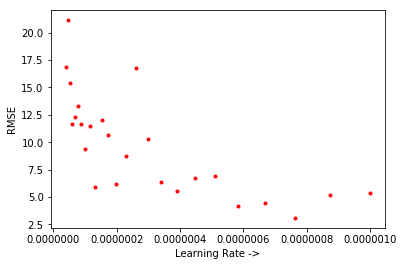

In [17]:
X,Y=get_cubic_X_Y(train_data)
rmse_list=list()
alpha_list=list()
lamda=0
for learning_rate in 10**np.linspace(-7.4,-6.0,25):
    t = int( time.time() * 1000.0 )
    np.random.seed( ((t & 0xff000000) >> 24)+((t & 0x00ff0000)>>8) +((t & 0x0000ff00)<<8)+((t & 0x000000ff)<<24))
    Theta=np.random.randn(19)
    Theta,cost_list,iter_list=gradientDescent(X,Y,Theta,learning_rate,len(train_data), 40000)
    rmse_list.append(get_cubic_rmse(Theta))
    alpha_list.append(learning_rate)
plot_rmse(alpha_list,rmse_list)

In [10]:
rmse_list

[nan, nan]

In [11]:
data.head()

,sqft,floors,bedrooms,bathrooms,price
0,-0.228316,-0.915406,-0.398728,-1.447430,-0.866399
1,-0.189881,0.936484,-0.398728,0.175603,-0.005940
2,-0.123296,-0.915406,-1.473925,-1.447430,-0.980455
3,-0.244009,-0.915406,0.676469,1.149422,0.173719
4,-0.169649,-0.915406,-0.398728,-0.149004,-0.082159
